# ARIMAX_SE+N with GRIDSEARCH_CV and PCA on ADM0, QUARTERLY

In [1]:
import pandas as pd

# pd.set_option('display.max_rows', 500)
# pd.set_option('display.max_columns', 500)

import warnings
warnings.simplefilter('ignore')

import warnings
from statsmodels.tools.sm_exceptions import ConvergenceWarning
warnings.simplefilter('ignore', ConvergenceWarning)
    
import time
import datetime

import os

## Model Specifications

In [2]:
TARGET_VARIABLE = "SUM(FATALITIES)"
SEASONAL_PERIODICITY = 4 # for data frequency & seasonality S

SEASONALITY = False
NEIGHBORS = True # X_N
SOCIO_ECO_VARS = True # X_SE
N_LAGS_X = 1 # todo: remove or change behavior from max lags to lag
DIM_REDUCTION_METHOD = "PCA"

if SEASONALITY:
    CV_FOLDS = 5
else:
    CV_FOLDS = 5

In [3]:
MODEL_NAME = ""
if SEASONALITY:
    MODEL_NAME += "S" 
    
MODEL_NAME += "ARIMA"

if SOCIO_ECO_VARS and NEIGHBORS:
    MODEL_NAME += "X_SE+N"
    
if SOCIO_ECO_VARS and not NEIGHBORS:
    MODEL_NAME += "X_SE"
    
if not SOCIO_ECO_VARS and NEIGHBORS:
    MODEL_NAME += "X_N"
    
if SEASONAL_PERIODICITY ==  12:
    MODEL_NAME += "_MONTHLY"
elif SEASONAL_PERIODICITY == 4:
    MODEL_NAME += "_QUARTERLY"

MODEL_NAME

'ARIMAX_SE+N_QUARTERLY'

### Hyperparameter Grid

In [4]:
# create a set of sarima configs to try
PARAM_GRID = list()
# parameter options to try

### PCA
if NEIGHBORS or SOCIO_ECO_VARS:
    n_components = range(0, 4) # include up to three main components
else:
    n_components = [0]
    

### ARMA
p_params = range(4) # AR 3
d_params = range(2) # Differencing 1
q_params = range(4) # MA 3


### SEASONALITY
if SEASONALITY:
    P_params = range(3) # 5
    D_params = range(2) # 1
    Q_params = range(3) # 2
    
    ### TREND
    # t_params = ['n','c','t','ct'] # Form of Trend
    # t_params = ['n', 't', 'ct'] # Form of Trend
    t_params = ["n"]

    ### SEASONAL PERIODICITY
    m_params = [SEASONAL_PERIODICITY]   
else:
    P_params = [0]
    D_params = [0]
    Q_params = [0]

    t_params = ["n"] # Form of Trend

    m_params = [0] 

for n in n_components:
    for p in p_params:
        for d in d_params:
            for q in q_params:
                for P in P_params:
                    for D in D_params:
                        for Q in Q_params:
                            for m in m_params:
                                for t in t_params:
                                    cfg = [n, (p, d, q), (P, D, Q, m), t]
                                    PARAM_GRID.append(cfg)
len(PARAM_GRID)    

128

## Model Training

In [5]:
from common_functions import *
from forecasters import *

#### Training Method

In [6]:
def sarimax(target_variable="SUM(FATALITIES)", 
            target_country="MLI", 
            predictor_countries=["BFA"], 
            n_lags_X = N_LAGS_X, 
            seasonal_periodicity = SEASONAL_PERIODICITY):
        
    ### GET DATA
    y, X = getData(target_variable = target_variable, 
                   target_country = target_country, 
                   predictor_countries = predictor_countries,
                   socio_eco_vars = SOCIO_ECO_VARS,
                   n_lags_X = N_LAGS_X, 
                   seasonal_periodicity = SEASONAL_PERIODICITY)
    
    ### SPLIT DATA
    X_train, X_test, y_train, y_test = train_test_split(y = y,
                                                        X = X, 
                                                        forecast_horizon = SEASONAL_PERIODICITY)
    
    ### TRAINING WITH GRIDSEARCHCV
    gscv = GridSearchCV(param_grid = PARAM_GRID,
                        forecaster = TimeSeriesForecasterPCA_LinInt,
                        seasonal_periodicity = SEASONAL_PERIODICITY,
                        cv_folds = CV_FOLDS)
    training_res = gscv.train(X_train, y_train)

    if training_res is not None:
        model = gscv
        # print ARIMA summary
        print(training_res)
        print(model.best_model_result.mle_retvals)
        plt.tight_layout()
        try:
            model.best_model_result.plot_diagnostics(figsize=(16*0.7, 10*0.7), lags = SEASONAL_PERIODICITY+1)
        except: 
            pass
        best_parameters = str(model.best_model_cv_results)
        
    else:
        print("No model fitted --> Prediction with Naive Model ")
        model = NoChange().fit(X_train, y_train)
        best_parameters = np.nan
        
    ### PREDICTION
    prediction_results = model.evaluate_model(X_test, y_test, fh = SEASONAL_PERIODICITY)
    
    if prediction_results["FAT_PRED"].isnull().values.any():
        model = NoChange().fit(X_train, y_train)
        print("Model Prediction failed --> Prediction with Naive Model ")
        model = NoChange().fit(X_train, y_train)
        best_parameters = np.nan
        prediction_results = model.evaluate_model(X_test, y_test, fh = SEASONAL_PERIODICITY)
    
    ### ADJUST RESULT DF
    prediction_results["GID_0"] = target_country
    prediction_results["MONTH"] = pd.to_datetime(prediction_results["MONTH"].astype(str)) 
    prediction_results["PARAMETERS"] = best_parameters

    print(prediction_results)

    return prediction_results

#### Automated Training for all 234 Countries 

In [7]:
acled_monthly_adm0 = pd.read_csv("../data/TB003_EVENT_OUTCOMES_MONTHLY_START_DATE.csv")
gid0_neighbors = pd.read_csv("../data/GID_0_Neighbours.csv")
# gid_list = acled_monthly_adm0["GID_0"].unique()[::-1] #reverse
gid_list = acled_monthly_adm0["GID_0"].unique()
len(gid_list)

234

######## ABW (1/234) #########
0
Neighbor countries: []
Getting Data for ABW
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (13, 35)
y: (13, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ABW   No. Observations:                    9
Model:                         SARIMAX   Log Likelihood                  95.346
Date:                 Wed, 19 Oct 2022   AIC                           -188.692
Time:                         10:23:39   BIC                           -188.495
Sample:                     01-31-2019   HQIC                          -189.117
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err

<Figure size 432x288 with 0 Axes>

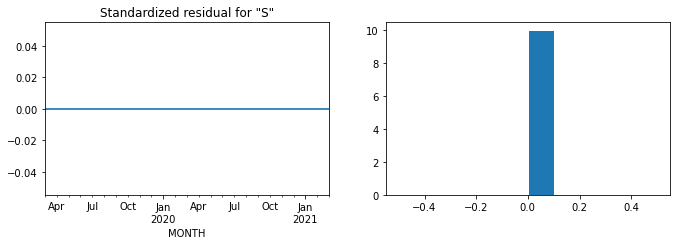

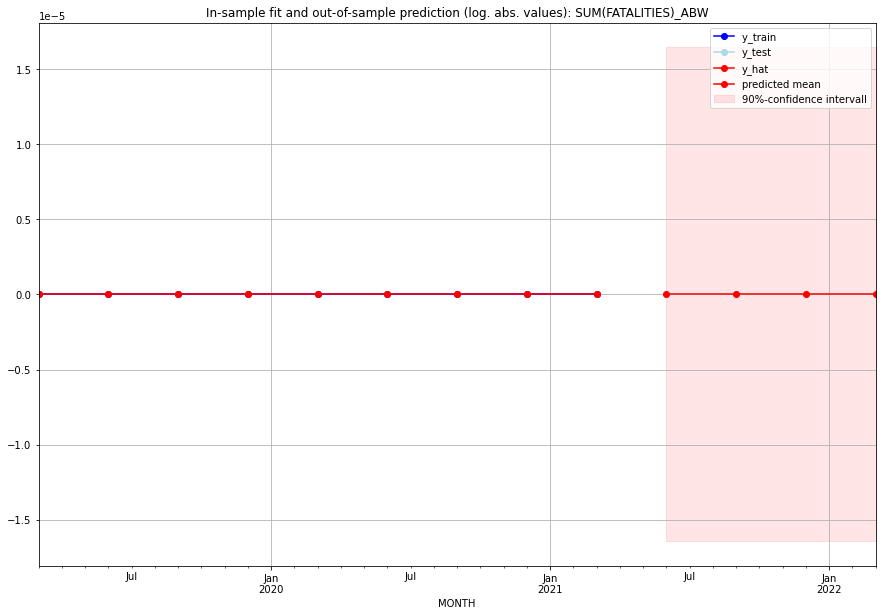

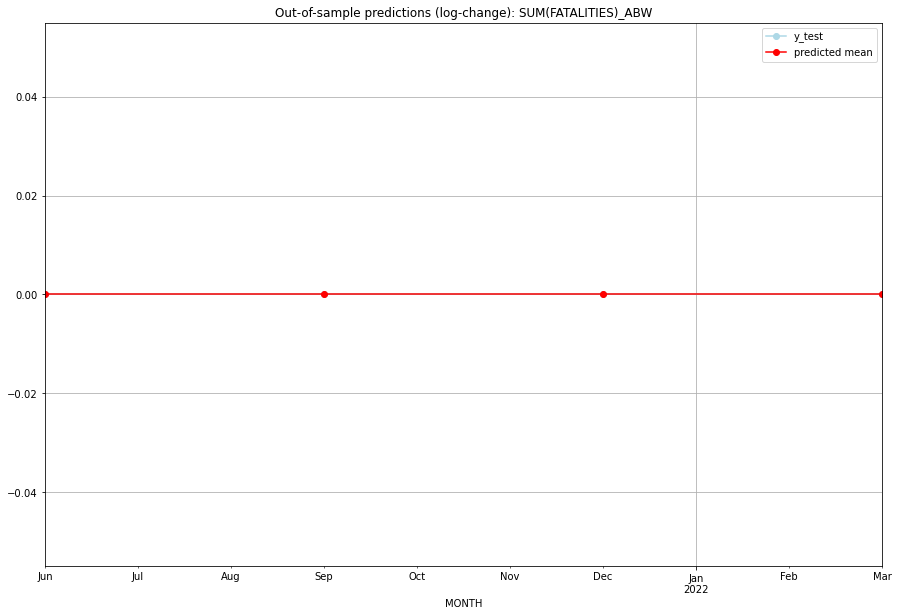

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ABW   
1 2021-07-01       0.0         0.0           0.0             0.0   ABW   
2 2021-10-01       0.0         0.0           0.0             0.0   ABW   
3 2022-01-01       0.0         0.0           0.0             0.0   ABW   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:10
######## AFG (2/234) #########
0
Neighbor countries: ['PAK', 'IRN', 'TKM', 'TJK', 'CHN', 'UZB']
Getting Data for AFG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (21, 103)
y: (21, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.17990995665606957, 'fold_results': [0.18944796057995017, nan, 0.17037195273218897]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AFG   No. Observations:                   17
Model:                SARIMAX(3, 0, 2)   Log Likelihood                   0.251
Date:                 Wed, 19 Oct 2022   AIC                             11.499
Time:                         10:24:09   BIC                             16.498
Sample:                     01-31-2017   HQIC                            11.995
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.2119

<Figure size 432x288 with 0 Axes>

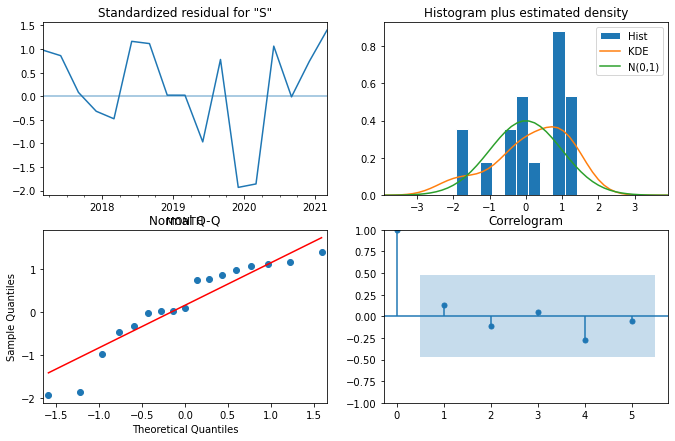

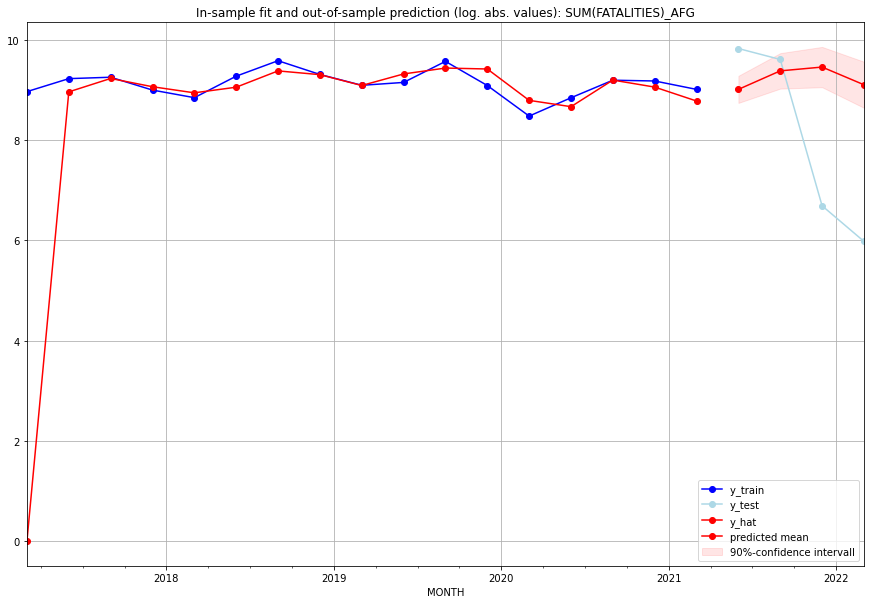

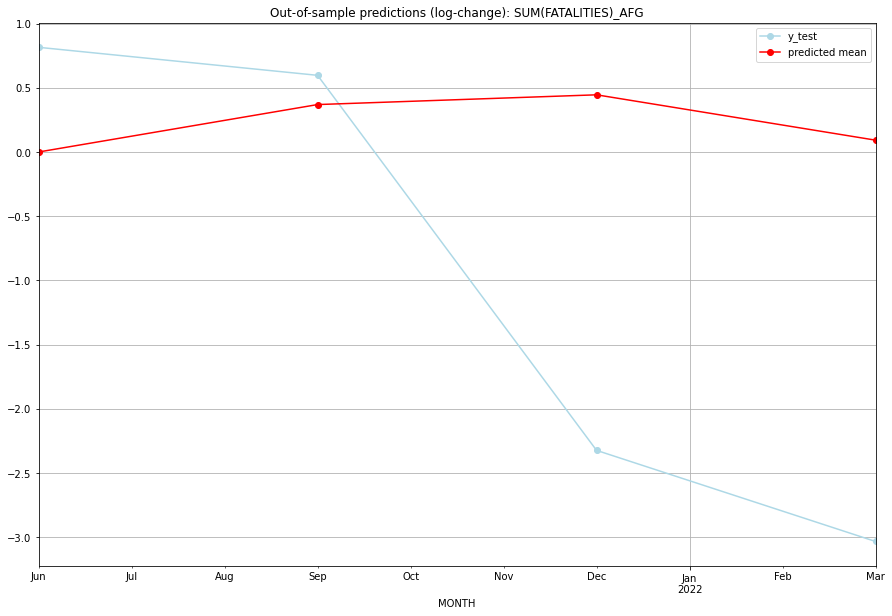

TADDA: 1.8687387947967613
Evaluation finished.
       MONTH      FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   8219.533600     18574.0      0.000430        0.815611   AFG   
1 2021-07-01  11892.122394     14933.0      0.369755        0.597435   AFG   
2 2021-10-01  12830.431632       804.0      0.445693       -2.323118   AFG   
3 2022-01-01   9012.533207       395.0      0.092522       -3.032546   AFG   

                                          PARAMETERS  
0  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:28
######## AGO (3/234) #########
0
Neighbor countries: ['COD', 'ZMB', 'NAM', 'COG']
Getting Data for AGO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 92)
y: (100, 1)
------------------------------------------------
Train

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 1.3281575527807759, 'fold_results': [2.7823399527713435, 1.0280351153651446, 0.6329950256912259, 0.9256544910171202, 1.2717631790590447]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AGO   No. Observations:                   96
Model:                SARIMAX(0, 1, 2)   Log Likelihood                -165.224
Date:                 Wed, 19 Oct 2022   AIC                            342.447
Time:                         10:24:28   BIC                            357.771
Sample:                     04-30-1997   HQIC                           348.639
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

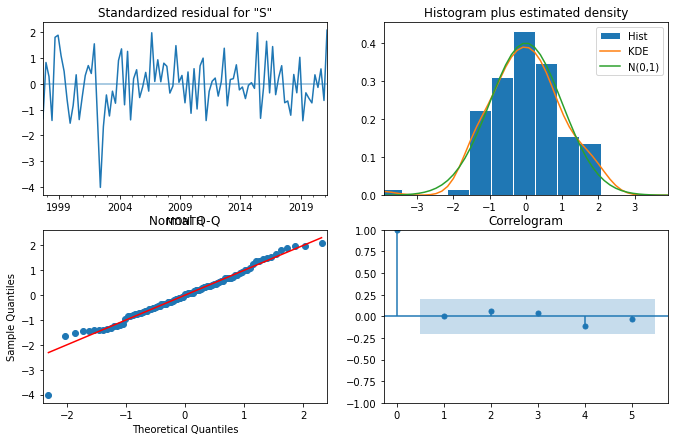

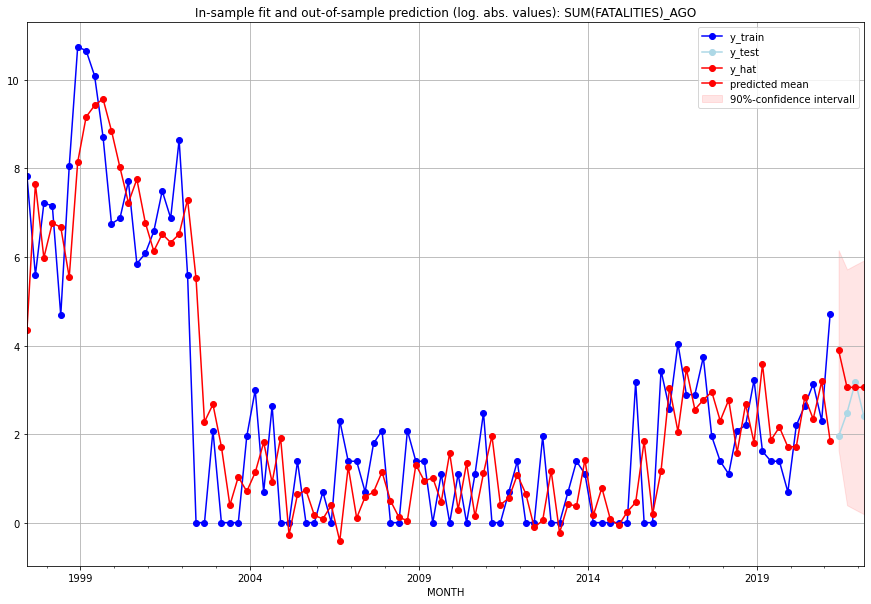

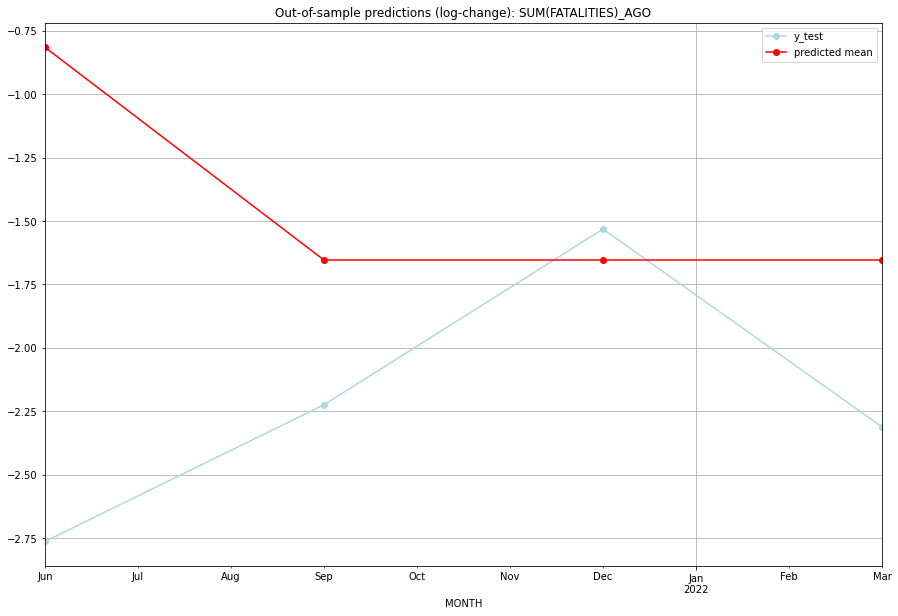

TADDA: 0.8249401575868076
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  48.136685         6.0     -0.814924       -2.763620   AGO   
1 2021-07-01  20.238445        11.0     -1.653717       -2.224624   AGO   
2 2021-10-01  20.238445        23.0     -1.653717       -1.531476   AGO   
3 2022-01-01  20.238445        10.0     -1.653717       -2.311635   AGO   

                                          PARAMETERS  
0  {'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## AIA (4/234) #########
0
Neighbor countries: []
Getting Data for AIA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient

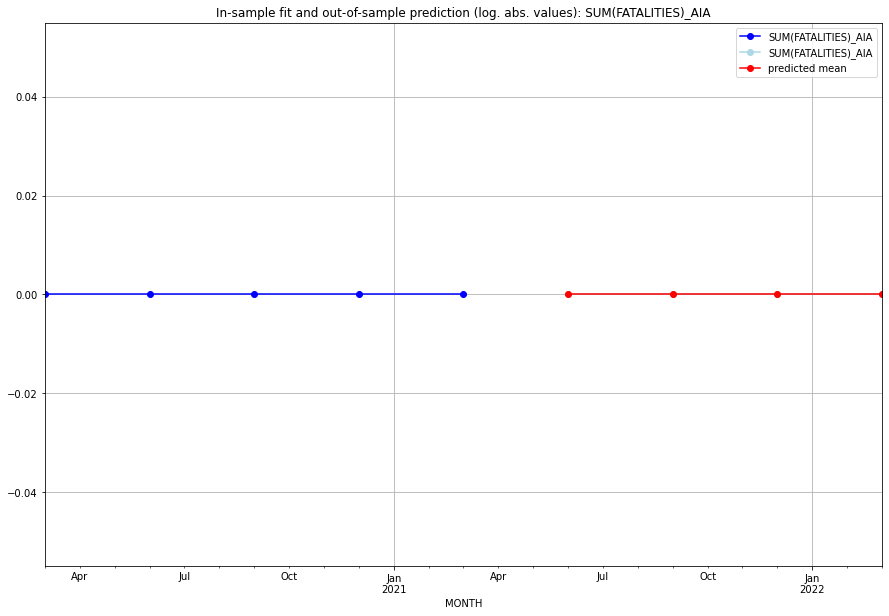

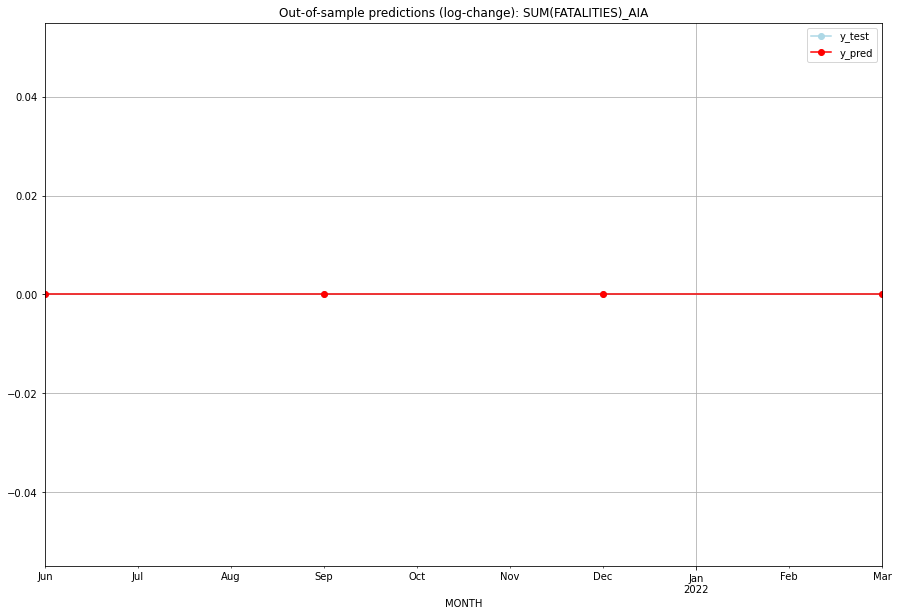

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   AIA   
1 2021-07-01       0.0         0.0           0.0             0.0   AIA   
2 2021-10-01       0.0         0.0           0.0             0.0   AIA   
3 2022-01-01       0.0         0.0           0.0             0.0   AIA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## ALA (5/234) #########
0
Neighbor countries: []
Getting Data for ALA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


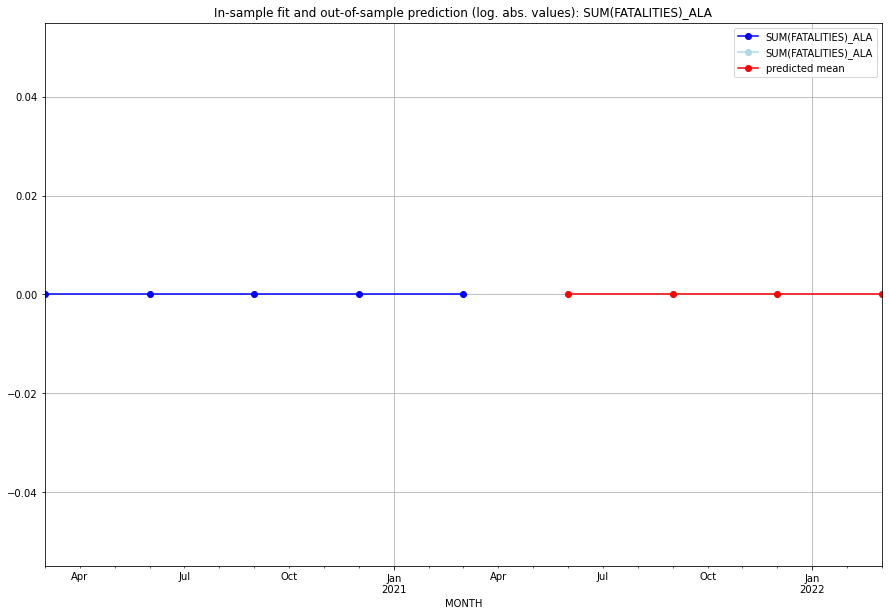

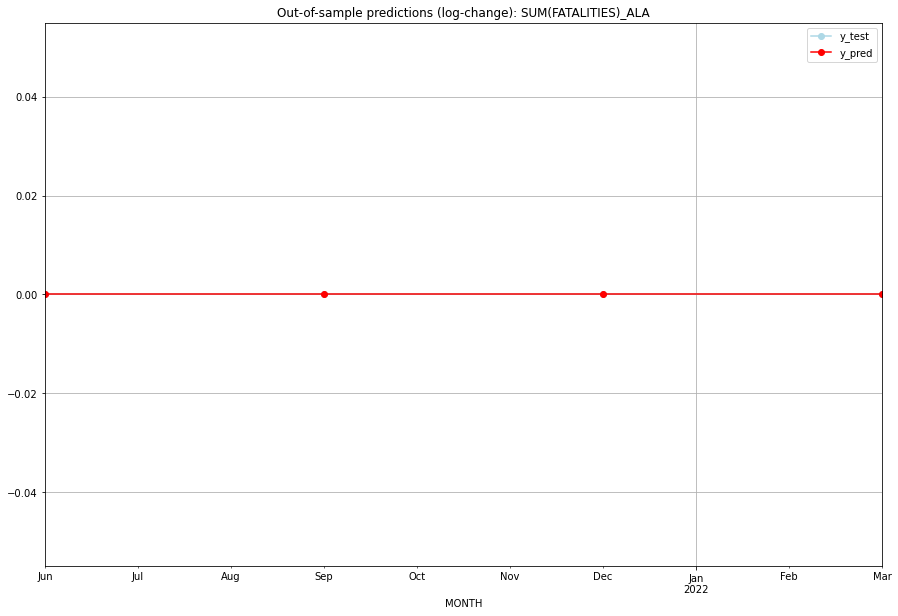

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ALA   
1 2021-07-01       0.0         0.0           0.0             0.0   ALA   
2 2021-10-01       0.0         0.0           0.0             0.0   ALA   
3 2022-01-01       0.0         0.0           0.0             0.0   ALA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## ALB (6/234) #########
0
Neighbor countries: ['MNE', 'GRC', 'XKO', 'MKD']
Getting Data for ALB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 95)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ALB   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:24:40   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.245      0.000       0.025       0

<Figure size 432x288 with 0 Axes>

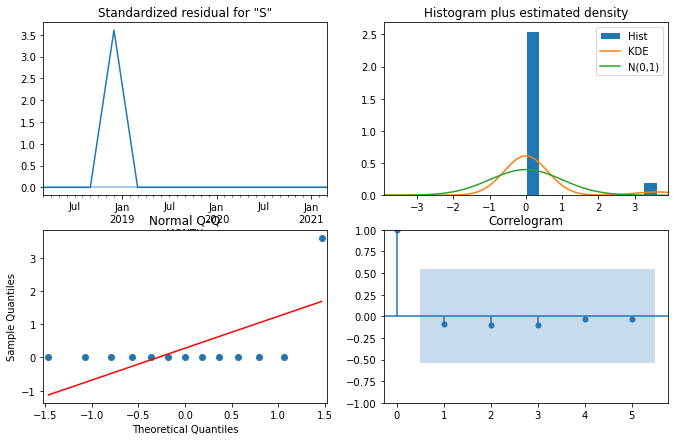

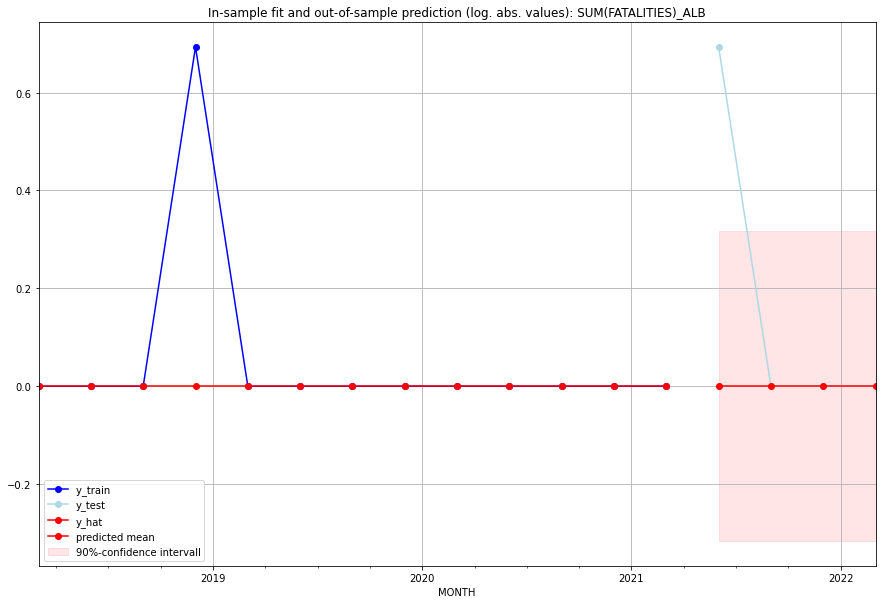

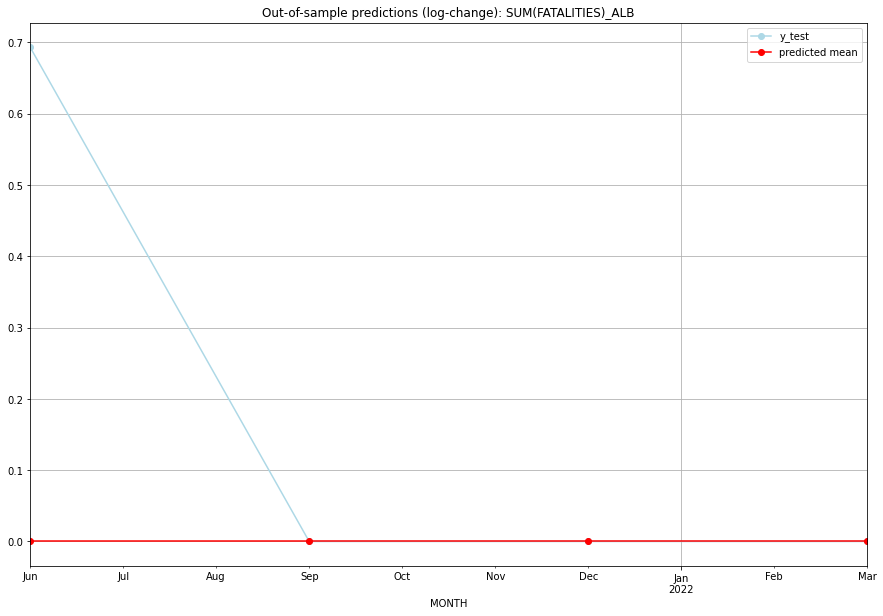

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         1.0           0.0        0.693147   ALB   
1 2021-07-01       0.0         0.0           0.0        0.000000   ALB   
2 2021-10-01       0.0         0.0           0.0        0.000000   ALB   
3 2022-01-01       0.0         0.0           0.0        0.000000   ALB   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## AND (7/234) #########
0
Neighbor countries: ['FRA', 'ESP']
Getting Data for AND
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 46)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Ins

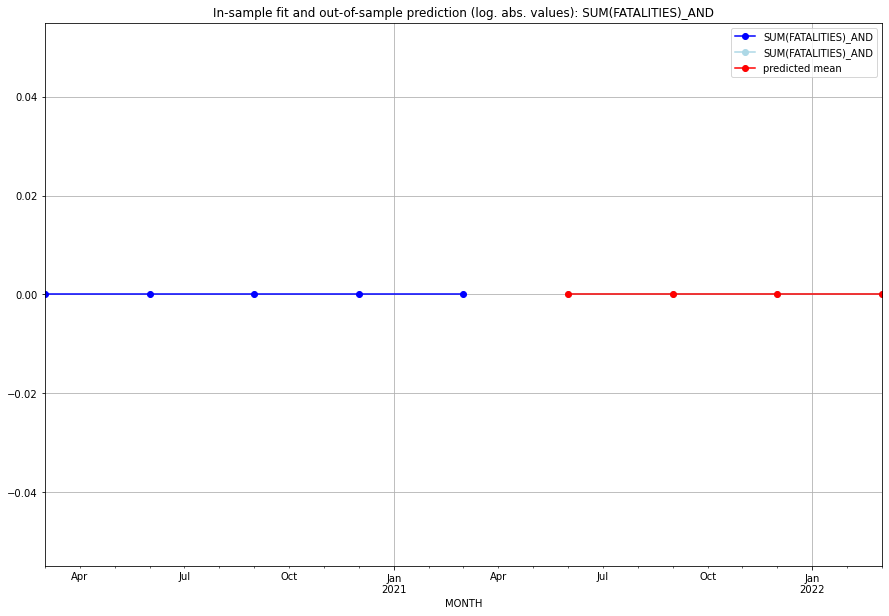

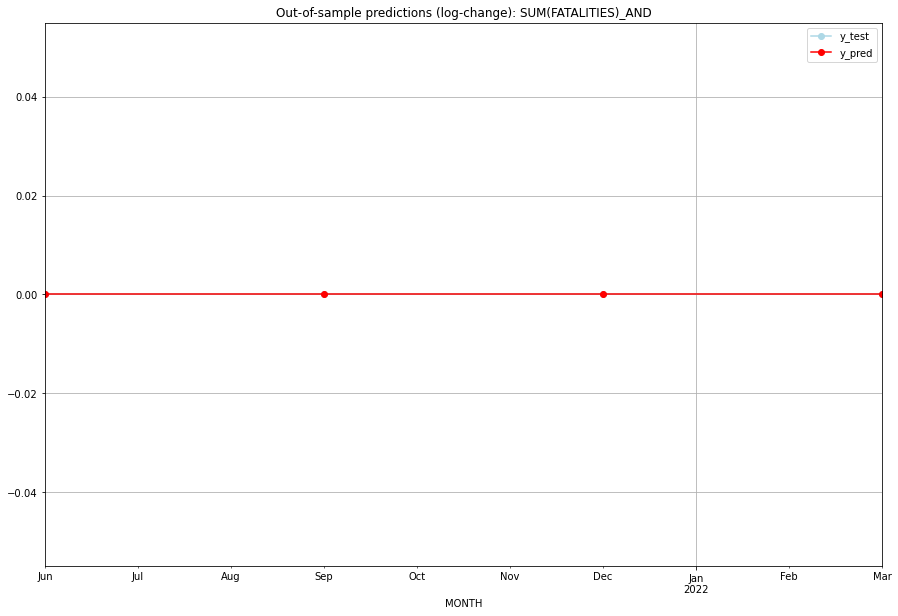

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   AND   
1 2021-07-01       0.0         0.0           0.0             0.0   AND   
2 2021-10-01       0.0         0.0           0.0             0.0   AND   
3 2022-01-01       0.0         0.0           0.0             0.0   AND   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## ARE (8/234) #########
0
Neighbor countries: ['OMN', 'SAU']
Getting Data for ARE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (21, 70)
y: (21, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ARE   No. Observations:                 

<Figure size 432x288 with 0 Axes>

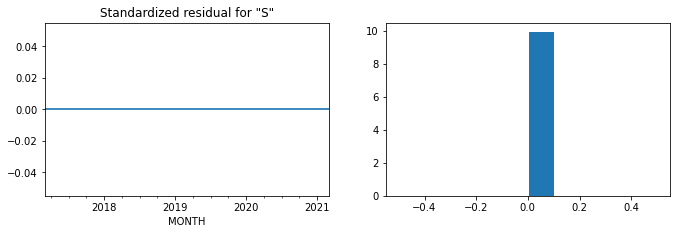

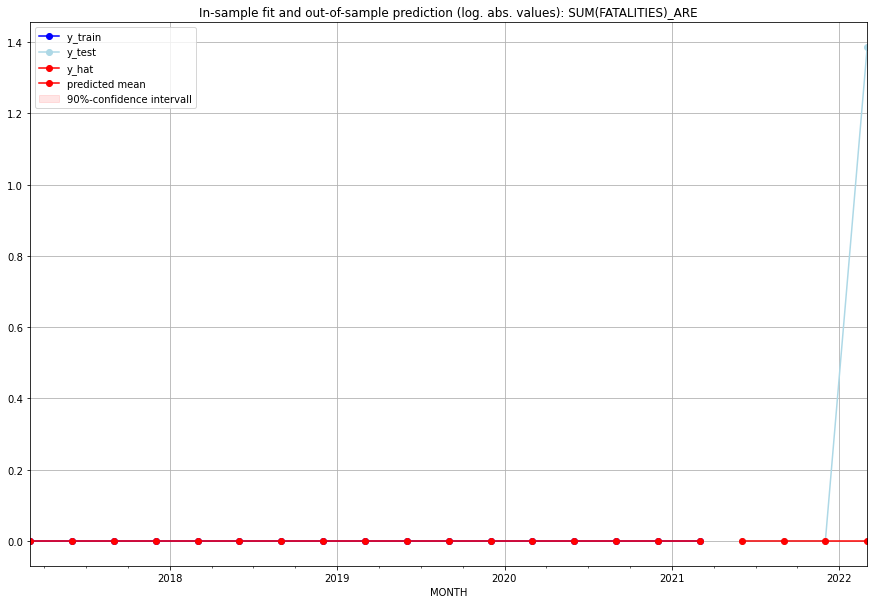

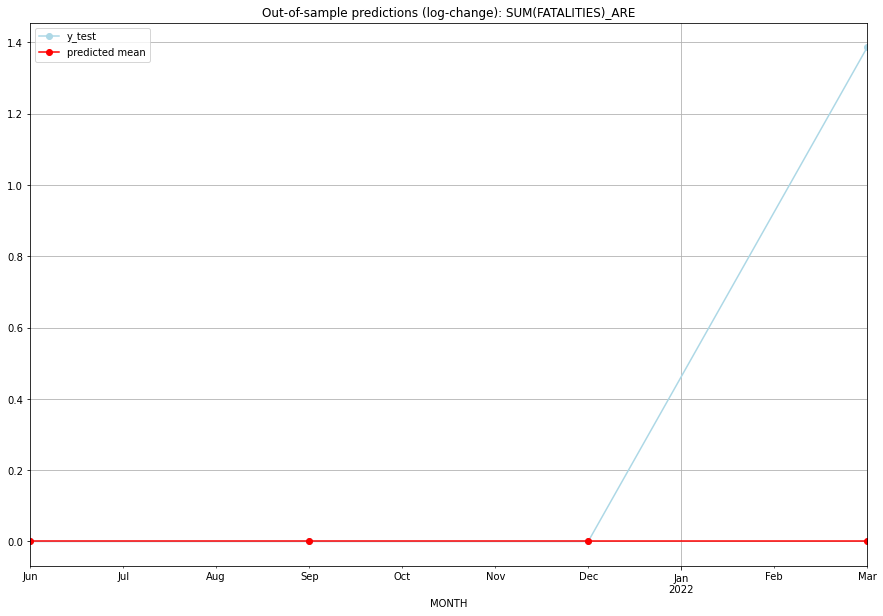

TADDA: 0.34657359027997264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   ARE   
1 2021-07-01       0.0         0.0           0.0        0.000000   ARE   
2 2021-10-01       0.0         0.0           0.0        0.000000   ARE   
3 2022-01-01       0.0         3.0           0.0        1.386294   ARE   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## ARG (9/234) #########
0
Neighbor countries: ['BOL', 'CHL', 'BRA', 'PRY', 'URY']
Getting Data for ARG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 101)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3949183970352586, 'fold_results': [0.3949183970352586, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ARG   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                 -17.836
Date:                 Wed, 19 Oct 2022   AIC                             43.672
Time:                         10:24:52   BIC                             45.931
Sample:                     01-31-2018   HQIC                            43.207
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0110      0.089      0.124 

<Figure size 432x288 with 0 Axes>

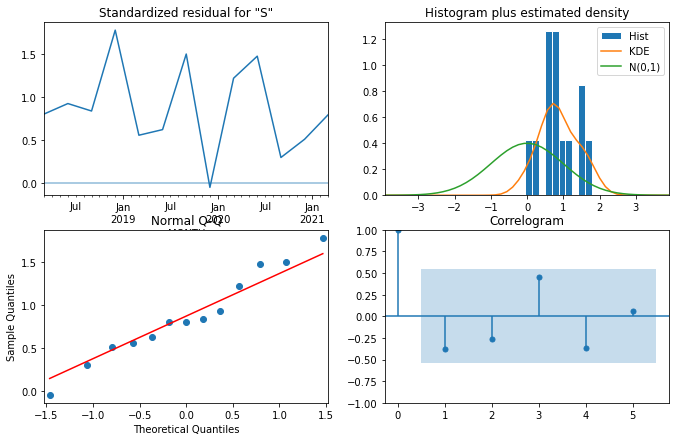

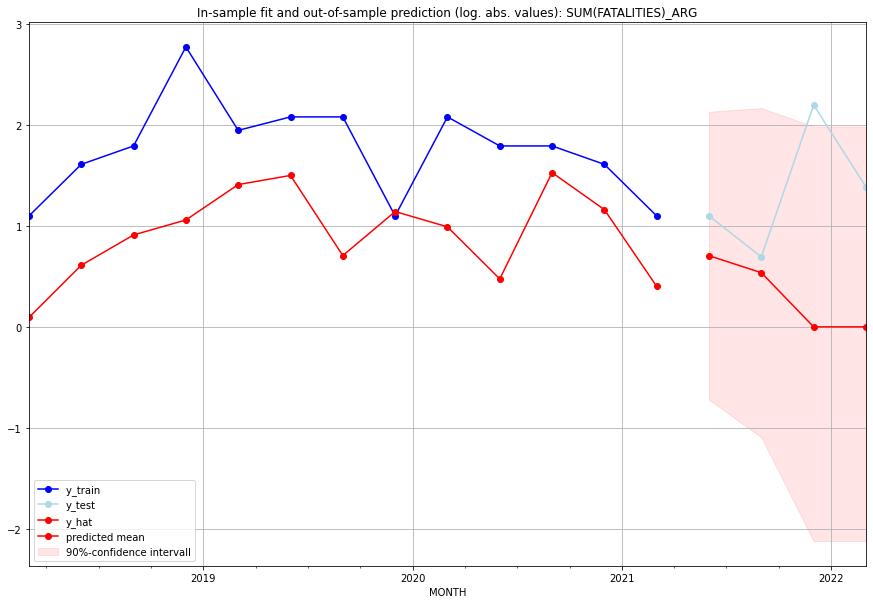

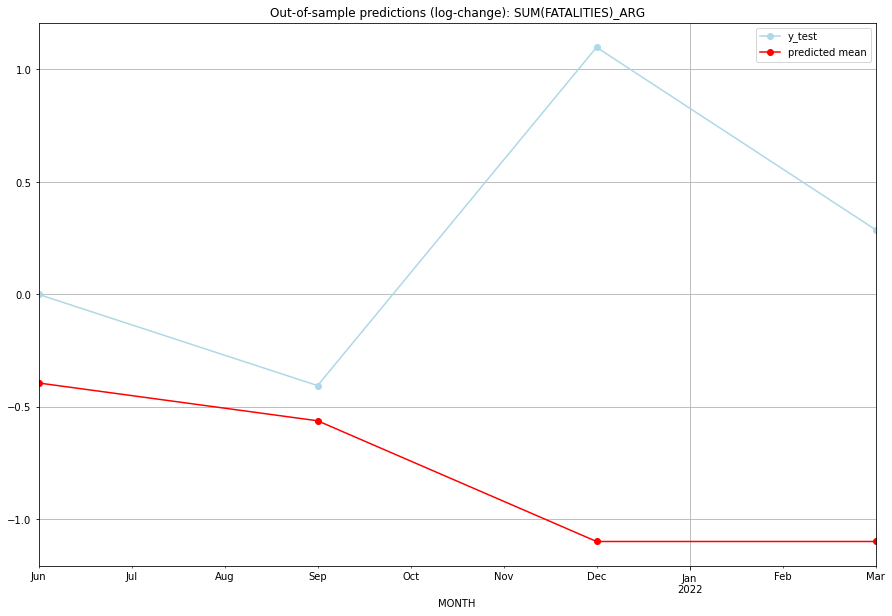

TADDA: 1.5827577101757484
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.023344         2.0     -0.393861        0.000000   ARG   
1 2021-07-01  0.710388         1.0     -0.561892       -0.405465   ARG   
2 2021-10-01  0.000000         8.0     -1.098612        1.098612   ARG   
3 2022-01-01  0.000000         3.0     -1.098612        0.287682   ARG   

                                          PARAMETERS  
0  {'params': [1, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## ARM (10/234) #########
0
Neighbor countries: ['AZE', 'GEO', 'TUR', 'IRN']
Getting Data for ARM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 94)
y: (17, 1)
------------------------------------------------
Training started.
Start GR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.34657359027997264, 'fold_results': [0.34657359027997264, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ARM   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                 -17.308
Date:                 Wed, 19 Oct 2022   AIC                             46.616
Time:                         10:25:01   BIC                             50.005
Sample:                     01-31-2018   HQIC                            45.919
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3138      1.669      0.18

<Figure size 432x288 with 0 Axes>

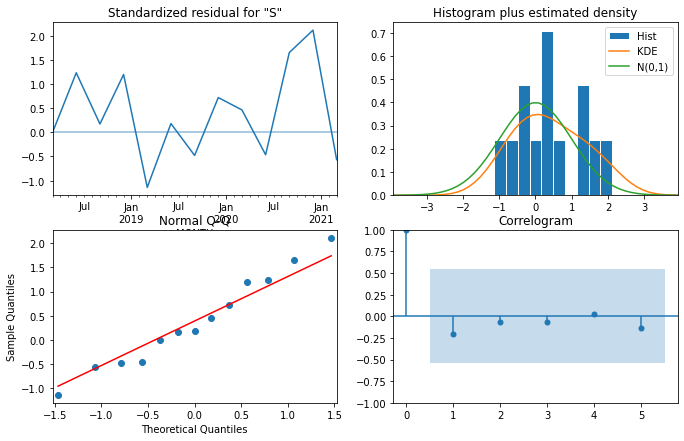

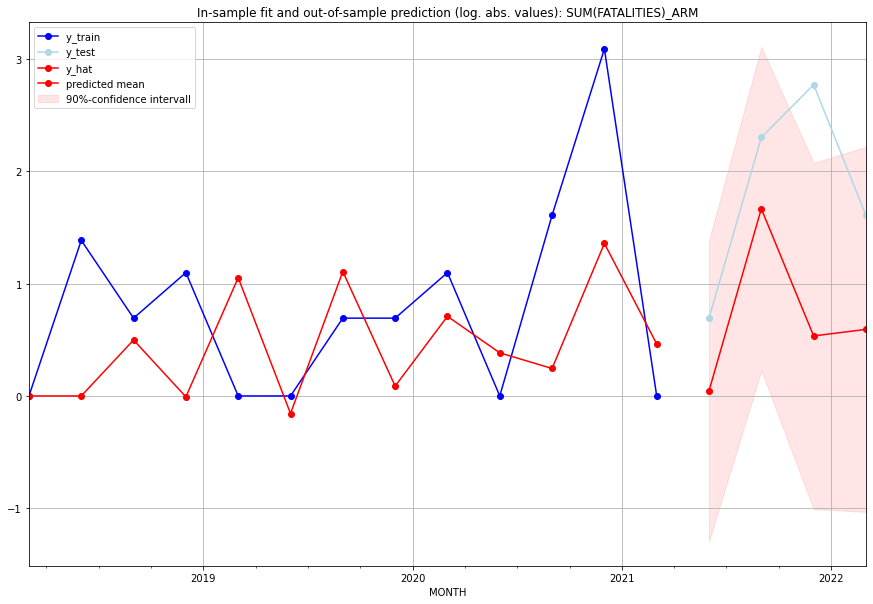

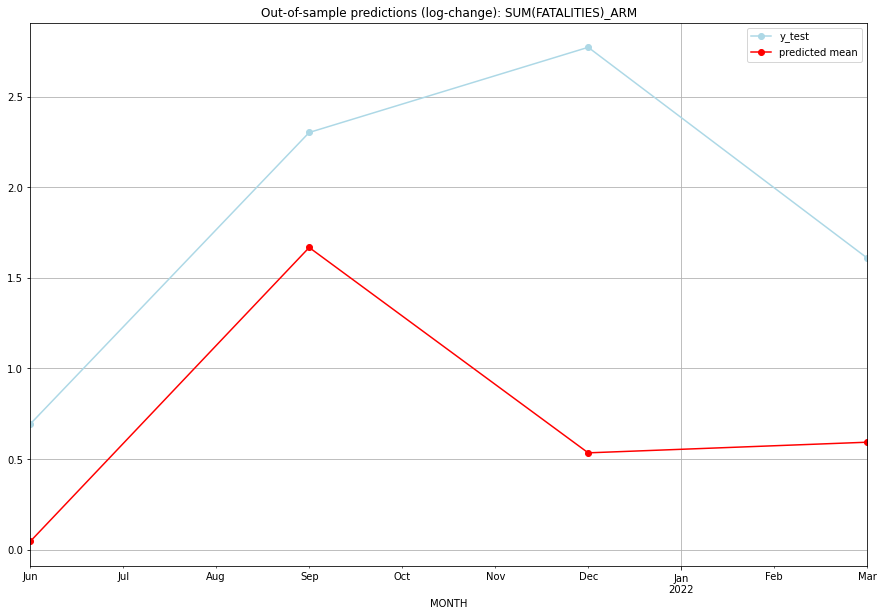

TADDA: 1.1342782796044708
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.046268         1.0      0.045230        0.693147   ARM   
1 2021-07-01  4.300419         9.0      1.667786        2.302585   ARM   
2 2021-10-01  0.706524        15.0      0.534458        2.772589   ARM   
3 2022-01-01  0.809719         4.0      0.593172        1.609438   ARM   

                                          PARAMETERS  
0  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## ASM (11/234) #########
0
Neighbor countries: []
Getting Data for ASM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 18)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

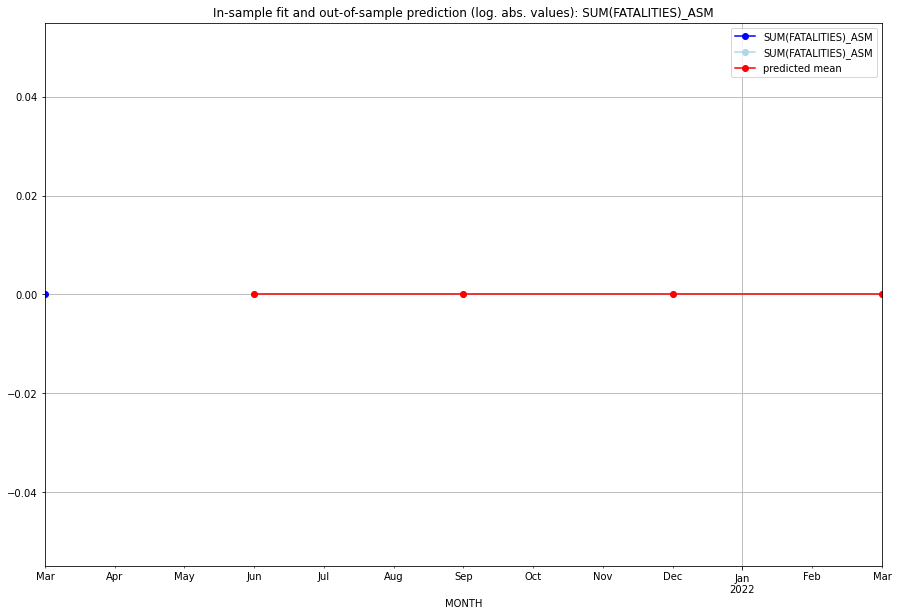

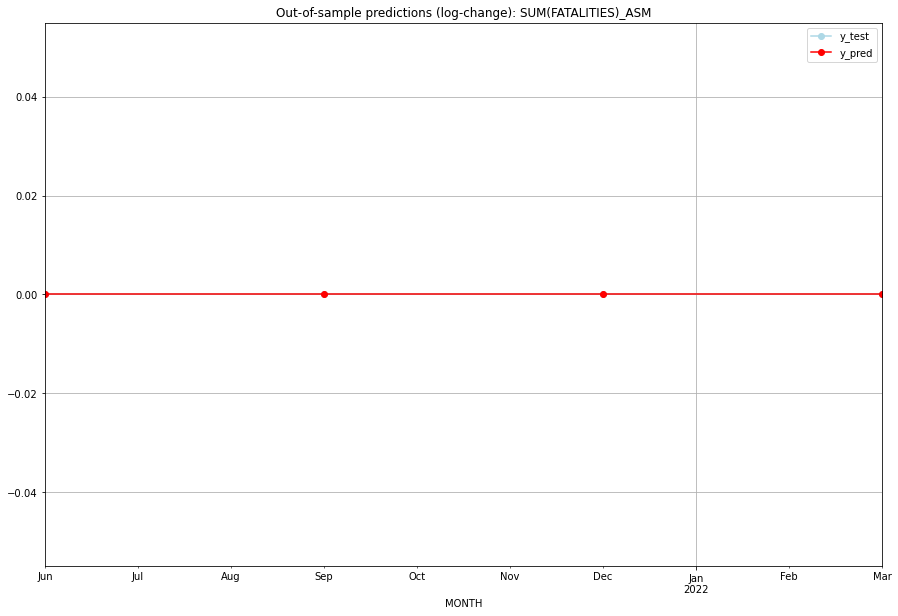

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ASM   
1 2021-07-01       0.0         0.0           0.0             0.0   ASM   
2 2021-10-01       0.0         0.0           0.0             0.0   ASM   
3 2022-01-01       0.0         0.0           0.0             0.0   ASM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## ATA (12/234) #########
0
Neighbor countries: []
Getting Data for ATA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


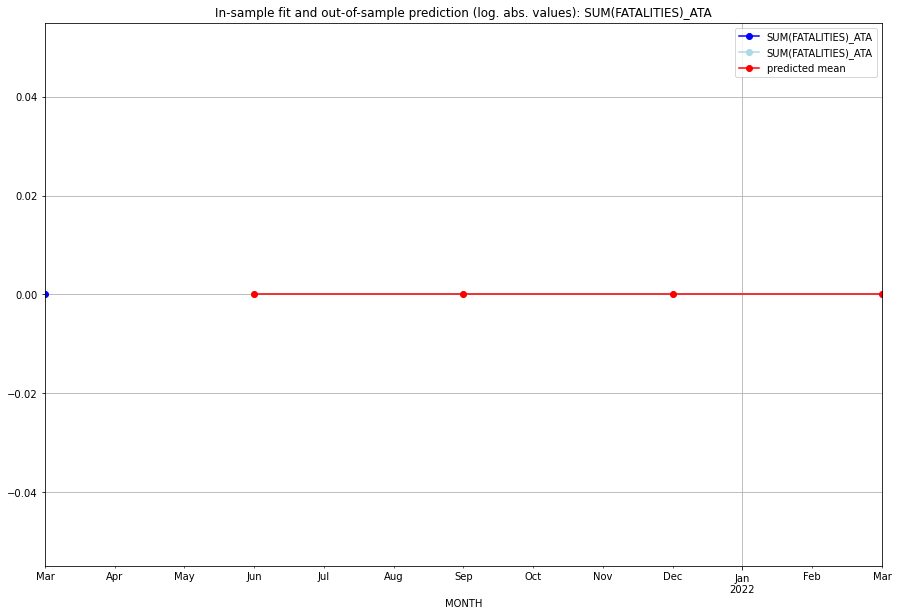

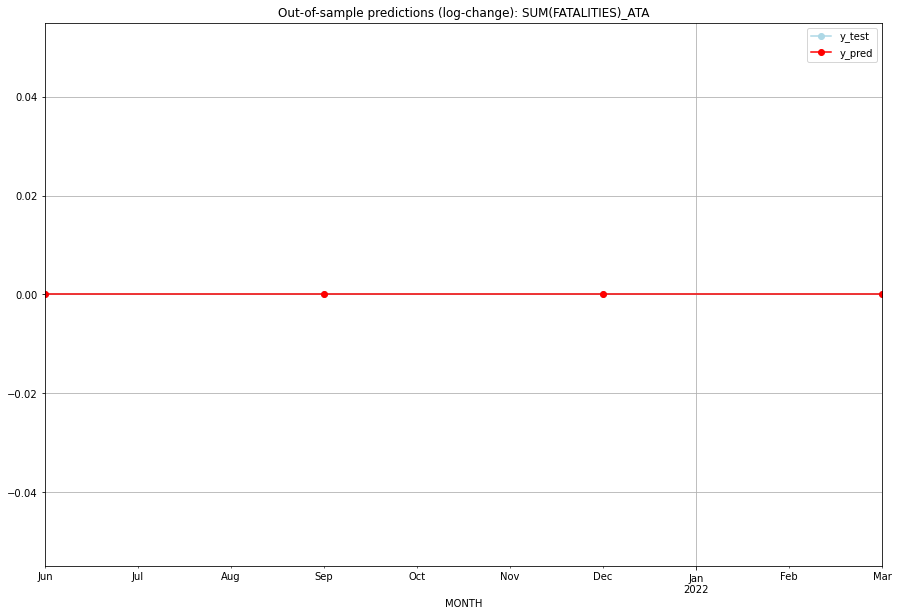

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ATA   
1 2021-07-01       0.0         0.0           0.0             0.0   ATA   
2 2021-10-01       0.0         0.0           0.0             0.0   ATA   
3 2022-01-01       0.0         0.0           0.0             0.0   ATA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## ATG (13/234) #########
0
Neighbor countries: []
Getting Data for ATG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 47)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ATG   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                              0.019
Time:                         10:25:15   BIC                              1.714
Sample:                     01-31-2018   HQIC                            -0.330
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1      -6.757e-07   1.14e+05  -5.93e-12      1.000   -2.23e+05    2.23

<Figure size 432x288 with 0 Axes>

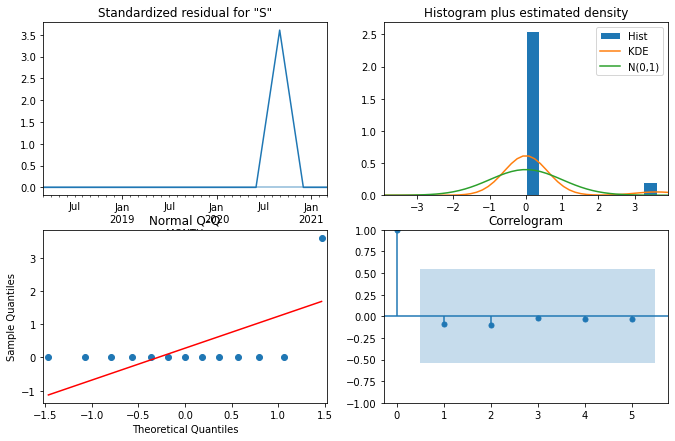

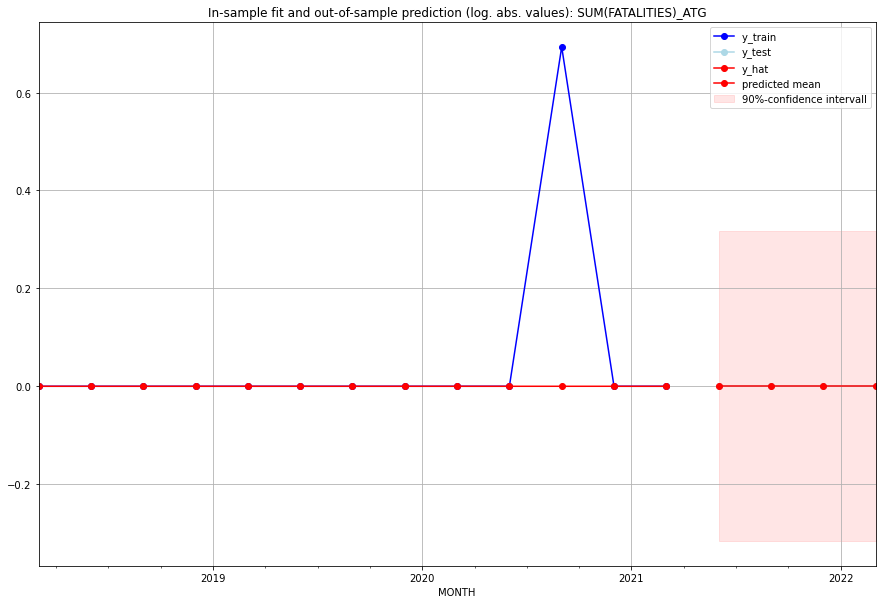

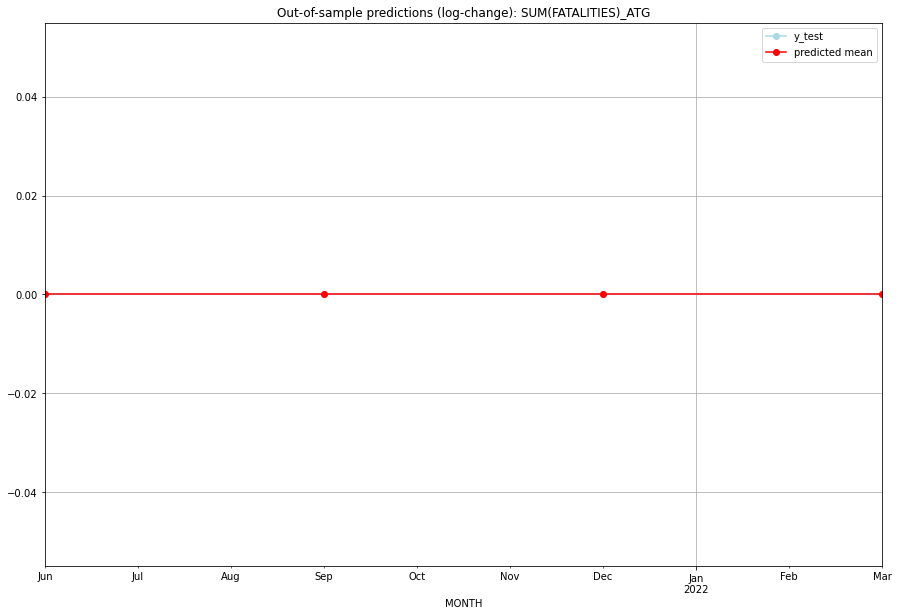

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ATG   
1 2021-07-01       0.0         0.0           0.0             0.0   ATG   
2 2021-10-01       0.0         0.0           0.0             0.0   ATG   
3 2022-01-01       0.0         0.0           0.0             0.0   ATG   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:06
######## AUS (14/234) #########
0
Neighbor countries: ['PNG']
Getting Data for AUS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 68)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cro

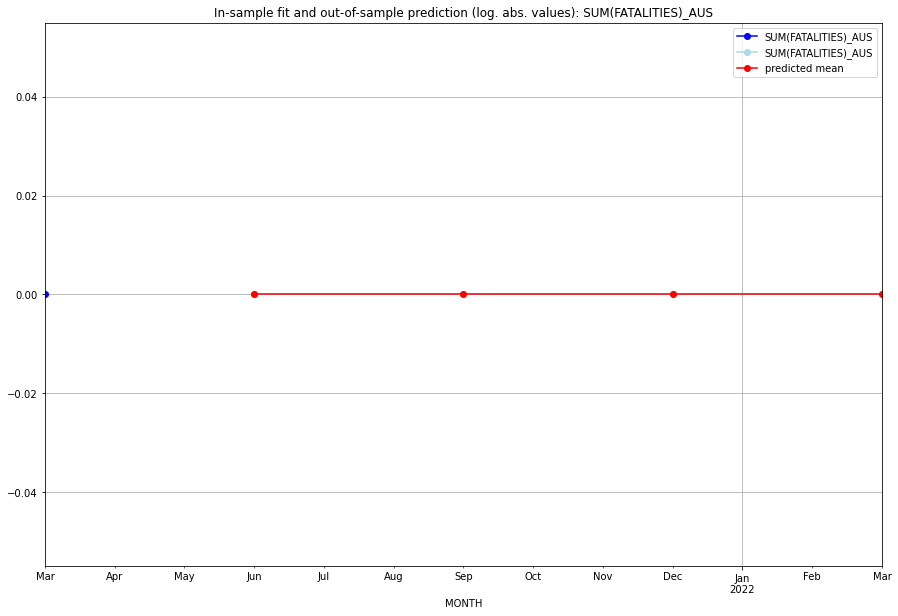

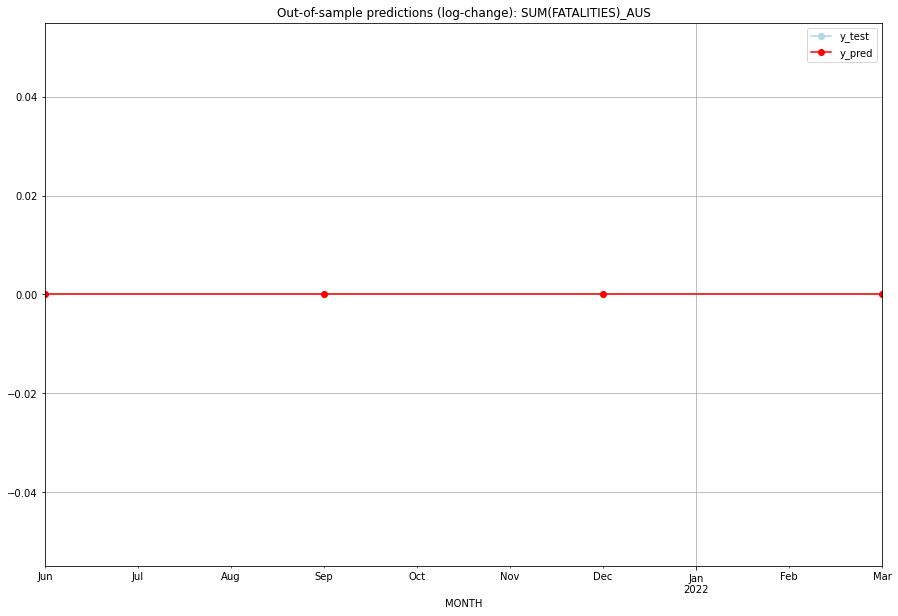

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   AUS   
1 2021-07-01       0.0         0.0           0.0             0.0   AUS   
2 2021-10-01       0.0         0.0           0.0             0.0   AUS   
3 2022-01-01       0.0         0.0           0.0             0.0   AUS   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## AUT (15/234) #########
0
Neighbor countries: ['HUN', 'SVK', 'SVN', 'ITA', 'CZE', 'DEU', 'CHE', 'LIE']
Getting Data for AUT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 128)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


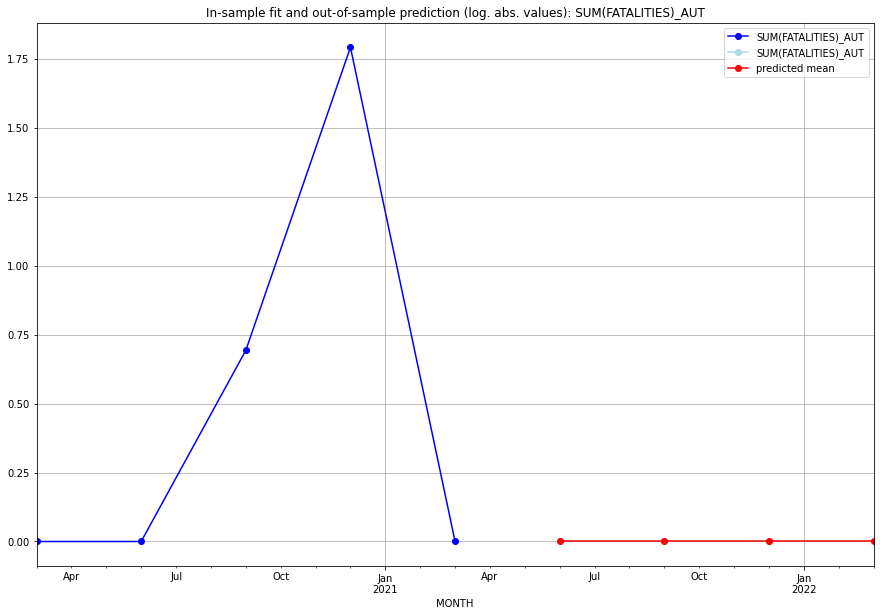

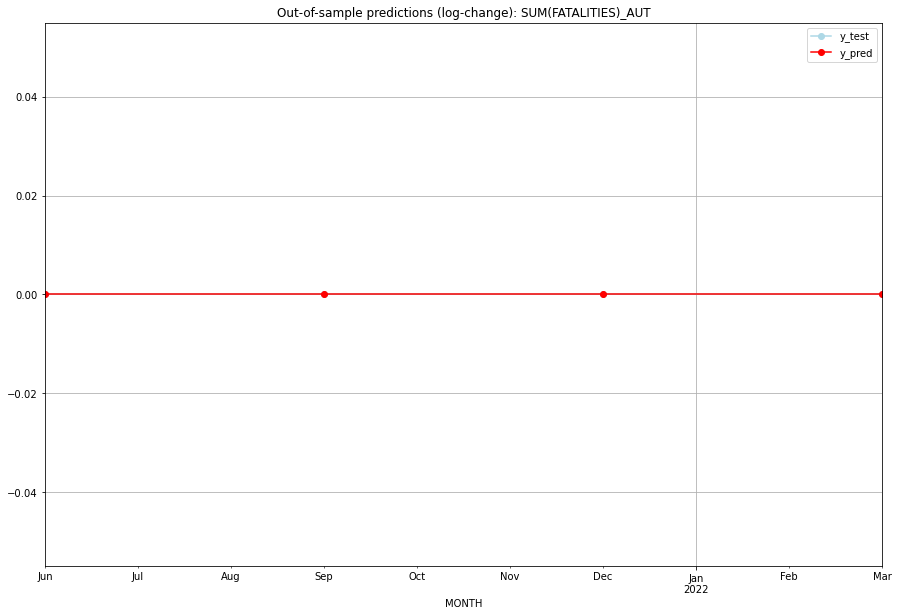

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   AUT   
1 2021-07-01       0.0         0.0           0.0             0.0   AUT   
2 2021-10-01       0.0         0.0           0.0             0.0   AUT   
3 2022-01-01       0.0         0.0           0.0             0.0   AUT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## AZE (16/234) #########
0
Neighbor countries: ['IRN', 'ARM', 'GEO', 'TUR', 'RUS']
Getting Data for AZE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 102)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3233030675242955, 'fold_results': [0.3233030675242955, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AZE   No. Observations:                   13
Model:                SARIMAX(1, 0, 2)   Log Likelihood                 -26.665
Date:                 Wed, 19 Oct 2022   AIC                             63.331
Time:                         10:25:37   BIC                             66.155
Sample:                     01-31-2018   HQIC                            62.750
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0705      0.104      0.679 

<Figure size 432x288 with 0 Axes>

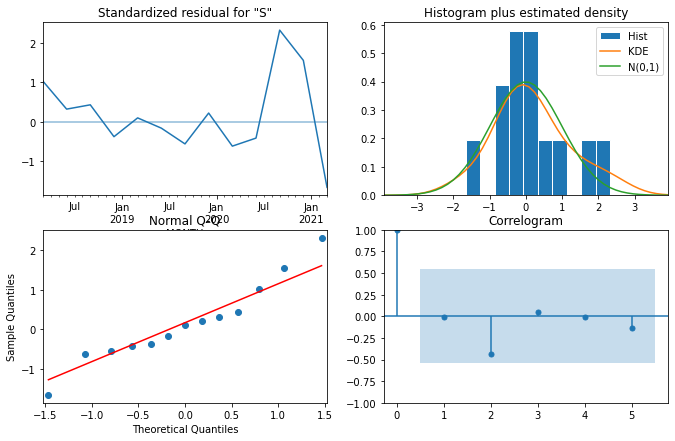

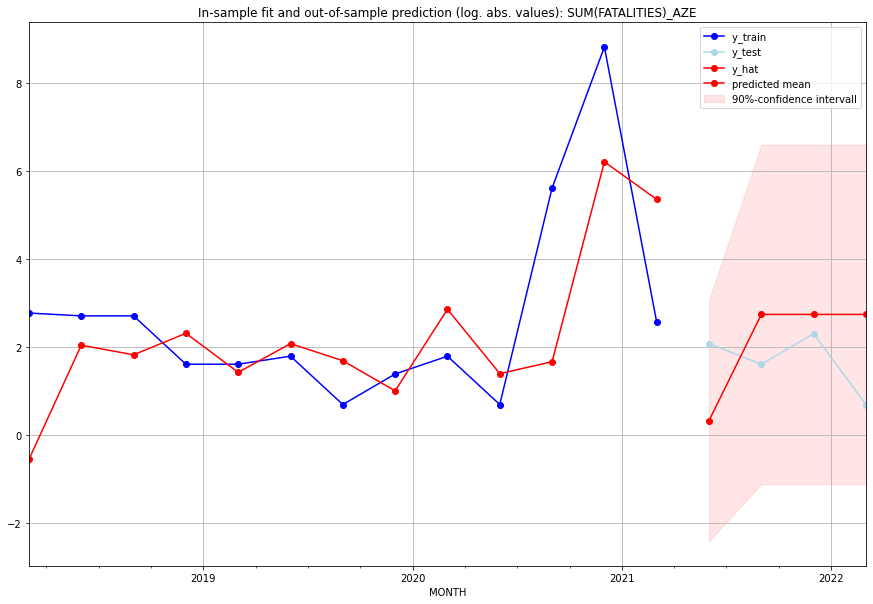

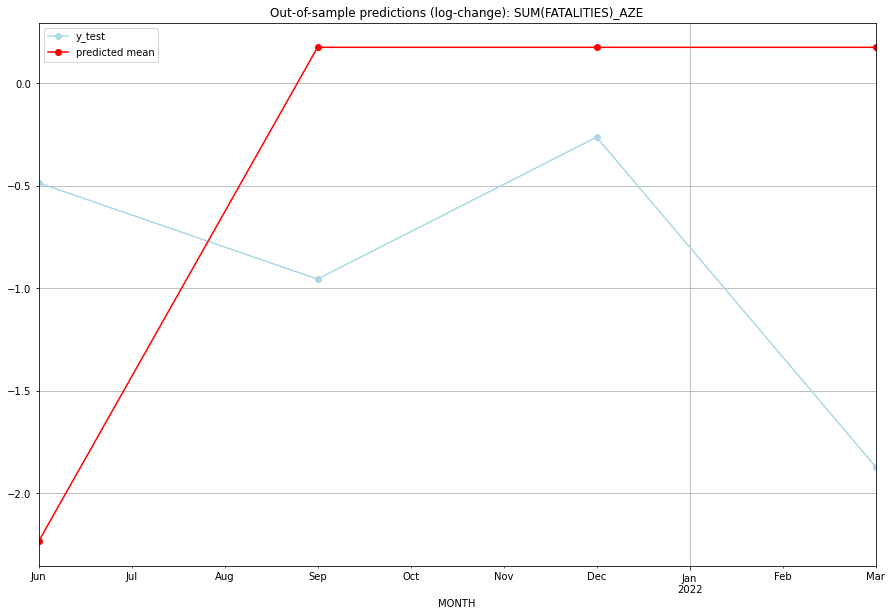

TADDA: 1.4751158015682335
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   0.387705         7.0     -2.237298       -0.485508   AZE   
1 2021-07-01  14.509706         4.0      0.176517       -0.955511   AZE   
2 2021-10-01  14.509434         9.0      0.176499       -0.262364   AZE   
3 2022-01-01  14.509162         1.0      0.176482       -1.871802   AZE   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## BDI (17/234) #########
0
Neighbor countries: ['RWA', 'COD', 'TZA']
Getting Data for BDI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 84)
y: (100, 1)
------------------------------------------------
Training started.
Start GR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.2990650585168425, 'fold_results': [0.3103007269881569, nan, 0.19429761944931245, 0.21339810438510853, 0.478263783244792]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BDI   No. Observations:                   96
Model:                SARIMAX(3, 0, 2)   Log Likelihood                -122.542
Date:                 Wed, 19 Oct 2022   AIC                            263.083
Time:                         10:26:03   BIC                            286.163
Sample:                     04-30-1997   HQIC                           272.412
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

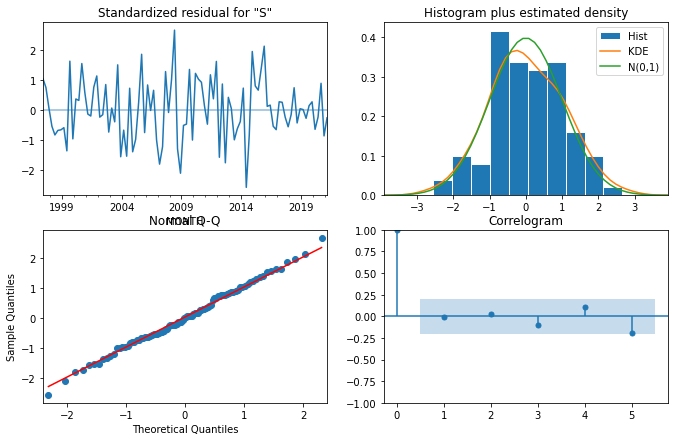

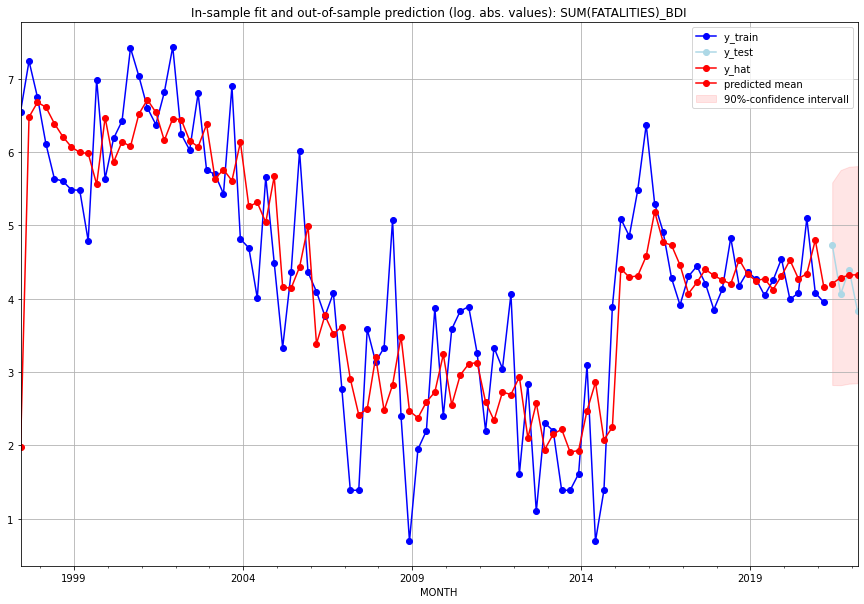

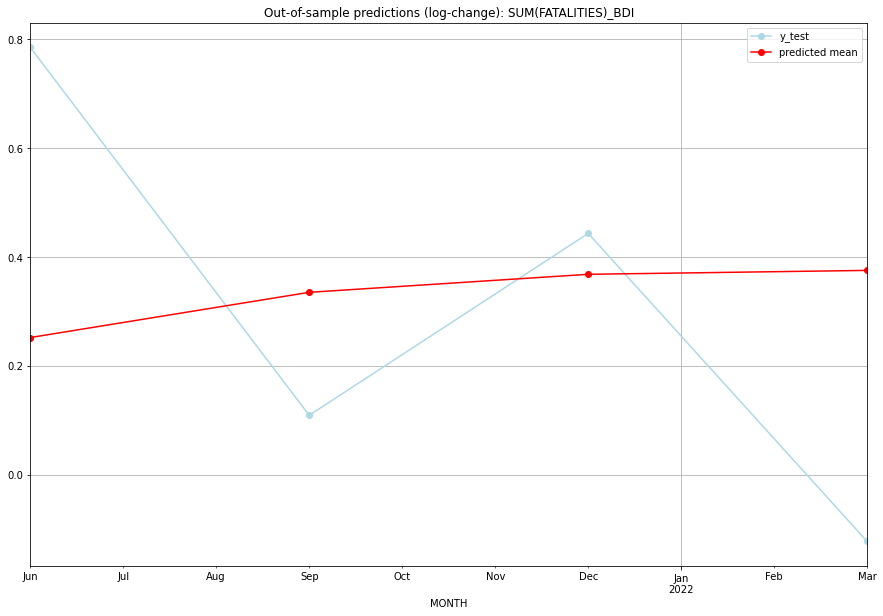

TADDA: 0.4267715571832109
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  65.898425       113.0      0.251932        0.784955   BDI   
1 2021-07-01  71.692852        57.0      0.334999        0.109199   BDI   
2 2021-10-01  74.137407        80.0      0.368075        0.443205   BDI   
3 2022-01-01  74.679614        45.0      0.375265       -0.122602   BDI   

                                          PARAMETERS  
0  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:29
######## BEL (18/234) #########
0
Neighbor countries: ['FRA', 'NLD', 'DEU', 'LUX']
Getting Data for BEL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 97)
y: (9, 1)
------------------------------------------------
Training started.
GridS

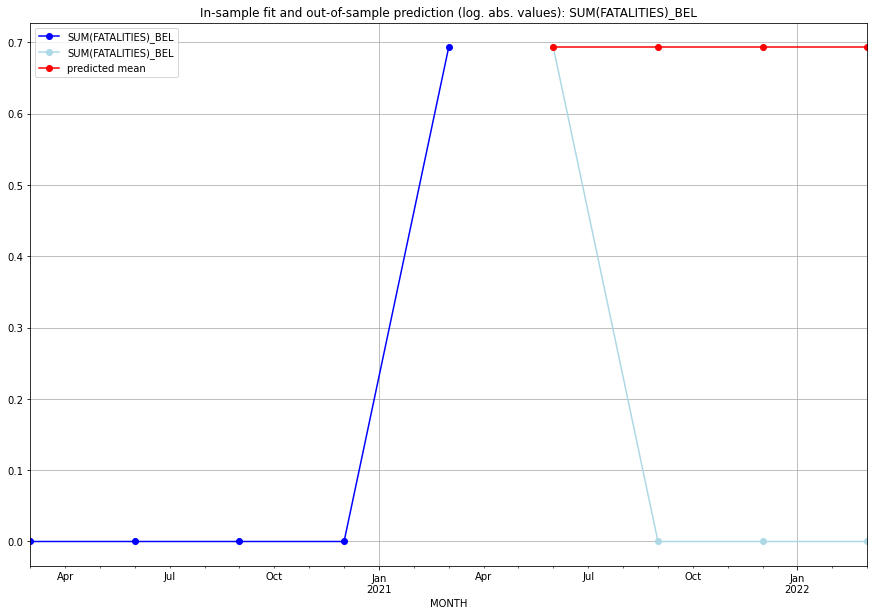

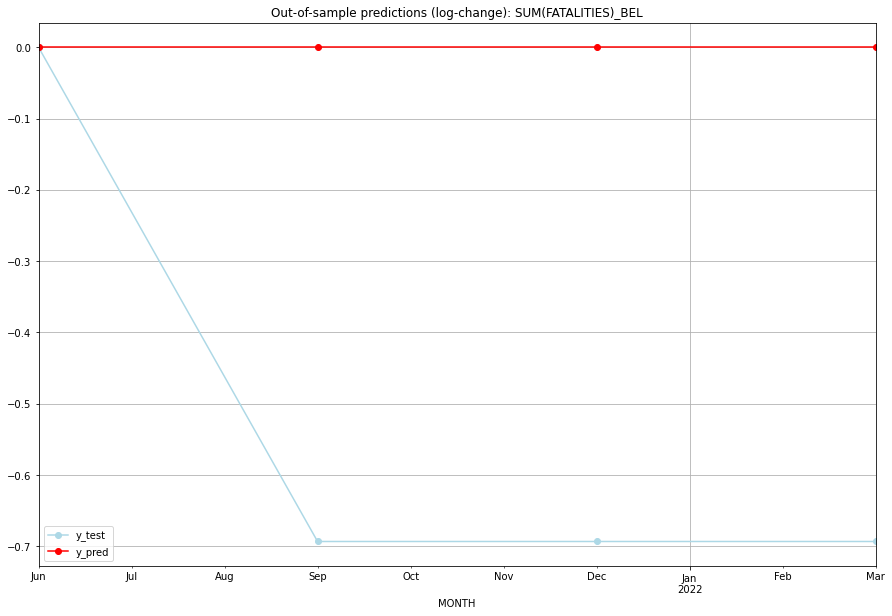

TADDA: 0.5198603854199589
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.693147    0.693147           0.0        0.000000   BEL   
1 2021-07-01  0.693147    0.000000           0.0       -0.693147   BEL   
2 2021-10-01  0.693147    0.000000           0.0       -0.693147   BEL   
3 2022-01-01  0.693147    0.000000           0.0       -0.693147   BEL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## BEN (19/234) #########
0
Neighbor countries: ['NGA', 'TGO', 'BFA', 'NER']
Getting Data for BEN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 92)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.9576463088963736, 'fold_results': [1.3555454063878782, 1.1646652378743578, 1.098672379579675, 0.6830815420730544, 0.4862669785669028]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BEN   No. Observations:                   96
Model:                SARIMAX(3, 1, 0)   Log Likelihood                 -76.020
Date:                 Wed, 19 Oct 2022   AIC                            164.040
Time:                         10:26:30   BIC                            179.363
Sample:                     04-30-1997   HQIC                           170.231
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

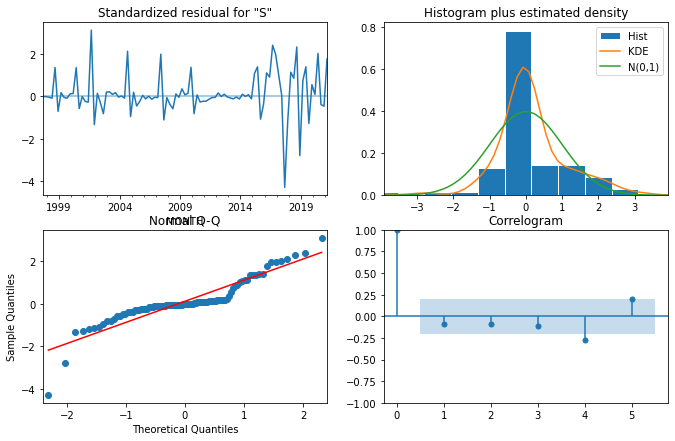

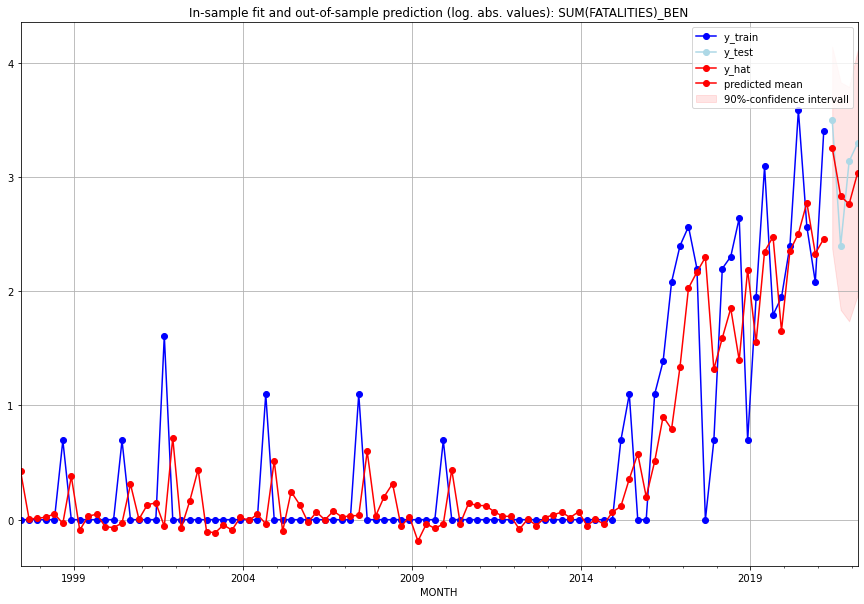

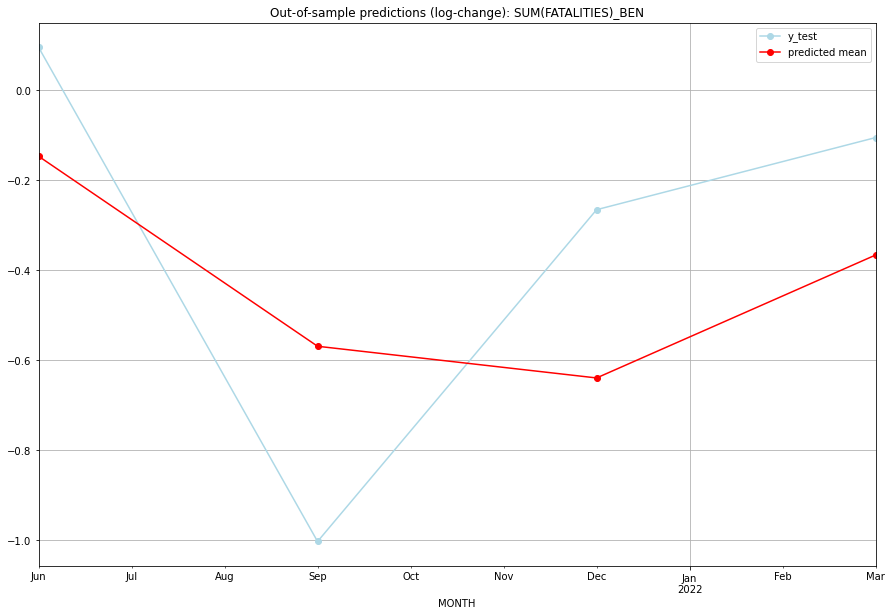

TADDA: 0.3645426203234955
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  24.902495        32.0     -0.146858        0.095310   BEN   
1 2021-07-01  15.977584        10.0     -0.569303       -1.003302   BEN   
2 2021-10-01  14.822989        22.0     -0.639733       -0.265703   BEN   
3 2022-01-01  19.795190        26.0     -0.366476       -0.105361   BEN   

                                          PARAMETERS  
0  {'params': [2, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## BES (20/234) #########
0
Neighbor countries: []
Getting Data for BES
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV

<Figure size 432x288 with 0 Axes>

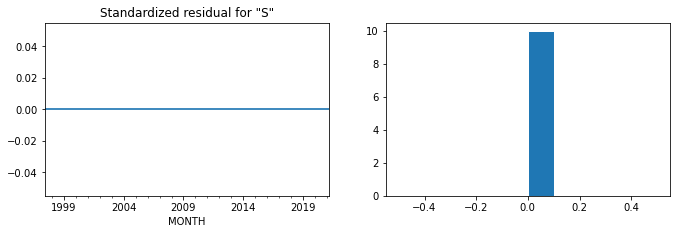

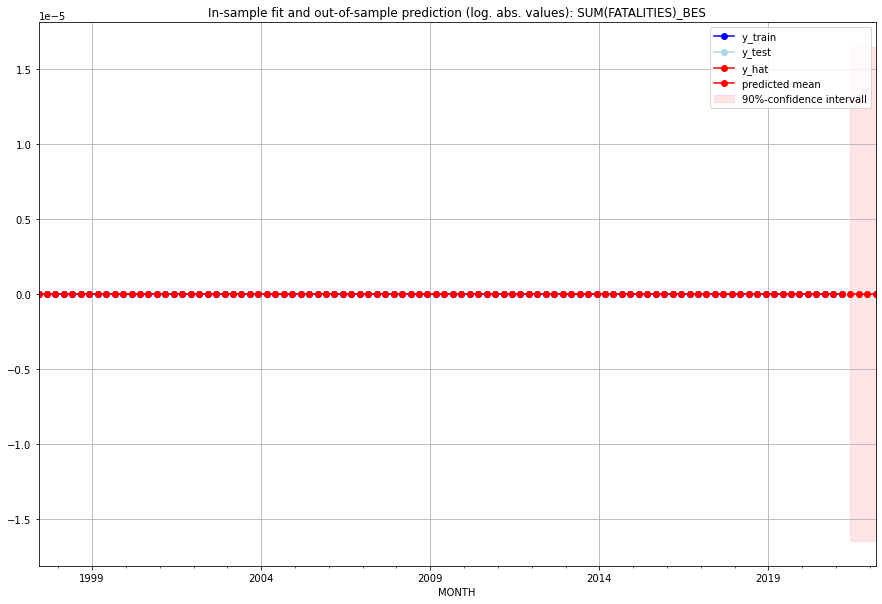

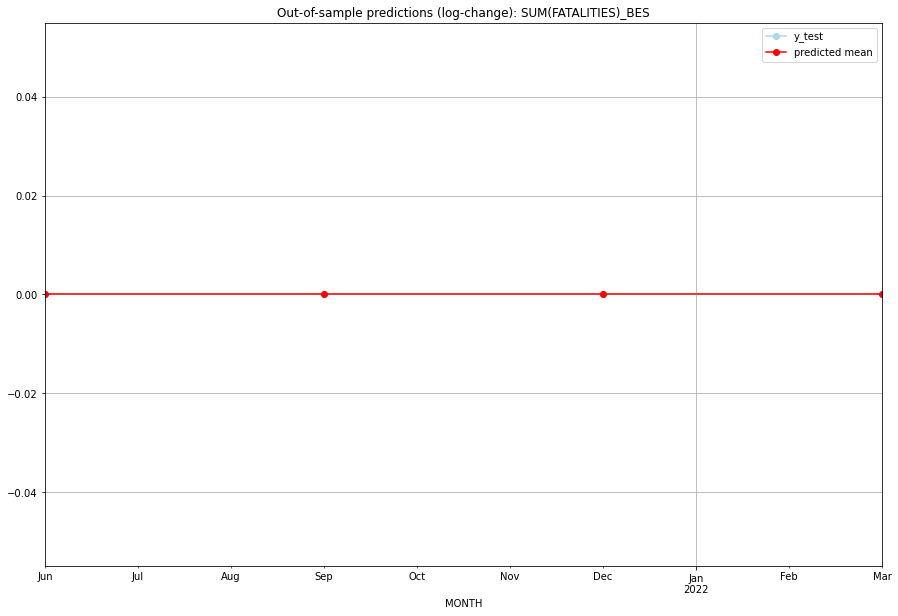

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BES   
1 2021-07-01       0.0         0.0           0.0             0.0   BES   
2 2021-10-01       0.0         0.0           0.0             0.0   BES   
3 2022-01-01       0.0         0.0           0.0             0.0   BES   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:01
######## BFA (21/234) #########
0
Neighbor countries: ['MLI', 'NER', 'CIV', 'GHA', 'TGO', 'BEN']
Getting Data for BFA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 109)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7697993293092471, 'fold_results': [0.9241653986389976, 0.37982170385995073, 0.8736529565753953, 1.1501656906489741, 0.5211908968229175]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BFA   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -155.004
Date:                 Wed, 19 Oct 2022   AIC                            312.007
Time:                         10:26:57   BIC                            314.561
Sample:                     04-30-1997   HQIC                           313.039
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

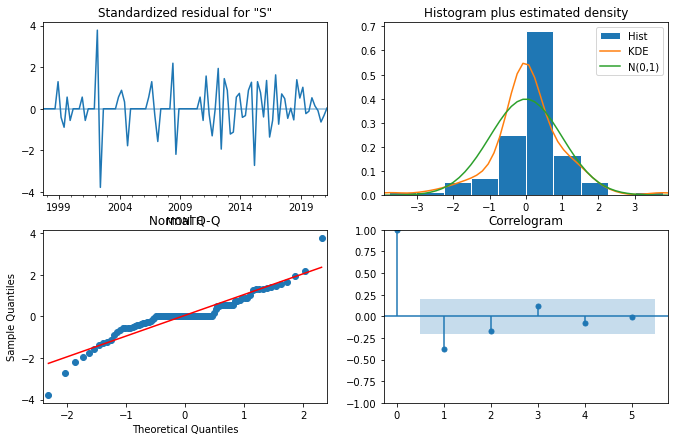

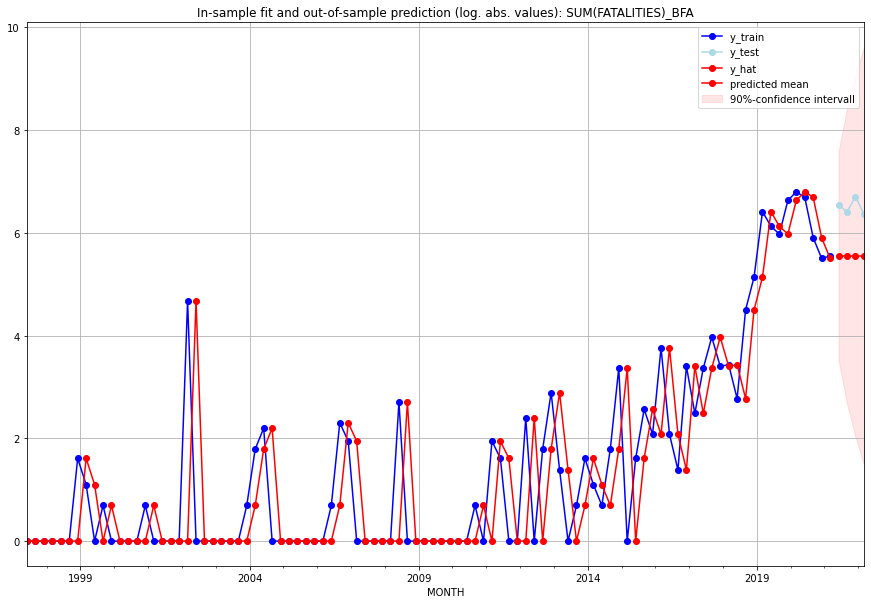

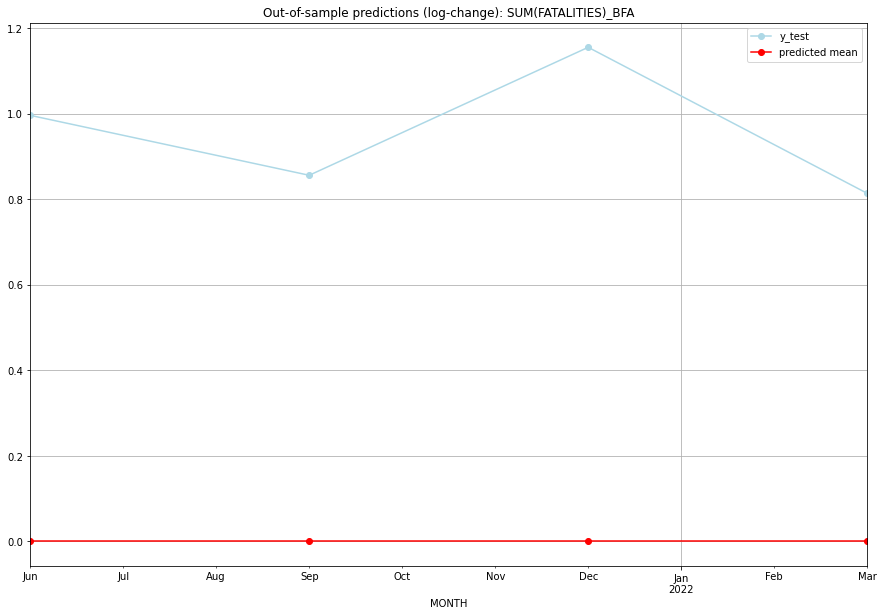

TADDA: 0.9554290593222383
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     256.0       695.0           0.0        0.996274   BFA   
1 2021-07-01     256.0       604.0           0.0        0.856152   BFA   
2 2021-10-01     256.0       815.0           0.0        1.155338   BFA   
3 2022-01-01     256.0       579.0           0.0        0.813952   BFA   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:25
######## BGD (22/234) #########
0
Neighbor countries: ['IND', 'MMR']
Getting Data for BGD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 77)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.40128785473336387, 'fold_results': [0.26151505310272727, 0.7051465774511199, 0.630906871974908, 0.31914462763834717, 0.08972614349971675]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BGD   No. Observations:                   45
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -32.975
Date:                 Wed, 19 Oct 2022   AIC                             71.950
Time:                         10:27:18   BIC                             77.302
Sample:                     01-31-2010   HQIC                            73.935
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

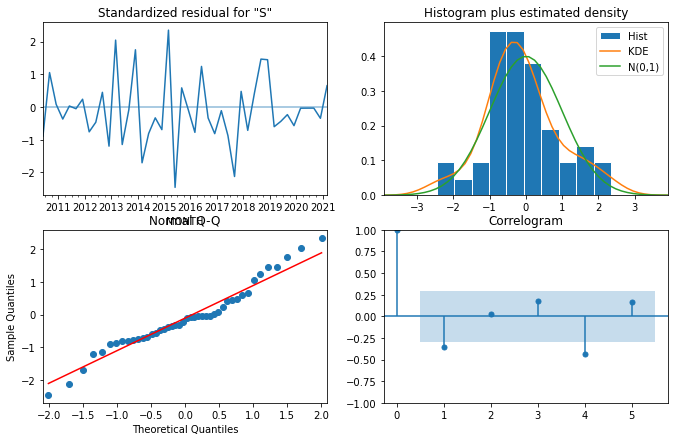

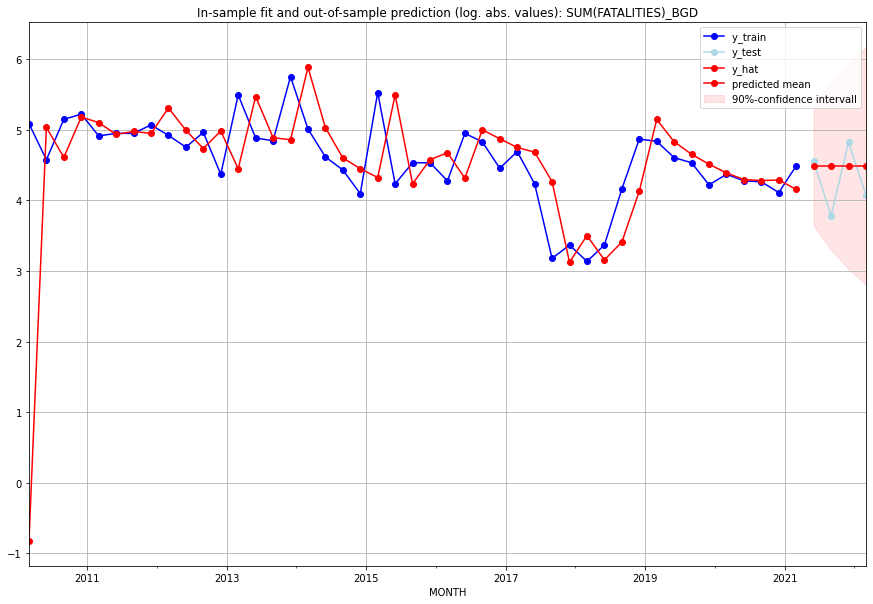

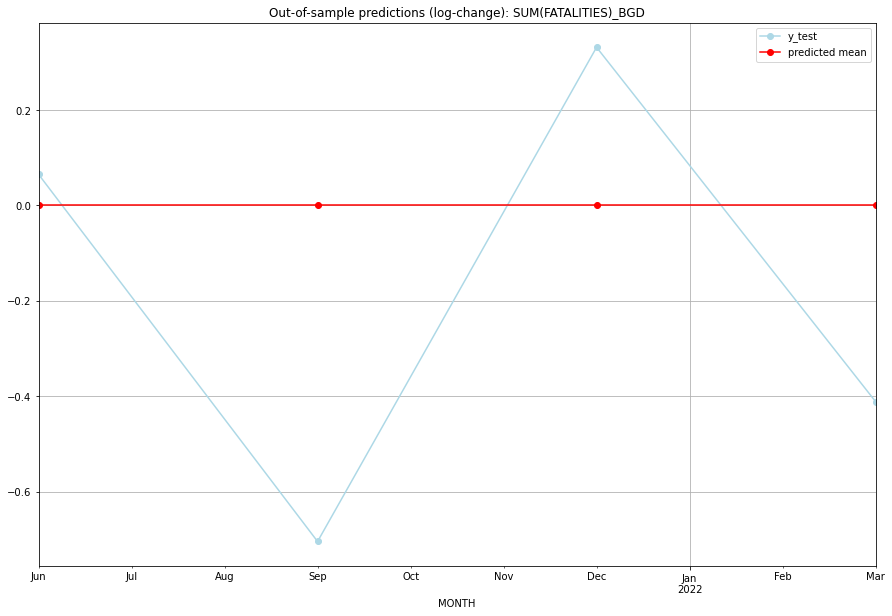

TADDA: 0.37810784484540017
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      88.0        94.0  1.776357e-15        0.065241   BGD   
1 2021-07-01      88.0        43.0  1.776357e-15       -0.704447   BGD   
2 2021-10-01      88.0       123.0  1.776357e-15        0.331645   BGD   
3 2022-01-01      88.0        58.0  1.776357e-15       -0.411099   BGD   

                                          PARAMETERS  
0  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## BGR (23/234) #########
0
Neighbor countries: ['ROU', 'SRB', 'GRC', 'MKD', 'TUR']
Getting Data for BGR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 104)
y: (17, 1)
------------------------------------------------
Training started.

<Figure size 432x288 with 0 Axes>

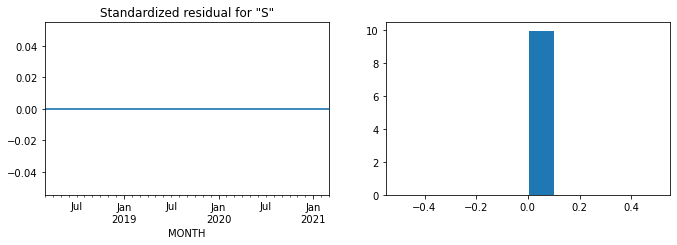

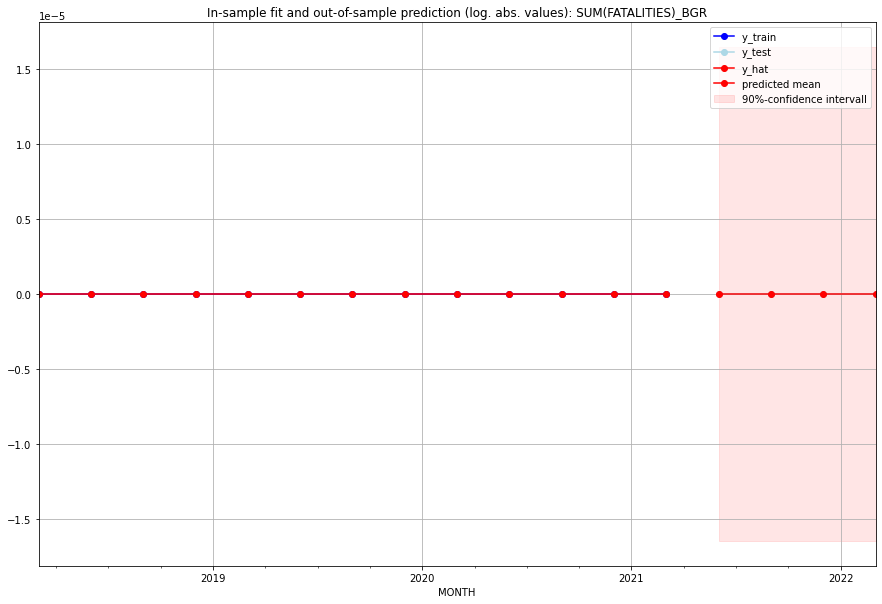

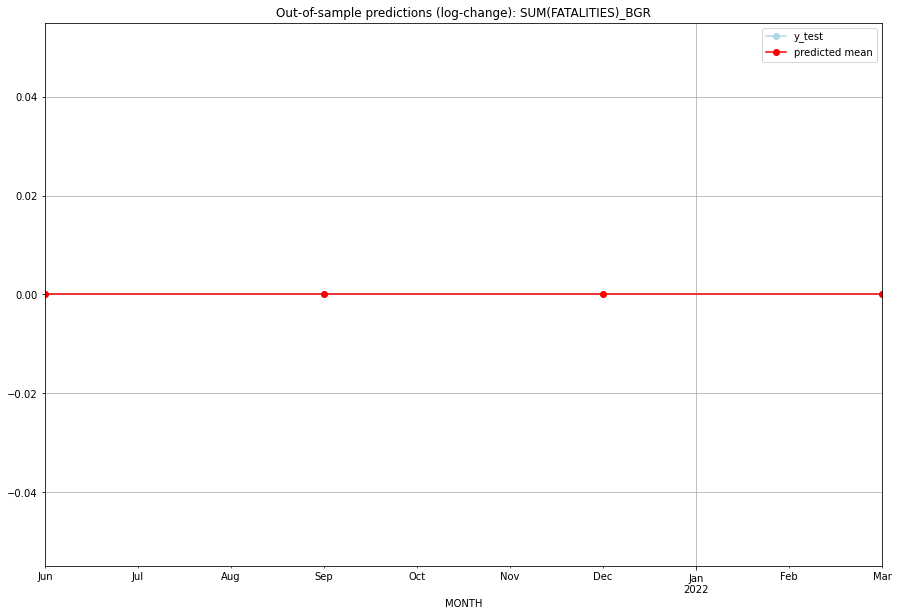

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BGR   
1 2021-07-01       0.0         0.0           0.0             0.0   BGR   
2 2021-10-01       0.0         0.0           0.0             0.0   BGR   
3 2022-01-01       0.0         0.0           0.0             0.0   BGR   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## BHR (24/234) #########
0
Neighbor countries: ['SAU']
Getting Data for BHR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 61)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.34558931796946396, 'fold_results': [1.2090704767378695, 0.0, 0.17328679513998632, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BHR   No. Observations:                   21
Model:                         SARIMAX   Log Likelihood                 -24.066
Date:                 Wed, 19 Oct 2022   AIC                             50.131
Time:                         10:27:36   BIC                             51.176
Sample:                     01-31-2016   HQIC                            50.358
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.

<Figure size 432x288 with 0 Axes>

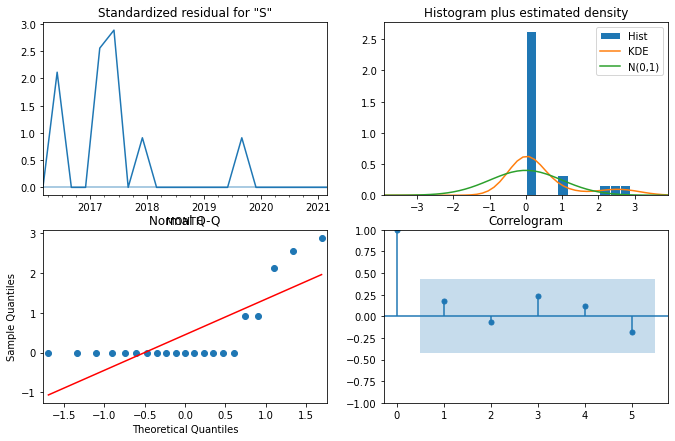

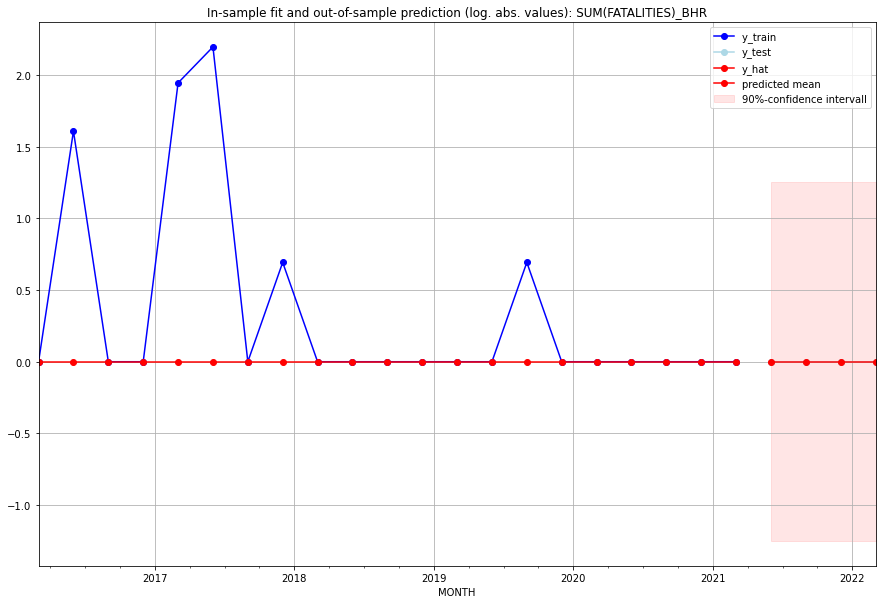

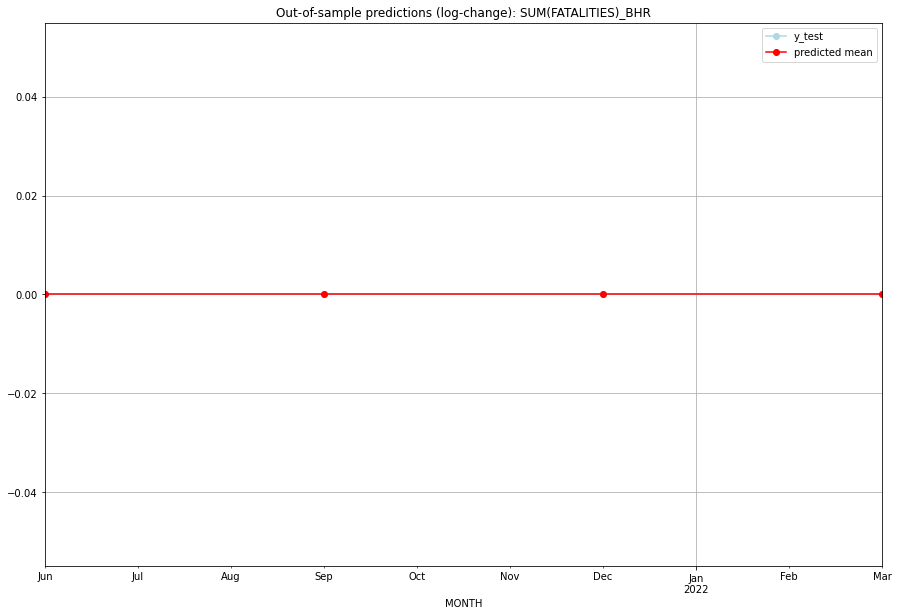

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BHR   
1 2021-07-01       0.0         0.0           0.0             0.0   BHR   
2 2021-10-01       0.0         0.0           0.0             0.0   BHR   
3 2022-01-01       0.0         0.0           0.0             0.0   BHR   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## BHS (25/234) #########
0
Neighbor countries: []
Getting Data for BHS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 52)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 paramete

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BHS   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                  -6.138
Date:                 Wed, 19 Oct 2022   AIC                             18.277
Time:                         10:27:52   BIC                             19.972
Sample:                     01-31-2018   HQIC                            17.929
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.4703      0.314      1.499      0.134      -0.144       1

<Figure size 432x288 with 0 Axes>

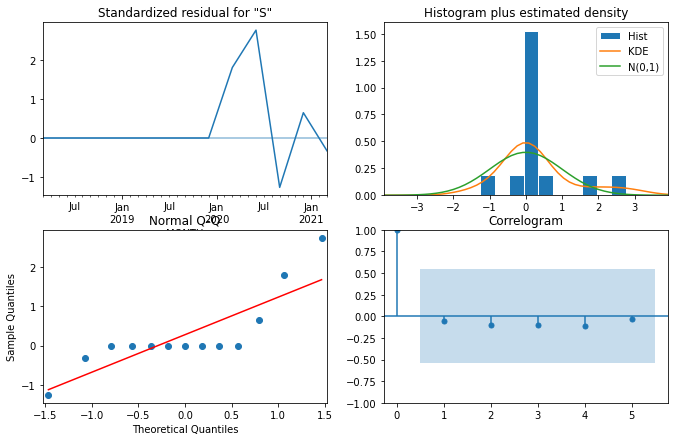

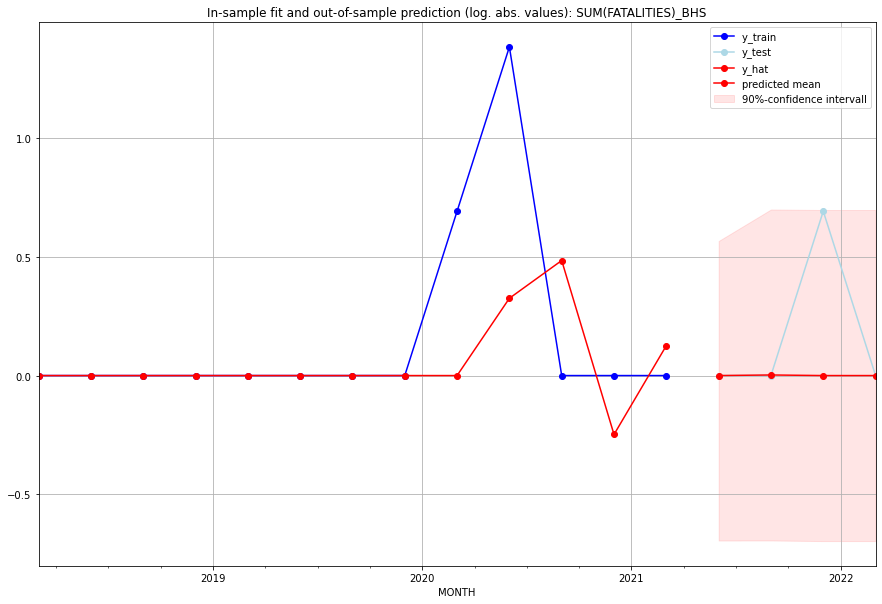

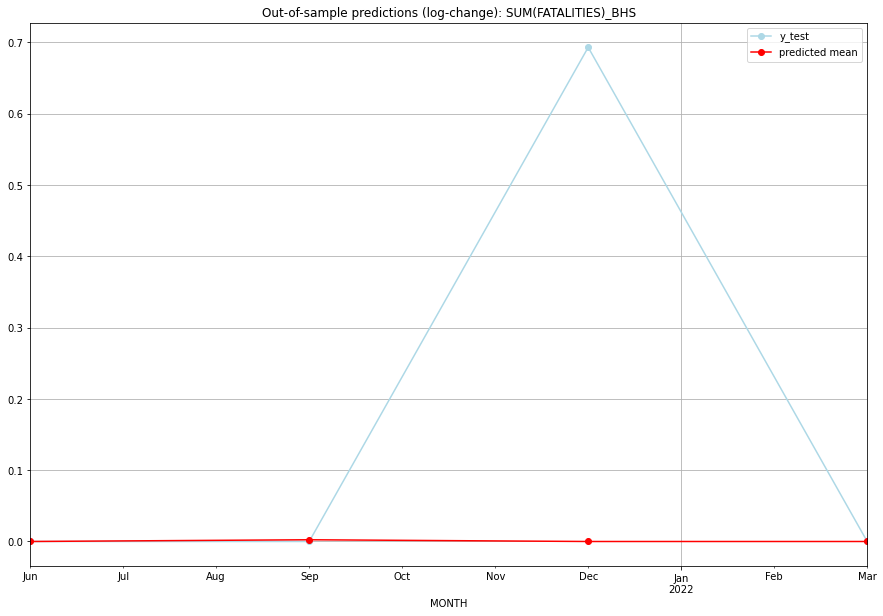

TADDA: 0.17389465902325324
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.000000         0.0      0.000000        0.000000   BHS   
1 2021-07-01  0.002434         0.0      0.002431        0.000000   BHS   
2 2021-10-01  0.000000         1.0      0.000000        0.693147   BHS   
3 2022-01-01  0.000000         0.0      0.000000        0.000000   BHS   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## BIH (26/234) #########
0
Neighbor countries: ['HRV', 'MNE', 'SRB']
Getting Data for BIH
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 85)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEAR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 7.747845836802057e-06, 'fold_results': [1.4992885990382752e-05, 5.028056832213625e-07]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BIH   No. Observations:                   13
Model:                SARIMAX(3, 1, 1)   Log Likelihood                   0.678
Date:                 Wed, 19 Oct 2022   AIC                              8.644
Time:                         10:27:58   BIC                             11.068
Sample:                     01-31-2018   HQIC                             7.746
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.76

<Figure size 432x288 with 0 Axes>

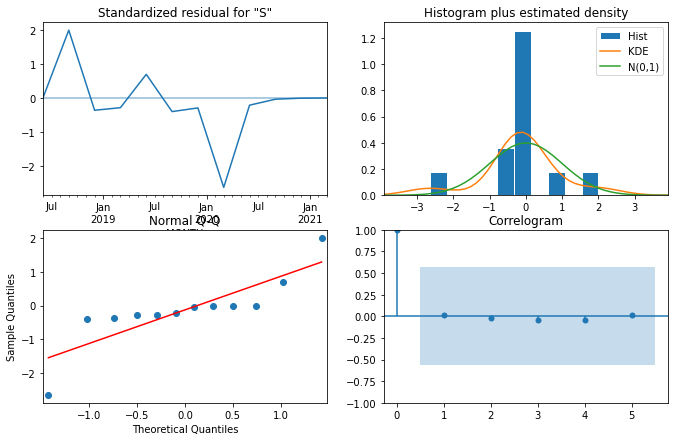

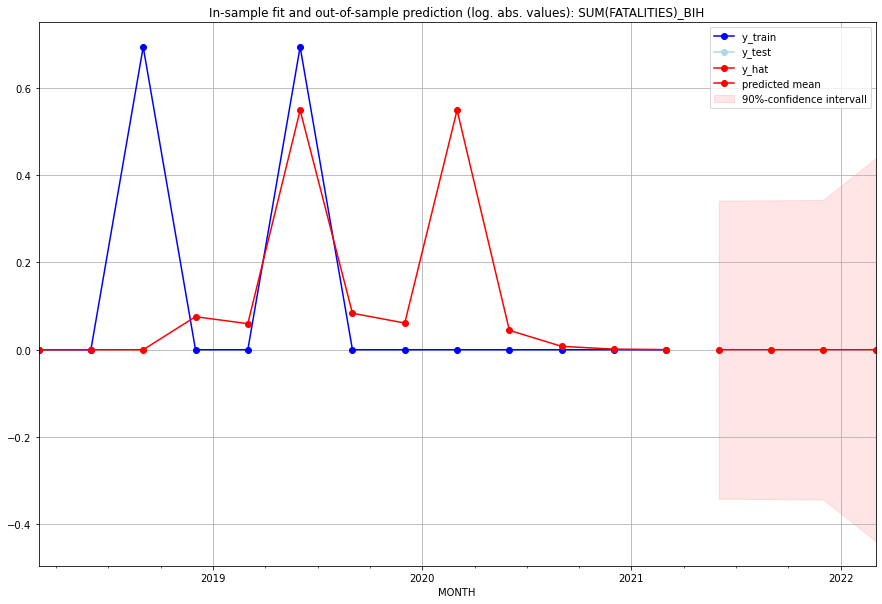

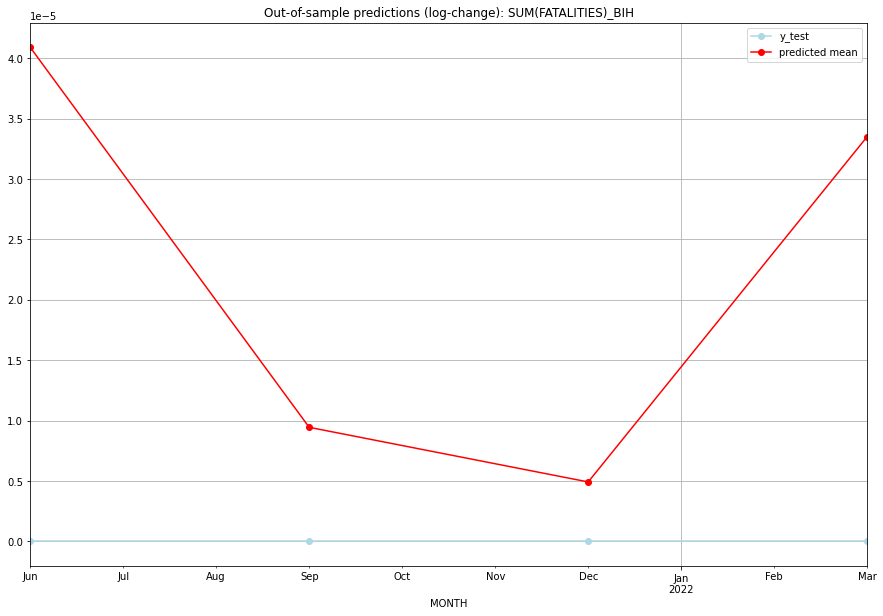

TADDA: 2.2199771436197002e-05
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.000041         0.0      0.000041             0.0   BIH   
1 2021-07-01  0.000009         0.0      0.000009             0.0   BIH   
2 2021-10-01  0.000005         0.0      0.000005             0.0   BIH   
3 2022-01-01  0.000034         0.0      0.000034             0.0   BIH   

                                          PARAMETERS  
0  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## BLM (27/234) #########
0
Neighbor countries: []
Getting Data for BLM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV 

<Figure size 432x288 with 0 Axes>

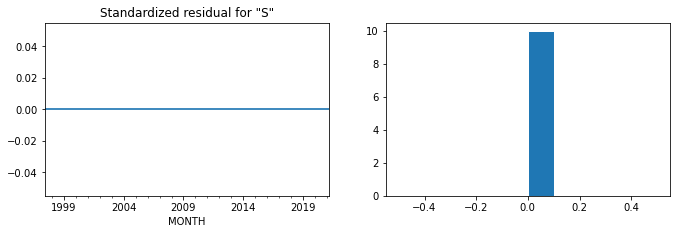

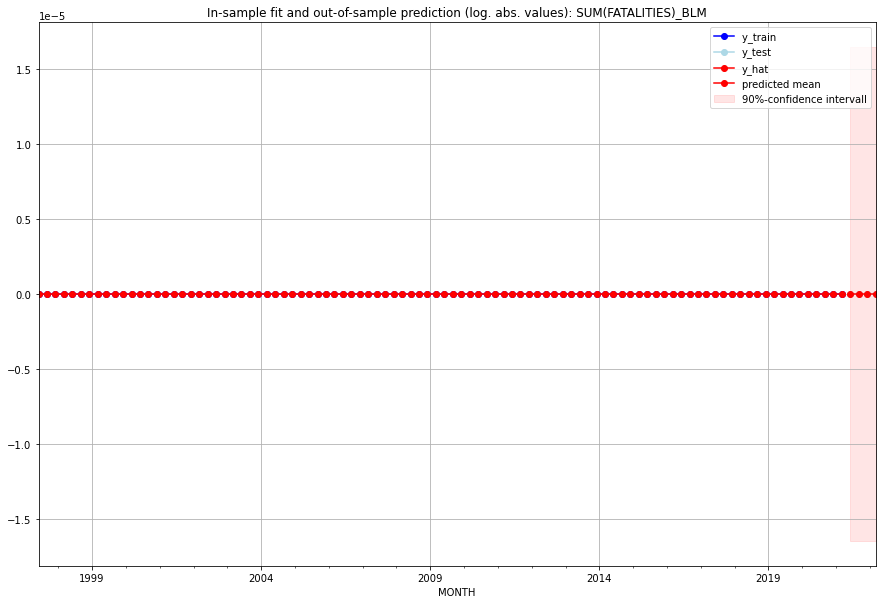

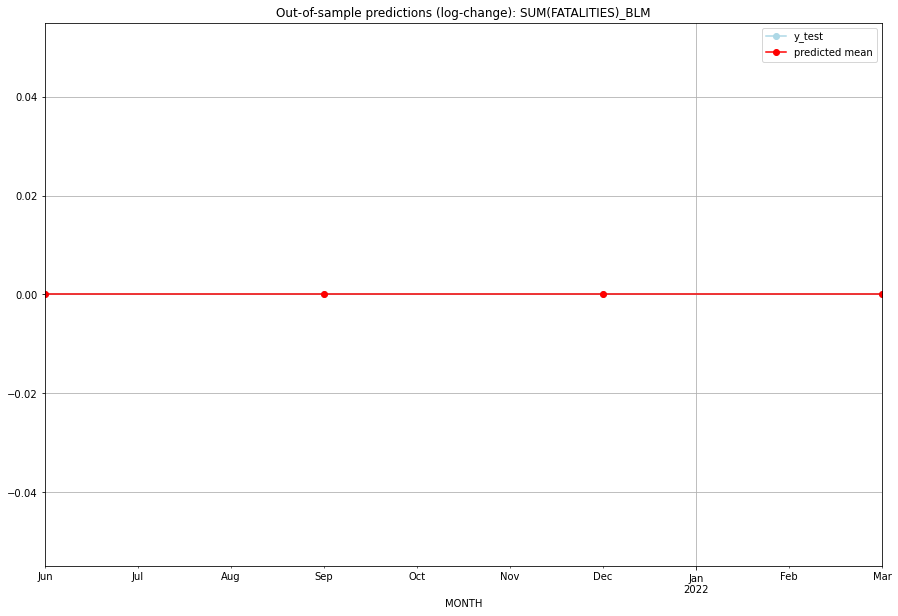

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BLM   
1 2021-07-01       0.0         0.0           0.0             0.0   BLM   
2 2021-10-01       0.0         0.0           0.0             0.0   BLM   
3 2022-01-01       0.0         0.0           0.0             0.0   BLM   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:05
######## BLR (28/234) #########
0
Neighbor countries: ['POL', 'UKR', 'RUS', 'LTU', 'LVA']
Getting Data for BLR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 102)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BLR   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                  -9.430
Date:                 Wed, 19 Oct 2022   AIC                             24.861
Time:                         10:28:17   BIC                             26.555
Sample:                     01-31-2018   HQIC                            24.512
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.3589      2.067      0.174      0.862      -3.692       4

<Figure size 432x288 with 0 Axes>

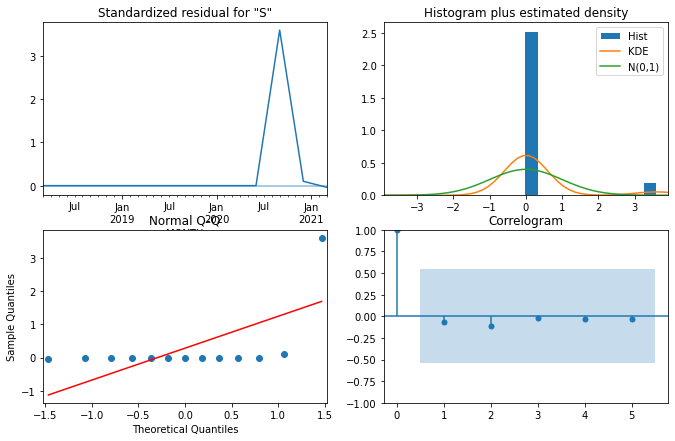

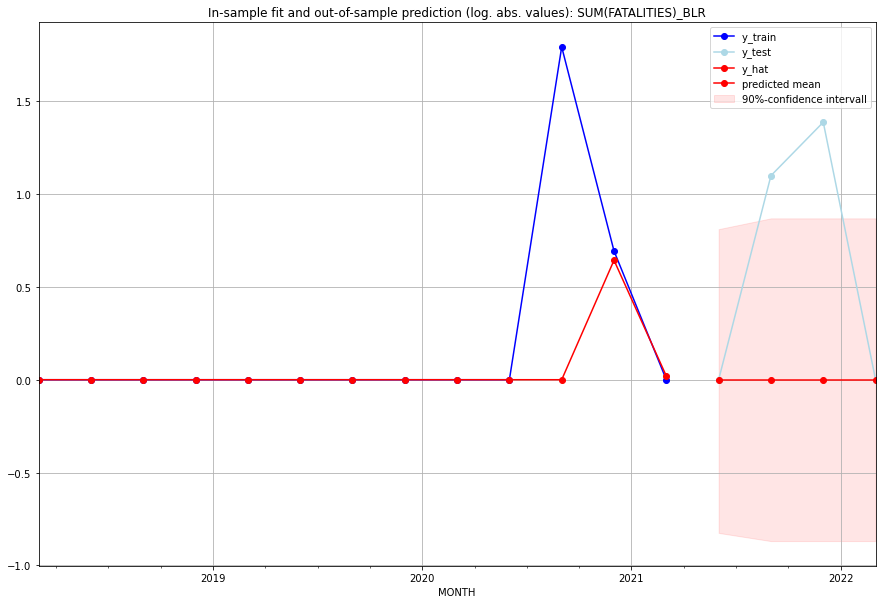

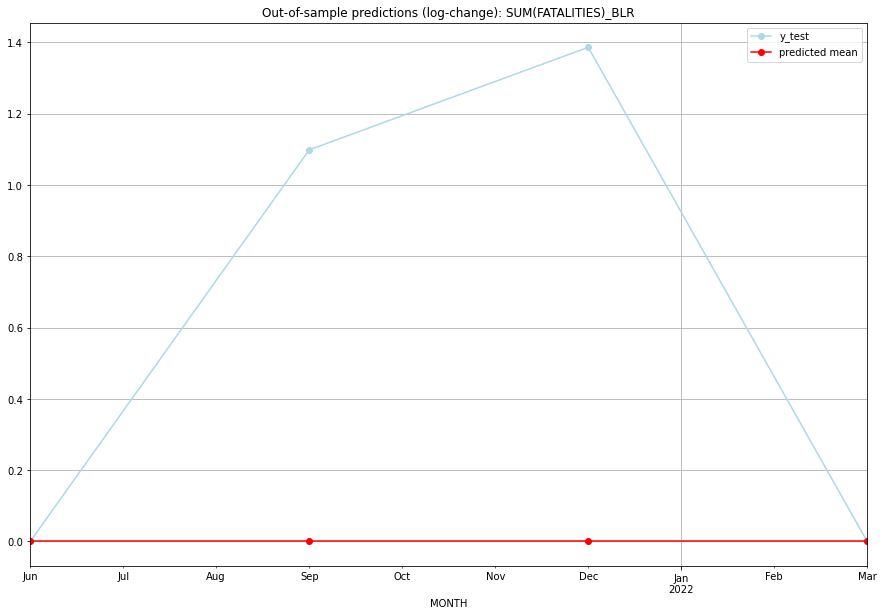

TADDA: 0.6212266624470001
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   BLR   
1 2021-07-01       0.0         2.0           0.0        1.098612   BLR   
2 2021-10-01       0.0         3.0           0.0        1.386294   BLR   
3 2022-01-01       0.0         0.0           0.0        0.000000   BLR   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## BLZ (29/234) #########
0
Neighbor countries: ['GTM', 'MEX']
Getting Data for BLZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 73)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.31495479682929317, 'fold_results': [0.34892706949548646, 0.2809825241630999]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BLZ   No. Observations:                   13
Model:                SARIMAX(0, 1, 1)   Log Likelihood                  -7.750
Date:                 Wed, 19 Oct 2022   AIC                             19.501
Time:                         10:28:27   BIC                             20.471
Sample:                     01-31-2018   HQIC                            19.142
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.9985     8

<Figure size 432x288 with 0 Axes>

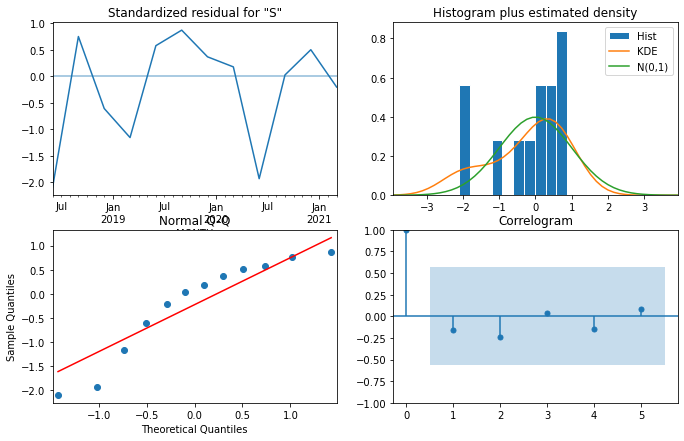

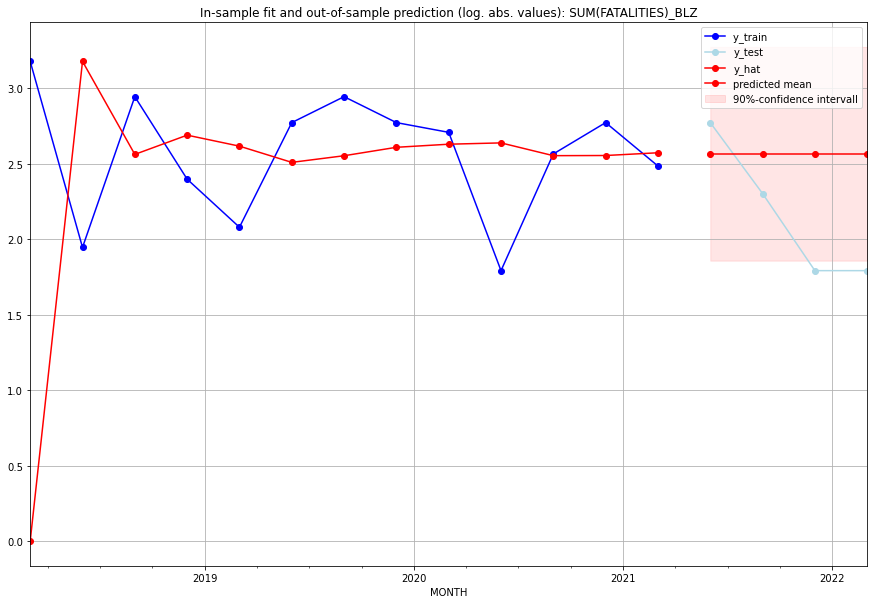

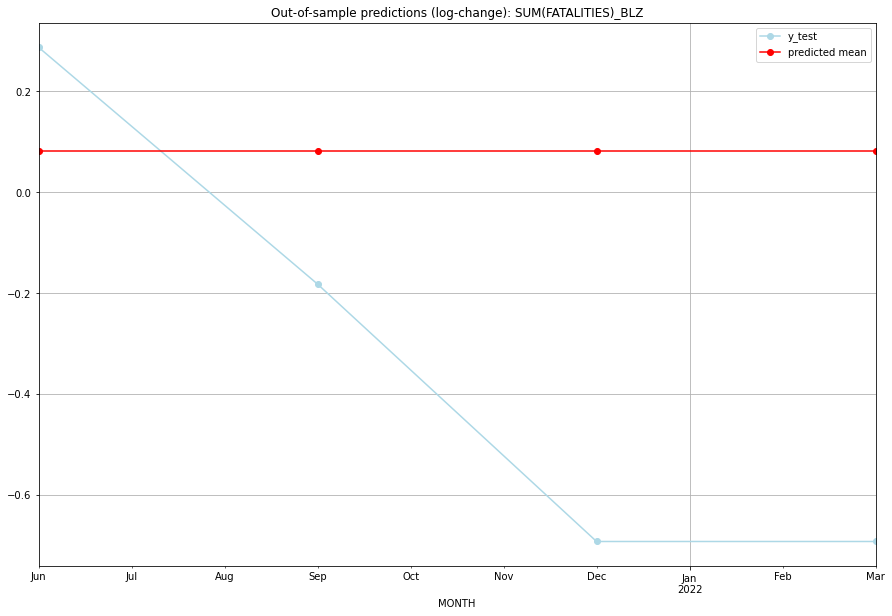

TADDA: 0.5654014438381235
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  12.013252        15.0      0.081062        0.287682   BLZ   
1 2021-07-01  12.013252         9.0      0.081062       -0.182322   BLZ   
2 2021-10-01  12.013252         5.0      0.081062       -0.693147   BLZ   
3 2022-01-01  12.013252         5.0      0.081062       -0.693147   BLZ   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## BMU (30/234) #########
0
Neighbor countries: []
Getting Data for BMU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 25)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficie

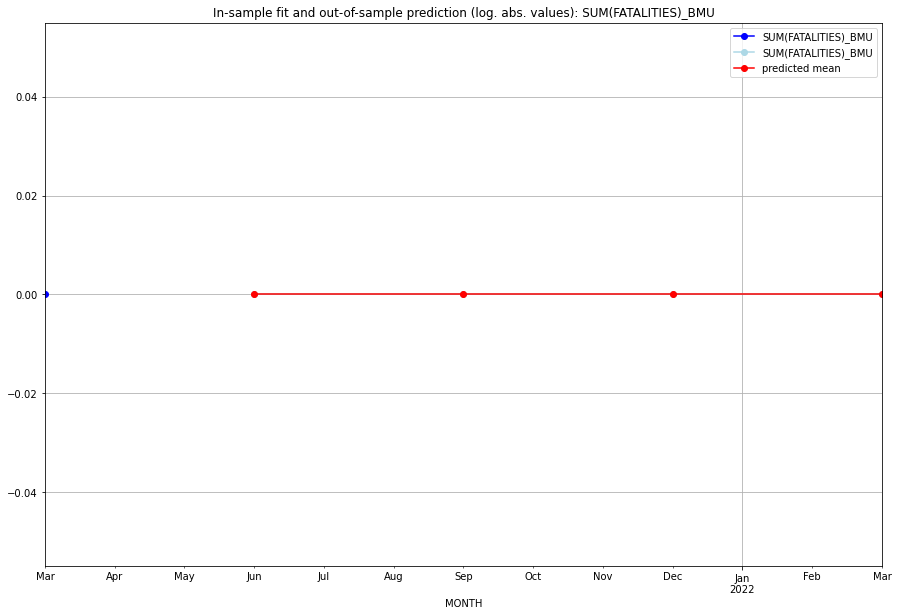

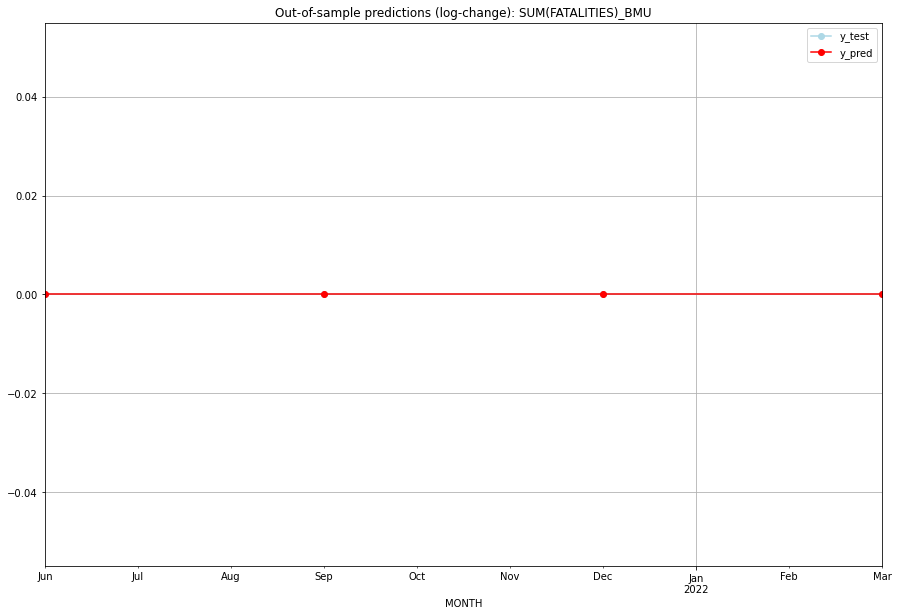

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BMU   
1 2021-07-01       0.0         0.0           0.0             0.0   BMU   
2 2021-10-01       0.0         0.0           0.0             0.0   BMU   
3 2022-01-01       0.0         0.0           0.0             0.0   BMU   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## BOL (31/234) #########
0
Neighbor countries: ['PRY', 'BRA', 'CHL', 'PER', 'ARG']
Getting Data for BOL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 103)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.8425572985442206, 'fold_results': [0.8425572985442206, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BOL   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                 -13.391
Date:                 Wed, 19 Oct 2022   AIC                             42.782
Time:                         10:28:42   BIC                             47.302
Sample:                     01-31-2018   HQIC                            41.853
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.4090      0.192     -2.135 

<Figure size 432x288 with 0 Axes>

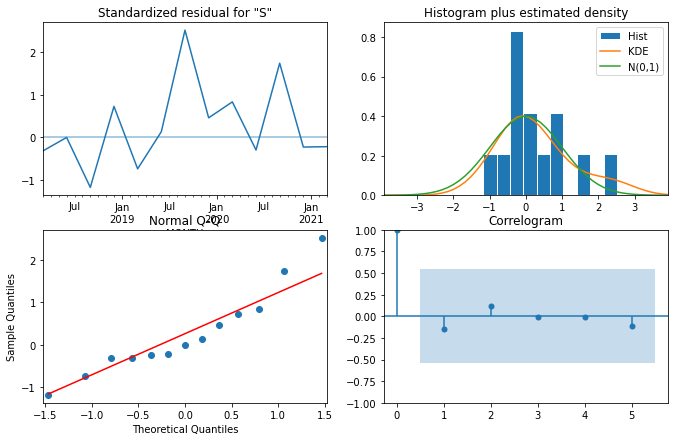

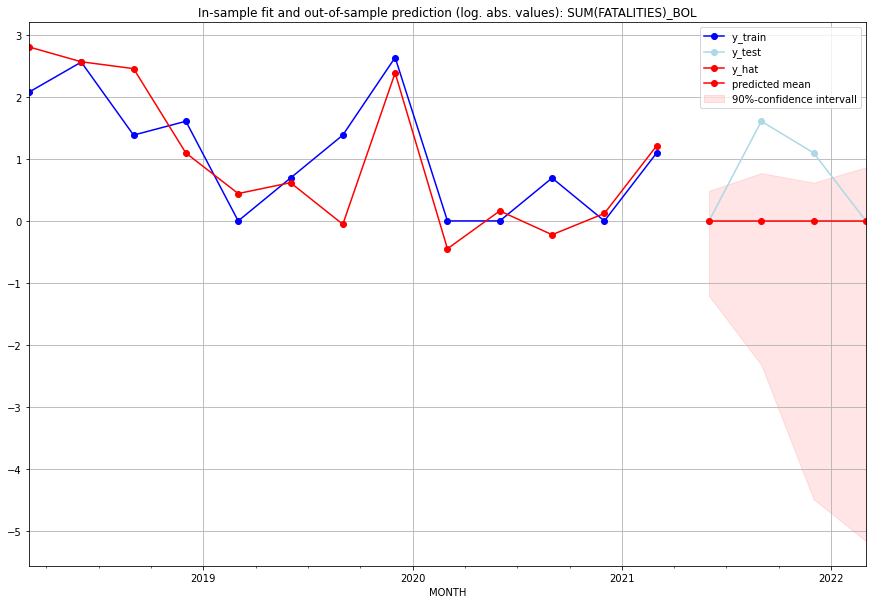

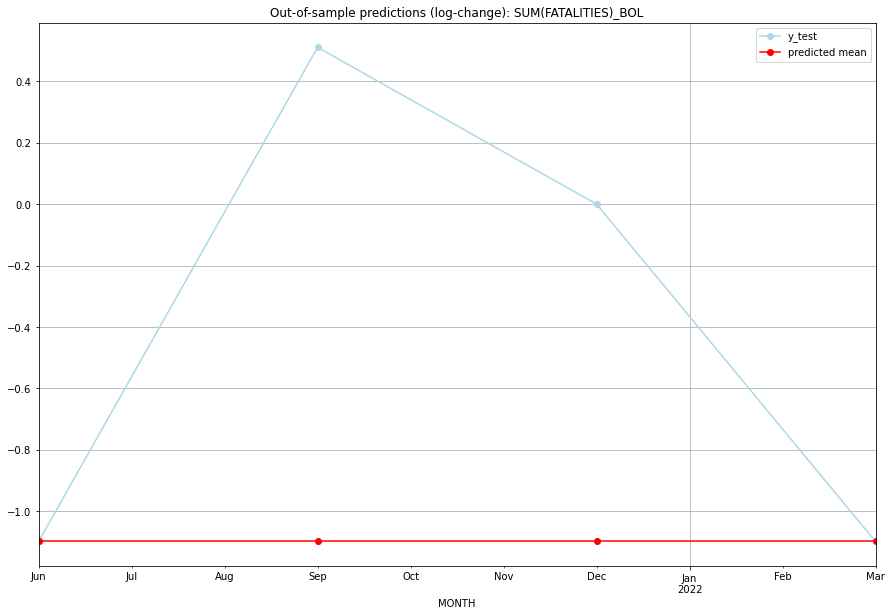

TADDA: 0.9516656224425801
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -1.098612       -1.098612   BOL   
1 2021-07-01       0.0         4.0     -1.098612        0.510826   BOL   
2 2021-10-01       0.0         2.0     -1.098612        0.000000   BOL   
3 2022-01-01       0.0         0.0     -1.098612       -1.098612   BOL   

                                          PARAMETERS  
0  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## BRA (32/234) #########
0
Neighbor countries: ['BOL', 'PRY', 'GUY', 'SUR', 'ARG', 'PER', 'URY', 'VEN', 'GUF', 'COL']
Getting Data for BRA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 143)
y: (17, 1)
--------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.04173528847892327, 'fold_results': [0.05119656032893105, 0.03227401662891549]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BRA   No. Observations:                   13
Model:                SARIMAX(3, 1, 1)   Log Likelihood                  14.286
Date:                 Wed, 19 Oct 2022   AIC                            -12.572
Time:                         10:28:55   BIC                             -8.693
Sample:                     01-31-2018   HQIC                           -14.008
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0294     

<Figure size 432x288 with 0 Axes>

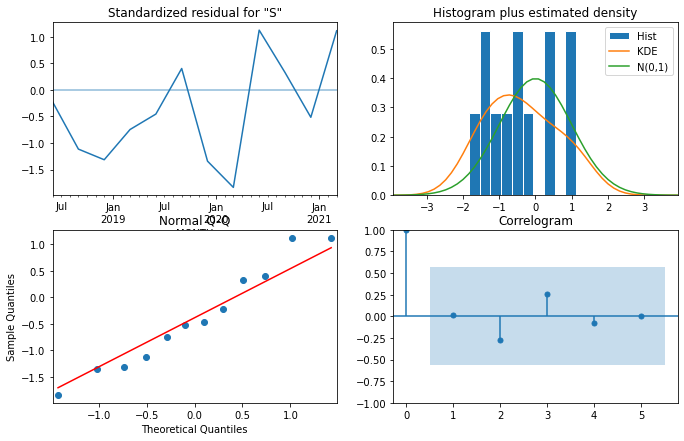

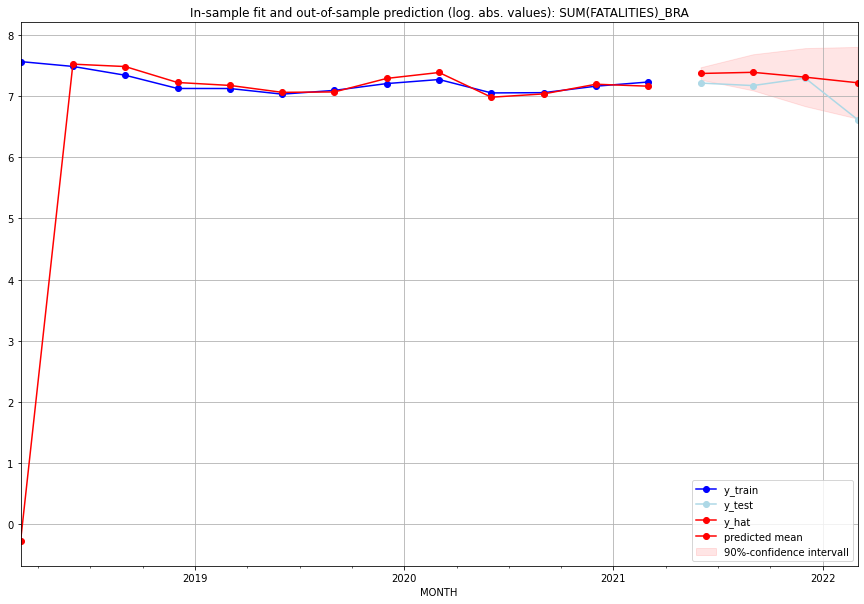

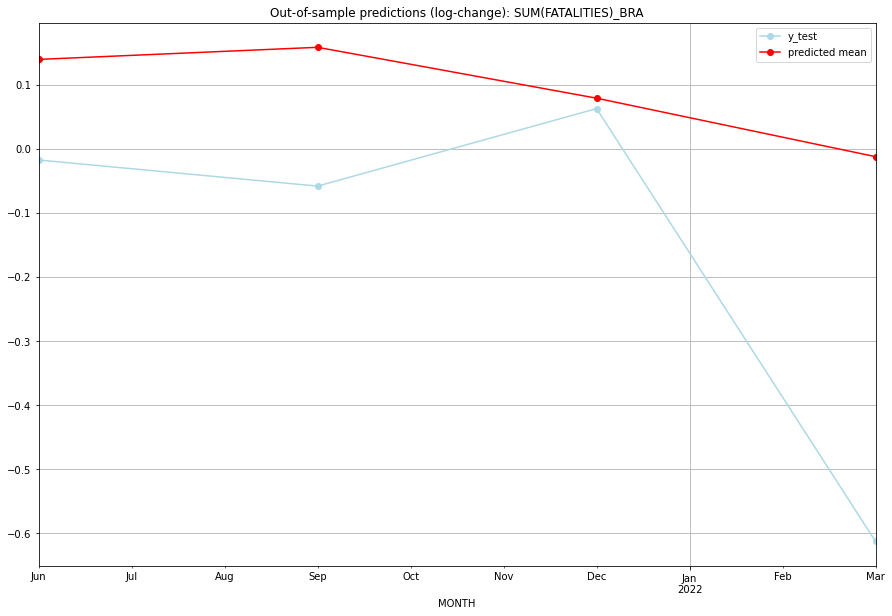

TADDA: 0.3220240758155155
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1581.982480      1352.0      0.139403       -0.017583   BRA   
1 2021-07-01  1612.147364      1298.0      0.158280       -0.058312   BRA   
2 2021-10-01  1489.050953      1465.0      0.078903        0.062630   BRA   
3 2022-01-01  1359.063925       745.0     -0.012376       -0.612937   BRA   

                                          PARAMETERS  
0  {'params': [3, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## BRB (33/234) #########
0
Neighbor countries: []
Getting Data for BRB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 54)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BRB   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                  -2.997
Date:                 Wed, 19 Oct 2022   AIC                             11.993
Time:                         10:29:17   BIC                             13.688
Sample:                     01-31-2018   HQIC                            11.645
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1      -1.276e-06   6.03e+04  -2.11e-11      1.000   -1.18e+05    1.18

<Figure size 432x288 with 0 Axes>

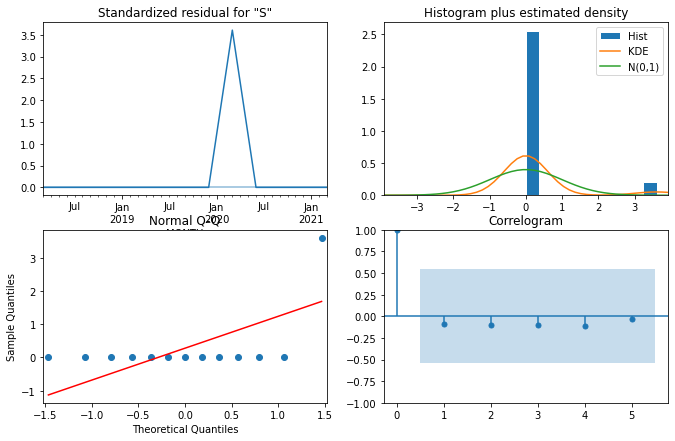

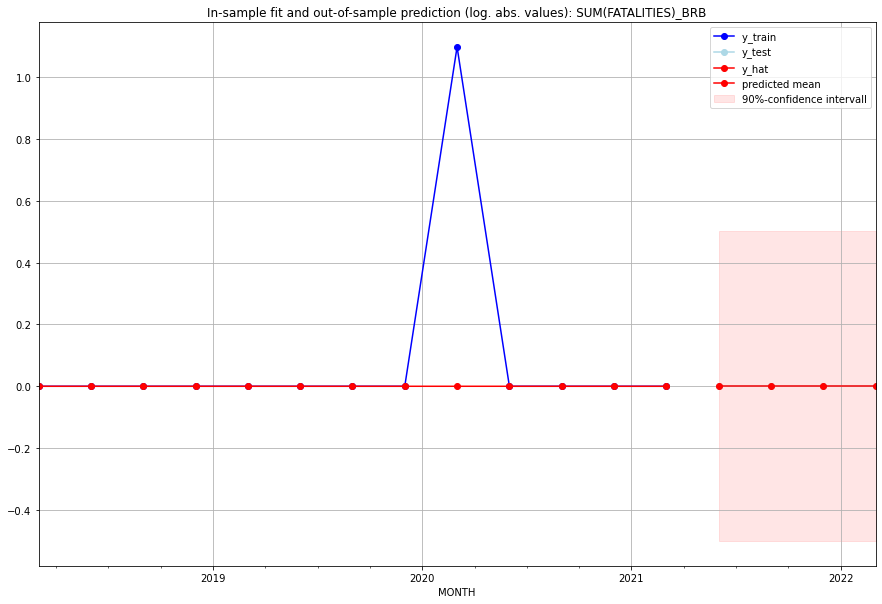

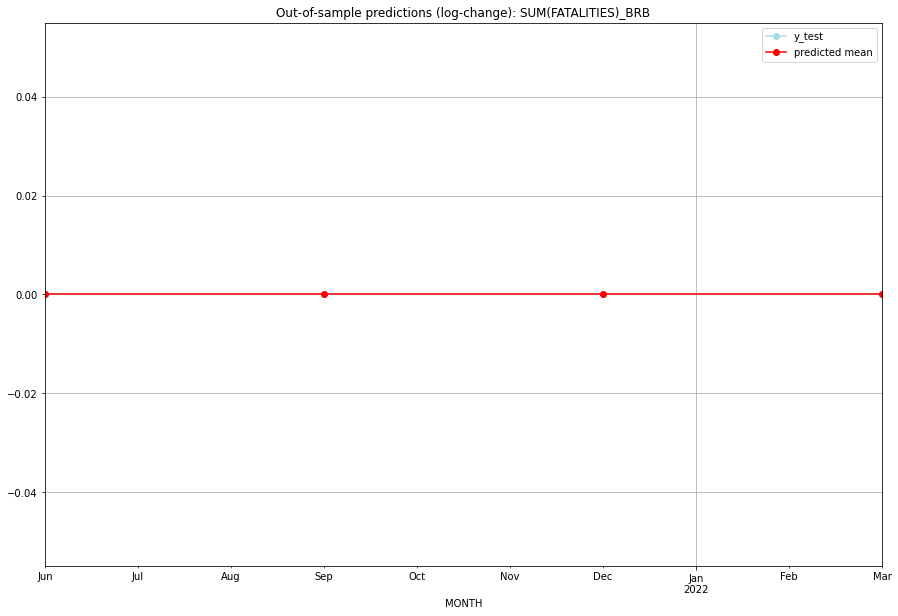

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BRB   
1 2021-07-01       0.0         0.0           0.0             0.0   BRB   
2 2021-10-01       0.0         0.0           0.0             0.0   BRB   
3 2022-01-01       0.0         0.0           0.0             0.0   BRB   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## BRN (34/234) #########
0
Neighbor countries: ['MYS']
Getting Data for BRN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 60)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cro

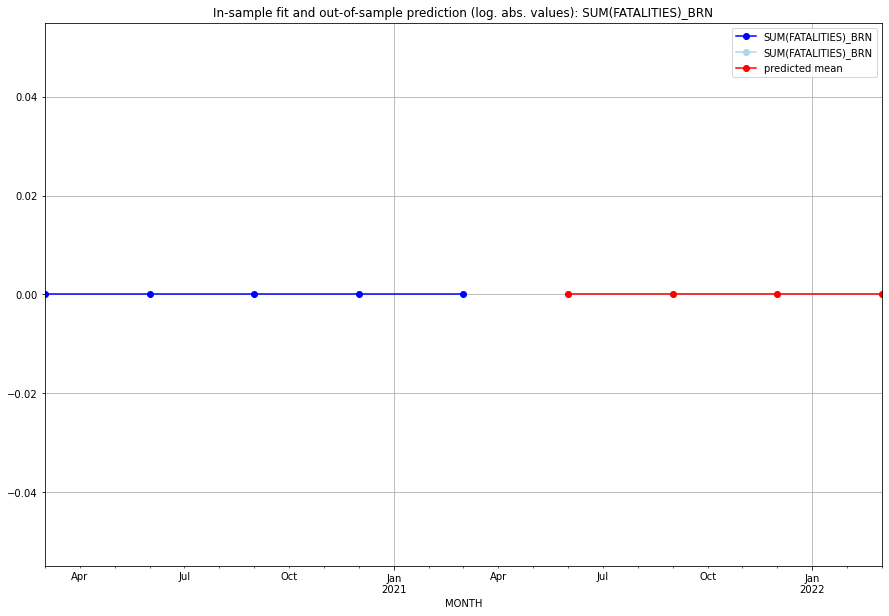

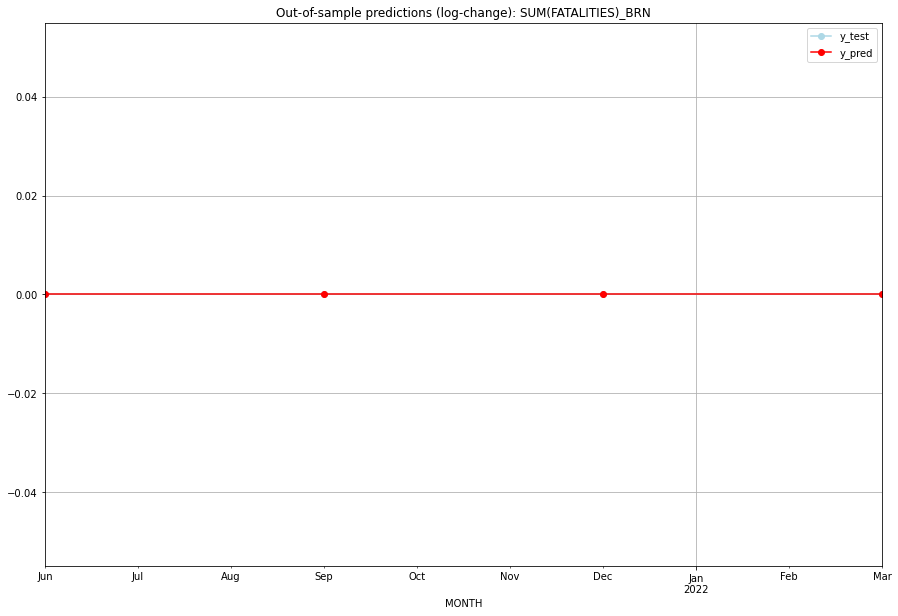

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BRN   
1 2021-07-01       0.0         0.0           0.0             0.0   BRN   
2 2021-10-01       0.0         0.0           0.0             0.0   BRN   
3 2022-01-01       0.0         0.0           0.0             0.0   BRN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## BTN (35/234) #########
0
Neighbor countries: ['IND', 'CHN']
Getting Data for BTN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 75)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


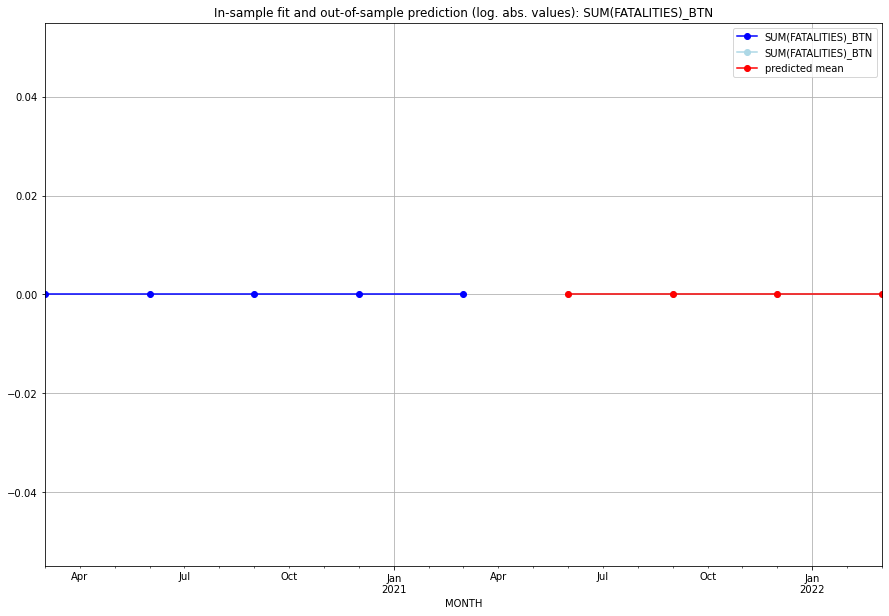

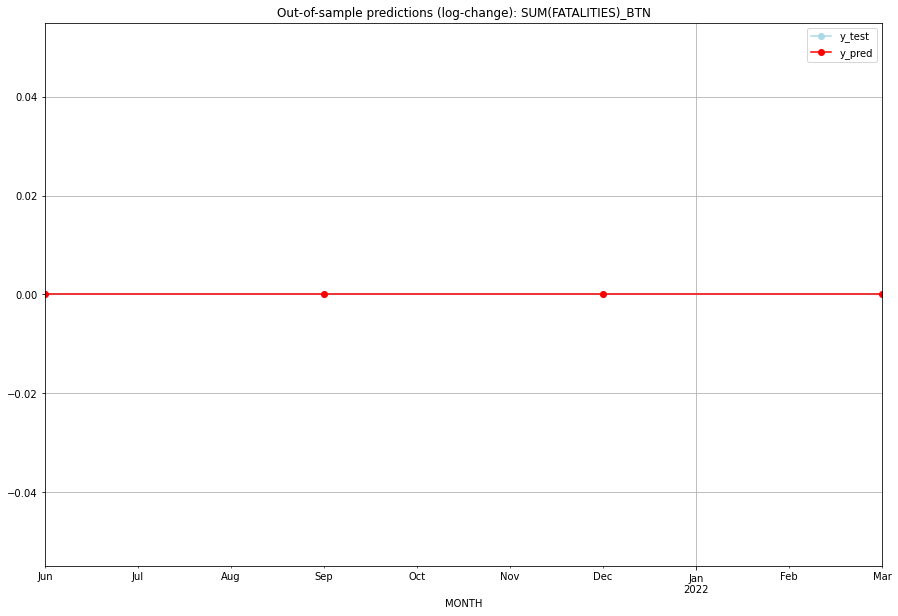

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BTN   
1 2021-07-01       0.0         0.0           0.0             0.0   BTN   
2 2021-10-01       0.0         0.0           0.0             0.0   BTN   
3 2022-01-01       0.0         0.0           0.0             0.0   BTN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## BWA (36/234) #########
0
Neighbor countries: ['ZWE', 'NAM', 'ZAF', 'ZMB']
Getting Data for BWA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 93)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.1835226572876713, 'fold_results': [0.0, 0.0, 0.17344986470246931, 4.723799408323792e-05, 0.744116183741804]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BWA   No. Observations:                   96
Model:                SARIMAX(1, 0, 1)   Log Likelihood                   0.541
Date:                 Wed, 19 Oct 2022   AIC                              8.918
Time:                         10:29:41   BIC                             21.740
Sample:                     04-30-1997   HQIC                            14.101
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

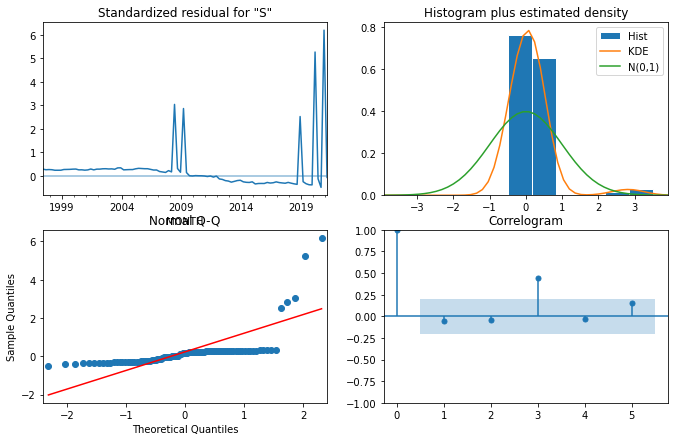

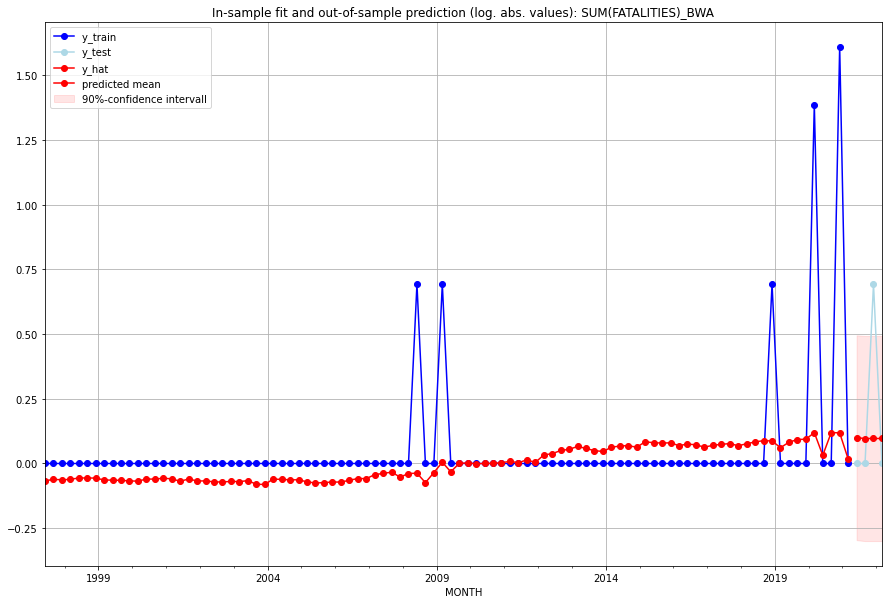

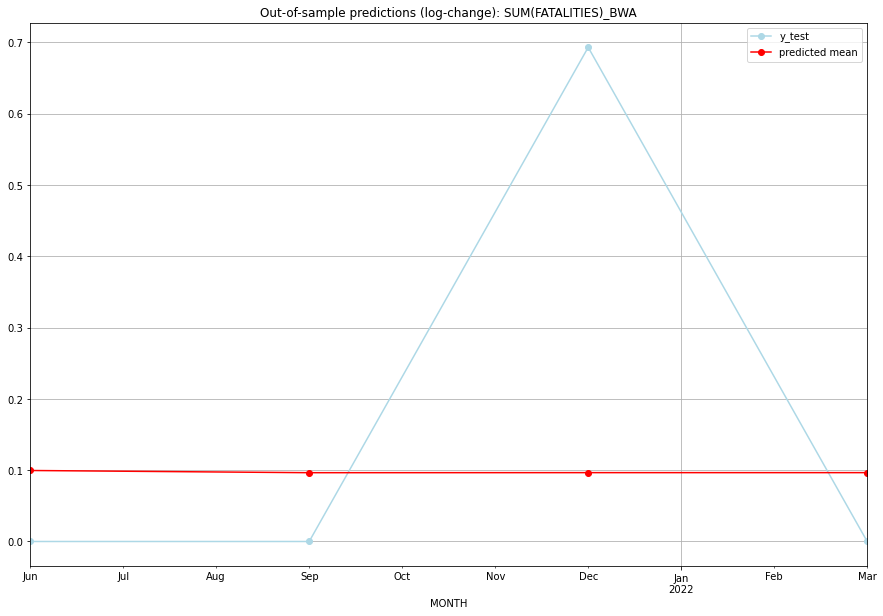

TADDA: 0.22230704196364912
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.104716         0.0      0.099588        0.000000   BWA   
1 2021-07-01  0.101304         0.0      0.096495        0.000000   BWA   
2 2021-10-01  0.101394         1.0      0.096577        0.693147   BWA   
3 2022-01-01  0.101392         0.0      0.096575        0.000000   BWA   

                                          PARAMETERS  
0  {'params': [2, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## CAF (37/234) #########
0
Neighbor countries: ['CMR', 'COD', 'TCD', 'COG', 'SDN', 'XKK', 'SSD']
Getting Data for CAF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 115)
y: (100, 1)
------------------------------------------------
T

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4498239892155434, 'fold_results': [0.668450764064539, 0.2589748777384302, 0.47096401014559675, 0.3748985726374727, 0.4758317214916785]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CAF   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -178.078
Date:                 Wed, 19 Oct 2022   AIC                            362.157
Time:                         10:30:07   BIC                            369.819
Sample:                     04-30-1997   HQIC                           365.253
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

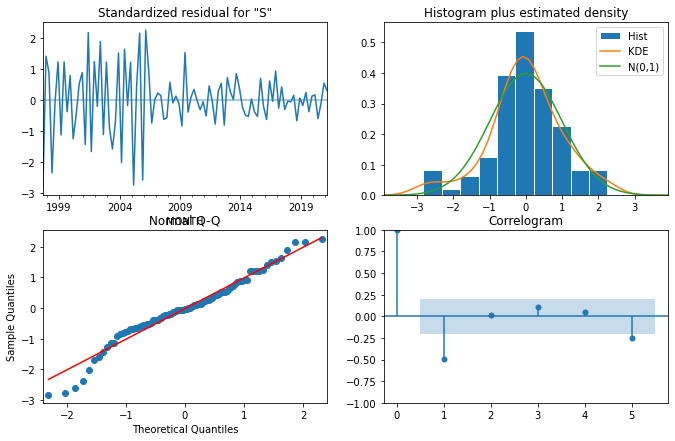

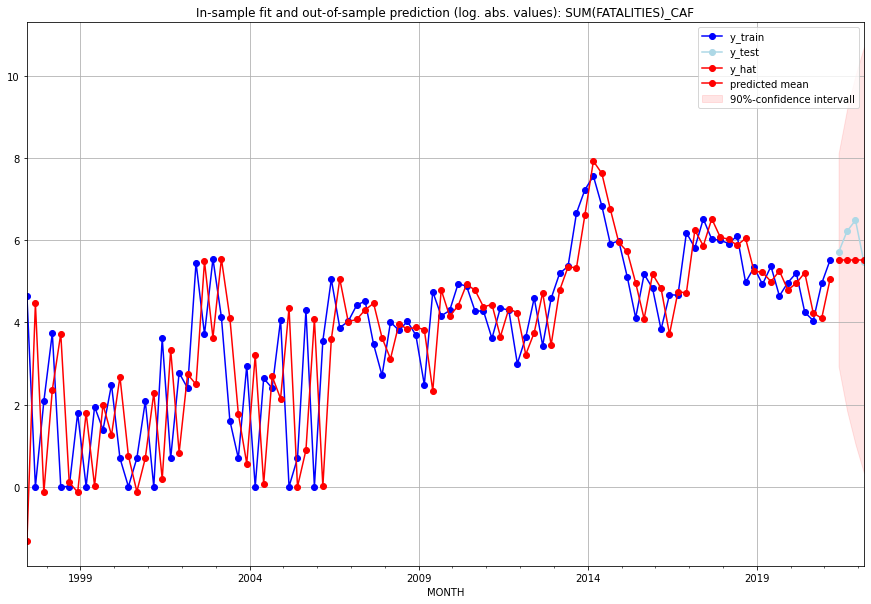

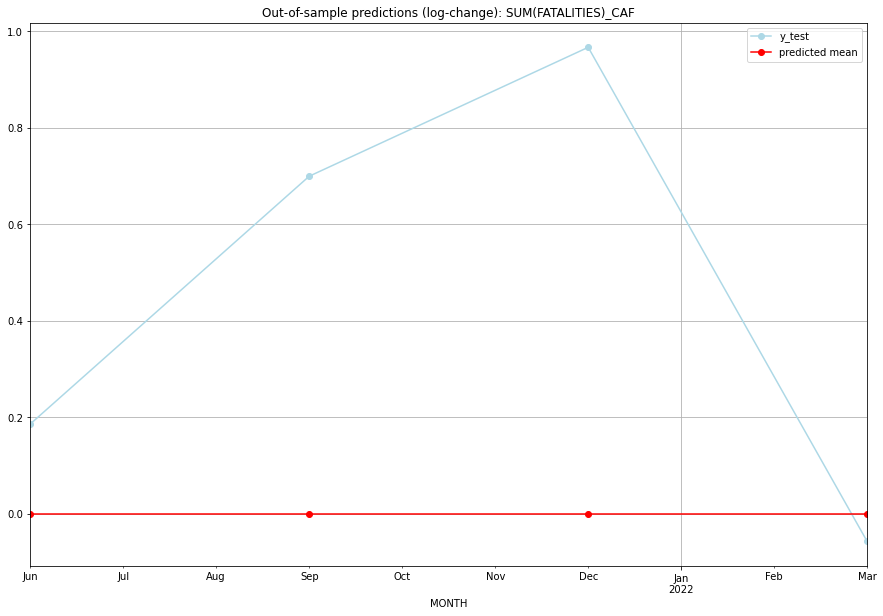

TADDA: 0.4771577031457839
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     249.0       300.0 -2.664535e-15        0.185649   CAF   
1 2021-07-01     249.0       502.0 -2.664535e-15        0.699129   CAF   
2 2021-10-01     249.0       656.0 -2.664535e-15        0.966223   CAF   
3 2022-01-01     249.0       235.0 -2.664535e-15       -0.057629   CAF   

                                          PARAMETERS  
0  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:24
######## CAN (38/234) #########
0
Neighbor countries: ['USA', 'GRL']
Getting Data for CAN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 79)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Ins

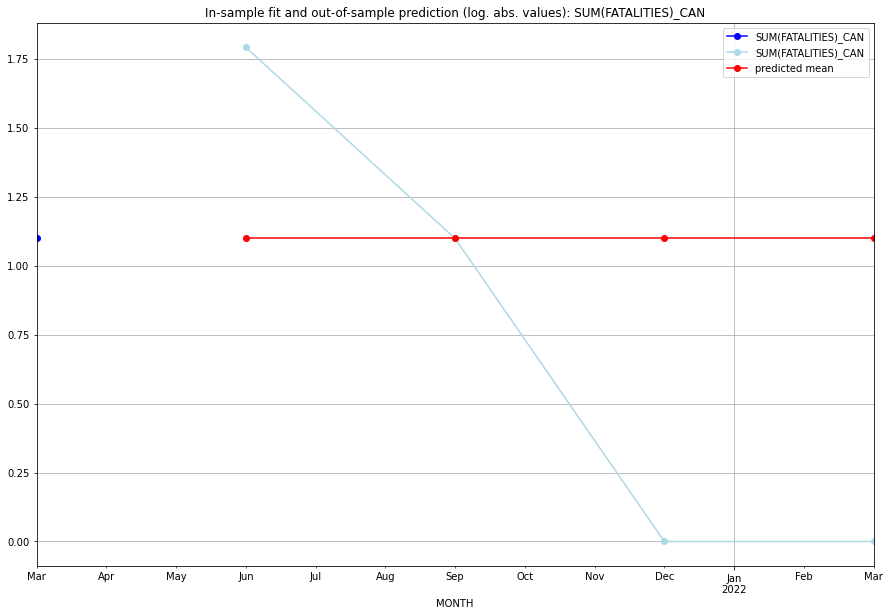

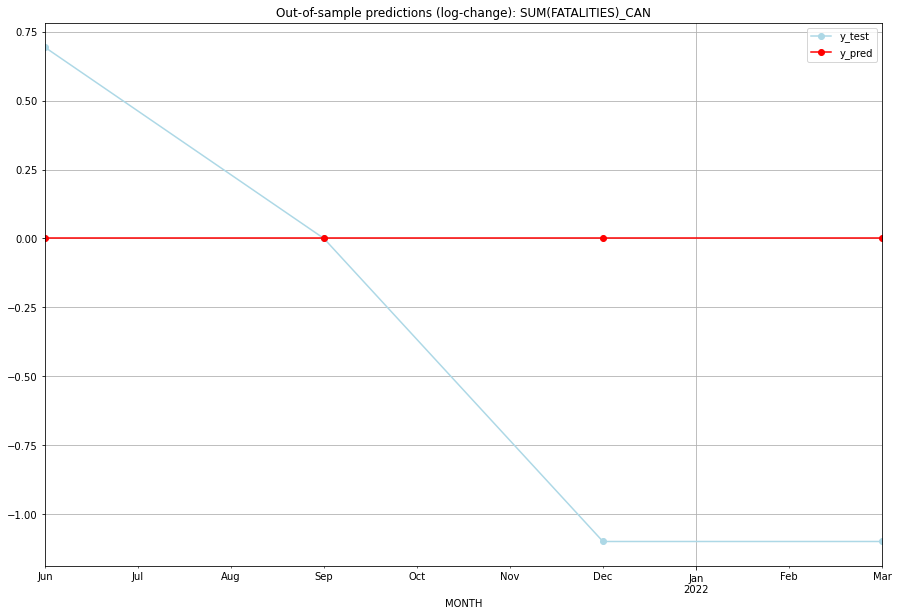

TADDA: 0.7225929394740411
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.098612    1.791759           0.0        0.693147   CAN   
1 2021-07-01  1.098612    1.098612           0.0        0.000000   CAN   
2 2021-10-01  1.098612    0.000000           0.0       -1.098612   CAN   
3 2022-01-01  1.098612    0.000000           0.0       -1.098612   CAN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## CHE (39/234) #########
0
Neighbor countries: ['AUT', 'ITA', 'LIE', 'FRA', 'DEU']
Getting Data for CHE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 103)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


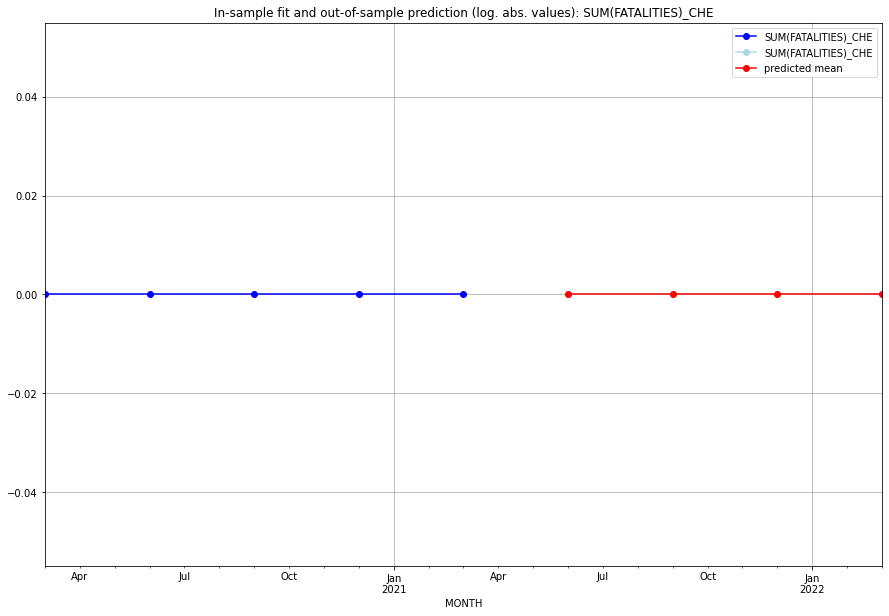

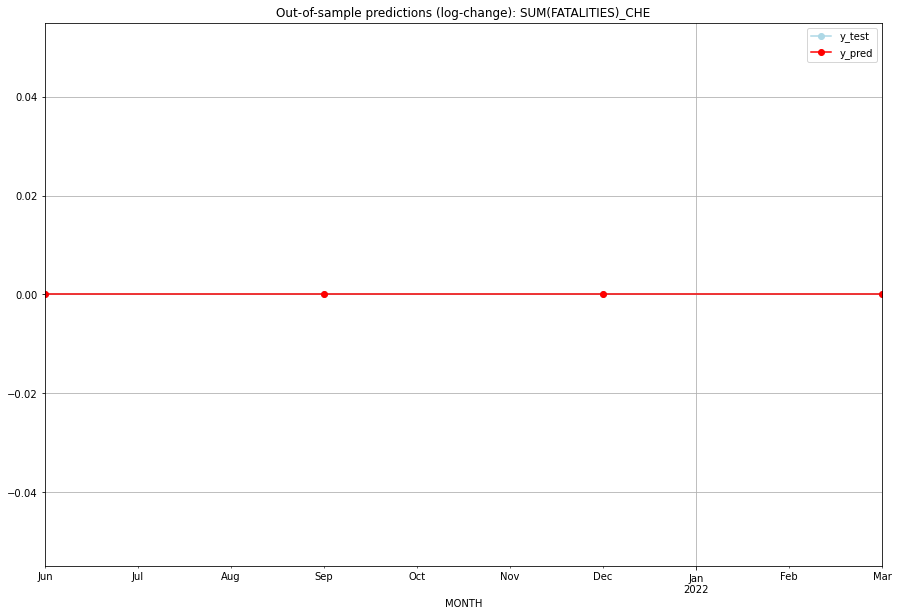

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CHE   
1 2021-07-01       0.0         0.0           0.0             0.0   CHE   
2 2021-10-01       0.0         0.0           0.0             0.0   CHE   
3 2022-01-01       0.0         0.0           0.0             0.0   CHE   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## CHL (40/234) #########
0
Neighbor countries: ['ARG', 'BOL', 'PER']
Getting Data for CHL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 88)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.6248164962228333, 'fold_results': [1.0240422589998448, 0.22559073344582192]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CHL   No. Observations:                   13
Model:                SARIMAX(0, 1, 2)   Log Likelihood                 -16.840
Date:                 Wed, 19 Oct 2022   AIC                             41.681
Time:                         10:30:26   BIC                             43.621
Sample:                     01-31-2018   HQIC                            40.963
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0741      0

<Figure size 432x288 with 0 Axes>

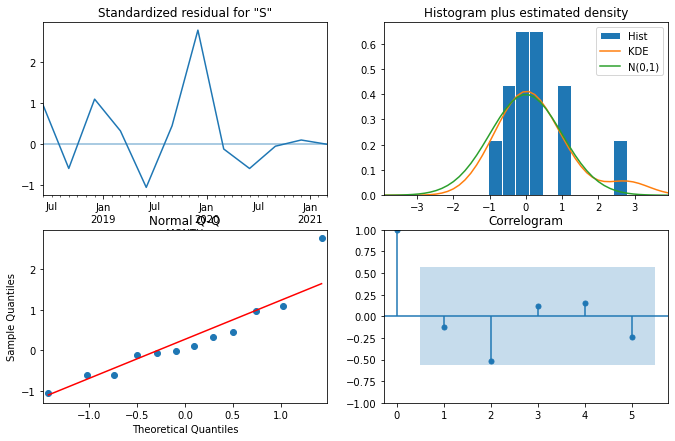

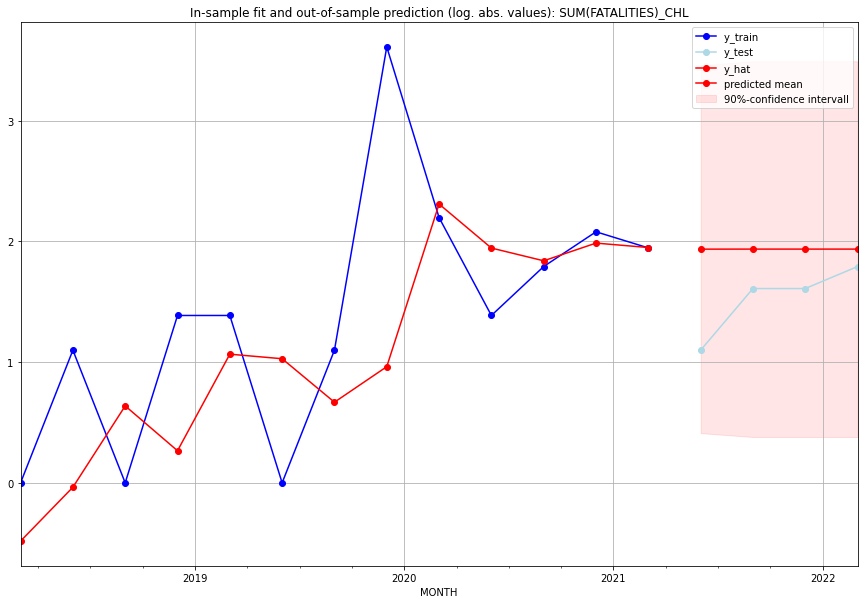

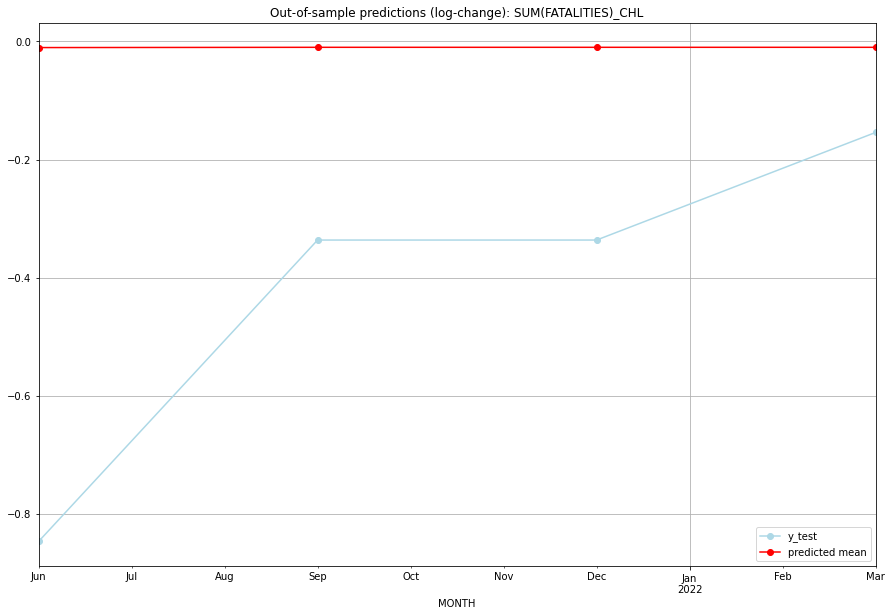

TADDA: 0.40862620137647504
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  5.928228         2.0     -0.010306       -0.847298   CHL   
1 2021-07-01  5.931314         4.0     -0.009861       -0.336472   CHL   
2 2021-10-01  5.931314         4.0     -0.009861       -0.336472   CHL   
3 2022-01-01  5.931314         5.0     -0.009861       -0.154151   CHL   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## CHN (41/234) #########
0
Neighbor countries: ['RUS', 'PRK', 'MNG', 'AFG', 'IND', 'KAZ', 'KGZ', 'PAK', 'TJK', 'BTN', 'MMR', 'NPL', 'LAO', 'VNM', 'HKG', 'MAC']
Getting Data for CHN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 190)


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.4071481805523829, 'fold_results': [0.4071481805523829, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CHN   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                 -16.642
Date:                 Wed, 19 Oct 2022   AIC                             45.283
Time:                         10:30:43   BIC                             48.673
Sample:                     01-31-2018   HQIC                            44.587
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0865      0.105     -0.822 

<Figure size 432x288 with 0 Axes>

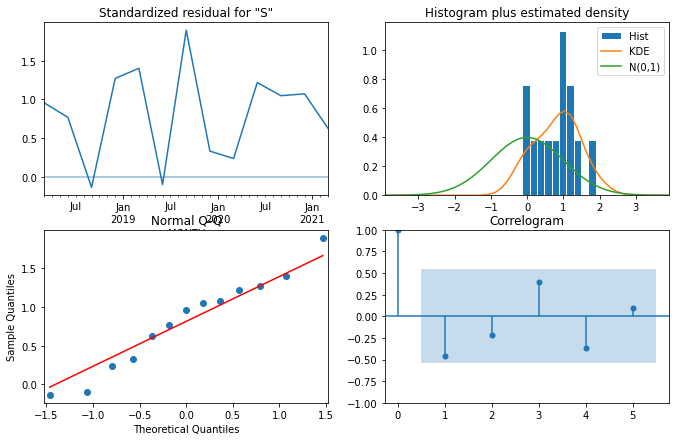

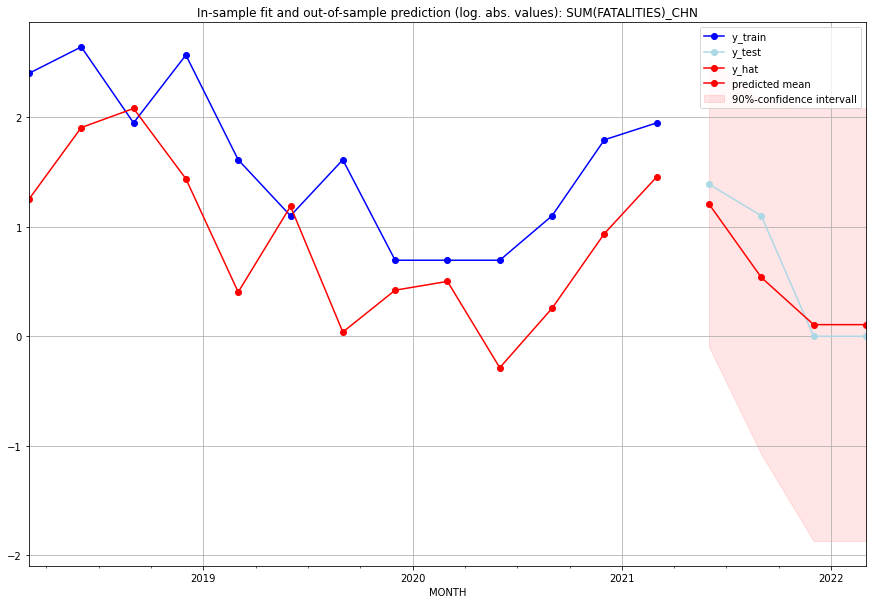

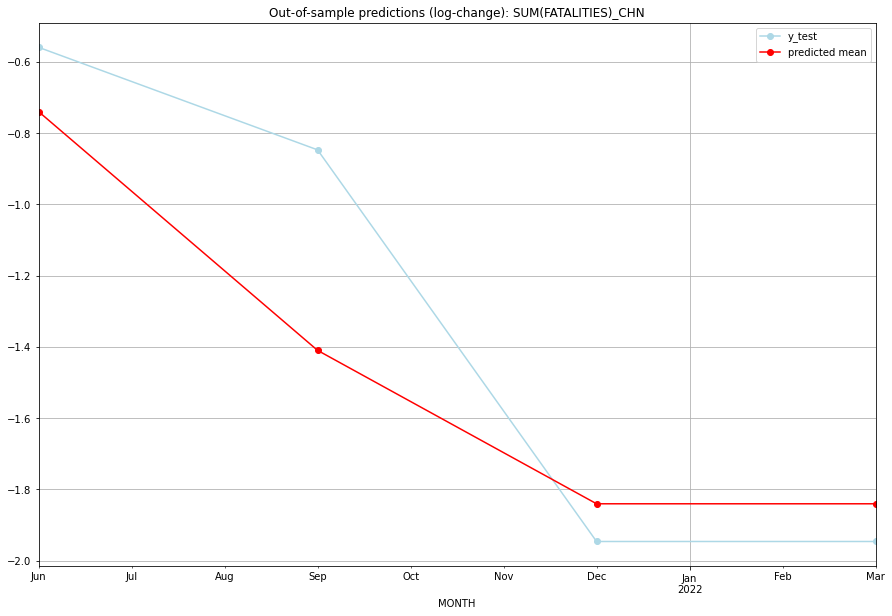

TADDA: 0.2386010548580288
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2.339912         3.0     -0.739966       -0.559616   CHN   
1 2021-07-01  0.709347         2.0     -1.409799       -0.847298   CHN   
2 2021-10-01  0.111574         0.0     -1.840133       -1.945910   CHN   
3 2022-01-01  0.111574         0.0     -1.840133       -1.945910   CHN   

                                          PARAMETERS  
0  {'params': [3, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## CIV (42/234) #########
0
Neighbor countries: ['BFA', 'MLI', 'GIN', 'GHA', 'LBR']
Getting Data for CIV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 101)
y: (100, 1)
------------------------------------------------
Training started

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8020888417089467, 'fold_results': [0.8934079109958172, 0.42982029815358636, 1.4026942017026516, 0.7470571073308961, 0.5374646903617815]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CIV   No. Observations:                   96
Model:                SARIMAX(3, 0, 0)   Log Likelihood                -174.804
Date:                 Wed, 19 Oct 2022   AIC                            361.609
Time:                         10:31:09   BIC                            376.995
Sample:                     04-30-1997   HQIC                           367.828
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

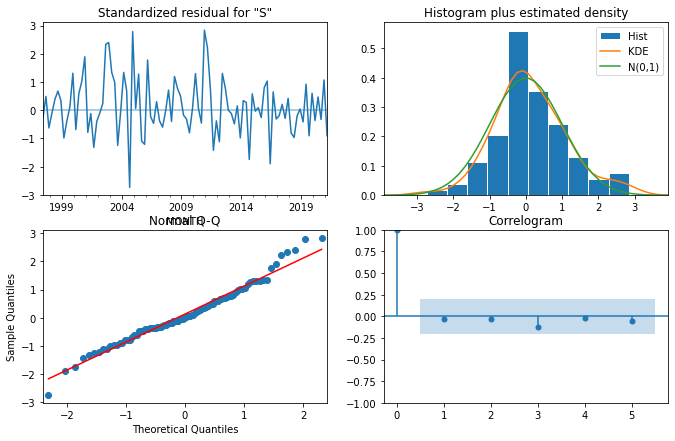

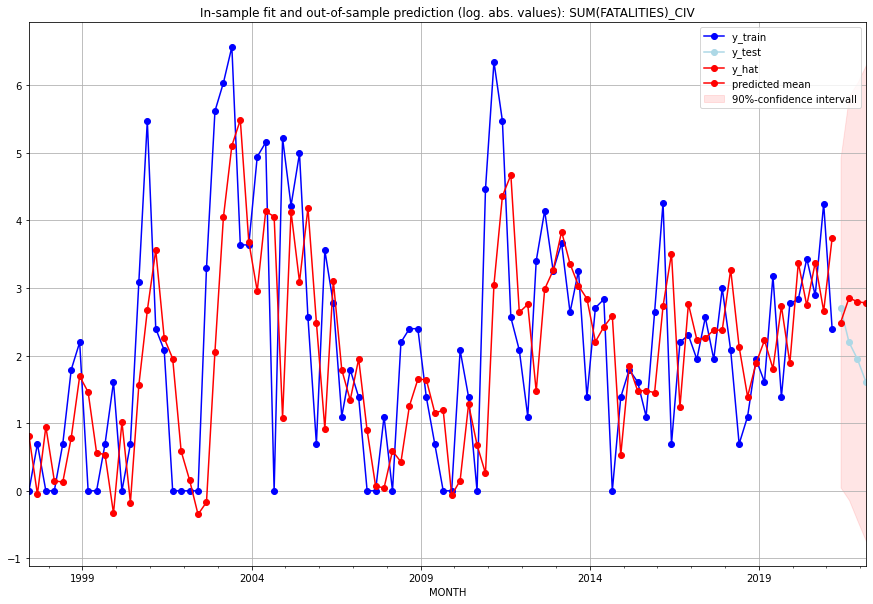

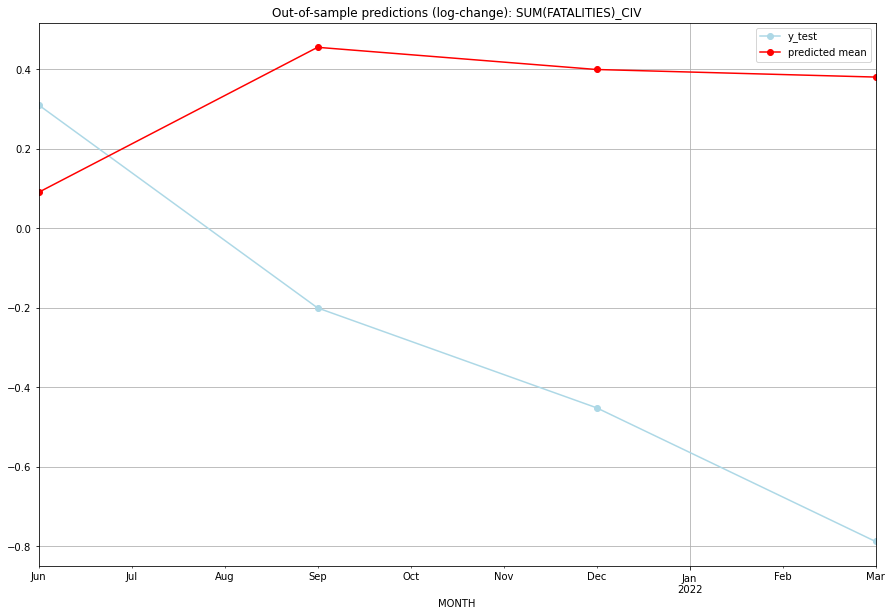

TADDA: 1.0326194843017265
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  11.038228        14.0      0.090192        0.310155   CIV   
1 2021-07-01  16.340354         8.0      0.455141       -0.200671   CIV   
2 2021-10-01  15.398658         6.0      0.399304       -0.451985   CIV   
3 2022-01-01  15.089242         4.0      0.380256       -0.788457   CIV   

                                          PARAMETERS  
0  {'params': [2, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## CMR (43/234) #########
0
Neighbor countries: ['COG', 'GAB', 'GNQ', 'CAF', 'NGA', 'TCD']
Getting Data for CMR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 109)
y: (100, 1)
------------------------------------------------
Trai

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.36737446533872725, 'fold_results': [0.19531263369560659, 0.21936671797541152, 0.7137058436459658, 0.3430180040788837, 0.3654691272977686]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CMR   No. Observations:                   96
Model:                SARIMAX(0, 1, 3)   Log Likelihood                -146.643
Date:                 Wed, 19 Oct 2022   AIC                            303.285
Time:                         10:31:24   BIC                            316.055
Sample:                     04-30-1997   HQIC                           308.445
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

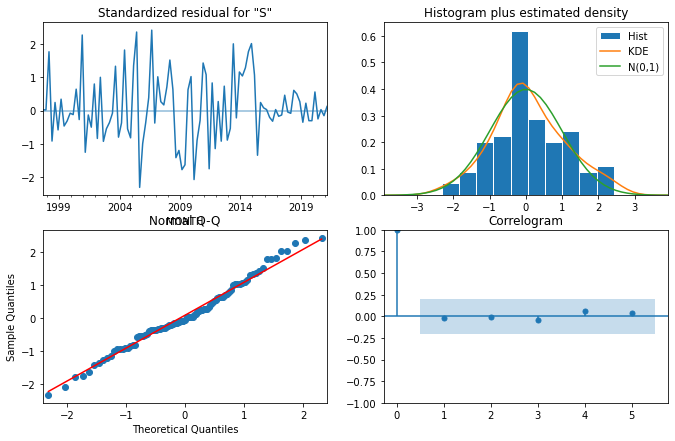

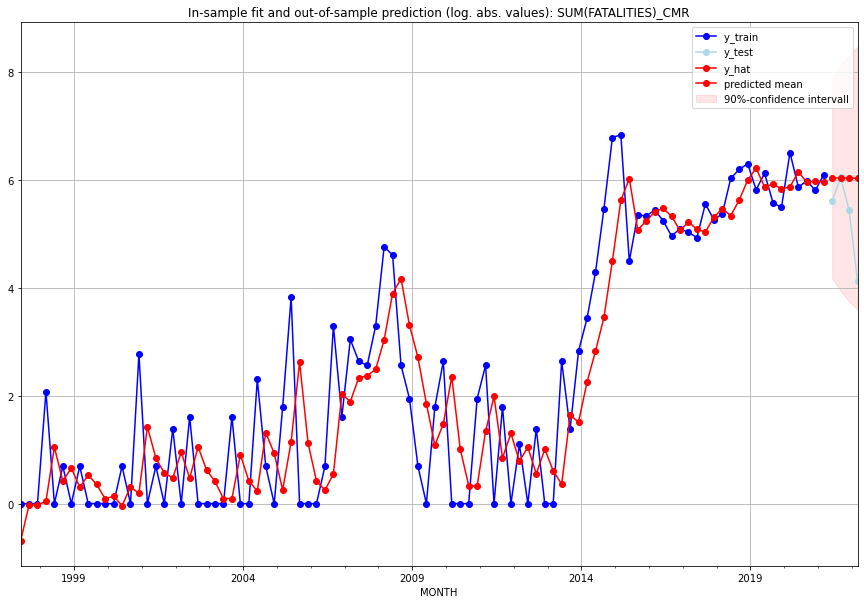

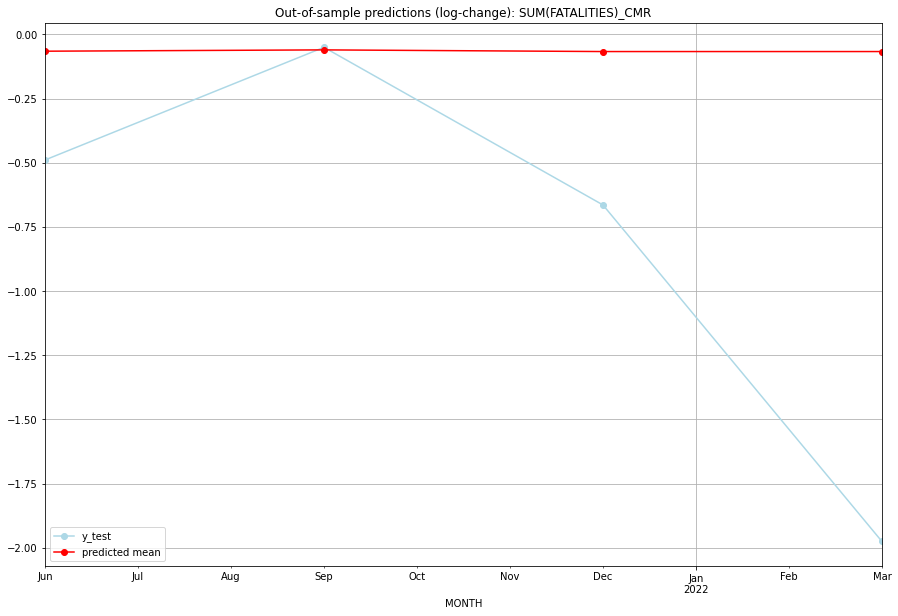

TADDA: 0.7349403684296762
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  417.608844       273.0     -0.065622       -0.489430   CMR   
1 2021-07-01  419.752481       424.0     -0.060514       -0.050469   CMR   
2 2021-10-01  417.033239       229.0     -0.066998       -0.664479   CMR   
3 2022-01-01  417.033239        61.0     -0.066998       -1.975424   CMR   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## COD (44/234) #########
0
Neighbor countries: ['COG', 'AGO', 'ZMB', 'RWA', 'UGA', 'CAF', 'BDI', 'TZA', 'SSD']
Getting Data for COD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 133)
y: (100, 1)
---------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3332551635673269, 'fold_results': [0.29719872129944847, 0.3255149627682419, 0.3534509987212122, 0.28424481777216926, 0.40586631727556255]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COD   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -154.478
Date:                 Wed, 19 Oct 2022   AIC                            312.956
Time:                         10:31:58   BIC                            318.064
Sample:                     04-30-1997   HQIC                           315.020
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

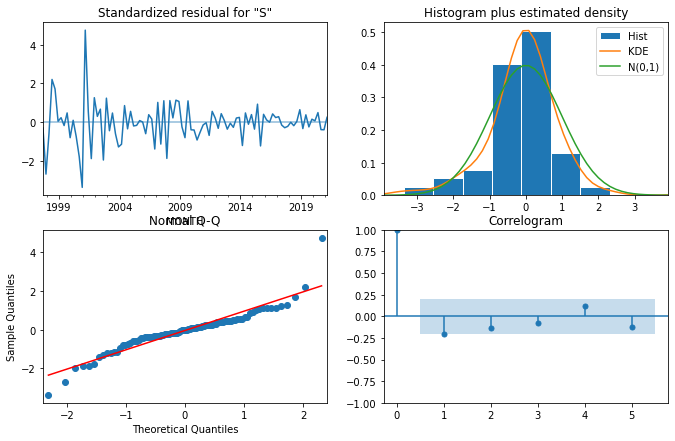

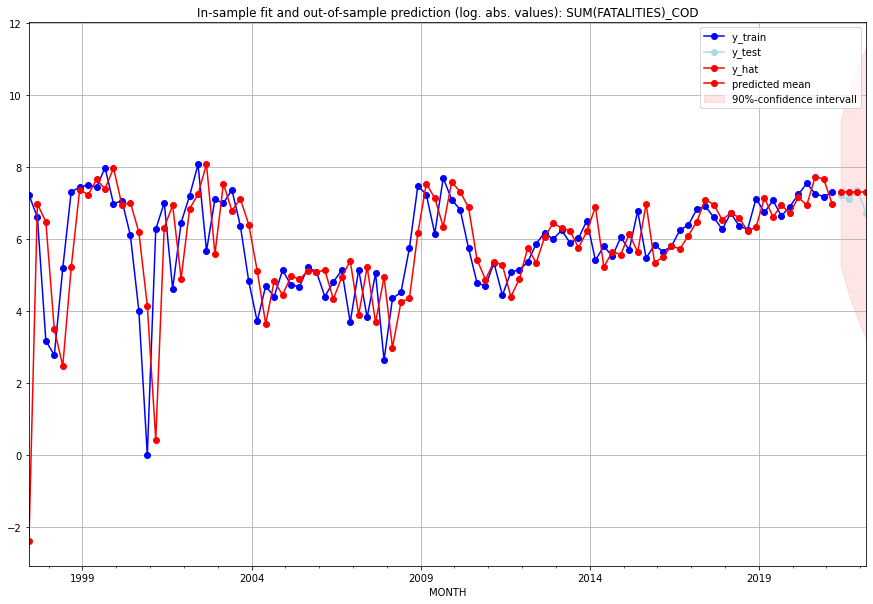

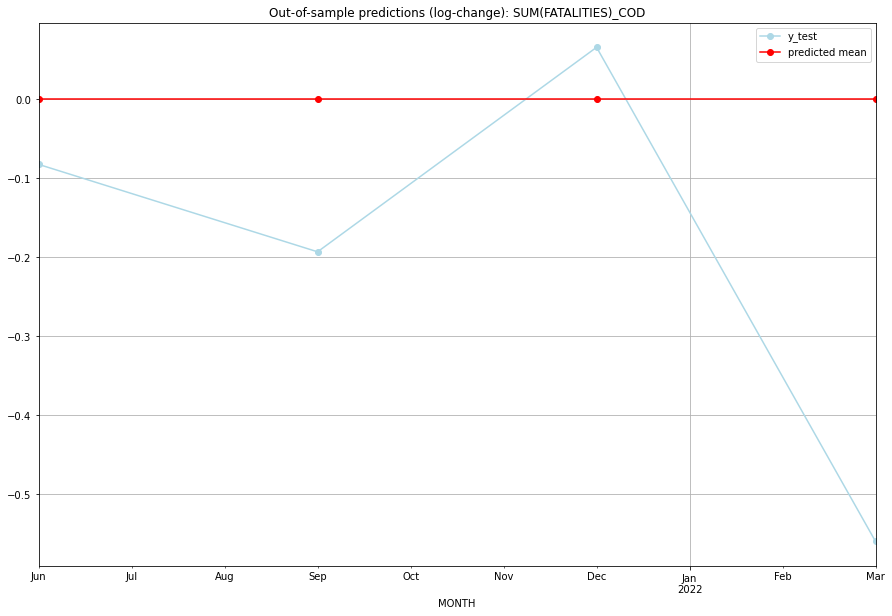

TADDA: 0.2253172761857154
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01    1480.0      1363.0           0.0       -0.082296   COD   
1 2021-07-01    1480.0      1220.0           0.0       -0.193047   COD   
2 2021-10-01    1480.0      1581.0           0.0        0.065972   COD   
3 2022-01-01    1480.0       845.0           0.0       -0.559953   COD   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:31
######## COG (45/234) #########
0
Neighbor countries: ['COD', 'CAF', 'CMR', 'GAB', 'AGO']
Getting Data for COG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 100)
y: (100, 1)
------------------------------------------------
Training started

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 1.15930458370117, 'fold_results': [1.4630506199436188, 1.1796247178237735, 1.170532806781055, 0.9158904115324116, 1.0674243624249906]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COG   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -187.421
Date:                 Wed, 19 Oct 2022   AIC                            376.843
Time:                         10:32:26   BIC                            379.396
Sample:                     04-30-1997   HQIC                           377.874
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------

<Figure size 432x288 with 0 Axes>

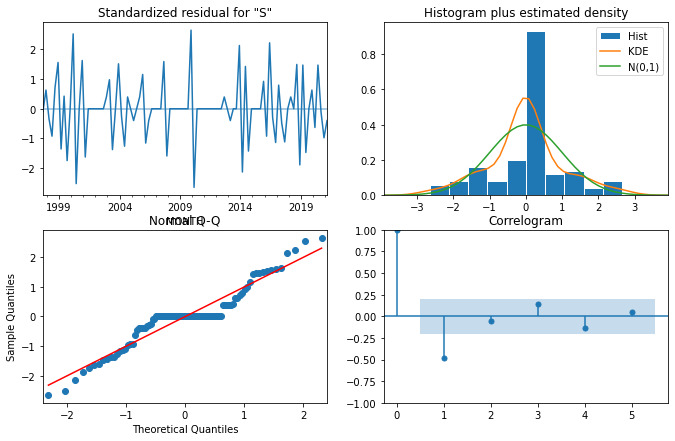

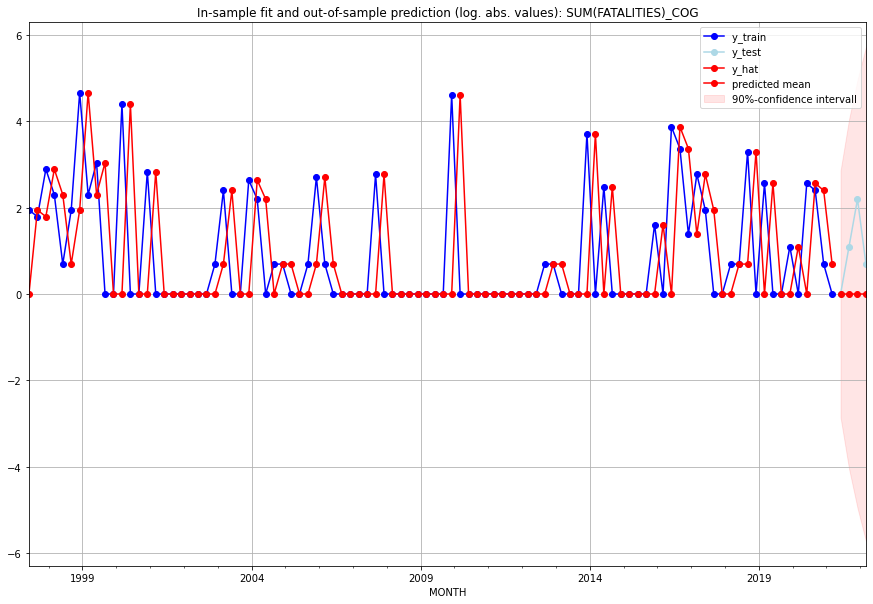

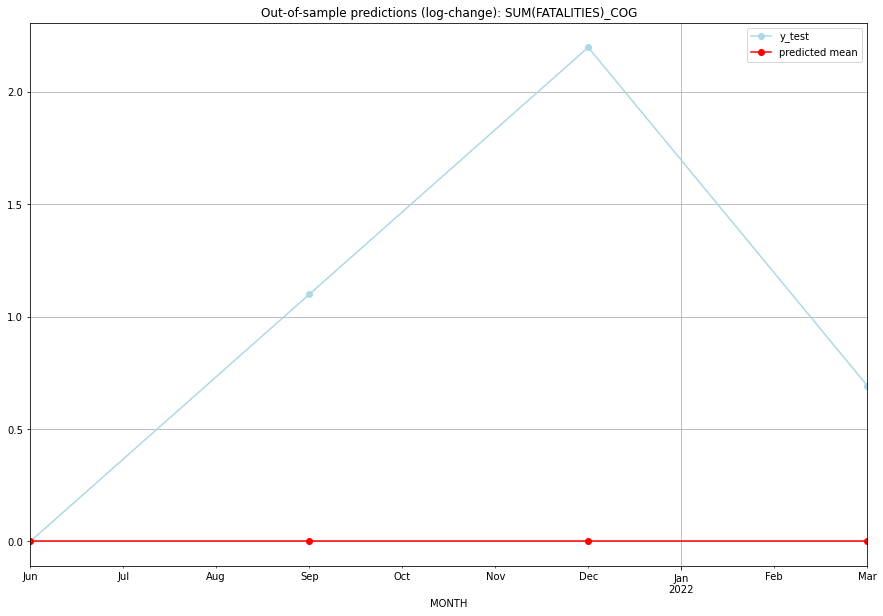

TADDA: 0.9972460116410689
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   COG   
1 2021-07-01       0.0         2.0           0.0        1.098612   COG   
2 2021-10-01       0.0         8.0           0.0        2.197225   COG   
3 2022-01-01       0.0         1.0           0.0        0.693147   COG   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:28
######## COK (46/234) #########
0
Neighbor countries: []
Getting Data for COK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient dat

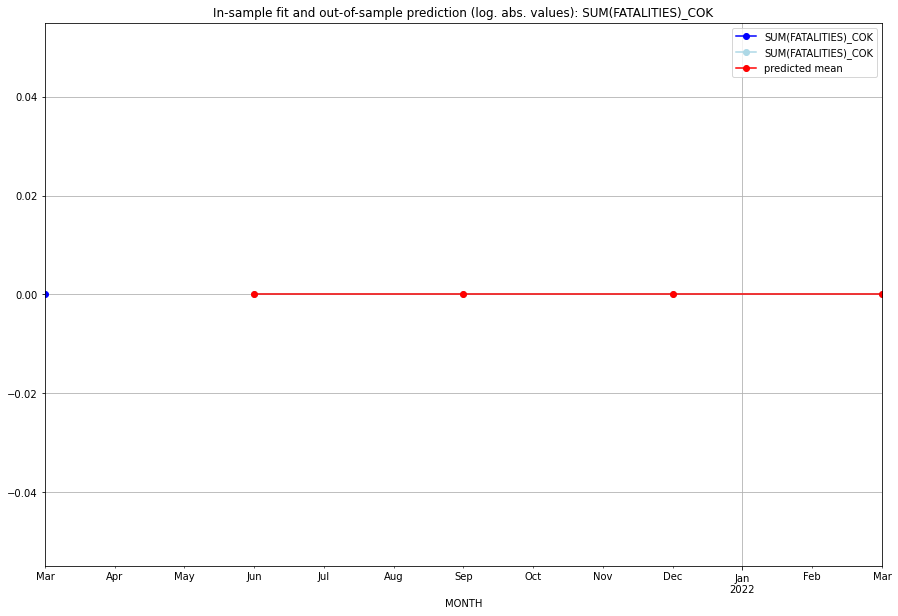

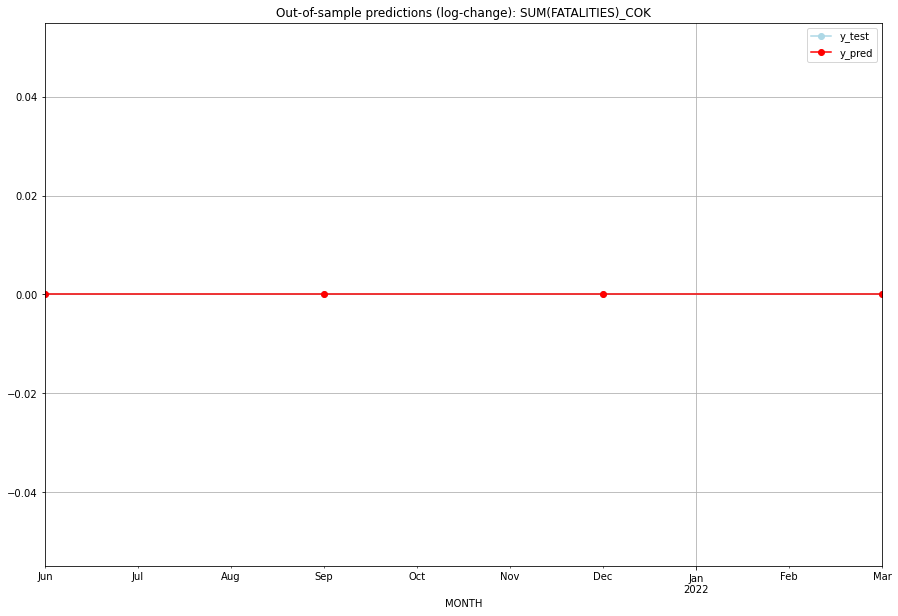

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   COK   
1 2021-07-01       0.0         0.0           0.0             0.0   COK   
2 2021-10-01       0.0         0.0           0.0             0.0   COK   
3 2022-01-01       0.0         0.0           0.0             0.0   COK   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## COL (47/234) #########
0
Neighbor countries: ['VEN', 'PAN', 'BRA', 'PER', 'ECU']
Getting Data for COL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 105)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.12210238658042227, 'fold_results': [0.12210238658042227, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COL   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                   1.554
Date:                 Wed, 19 Oct 2022   AIC                             14.892
Time:                         10:32:41   BIC                             19.976
Sample:                     01-31-2018   HQIC                            13.847
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0213      0.106     -0.20

<Figure size 432x288 with 0 Axes>

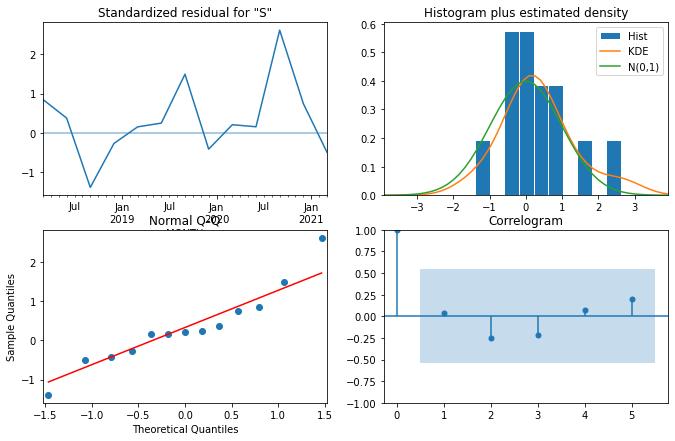

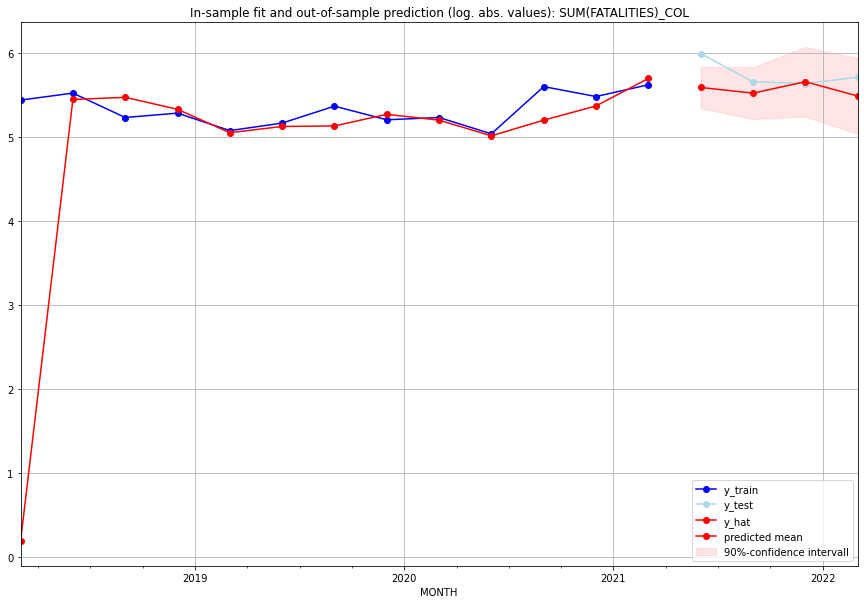

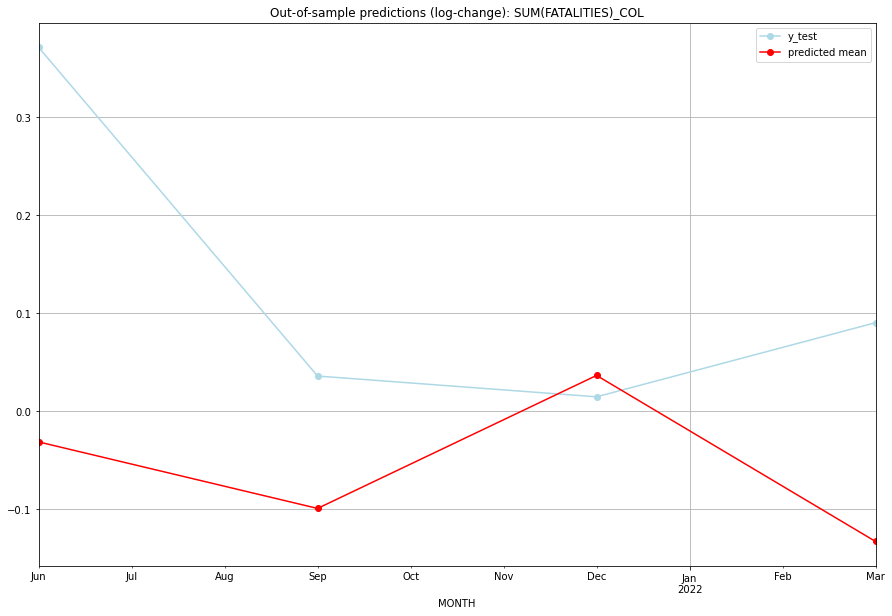

TADDA: 0.2618235141790959
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  266.406096       399.0     -0.031632        0.371064   COL   
1 2021-07-01  248.858429       285.0     -0.099506        0.035591   COL   
2 2021-10-01  285.177586       279.0      0.036212        0.014389   COL   
3 2022-01-01  240.566427       301.0     -0.133256        0.090026   COL   

                                          PARAMETERS  
0  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## COM (48/234) #########
0
Neighbor countries: []
Getting Data for COM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 54)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.03465735902799726, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COM   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 118.056
Date:                 Wed, 19 Oct 2022   AIC                           -234.112
Time:                         10:33:24   BIC                           -231.547
Sample:                     04-30-1997   HQIC                          -233.075
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0050      

<Figure size 432x288 with 0 Axes>

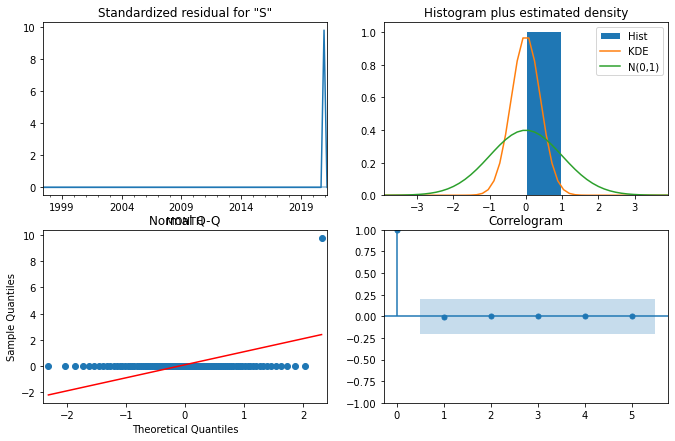

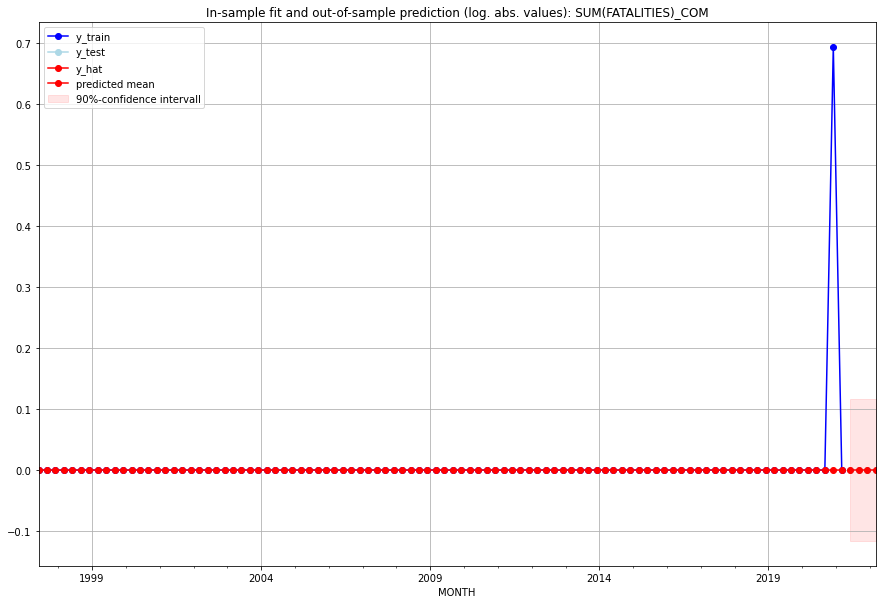

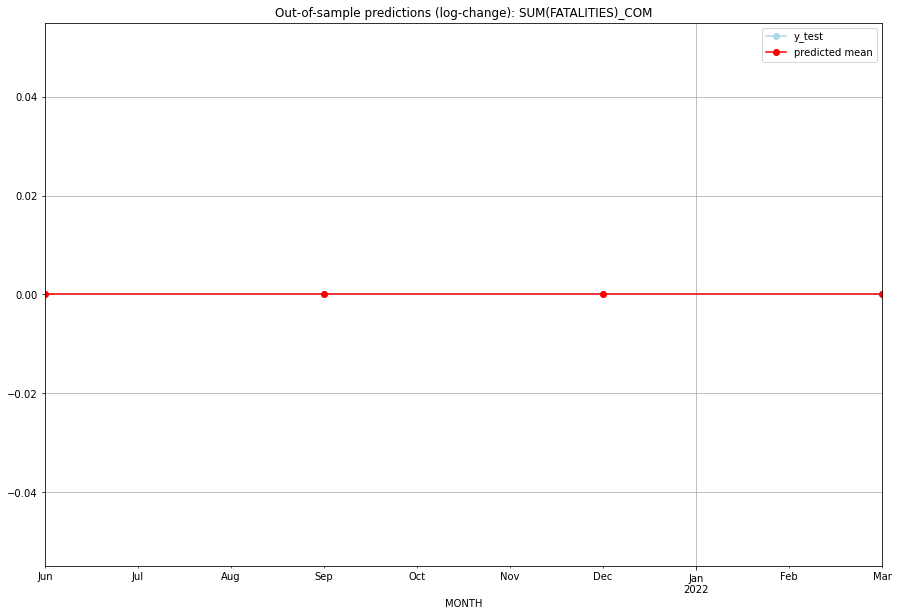

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   COM   
1 2021-07-01       0.0         0.0           0.0             0.0   COM   
2 2021-10-01       0.0         0.0           0.0             0.0   COM   
3 2022-01-01       0.0         0.0           0.0             0.0   COM   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:39
######## CPV (49/234) #########
0
Neighbor countries: []
Getting Data for CPV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 60)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV

<Figure size 432x288 with 0 Axes>

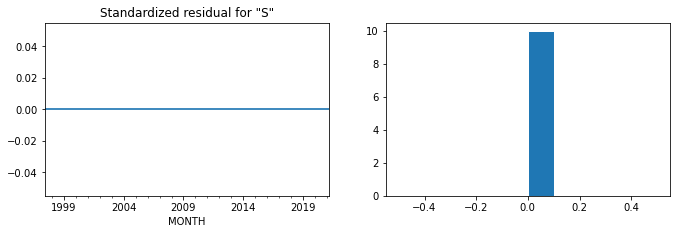

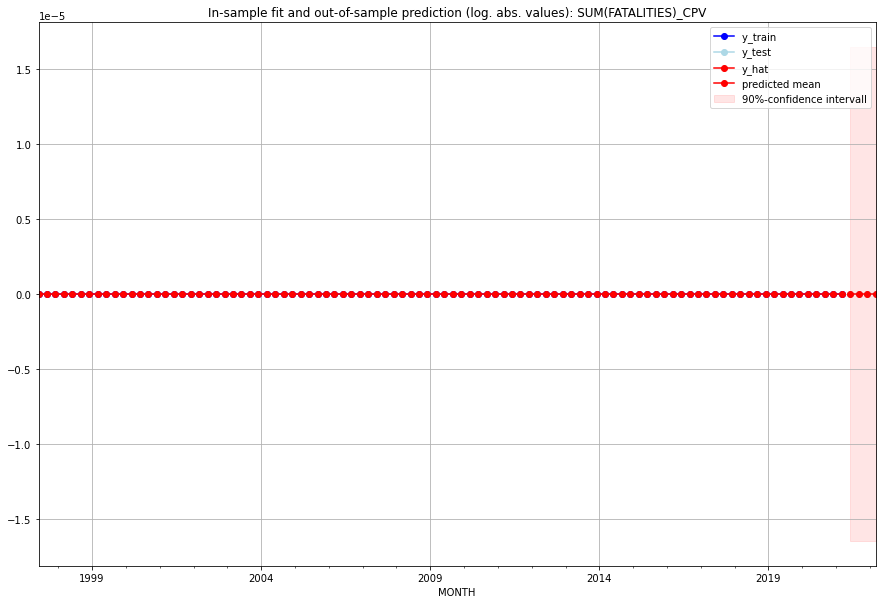

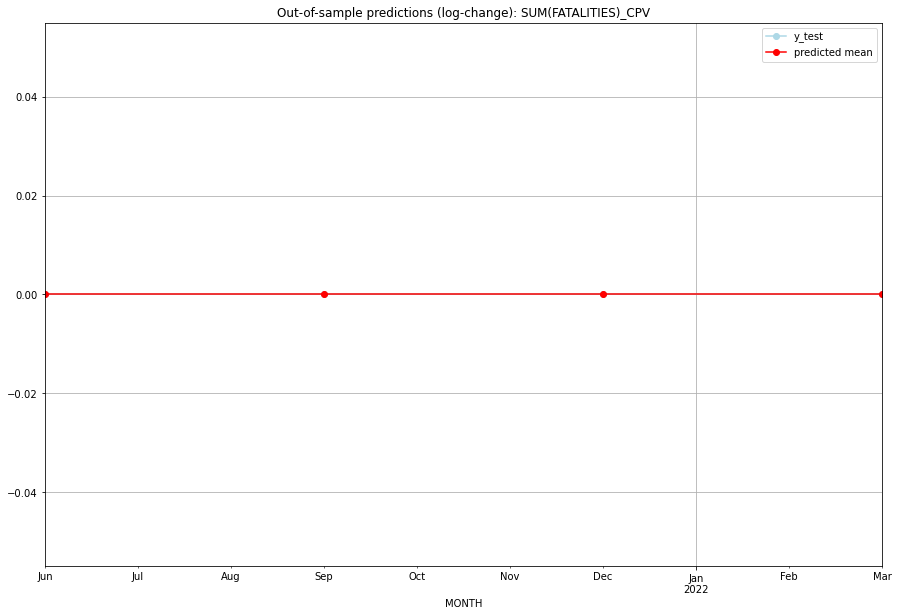

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CPV   
1 2021-07-01       0.0         0.0           0.0             0.0   CPV   
2 2021-10-01       0.0         0.0           0.0             0.0   CPV   
3 2022-01-01       0.0         0.0           0.0             0.0   CPV   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## CRI (50/234) #########
0
Neighbor countries: ['NIC', 'PAN']
Getting Data for CRI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 79)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.542948469581817, 'fold_results': [0.573440877455206, 0.512456061708428]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CRI   No. Observations:                   13
Model:                SARIMAX(3, 1, 1)   Log Likelihood                 -13.415
Date:                 Wed, 19 Oct 2022   AIC                             38.829
Time:                         10:33:37   BIC                             41.739
Sample:                     01-31-2018   HQIC                            37.752
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0728      0.089

<Figure size 432x288 with 0 Axes>

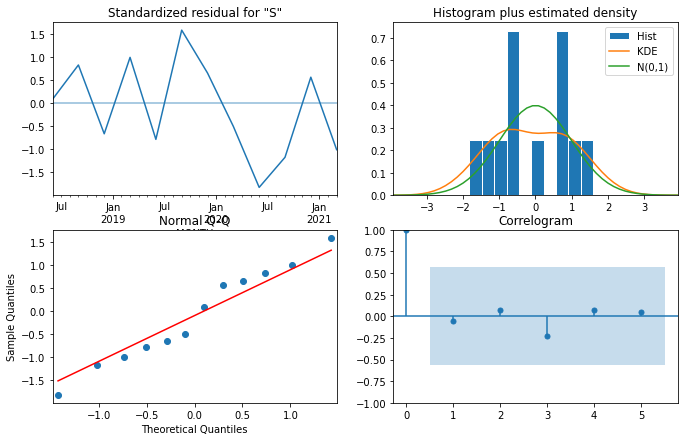

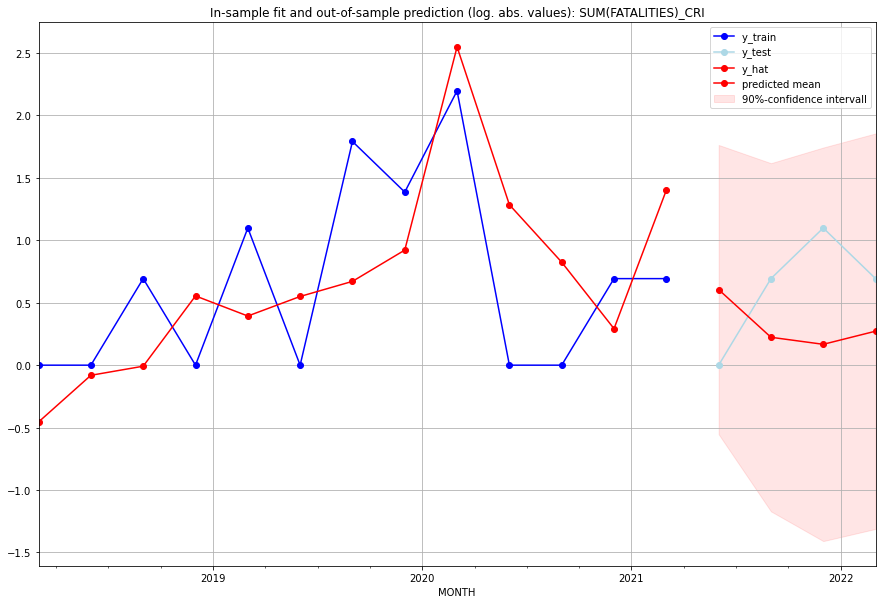

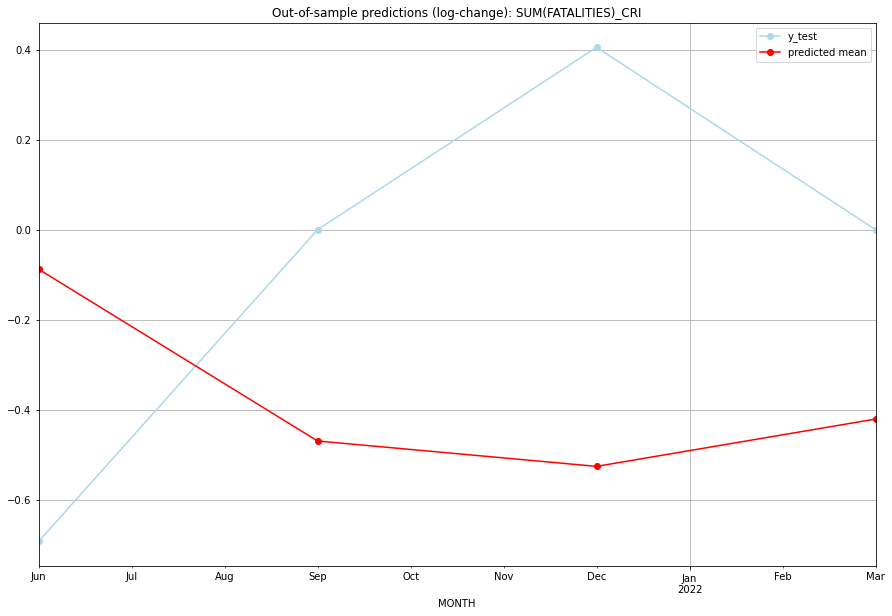

TADDA: 0.7384503775591849
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.831830         0.0     -0.087832       -0.693147   CRI   
1 2021-07-01  0.250336         1.0     -0.469735        0.000000   CRI   
2 2021-10-01  0.181734         2.0     -0.526165        0.405465   CRI   
3 2022-01-01  0.312836         1.0     -0.420957        0.000000   CRI   

                                          PARAMETERS  
0  {'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## CUB (51/234) #########
0
Neighbor countries: []
Getting Data for CUB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 35)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU core

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.31061333122350004, 'fold_results': [0.34657359027997264, 0.27465307216702745]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CUB   No. Observations:                   13
Model:                SARIMAX(0, 1, 0)   Log Likelihood                  -9.746
Date:                 Wed, 19 Oct 2022   AIC                             23.492
Time:                         10:33:48   BIC                             24.461
Sample:                     01-31-2018   HQIC                            23.133
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0527     

<Figure size 432x288 with 0 Axes>

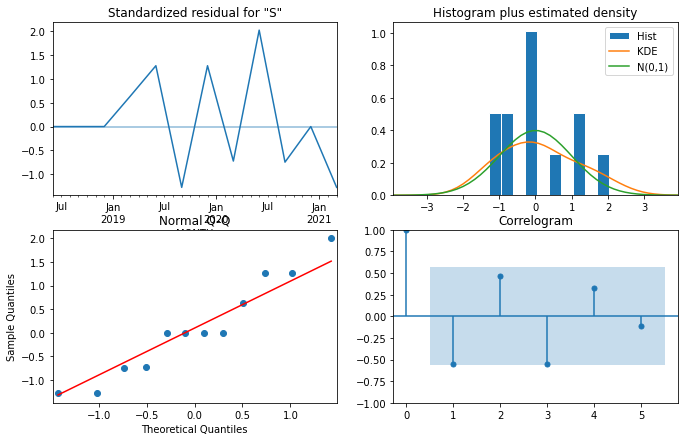

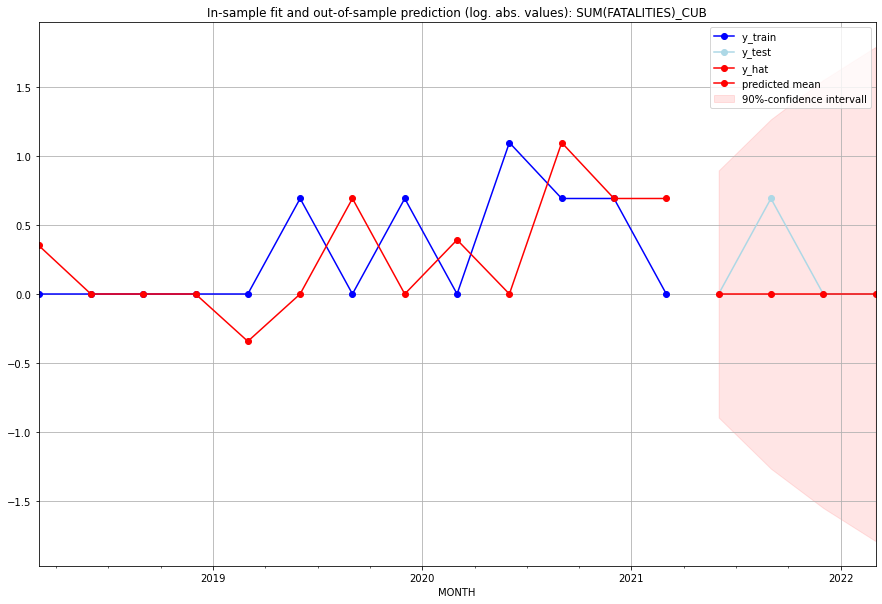

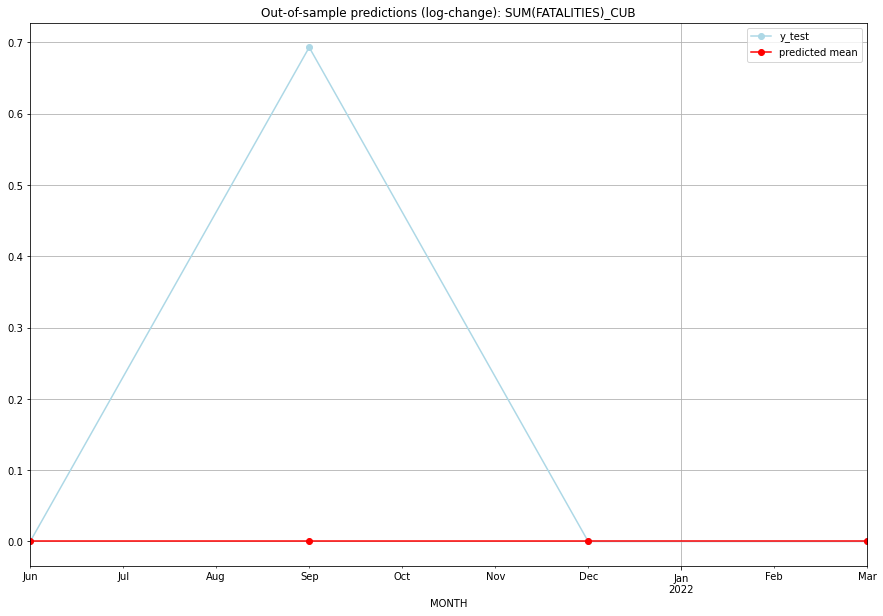

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   CUB   
1 2021-07-01       0.0         1.0           0.0        0.693147   CUB   
2 2021-10-01       0.0         0.0           0.0        0.000000   CUB   
3 2022-01-01       0.0         0.0           0.0        0.000000   CUB   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## CUW (52/234) #########
0
Neighbor countries: []
Getting Data for CUW
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV neces

<Figure size 432x288 with 0 Axes>

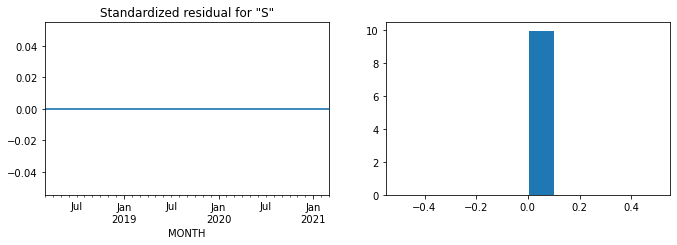

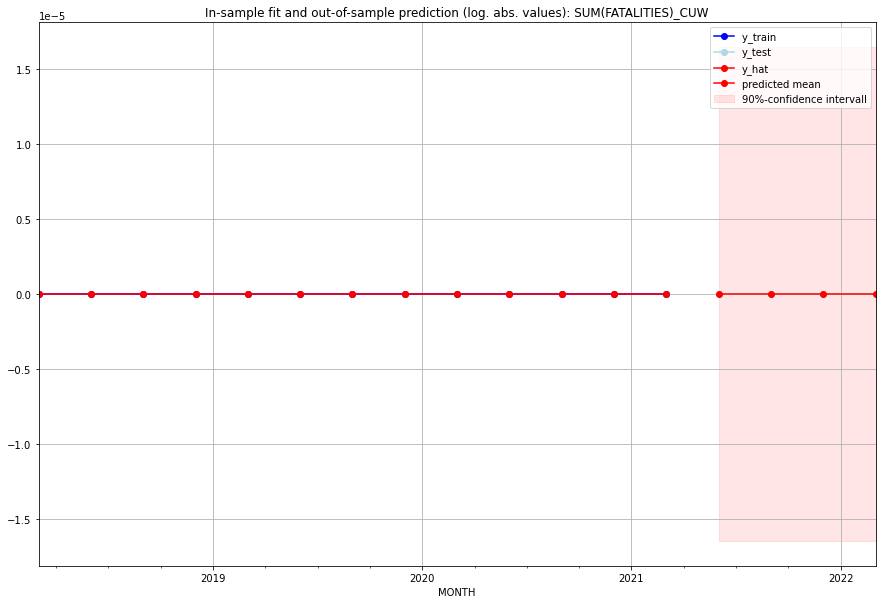

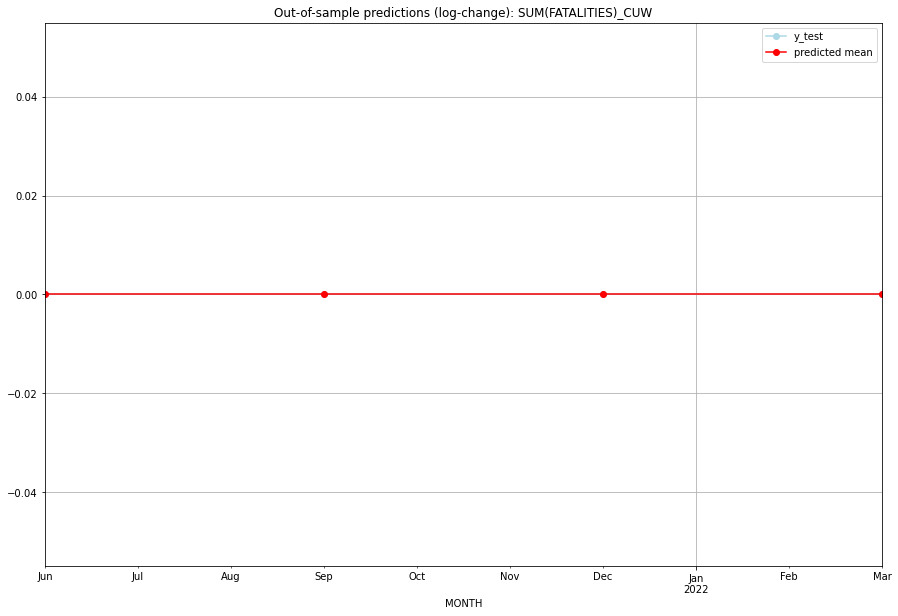

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CUW   
1 2021-07-01       0.0         0.0           0.0             0.0   CUW   
2 2021-10-01       0.0         0.0           0.0             0.0   CUW   
3 2022-01-01       0.0         0.0           0.0             0.0   CUW   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## CYM (53/234) #########
0
Neighbor countries: []
Getting Data for CYM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (13, 27)
y: (13, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CYM   No. Observations:                    9
Model:     

<Figure size 432x288 with 0 Axes>

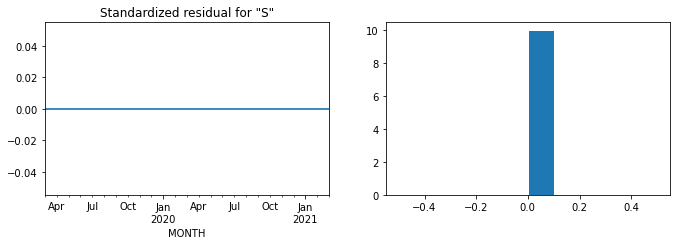

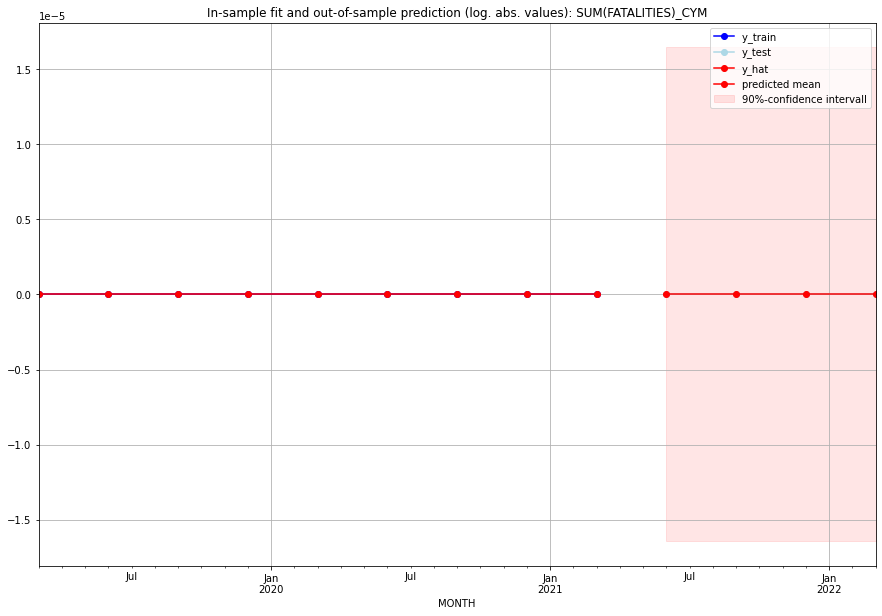

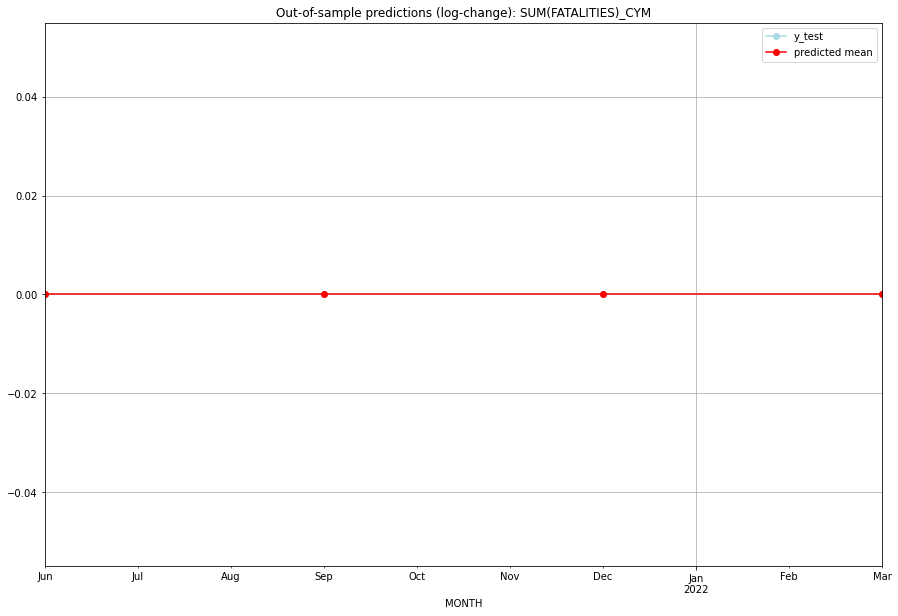

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CYM   
1 2021-07-01       0.0         0.0           0.0             0.0   CYM   
2 2021-10-01       0.0         0.0           0.0             0.0   CYM   
3 2022-01-01       0.0         0.0           0.0             0.0   CYM   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:06
######## CYP (54/234) #########
0
Neighbor countries: ['XNC']
Getting Data for CYP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 73)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CYP   No. Observations:                   13
Model:

<Figure size 432x288 with 0 Axes>

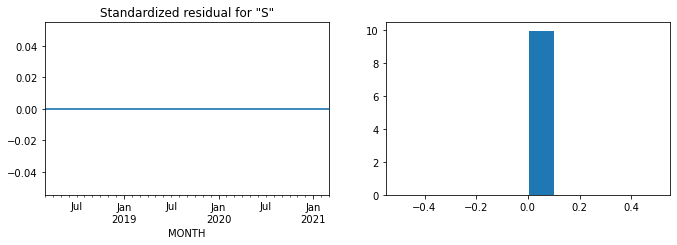

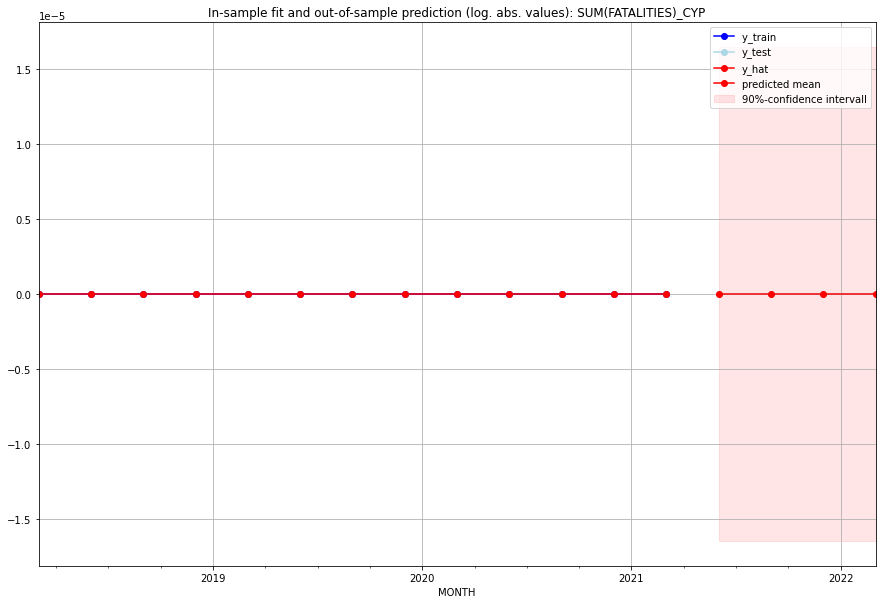

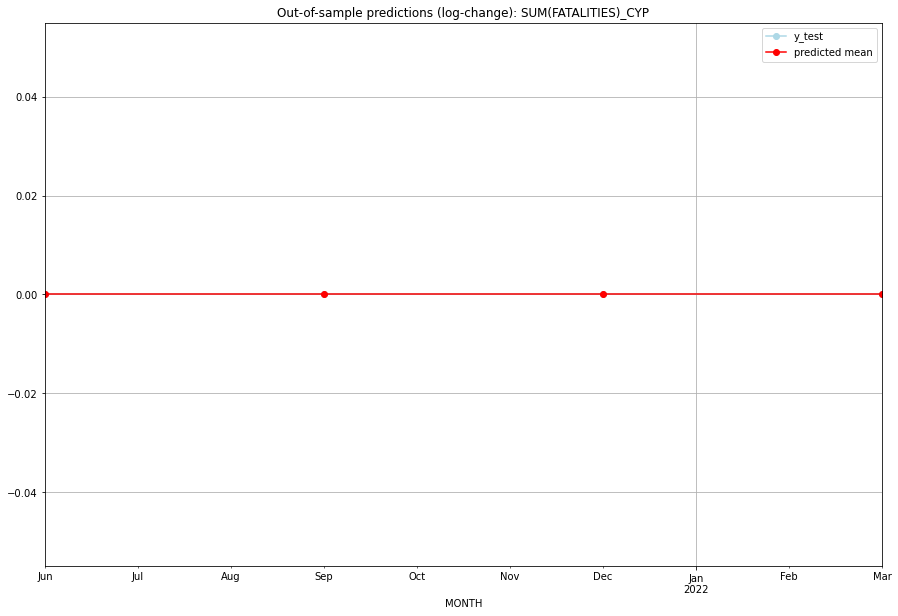

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CYP   
1 2021-07-01       0.0         0.0           0.0             0.0   CYP   
2 2021-10-01       0.0         0.0           0.0             0.0   CYP   
3 2022-01-01       0.0         0.0           0.0             0.0   CYP   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:06
######## CZE (55/234) #########
0
Neighbor countries: ['DEU', 'SVK', 'AUT', 'POL']
Getting Data for CZE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 96)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


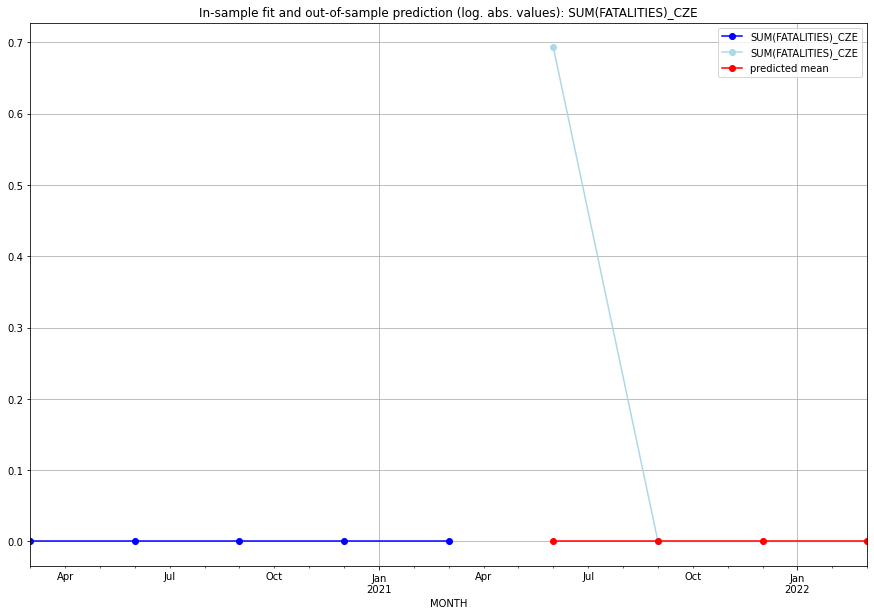

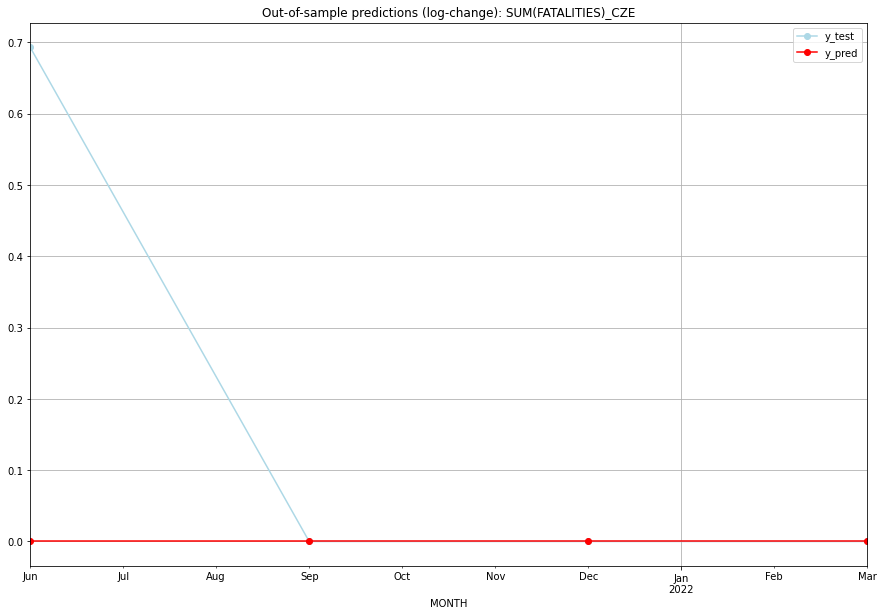

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.693147           0.0        0.693147   CZE   
1 2021-07-01       0.0    0.000000           0.0        0.000000   CZE   
2 2021-10-01       0.0    0.000000           0.0        0.000000   CZE   
3 2022-01-01       0.0    0.000000           0.0        0.000000   CZE   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## DEU (56/234) #########
0
Neighbor countries: ['BEL', 'NLD', 'FRA', 'LUX', 'CZE', 'POL', 'DNK', 'AUT', 'CHE']
Getting Data for DEU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 137)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


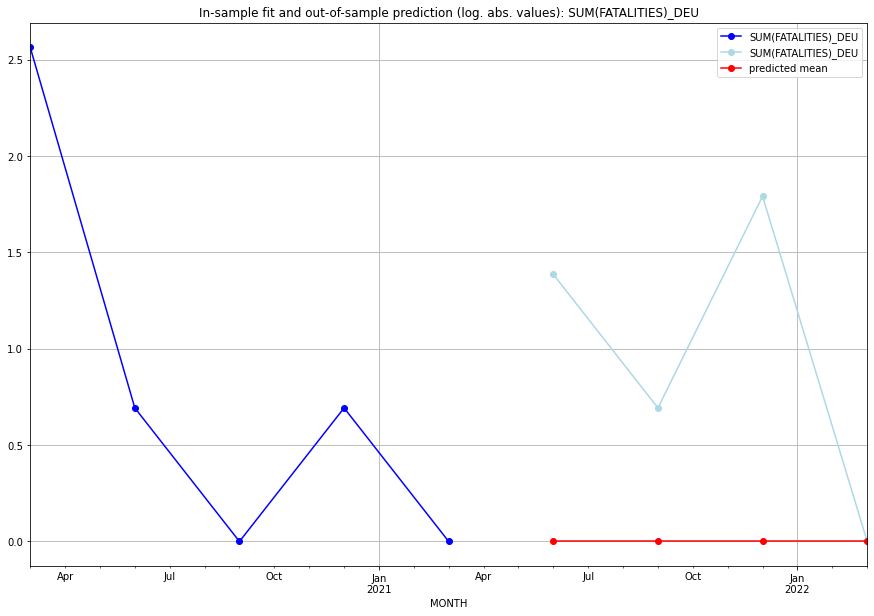

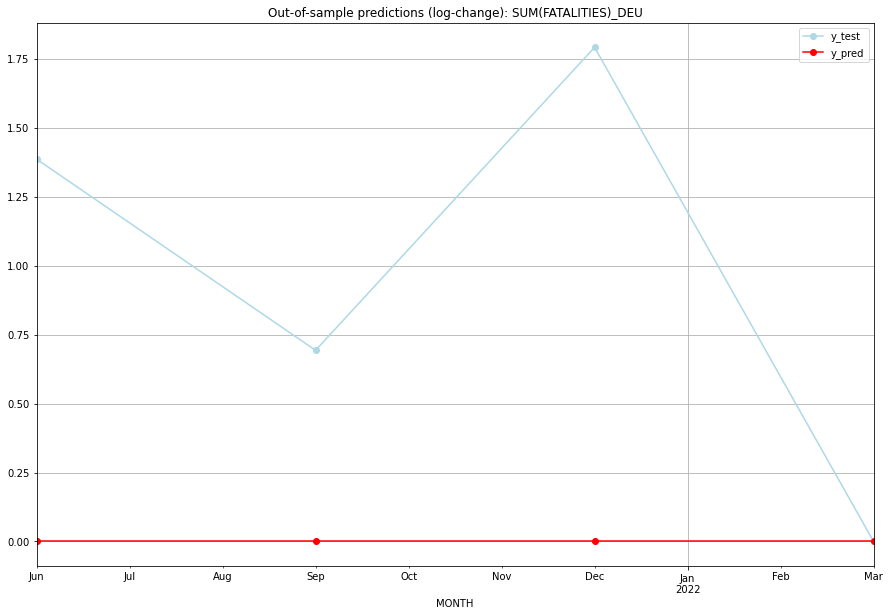

TADDA: 0.9678002527269727
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    1.386294           0.0        1.386294   DEU   
1 2021-07-01       0.0    0.693147           0.0        0.693147   DEU   
2 2021-10-01       0.0    1.791759           0.0        1.791759   DEU   
3 2022-01-01       0.0    0.000000           0.0        0.000000   DEU   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## DJI (57/234) #########
0
Neighbor countries: ['ETH', 'SOM', 'ERI']
Getting Data for DJI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 82)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.10397207708399178, 'fold_results': [0.0, 0.0, 0.0, 0.5198603854199589, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DJI   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                -101.745
Date:                 Wed, 19 Oct 2022   AIC                            205.489
Time:                         10:34:29   BIC                            208.054
Sample:                     04-30-1997   HQIC                           206.526
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.4876      0

<Figure size 432x288 with 0 Axes>

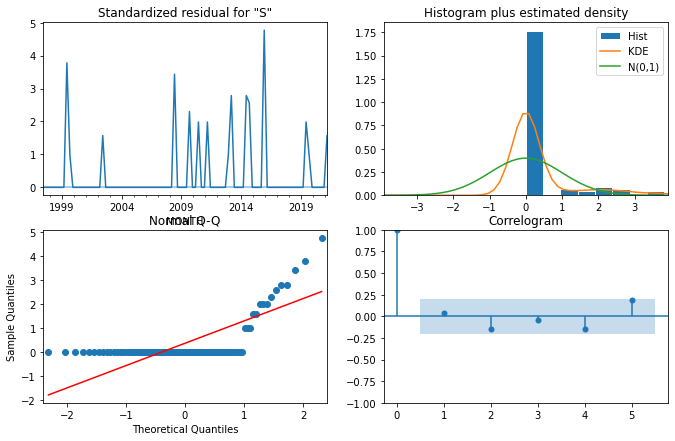

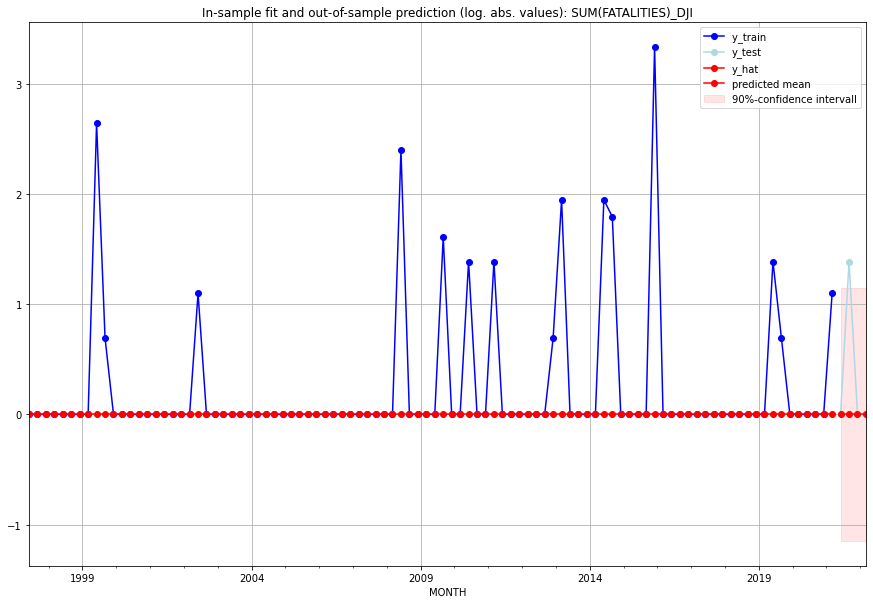

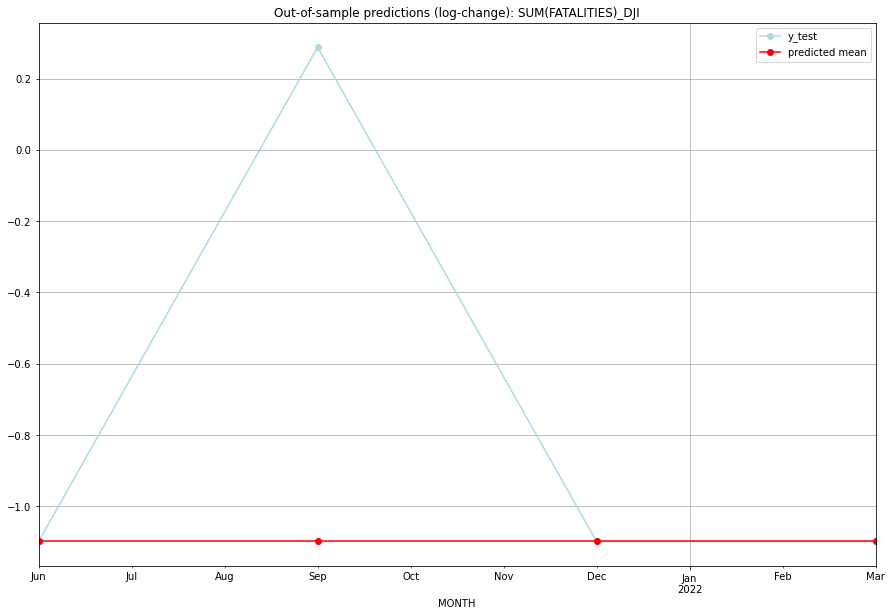

TADDA: 0.6212266624470001
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -1.098612       -1.098612   DJI   
1 2021-07-01       0.0         3.0     -1.098612        0.287682   DJI   
2 2021-10-01       0.0         0.0     -1.098612       -1.098612   DJI   
3 2022-01-01       0.0         0.0     -1.098612       -1.098612   DJI   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## DMA (58/234) #########
0
Neighbor countries: []
Getting Data for DMA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 45)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU core

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08664339756999316, 'fold_results': [0.17328679513998632, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DMA   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:34:39   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.24

<Figure size 432x288 with 0 Axes>

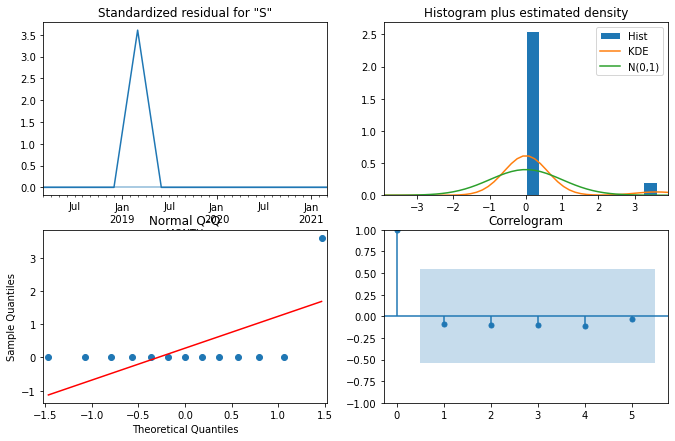

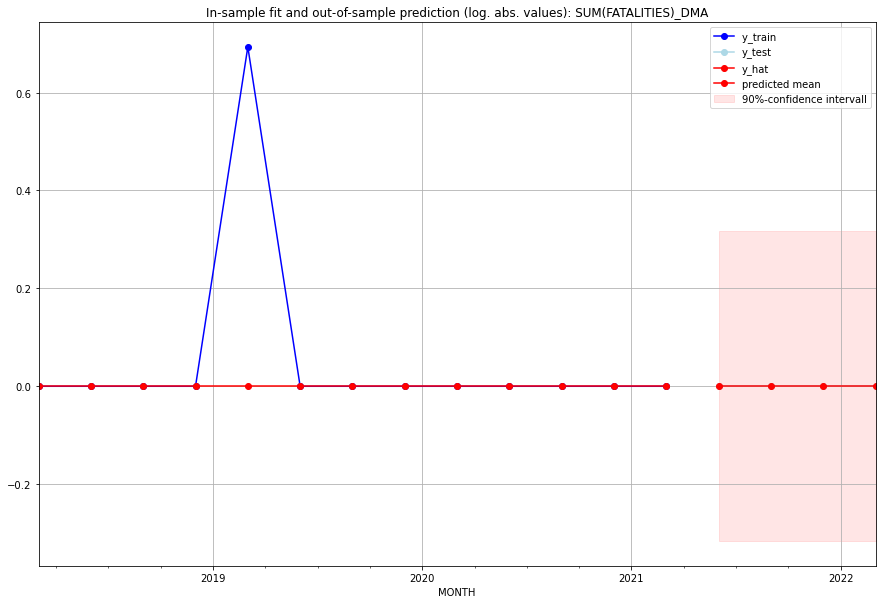

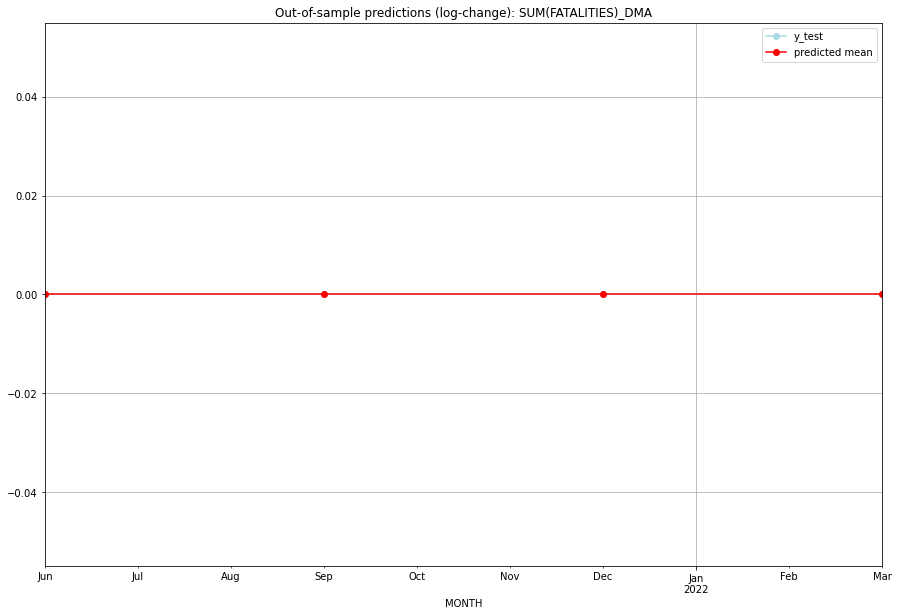

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   DMA   
1 2021-07-01       0.0         0.0           0.0             0.0   DMA   
2 2021-10-01       0.0         0.0           0.0             0.0   DMA   
3 2022-01-01       0.0         0.0           0.0             0.0   DMA   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## DNK (59/234) #########
0
Neighbor countries: ['DEU']
Getting Data for DNK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 72)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cro

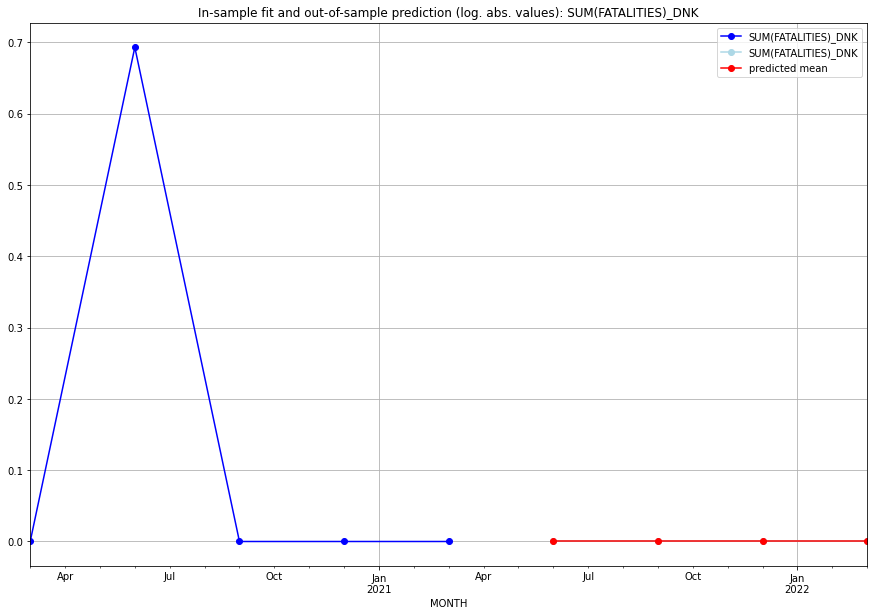

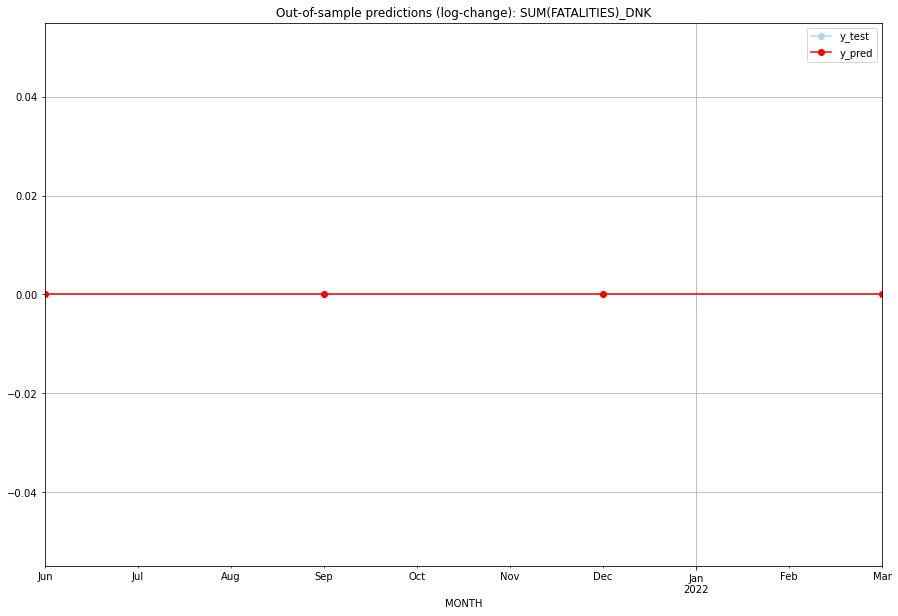

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   DNK   
1 2021-07-01       0.0         0.0           0.0             0.0   DNK   
2 2021-10-01       0.0         0.0           0.0             0.0   DNK   
3 2022-01-01       0.0         0.0           0.0             0.0   DNK   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## DOM (60/234) #########
0
Neighbor countries: ['HTI']
Getting Data for DOM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 70)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.042692853315589585, 'fold_results': [0.042692853315589585, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DOM   No. Observations:                   13
Model:                SARIMAX(2, 0, 2)   Log Likelihood                  -9.606
Date:                 Wed, 19 Oct 2022   AIC                             29.213
Time:                         10:34:51   BIC                             32.037
Sample:                     01-31-2018   HQIC                            28.632
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.1300      0.529      2.

<Figure size 432x288 with 0 Axes>

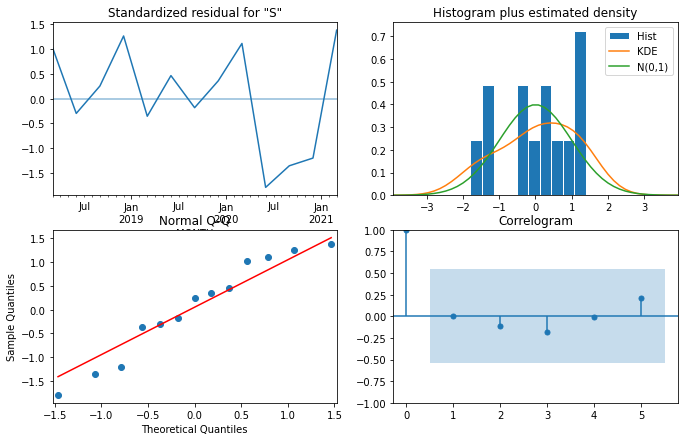

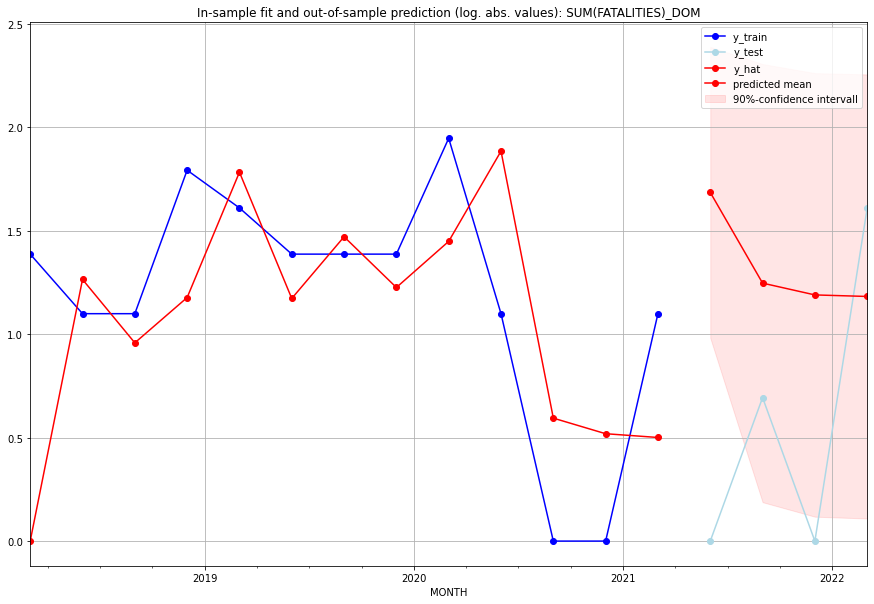

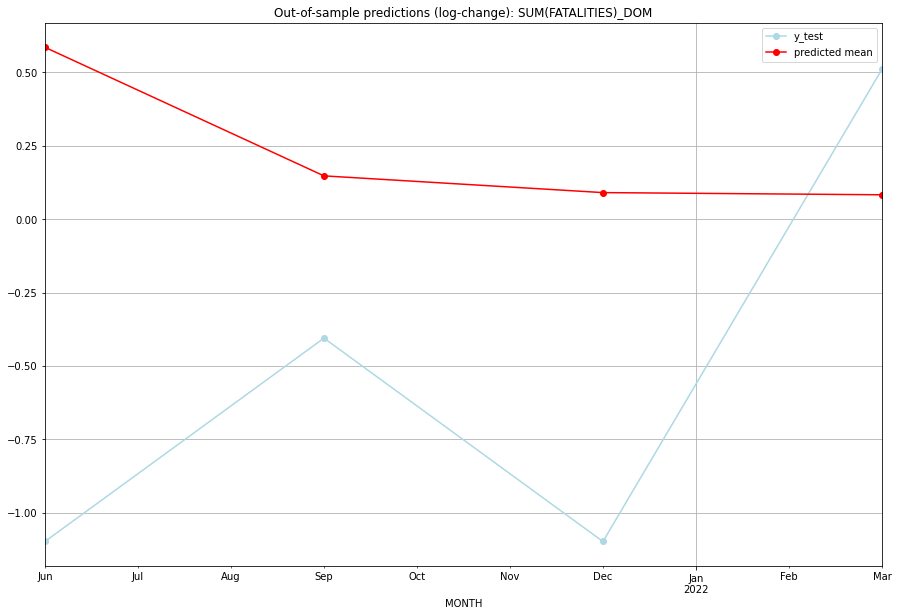

TADDA: 1.1695987990158212
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  4.389392         0.0      0.585820       -1.098612   DOM   
1 2021-07-01  2.477167         1.0      0.147606       -0.405465   DOM   
2 2021-10-01  2.284499         0.0      0.090602       -1.098612   DOM   
3 2022-01-01  2.260200         4.0      0.083176        0.510826   DOM   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## DZA (61/234) #########
0
Neighbor countries: ['TUN', 'MLI', 'MRT', 'LBY', 'NER', 'MAR', 'ESH']
Getting Data for DZA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 119)
y: (100, 1)
------------------------------------------------
Tr

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5770516427951243, 'fold_results': [0.6314321610770641, 0.9116659600151598, 0.49990888710286907, 0.6061358035703155, 0.2361154022102132]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DZA   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -109.174
Date:                 Wed, 19 Oct 2022   AIC                            220.349
Time:                         10:35:19   BIC                            222.903
Sample:                     04-30-1997   HQIC                           221.381
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

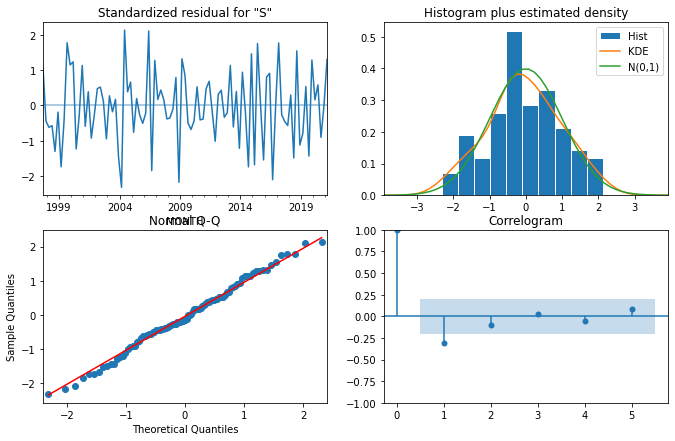

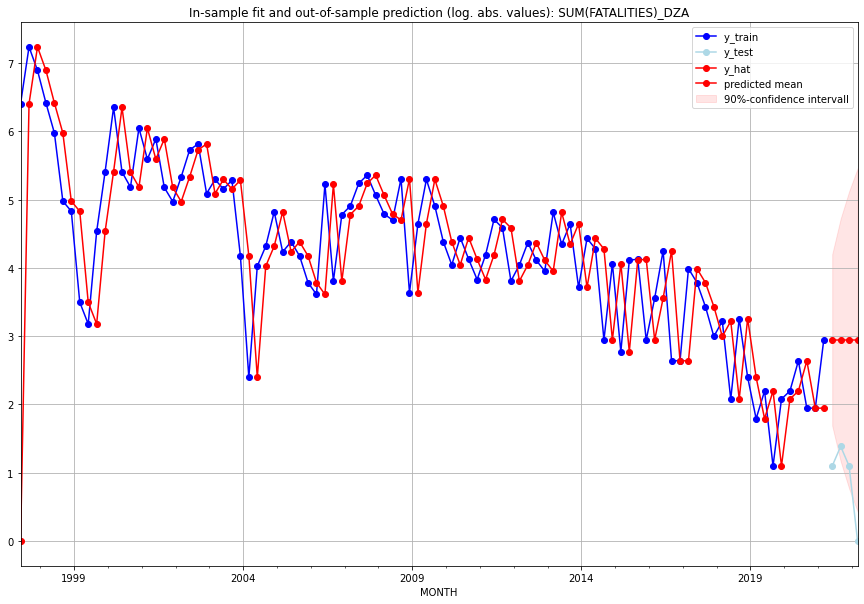

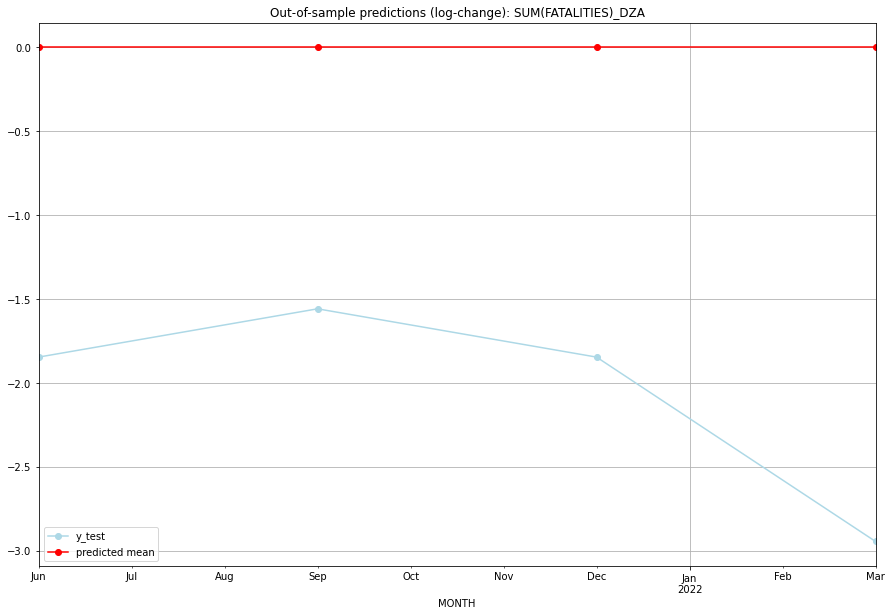

TADDA: 2.048559244552413
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      18.0         2.0           0.0       -1.845827   DZA   
1 2021-07-01      18.0         3.0           0.0       -1.558145   DZA   
2 2021-10-01      18.0         2.0           0.0       -1.845827   DZA   
3 2022-01-01      18.0         0.0           0.0       -2.944439   DZA   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:30
######## ECU (62/234) #########
0
Neighbor countries: ['PER', 'COL']
Getting Data for ECU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 80)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.34673949757785305, 'fold_results': [0.34673949757785305, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ECU   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                  -6.290
Date:                 Wed, 19 Oct 2022   AIC                             30.581
Time:                         10:35:32   BIC                             35.665
Sample:                     01-31-2018   HQIC                            29.535
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0291      0.012      2.50

<Figure size 432x288 with 0 Axes>

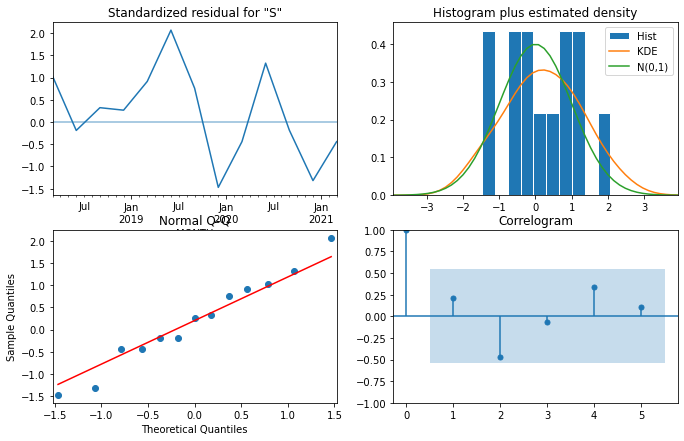

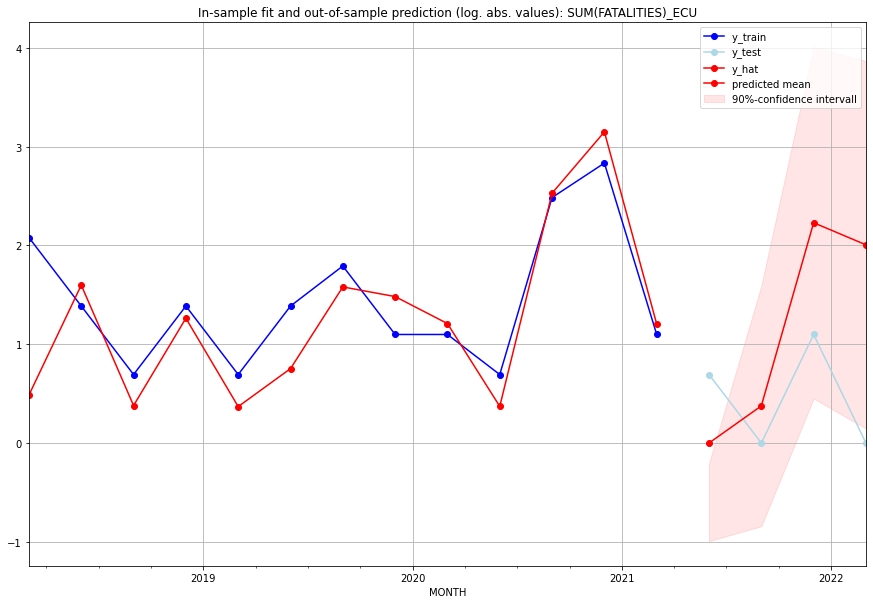

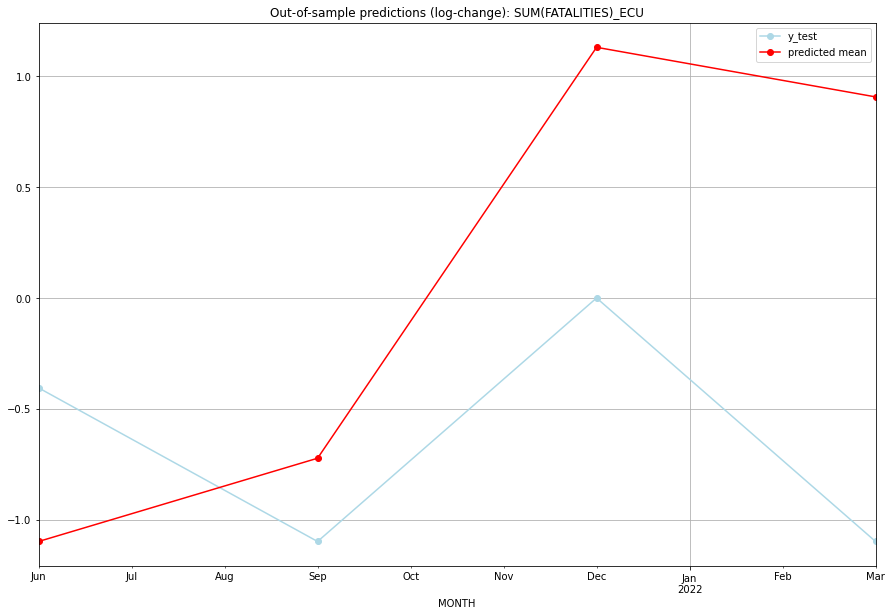

TADDA: 1.2782695541700515
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.000000         1.0     -1.098612       -0.405465   ECU   
1 2021-07-01  0.455962         0.0     -0.722945       -1.098612   ECU   
2 2021-10-01  8.296643         2.0      1.131041        0.000000   ECU   
3 2022-01-01  6.432911         0.0      0.907305       -1.098612   ECU   

                                          PARAMETERS  
0  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## EGY (63/234) #########
0
Neighbor countries: ['LBY', 'SDN', 'ISR', 'PSE']
Getting Data for EGY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 96)
y: (100, 1)
------------------------------------------------
Training started.
Start 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.2482701160652223, 'fold_results': [0.1881366297970808, 0.43193050135952804, 0.2814286783239681, 0.16185784984060336, 0.17799692100493125]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_EGY   No. Observations:                   96
Model:                SARIMAX(3, 0, 0)   Log Likelihood                -160.443
Date:                 Wed, 19 Oct 2022   AIC                            328.885
Time:                         10:35:55   BIC                            339.143
Sample:                     04-30-1997   HQIC                           333.032
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

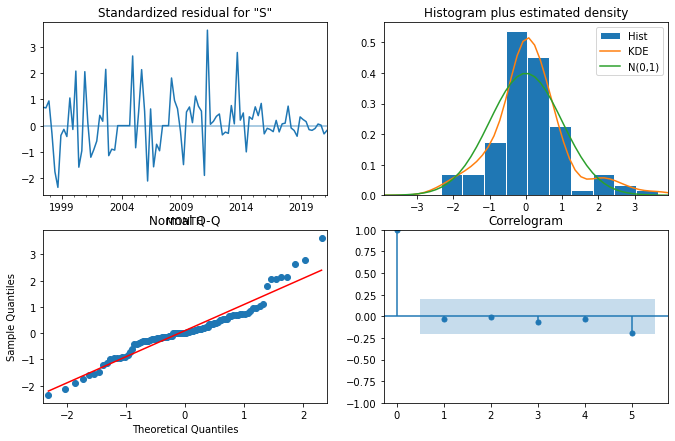

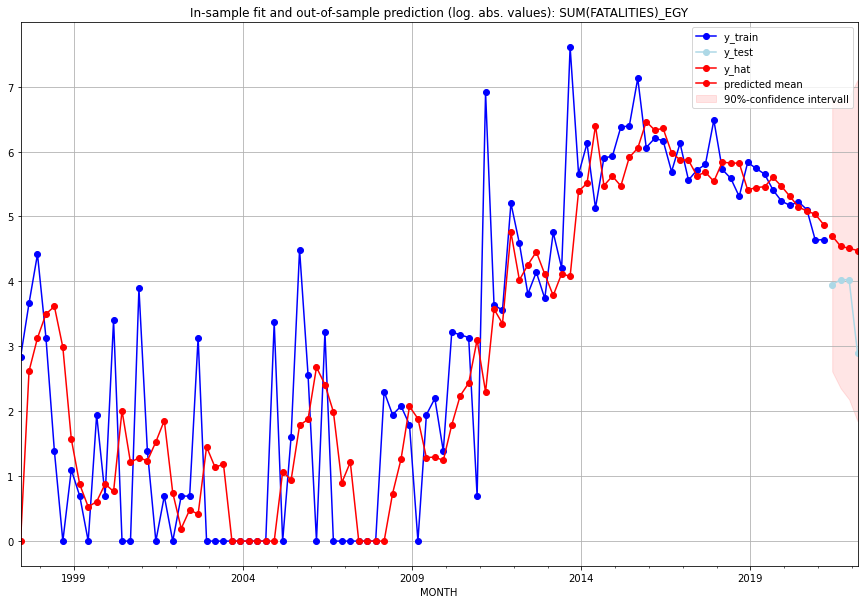

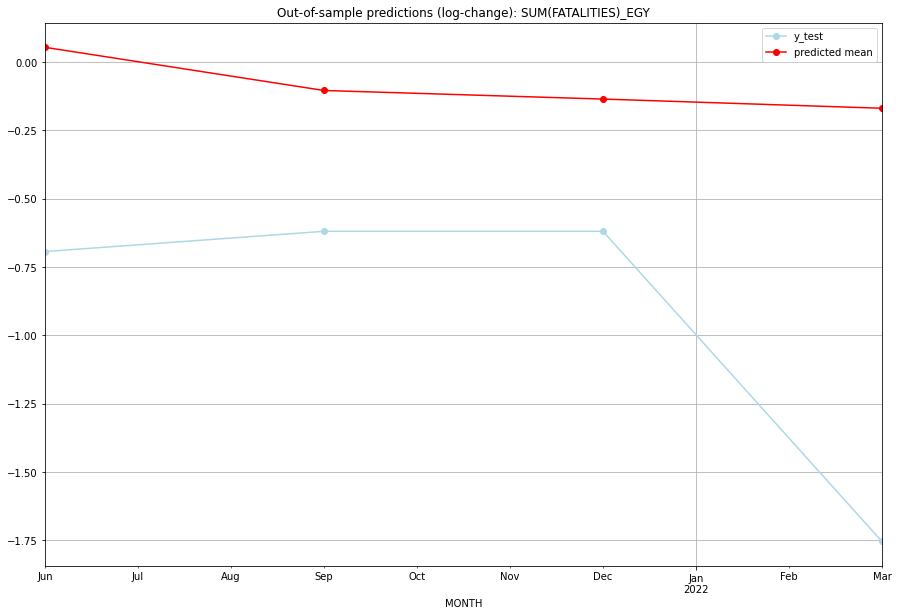

TADDA: 0.8465060776803239
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  108.794454        51.0      0.054219       -0.693147   EGY   
1 2021-07-01   92.751291        55.0     -0.103745       -0.619039   EGY   
2 2021-10-01   89.854791        55.0     -0.135128       -0.619039   EGY   
3 2022-01-01   86.847826        17.0     -0.168785       -1.754019   EGY   

                                          PARAMETERS  
0  {'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## ERI (64/234) #########
0
Neighbor countries: ['ETH', 'SDN', 'DJI']
Getting Data for ERI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 77)
y: (100, 1)
------------------------------------------------
Training started.
Sta

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4313886793027553, 'fold_results': [1.2867470331404736, 0.24896970092630308, 0.44793986730701374, 0.0, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ERI   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                -212.725
Date:                 Wed, 19 Oct 2022   AIC                            433.450
Time:                         10:36:17   BIC                            443.707
Sample:                     04-30-1997   HQIC                           437.596
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

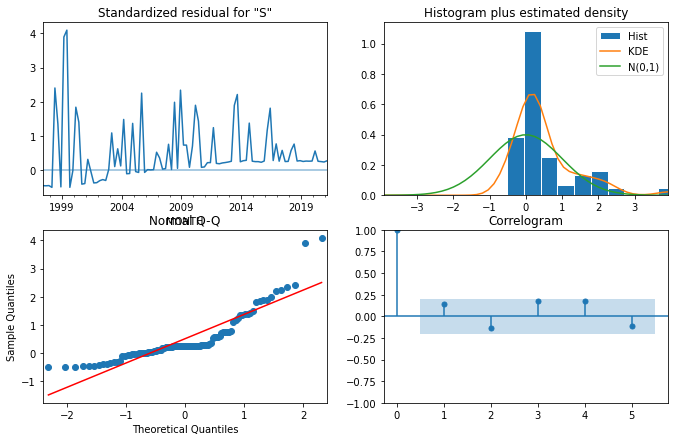

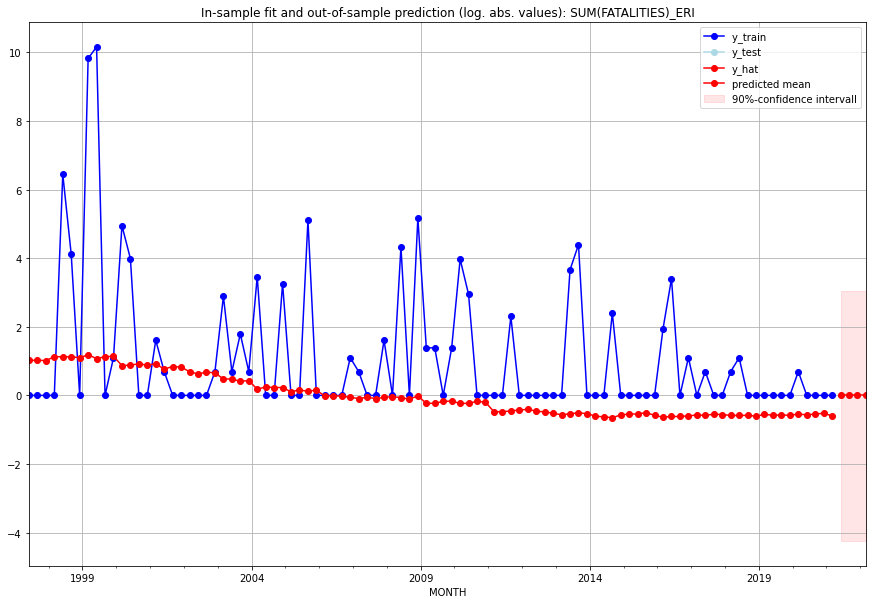

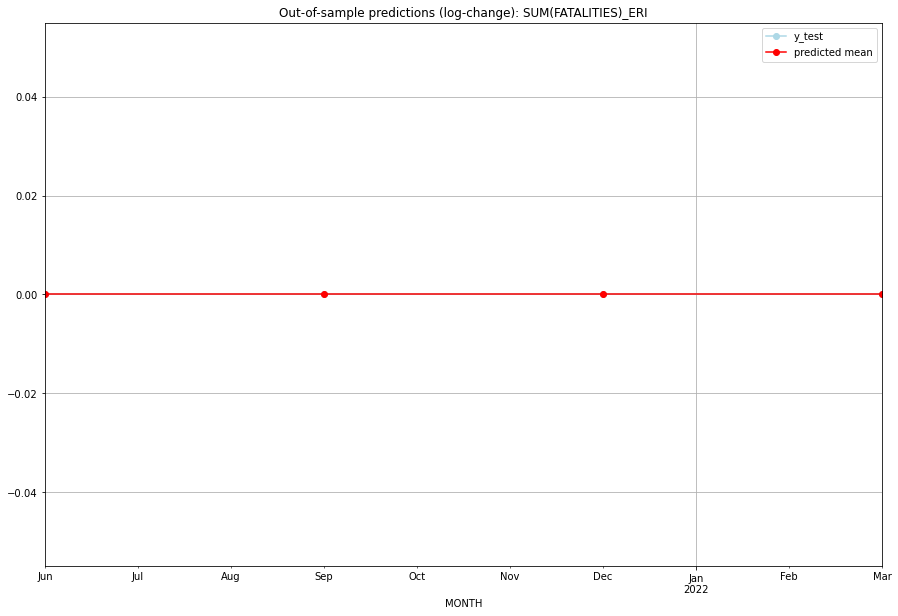

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ERI   
1 2021-07-01       0.0         0.0           0.0             0.0   ERI   
2 2021-10-01       0.0         0.0           0.0             0.0   ERI   
3 2022-01-01       0.0         0.0           0.0             0.0   ERI   

                                          PARAMETERS  
0  {'params': [3, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:26
######## ESH (65/234) #########
0
Neighbor countries: ['MRT', 'DZA', 'MAR']
Getting Data for ESH
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CP

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.29740842935118755, 'fold_results': [0.5198597307213739, 0.0, 0.0, 0.44793986730701374, 0.51924254872755]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ESH   No. Observations:                   96
Model:                SARIMAX(0, 0, 2)   Log Likelihood                 -73.133
Date:                 Wed, 19 Oct 2022   AIC                            152.266
Time:                         10:36:41   BIC                            159.959
Sample:                     04-30-1997   HQIC                           155.376
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

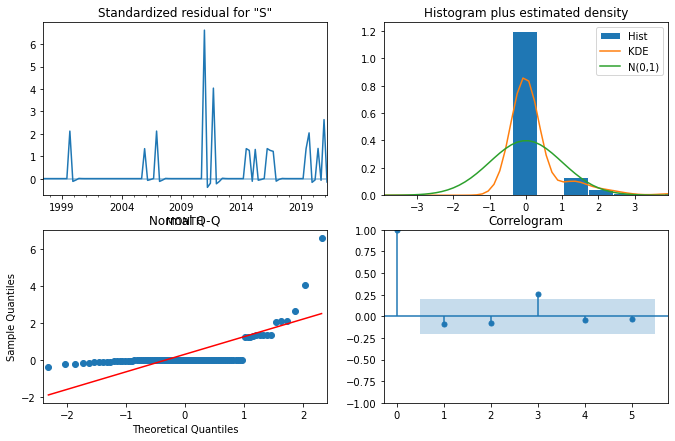

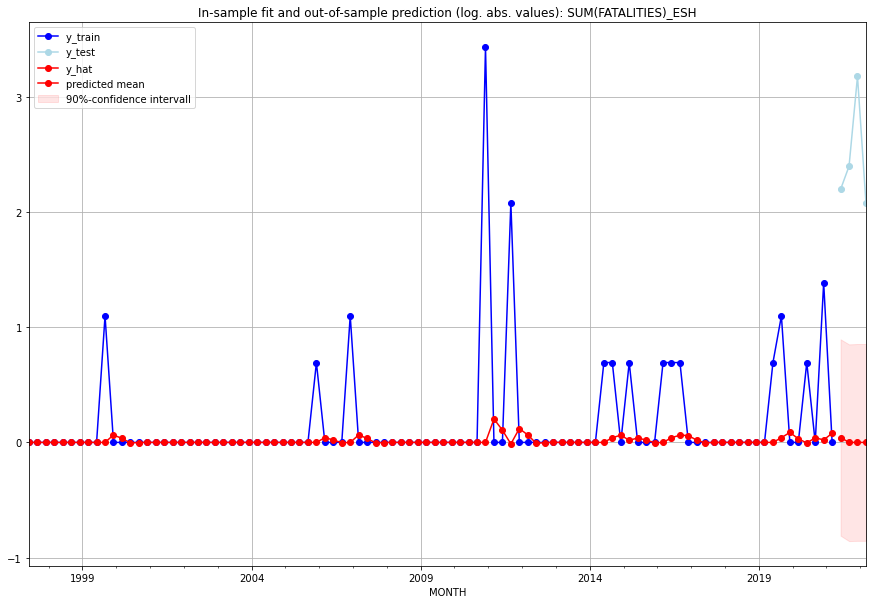

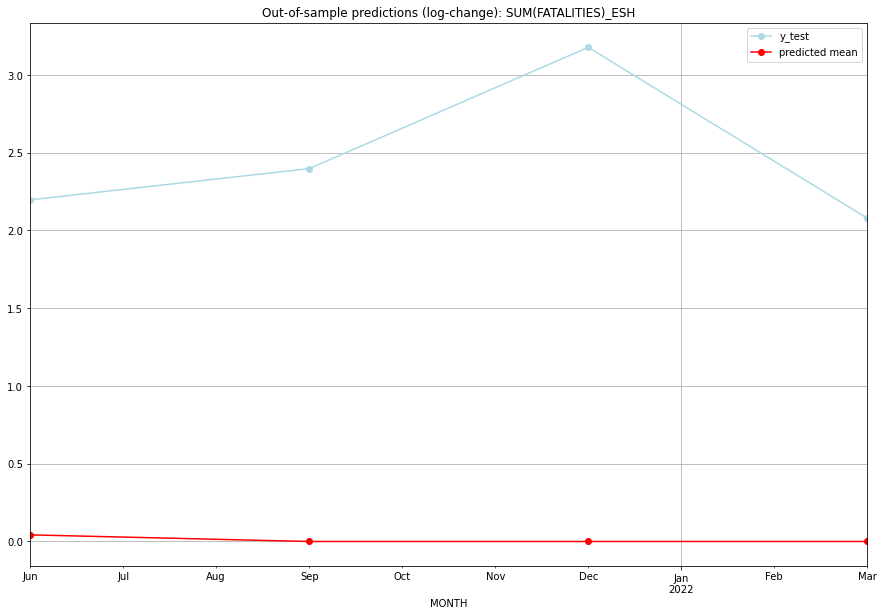

TADDA: 2.4525075792988114
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.043505         8.0      0.042585        2.197225   ESH   
1 2021-07-01  0.000000        10.0      0.000000        2.397895   ESH   
2 2021-10-01  0.000000        23.0      0.000000        3.178054   ESH   
3 2022-01-01  0.000000         7.0      0.000000        2.079442   ESH   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## ESP (66/234) #########
0
Neighbor countries: ['PRT', 'FRA', 'GIB', 'AND', 'MAR']
Getting Data for ESP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 105)
y: (9, 1)
------------------------------------------------
Training started.
Gr

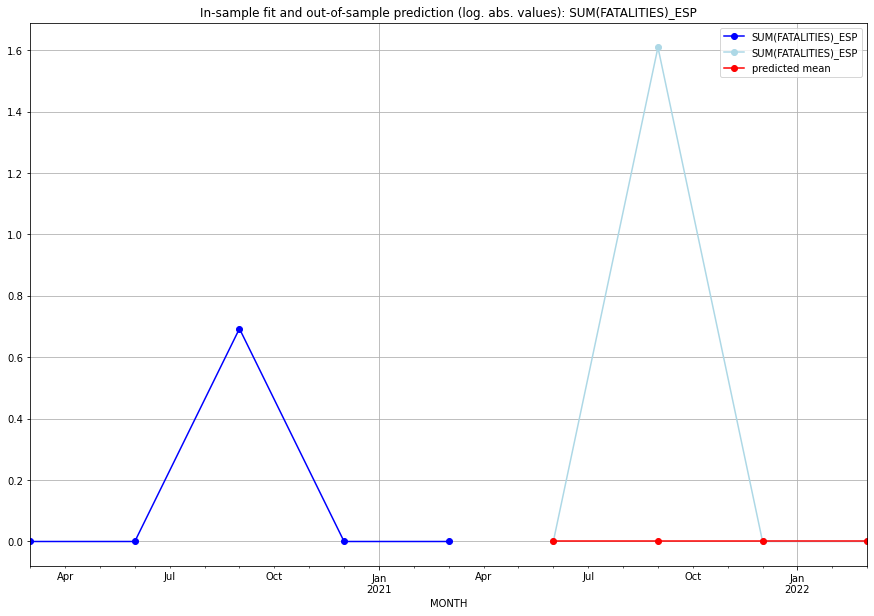

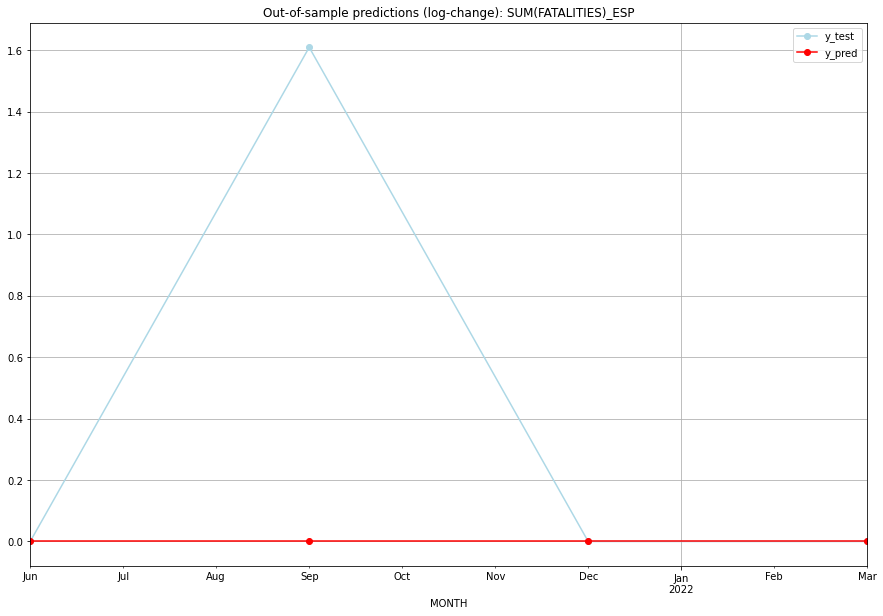

TADDA: 0.4023594781085251
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   ESP   
1 2021-07-01       0.0    1.609438           0.0        1.609438   ESP   
2 2021-10-01       0.0    0.000000           0.0        0.000000   ESP   
3 2022-01-01       0.0    0.000000           0.0        0.000000   ESP   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## EST (67/234) #########
0
Neighbor countries: ['RUS', 'LVA']
Getting Data for EST
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 80)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


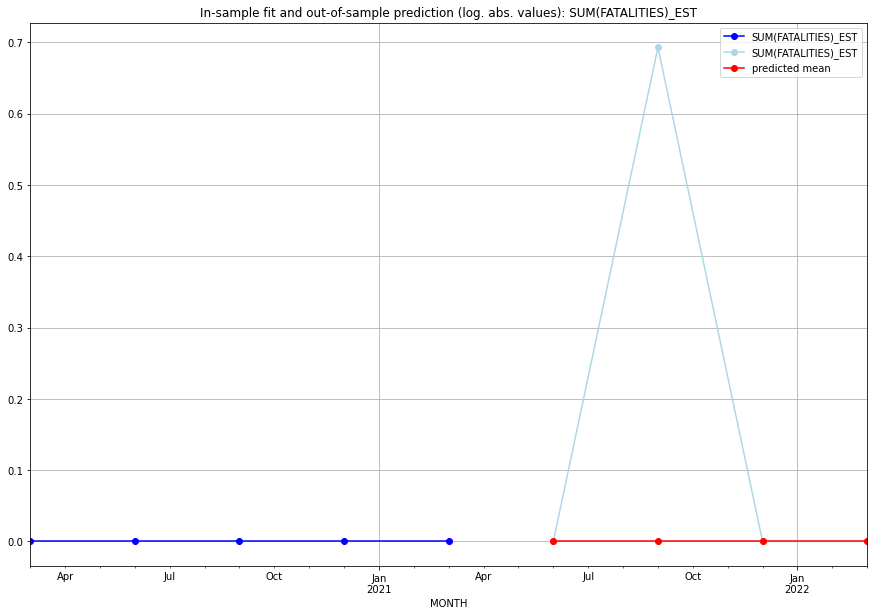

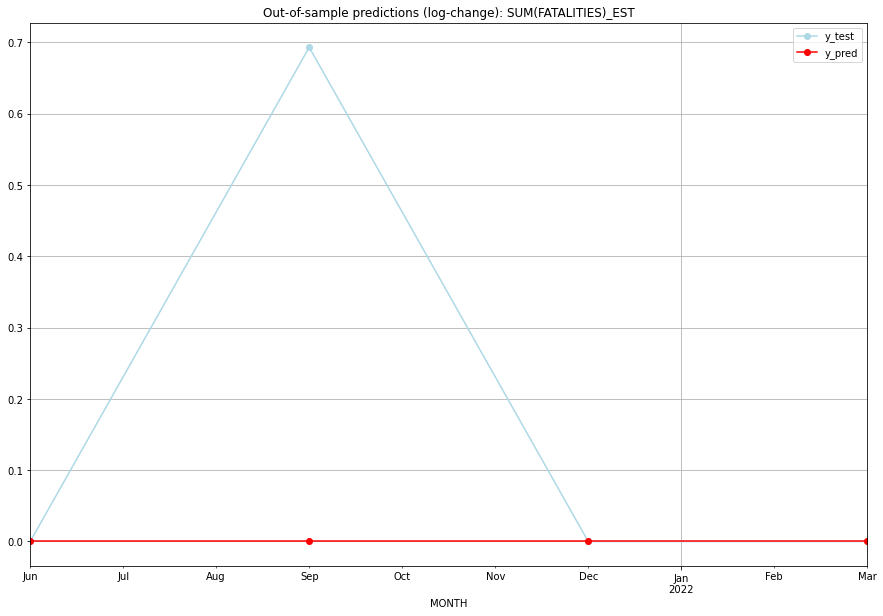

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   EST   
1 2021-07-01       0.0    0.693147           0.0        0.693147   EST   
2 2021-10-01       0.0    0.000000           0.0        0.000000   EST   
3 2022-01-01       0.0    0.000000           0.0        0.000000   EST   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## ETH (68/234) #########
0
Neighbor countries: ['KEN', 'SSD', 'XIT', 'ERI', 'SDN', 'DJI', 'SOM']
Getting Data for ETH
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 119)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.64095613581193, 'fold_results': [0.26048391856021325, 0.8378980042255615, 0.15560188075393855, 0.9154933696767509, 1.035303505843186]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ETH   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -189.911
Date:                 Wed, 19 Oct 2022   AIC                            381.822
Time:                         10:37:15   BIC                            384.375
Sample:                     04-30-1997   HQIC                           382.854
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

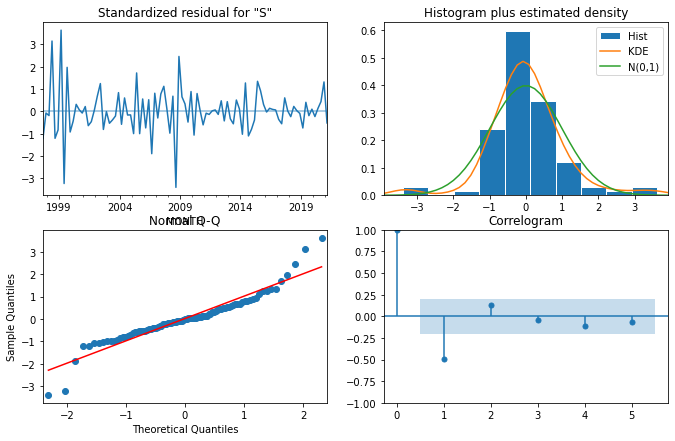

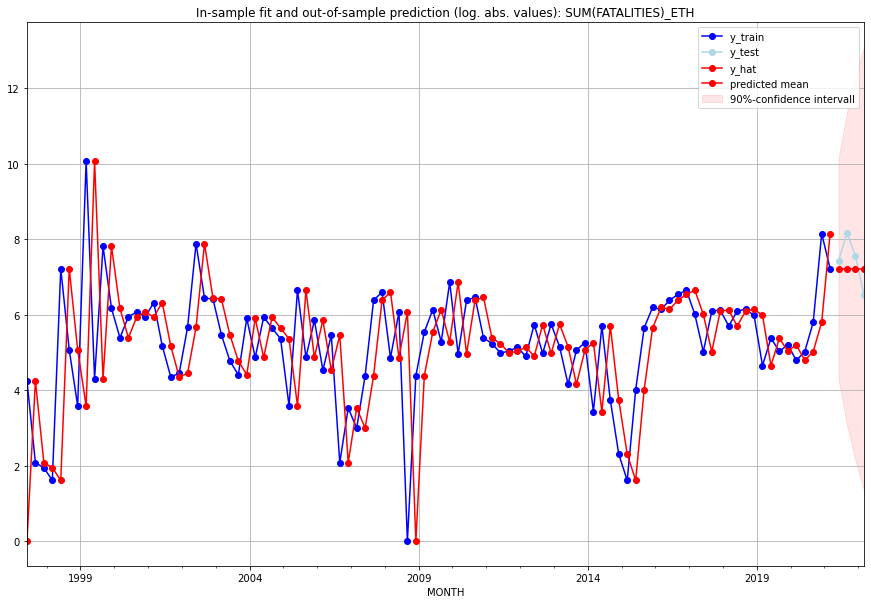

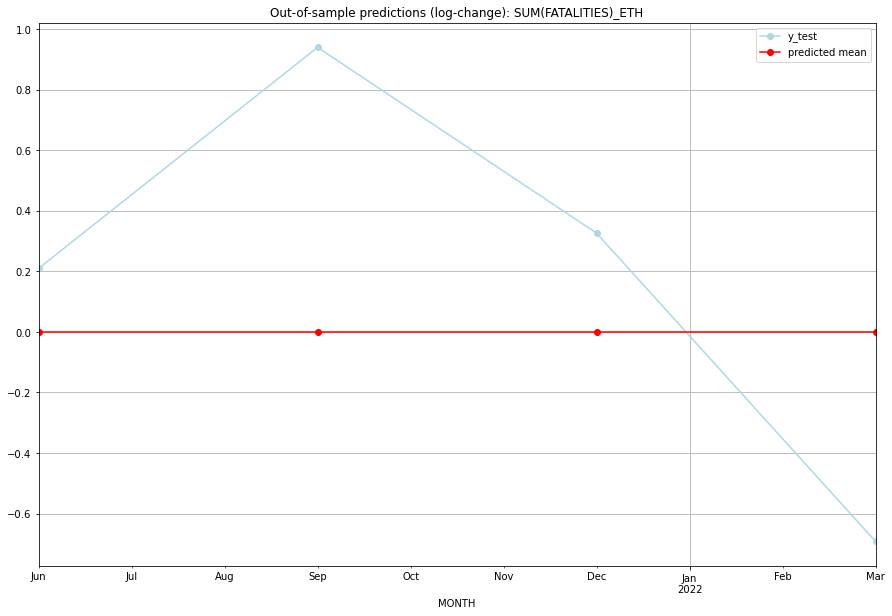

TADDA: 0.5422179258427575
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01    1370.0      1690.0  8.881784e-16        0.209780   ETH   
1 2021-07-01    1370.0      3510.0  8.881784e-16        0.940360   ETH   
2 2021-10-01    1370.0      1899.0  8.881784e-16        0.326313   ETH   
3 2022-01-01    1370.0       685.0  8.881784e-16       -0.692418   ETH   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:28
######## FIN (69/234) #########
0
Neighbor countries: ['RUS', 'NOR', 'SWE']
Getting Data for FIN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 89)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV fail

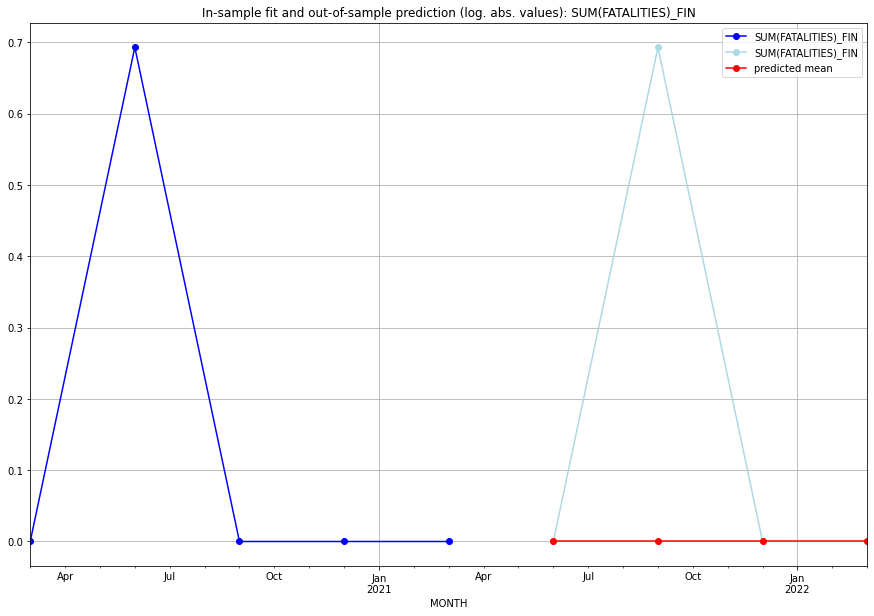

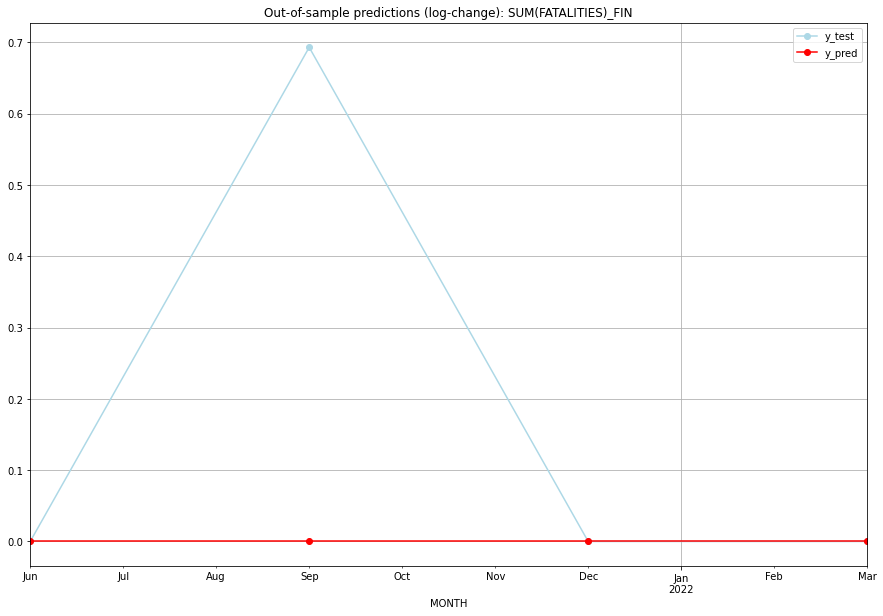

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   FIN   
1 2021-07-01       0.0    0.693147           0.0        0.693147   FIN   
2 2021-10-01       0.0    0.000000           0.0        0.000000   FIN   
3 2022-01-01       0.0    0.000000           0.0        0.000000   FIN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## FJI (70/234) #########
0
Neighbor countries: []
Getting Data for FJI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 56)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


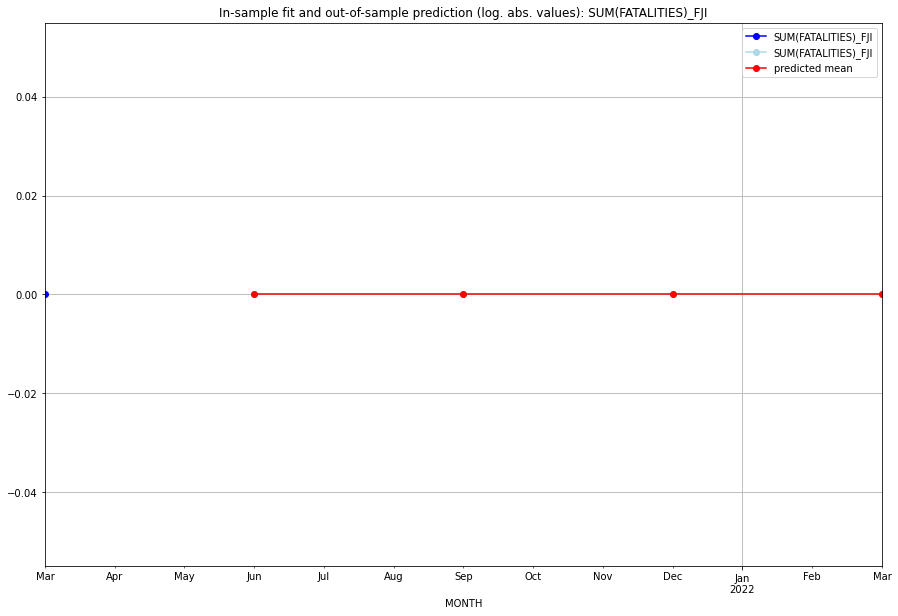

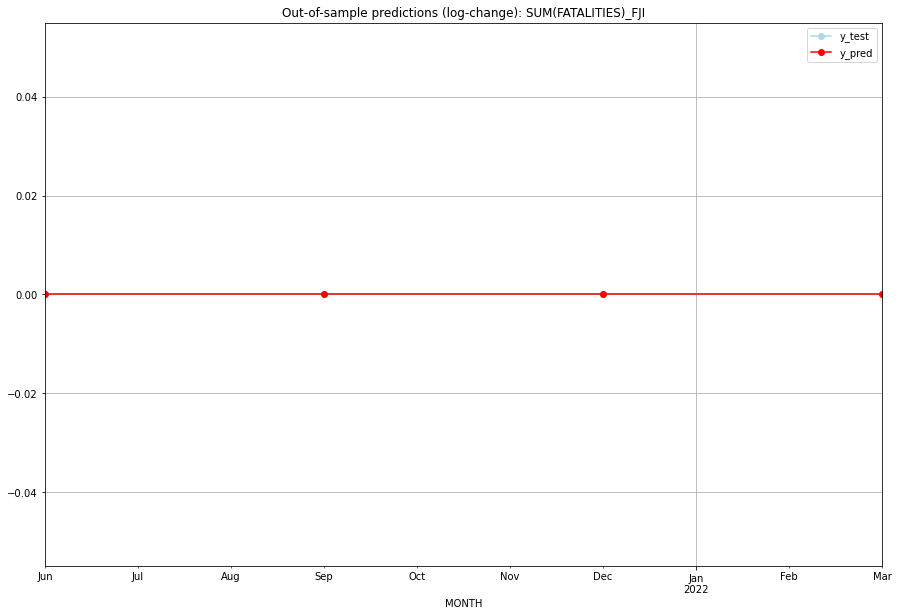

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   FJI   
1 2021-07-01       0.0         0.0           0.0             0.0   FJI   
2 2021-10-01       0.0         0.0           0.0             0.0   FJI   
3 2022-01-01       0.0         0.0           0.0             0.0   FJI   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## FLK (71/234) #########
0
Neighbor countries: []
Getting Data for FLK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


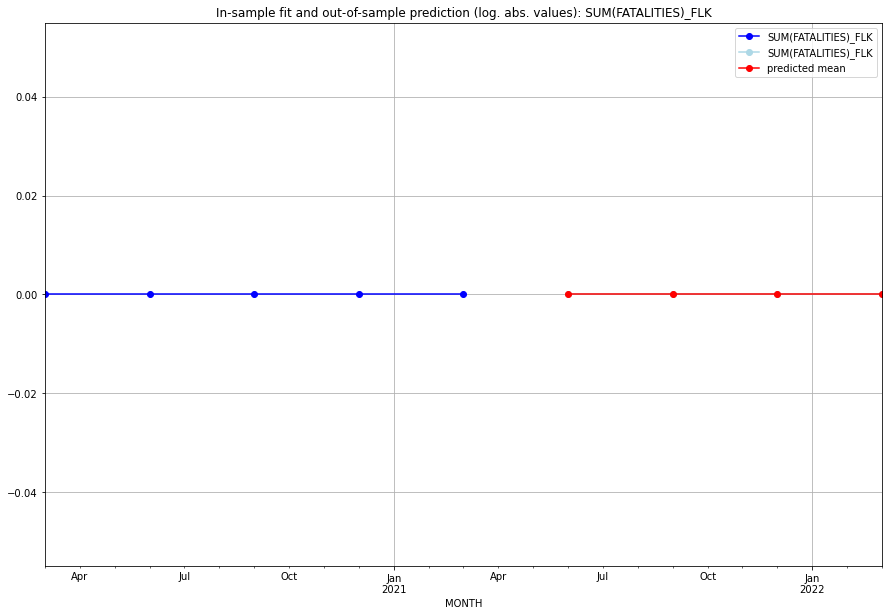

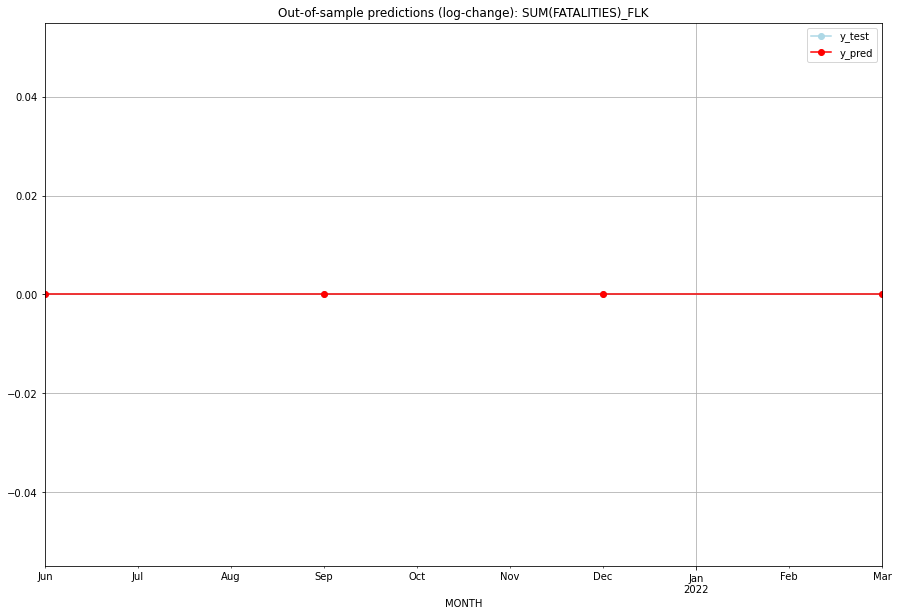

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   FLK   
1 2021-07-01       0.0         0.0           0.0             0.0   FLK   
2 2021-10-01       0.0         0.0           0.0             0.0   FLK   
3 2022-01-01       0.0         0.0           0.0             0.0   FLK   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## FRA (72/234) #########
0
Neighbor countries: ['ESP', 'AND', 'ITA', 'MCO', 'CHE', 'BEL', 'DEU', 'LUX']
Getting Data for FRA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 128)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


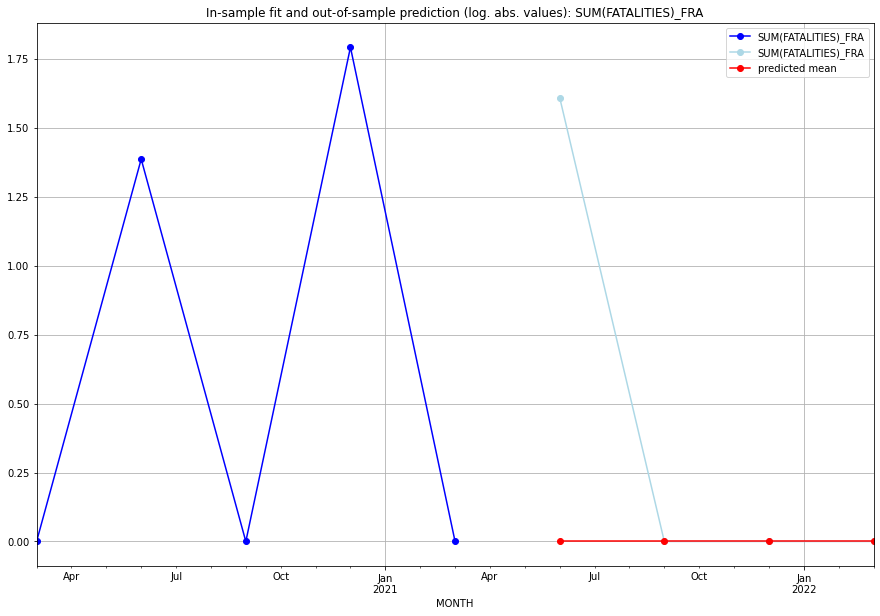

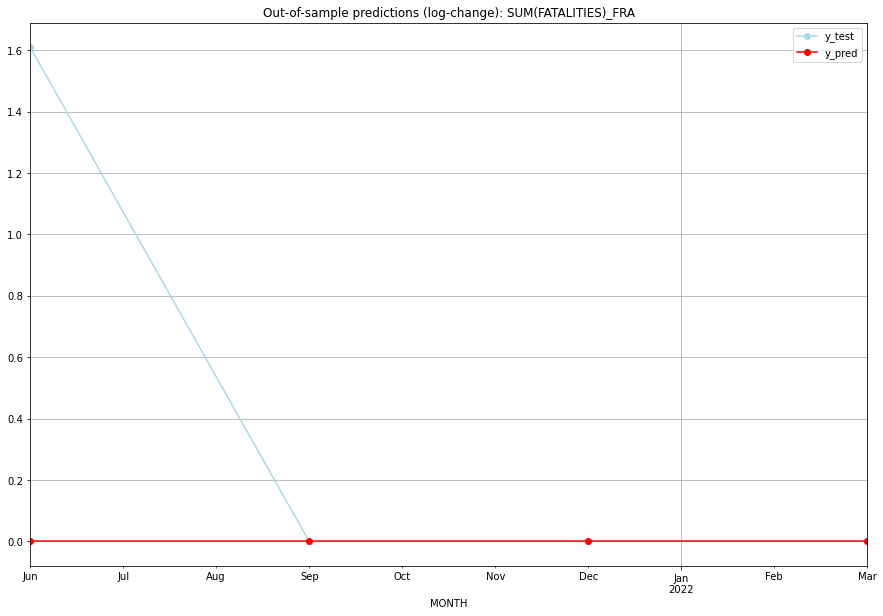

TADDA: 0.4023594781085251
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    1.609438           0.0        1.609438   FRA   
1 2021-07-01       0.0    0.000000           0.0        0.000000   FRA   
2 2021-10-01       0.0    0.000000           0.0        0.000000   FRA   
3 2022-01-01       0.0    0.000000           0.0        0.000000   FRA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## FRO (73/234) #########
0
Neighbor countries: []
Getting Data for FRO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


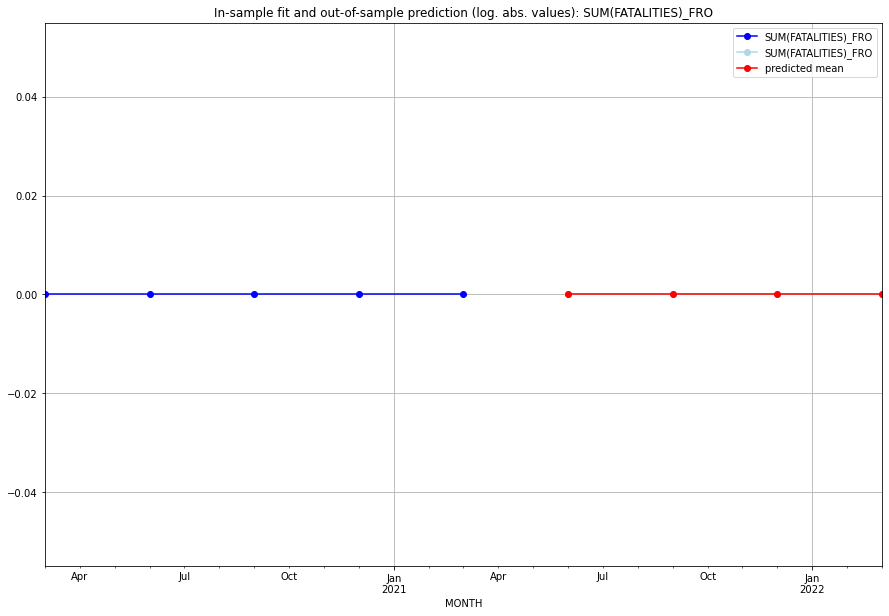

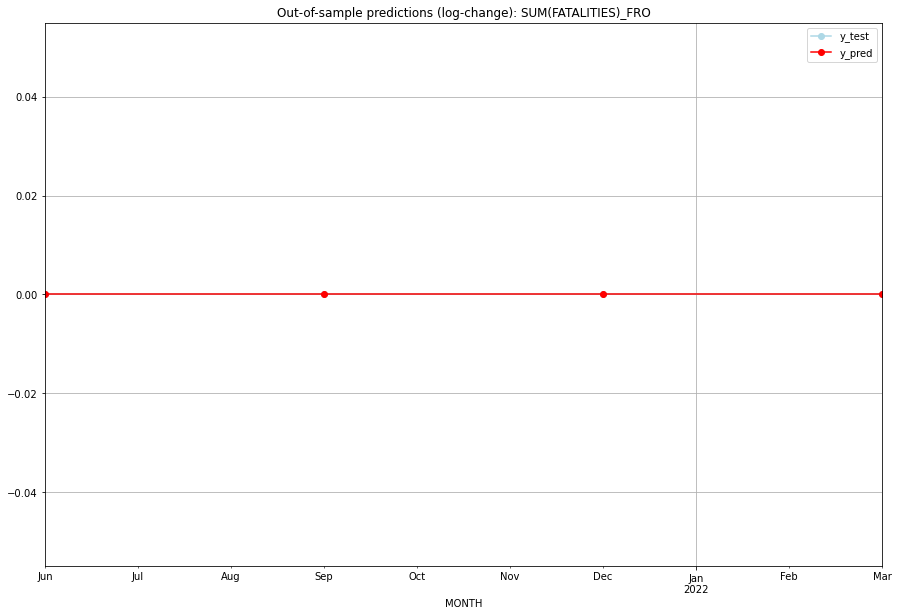

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   FRO   
1 2021-07-01       0.0         0.0           0.0             0.0   FRO   
2 2021-10-01       0.0         0.0           0.0             0.0   FRO   
3 2022-01-01       0.0         0.0           0.0             0.0   FRO   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## FSM (74/234) #########
0
Neighbor countries: []
Getting Data for FSM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 40)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


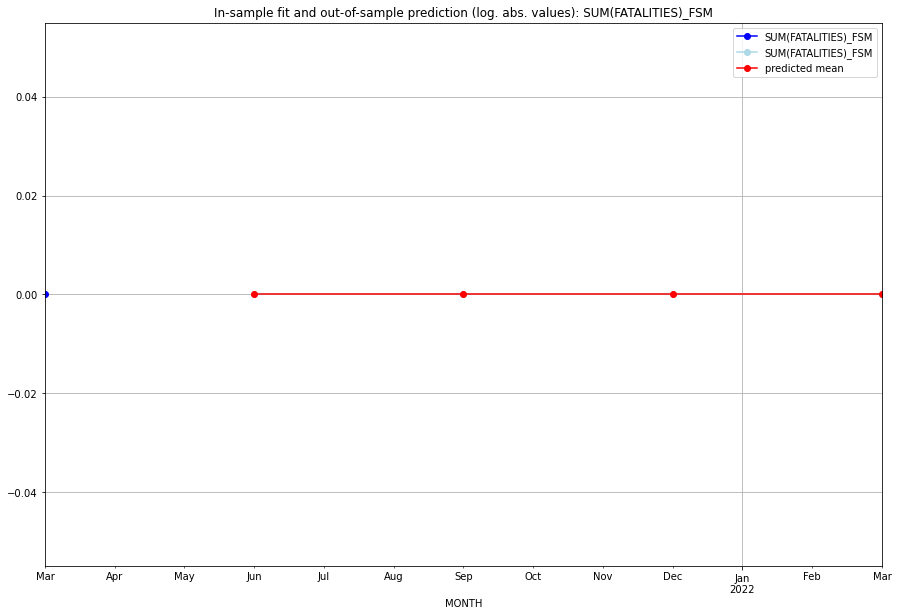

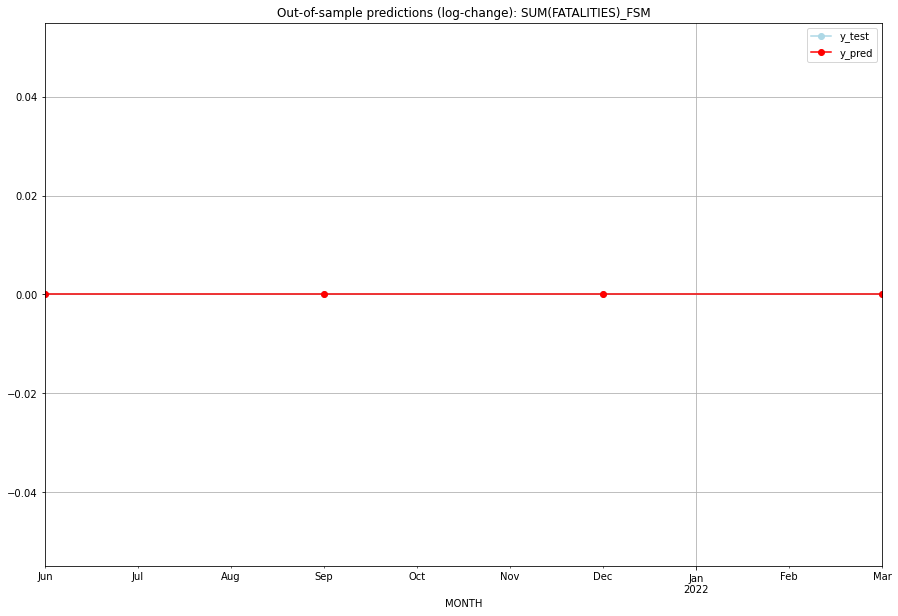

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   FSM   
1 2021-07-01       0.0         0.0           0.0             0.0   FSM   
2 2021-10-01       0.0         0.0           0.0             0.0   FSM   
3 2022-01-01       0.0         0.0           0.0             0.0   FSM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## GAB (75/234) #########
0
Neighbor countries: ['GNQ', 'COG', 'CMR']
Getting Data for GAB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 82)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.3629947675164473, 'fold_results': [0.519860385419959, 0.0, 0.17328679513998632, 0.6212266624470001, 0.5005999945752914]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GAB   No. Observations:                   96
Model:                SARIMAX(2, 0, 3)   Log Likelihood                 -62.785
Date:                 Wed, 19 Oct 2022   AIC                            139.569
Time:                         10:37:53   BIC                            157.520
Sample:                     04-30-1997   HQIC                           146.825
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

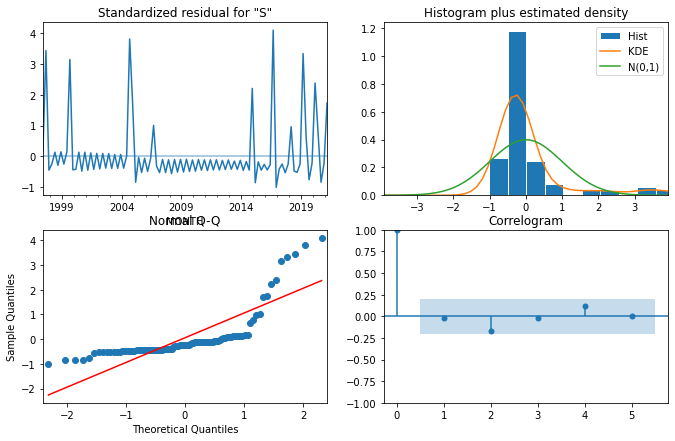

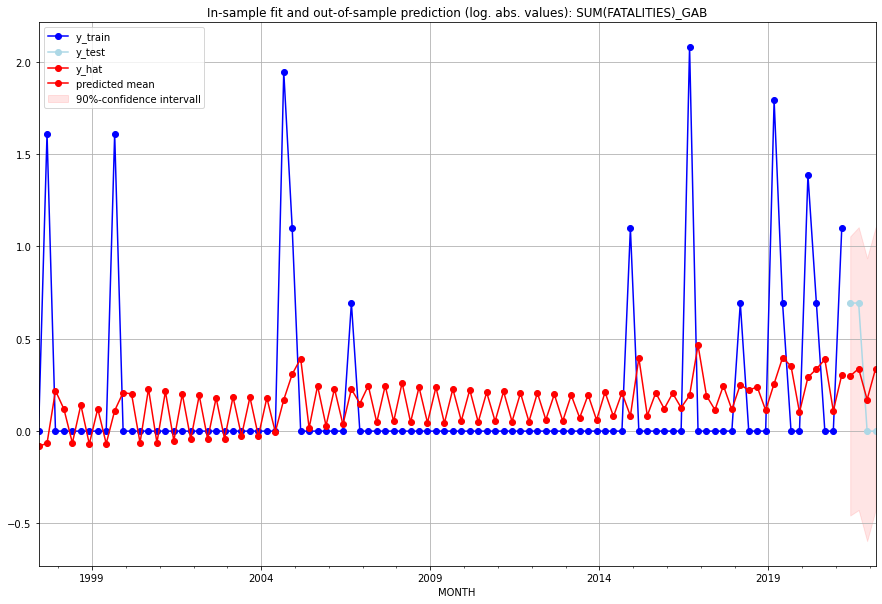

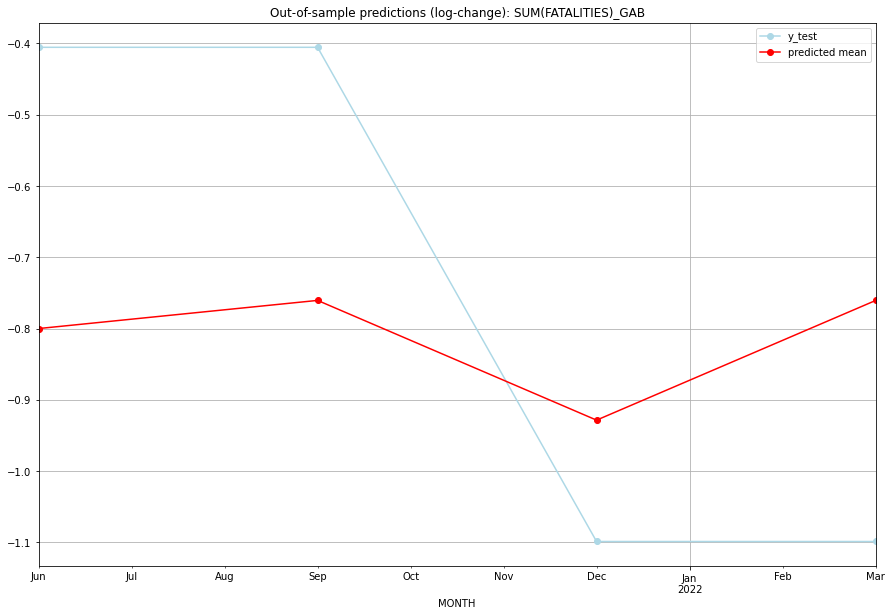

TADDA: 0.31443170604211856
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.348063         1.0     -0.799944       -0.405465   GAB   
1 2021-07-01  0.402338         1.0     -0.760471       -0.405465   GAB   
2 2021-10-01  0.185558         0.0     -0.928399       -1.098612   GAB   
3 2022-01-01  0.402180         0.0     -0.760584       -1.098612   GAB   

                                          PARAMETERS  
0  {'params': [1, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:25
######## GBR (76/234) #########
0
Neighbor countries: ['IRL']
Getting Data for GBR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 72)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insuffici

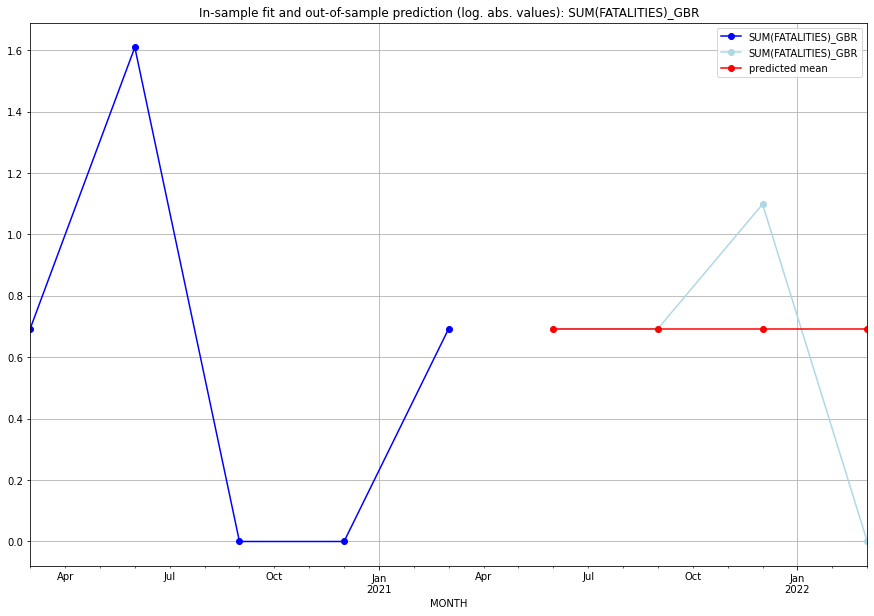

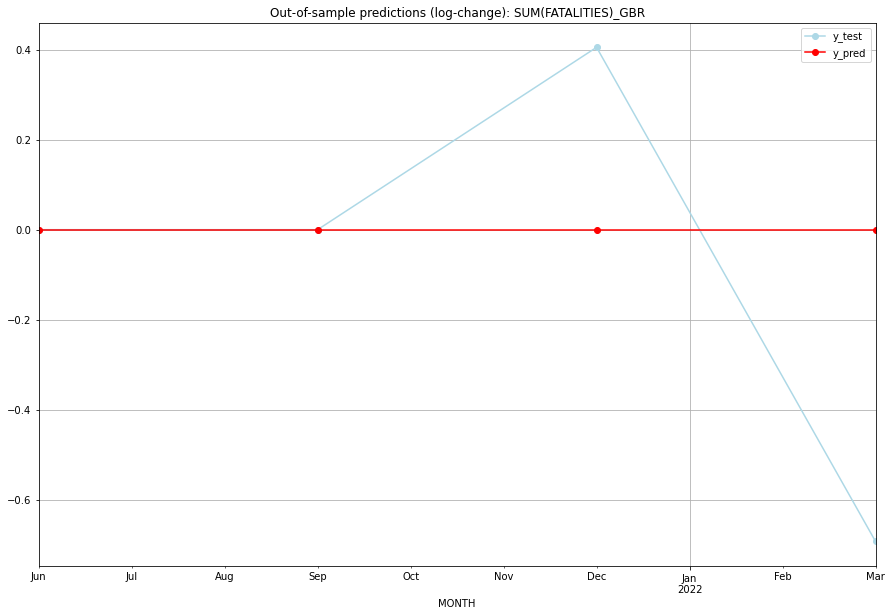

TADDA: 0.27465307216702745
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.693147    0.693147           0.0        0.000000   GBR   
1 2021-07-01  0.693147    0.693147           0.0        0.000000   GBR   
2 2021-10-01  0.693147    1.098612           0.0        0.405465   GBR   
3 2022-01-01  0.693147    0.000000           0.0       -0.693147   GBR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## GEO (77/234) #########
0
Neighbor countries: ['ARM', 'TUR', 'RUS', 'AZE']
Getting Data for GEO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 95)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.23585844509461393, 'fold_results': [0.23585844509461393, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GEO   No. Observations:                   13
Model:                SARIMAX(2, 0, 2)   Log Likelihood                  -2.962
Date:                 Wed, 19 Oct 2022   AIC                             17.924
Time:                         10:38:12   BIC                             21.314
Sample:                     01-31-2018   HQIC                            17.227
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0185      0.016     -1.17

<Figure size 432x288 with 0 Axes>

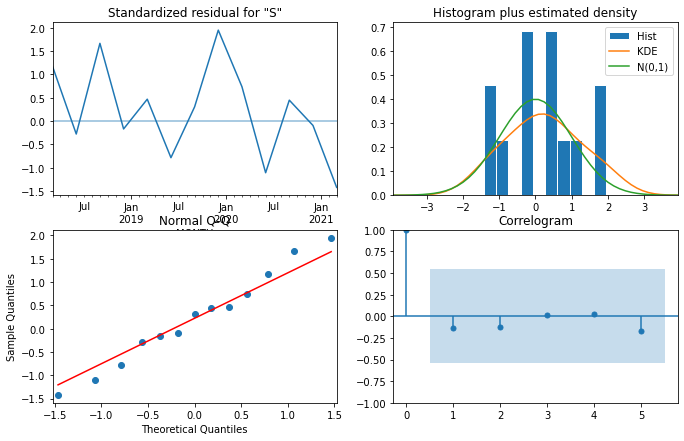

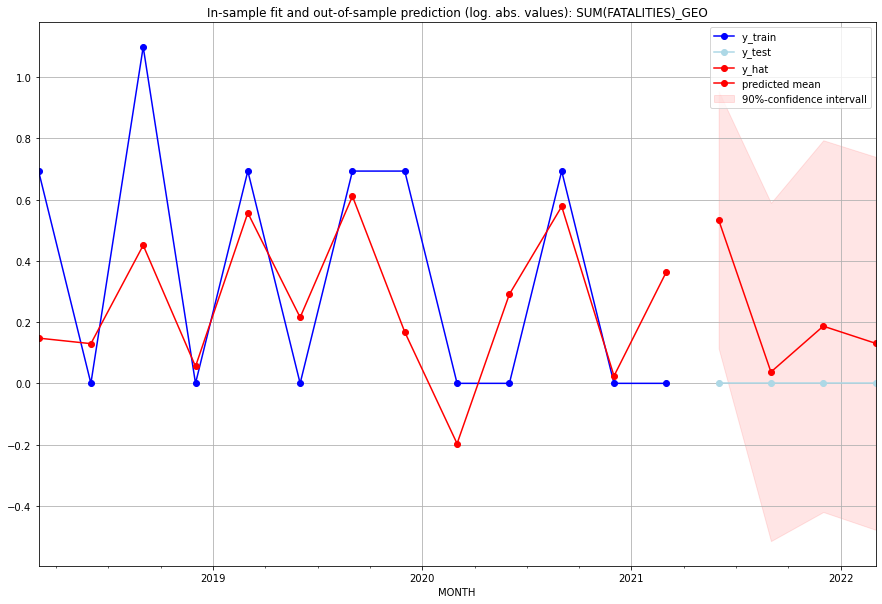

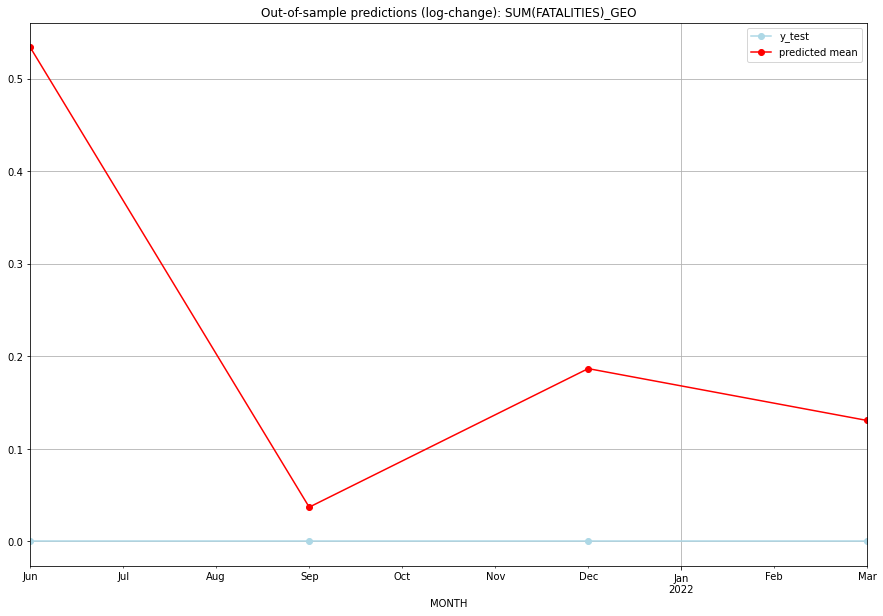

TADDA: 0.22213191504689392
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.705593         0.0      0.533913             0.0   GEO   
1 2021-07-01  0.037787         0.0      0.037091             0.0   GEO   
2 2021-10-01  0.205365         0.0      0.186783             0.0   GEO   
3 2022-01-01  0.139673         0.0      0.130741             0.0   GEO   

                                          PARAMETERS  
0  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## GGY (78/234) #########
0
Neighbor countries: []
Getting Data for GGY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV nec

<Figure size 432x288 with 0 Axes>

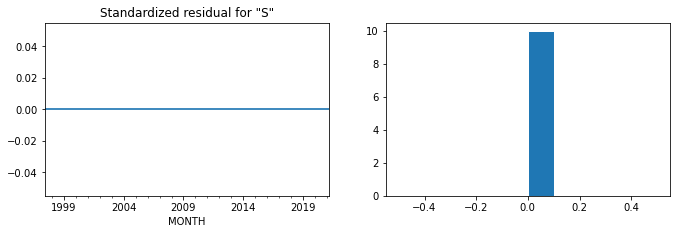

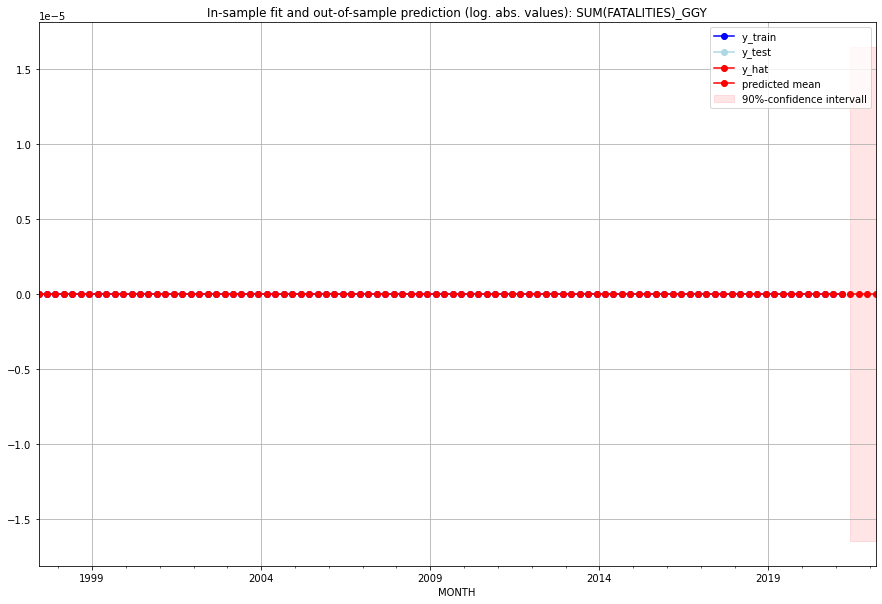

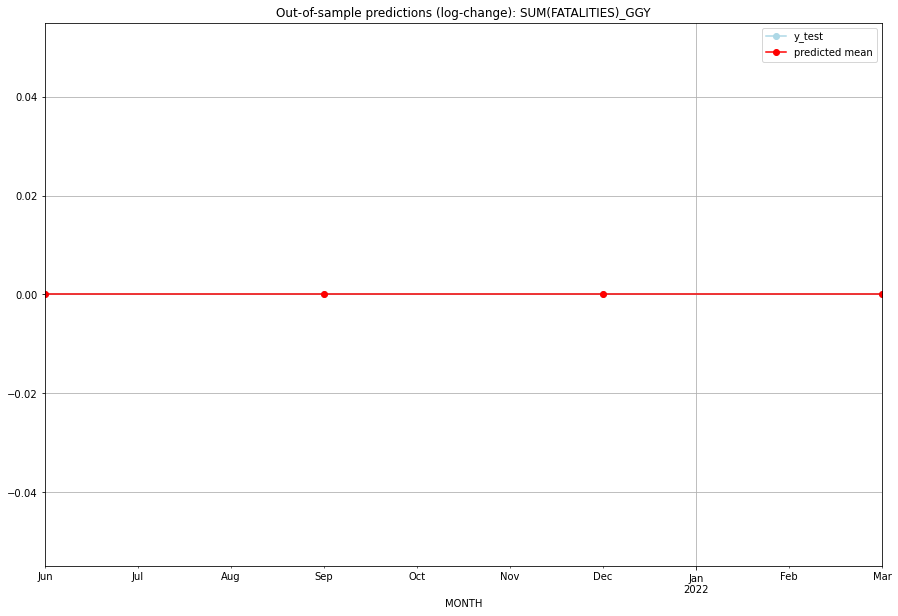

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GGY   
1 2021-07-01       0.0         0.0           0.0             0.0   GGY   
2 2021-10-01       0.0         0.0           0.0             0.0   GGY   
3 2022-01-01       0.0         0.0           0.0             0.0   GGY   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## GHA (79/234) #########
0
Neighbor countries: ['CIV', 'BFA', 'TGO']
Getting Data for GHA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 87)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.6387327037233603, 'fold_results': [0.8227827739708472, 1.0588729410129312, 0.6132216472602741, 0.2601904877553691, 0.4385956686173798]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GHA   No. Observations:                   96
Model:                SARIMAX(0, 1, 3)   Log Likelihood                -138.715
Date:                 Wed, 19 Oct 2022   AIC                            291.431
Time:                         10:38:49   BIC                            309.308
Sample:                     04-30-1997   HQIC                           298.654
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

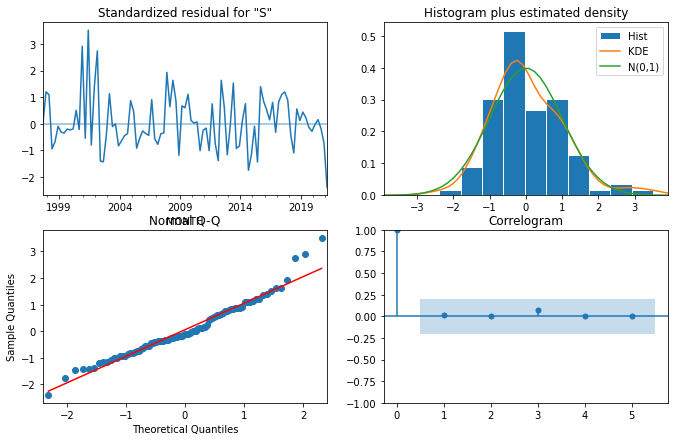

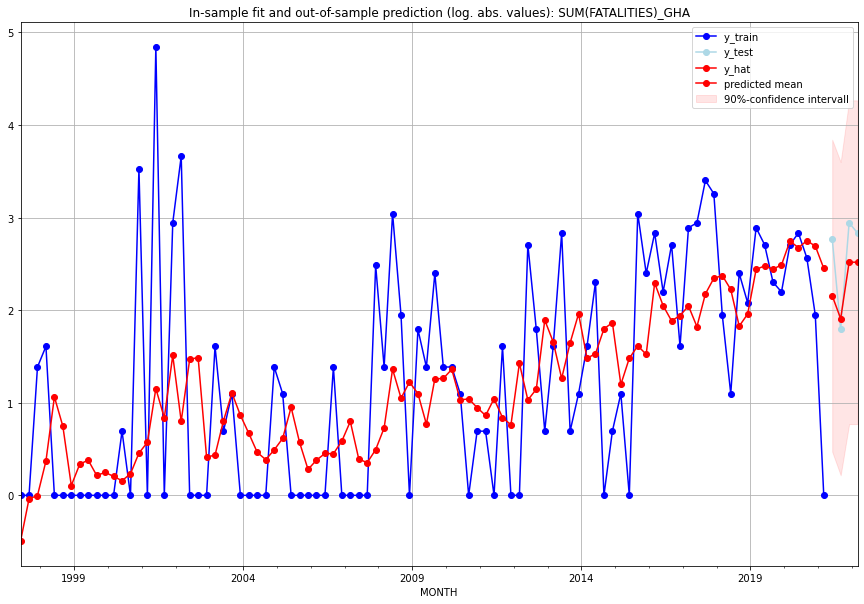

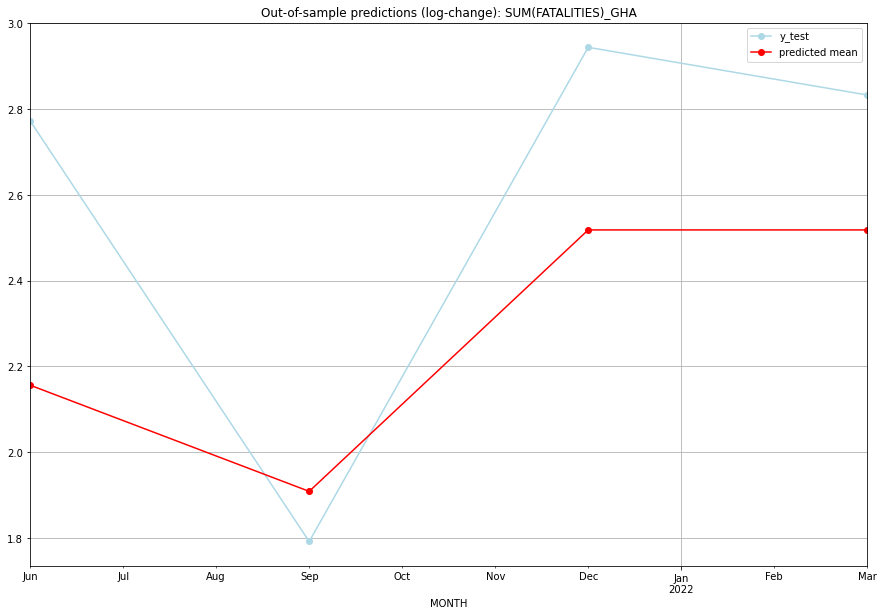

TADDA: 0.3684796286255202
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   7.638827        15.0      2.156267        2.772589   GHA   
1 2021-07-01   5.744115         5.0      1.908670        1.791759   GHA   
2 2021-10-01  11.409760        18.0      2.518483        2.944439   GHA   
3 2022-01-01  11.409760        16.0      2.518483        2.833213   GHA   

                                          PARAMETERS  
0  {'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:28
######## GIB (80/234) #########
0
Neighbor countries: ['ESP']
Getting Data for GIB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 8)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insuff

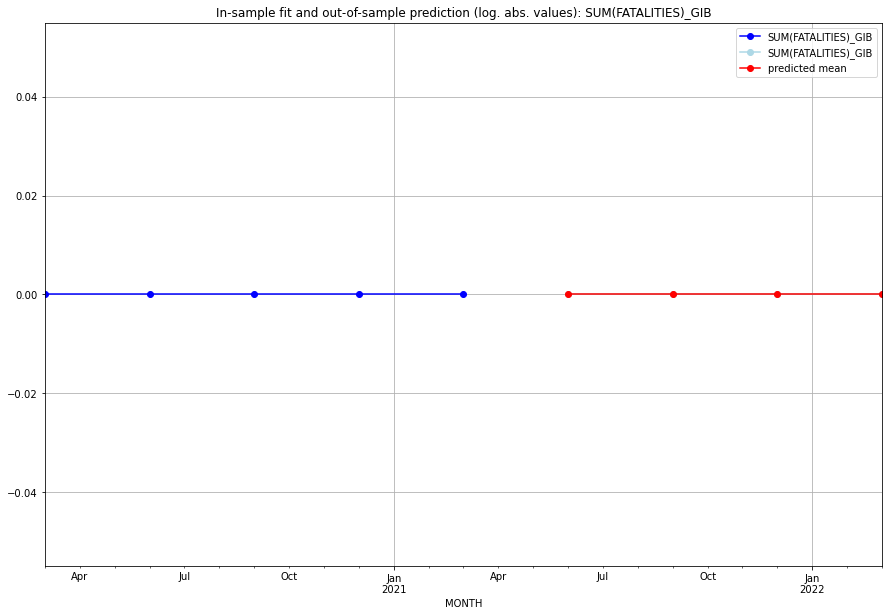

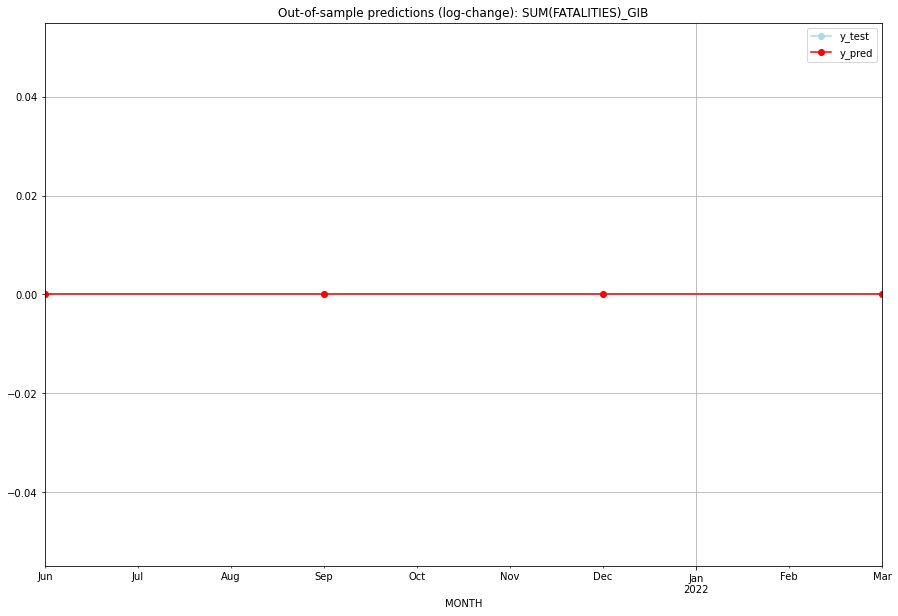

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GIB   
1 2021-07-01       0.0         0.0           0.0             0.0   GIB   
2 2021-10-01       0.0         0.0           0.0             0.0   GIB   
3 2022-01-01       0.0         0.0           0.0             0.0   GIB   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:00
######## GIN (81/234) #########
0
Neighbor countries: ['GNB', 'SEN', 'MLI', 'SLE', 'CIV', 'LBR']
Getting Data for GIN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 106)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 1.0132561425228543, 'fold_results': [1.5297111838997213, 0.8193498956900319, 0.46253790987077426, 0.8892949652403276, 1.3653867579134162]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GIN   No. Observations:                   96
Model:                SARIMAX(3, 1, 2)   Log Likelihood                -165.751
Date:                 Wed, 19 Oct 2022   AIC                            349.502
Time:                         10:39:11   BIC                            372.487
Sample:                     04-30-1997   HQIC                           358.789
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

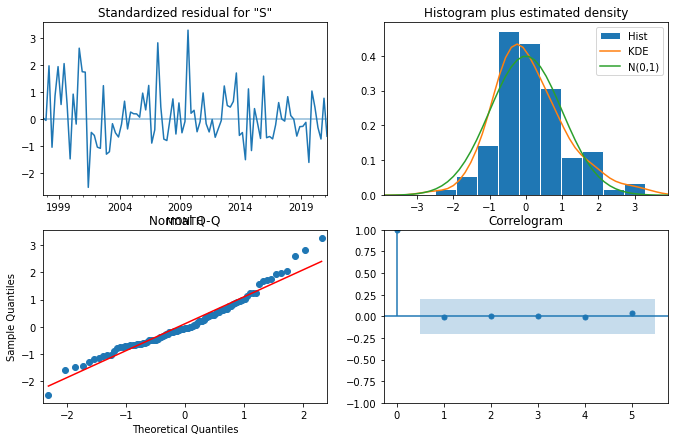

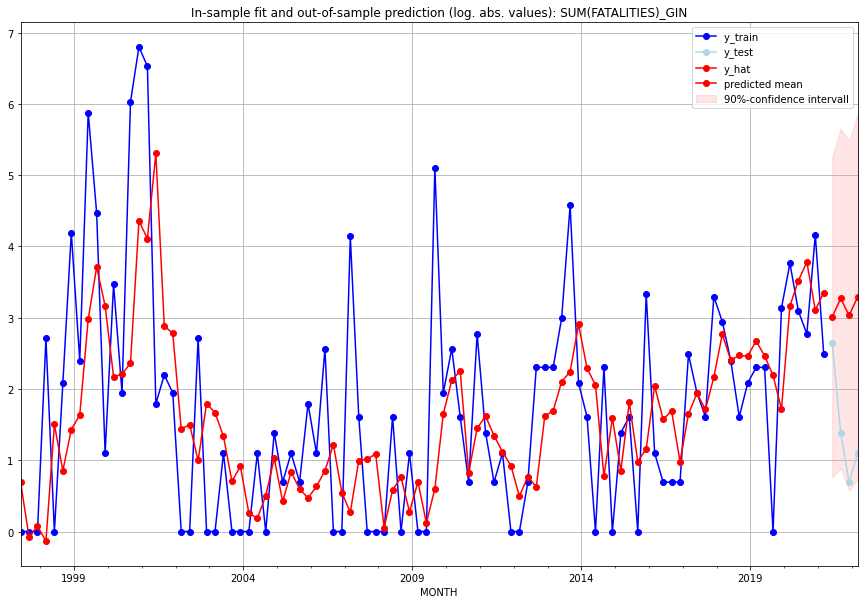

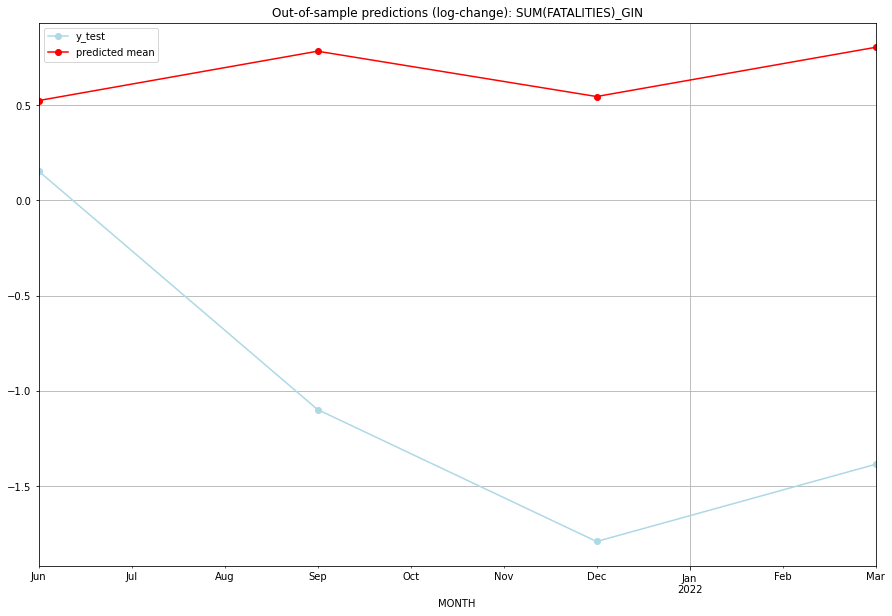

TADDA: 2.228631498959967
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  19.274015        13.0      0.524433        0.154151   GIN   
1 2021-07-01  25.276891         3.0      0.783783       -1.098612   GIN   
2 2021-10-01  19.710631         1.0      0.545741       -1.791759   GIN   
3 2022-01-01  25.820633         2.0      0.804265       -1.386294   GIN   

                                          PARAMETERS  
0  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## GLP (82/234) #########
0
Neighbor countries: []
Getting Data for GLP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV ne

<Figure size 432x288 with 0 Axes>

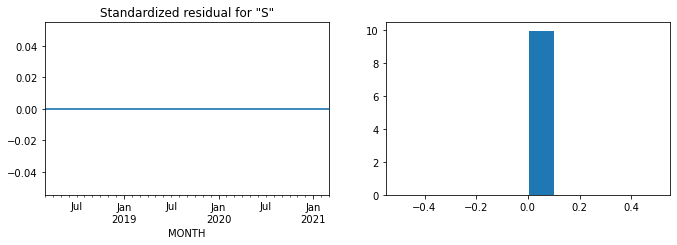

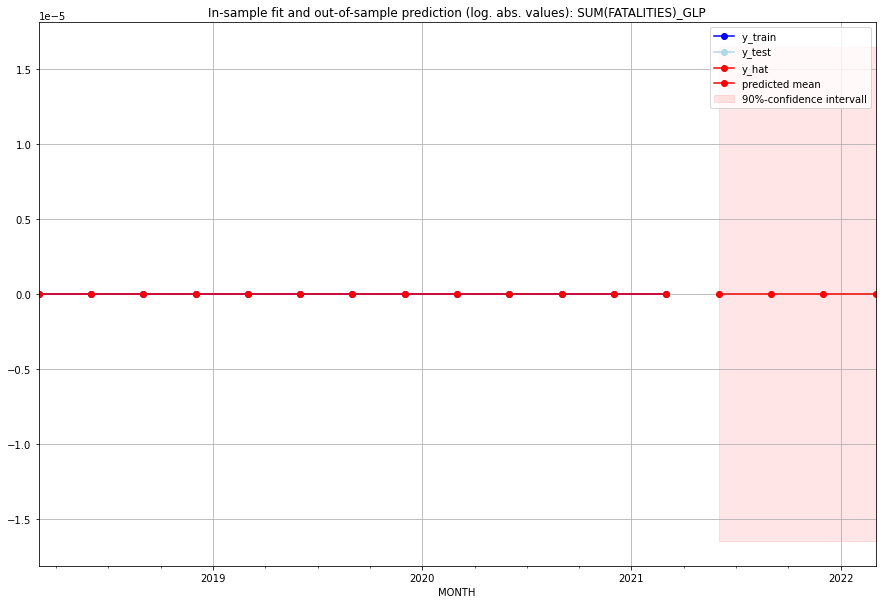

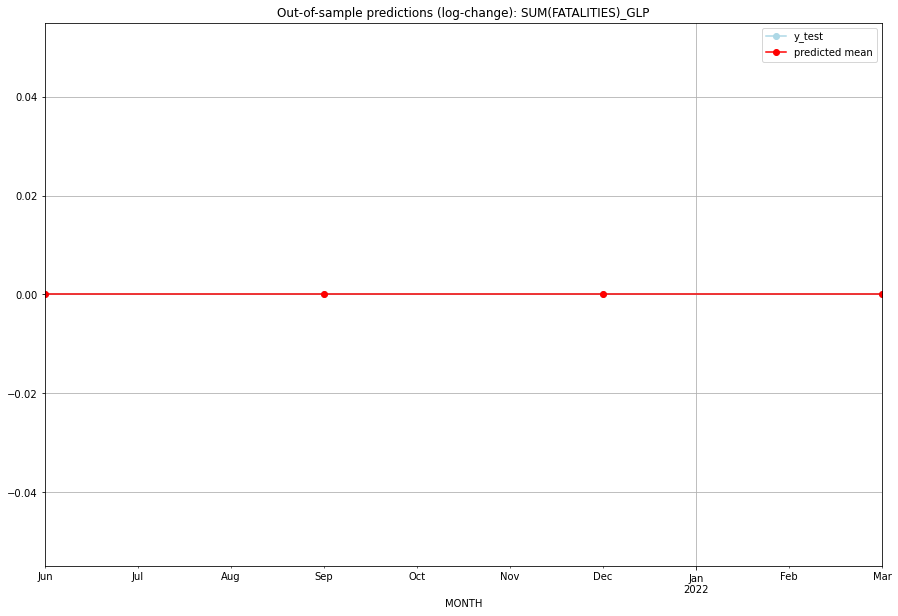

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GLP   
1 2021-07-01       0.0         0.0           0.0             0.0   GLP   
2 2021-10-01       0.0         0.0           0.0             0.0   GLP   
3 2022-01-01       0.0         0.0           0.0             0.0   GLP   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:03
######## GMB (83/234) #########
0
Neighbor countries: ['SEN']
Getting Data for GMB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 69)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.43943800703874986, 'fold_results': [0.4029094733494411, 0.7626921793321142, 0.3562583400137333, 0.30697785207347783, 0.3683521904249826]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GMB   No. Observations:                   96
Model:                SARIMAX(0, 0, 3)   Log Likelihood                -116.615
Date:                 Wed, 19 Oct 2022   AIC                            241.230
Time:                         10:39:36   BIC                            251.488
Sample:                     04-30-1997   HQIC                           245.377
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

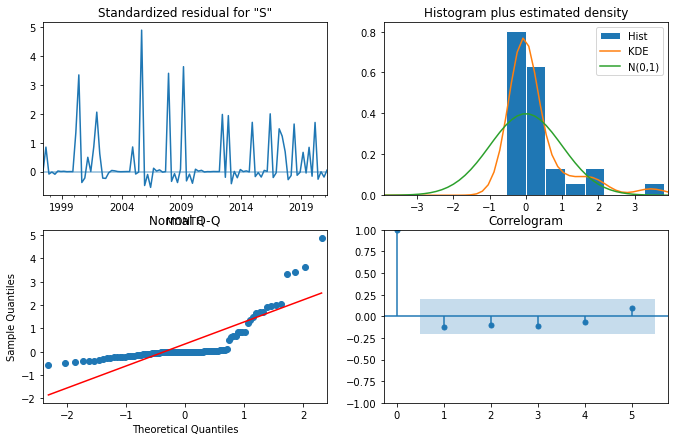

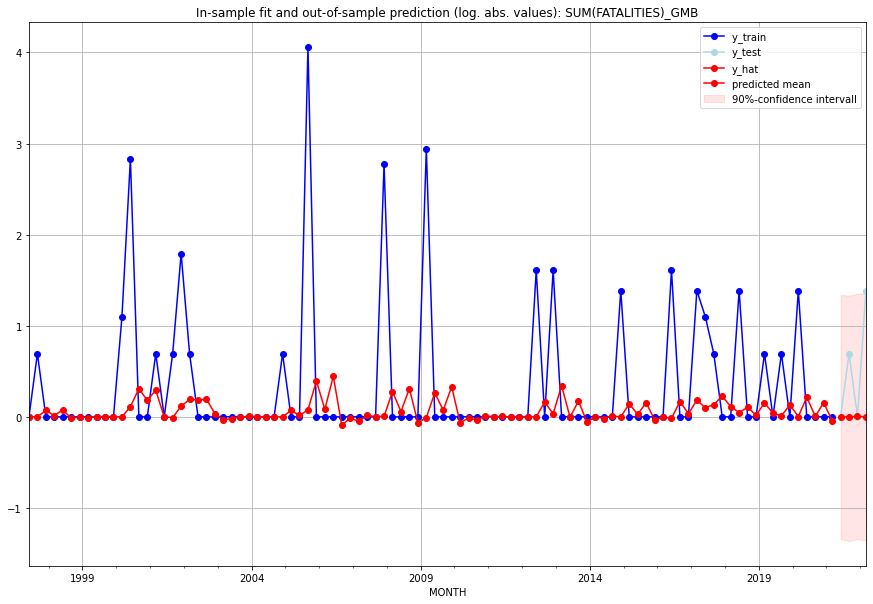

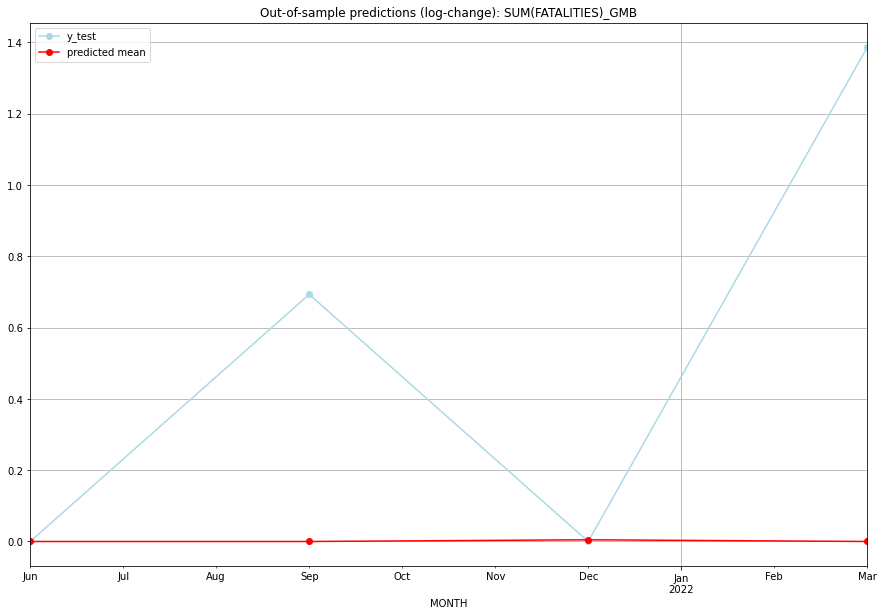

TADDA: 0.521057597646773
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01    0.0000         0.0      0.000000        0.000000   GMB   
1 2021-07-01    0.0000         1.0      0.000000        0.693147   GMB   
2 2021-10-01    0.0048         0.0      0.004789        0.000000   GMB   
3 2022-01-01    0.0000         3.0      0.000000        1.386294   GMB   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## GNB (84/234) #########
0
Neighbor countries: ['SEN', 'GIN']
Getting Data for GNB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 75)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV o

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14978661367769958, 'fold_results': [0.0, 0.0, 6.560425886295985e-142, 0.17328679513998632, 0.5756462732485115]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GNB   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -158.739
Date:                 Wed, 19 Oct 2022   AIC                            319.478
Time:                         10:39:57   BIC                            322.032
Sample:                     04-30-1997   HQIC                           320.510
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

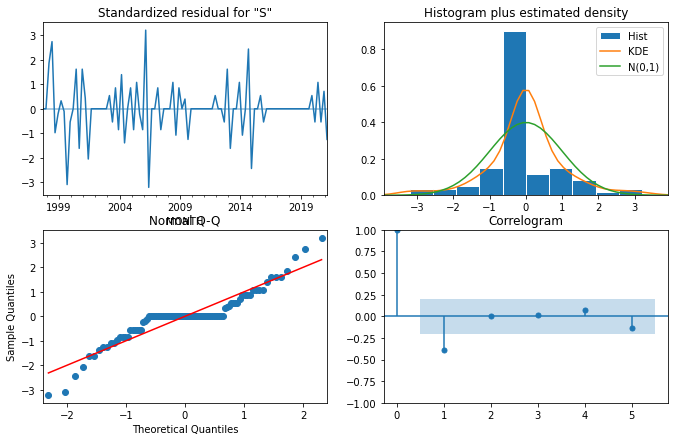

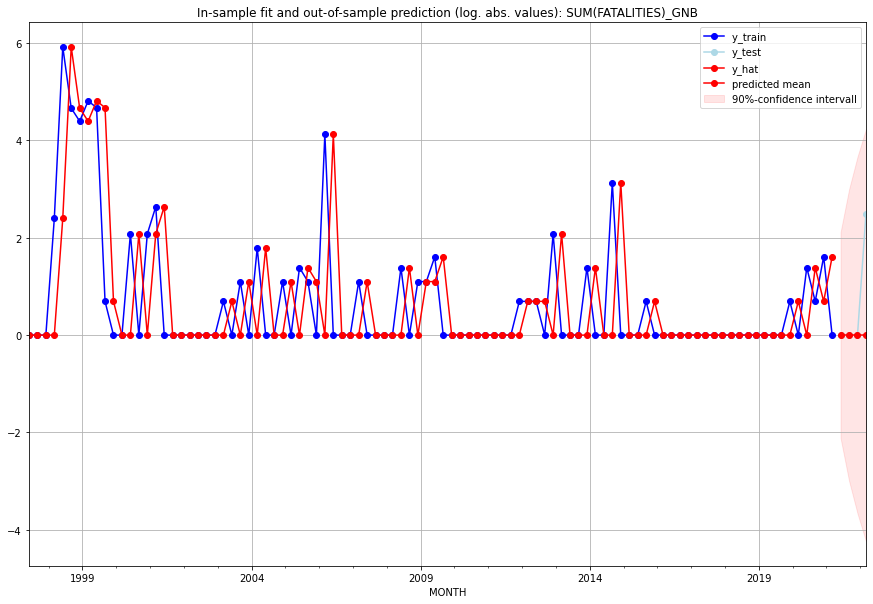

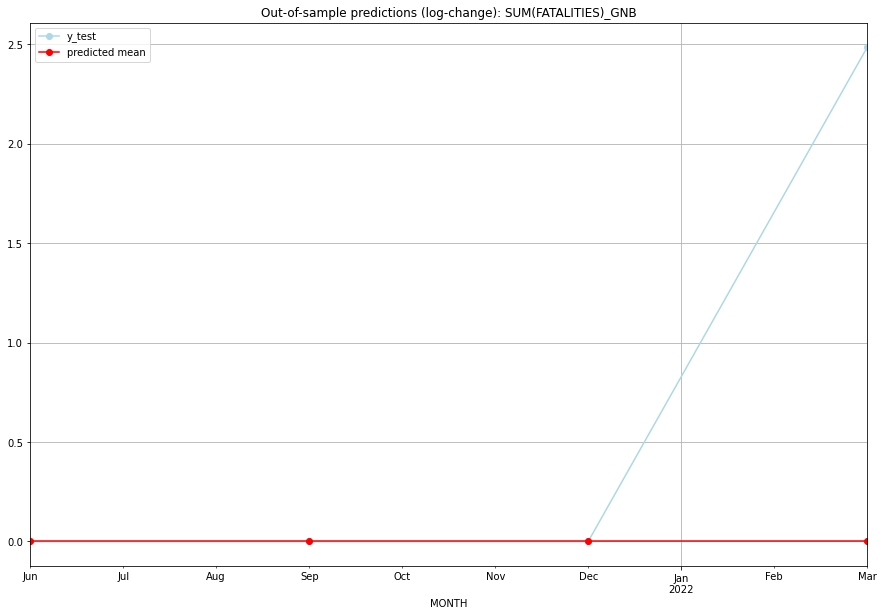

TADDA: 0.6212266624470001
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   GNB   
1 2021-07-01       0.0         0.0           0.0        0.000000   GNB   
2 2021-10-01       0.0         0.0           0.0        0.000000   GNB   
3 2022-01-01       0.0        11.0           0.0        2.484907   GNB   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## GNQ (85/234) #########
0
Neighbor countries: ['CMR', 'GAB']
Getting Data for GNQ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 69)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.2138333059508028, 'fold_results': [0.0, 0.7225929394740412, 0.17328679513998646, 0.17328679513998632, 1.3684555315672042e-48]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GNQ   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -94.726
Date:                 Wed, 19 Oct 2022   AIC                            191.452
Time:                         10:40:19   BIC                            194.006
Sample:                     04-30-1997   HQIC                           192.484
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------

<Figure size 432x288 with 0 Axes>

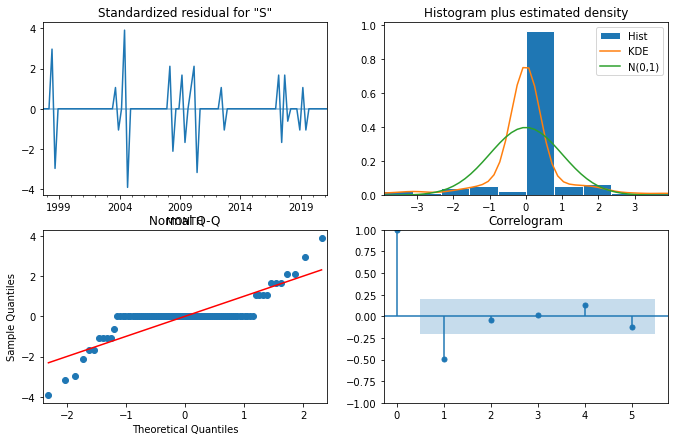

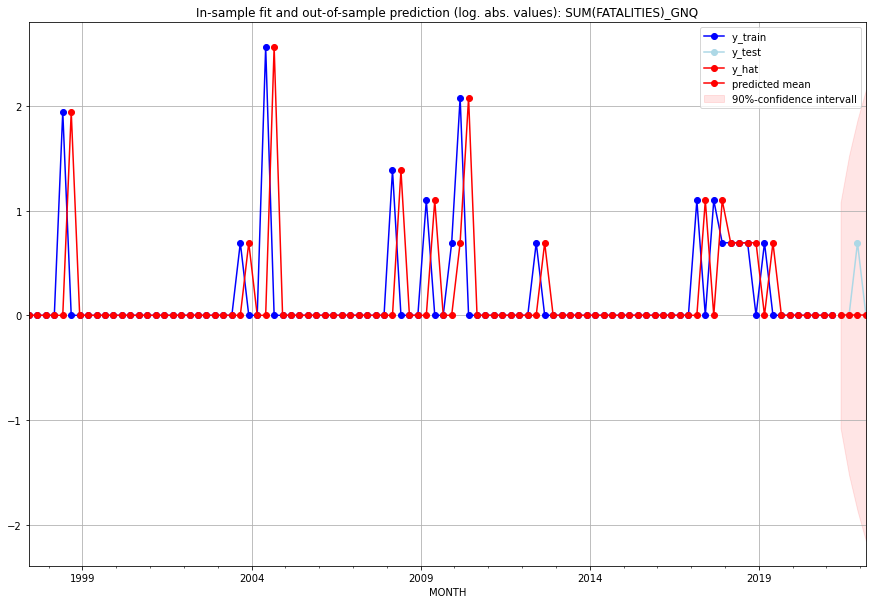

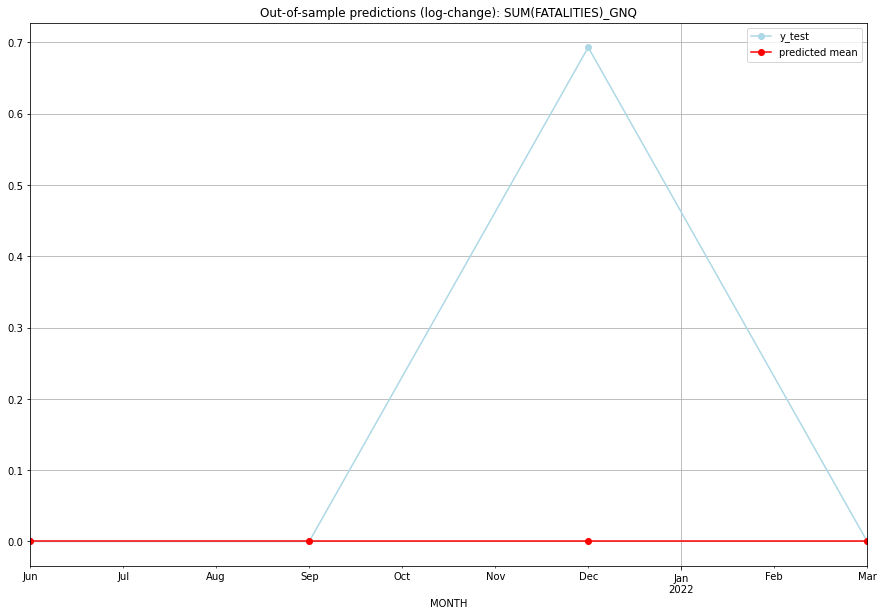

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   GNQ   
1 2021-07-01       0.0         0.0           0.0        0.000000   GNQ   
2 2021-10-01       0.0         1.0           0.0        0.693147   GNQ   
3 2022-01-01       0.0         0.0           0.0        0.000000   GNQ   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:25
######## GRC (86/234) #########
0
Neighbor countries: ['ALB', 'MKD', 'BGR', 'TUR']
Getting Data for GRC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 96)
y: (17, 1)
------------------------------------------------
Training started.
Start G

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4085376288938771, 'fold_results': [0.4697716692515167, 0.3473035885362375]}
Retraining model failed.
No model fitted --> Prediction with Naive Model 


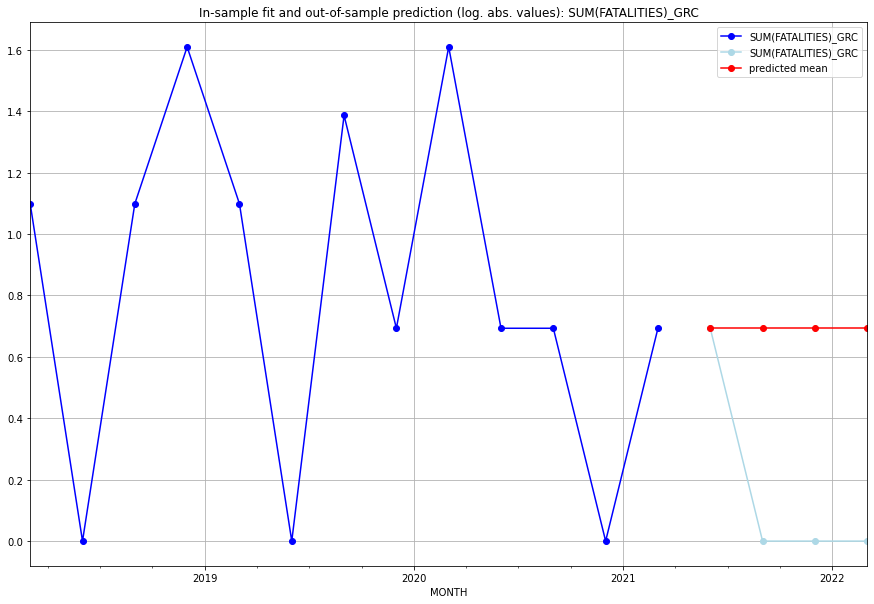

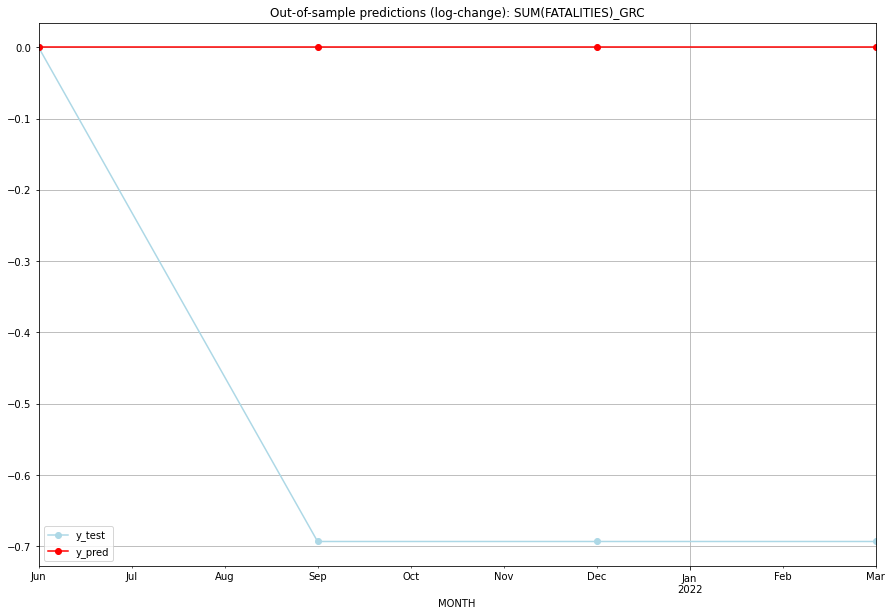

TADDA: 0.5198603854199589
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.693147    0.693147           0.0        0.000000   GRC   
1 2021-07-01  0.693147    0.000000           0.0       -0.693147   GRC   
2 2021-10-01  0.693147    0.000000           0.0       -0.693147   GRC   
3 2022-01-01  0.693147    0.000000           0.0       -0.693147   GRC   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:11
######## GRD (87/234) #########
0
Neighbor countries: []
Getting Data for GRD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 46)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GRD   No. Observations:             

<Figure size 432x288 with 0 Axes>

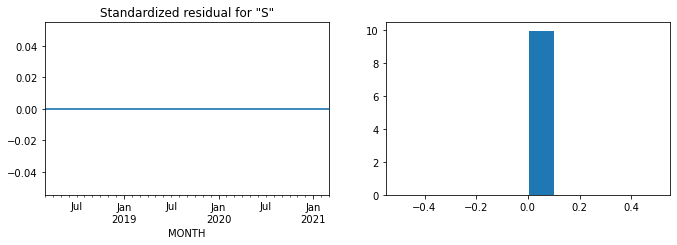

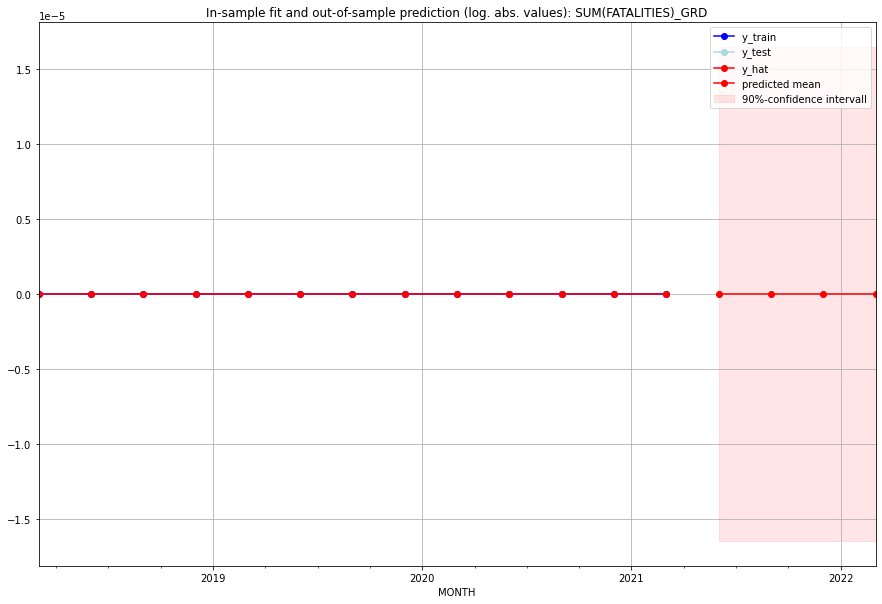

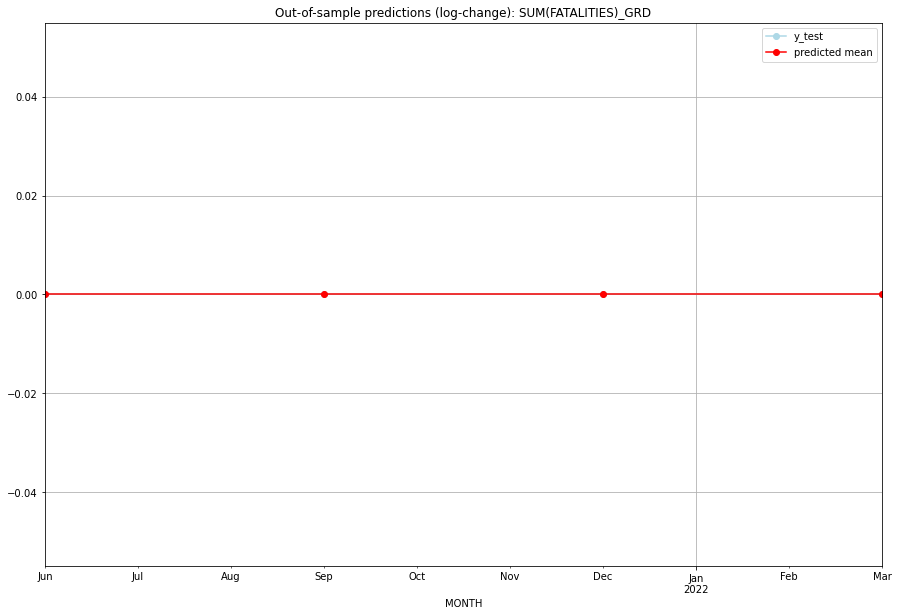

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GRD   
1 2021-07-01       0.0         0.0           0.0             0.0   GRD   
2 2021-10-01       0.0         0.0           0.0             0.0   GRD   
3 2022-01-01       0.0         0.0           0.0             0.0   GRD   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:08
######## GRL (88/234) #########
0
Neighbor countries: ['CAN']
Getting Data for GRL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 31)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


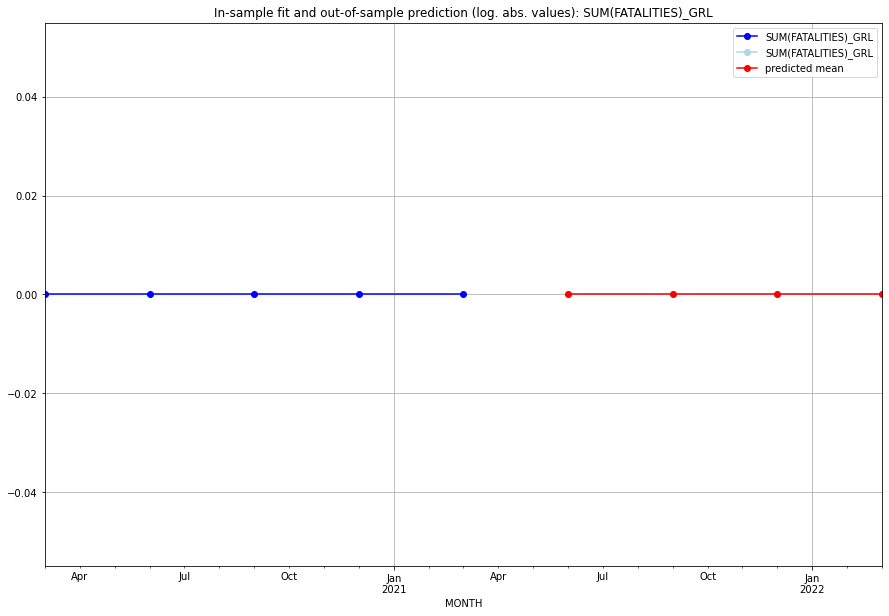

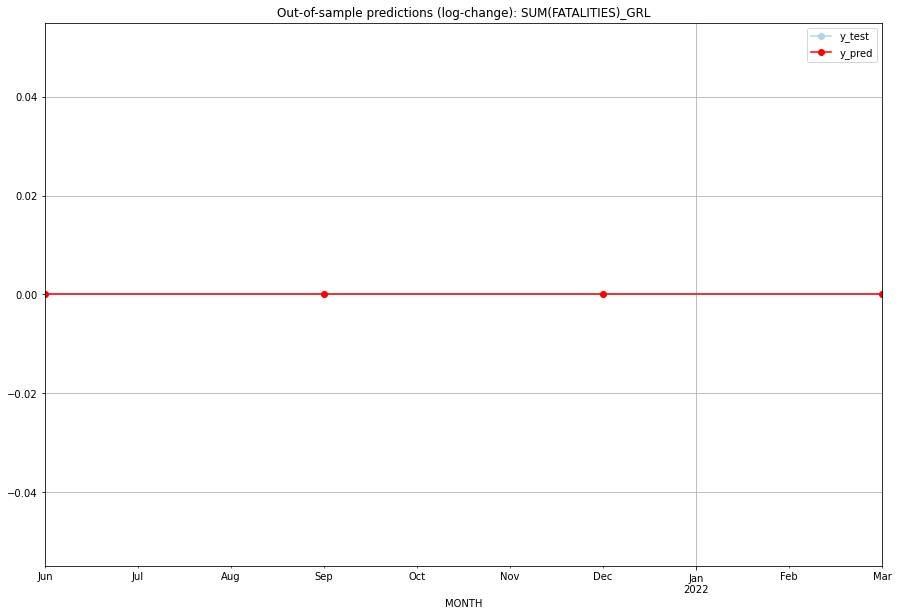

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GRL   
1 2021-07-01       0.0         0.0           0.0             0.0   GRL   
2 2021-10-01       0.0         0.0           0.0             0.0   GRL   
3 2022-01-01       0.0         0.0           0.0             0.0   GRL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## GTM (89/234) #########
0
Neighbor countries: ['SLV', 'BLZ', 'MEX', 'HND']
Getting Data for GTM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 94)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.34477306982983214, 'fold_results': [0.34477306982983214, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GTM   No. Observations:                   13
Model:                SARIMAX(2, 0, 2)   Log Likelihood                  -5.698
Date:                 Wed, 19 Oct 2022   AIC                             21.396
Time:                         10:40:50   BIC                             24.221
Sample:                     01-31-2018   HQIC                            20.816
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4766      0.174      8.48

<Figure size 432x288 with 0 Axes>

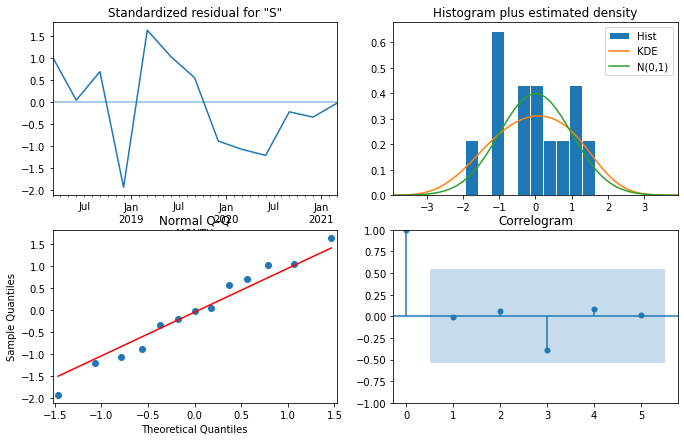

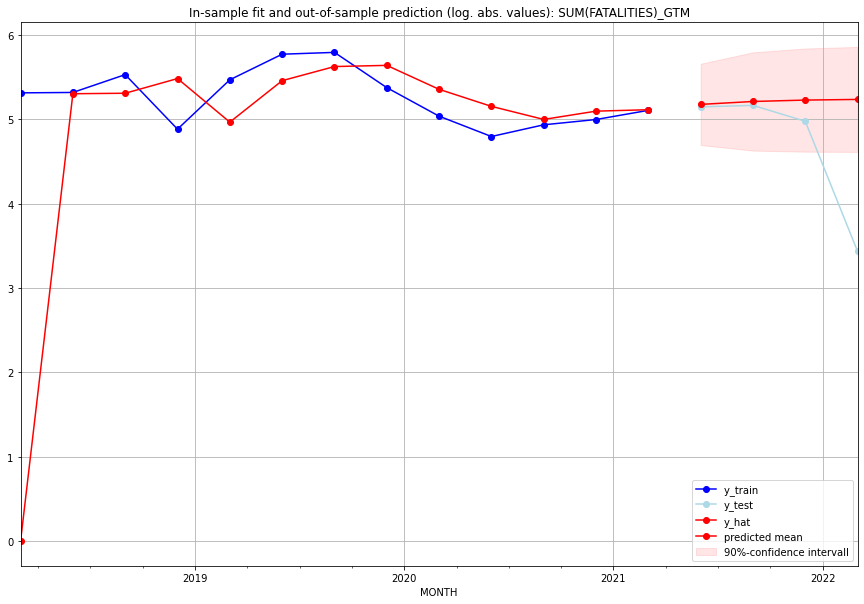

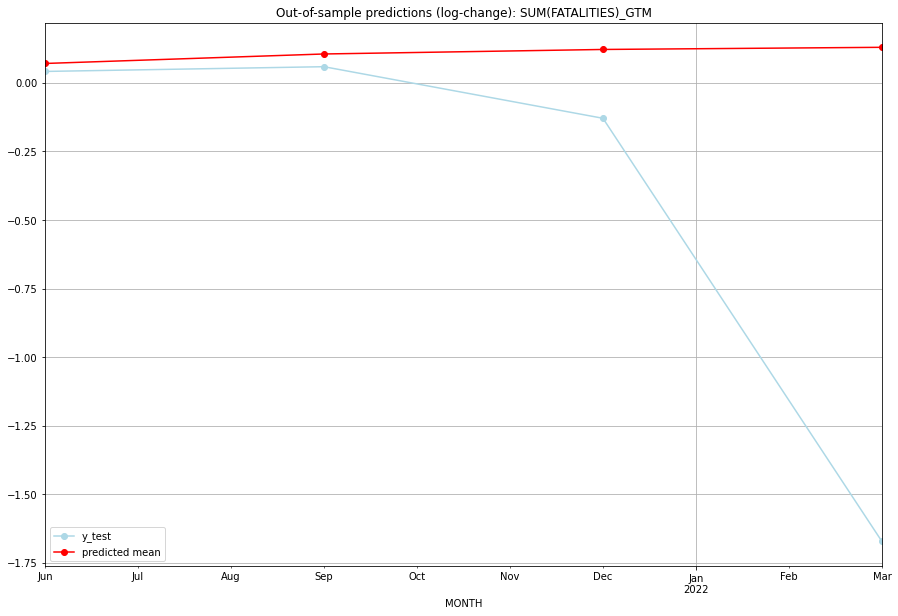

TADDA: 0.5947539865184099
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  176.070251       171.0      0.070601        0.041549   GTM   
1 2021-07-01  182.305079       174.0      0.105206        0.058841   GTM   
2 2021-10-01  185.350923       144.0      0.121686       -0.129212   GTM   
3 2022-01-01  186.817990        30.0      0.129528       -1.671958   GTM   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## GUF (90/234) #########
0
Neighbor countries: ['BRA', 'SUR']
Getting Data for GUF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 16)
y: (17, 1)
------------------------------------------------
Training started.
y_train is a

<Figure size 432x288 with 0 Axes>

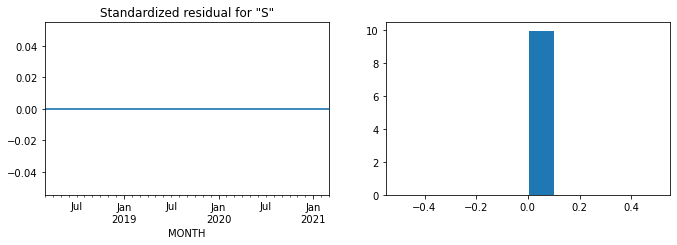

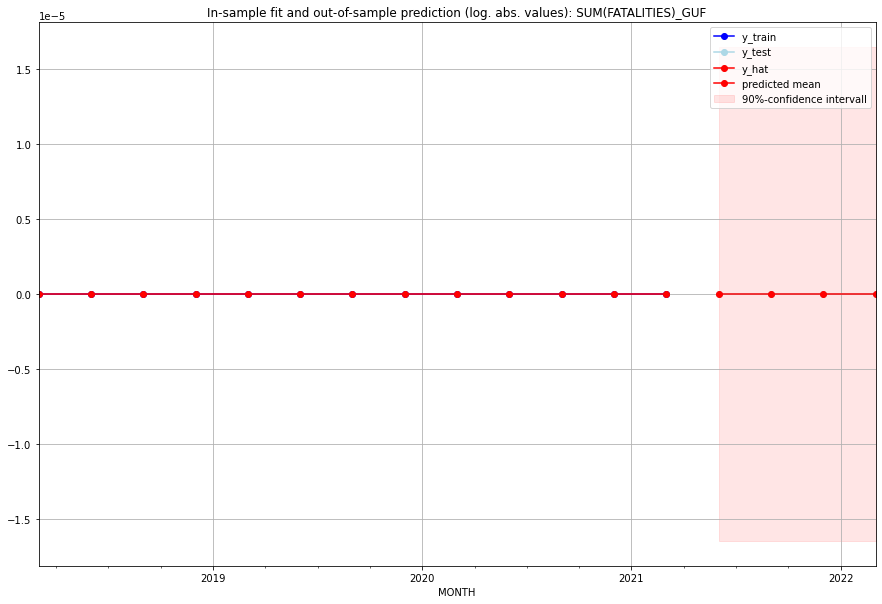

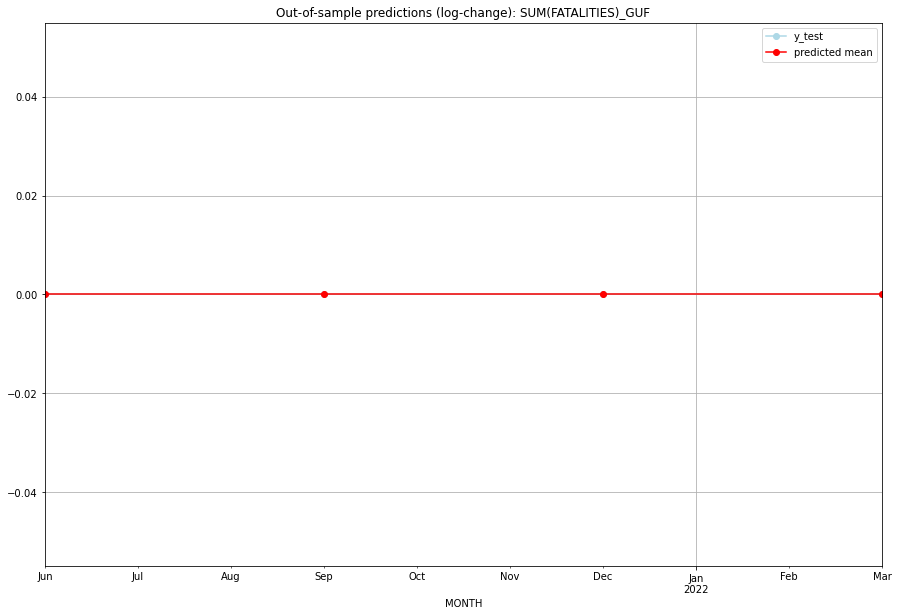

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GUF   
1 2021-07-01       0.0         0.0           0.0             0.0   GUF   
2 2021-10-01       0.0         0.0           0.0             0.0   GUF   
3 2022-01-01       0.0         0.0           0.0             0.0   GUF   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:06
######## GUM (91/234) #########
0
Neighbor countries: []
Getting Data for GUM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 24)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


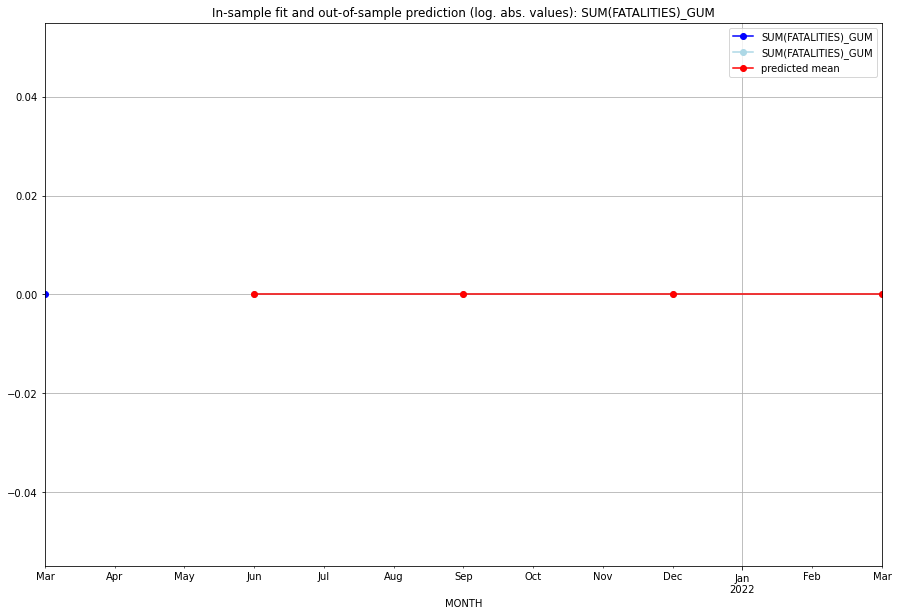

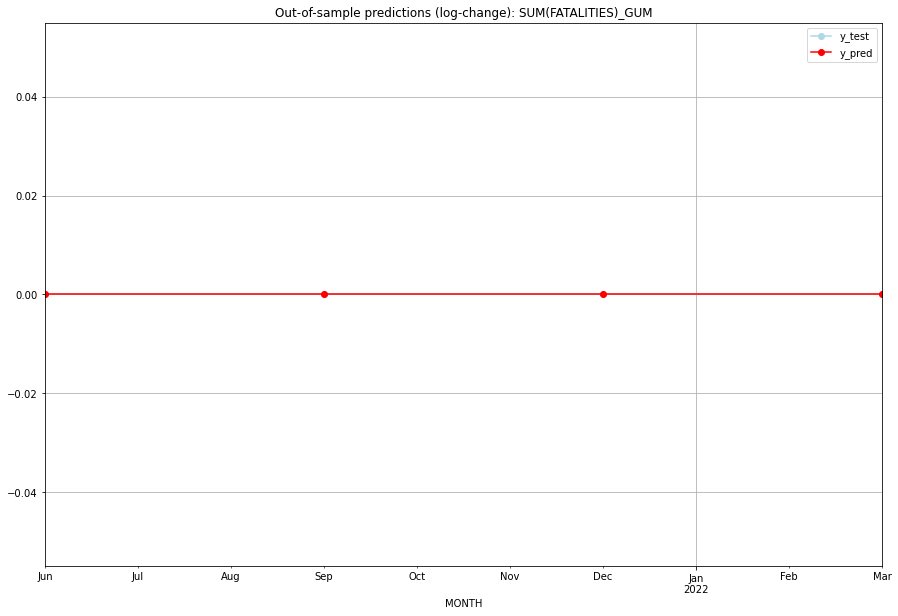

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GUM   
1 2021-07-01       0.0         0.0           0.0             0.0   GUM   
2 2021-10-01       0.0         0.0           0.0             0.0   GUM   
3 2022-01-01       0.0         0.0           0.0             0.0   GUM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:05
######## GUY (92/234) #########
0
Neighbor countries: ['BRA', 'VEN', 'SUR']
Getting Data for GUY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 83)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3014021654790774, 'fold_results': [0.2417224544262846, 0.36108187653187024]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GUY   No. Observations:                   13
Model:                SARIMAX(2, 0, 0)   Log Likelihood                  -9.823
Date:                 Wed, 19 Oct 2022   AIC                             29.645
Time:                         10:41:14   BIC                             32.470
Sample:                     01-31-2018   HQIC                            29.064
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0144      0

<Figure size 432x288 with 0 Axes>

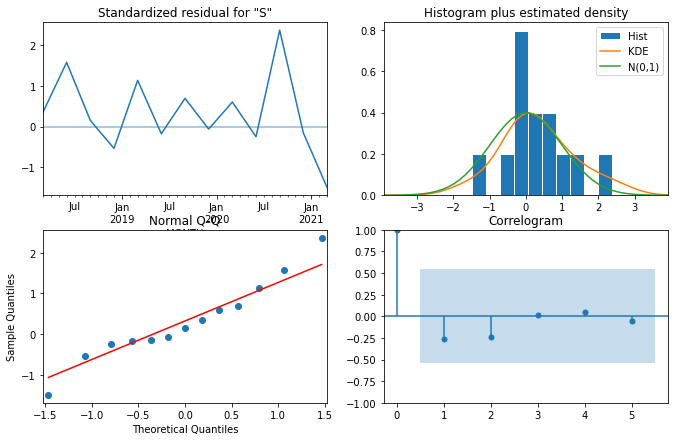

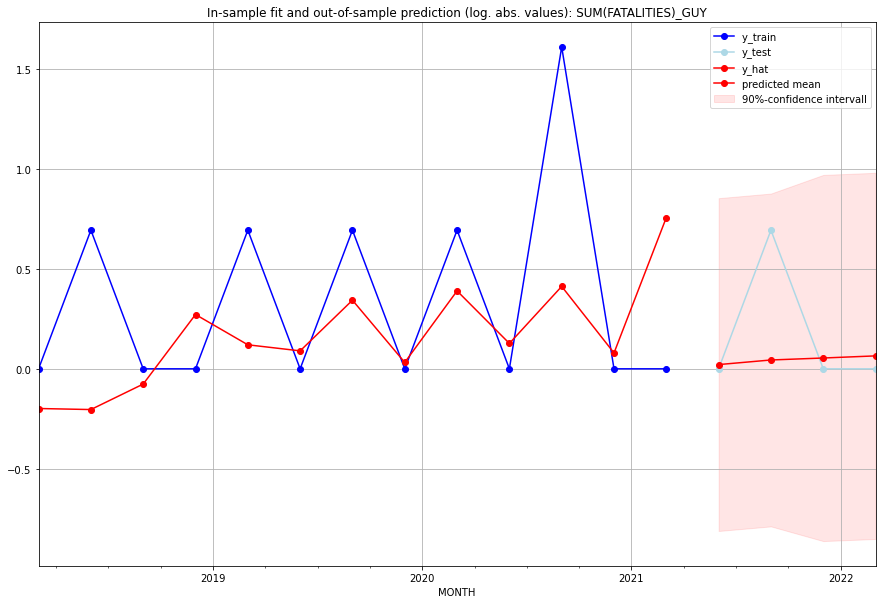

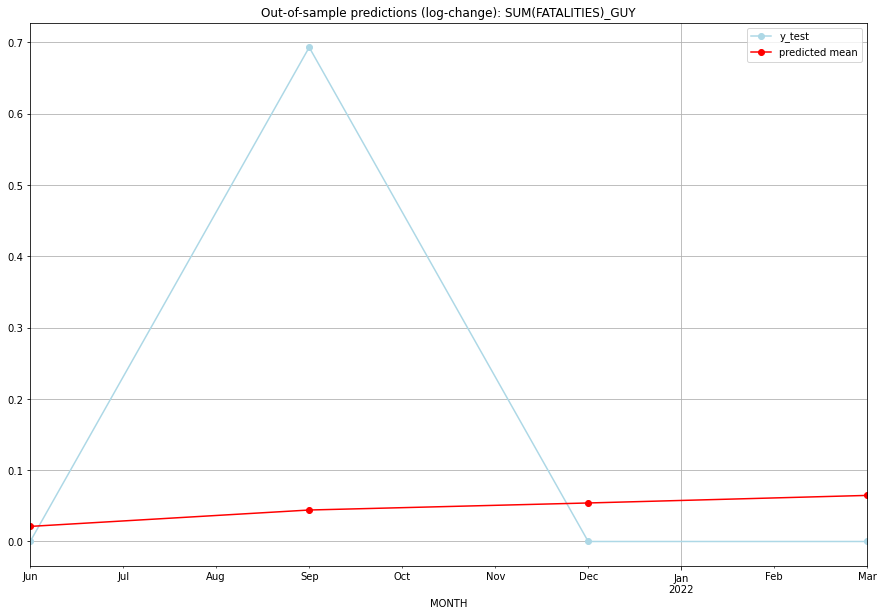

TADDA: 0.1972052784558128
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.021388         0.0      0.021162        0.000000   GUY   
1 2021-07-01  0.045138         1.0      0.044149        0.693147   GUY   
2 2021-10-01  0.055510         0.0      0.054024        0.000000   GUY   
3 2022-01-01  0.066772         0.0      0.064637        0.000000   GUY   

                                          PARAMETERS  
0  {'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## HKG (93/234) #########
0
Neighbor countries: ['CHN']
Getting Data for HKG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 60)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08664339756999316, 'fold_results': [0.17328679513998632, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HKG   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:41:27   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.24

<Figure size 432x288 with 0 Axes>

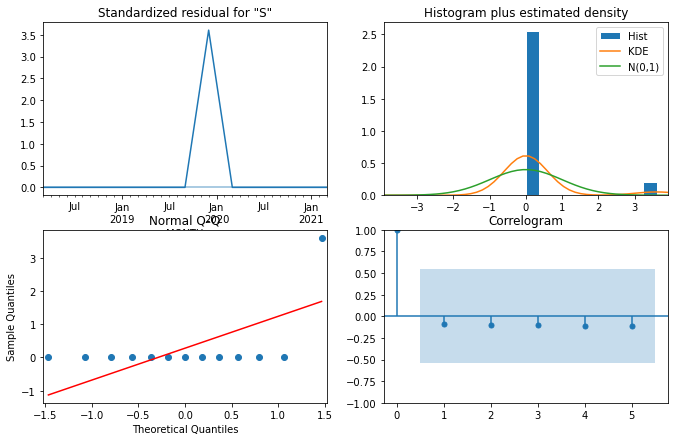

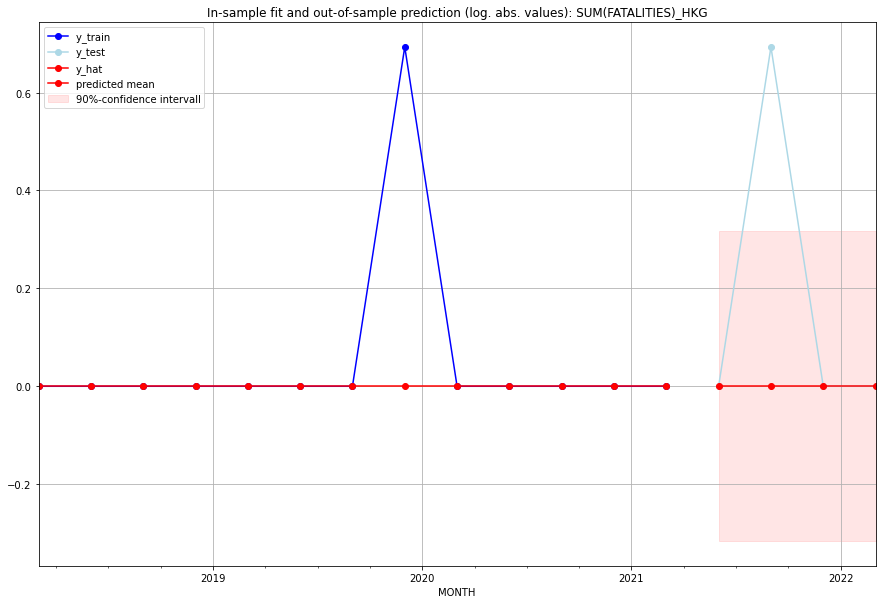

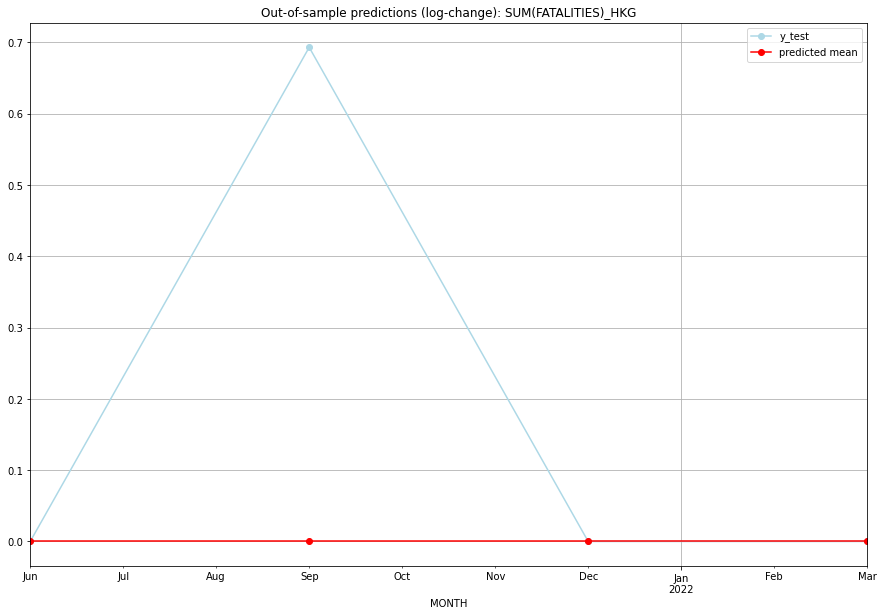

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   HKG   
1 2021-07-01       0.0         1.0           0.0        0.693147   HKG   
2 2021-10-01       0.0         0.0           0.0        0.000000   HKG   
3 2022-01-01       0.0         0.0           0.0        0.000000   HKG   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## HND (94/234) #########
0
Neighbor countries: ['SLV', 'GTM', 'NIC']
Getting Data for HND
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 86)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEAR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.43276539405498604, 'fold_results': [0.43276539405498604, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HND   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                  -6.948
Date:                 Wed, 19 Oct 2022   AIC                             29.896
Time:                         10:41:42   BIC                             34.416
Sample:                     01-31-2018   HQIC                            28.967
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0597      0.238     -0.25

<Figure size 432x288 with 0 Axes>

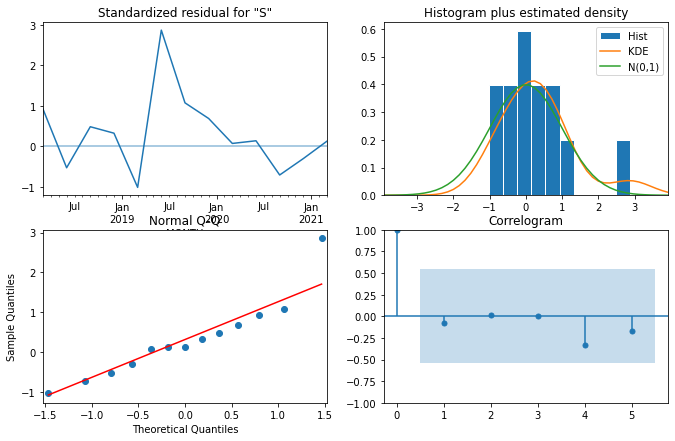

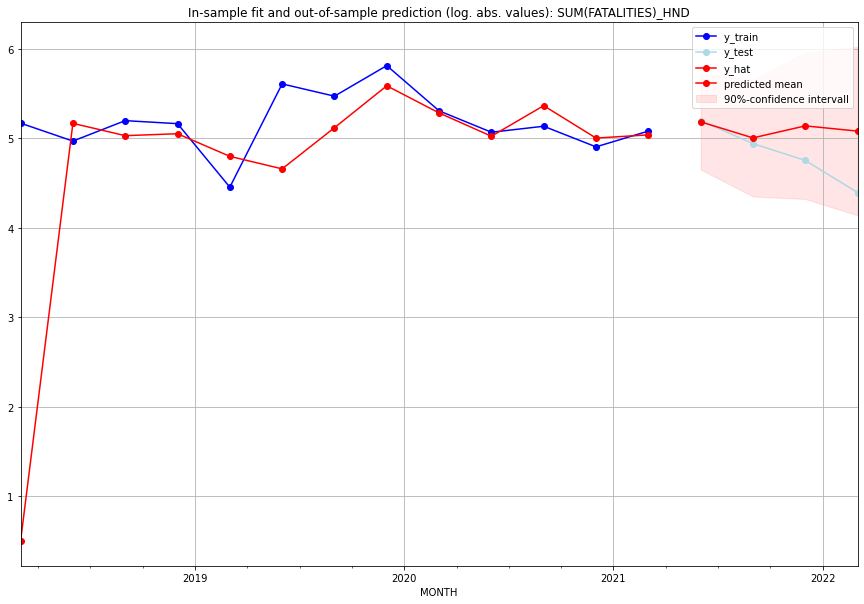

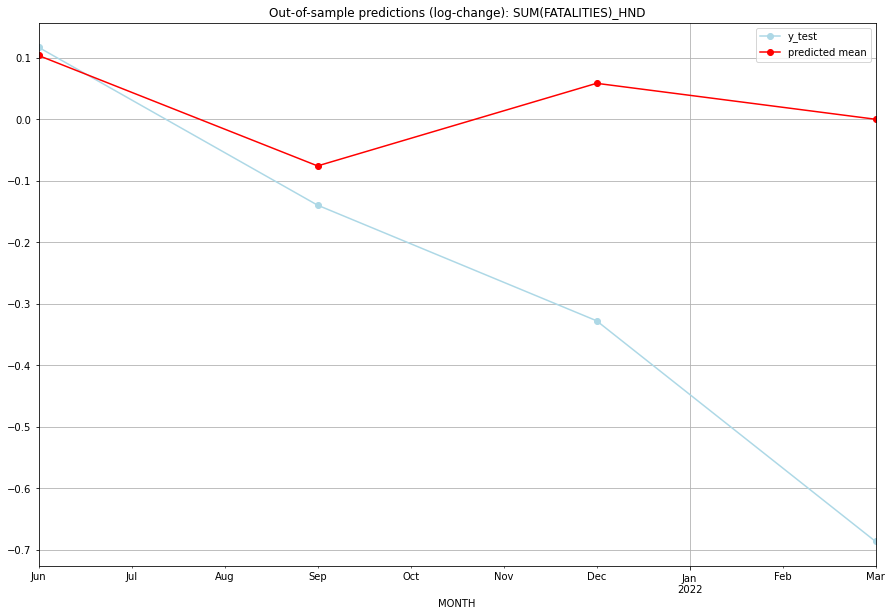

TADDA: 0.3022685317421894
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  177.604331       180.0      0.103769        0.117093   HND   
1 2021-07-01  148.235503       139.0     -0.075879       -0.139762   HND   
2 2021-10-01  169.701731       115.0      0.058513       -0.327814   HND   
3 2022-01-01  160.005686        80.0      0.000035       -0.686955   HND   

                                          PARAMETERS  
0  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## HRV (95/234) #########
0
Neighbor countries: ['HUN', 'SVN', 'SRB', 'BIH', 'MNE']
Getting Data for HRV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 104)
y: (17, 1)
------------------------------------------------
Training

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.1732867951399863, 'fold_results': [0.3465735902799726, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HRV   No. Observations:                   13
Model:                SARIMAX(0, 0, 3)   Log Likelihood                  -1.713
Date:                 Wed, 19 Oct 2022   AIC                             15.426
Time:                         10:41:56   BIC                             18.816
Sample:                     01-31-2018   HQIC                            14.729
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0029      0.027      0.110 

<Figure size 432x288 with 0 Axes>

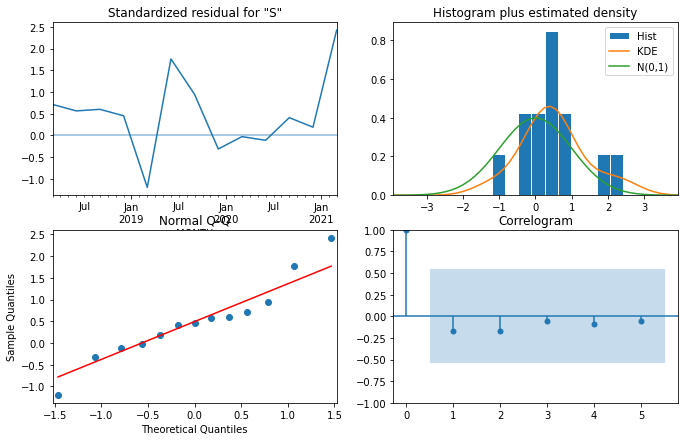

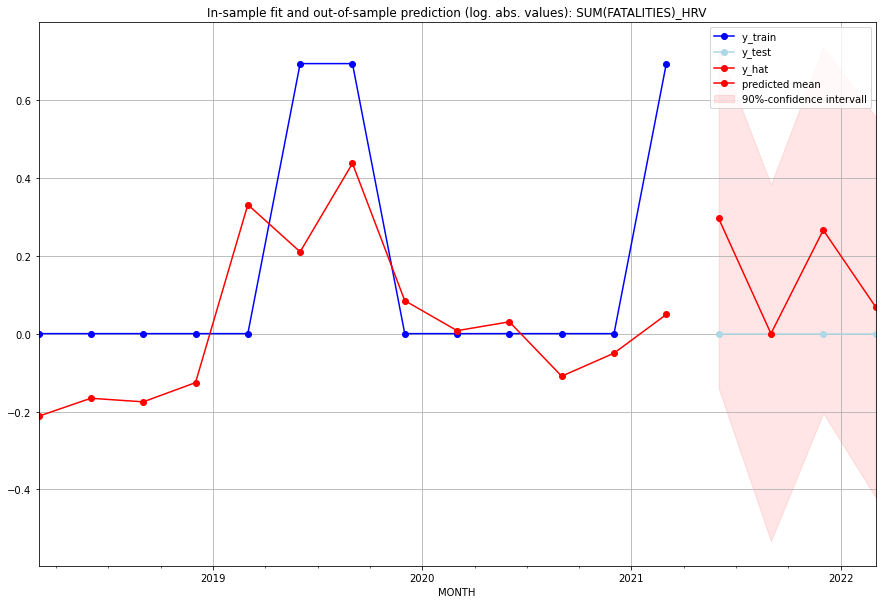

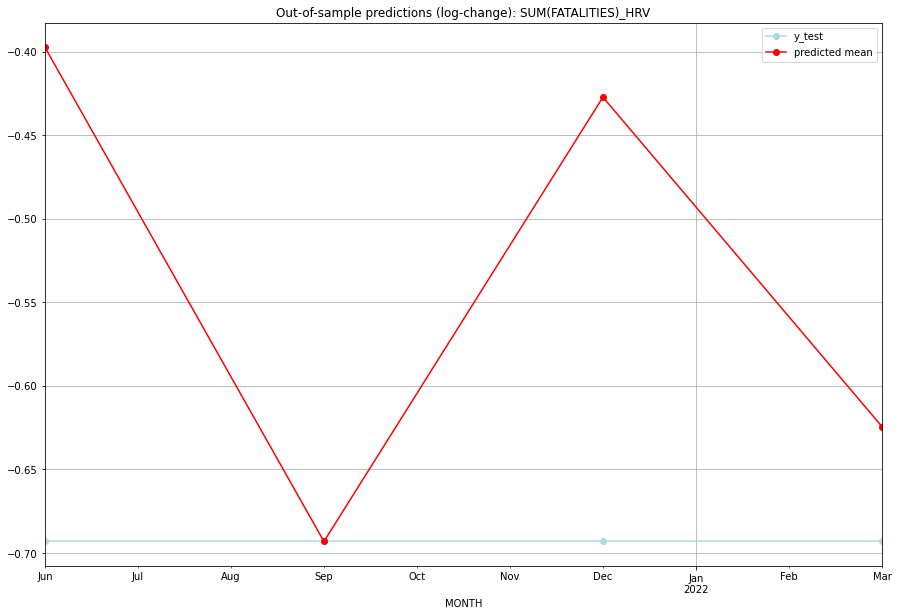

TADDA: 0.15761917846236884
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.344161         0.0     -0.397377       -0.693147   HRV   
1 2021-07-01  0.000000         0.0     -0.693147       -0.693147   HRV   
2 2021-10-01  0.304633         0.0     -0.427225       -0.693147   HRV   
3 2022-01-01  0.071206         0.0     -0.624363       -0.693147   HRV   

                                          PARAMETERS  
0  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## HTI (96/234) #########
0
Neighbor countries: ['DOM']
Getting Data for HTI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 65)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CP

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.23298021458811047, 'fold_results': [0.3078953130238131, 0.15806511615240781]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HTI   No. Observations:                   13
Model:                SARIMAX(0, 1, 2)   Log Likelihood                 -14.621
Date:                 Wed, 19 Oct 2022   AIC                             39.243
Time:                         10:42:10   BIC                             41.667
Sample:                     01-31-2018   HQIC                            38.345
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0982      

<Figure size 432x288 with 0 Axes>

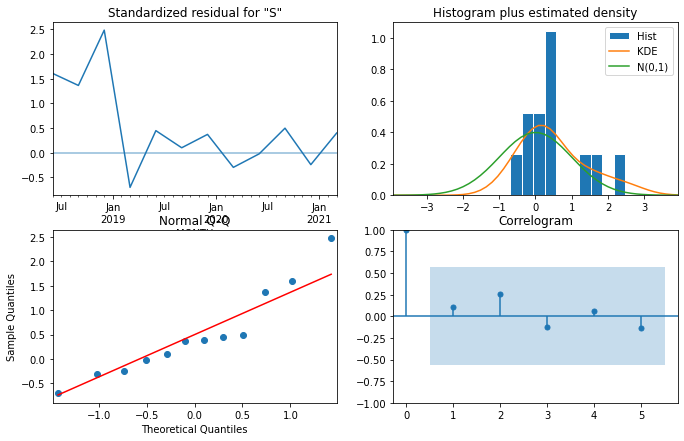

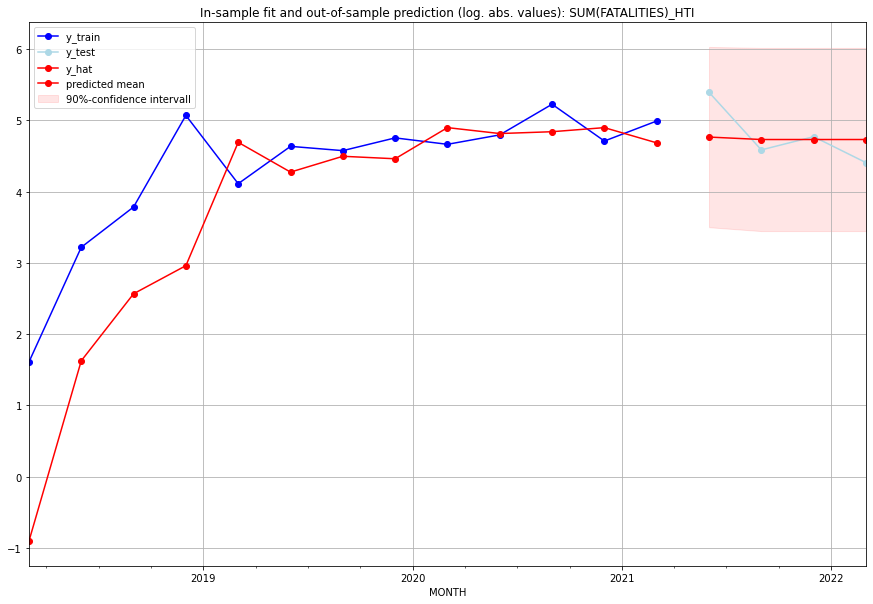

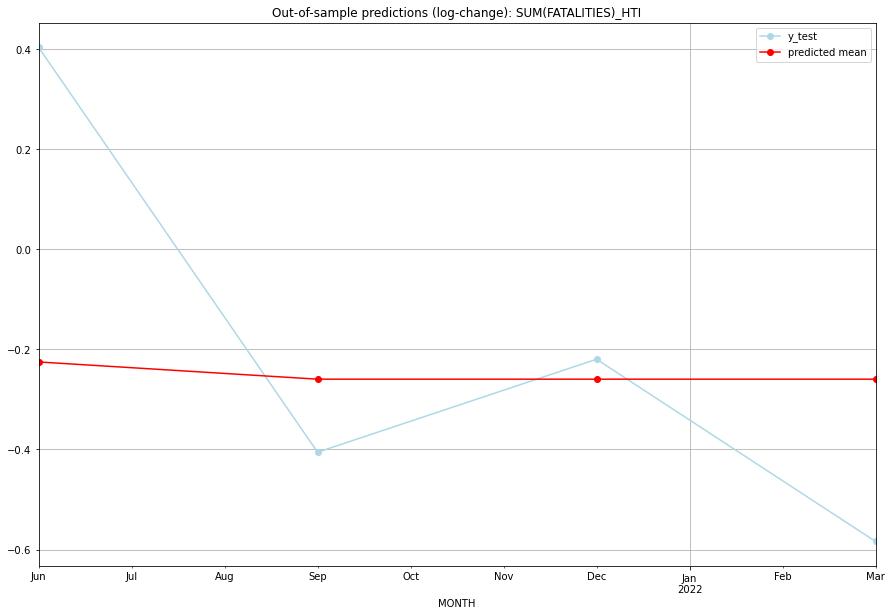

TADDA: 0.3408496116051489
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  116.362107       219.0     -0.225168        0.403195   HTI   
1 2021-07-01  112.394013        97.0     -0.259564       -0.405465   HTI   
2 2021-10-01  112.394013       117.0     -0.259564       -0.219748   HTI   
3 2022-01-01  112.394013        81.0     -0.259564       -0.583713   HTI   

                                          PARAMETERS  
0  {'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## HUN (97/234) #########
0
Neighbor countries: ['SVK', 'HRV', 'ROU', 'UKR', 'AUT', 'SVN', 'SRB']
Getting Data for HUN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 120)
y: (9, 1)
---------------------------------------------

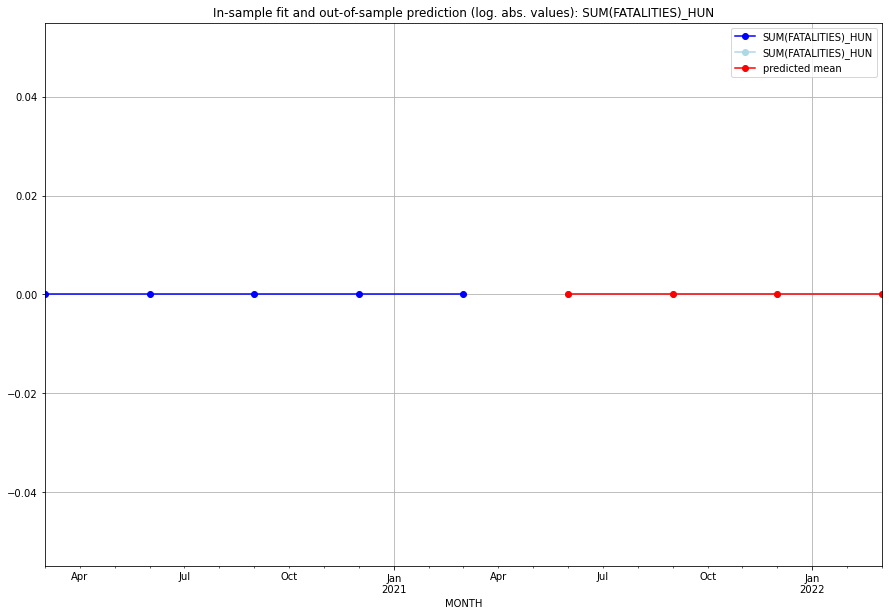

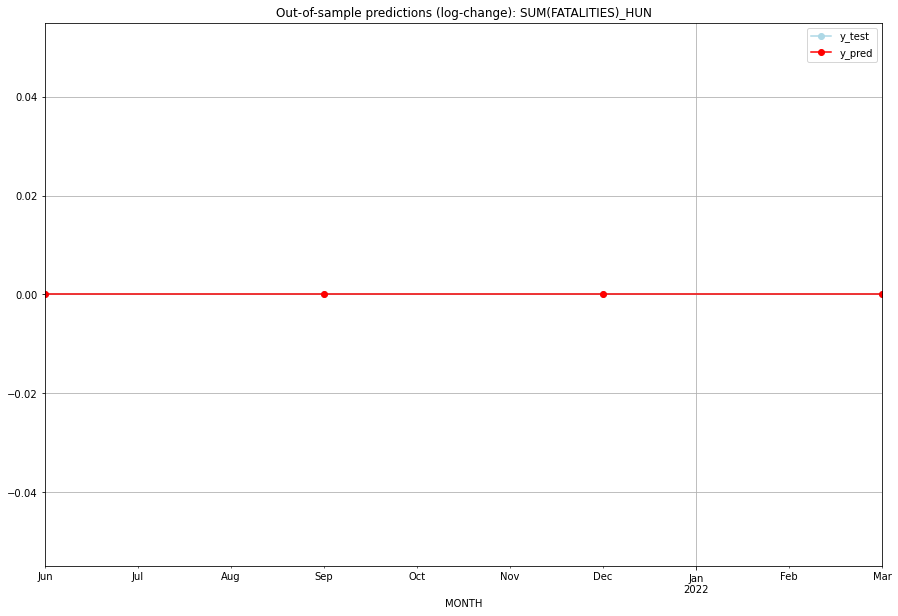

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   HUN   
1 2021-07-01       0.0         0.0           0.0             0.0   HUN   
2 2021-10-01       0.0         0.0           0.0             0.0   HUN   
3 2022-01-01       0.0         0.0           0.0             0.0   HUN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## IDN (98/234) #########
0
Neighbor countries: ['MYS', 'TLS', 'PNG']
Getting Data for IDN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (29, 88)
y: (29, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5856764719271577, 'fold_results': [0.633589088610092, 0.8896578468528773, nan, 0.5328713056044175, 0.28658764664124414]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IDN   No. Observations:                   25
Model:                SARIMAX(1, 0, 3)   Log Likelihood                 -23.548
Date:                 Wed, 19 Oct 2022   AIC                             63.095
Time:                         10:42:39   BIC                             72.846
Sample:                     01-31-2015   HQIC                            65.800
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

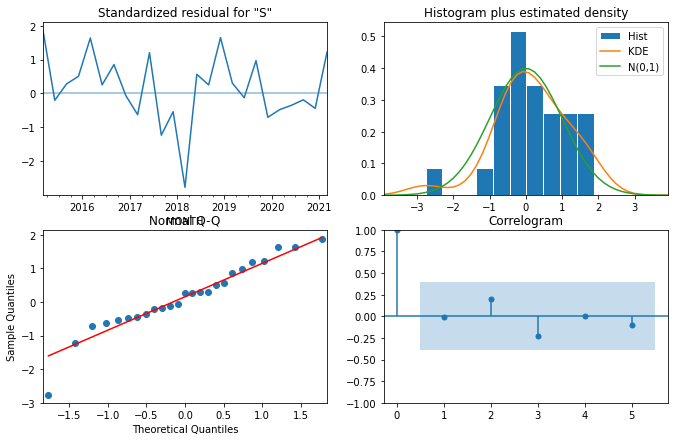

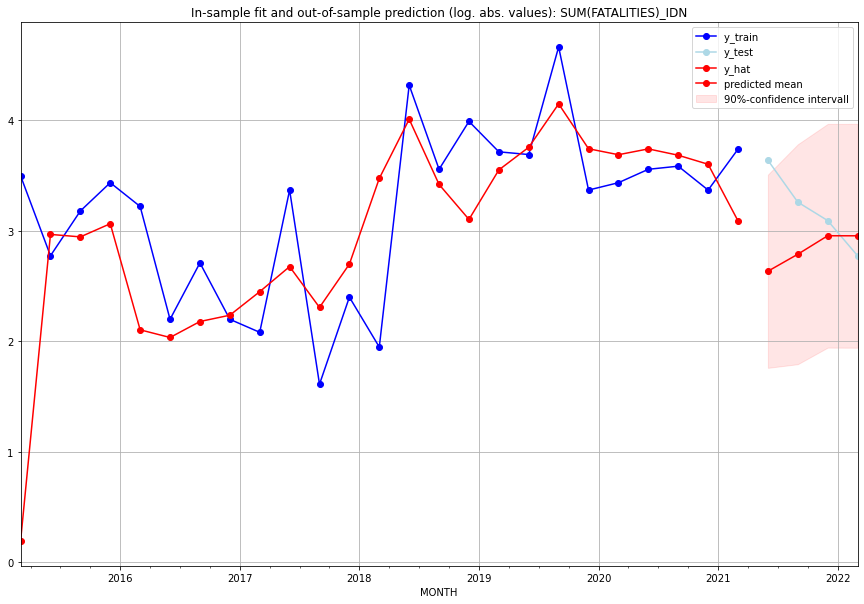

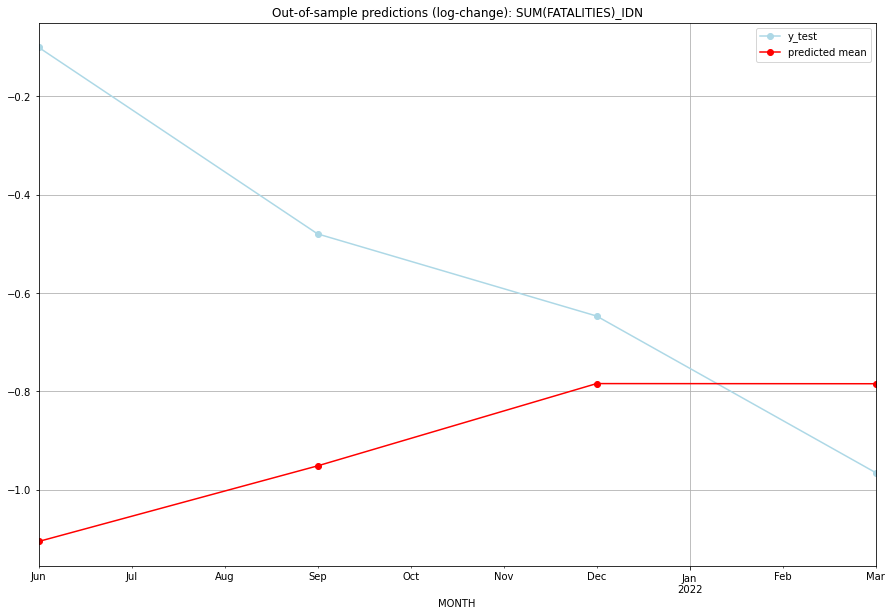

TADDA: 0.4487740930528603
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  12.908049        37.0     -1.105202       -0.100083   IDN   
1 2021-07-01  15.220372        25.0     -0.951402       -0.479573   IDN   
2 2021-10-01  18.175373        21.0     -0.784043       -0.646627   IDN   
3 2022-01-01  18.169538        15.0     -0.784347       -0.965081   IDN   

                                          PARAMETERS  
0  {'params': [3, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## IMN (99/234) #########
0
Neighbor countries: []
Getting Data for IMN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV

<Figure size 432x288 with 0 Axes>

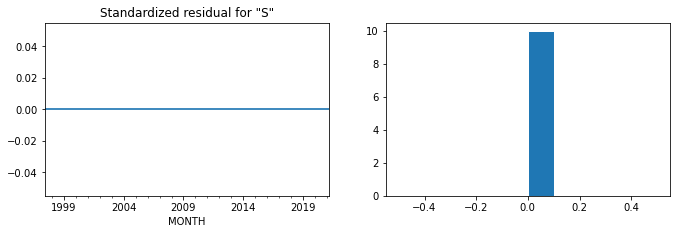

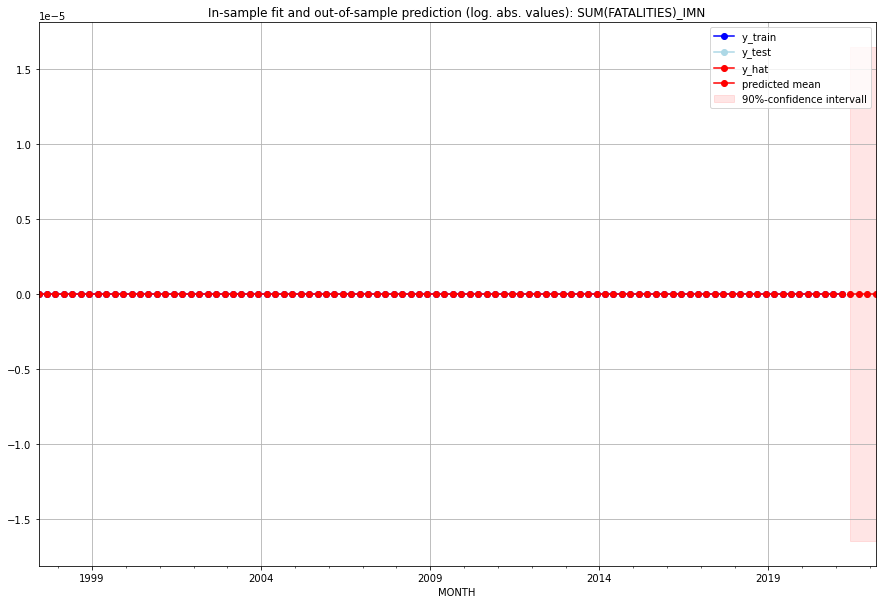

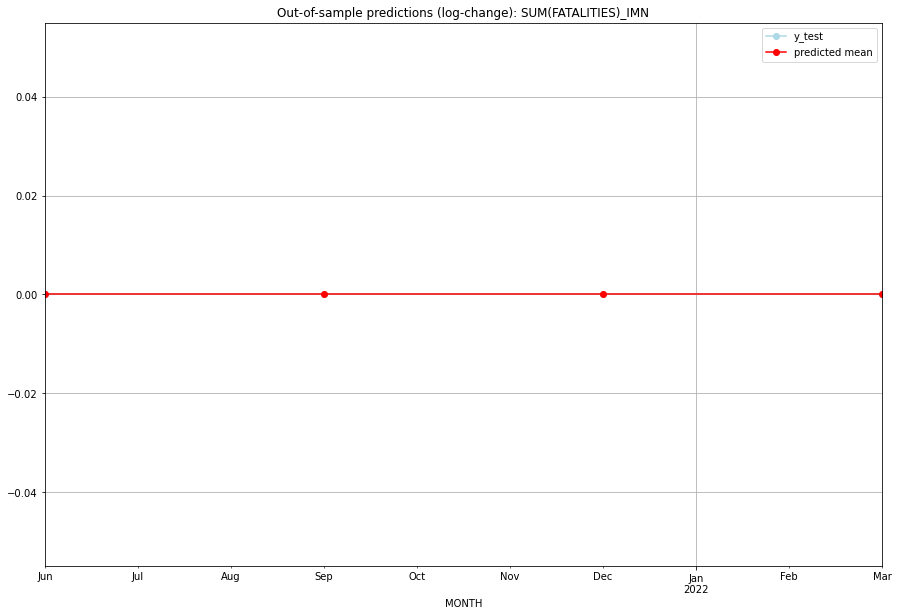

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   IMN   
1 2021-07-01       0.0         0.0           0.0             0.0   IMN   
2 2021-10-01       0.0         0.0           0.0             0.0   IMN   
3 2022-01-01       0.0         0.0           0.0             0.0   IMN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:01
######## IND (100/234) #########
0
Neighbor countries: ['PAK', 'CHN', 'MMR', 'BGD', 'BTN', 'NPL', 'LKA']
Getting Data for IND
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 118)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.1936139393065046, 'fold_results': [0.2654893484228231, 0.19675633476007137, nan, 0.11859613473661934]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IND   No. Observations:                   21
Model:                SARIMAX(3, 1, 3)   Log Likelihood                   2.127
Date:                 Wed, 19 Oct 2022   AIC                             15.745
Time:                         10:42:59   BIC                             25.703
Sample:                     01-31-2016   HQIC                            17.689
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1

<Figure size 432x288 with 0 Axes>

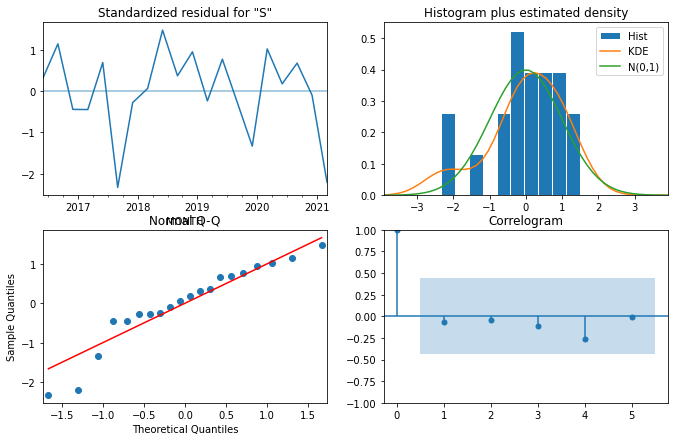

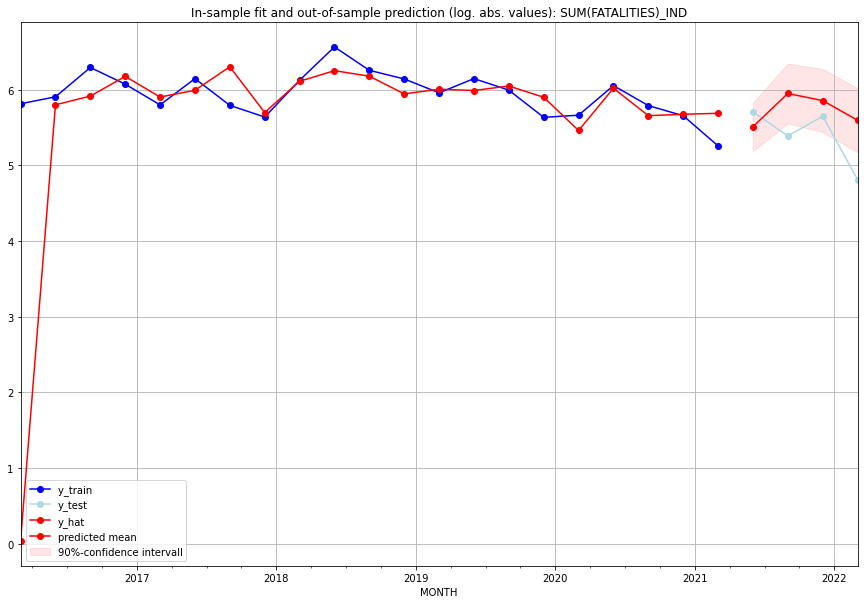

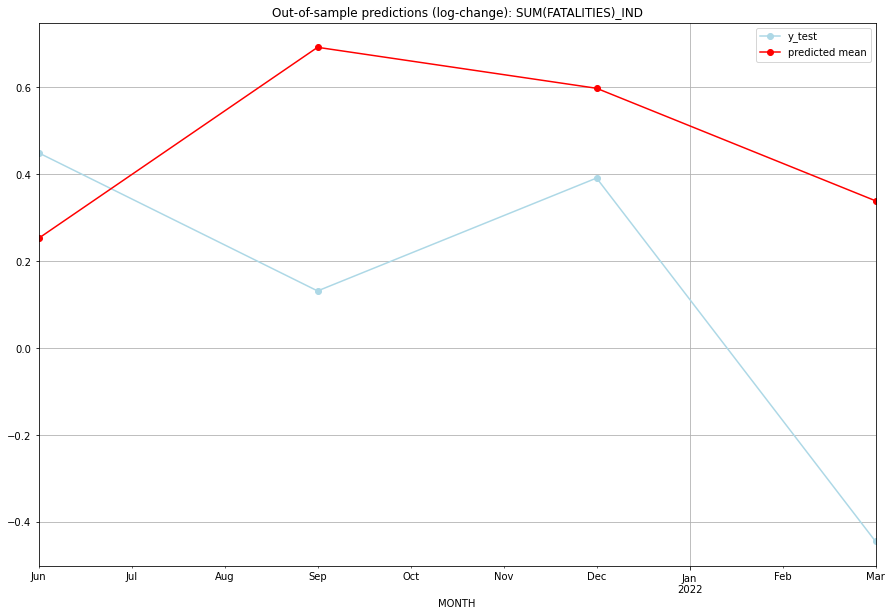

TADDA: 0.5220045093596111
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  246.198936       300.0      0.252698        0.449615   IND   
1 2021-07-01  382.755636       218.0      0.692511        0.131576   IND   
2 2021-10-01  348.209661       283.0      0.598177        0.391479   IND   
3 2022-01-01  268.501568       122.0      0.339079       -0.445311   IND   

                                          PARAMETERS  
0  {'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:26
######## IRL (101/234) #########
0
Neighbor countries: ['GBR']
Getting Data for IRL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 73)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed.

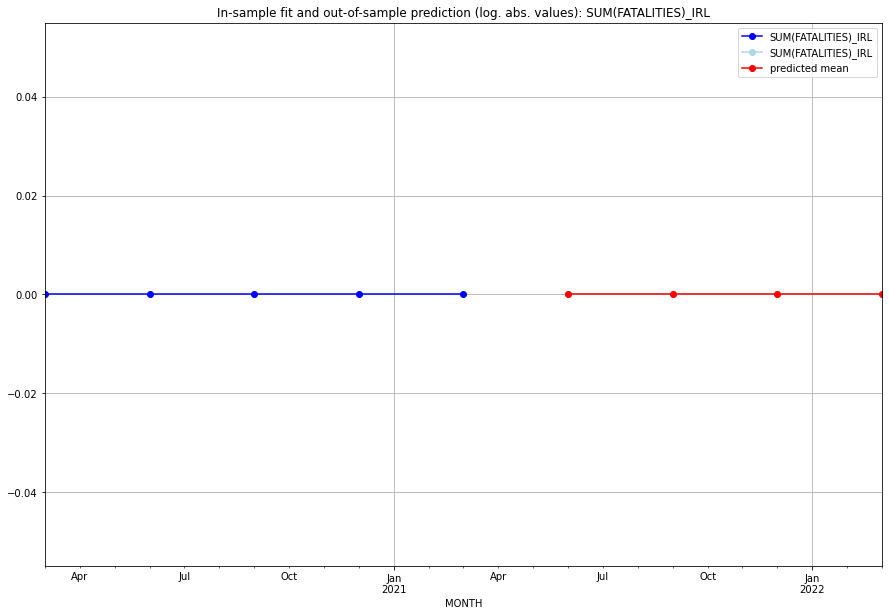

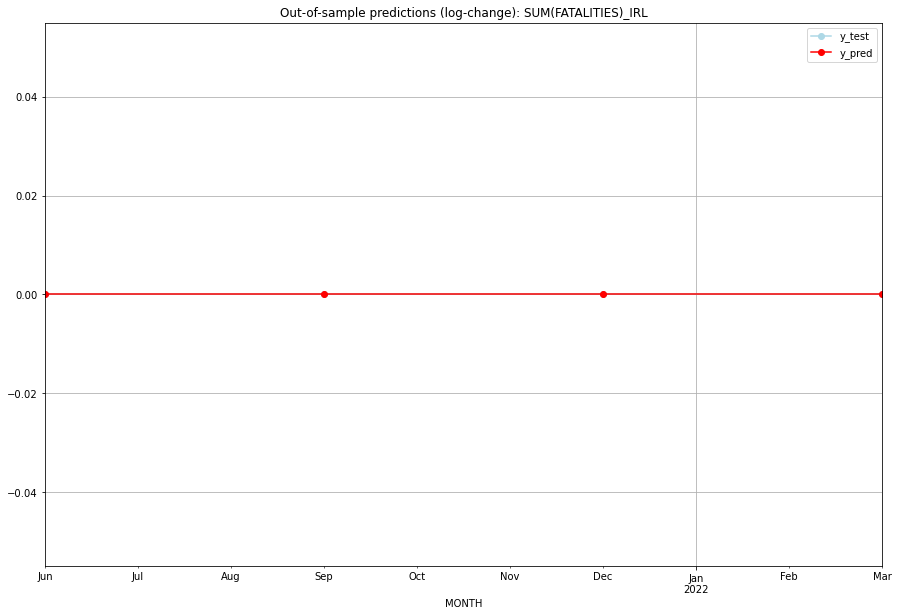

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   IRL   
1 2021-07-01       0.0         0.0           0.0             0.0   IRL   
2 2021-10-01       0.0         0.0           0.0             0.0   IRL   
3 2022-01-01       0.0         0.0           0.0             0.0   IRL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## IRN (102/234) #########
0
Neighbor countries: ['IRQ', 'TKM', 'AFG', 'PAK', 'AZE', 'TUR', 'ARM']
Getting Data for IRN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 117)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.8917668002849736, 'fold_results': [0.929329533503037, 0.8405654950357838, nan, 0.9054053723161]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IRN   No. Observations:                   21
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -30.514
Date:                 Wed, 19 Oct 2022   AIC                             69.028
Time:                         10:43:23   BIC                             73.011
Sample:                     01-31-2016   HQIC                            69.805
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1   

<Figure size 432x288 with 0 Axes>

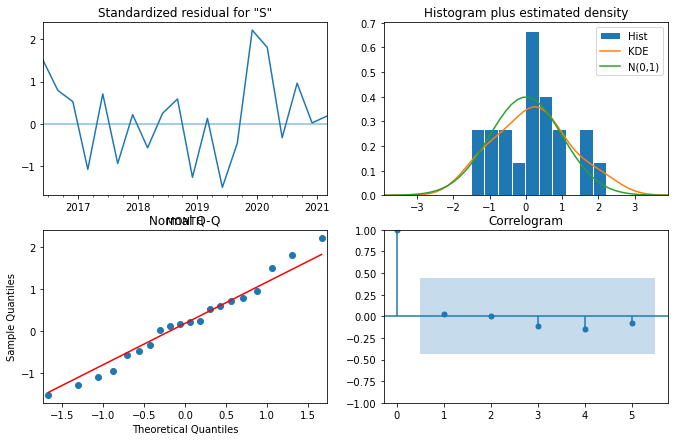

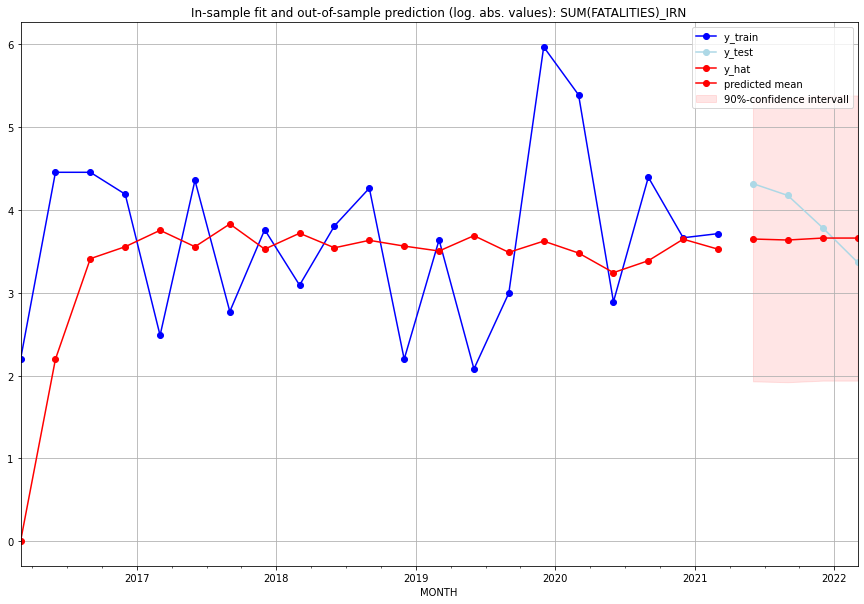

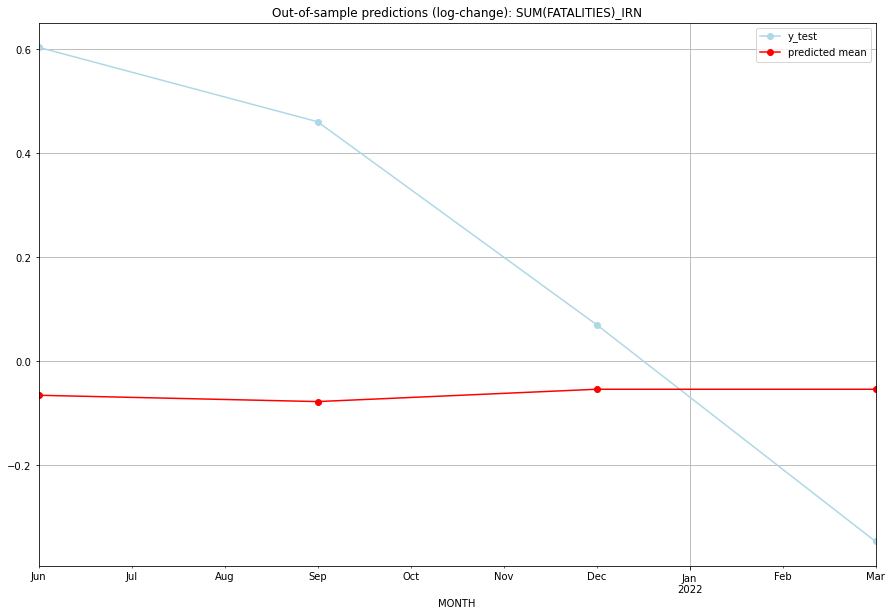

TADDA: 0.45498792669386434
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  37.415576        74.0     -0.065109        0.603916   IRN   
1 2021-07-01  36.951383        64.0     -0.077266        0.460815   IRN   
2 2021-10-01  37.861179        43.0     -0.053576        0.070618   IRN   
3 2022-01-01  37.861179        28.0     -0.053576       -0.346276   IRN   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## IRQ (103/234) #########
0
Neighbor countries: ['SYR', 'TUR', 'IRN', 'JOR', 'SAU', 'KWT']
Getting Data for IRQ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 105)
y: (25, 1)
------------------------------------------------
Trai

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3593684458354545, 'fold_results': [0.5589339892778882, nan, 0.2176697697242589, 0.30150157850421655]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IRQ   No. Observations:                   21
Model:                SARIMAX(1, 0, 2)   Log Likelihood                 -11.021
Date:                 Wed, 19 Oct 2022   AIC                             32.043
Time:                         10:43:41   BIC                             37.265
Sample:                     01-31-2016   HQIC                            33.176
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1 

<Figure size 432x288 with 0 Axes>

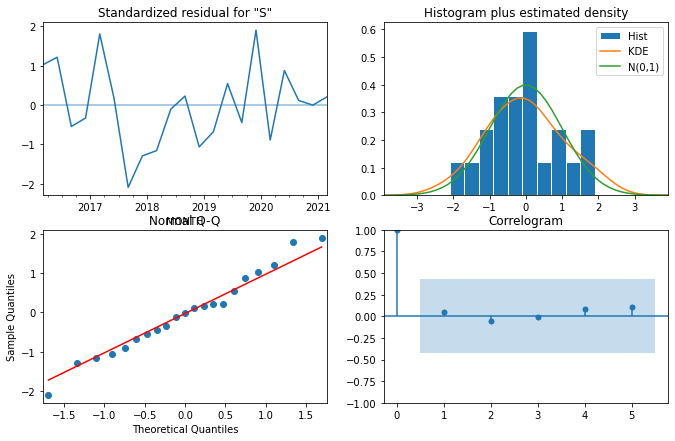

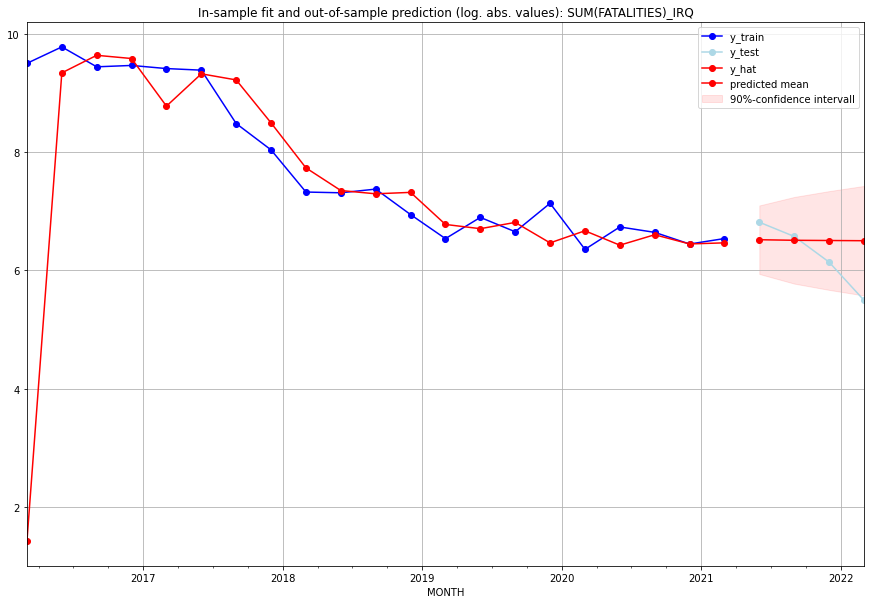

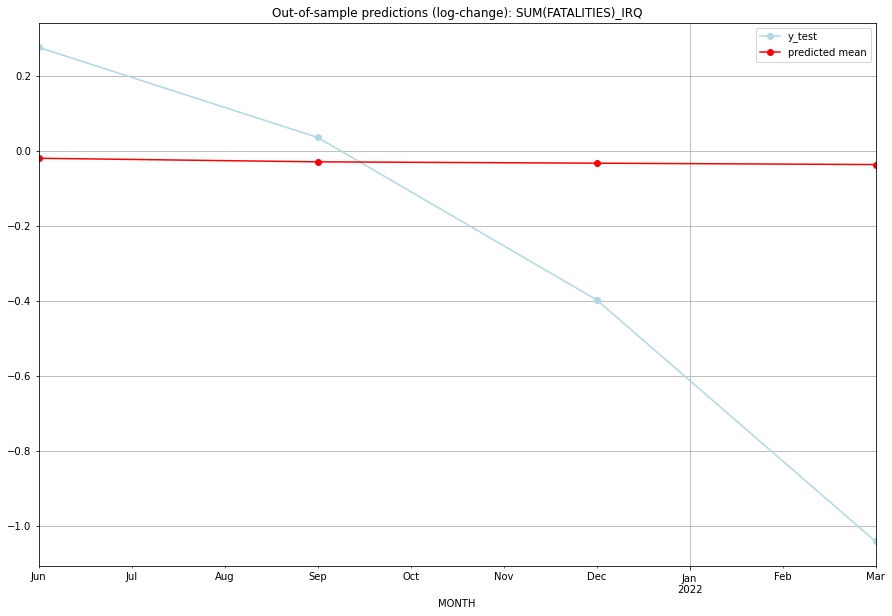

TADDA: 0.44507217014423106
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  674.408629       907.0     -0.019923        0.276003   IRQ   
1 2021-07-01  667.994203       713.0     -0.029466        0.035642   IRQ   
2 2021-10-01  665.568231       462.0     -0.033099       -0.397514   IRQ   
3 2022-01-01  663.152205       242.0     -0.036730       -1.042180   IRQ   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## ISL (104/234) #########
0
Neighbor countries: []
Getting Data for ISL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 62)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Ins

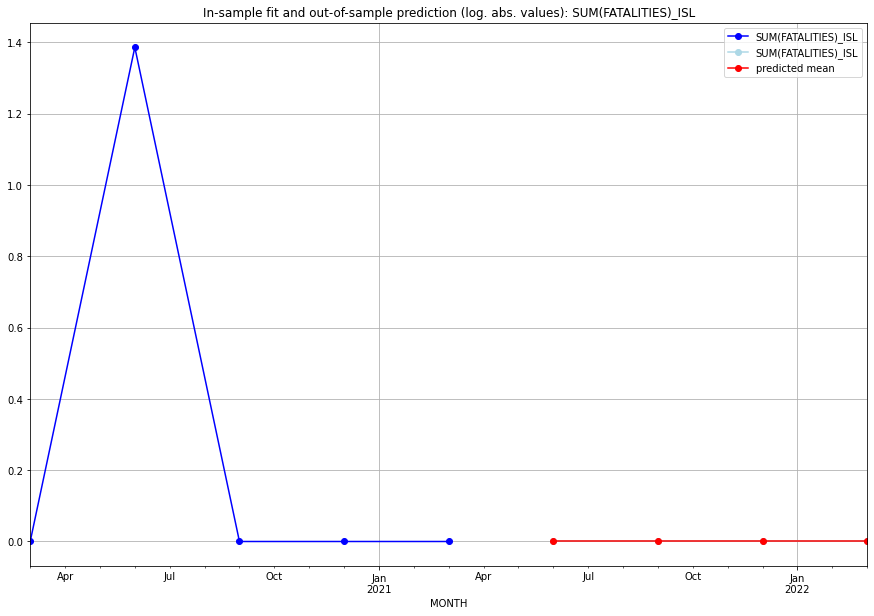

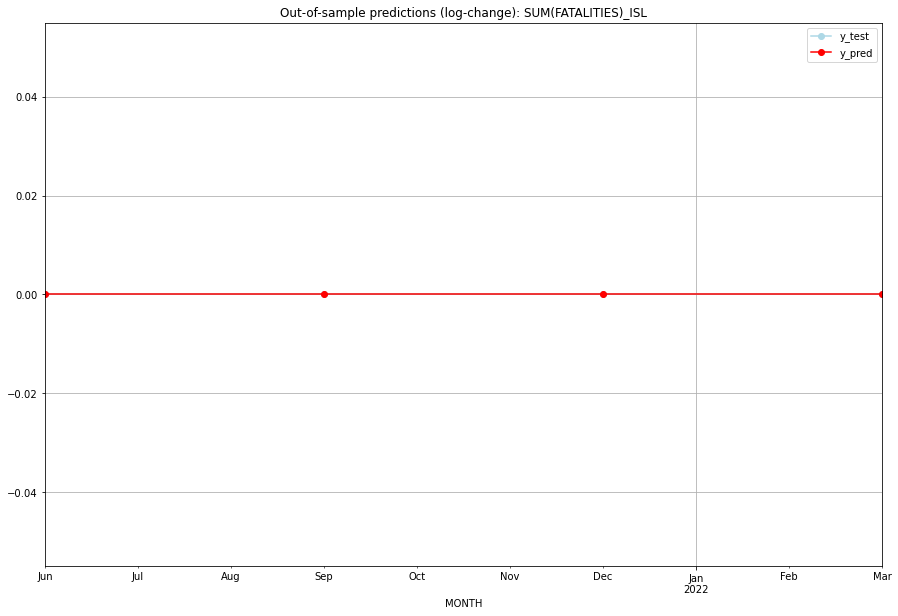

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ISL   
1 2021-07-01       0.0         0.0           0.0             0.0   ISL   
2 2021-10-01       0.0         0.0           0.0             0.0   ISL   
3 2022-01-01       0.0         0.0           0.0             0.0   ISL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## ISR (105/234) #########
0
Neighbor countries: ['JOR', 'LBN', 'SYR', 'EGY', 'PSE']
Getting Data for ISR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 104)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.0495463880508706, 'fold_results': [1.860859364672696, 0.5999621922039214, nan, 0.6878176072759945]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ISR   No. Observations:                   21
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -28.859
Date:                 Wed, 19 Oct 2022   AIC                             69.717
Time:                         10:43:56   BIC                             75.692
Sample:                     01-31-2016   HQIC                            70.884
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1   

<Figure size 432x288 with 0 Axes>

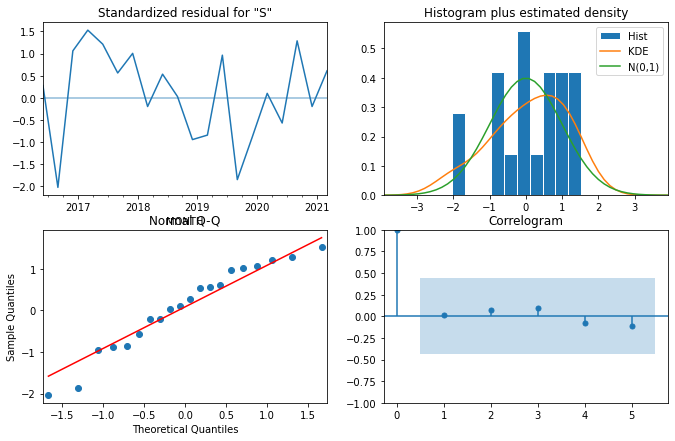

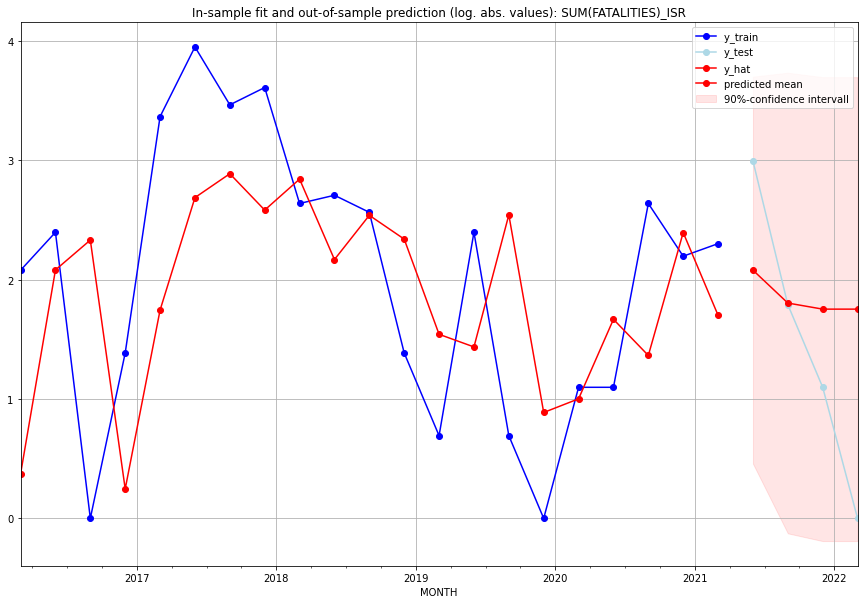

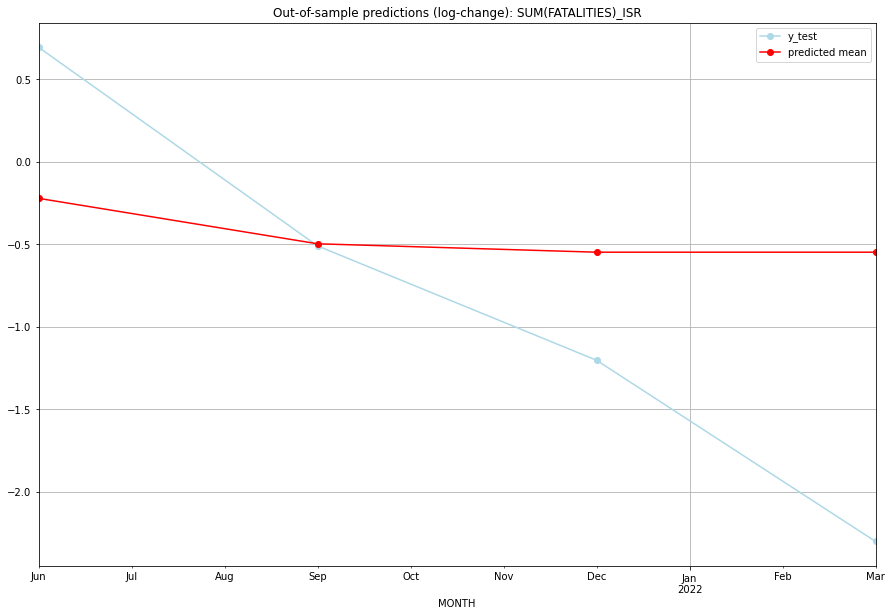

TADDA: 0.889882344503534
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  7.006261        19.0     -0.222361        0.693147   ISR   
1 2021-07-01  5.078021         5.0     -0.497906       -0.510826   ISR   
2 2021-10-01  4.775796         2.0     -0.548909       -1.203973   ISR   
3 2022-01-01  4.775796         0.0     -0.548909       -2.302585   ISR   

                                          PARAMETERS  
0  {'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## ITA (106/234) #########
0
Neighbor countries: ['CHE', 'SMR', 'FRA', 'TUN', 'AUT', 'SVN', 'VAT']
Getting Data for ITA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 121)
y: (9, 1)
------------------------------------------------
Traini

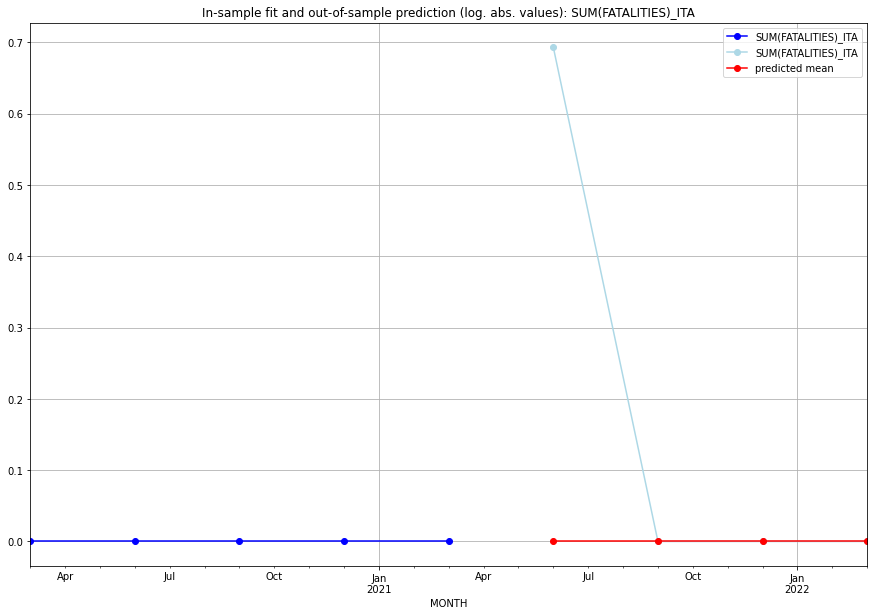

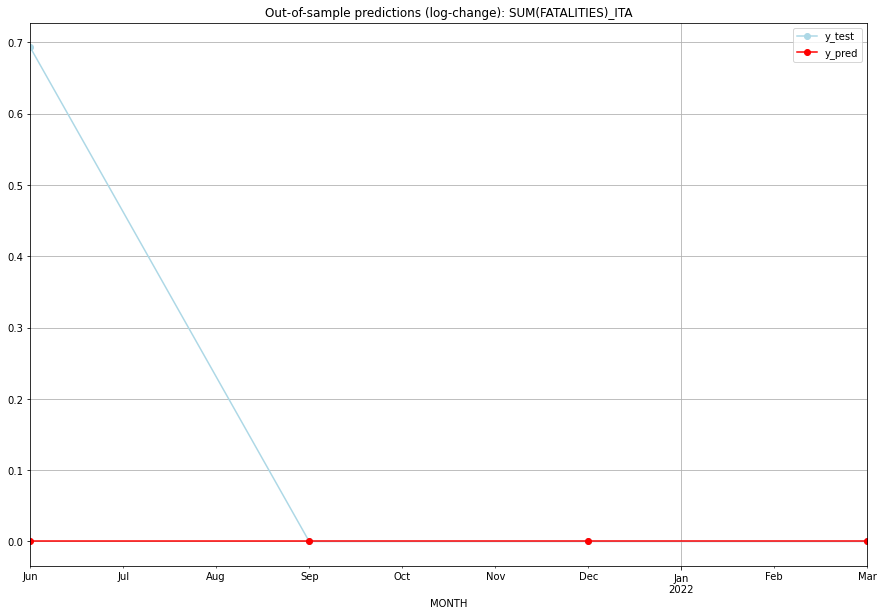

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.693147           0.0        0.693147   ITA   
1 2021-07-01       0.0    0.000000           0.0        0.000000   ITA   
2 2021-10-01       0.0    0.000000           0.0        0.000000   ITA   
3 2022-01-01       0.0    0.000000           0.0        0.000000   ITA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## JAM (107/234) #########
0
Neighbor countries: []
Getting Data for JAM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 60)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.11134739671002081, 'fold_results': [0.16647715824286413, 0.05621763517717748]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_JAM   No. Observations:                   13
Model:                SARIMAX(3, 0, 1)   Log Likelihood                  -1.340
Date:                 Wed, 19 Oct 2022   AIC                             14.679
Time:                         10:44:13   BIC                             18.069
Sample:                     01-31-2018   HQIC                            13.982
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0249     

<Figure size 432x288 with 0 Axes>

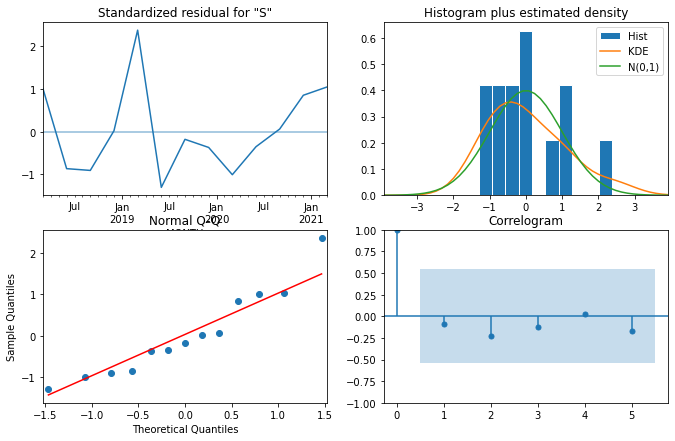

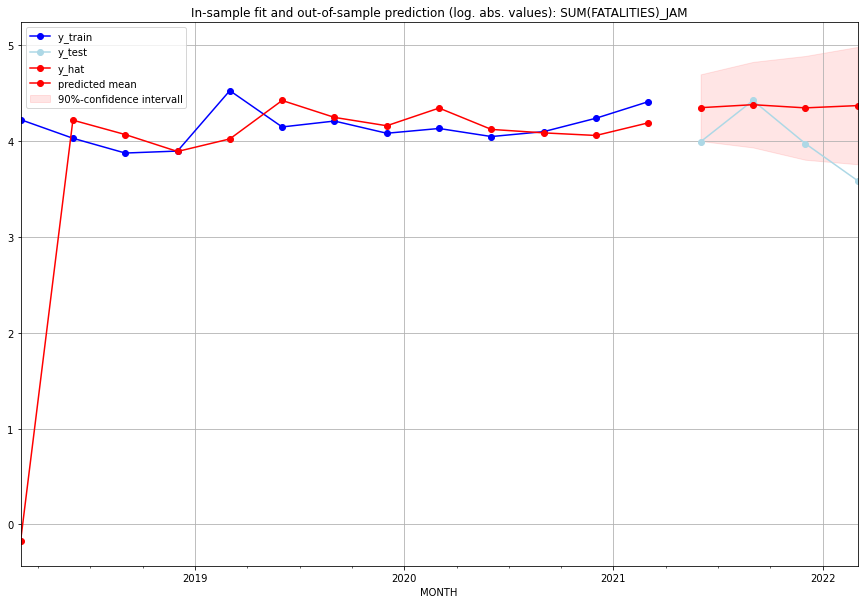

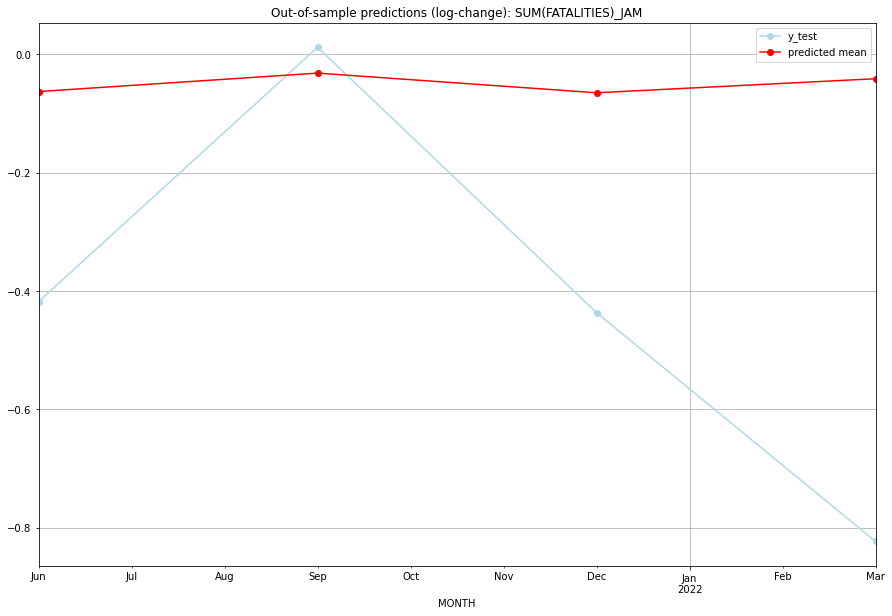

TADDA: 0.3881573509667483
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  76.018862        53.0     -0.062669       -0.417735   JAM   
1 2021-07-01  78.457058        82.0     -0.031503        0.012121   JAM   
2 2021-10-01  75.860839        52.0     -0.064723       -0.436427   JAM   
3 2022-01-01  77.708690        35.0     -0.040966       -0.823200   JAM   

                                          PARAMETERS  
0  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## JEY (108/234) #########
0
Neighbor countries: []
Getting Data for JEY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSC

<Figure size 432x288 with 0 Axes>

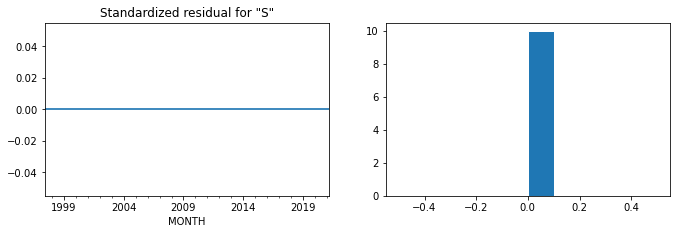

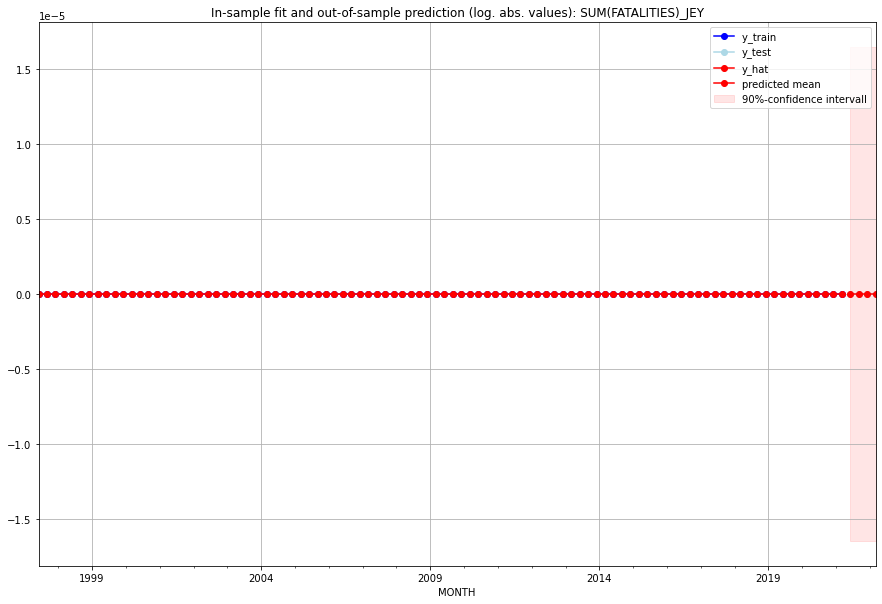

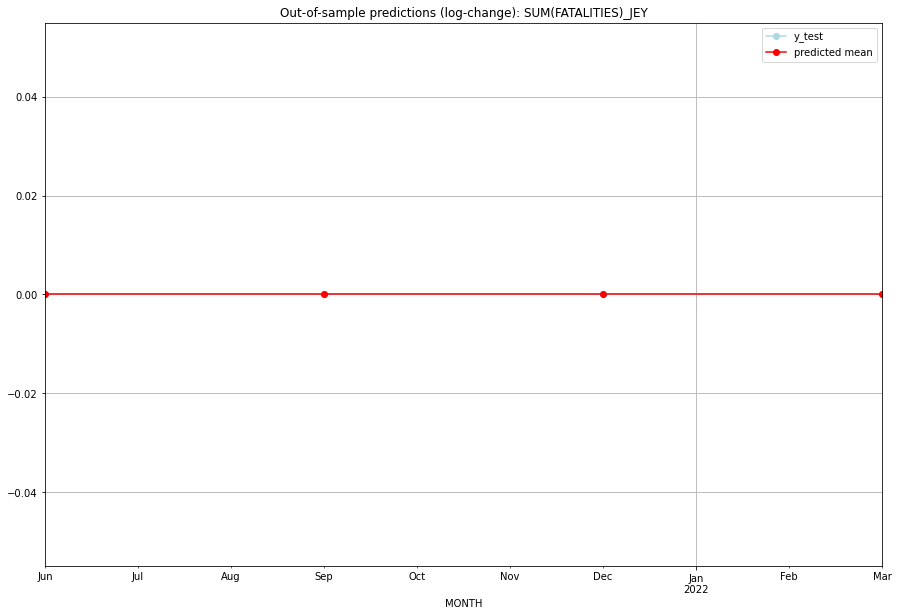

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   JEY   
1 2021-07-01       0.0         0.0           0.0             0.0   JEY   
2 2021-10-01       0.0         0.0           0.0             0.0   JEY   
3 2022-01-01       0.0         0.0           0.0             0.0   JEY   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:06
######## JOR (109/234) #########
0
Neighbor countries: ['IRQ', 'SAU', 'SYR', 'ISR', 'PSE']
Getting Data for JOR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 104)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6745891226188256, 'fold_results': [0.6606957604688368, 0.7489330683884978, 0.566134722143927, 0.7225929394740411]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_JOR   No. Observations:                   21
Model:                SARIMAX(1, 0, 0)   Log Likelihood                 -32.316
Date:                 Wed, 19 Oct 2022   AIC                             68.632
Time:                         10:44:40   BIC                             70.721
Sample:                     01-31-2016   HQIC                            69.085
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

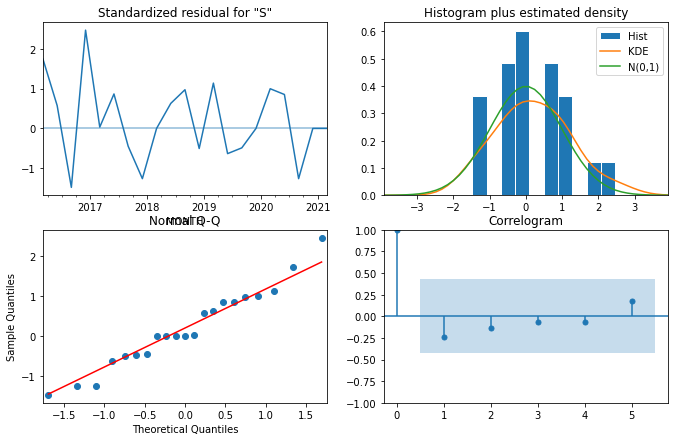

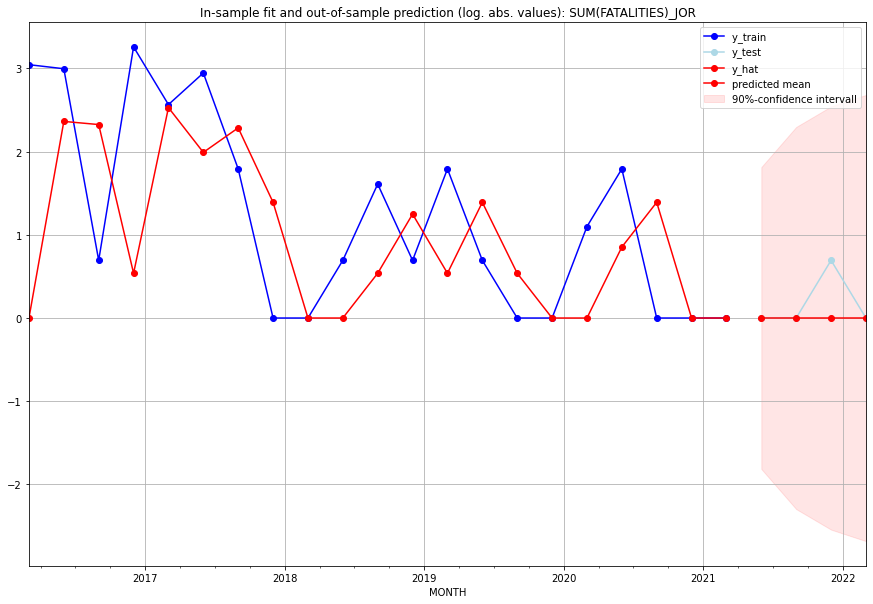

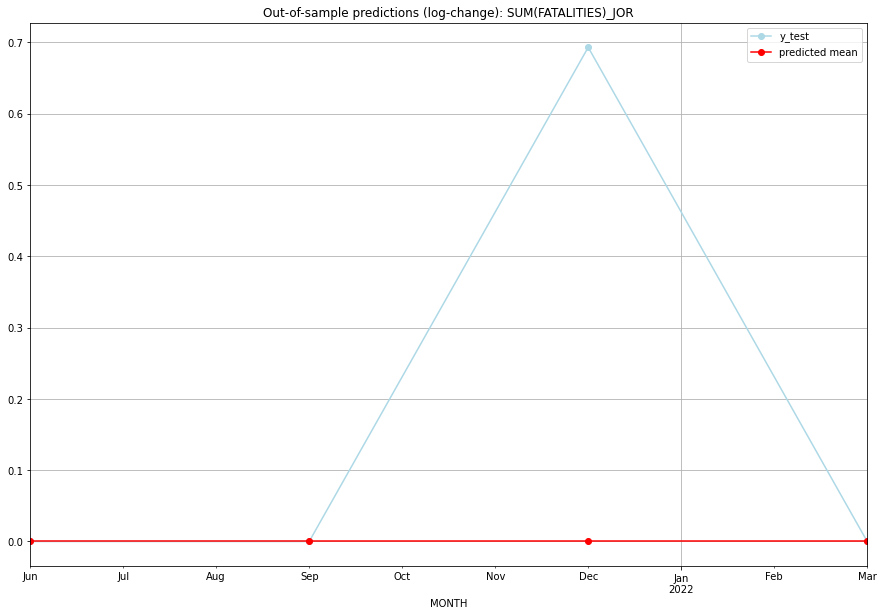

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   JOR   
1 2021-07-01       0.0         0.0           0.0        0.000000   JOR   
2 2021-10-01       0.0         1.0           0.0        0.693147   JOR   
3 2022-01-01       0.0         0.0           0.0        0.000000   JOR   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## JPN (110/234) #########
0
Neighbor countries: []
Getting Data for JPN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 60)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV nec

<Figure size 432x288 with 0 Axes>

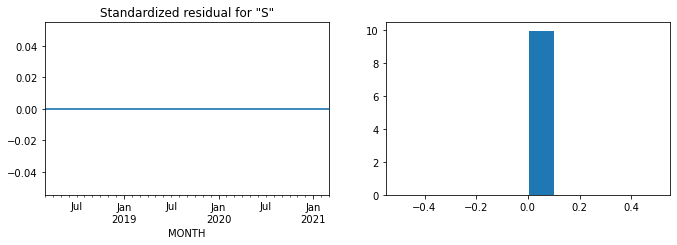

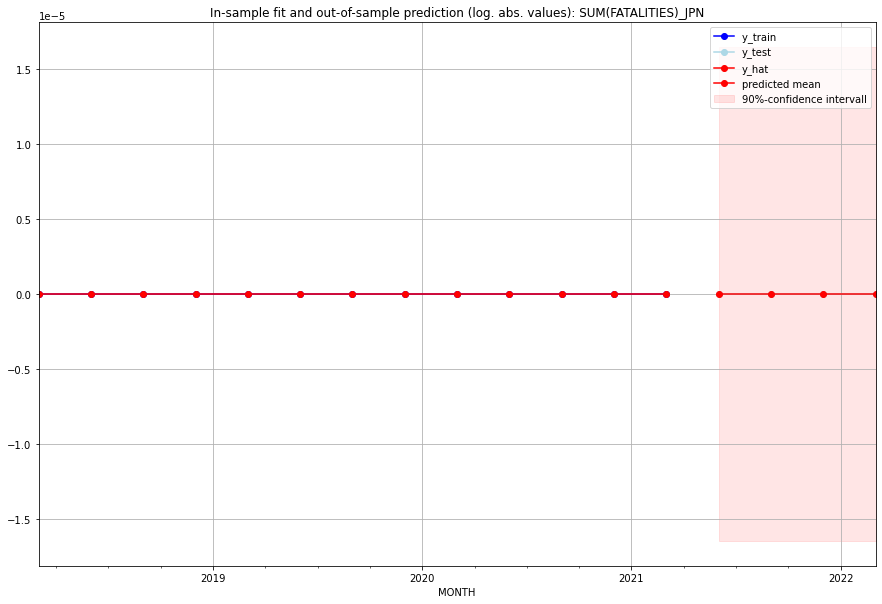

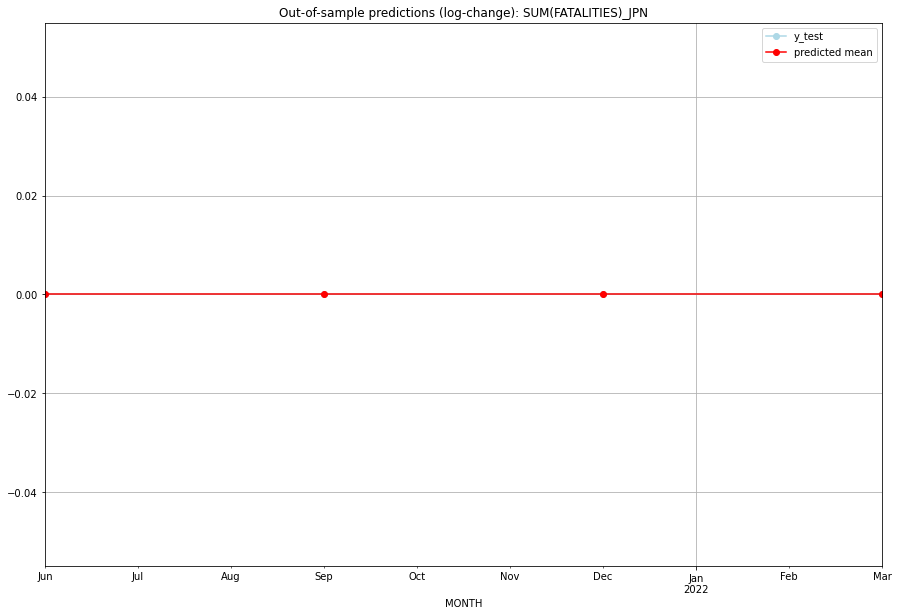

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   JPN   
1 2021-07-01       0.0         0.0           0.0             0.0   JPN   
2 2021-10-01       0.0         0.0           0.0             0.0   JPN   
3 2022-01-01       0.0         0.0           0.0             0.0   JPN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:05
######## KAZ (111/234) #########
0
Neighbor countries: ['RUS', 'UZB', 'KGZ', 'CHN', 'TKM']
Getting Data for KAZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 104)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.708094652679689, 'fold_results': [0.708094652679689, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KAZ   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                 -15.950
Date:                 Wed, 19 Oct 2022   AIC                             47.900
Time:                         10:44:53   BIC                             52.419
Sample:                     01-31-2018   HQIC                            46.971
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0201      0.104     -0.193   

<Figure size 432x288 with 0 Axes>

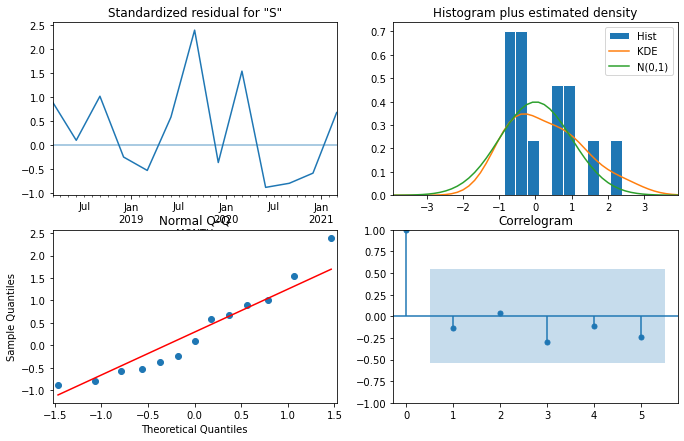

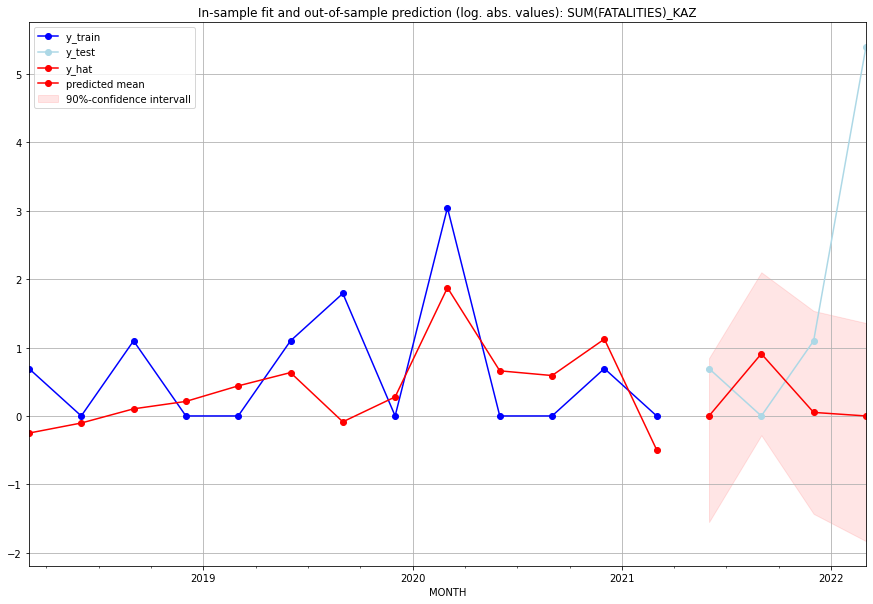

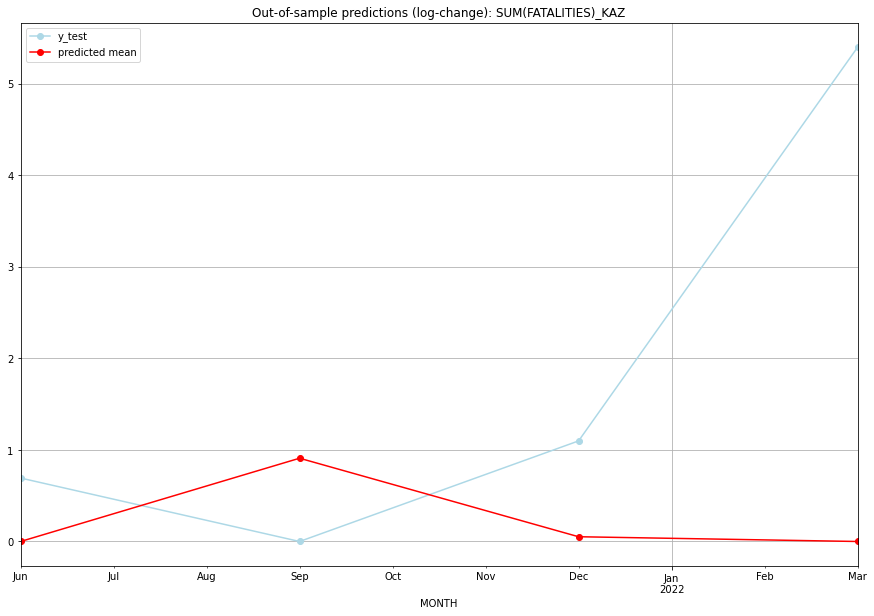

TADDA: 2.0118820149918406
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.000000         1.0      0.000000        0.693147   KAZ   
1 2021-07-01  1.483138         0.0      0.909523        0.000000   KAZ   
2 2021-10-01  0.053289         2.0      0.051917        1.098612   KAZ   
3 2022-01-01  0.000000       220.0      0.000000        5.398163   KAZ   

                                          PARAMETERS  
0  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## KEN (112/234) #########
0
Neighbor countries: ['TZA', 'ETH', 'SOM', 'UGA', 'SSD', 'XIT']
Getting Data for KEN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 109)
y: (100, 1)
------------------------------------------------
Training

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.445935637561613, 'fold_results': [0.306231181530469, 0.9538376987142125, 0.28035590457073156, 0.4456861343407885, 0.2435672686518633]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KEN   No. Observations:                   96
Model:                SARIMAX(1, 0, 3)   Log Likelihood                -126.580
Date:                 Wed, 19 Oct 2022   AIC                            263.159
Time:                         10:45:25   BIC                            275.981
Sample:                     04-30-1997   HQIC                           268.342
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

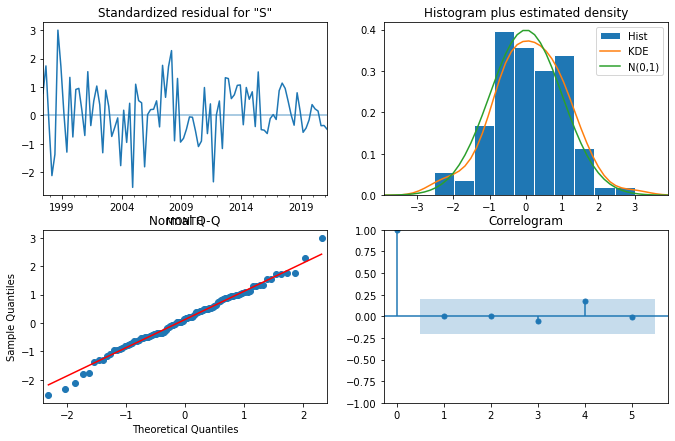

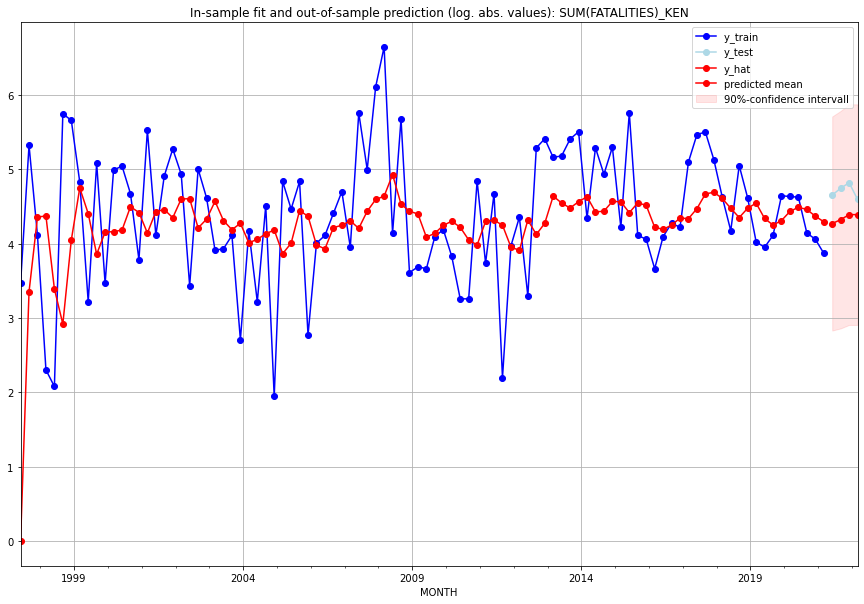

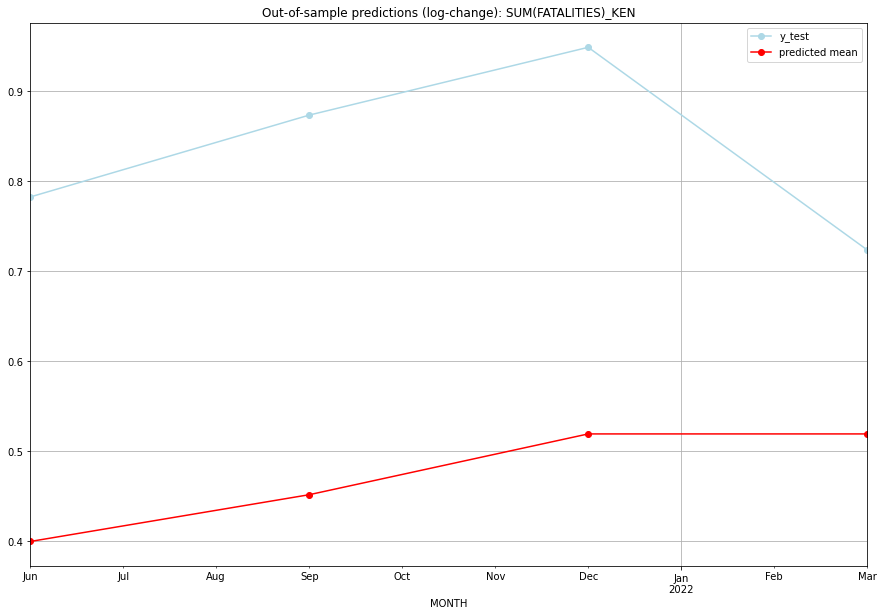

TADDA: 0.3597053870291804
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  70.600518       104.0      0.399901        0.782759   KEN   
1 2021-07-01  74.420964       114.0      0.451884        0.873731   KEN   
2 2021-10-01  79.692275       123.0      0.519442        0.949081   KEN   
3 2022-01-01  79.692201        98.0      0.519441        0.723919   KEN   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:29
######## KGZ (113/234) #########
0
Neighbor countries: ['TJK', 'UZB', 'KAZ', 'CHN']
Getting Data for KGZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 96)
y: (17, 1)
------------------------------------------------
Training started.
St

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5550081567416557, 'fold_results': [0.8353632413162839, 0.27465307216702745]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KGZ   No. Observations:                   13
Model:                SARIMAX(0, 0, 1)   Log Likelihood                 -15.228
Date:                 Wed, 19 Oct 2022   AIC                             40.456
Time:                         10:45:37   BIC                             43.281
Sample:                     01-31-2018   HQIC                            39.875
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0282      0

<Figure size 432x288 with 0 Axes>

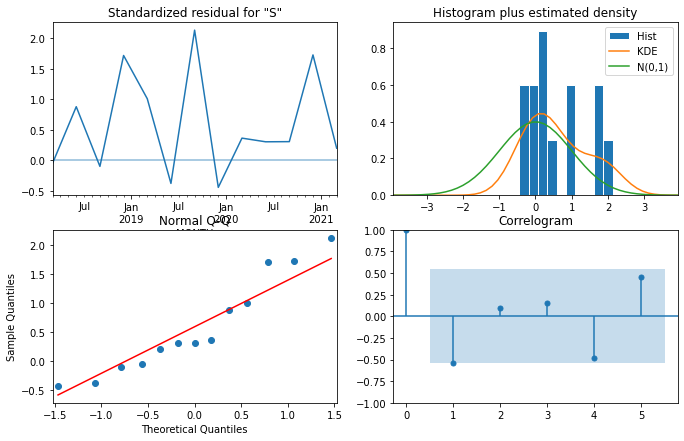

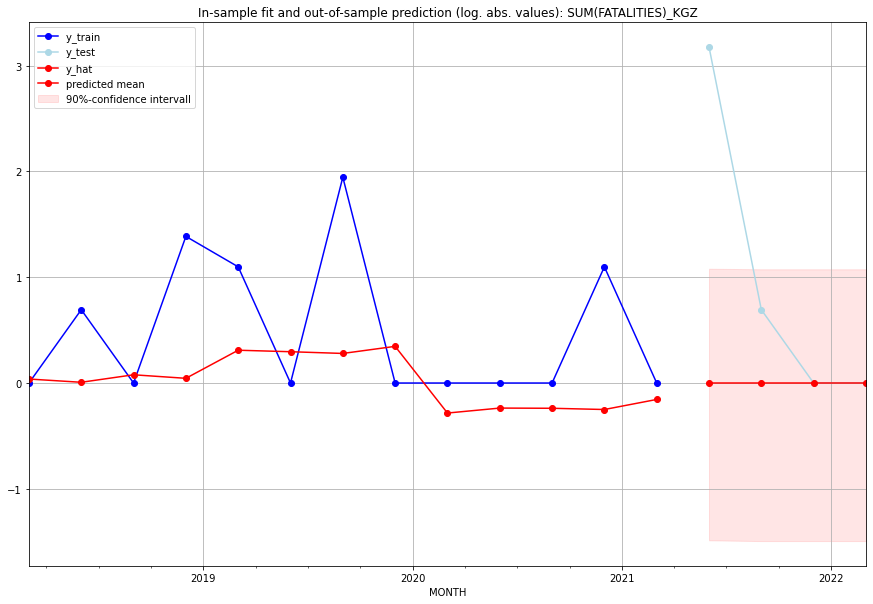

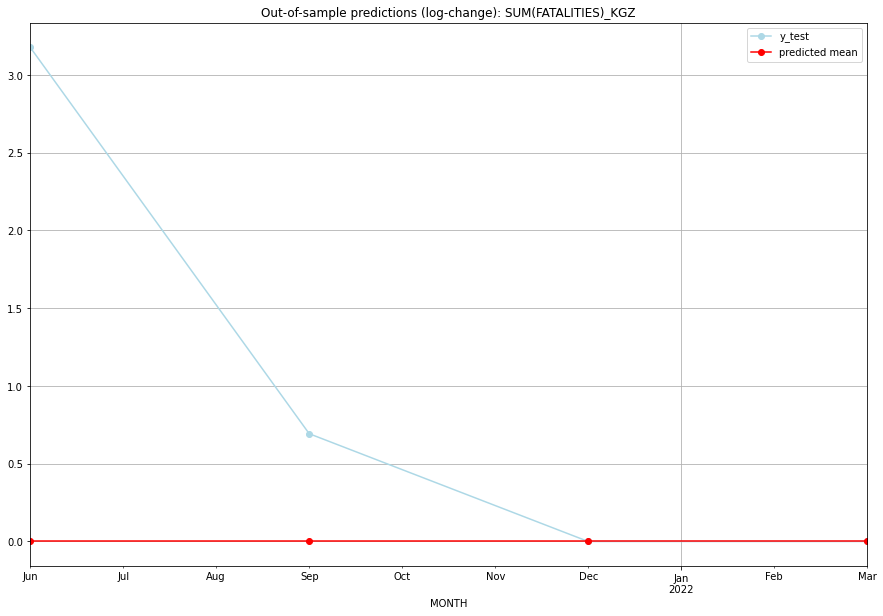

TADDA: 0.9678002527269728
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0        23.0           0.0        3.178054   KGZ   
1 2021-07-01       0.0         1.0           0.0        0.693147   KGZ   
2 2021-10-01       0.0         0.0           0.0        0.000000   KGZ   
3 2022-01-01       0.0         0.0           0.0        0.000000   KGZ   

                                          PARAMETERS  
0  {'params': [3, (0, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## KHM (114/234) #########
0
Neighbor countries: ['VNM', 'THA', 'LAO']
Getting Data for KHM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 82)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEAR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5314139203775347, 'fold_results': [0.6912398757206116, 0.39110604202803745, 0.6456088894955283, 0.42240184034796213, 0.506712954295534]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KHM   No. Observations:                   45
Model:                SARIMAX(0, 1, 1)   Log Likelihood                 -51.426
Date:                 Wed, 19 Oct 2022   AIC                            112.852
Time:                         10:46:09   BIC                            121.773
Sample:                     01-31-2010   HQIC                           116.160
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

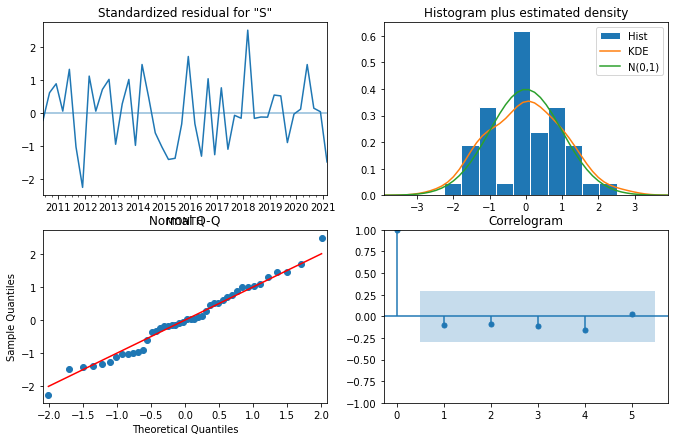

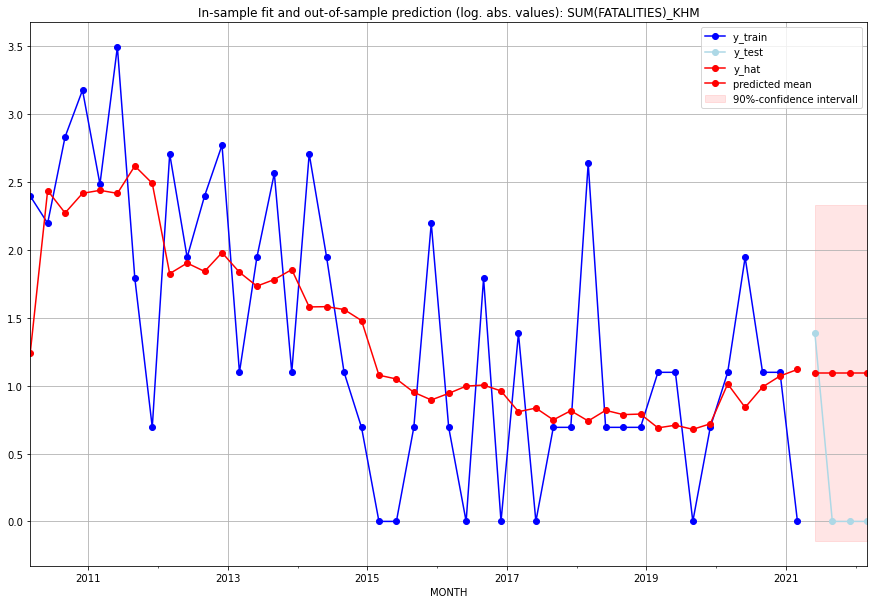

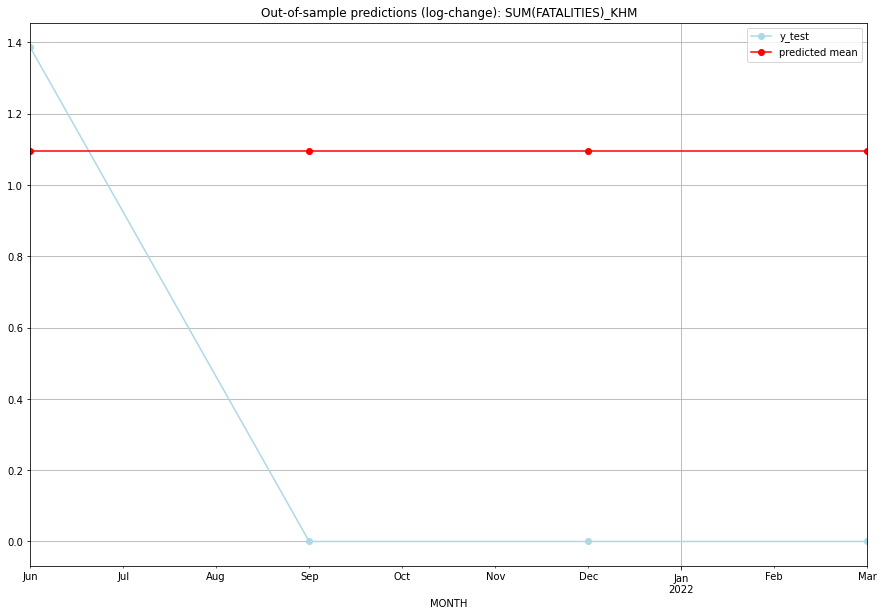

TADDA: 0.8940807457740934
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.989225         3.0      1.095014        1.386294   KHM   
1 2021-07-01  1.989225         0.0      1.095014        0.000000   KHM   
2 2021-10-01  1.989225         0.0      1.095014        0.000000   KHM   
3 2022-01-01  1.989225         0.0      1.095014        0.000000   KHM   

                                          PARAMETERS  
0  {'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:29
######## KNA (115/234) #########
0
Neighbor countries: []
Getting Data for KNA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 43)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KNA   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:46:15   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.245      0.000       0.025       0

<Figure size 432x288 with 0 Axes>

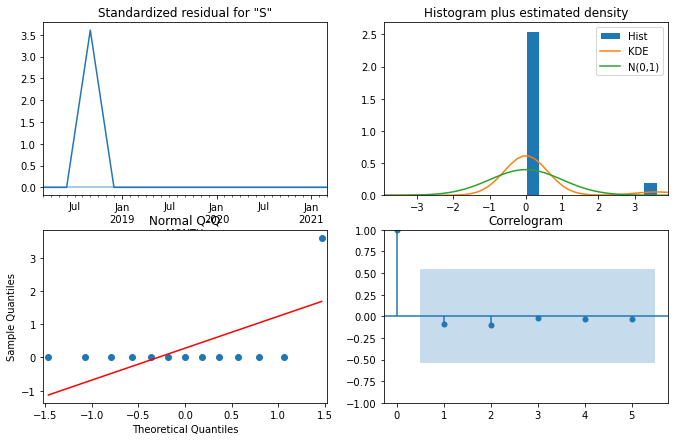

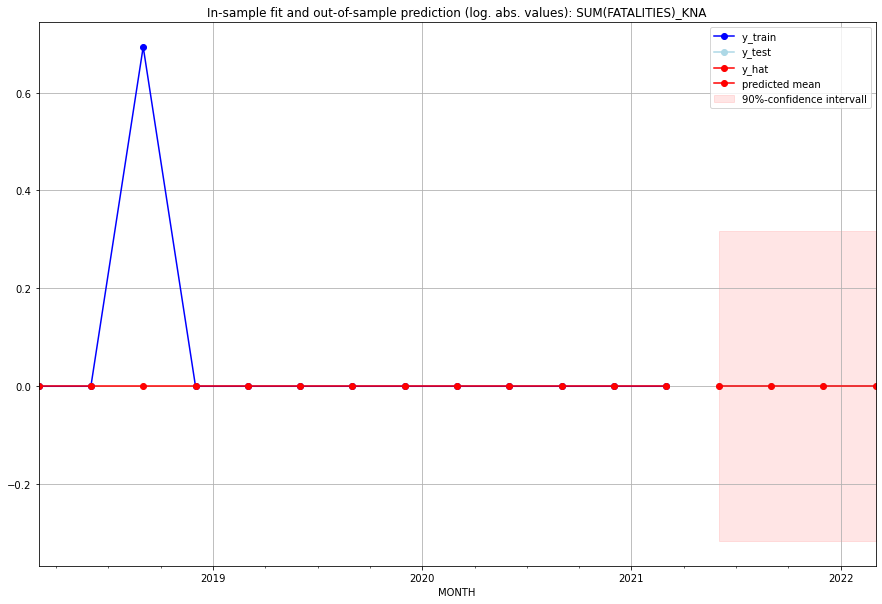

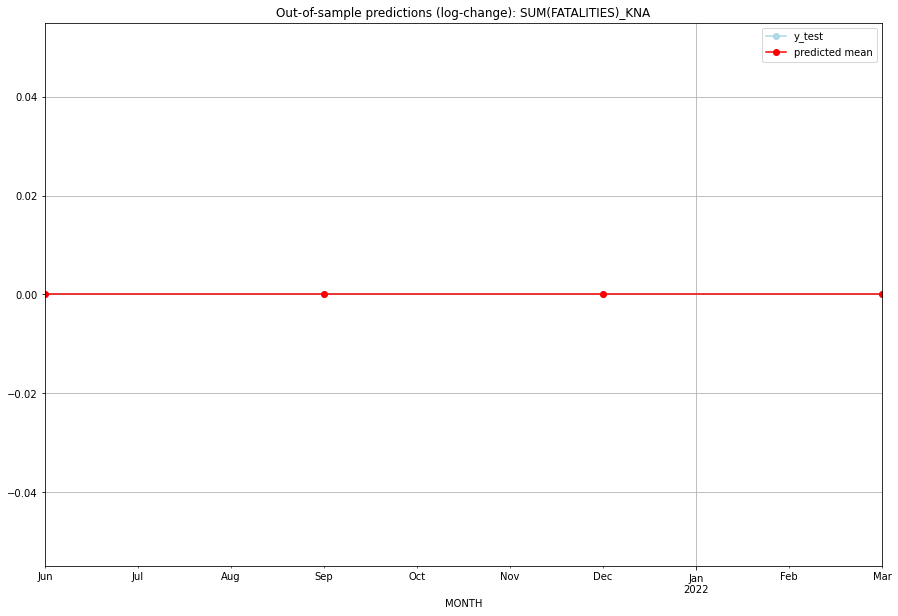

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   KNA   
1 2021-07-01       0.0         0.0           0.0             0.0   KNA   
2 2021-10-01       0.0         0.0           0.0             0.0   KNA   
3 2022-01-01       0.0         0.0           0.0             0.0   KNA   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## KOR (116/234) #########
0
Neighbor countries: ['PRK']
Getting Data for KOR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 70)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Bes

<Figure size 432x288 with 0 Axes>

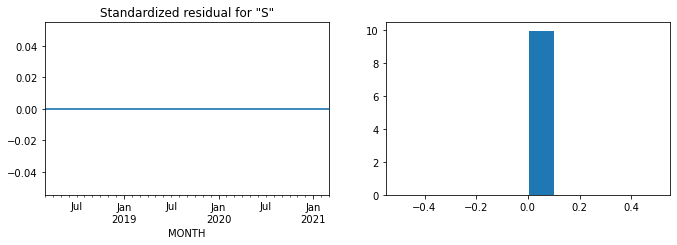

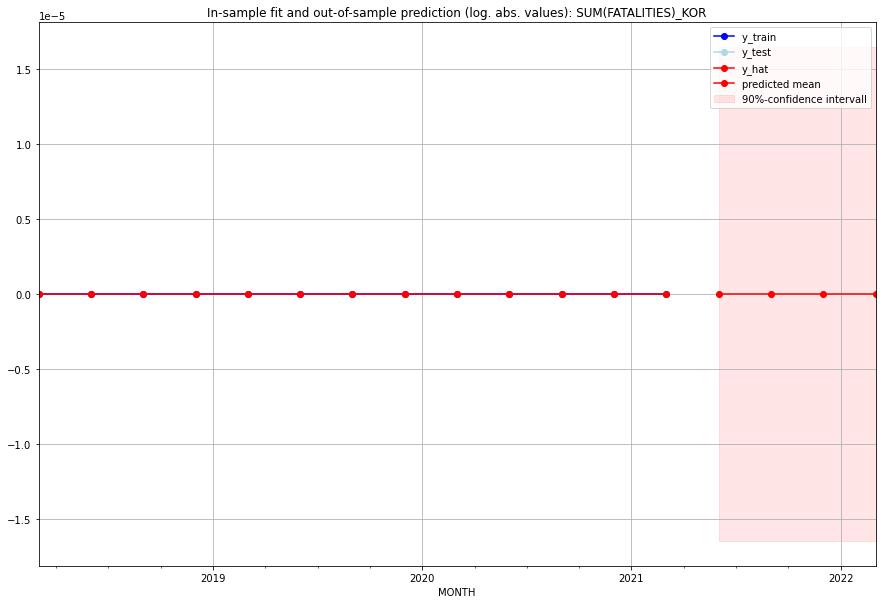

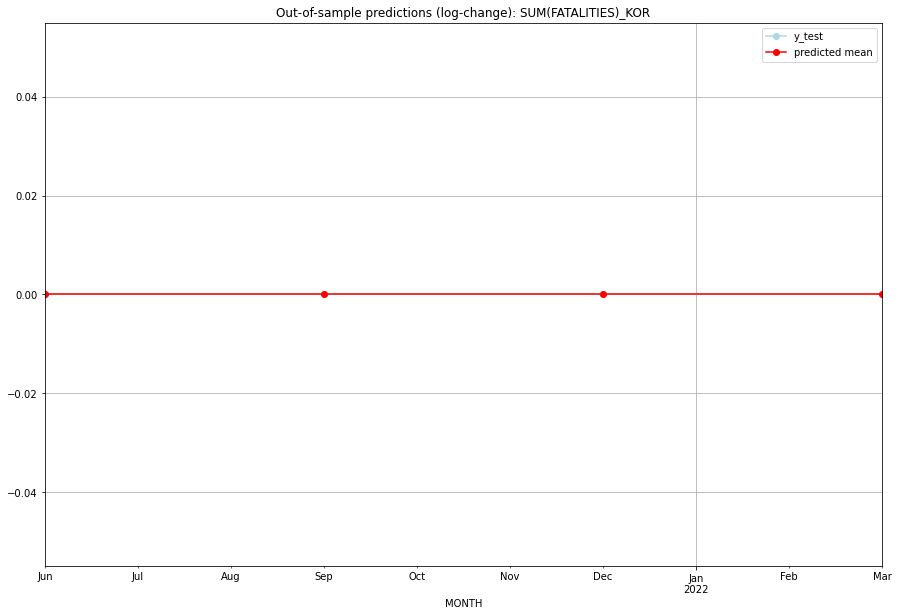

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   KOR   
1 2021-07-01       0.0         0.0           0.0             0.0   KOR   
2 2021-10-01       0.0         0.0           0.0             0.0   KOR   
3 2022-01-01       0.0         0.0           0.0             0.0   KOR   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:08
######## KWT (117/234) #########
0
Neighbor countries: ['SAU', 'IRQ']
Getting Data for KWT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 70)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.04332169878499658, 'fold_results': [0.0, 0.0, 0.0, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KWT   No. Observations:                   21
Model:                         SARIMAX   Log Likelihood                   9.867
Date:                 Wed, 19 Oct 2022   AIC                            -17.733
Time:                         10:46:53   BIC                            -16.689
Sample:                     01-31-2016   HQIC                           -17.506
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0229      0.002

<Figure size 432x288 with 0 Axes>

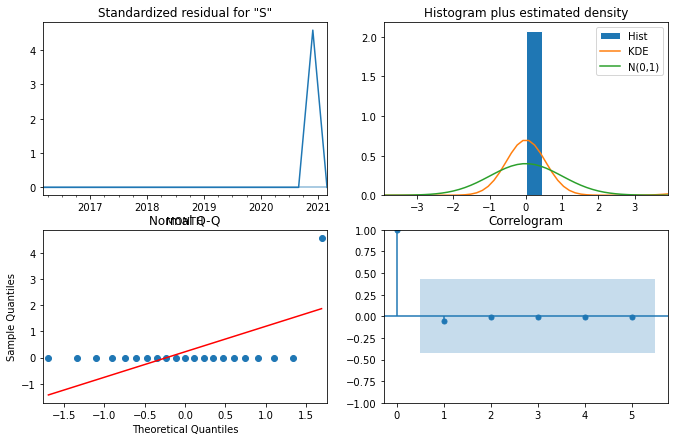

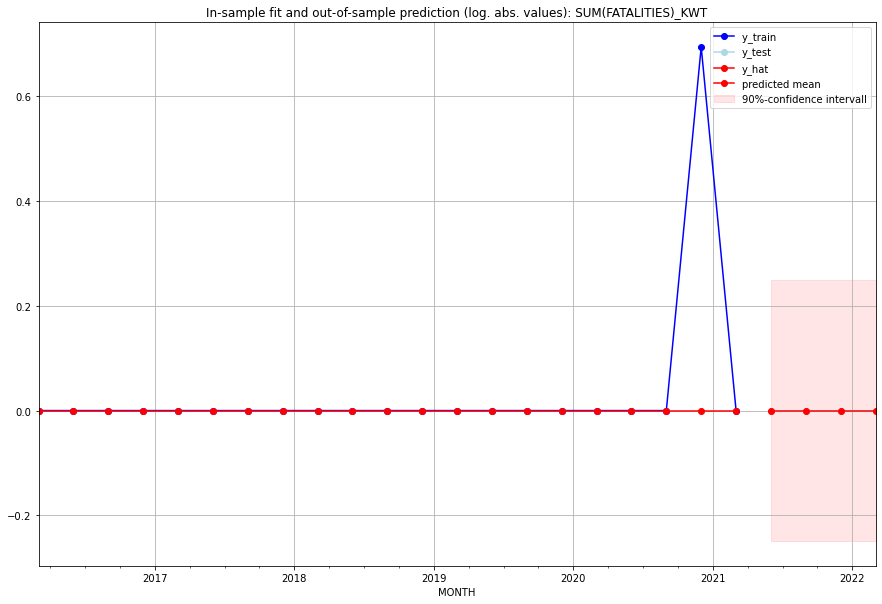

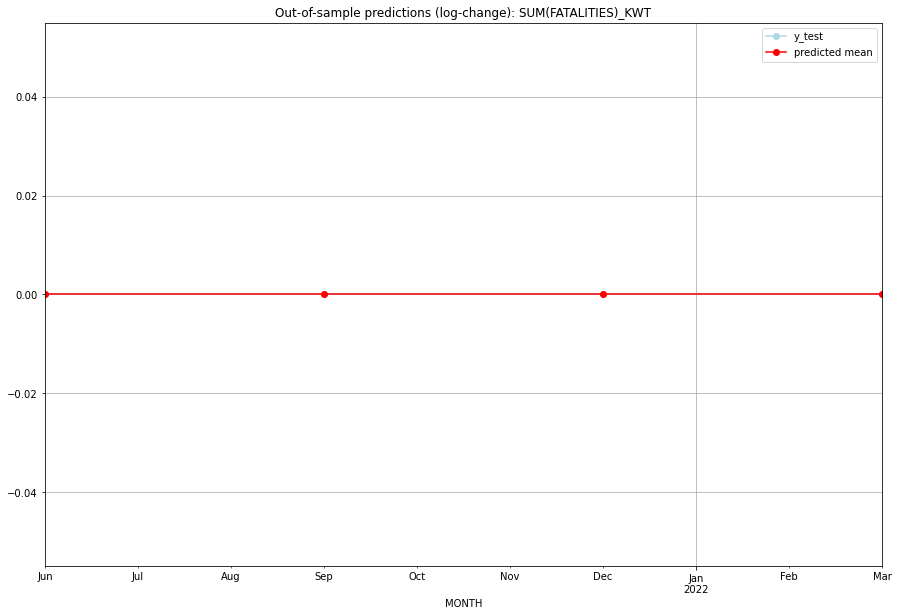

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   KWT   
1 2021-07-01       0.0         0.0           0.0             0.0   KWT   
2 2021-10-01       0.0         0.0           0.0             0.0   KWT   
3 2022-01-01       0.0         0.0           0.0             0.0   KWT   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:27
######## LAO (118/234) #########
0
Neighbor countries: ['CHN', 'VNM', 'THA', 'KHM', 'MMR']
Getting Data for LAO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 98)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARC

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.40984021184299735, 'fold_results': [0.6682008234643557, 0.46531785030037265, 0.2091747770069976, 0.34756511129860634, 0.358942497144654]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LAO   No. Observations:                   45
Model:                SARIMAX(1, 1, 0)   Log Likelihood                 -46.665
Date:                 Wed, 19 Oct 2022   AIC                            101.330
Time:                         10:47:19   BIC                            108.467
Sample:                     01-31-2010   HQIC                           103.977
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

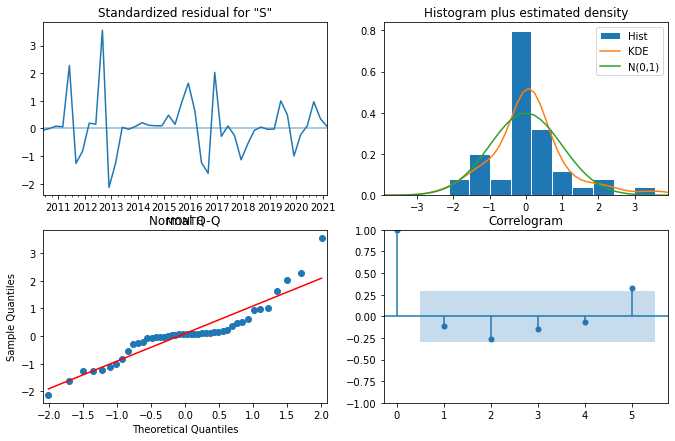

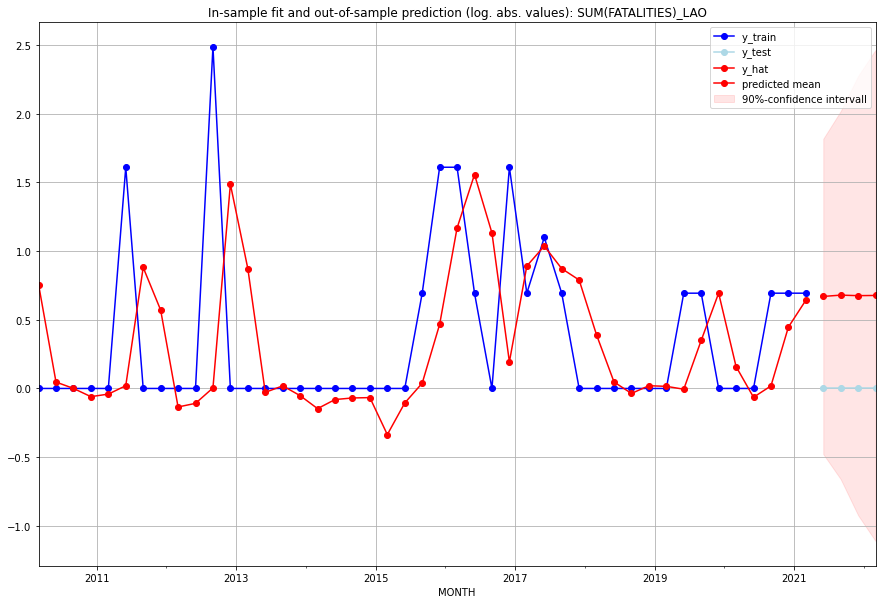

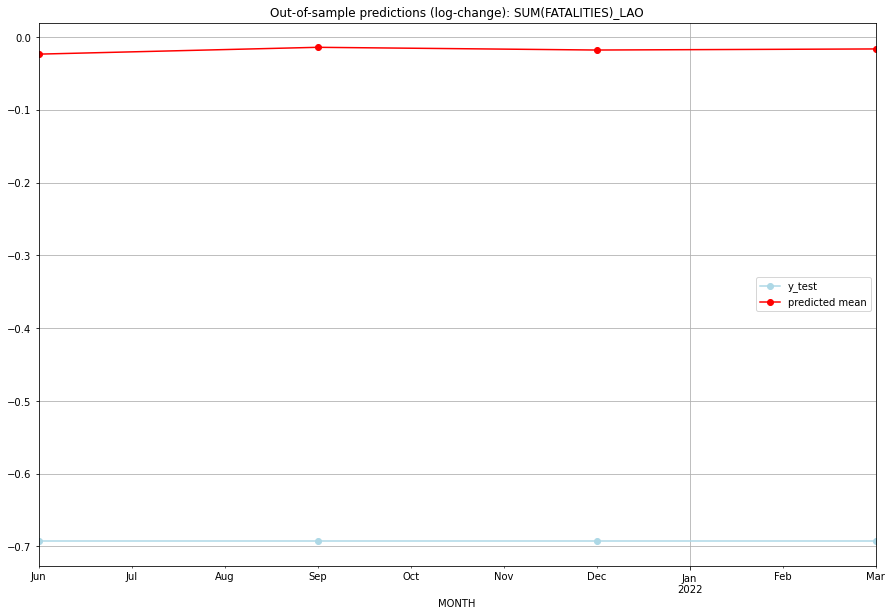

TADDA: 0.6751181339694419
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.953413         0.0     -0.023569       -0.693147   LAO   
1 2021-07-01  0.971822         0.0     -0.014189       -0.693147   LAO   
2 2021-10-01  0.964475         0.0     -0.017922       -0.693147   LAO   
3 2022-01-01  0.967396         0.0     -0.016436       -0.693147   LAO   

                                          PARAMETERS  
0  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:29
######## LBN (119/234) #########
0
Neighbor countries: ['SYR', 'ISR']
Getting Data for LBN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 73)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV o

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.8539544900139224, 'fold_results': [1.2571342297845693, 0.6197543496527383, 0.5681921402950649, 0.9707372403233174]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBN   No. Observations:                   21
Model:                SARIMAX(1, 1, 2)   Log Likelihood                 -26.200
Date:                 Wed, 19 Oct 2022   AIC                             66.400
Time:                         10:47:35   BIC                             73.370
Sample:                     01-31-2016   HQIC                            67.761
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

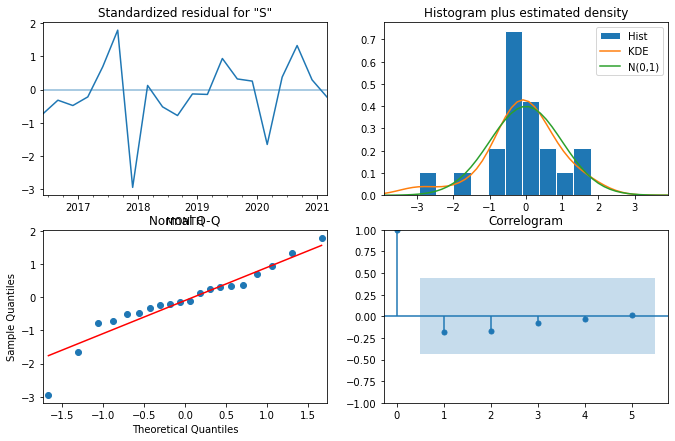

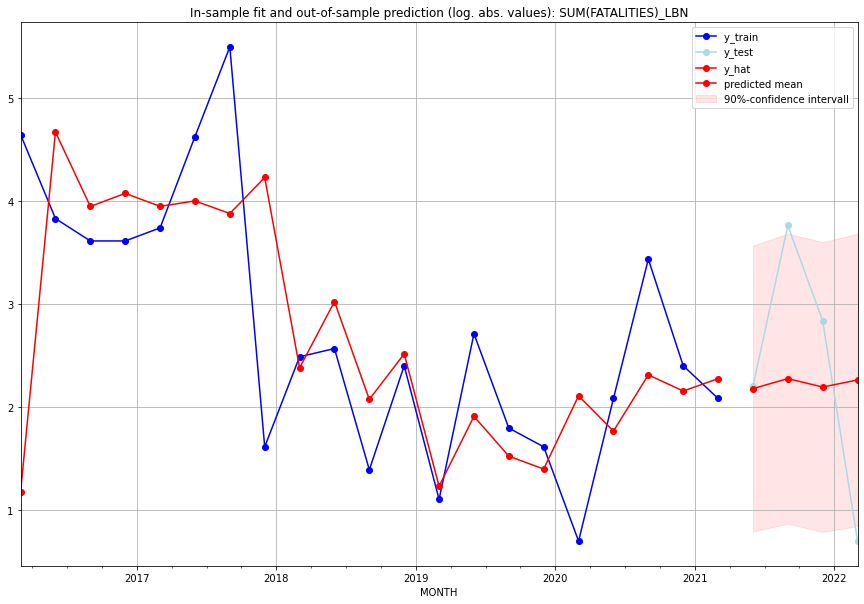

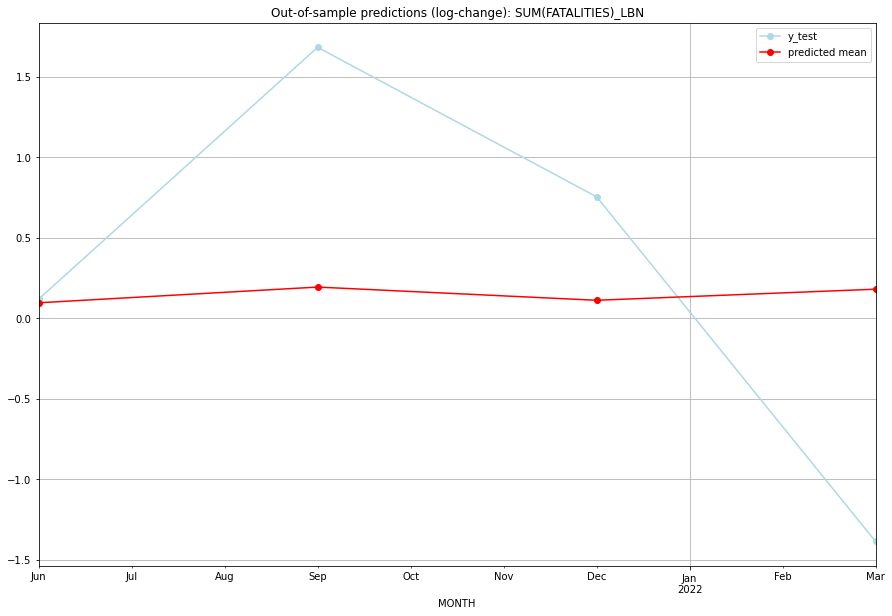

TADDA: 0.974927225754808
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  7.802770         8.0      0.095625        0.117783   LBN   
1 2021-07-01  8.705083        42.0      0.193208        1.681759   LBN   
2 2021-10-01  7.941340        16.0      0.111244        0.753772   LBN   
3 2022-01-01  8.578592         1.0      0.180089       -1.386294   LBN   

                                          PARAMETERS  
0  {'params': [3, (1, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (1, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (1, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (1, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## LBR (120/234) #########
0
Neighbor countries: ['CIV', 'GIN', 'SLE']
Getting Data for LBR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 79)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEA

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5134065333062019, 'fold_results': [0.9516656224425801, 0.5198603854199589, 0.17328679513998638, 0.5756462732485114, 0.34657359027997264]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBR   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -183.270
Date:                 Wed, 19 Oct 2022   AIC                            368.540
Time:                         10:48:01   BIC                            371.094
Sample:                     04-30-1997   HQIC                           369.572
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

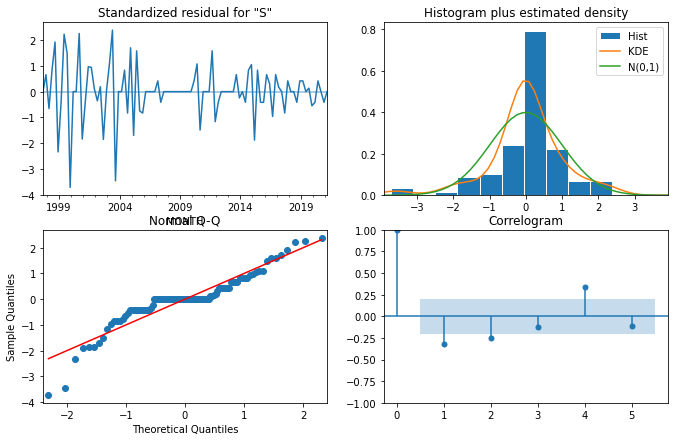

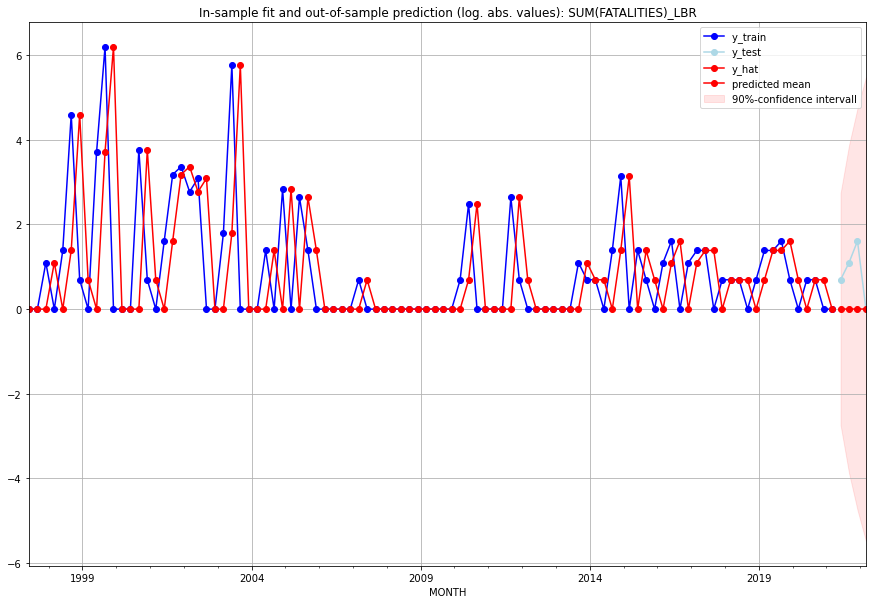

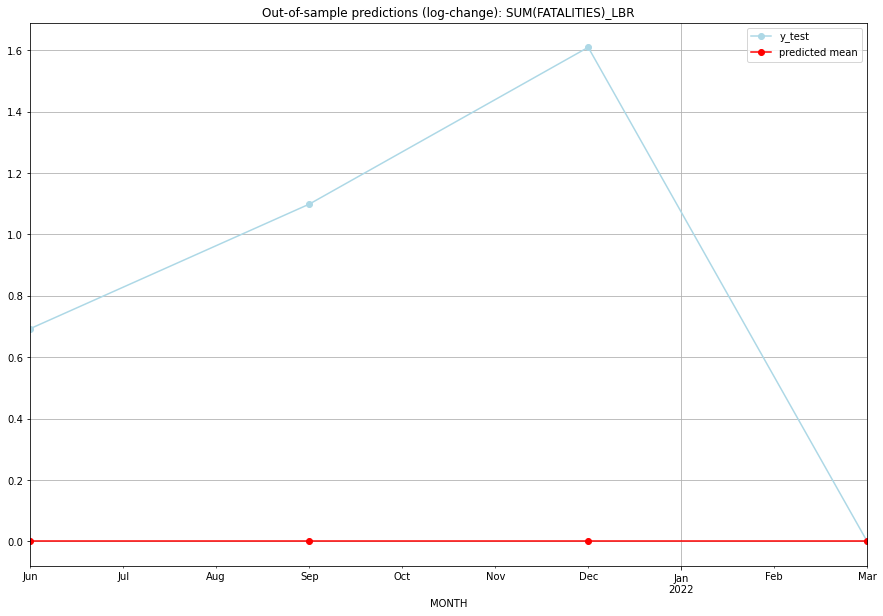

TADDA: 0.8502993454155389
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         1.0  1.232595e-32        0.693147   LBR   
1 2021-07-01       0.0         2.0  1.232595e-32        1.098612   LBR   
2 2021-10-01       0.0         4.0  1.232595e-32        1.609438   LBR   
3 2022-01-01       0.0         0.0  1.232595e-32        0.000000   LBR   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:25
######## LBY (121/234) #########
0
Neighbor countries: ['TUN', 'DZA', 'NER', 'TCD', 'EGY', 'SDN']
Getting Data for LBY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 98)
y: (100, 1)
------------------------------------------------
Training 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5935086081624213, 'fold_results': [0.46991902599054125, 0.3766333127634678, 0.1706218966368418, 0.4616875263705753, 1.4886812790506805]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBY   No. Observations:                   96
Model:                SARIMAX(1, 0, 1)   Log Likelihood                -153.848
Date:                 Wed, 19 Oct 2022   AIC                            319.697
Time:                         10:48:19   BIC                            335.083
Sample:                     04-30-1997   HQIC                           325.916
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

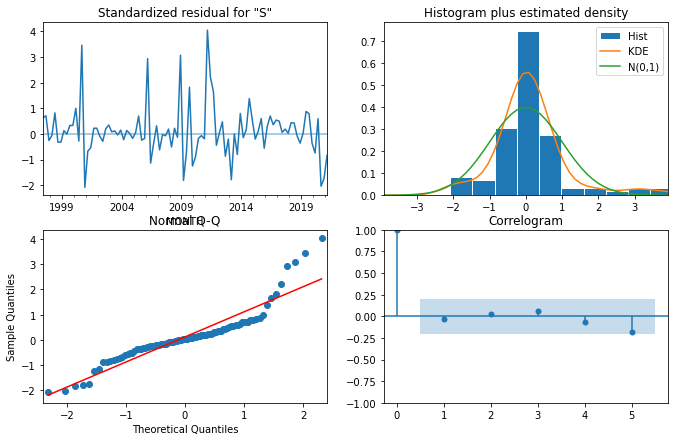

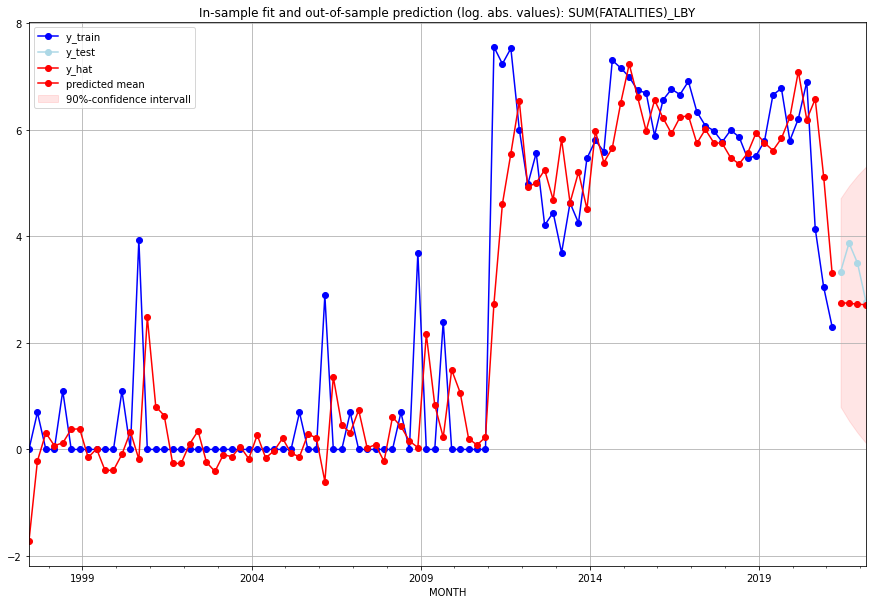

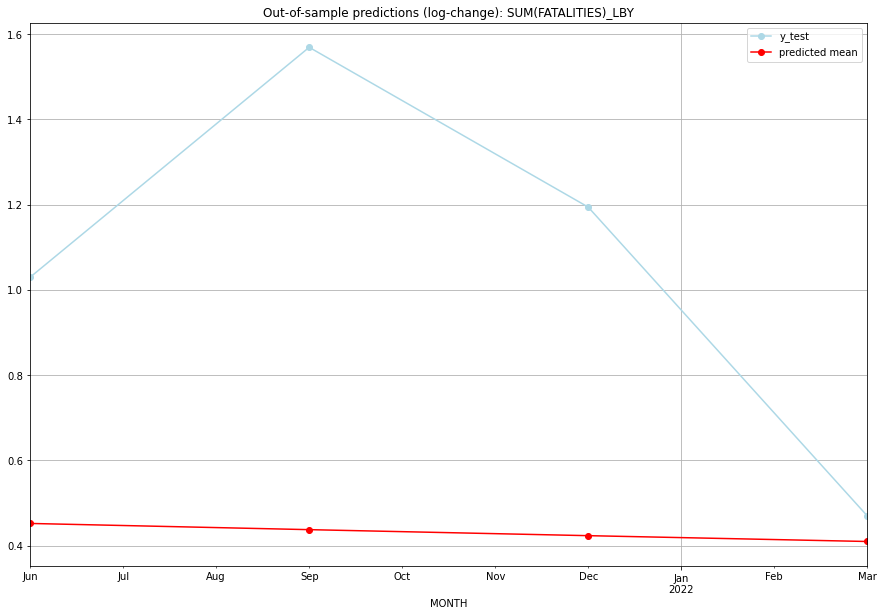

TADDA: 0.6348146652091916
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  14.716182        27.0      0.452106        1.029619   LBY   
1 2021-07-01  14.489120        47.0      0.437553        1.568616   LBY   
2 2021-10-01  14.272255        32.0      0.423453        1.193922   LBY   
3 2022-01-01  14.065038        15.0      0.409792        0.470004   LBY   

                                          PARAMETERS  
0  {'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## LCA (122/234) #########
0
Neighbor countries: []
Getting Data for LCA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 54)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV

<Figure size 432x288 with 0 Axes>

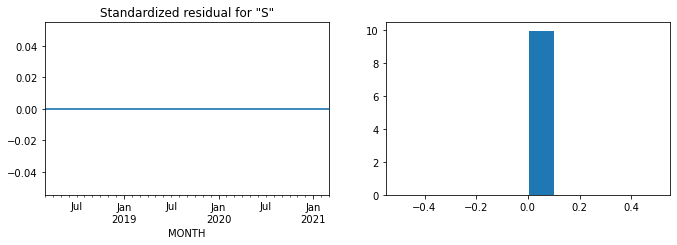

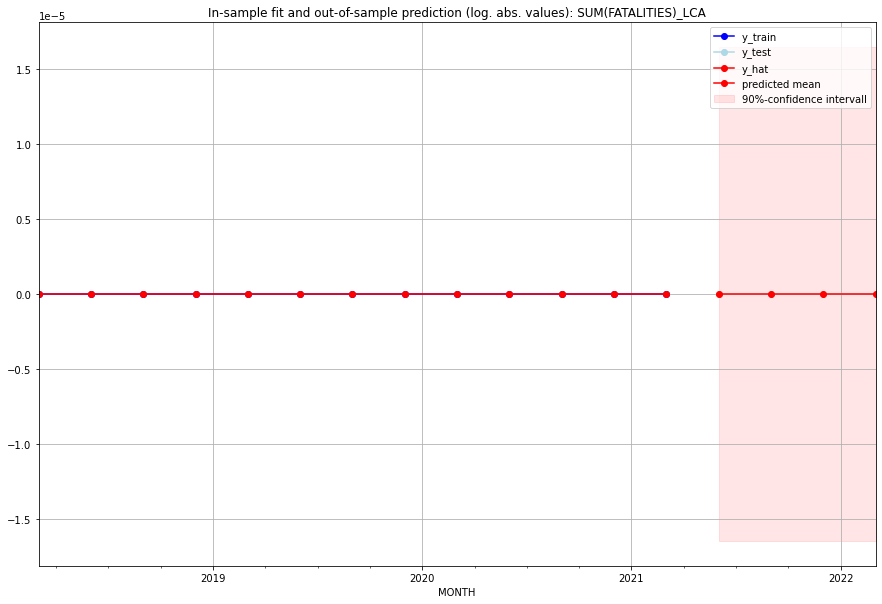

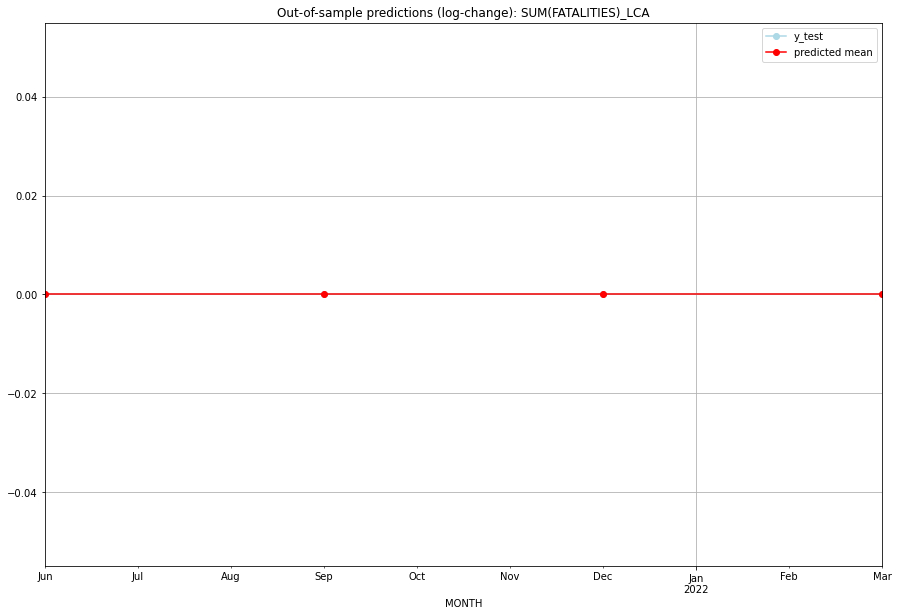

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LCA   
1 2021-07-01       0.0         0.0           0.0             0.0   LCA   
2 2021-10-01       0.0         0.0           0.0             0.0   LCA   
3 2022-01-01       0.0         0.0           0.0             0.0   LCA   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:01
######## LIE (123/234) #########
0
Neighbor countries: ['AUT', 'CHE']
Getting Data for LIE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 35)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


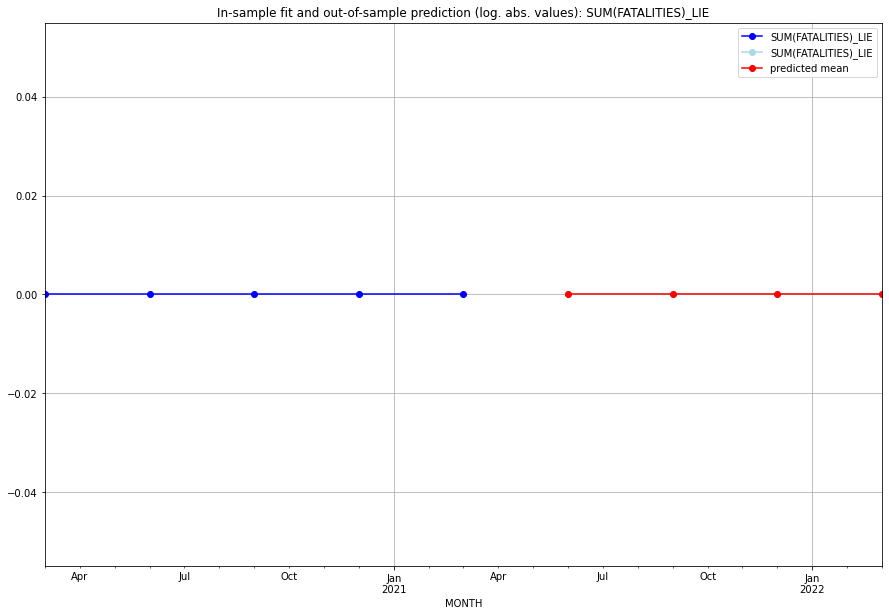

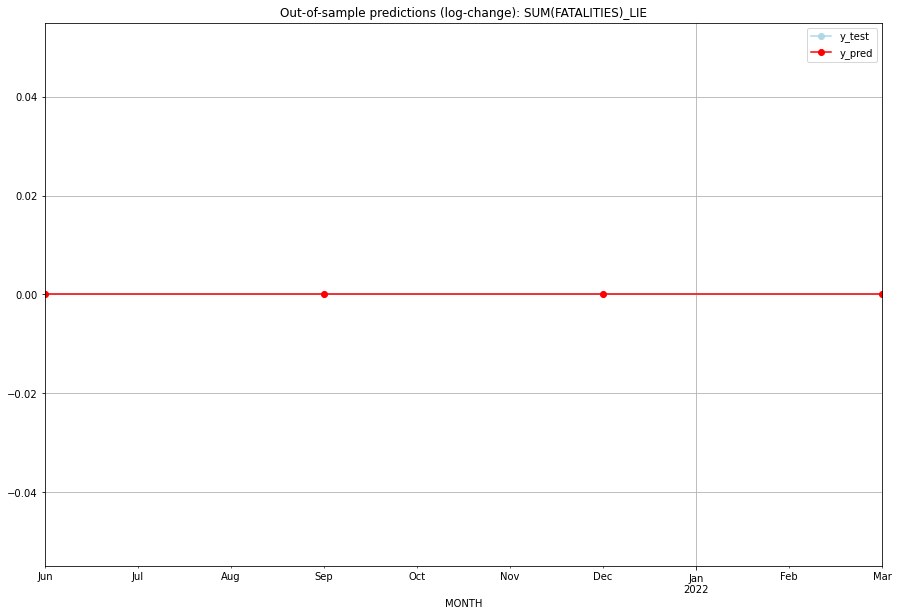

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LIE   
1 2021-07-01       0.0         0.0           0.0             0.0   LIE   
2 2021-10-01       0.0         0.0           0.0             0.0   LIE   
3 2022-01-01       0.0         0.0           0.0             0.0   LIE   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## LKA (124/234) #########
0
Neighbor countries: ['IND']
Getting Data for LKA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 70)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.8722262278517056, 'fold_results': [0.5454744351684062, 0.5508701364155768, 1.4220516700508434, 1.4770408729269198, 0.3656940246967814]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LKA   No. Observations:                   45
Model:                SARIMAX(3, 0, 1)   Log Likelihood                 -64.150
Date:                 Wed, 19 Oct 2022   AIC                            140.300
Time:                         10:48:48   BIC                            151.139
Sample:                     01-31-2010   HQIC                           144.341
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

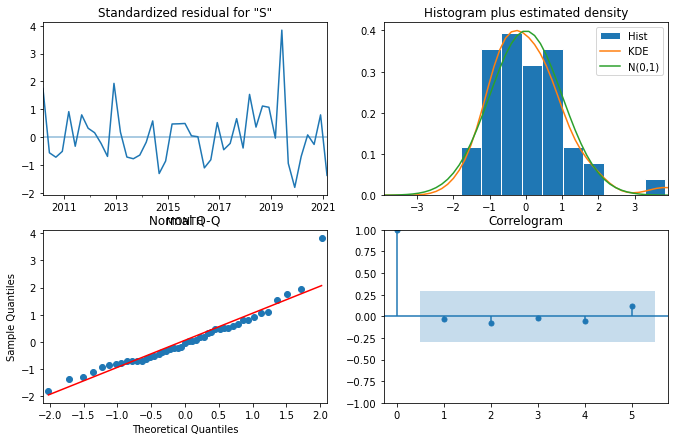

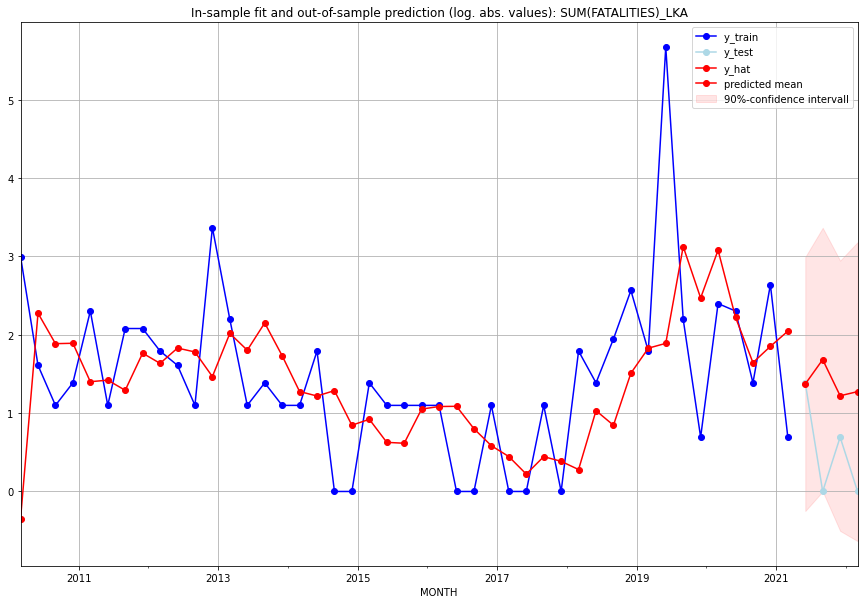

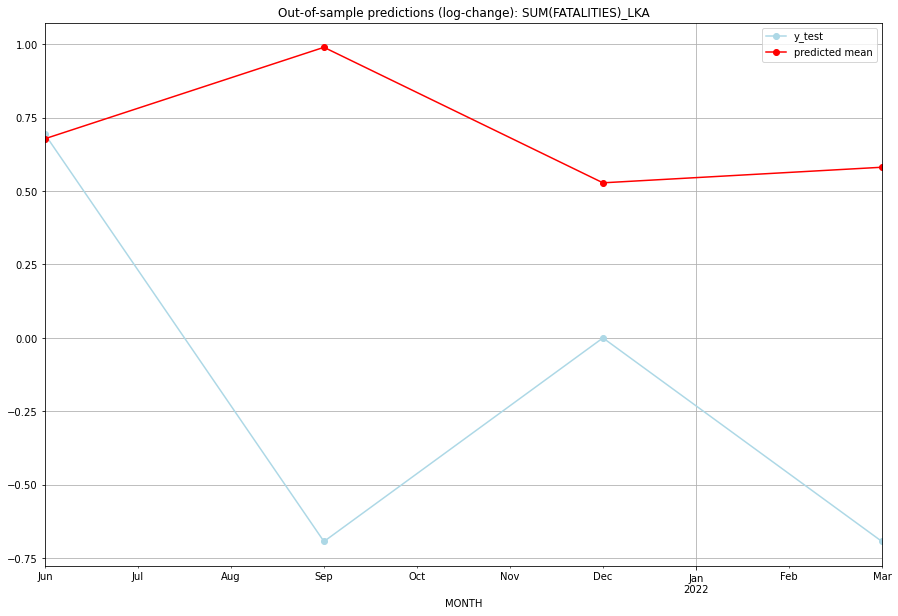

TADDA: 1.2676525562511987
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2.940727         3.0      0.678218        0.693147   LKA   
1 2021-07-01  4.379781         0.0      0.989500       -0.693147   LKA   
2 2021-10-01  2.391389         1.0      0.528092        0.000000   LKA   
3 2022-01-01  2.576175         0.0      0.581147       -0.693147   LKA   

                                          PARAMETERS  
0  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:23
######## LSO (125/234) #########
0
Neighbor countries: ['ZAF']
Getting Data for LSO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 69)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4844663081817725, 'fold_results': [0.5756462732485115, 0.5198603854199589, 0.0, 0.7225929394740412, 0.6042319427663505]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LSO   No. Observations:                   96
Model:                SARIMAX(1, 0, 0)   Log Likelihood                -120.059
Date:                 Wed, 19 Oct 2022   AIC                            246.117
Time:                         10:49:03   BIC                            253.810
Sample:                     04-30-1997   HQIC                           249.227
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

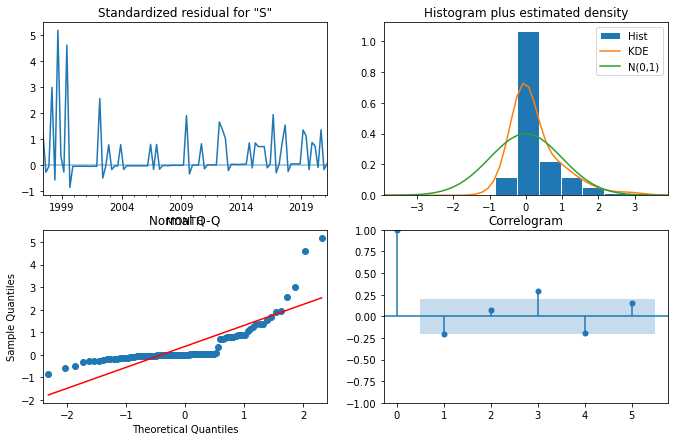

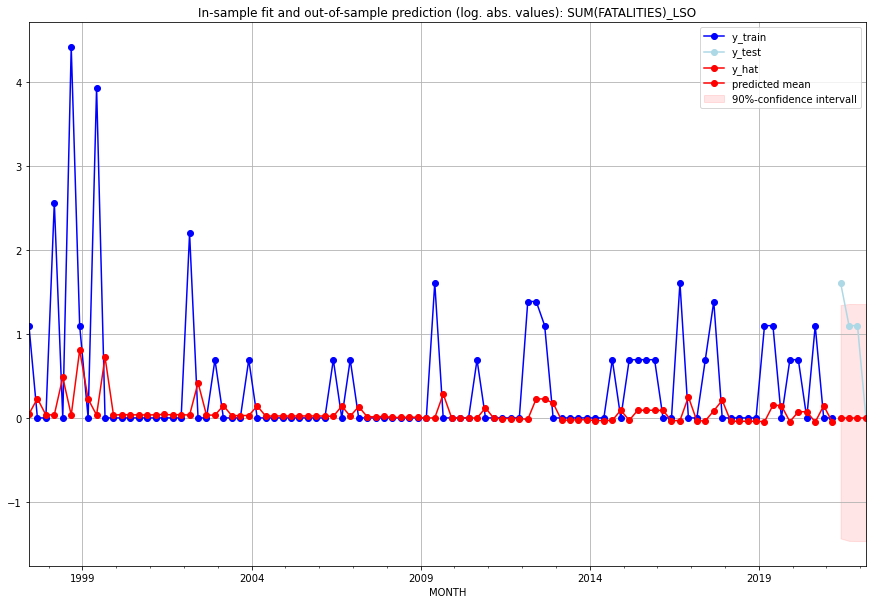

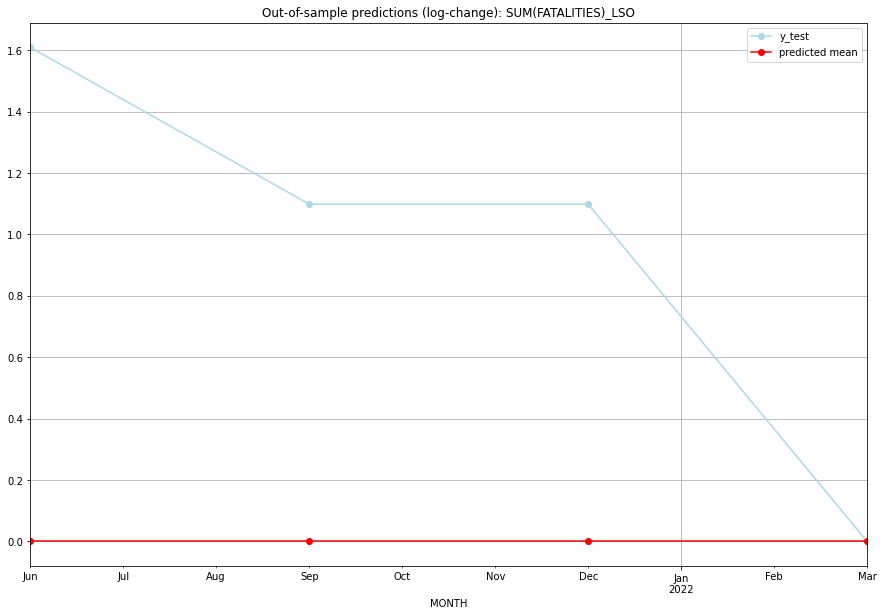

TADDA: 0.9516656224425801
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         4.0           0.0        1.609438   LSO   
1 2021-07-01       0.0         2.0           0.0        1.098612   LSO   
2 2021-10-01       0.0         2.0           0.0        1.098612   LSO   
3 2022-01-01       0.0         0.0           0.0        0.000000   LSO   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## LTU (126/234) #########
0
Neighbor countries: ['BLR', 'POL', 'LVA', 'RUS']
Getting Data for LTU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 93)
y: (9, 1)
------------------------------------------------
Training started.
GridSearc

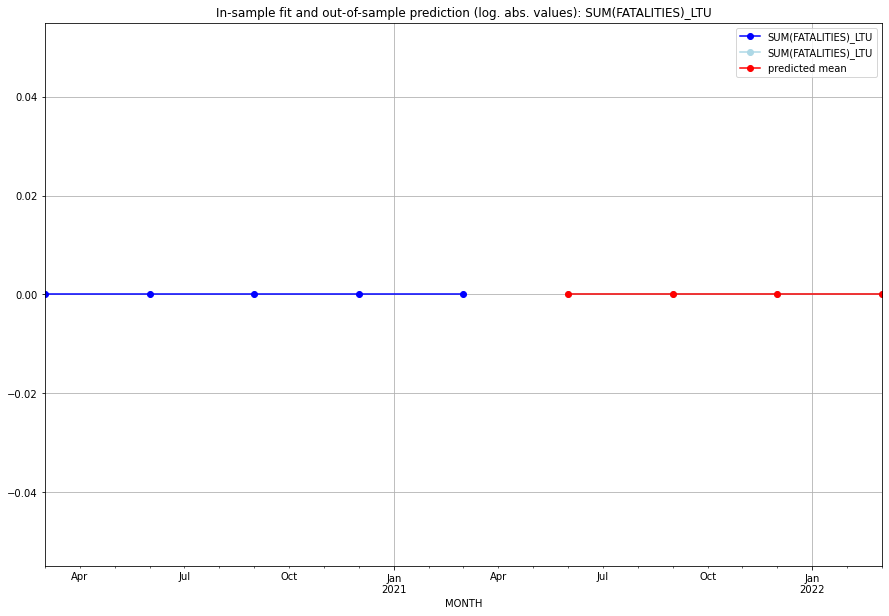

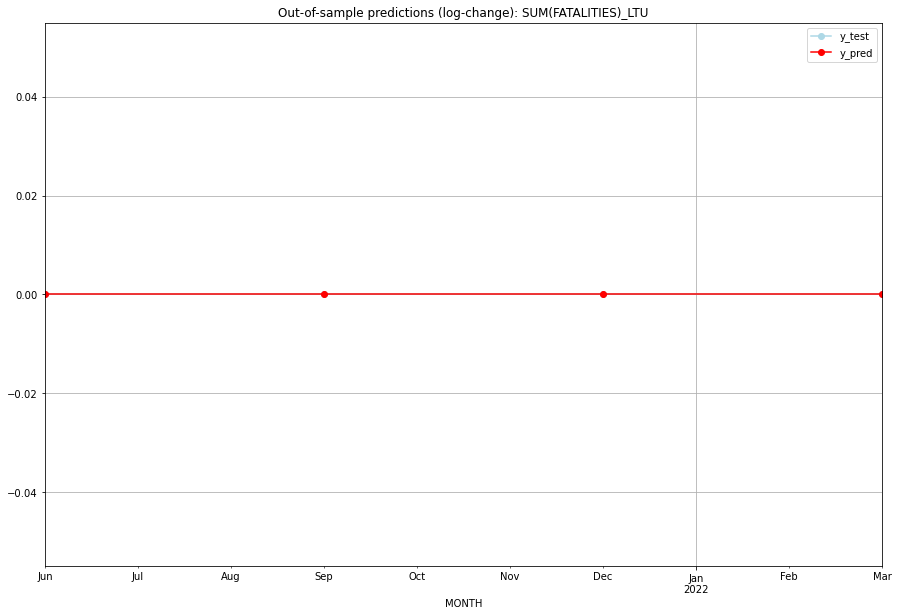

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LTU   
1 2021-07-01       0.0         0.0           0.0             0.0   LTU   
2 2021-10-01       0.0         0.0           0.0             0.0   LTU   
3 2022-01-01       0.0         0.0           0.0             0.0   LTU   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## LUX (127/234) #########
0
Neighbor countries: ['BEL', 'DEU', 'FRA']
Getting Data for LUX
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 89)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


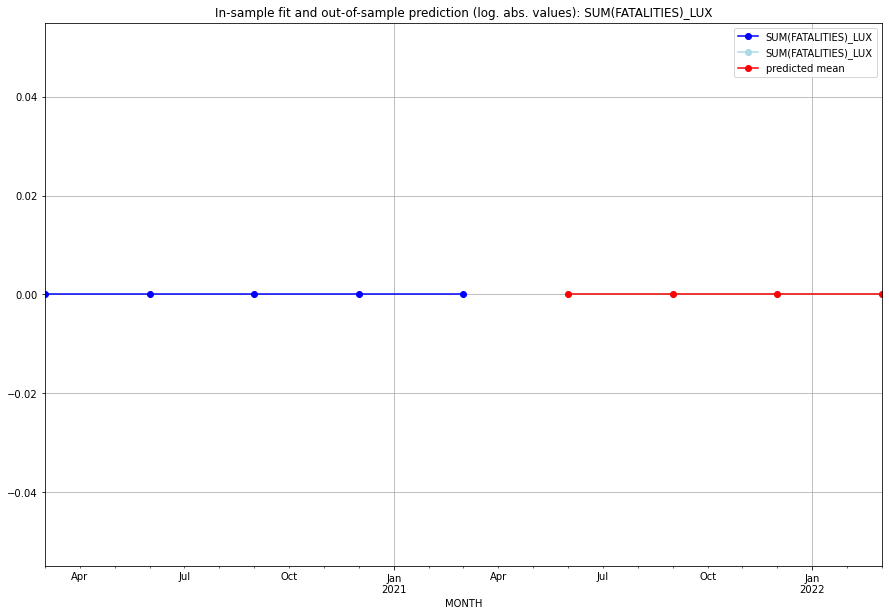

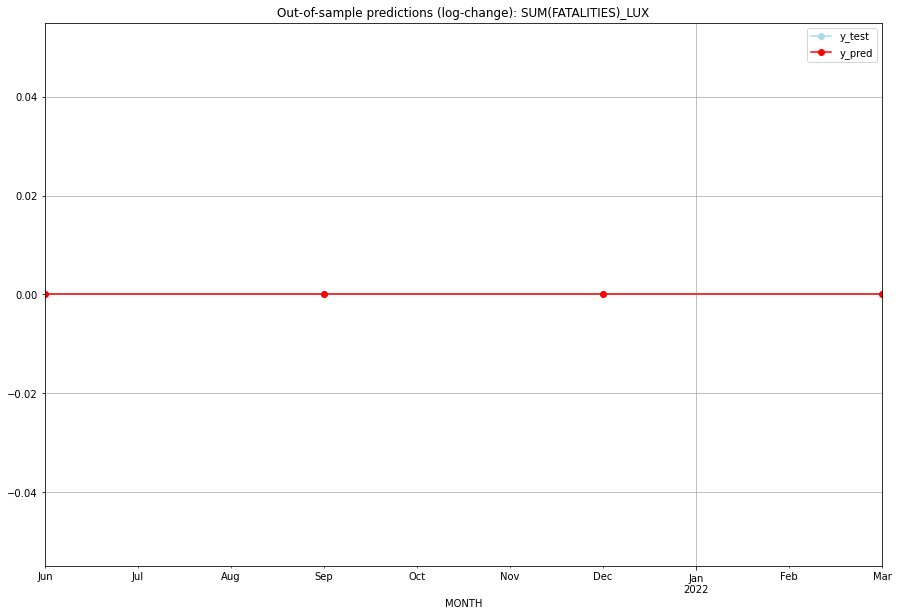

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LUX   
1 2021-07-01       0.0         0.0           0.0             0.0   LUX   
2 2021-10-01       0.0         0.0           0.0             0.0   LUX   
3 2022-01-01       0.0         0.0           0.0             0.0   LUX   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## LVA (128/234) #########
0
Neighbor countries: ['LTU', 'BLR', 'RUS', 'EST']
Getting Data for LVA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 96)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


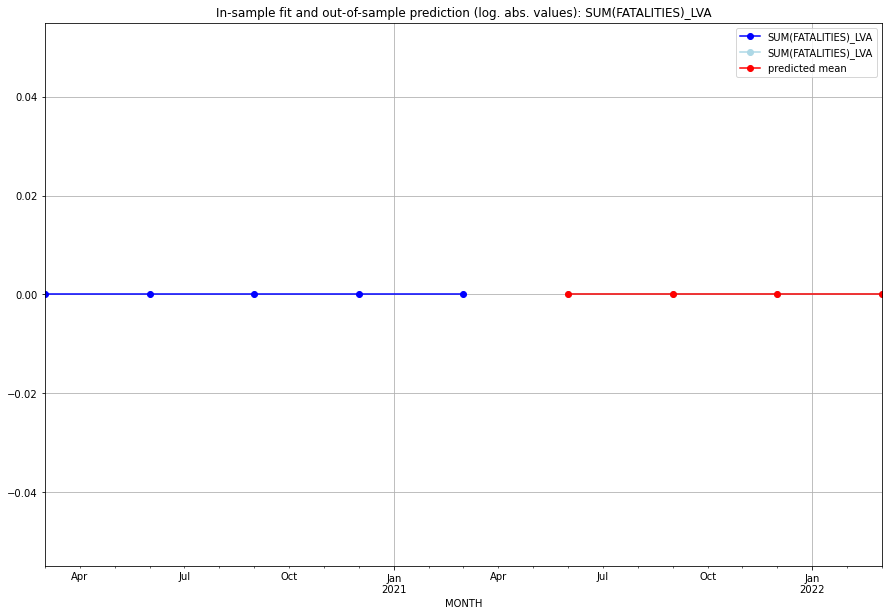

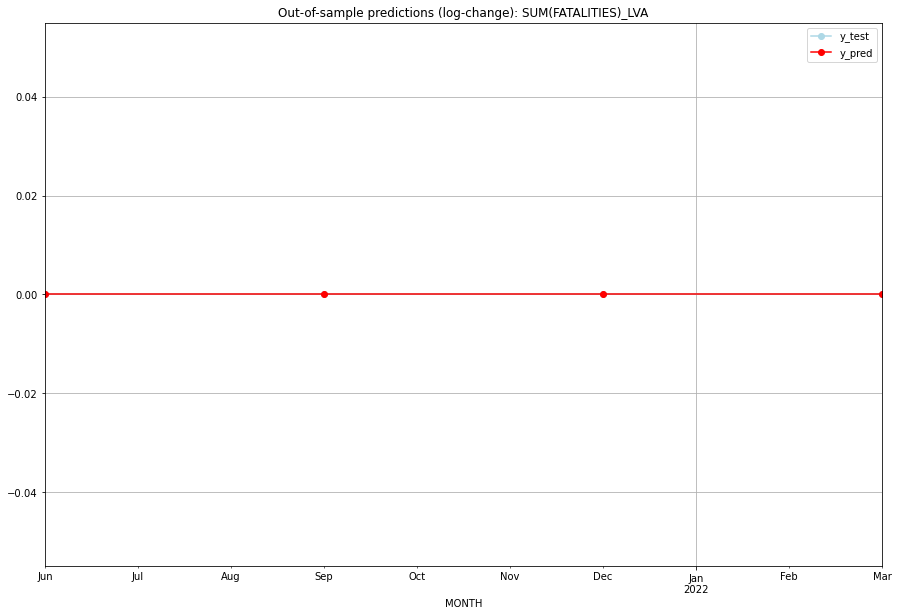

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LVA   
1 2021-07-01       0.0         0.0           0.0             0.0   LVA   
2 2021-10-01       0.0         0.0           0.0             0.0   LVA   
3 2022-01-01       0.0         0.0           0.0             0.0   LVA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## MAC (129/234) #########
0
Neighbor countries: ['CHN']
Getting Data for MAC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 52)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MAC   No. Observations:                   13


<Figure size 432x288 with 0 Axes>

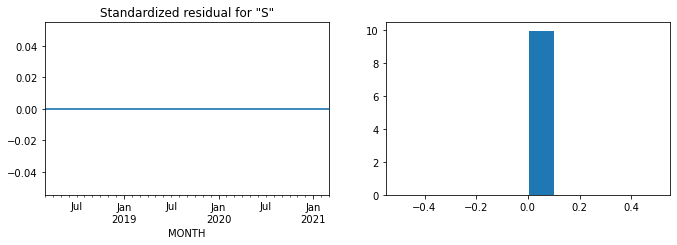

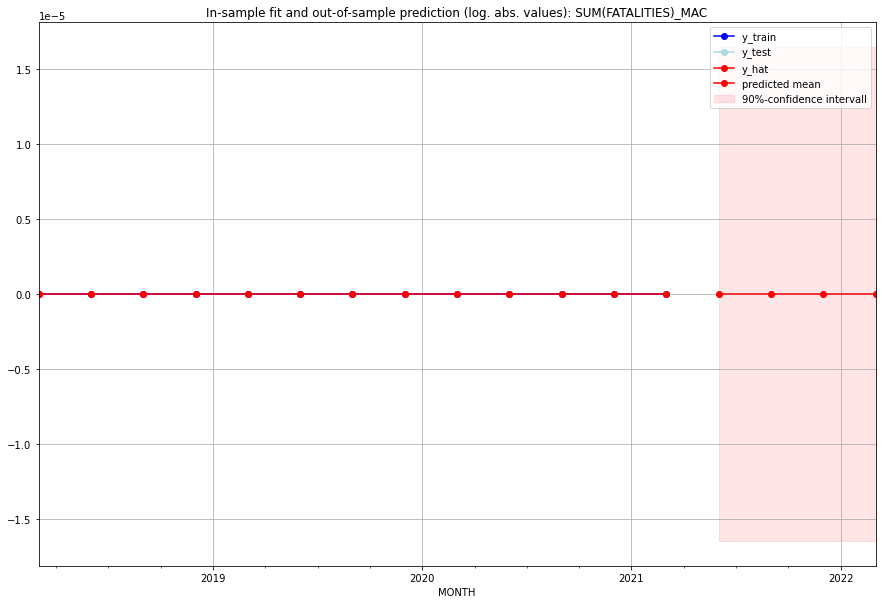

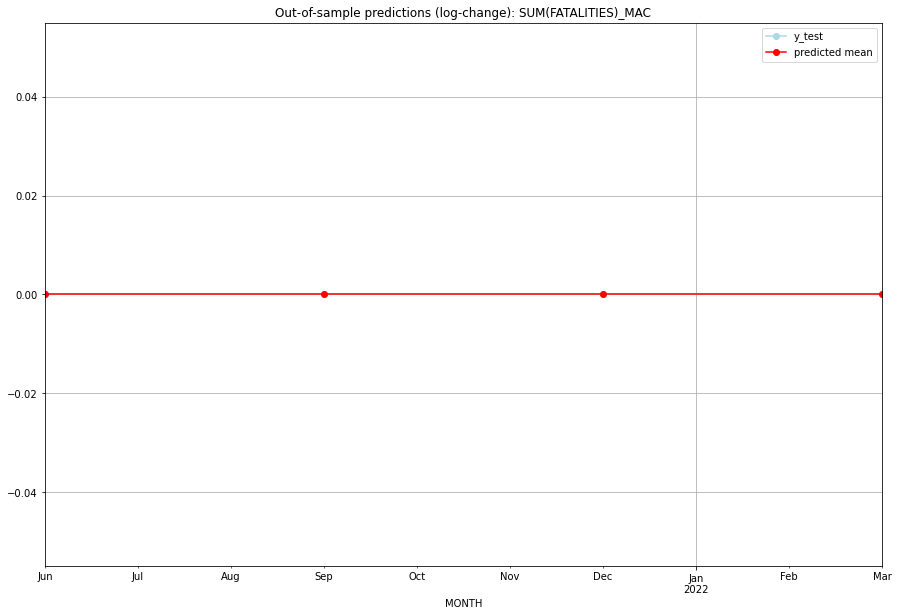

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MAC   
1 2021-07-01       0.0         0.0           0.0             0.0   MAC   
2 2021-10-01       0.0         0.0           0.0             0.0   MAC   
3 2022-01-01       0.0         0.0           0.0             0.0   MAC   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:05
######## MAR (130/234) #########
0
Neighbor countries: ['DZA', 'ESP', 'ESH']
Getting Data for MAR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 87)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4329346376844968, 'fold_results': [0.34657359027997264, 0.5198603854199589, 0.8502993454155389, 0.44793986730701374, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MAR   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                -114.279
Date:                 Wed, 19 Oct 2022   AIC                            230.558
Time:                         10:49:36   BIC                            233.122
Sample:                     04-30-1997   HQIC                           231.594
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

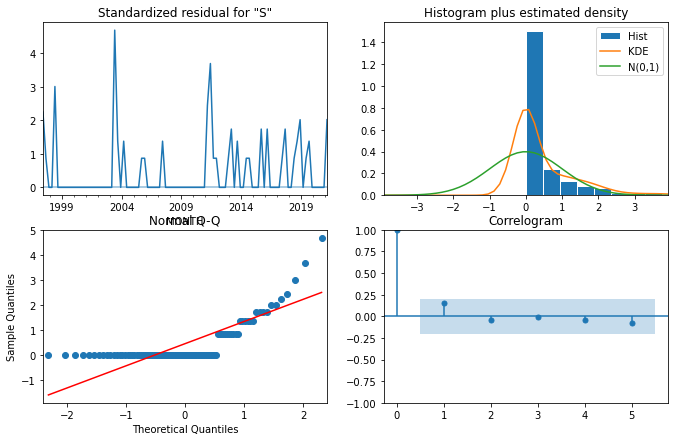

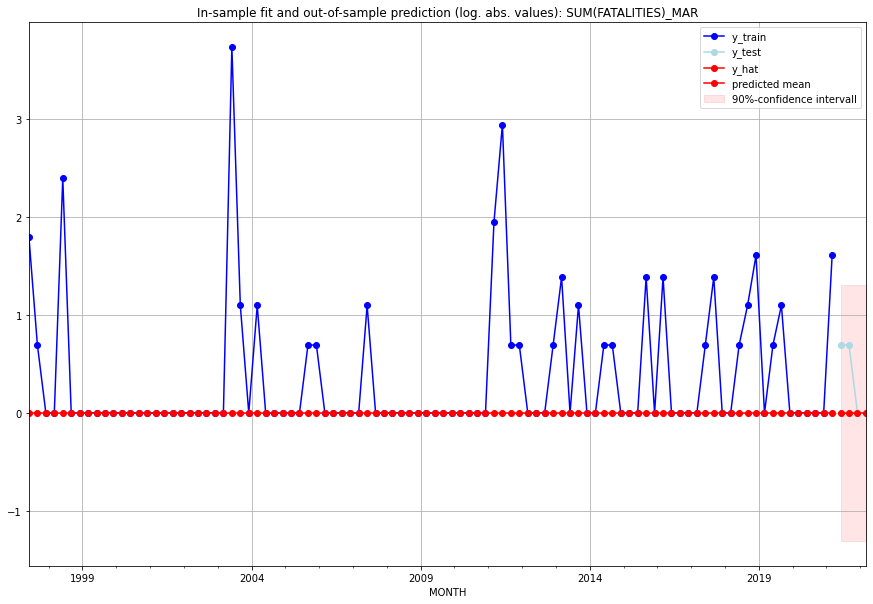

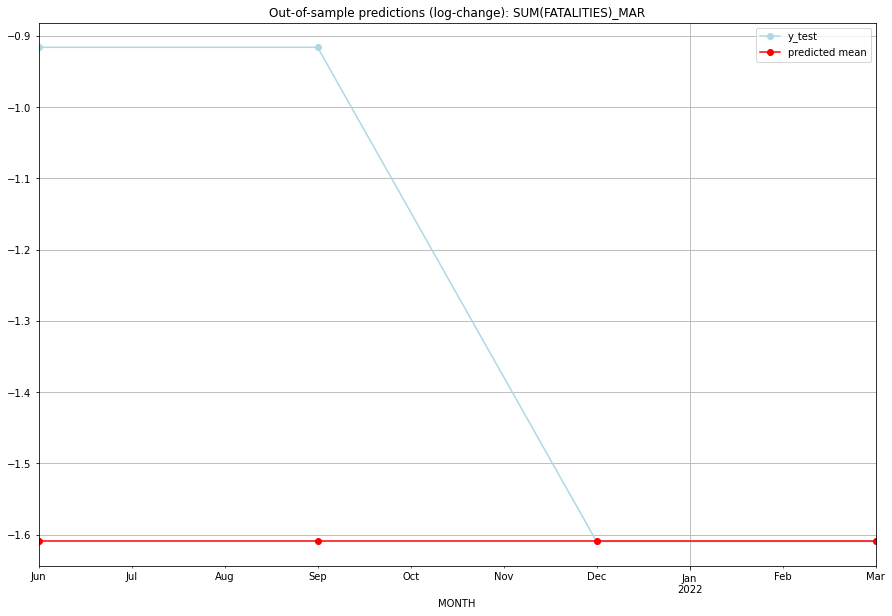

TADDA: 0.34657359027997264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         1.0     -1.609438       -0.916291   MAR   
1 2021-07-01       0.0         1.0     -1.609438       -0.916291   MAR   
2 2021-10-01       0.0         0.0     -1.609438       -1.609438   MAR   
3 2022-01-01       0.0         0.0     -1.609438       -1.609438   MAR   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:26
######## MCO (131/234) #########
0
Neighbor countries: ['FRA']
Getting Data for MCO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 23)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insuffic

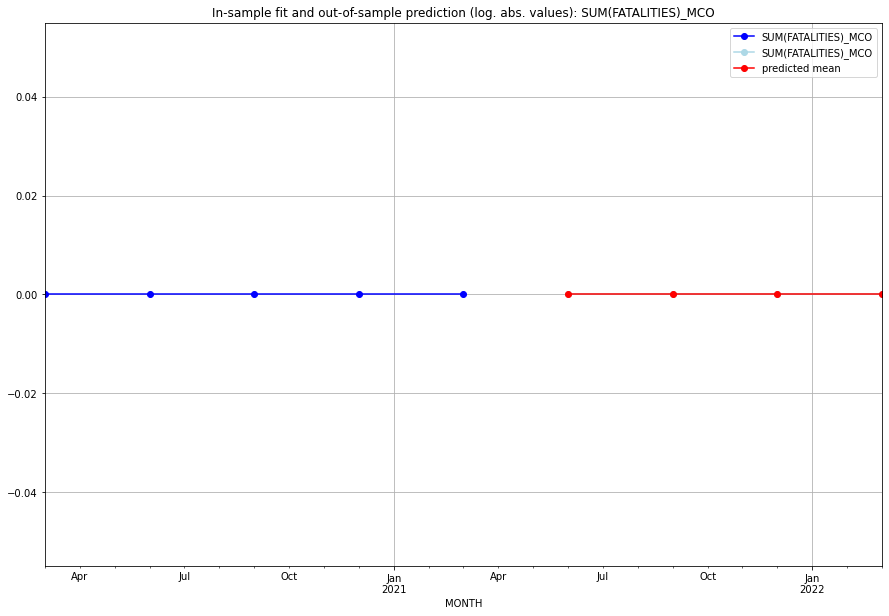

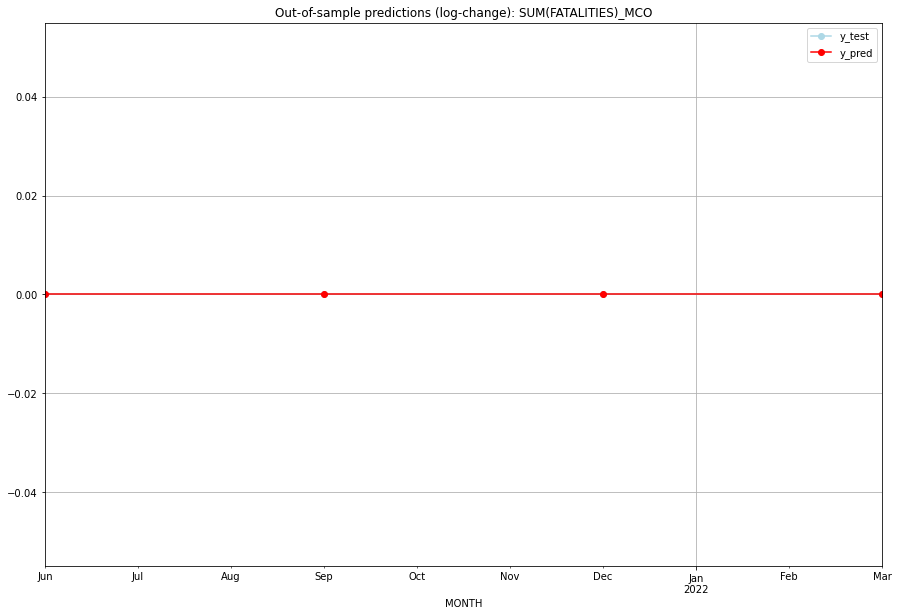

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MCO   
1 2021-07-01       0.0         0.0           0.0             0.0   MCO   
2 2021-10-01       0.0         0.0           0.0             0.0   MCO   
3 2022-01-01       0.0         0.0           0.0             0.0   MCO   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## MDA (132/234) #########
0
Neighbor countries: ['UKR', 'ROU']
Getting Data for MDA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 78)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MDA   No. Observations:               

<Figure size 432x288 with 0 Axes>

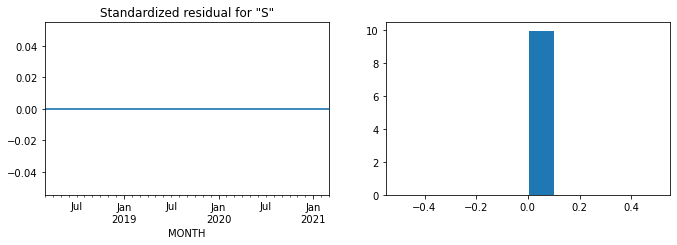

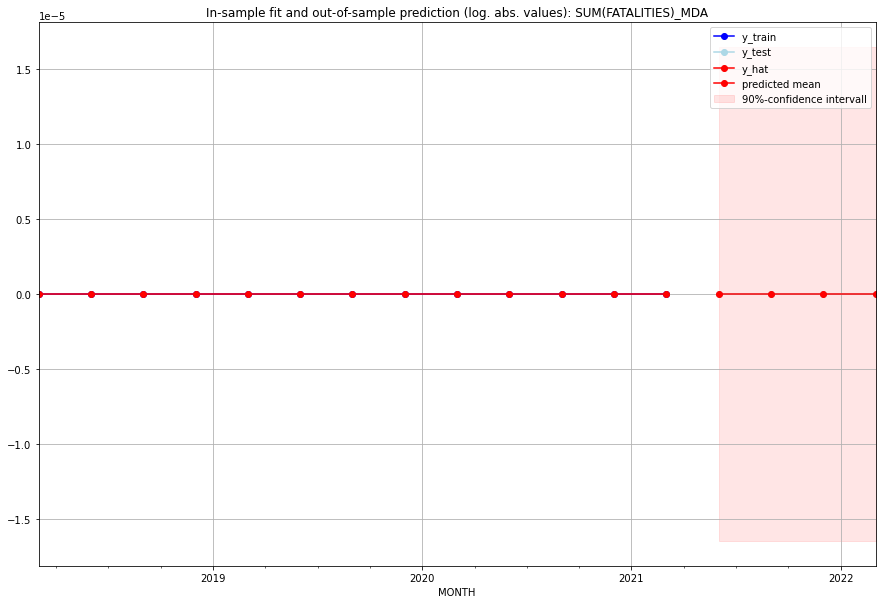

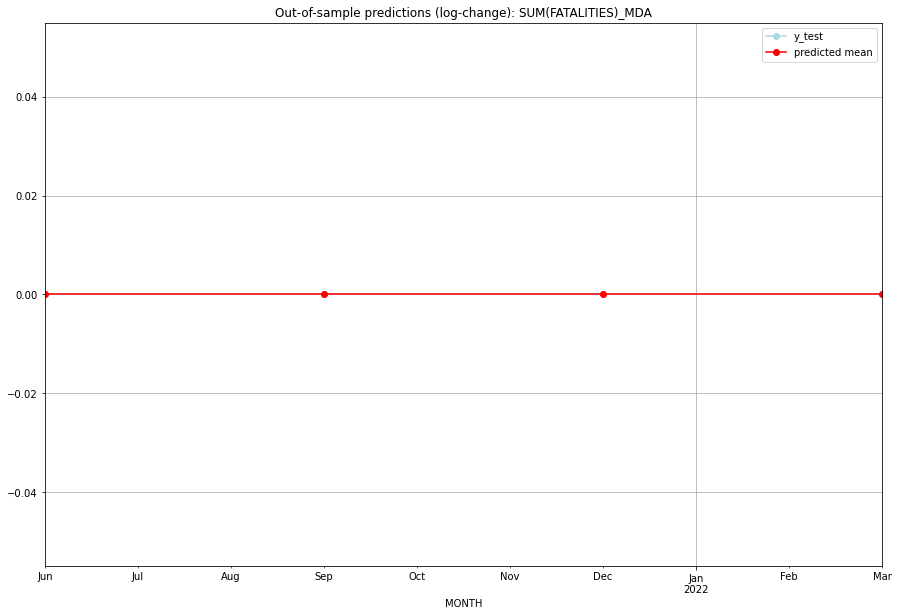

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MDA   
1 2021-07-01       0.0         0.0           0.0             0.0   MDA   
2 2021-10-01       0.0         0.0           0.0             0.0   MDA   
3 2022-01-01       0.0         0.0           0.0             0.0   MDA   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## MDG (133/234) #########
0
Neighbor countries: []
Getting Data for MDG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.40895855057820396, 'fold_results': [0.6548923296861379, 0.3060275865624794, 0.23193834764247712, 0.5391648461330554, 0.31276964286687026]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MDG   No. Observations:                   96
Model:                SARIMAX(3, 1, 2)   Log Likelihood                -135.032
Date:                 Wed, 19 Oct 2022   AIC                            288.064
Time:                         10:50:04   BIC                            311.049
Sample:                     04-30-1997   HQIC                           297.351
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

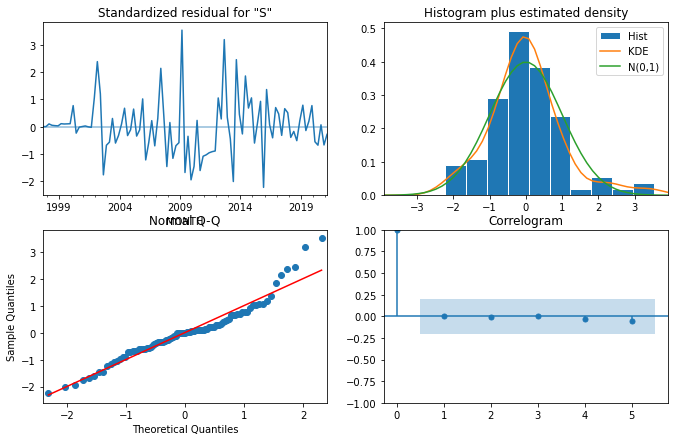

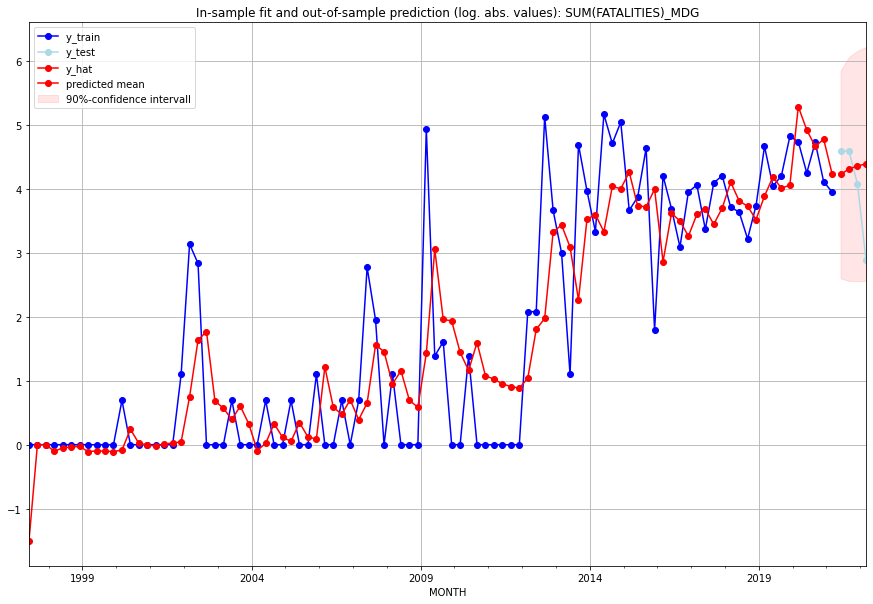

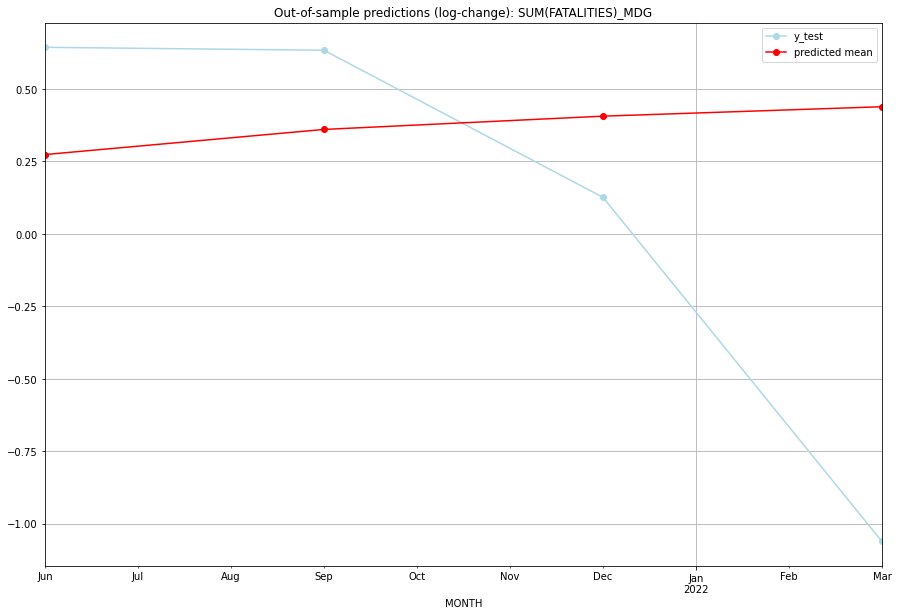

TADDA: 0.7154598250552755
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  67.385154        98.0      0.273912        0.643876   MDG   
1 2021-07-01  73.574418        97.0      0.360554        0.633724   MDG   
2 2021-10-01  77.066677        58.0      0.406320        0.126294   MDG   
3 2022-01-01  79.652309        17.0      0.438904       -1.060872   MDG   

                                          PARAMETERS  
0  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## MDV (134/234) #########
0
Neighbor countries: []
Getting Data for MDV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 55)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insuffici

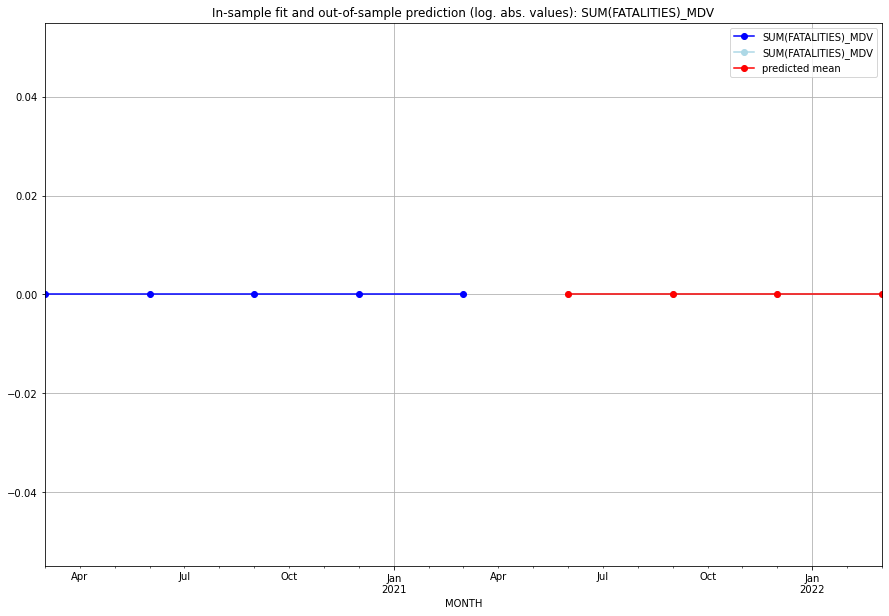

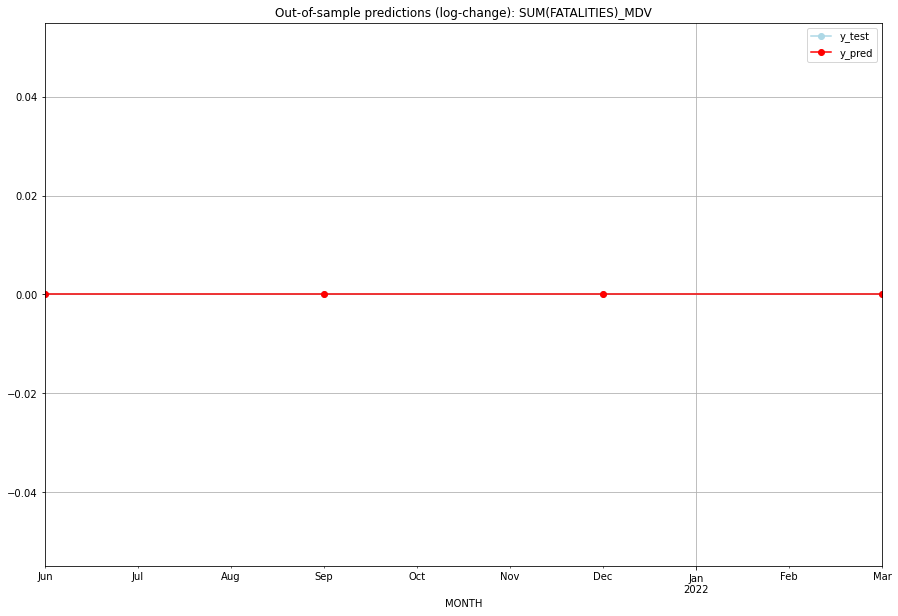

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MDV   
1 2021-07-01       0.0         0.0           0.0             0.0   MDV   
2 2021-10-01       0.0         0.0           0.0             0.0   MDV   
3 2022-01-01       0.0         0.0           0.0             0.0   MDV   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## MEX (135/234) #########
0
Neighbor countries: ['USA', 'BLZ', 'GTM']
Getting Data for MEX
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 89)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08078455717628019, 'fold_results': [nan, 0.08078455717628019]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MEX   No. Observations:                   13
Model:                SARIMAX(3, 0, 0)   Log Likelihood                   7.030
Date:                 Wed, 19 Oct 2022   AIC                             -4.061
Time:                         10:50:22   BIC                             -1.236
Sample:                     01-31-2018   HQIC                            -4.641
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0011      0.011     -0.10

<Figure size 432x288 with 0 Axes>

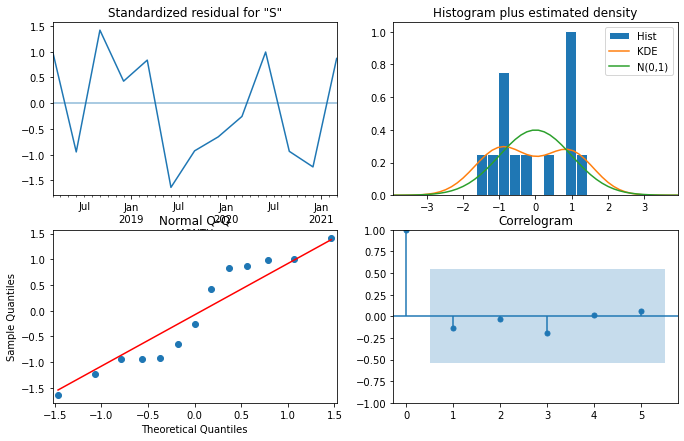

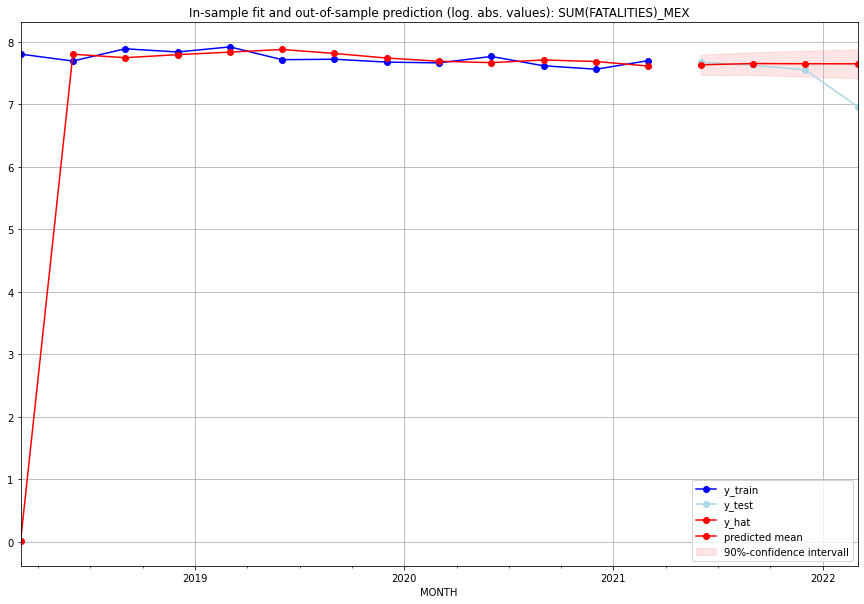

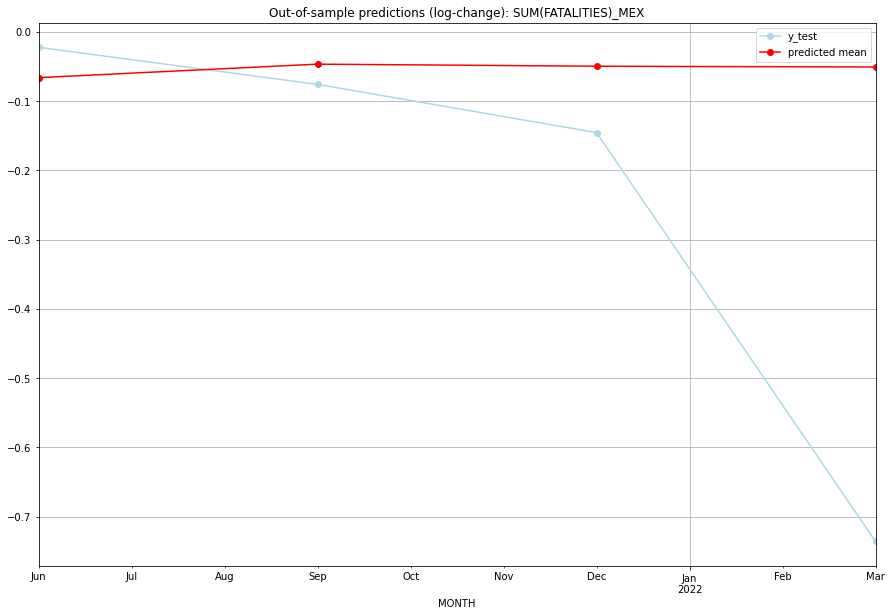

TADDA: 0.21345238643097764
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2055.918083      2148.0     -0.066339       -0.022545   MEX   
1 2021-07-01  2096.387860      2036.0     -0.046855       -0.076070   MEX   
2 2021-10-01  2090.112439      1899.0     -0.049852       -0.145694   MEX   
3 2022-01-01  2087.825789      1052.0     -0.050946       -0.735905   MEX   

                                          PARAMETERS  
0  {'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## MKD (136/234) #########
0
Neighbor countries: ['ALB', 'XKO', 'BGR', 'GRC', 'SRB']
Getting Data for MKD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 102)
y: (17, 1)
------------------------------------------------
T

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MKD   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:50:40   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.245      0.000       0.025       0

<Figure size 432x288 with 0 Axes>

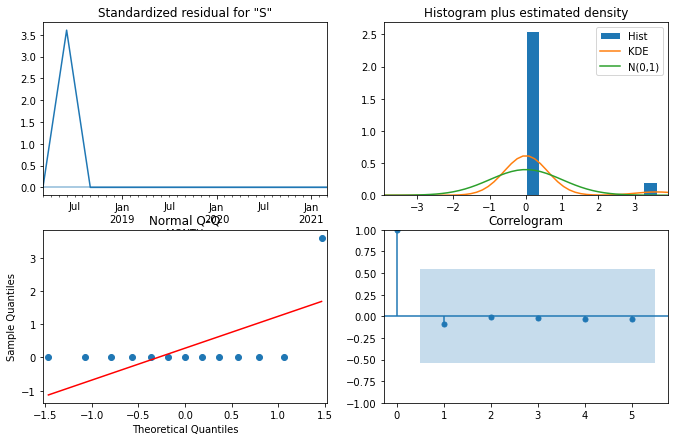

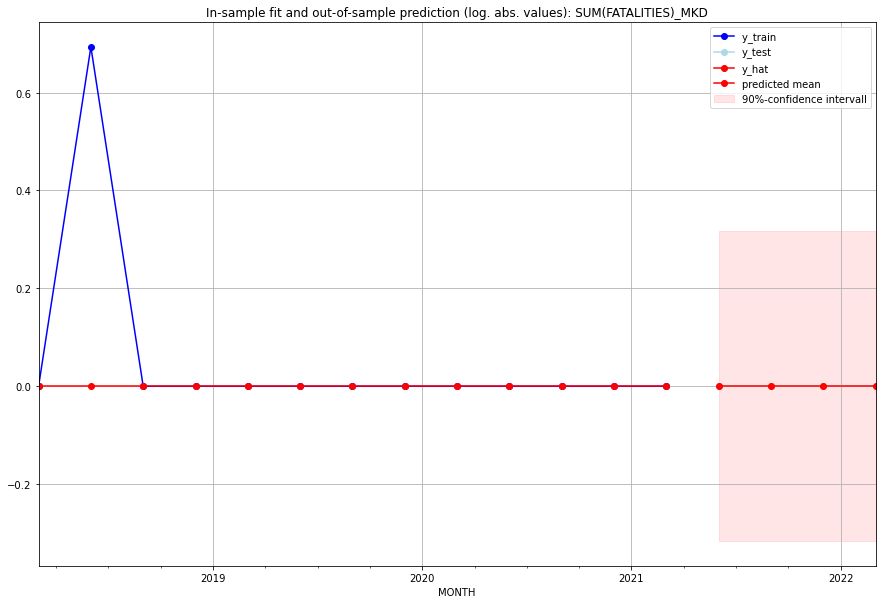

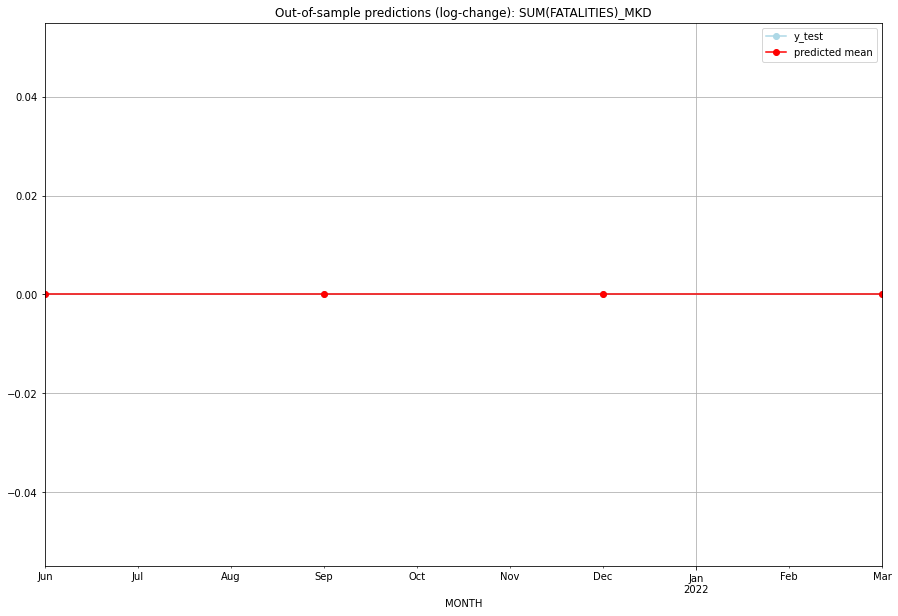

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MKD   
1 2021-07-01       0.0         0.0           0.0             0.0   MKD   
2 2021-10-01       0.0         0.0           0.0             0.0   MKD   
3 2022-01-01       0.0         0.0           0.0             0.0   MKD   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## MLI (137/234) #########
0
Neighbor countries: ['NER', 'GIN', 'MRT', 'SEN', 'BFA', 'CIV', 'DZA']
Getting Data for MLI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 117)
y: (100, 1)
------------------------------------------------
Training started

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5752259569357879, 'fold_results': [0.33012554616390677, 1.0198335636514622, 0.7117067491805988, 0.22545909372759199, 0.5890048319553798]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MLI   No. Observations:                   96
Model:                SARIMAX(3, 1, 0)   Log Likelihood                -152.838
Date:                 Wed, 19 Oct 2022   AIC                            313.676
Time:                         10:50:56   BIC                            323.891
Sample:                     04-30-1997   HQIC                           317.804
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

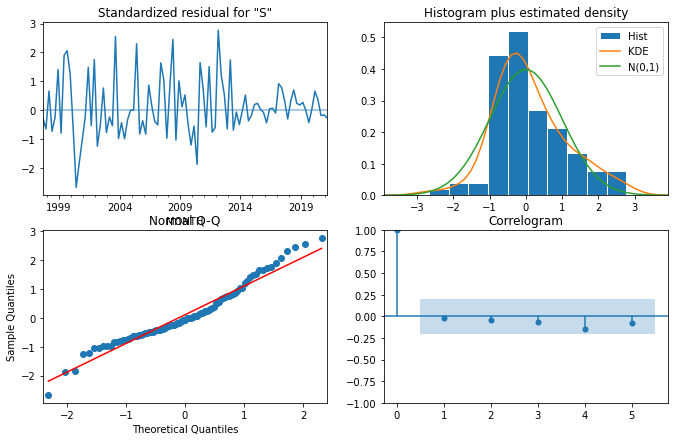

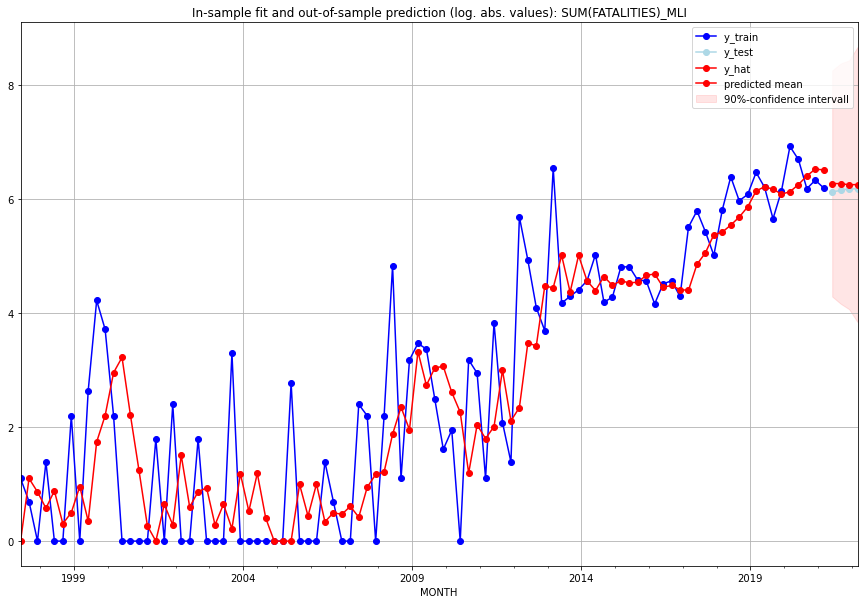

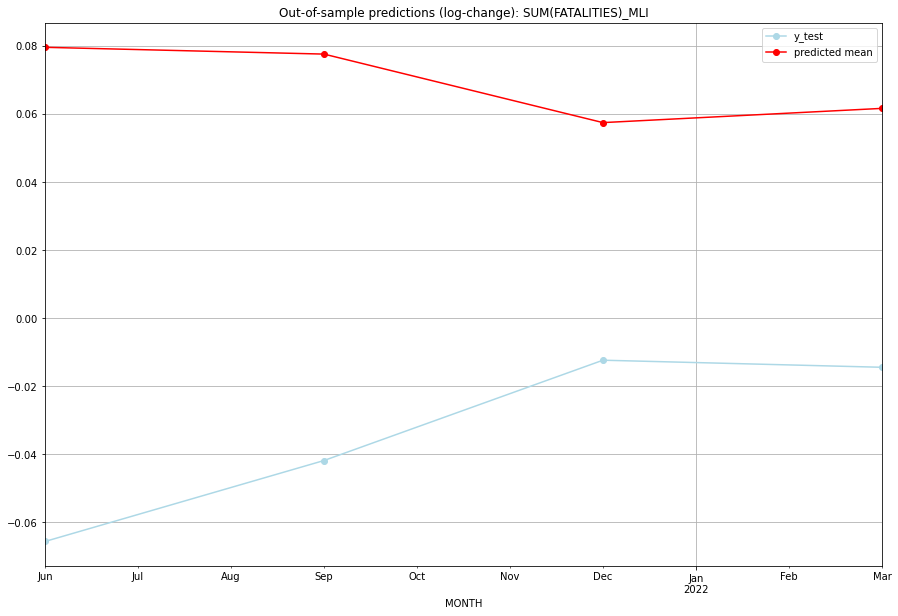

TADDA: 0.17166034776672645
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  527.410111       456.0      0.079557       -0.065632   MLI   
1 2021-07-01  526.357986       467.0      0.077564       -0.041847   MLI   
2 2021-10-01  515.849086       481.0      0.057436       -0.012371   MLI   
3 2022-01-01  518.013450       480.0      0.061614       -0.014448   MLI   

                                          PARAMETERS  
0  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## MLT (138/234) #########
0
Neighbor countries: []
Getting Data for MLT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Ins

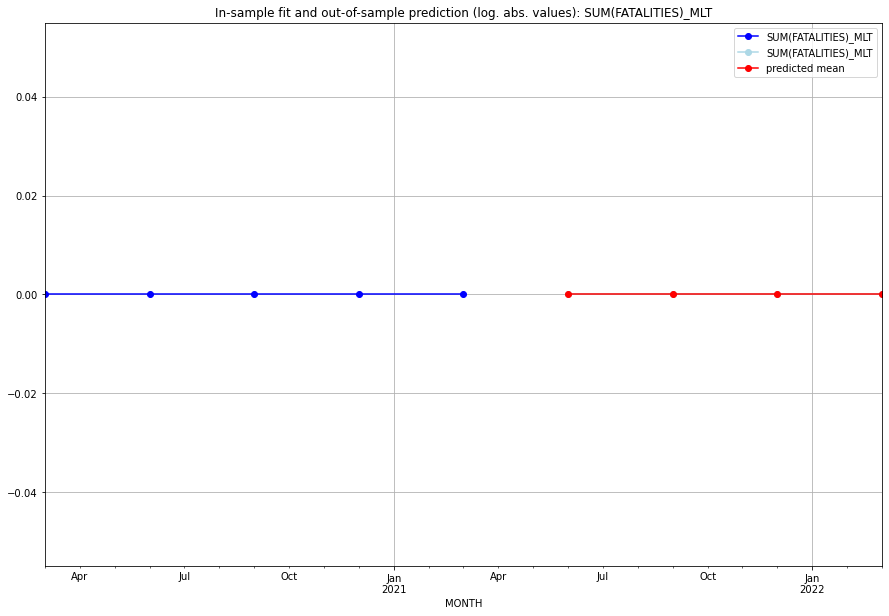

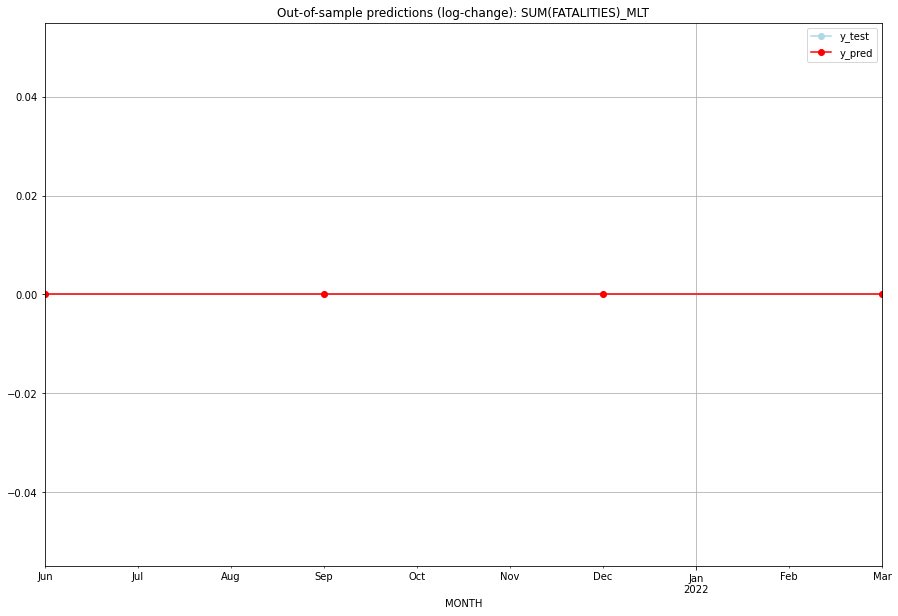

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MLT   
1 2021-07-01       0.0         0.0           0.0             0.0   MLT   
2 2021-10-01       0.0         0.0           0.0             0.0   MLT   
3 2022-01-01       0.0         0.0           0.0             0.0   MLT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:05
######## MMR (139/234) #########
0
Neighbor countries: ['BGD', 'IND', 'CHN', 'LAO', 'THA']
Getting Data for MMR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 101)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8382573915454709, 'fold_results': [0.58848334258273, 1.3170815354506846, 0.21020633647039644, 1.5155939581051991, 0.559921785118344]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MMR   No. Observations:                   45
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -63.029
Date:                 Wed, 19 Oct 2022   AIC                            128.058
Time:                         10:51:19   BIC                            129.842
Sample:                     01-31-2010   HQIC                           128.720
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

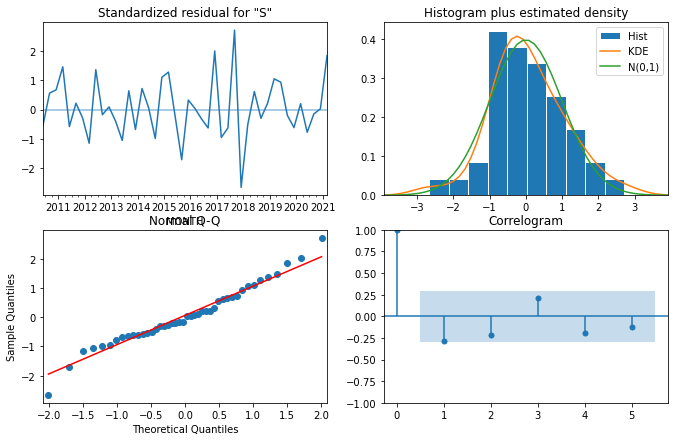

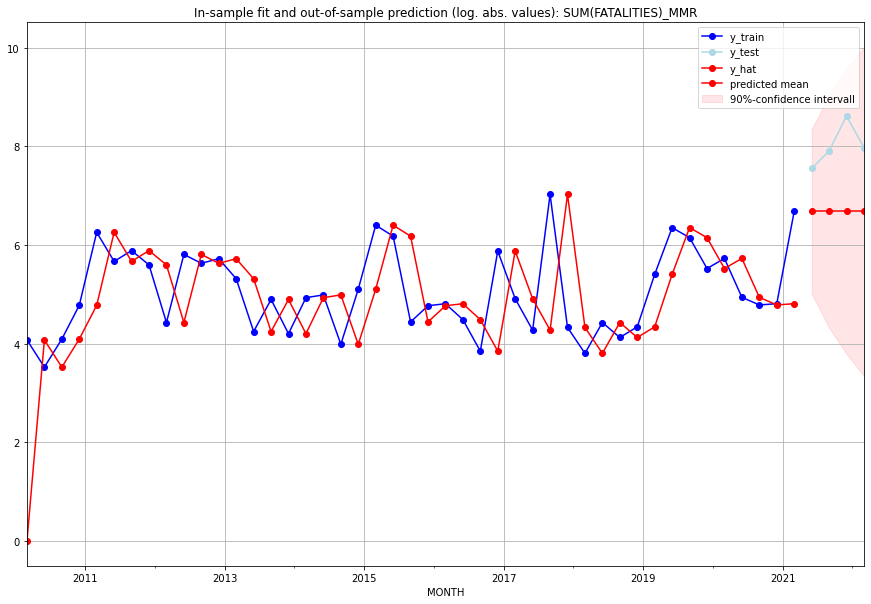

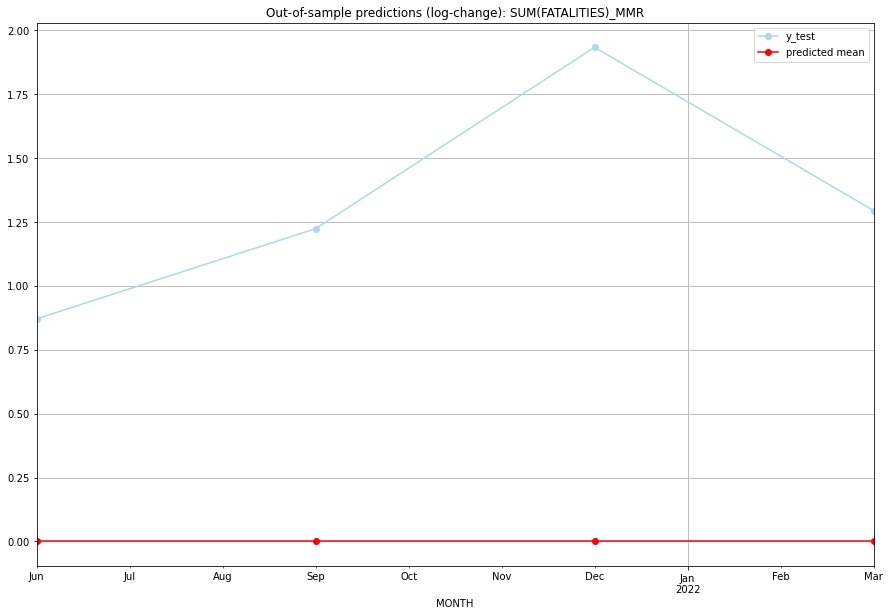

TADDA: 1.3305675037394713
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     798.0      1908.0           0.0        0.870974   MMR   
1 2021-07-01     798.0      2715.0           0.0        1.223555   MMR   
2 2021-10-01     798.0      5521.0           0.0        1.933134   MMR   
3 2022-01-01     798.0      2915.0           0.0        1.294607   MMR   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## MNE (140/234) #########
0
Neighbor countries: ['BIH', 'ALB', 'XKO', 'SRB', 'HRV']
Getting Data for MNE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 100)
y: (17, 1)
------------------------------------------------
Training started.

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MNE   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                  -2.997
Date:                 Wed, 19 Oct 2022   AIC                              7.993
Time:                         10:51:32   BIC                              8.558
Sample:                     01-31-2018   HQIC                             7.877
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0928      0.015      6.245      0.000       0.064       0

<Figure size 432x288 with 0 Axes>

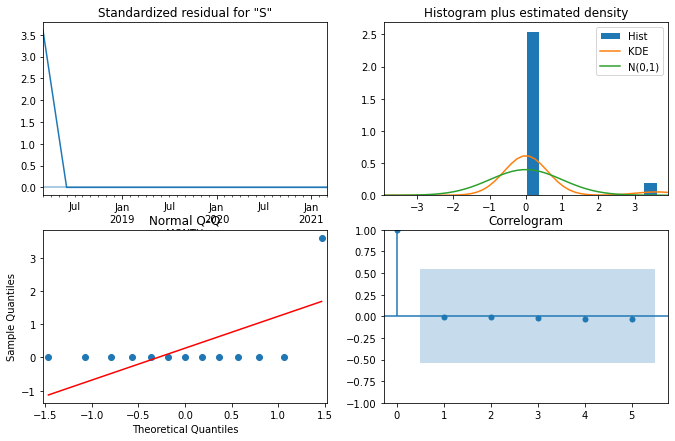

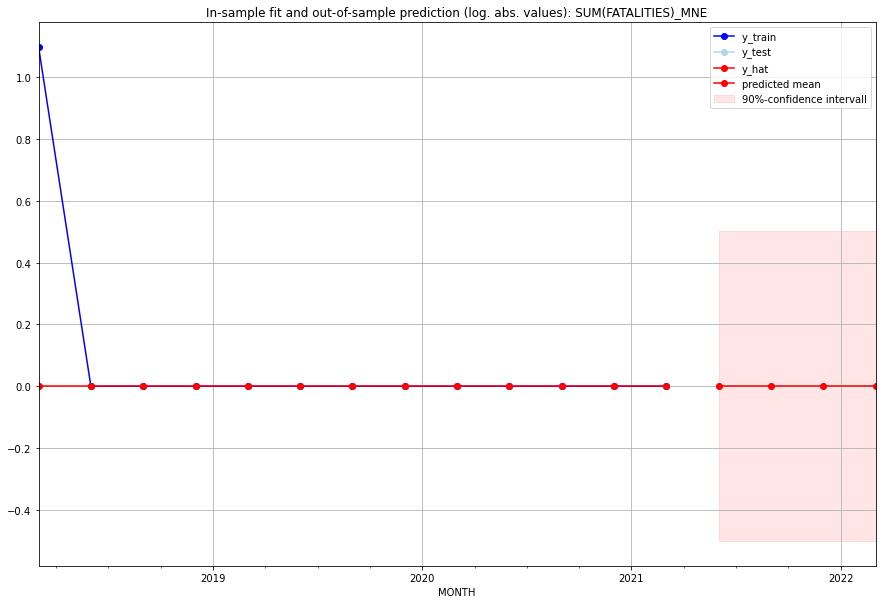

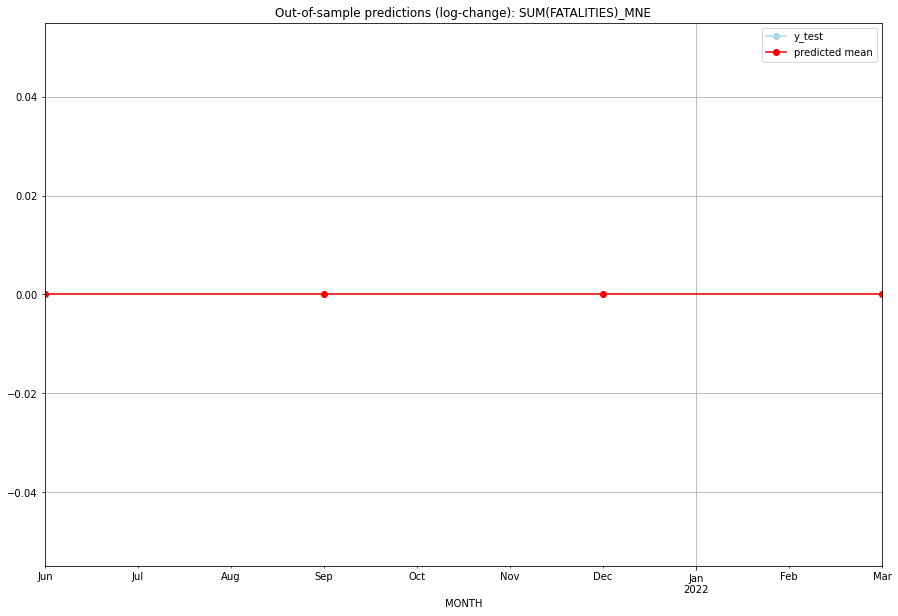

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MNE   
1 2021-07-01       0.0         0.0           0.0             0.0   MNE   
2 2021-10-01       0.0         0.0           0.0             0.0   MNE   
3 2022-01-01       0.0         0.0           0.0             0.0   MNE   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## MNG (141/234) #########
0
Neighbor countries: ['CHN', 'RUS']
Getting Data for MNG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 78)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MNG   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:51:41   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.245      0.000       0.025       0

<Figure size 432x288 with 0 Axes>

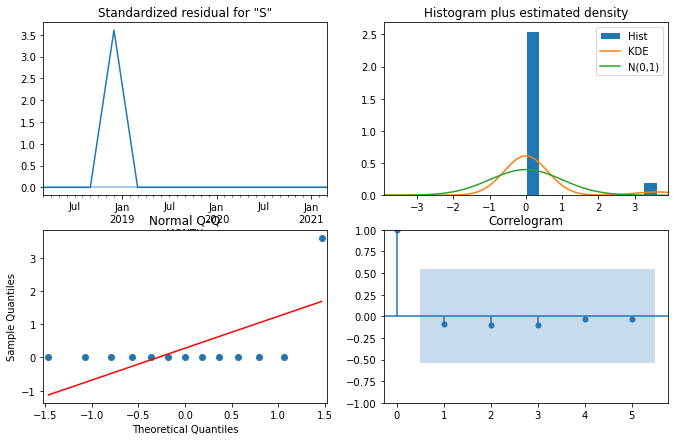

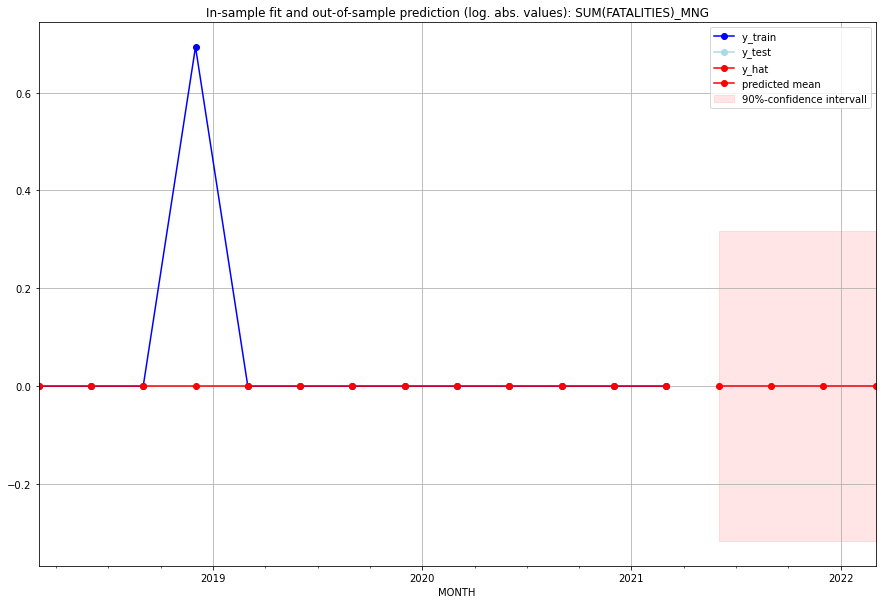

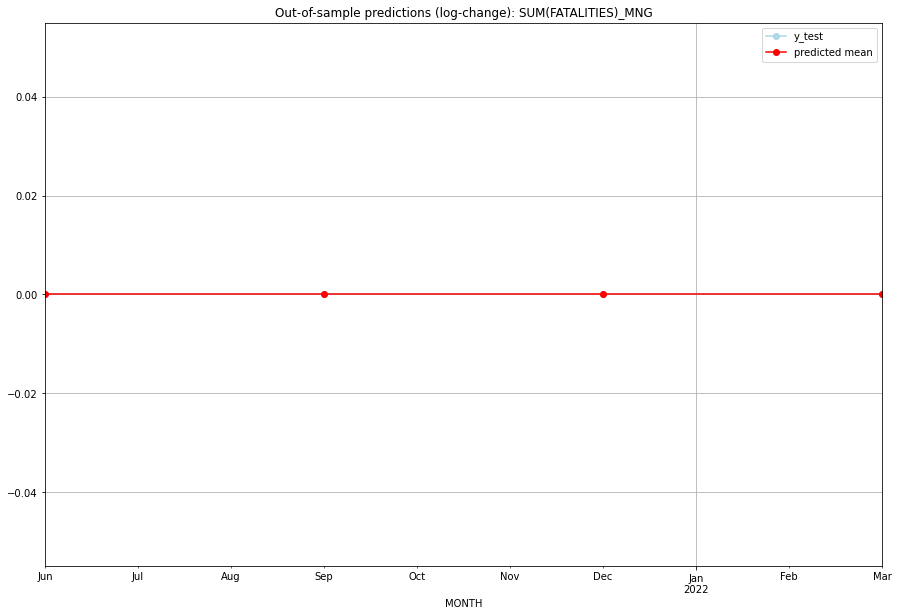

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MNG   
1 2021-07-01       0.0         0.0           0.0             0.0   MNG   
2 2021-10-01       0.0         0.0           0.0             0.0   MNG   
3 2022-01-01       0.0         0.0           0.0             0.0   MNG   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## MNP (142/234) #########
0
Neighbor countries: []
Getting Data for MNP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross va

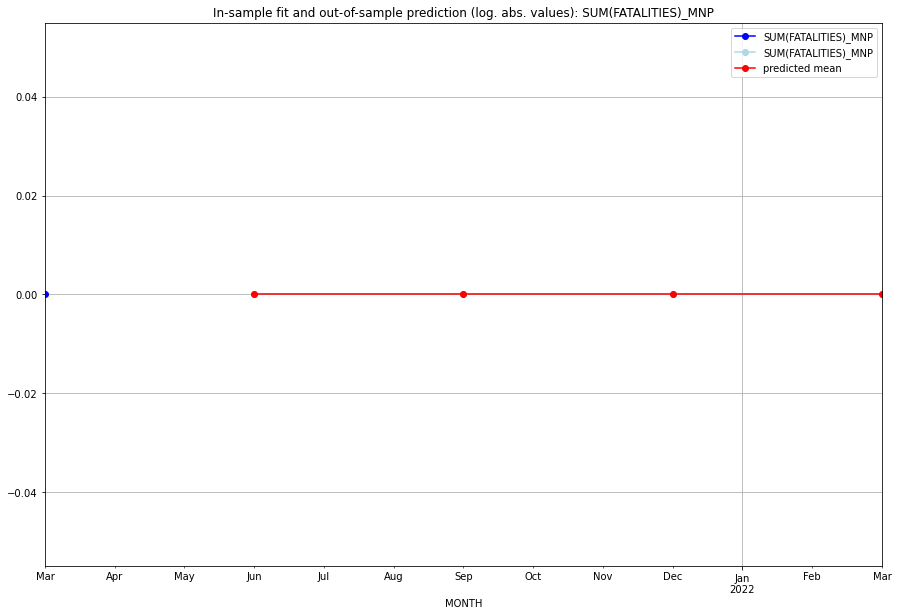

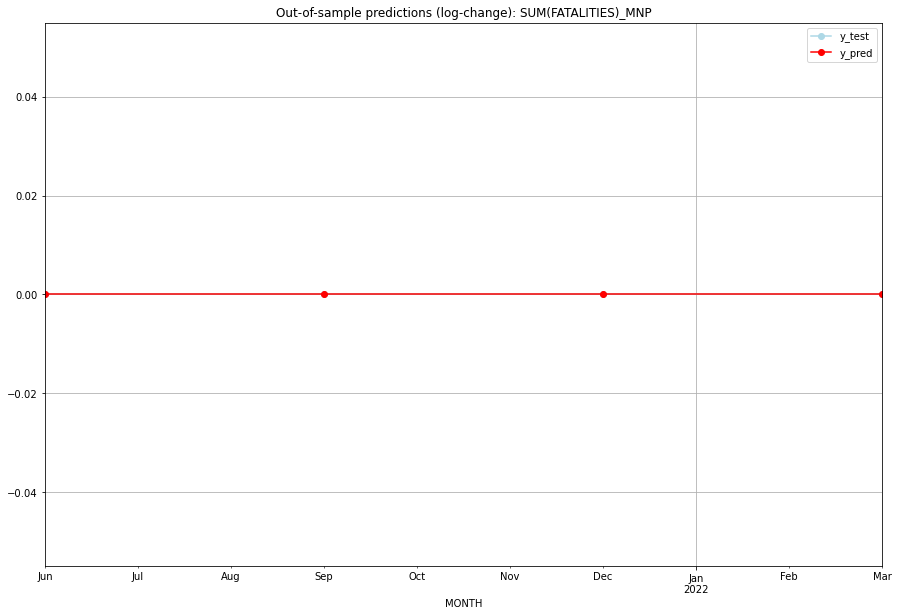

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MNP   
1 2021-07-01       0.0         0.0           0.0             0.0   MNP   
2 2021-10-01       0.0         0.0           0.0             0.0   MNP   
3 2022-01-01       0.0         0.0           0.0             0.0   MNP   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## MOZ (143/234) #########
0
Neighbor countries: ['MWI', 'ZMB', 'ZWE', 'TZA', 'ZAF', 'SWZ']
Getting Data for MOZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 109)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6732996207948093, 'fold_results': [0.7779035351442641, 0.5247330542384323, 0.7382177981071073, 0.6911653937754787, 0.6344783227087643]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MOZ   No. Observations:                   96
Model:                SARIMAX(1, 1, 0)   Log Likelihood                -124.388
Date:                 Wed, 19 Oct 2022   AIC                            256.777
Time:                         10:52:01   BIC                            266.992
Sample:                     04-30-1997   HQIC                           260.905
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

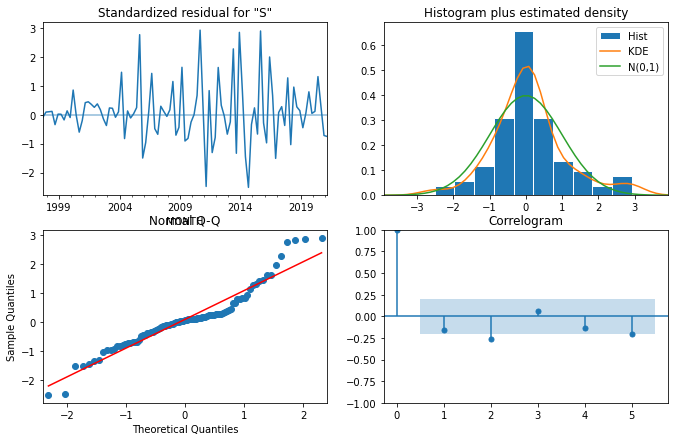

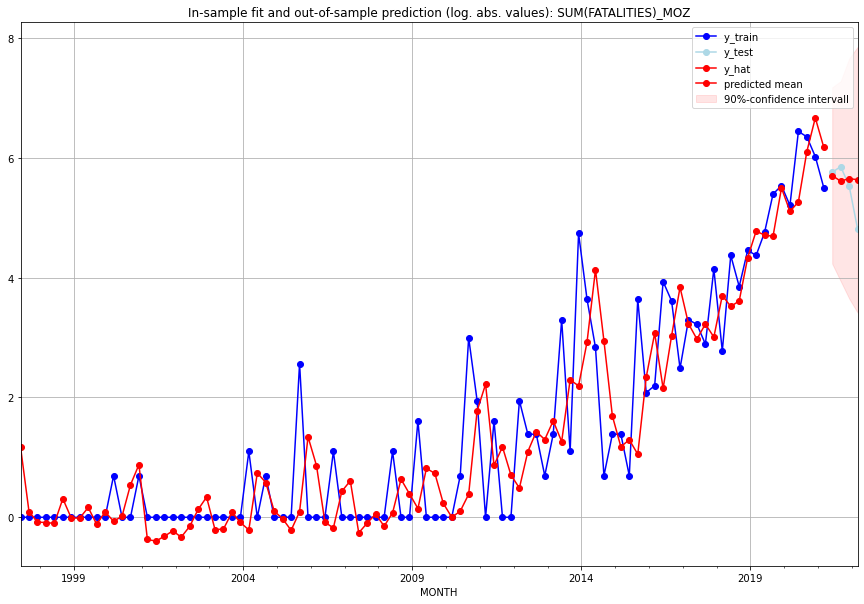

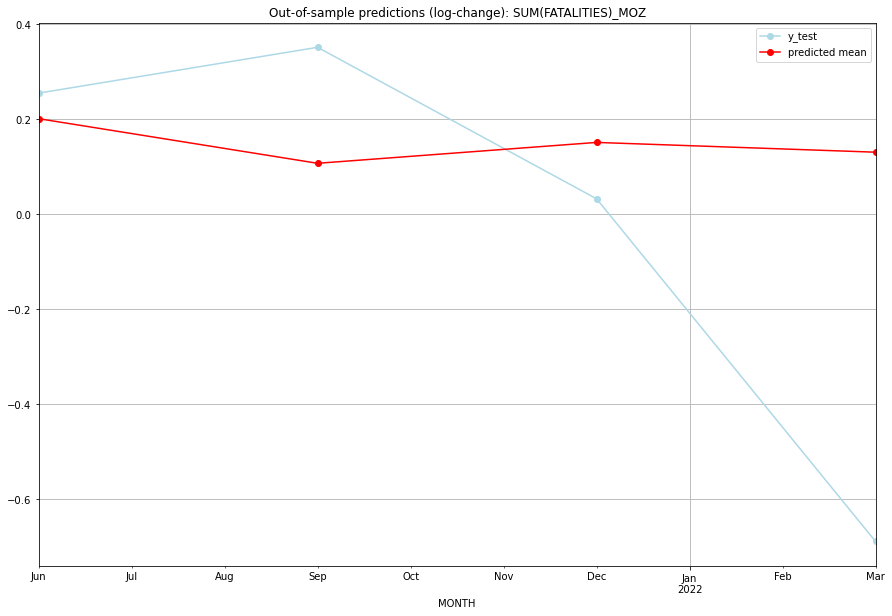

TADDA: 0.34149771364408
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  298.471507       315.0      0.200761        0.254484   MOZ   
1 2021-07-01  271.623311       347.0      0.106833        0.350944   MOZ   
2 2021-10-01  283.870982       252.0      0.150778        0.032131   MOZ   
3 2022-01-01  278.073746       122.0      0.130218       -0.689074   MOZ   

                                          PARAMETERS  
0  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## MRT (144/234) #########
0
Neighbor countries: ['DZA', 'ESH', 'MLI', 'SEN']
Getting Data for MRT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 92)
y: (100, 1)
------------------------------------------------
Training starte

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3786251492510192, 'fold_results': [0.0, 0.27465307216702756, 0.4479398673070138, 0.44793986730701374, 0.7225929394740411]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MRT   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -142.035
Date:                 Wed, 19 Oct 2022   AIC                            288.070
Time:                         10:52:26   BIC                            293.177
Sample:                     04-30-1997   HQIC                           290.134
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

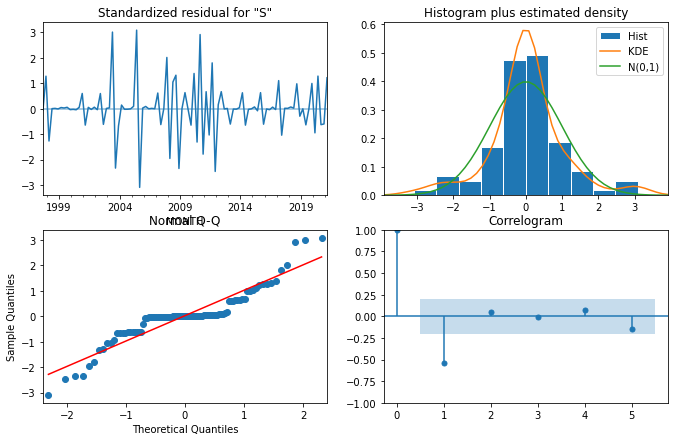

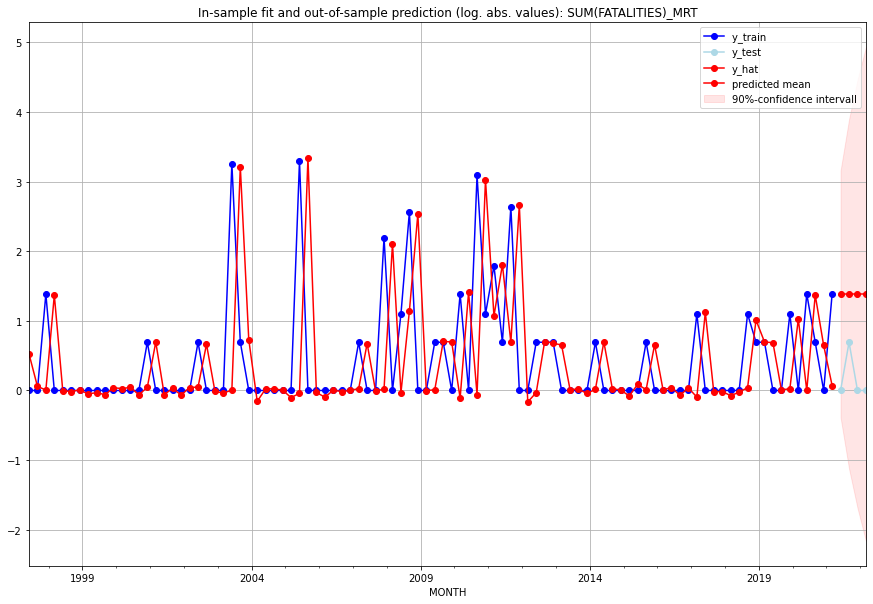

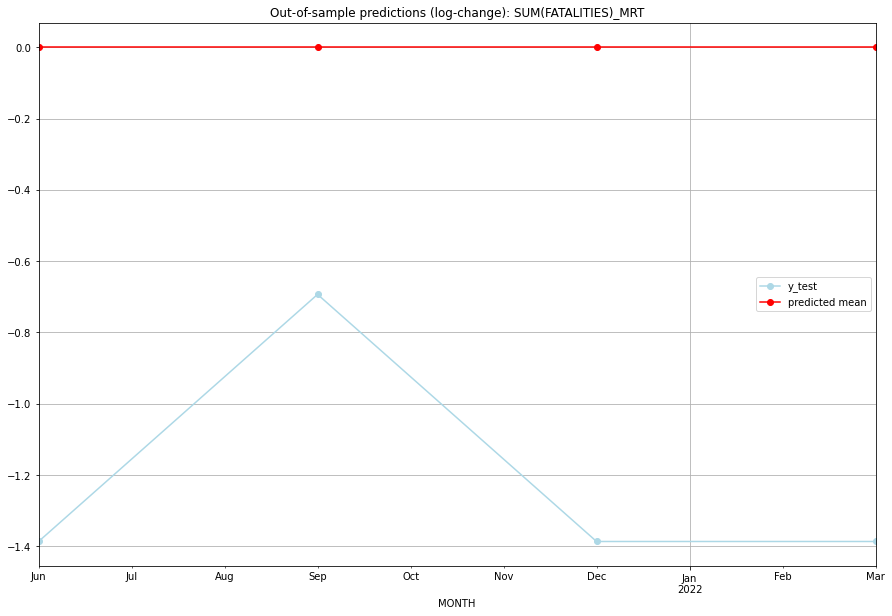

TADDA: 1.2130075659799056
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       3.0         0.0  6.661338e-16       -1.386294   MRT   
1 2021-07-01       3.0         1.0  6.661338e-16       -0.693147   MRT   
2 2021-10-01       3.0         0.0  6.661338e-16       -1.386294   MRT   
3 2022-01-01       3.0         0.0  6.661338e-16       -1.386294   MRT   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:23
######## MSR (145/234) #########
0
Neighbor countries: []
Getting Data for MSR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

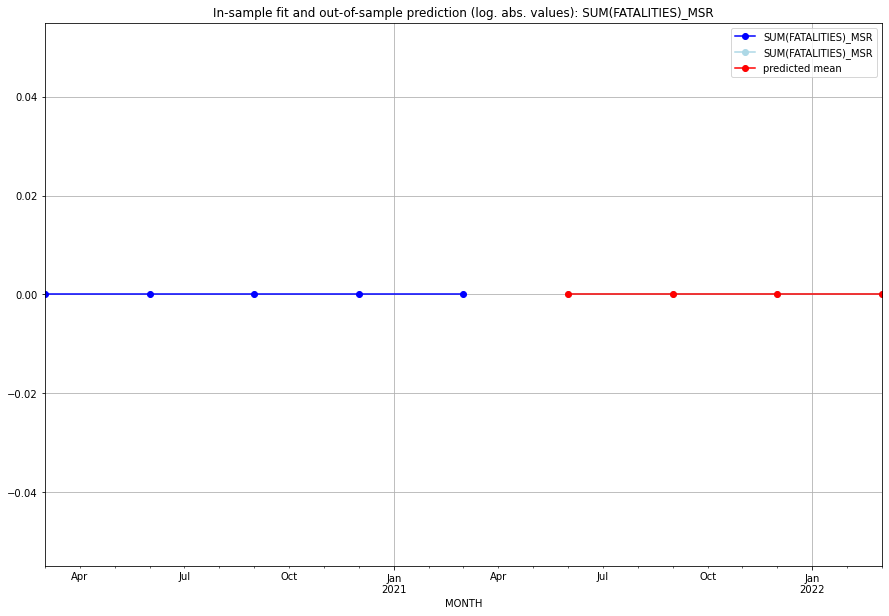

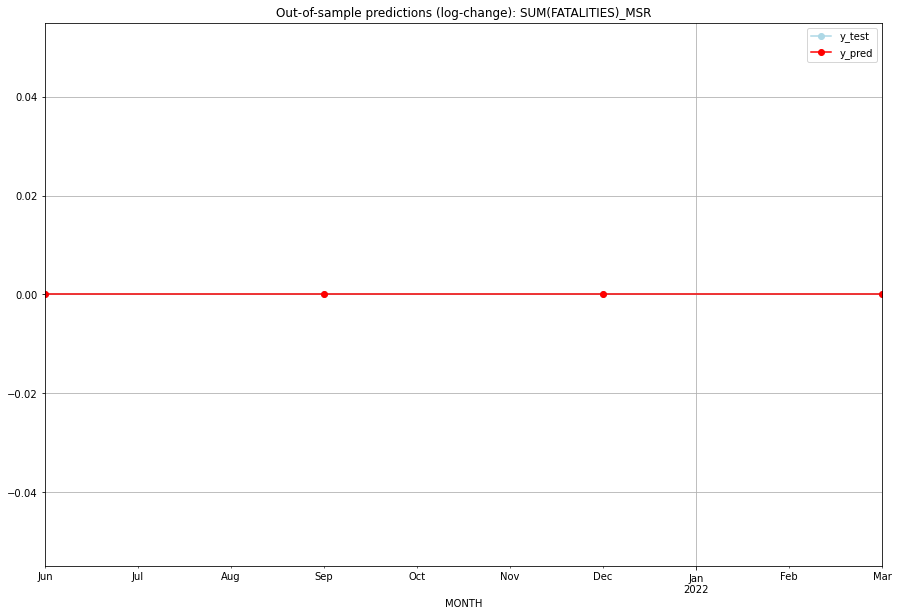

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MSR   
1 2021-07-01       0.0         0.0           0.0             0.0   MSR   
2 2021-10-01       0.0         0.0           0.0             0.0   MSR   
3 2022-01-01       0.0         0.0           0.0             0.0   MSR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:05
######## MTQ (146/234) #########
0
Neighbor countries: []
Getting Data for MTQ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MTQ   No. Observations:                   13
Model:

<Figure size 432x288 with 0 Axes>

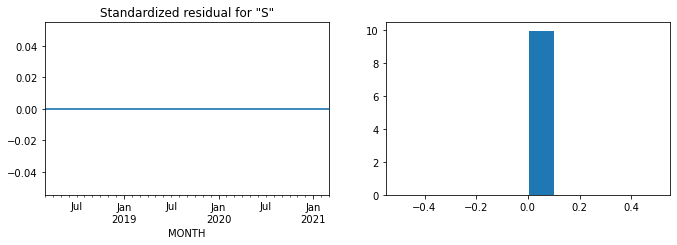

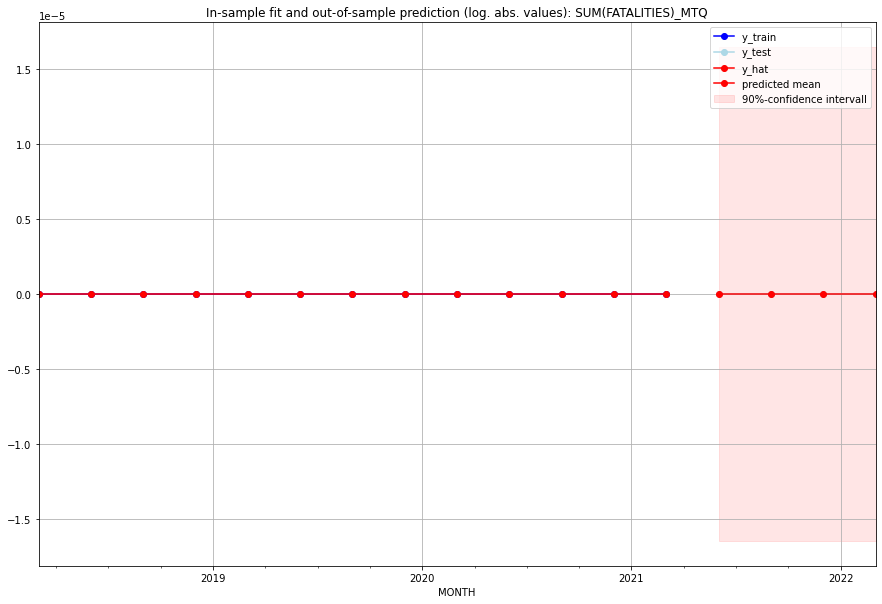

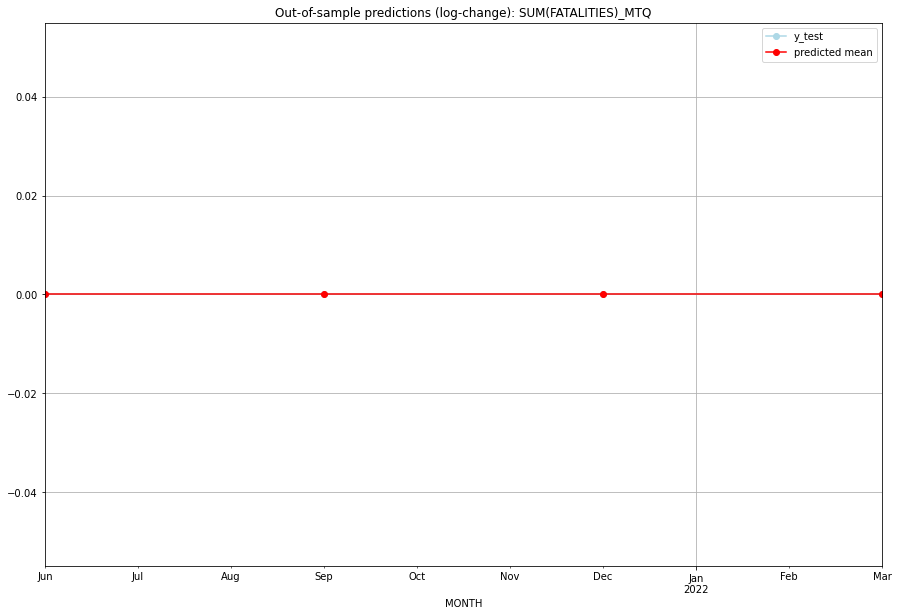

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MTQ   
1 2021-07-01       0.0         0.0           0.0             0.0   MTQ   
2 2021-10-01       0.0         0.0           0.0             0.0   MTQ   
3 2022-01-01       0.0         0.0           0.0             0.0   MTQ   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:06
######## MUS (147/234) #########
0
Neighbor countries: []
Getting Data for MUS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 62)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.06931471805599453, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.34657359027997264]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MUS   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                  65.322
Date:                 Wed, 19 Oct 2022   AIC                           -128.645
Time:                         10:53:21   BIC                           -126.081
Sample:                     04-30-1997   HQIC                          -127.608
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0150      

<Figure size 432x288 with 0 Axes>

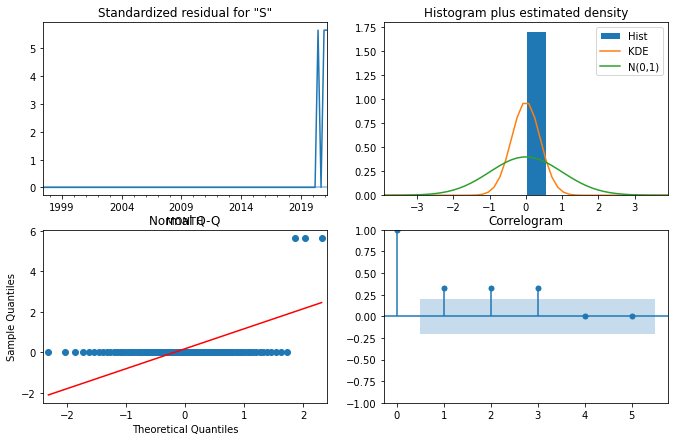

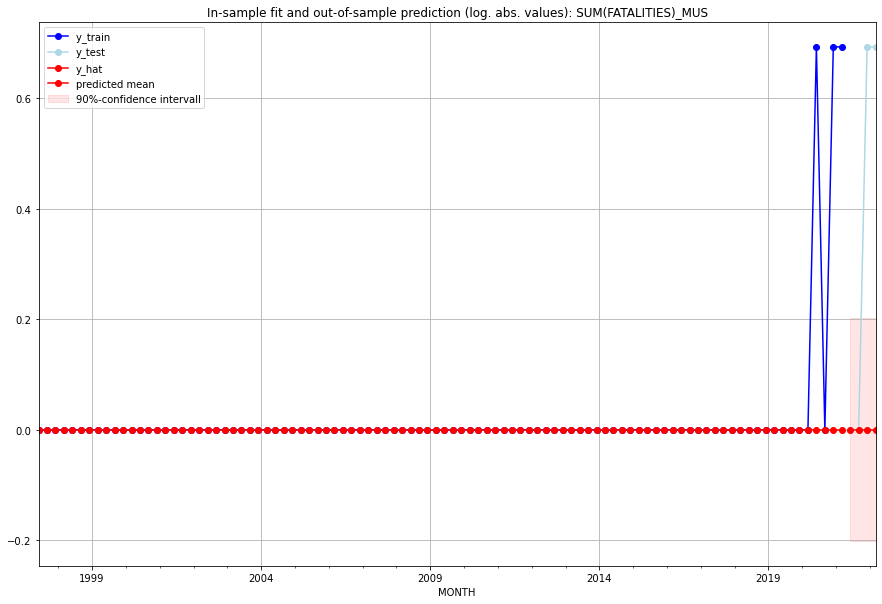

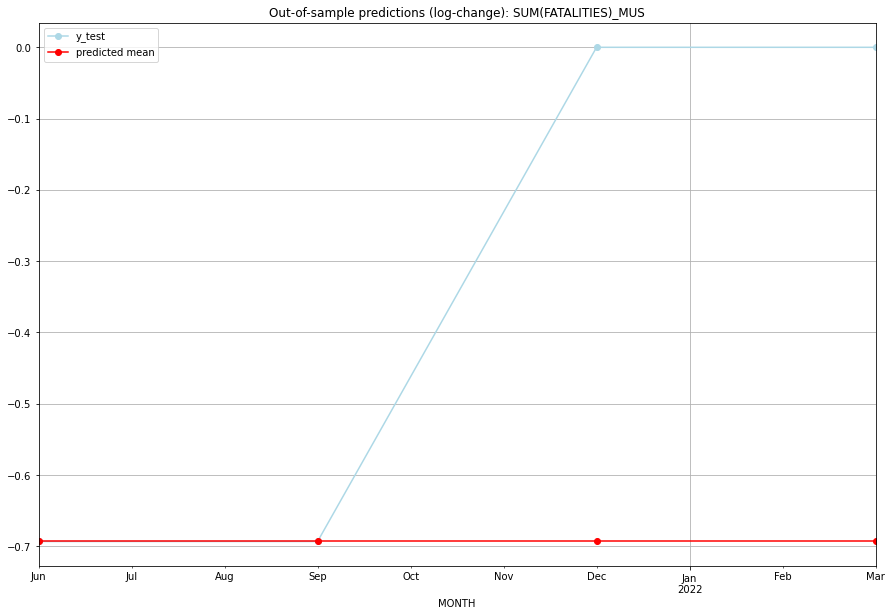

TADDA: 0.34657359027997264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -0.693147       -0.693147   MUS   
1 2021-07-01       0.0         0.0     -0.693147       -0.693147   MUS   
2 2021-10-01       0.0         1.0     -0.693147        0.000000   MUS   
3 2022-01-01       0.0         1.0     -0.693147        0.000000   MUS   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:46
######## MWI (148/234) #########
0
Neighbor countries: ['MOZ', 'ZMB', 'TZA']
Getting Data for MWI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 81)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDS

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8511637235936875, 'fold_results': [1.1725819985820989, 0.6181210324473603, 0.5037257551355665, 1.383470859465201, 0.5779189723382114]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MWI   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -119.316
Date:                 Wed, 19 Oct 2022   AIC                            246.632
Time:                         10:53:49   BIC                            256.847
Sample:                     04-30-1997   HQIC                           250.760
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

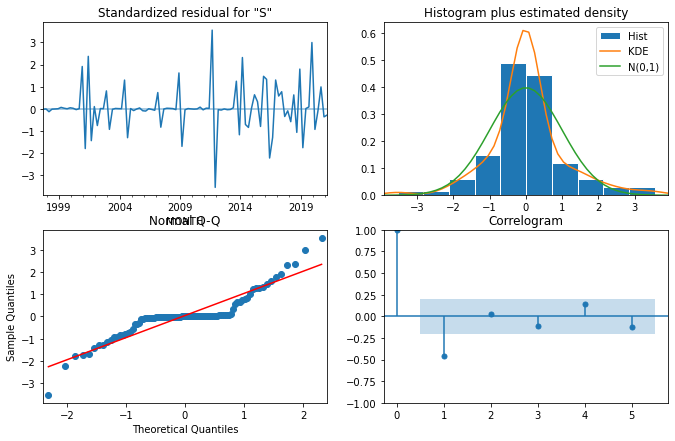

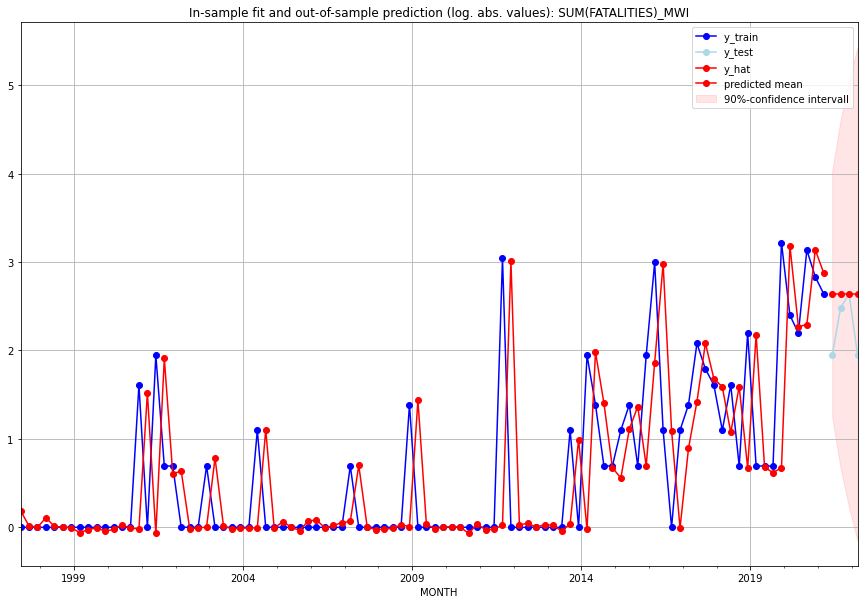

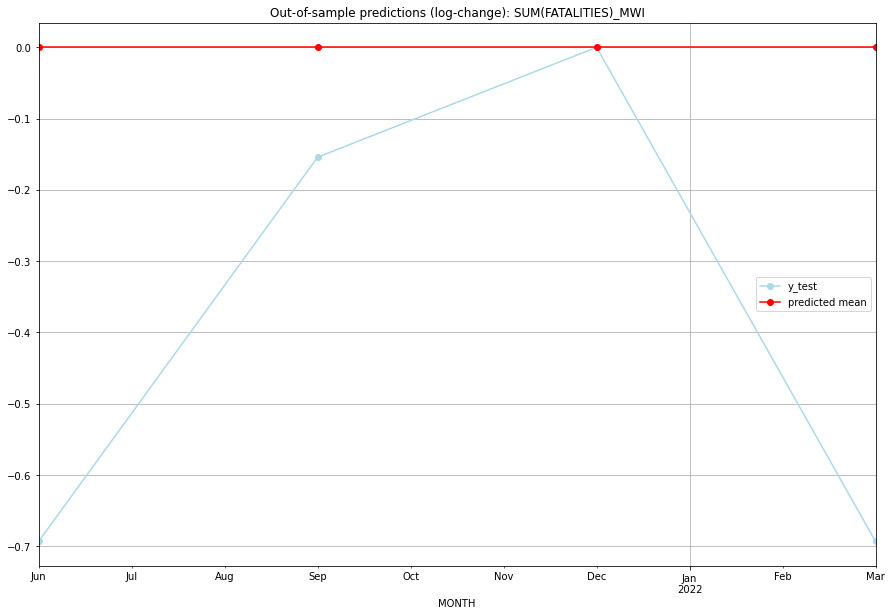

TADDA: 0.3851112602367873
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      13.0         6.0           0.0       -0.693147   MWI   
1 2021-07-01      13.0        11.0           0.0       -0.154151   MWI   
2 2021-10-01      13.0        13.0           0.0        0.000000   MWI   
3 2022-01-01      13.0         6.0           0.0       -0.693147   MWI   

                                          PARAMETERS  
0  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:26
######## MYS (149/234) #########
0
Neighbor countries: ['THA', 'IDN', 'BRN']
Getting Data for MYS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 87)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEAR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5344968566003849, 'fold_results': [0.8983902848074565, 0.17060342839331322]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MYS   No. Observations:                   13
Model:                SARIMAX(0, 0, 3)   Log Likelihood                 -12.499
Date:                 Wed, 19 Oct 2022   AIC                             36.998
Time:                         10:53:58   BIC                             40.388
Sample:                     01-31-2018   HQIC                            36.301
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0561      0

<Figure size 432x288 with 0 Axes>

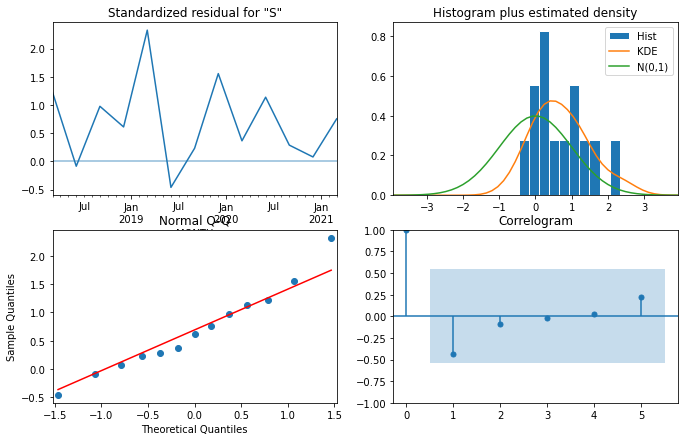

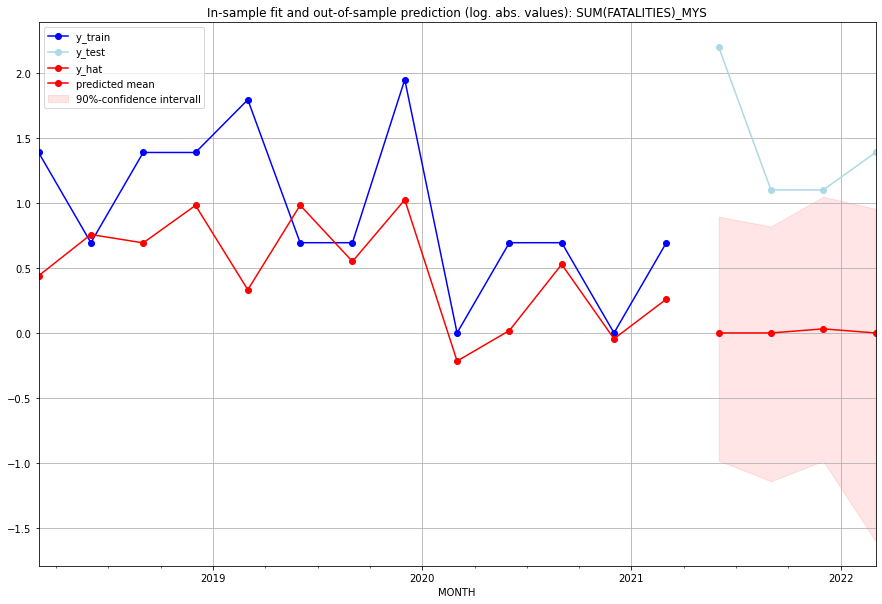

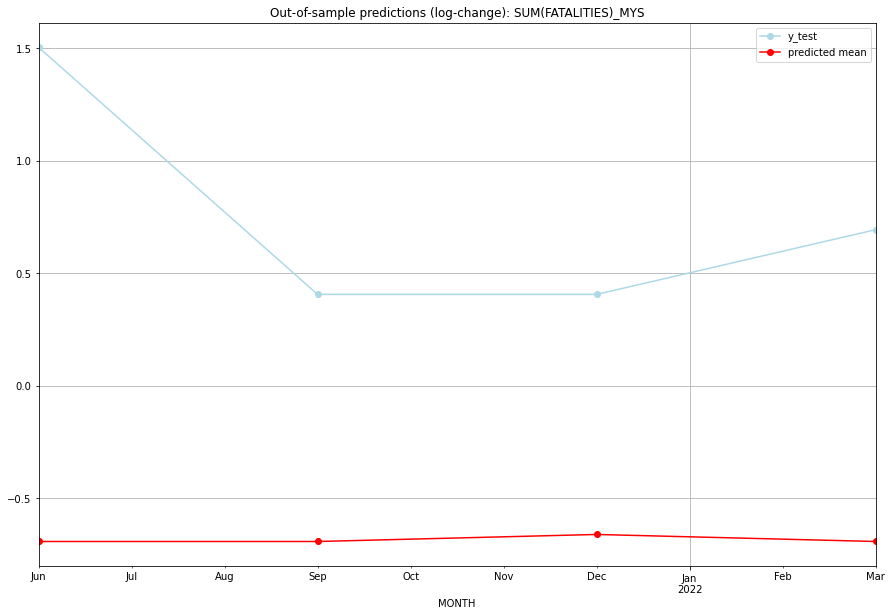

TADDA: 2.122710592901245
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.000000         8.0     -0.693147        1.504077   MYS   
1 2021-07-01  0.000000         2.0     -0.693147        0.405465   MYS   
2 2021-10-01  0.031738         2.0     -0.661902        0.405465   MYS   
3 2022-01-01  0.000000         3.0     -0.693147        0.693147   MYS   

                                          PARAMETERS  
0  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## MYT (150/234) #########
0
Neighbor countries: []
Getting Data for MYT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV nece

<Figure size 432x288 with 0 Axes>

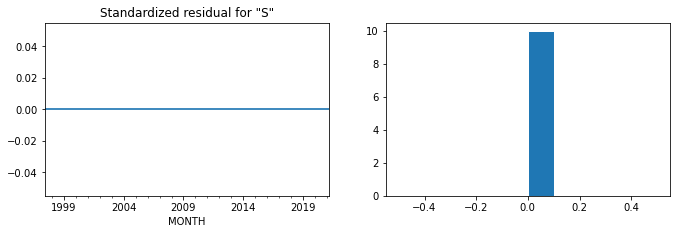

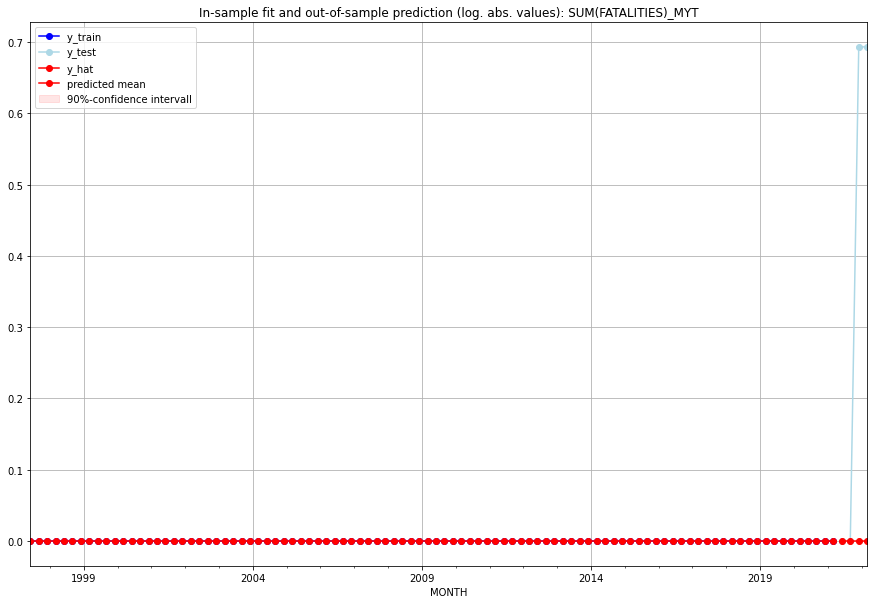

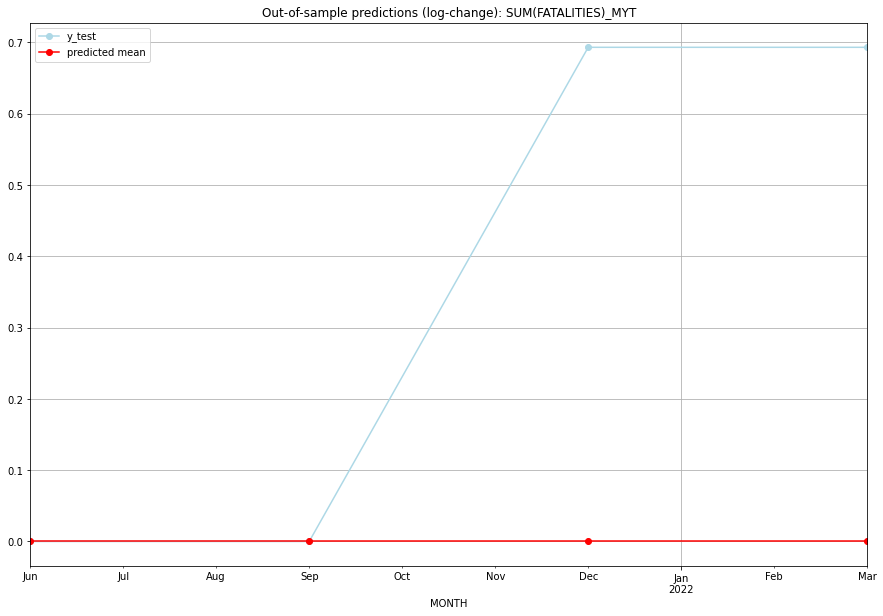

TADDA: 0.34657359027997264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   MYT   
1 2021-07-01       0.0         0.0           0.0        0.000000   MYT   
2 2021-10-01       0.0         1.0           0.0        0.693147   MYT   
3 2022-01-01       0.0         1.0           0.0        0.693147   MYT   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:01
######## NAM (151/234) #########
0
Neighbor countries: ['BWA', 'AGO', 'ZMB', 'ZAF']
Getting Data for NAM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 93)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.22821740957339182, 'fold_results': [0.0, 0.34657359027997264, 0.17328679513998632, 0.6212266624470001, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NAM   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                -137.924
Date:                 Wed, 19 Oct 2022   AIC                            277.848
Time:                         10:54:24   BIC                            280.413
Sample:                     04-30-1997   HQIC                           278.885
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

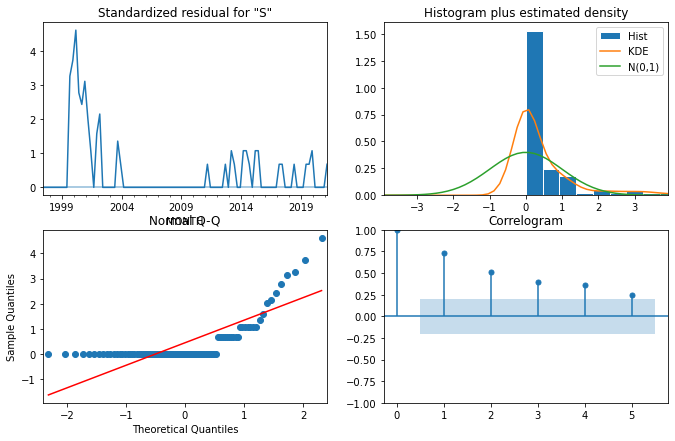

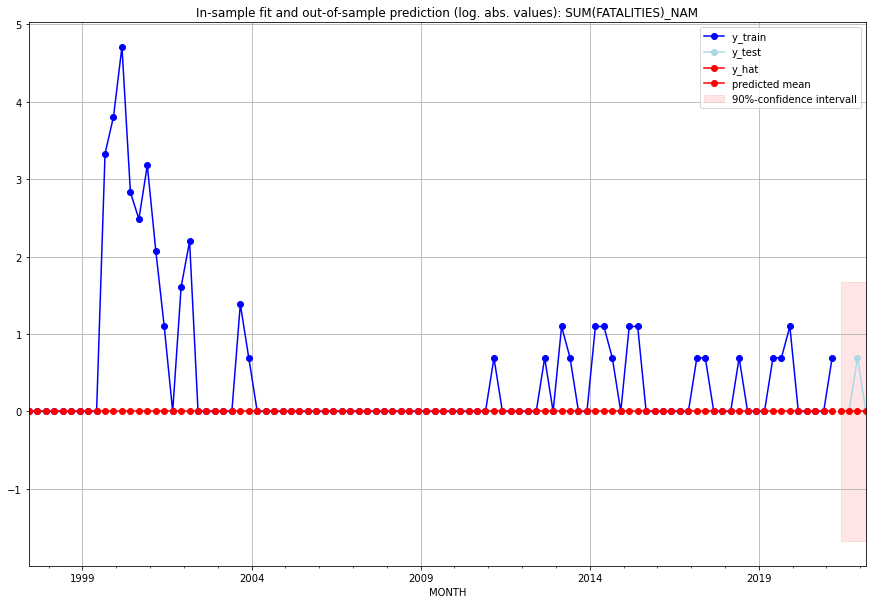

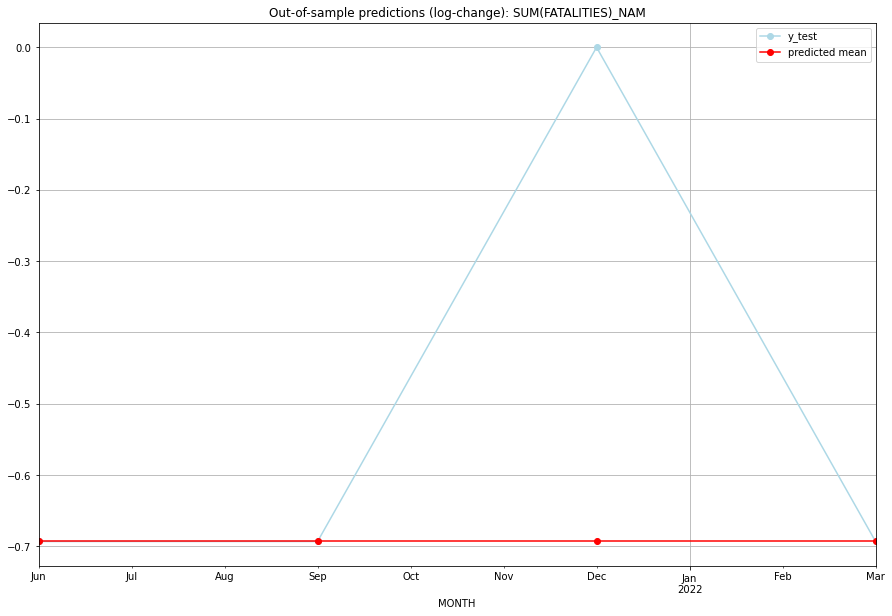

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -0.693147       -0.693147   NAM   
1 2021-07-01       0.0         0.0     -0.693147       -0.693147   NAM   
2 2021-10-01       0.0         1.0     -0.693147        0.000000   NAM   
3 2022-01-01       0.0         0.0     -0.693147       -0.693147   NAM   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## NCL (152/234) #########
0
Neighbor countries: []
Getting Data for NCL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient d

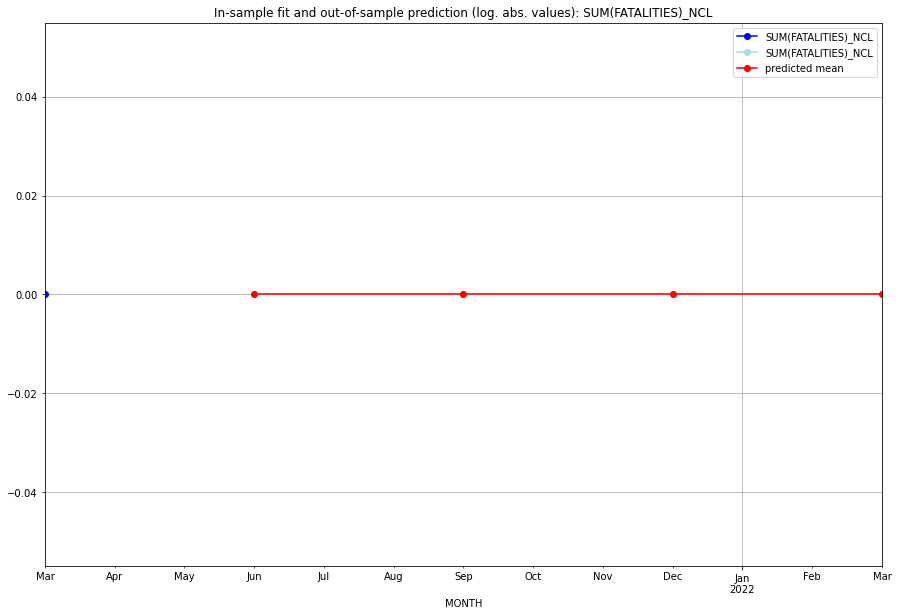

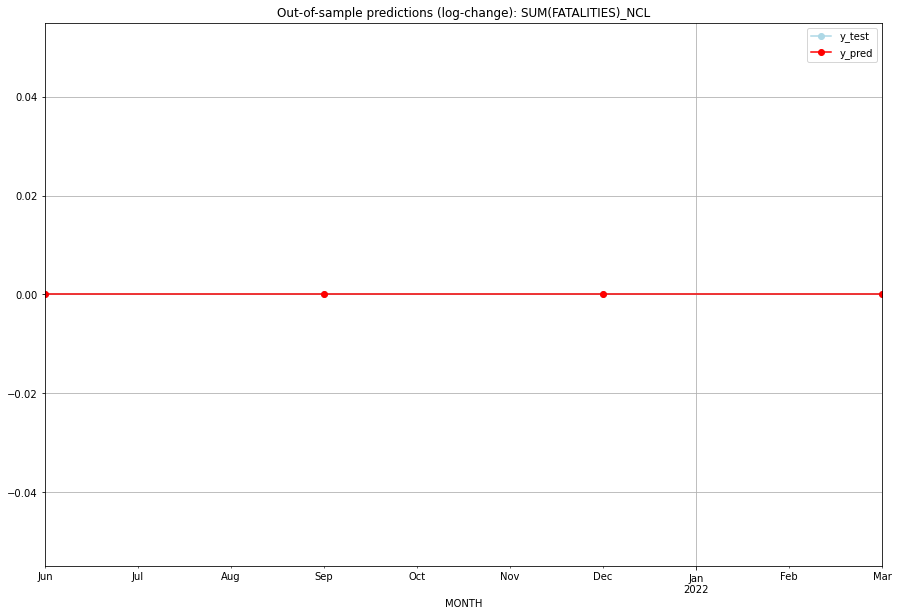

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   NCL   
1 2021-07-01       0.0         0.0           0.0             0.0   NCL   
2 2021-10-01       0.0         0.0           0.0             0.0   NCL   
3 2022-01-01       0.0         0.0           0.0             0.0   NCL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## NER (153/234) #########
0
Neighbor countries: ['DZA', 'LBY', 'MLI', 'TCD', 'NGA', 'BEN', 'BFA']
Getting Data for NER
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 117)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6526503241221422, 'fold_results': [0.7090793793679216, 0.4529868421499943, 1.0060209309842767, 0.4299448941217634, 0.665219573986755]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NER   No. Observations:                   96
Model:                SARIMAX(3, 1, 0)   Log Likelihood                -166.629
Date:                 Wed, 19 Oct 2022   AIC                            347.258
Time:                         10:54:48   BIC                            365.135
Sample:                     04-30-1997   HQIC                           354.482
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

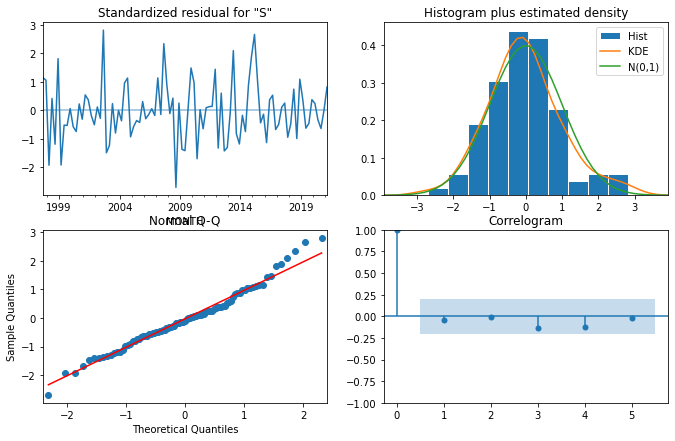

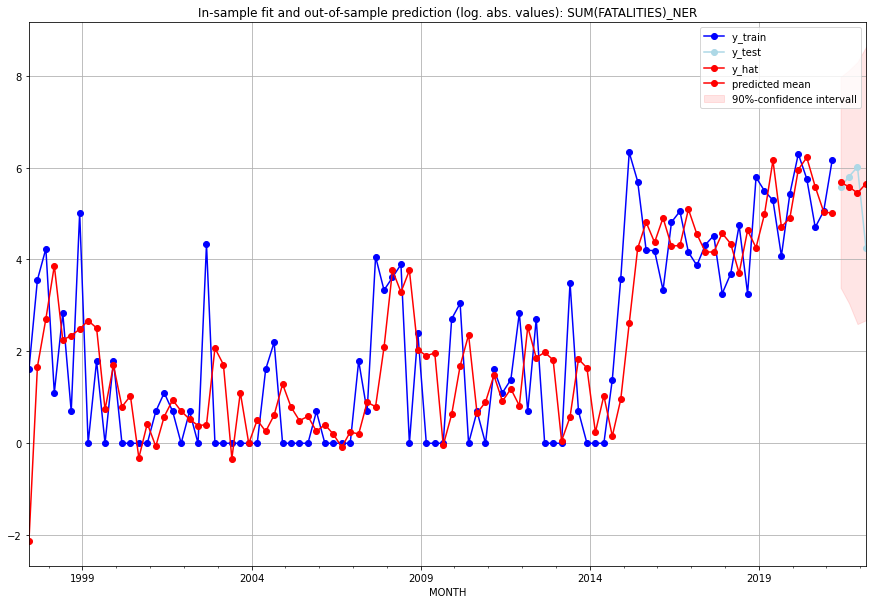

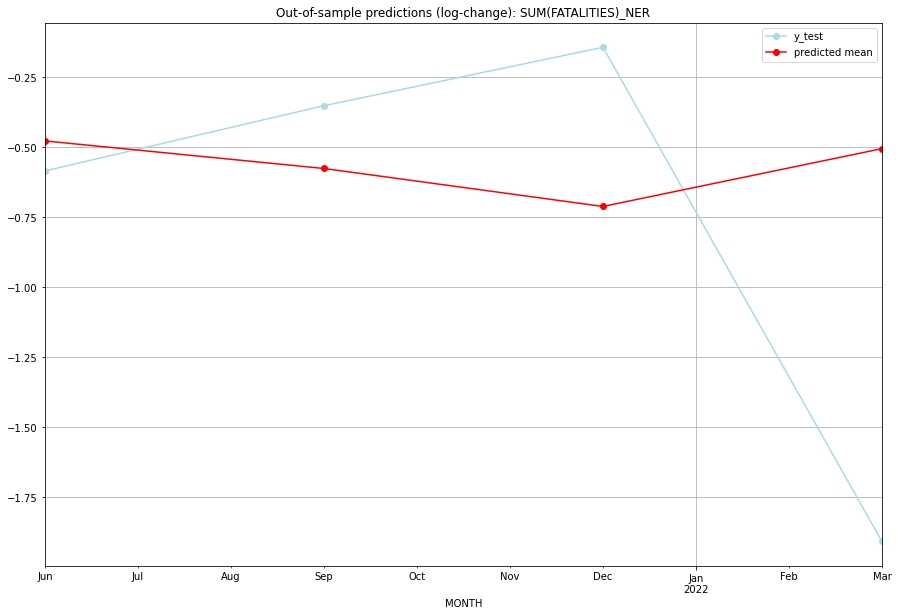

TADDA: 0.5757962268111887
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  291.749841       262.0     -0.477661       -0.584825   NER   
1 2021-07-01  264.298513       331.0     -0.576123       -0.351844   NER   
2 2021-10-01  230.653701       408.0     -0.711735       -0.143264   NER   
3 2022-01-01  283.793638        69.0     -0.505214       -1.908484   NER   

                                          PARAMETERS  
0  {'params': [3, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## NGA (154/234) #########
0
Neighbor countries: ['NER', 'BEN', 'CMR', 'TCD']
Getting Data for NGA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 95)
y: (100, 1)
------------------------------------------------
Training star

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3861197999255196, 'fold_results': [0.4468897727649619, 0.3685424587381856, 0.25511522081951954, 0.4453138408048194, 0.41473770650011144]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NGA   No. Observations:                   96
Model:                SARIMAX(3, 1, 2)   Log Likelihood                -128.704
Date:                 Wed, 19 Oct 2022   AIC                            271.408
Time:                         10:55:13   BIC                            289.285
Sample:                     04-30-1997   HQIC                           278.632
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

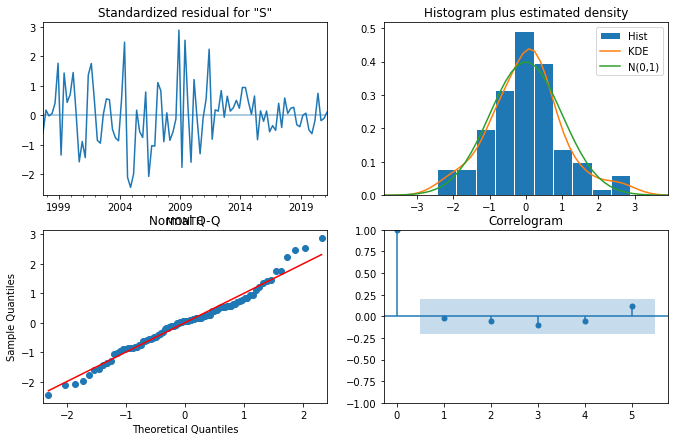

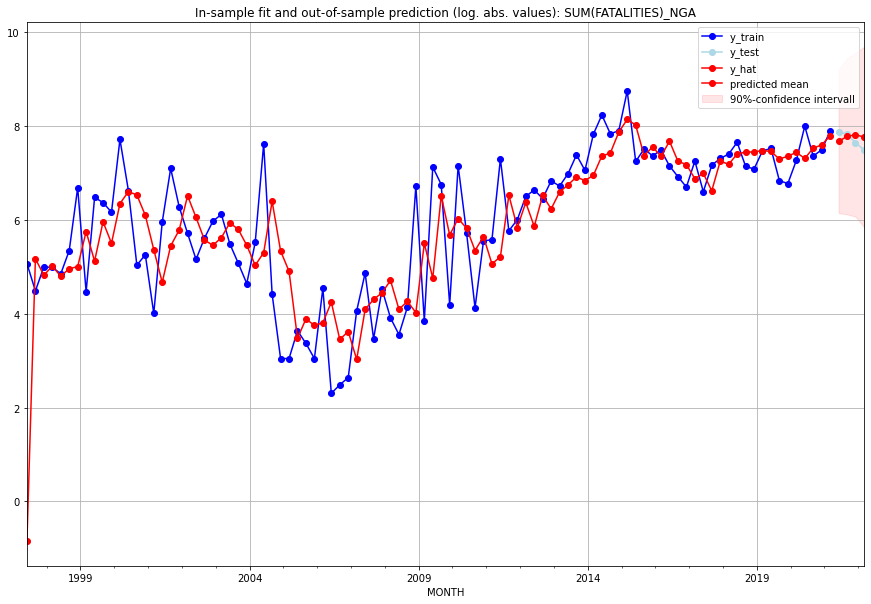

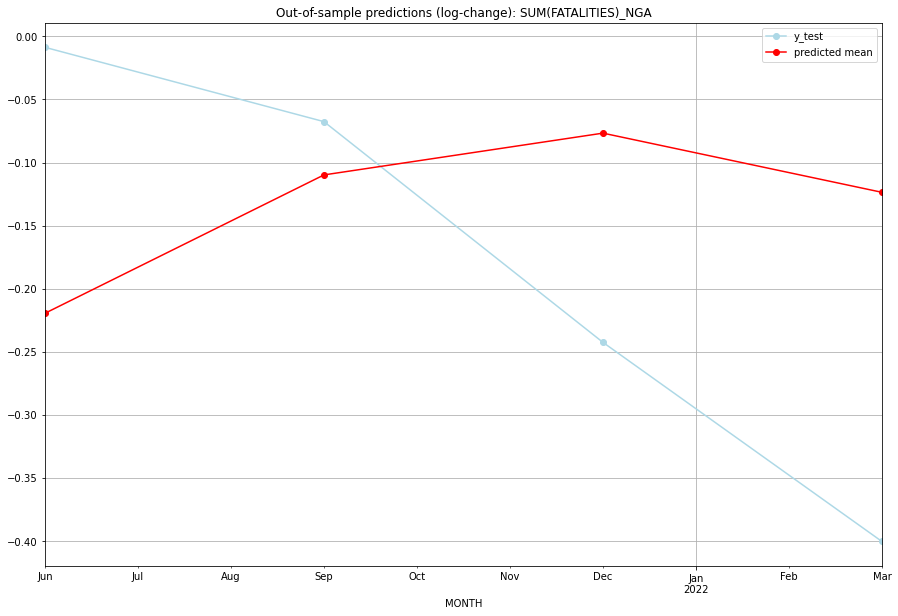

TADDA: 0.17396291871952907
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2150.014089      2655.0     -0.219504       -0.008622   NGA   
1 2021-07-01  2399.427655      2503.0     -0.109797       -0.067554   NGA   
2 2021-10-01  2480.264074      2101.0     -0.076675       -0.242554   NGA   
3 2022-01-01  2366.544774      1794.0     -0.123590       -0.400439   NGA   

                                          PARAMETERS  
0  {'params': [1, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:23
######## NIC (155/234) #########
0
Neighbor countries: ['HND', 'CRI']
Getting Data for NIC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 78)
y: (17, 1)
------------------------------------------------
Training started.
Start

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5300325275650474, 'fold_results': [0.3182877846267337, 0.7417772705033611]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NIC   No. Observations:                   13
Model:                SARIMAX(0, 1, 2)   Log Likelihood                 -22.476
Date:                 Wed, 19 Oct 2022   AIC                             50.953
Time:                         10:55:20   BIC                             52.407
Sample:                     01-31-2018   HQIC                            50.414
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.1957    114.

<Figure size 432x288 with 0 Axes>

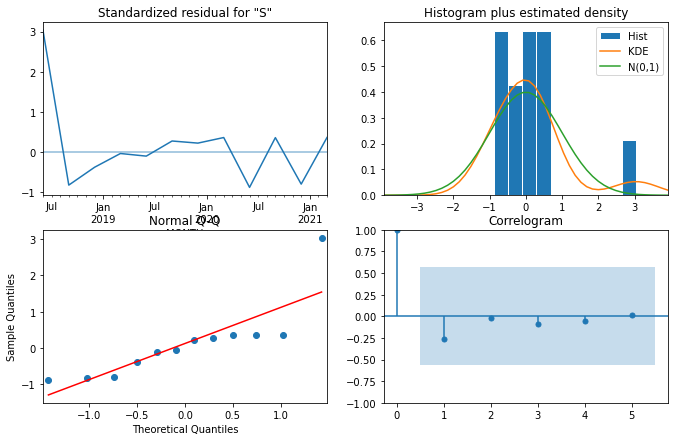

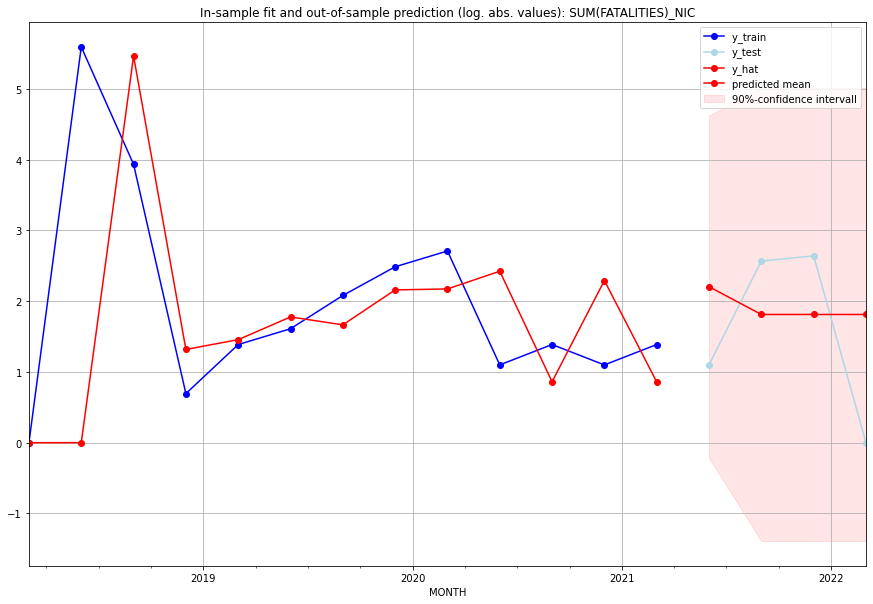

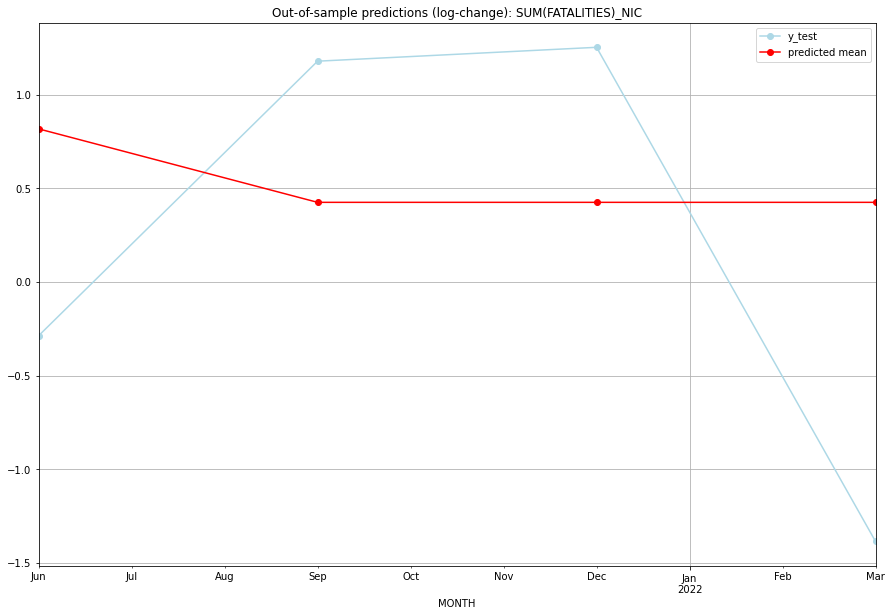

TADDA: 1.4349847445243604
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   8.05726         2.0      0.817272       -0.287682   NIC   
1 2021-07-01   5.11763        12.0      0.424880        1.178655   NIC   
2 2021-10-01   5.11763        13.0      0.424880        1.252763   NIC   
3 2022-01-01   5.11763         0.0      0.424880       -1.386294   NIC   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## NLD (156/234) #########
0
Neighbor countries: ['DEU', 'BEL']
Getting Data for NLD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 81)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. In

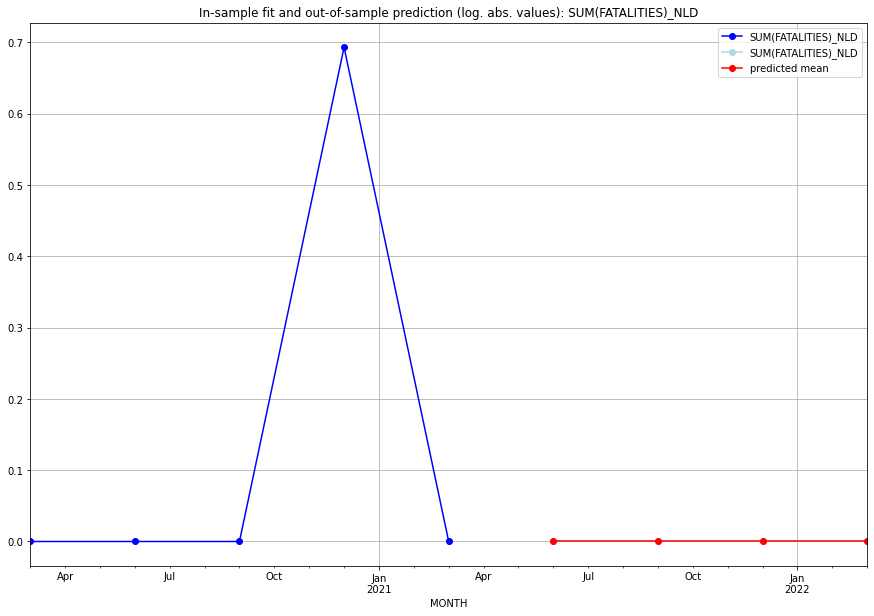

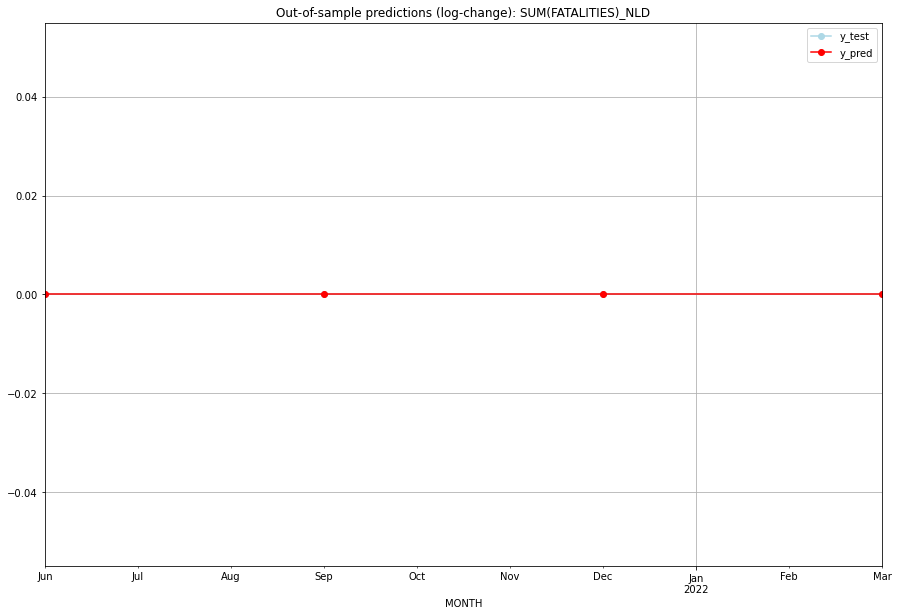

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   NLD   
1 2021-07-01       0.0         0.0           0.0             0.0   NLD   
2 2021-10-01       0.0         0.0           0.0             0.0   NLD   
3 2022-01-01       0.0         0.0           0.0             0.0   NLD   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## NOR (157/234) #########
0
Neighbor countries: ['SWE', 'FIN', 'RUS']
Getting Data for NOR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 88)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


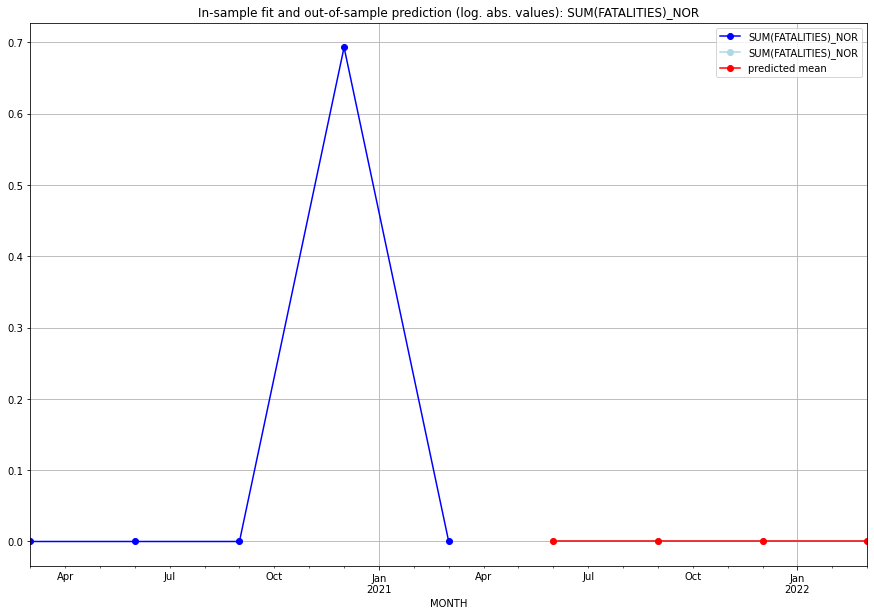

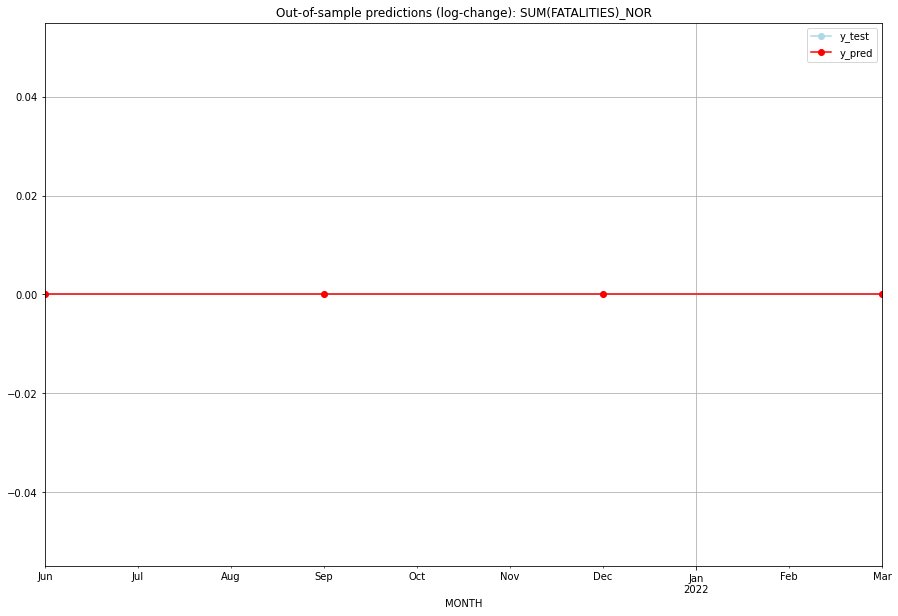

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   NOR   
1 2021-07-01       0.0         0.0           0.0             0.0   NOR   
2 2021-10-01       0.0         0.0           0.0             0.0   NOR   
3 2022-01-01       0.0         0.0           0.0             0.0   NOR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## NPL (158/234) #########
0
Neighbor countries: ['CHN', 'IND']
Getting Data for NPL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 74)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8068316385978365, 'fold_results': [1.1847795396244571, 0.6181210324473607, 0.9972460116410687, 0.6289195771136885, 0.6050920321626075]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NPL   No. Observations:                   45
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -65.694
Date:                 Wed, 19 Oct 2022   AIC                            133.389
Time:                         10:55:42   BIC                            135.173
Sample:                     01-31-2010   HQIC                           134.051
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

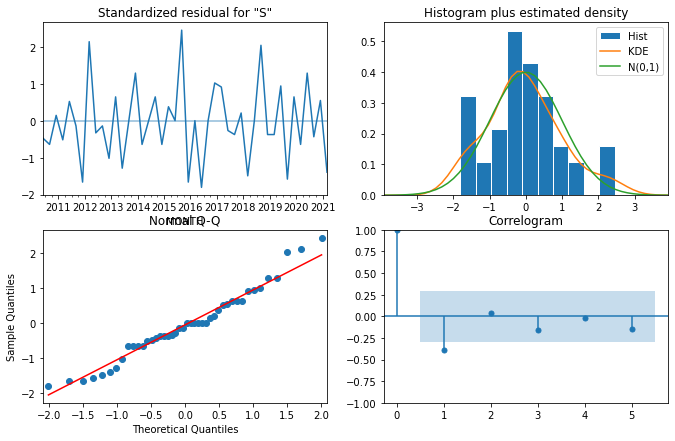

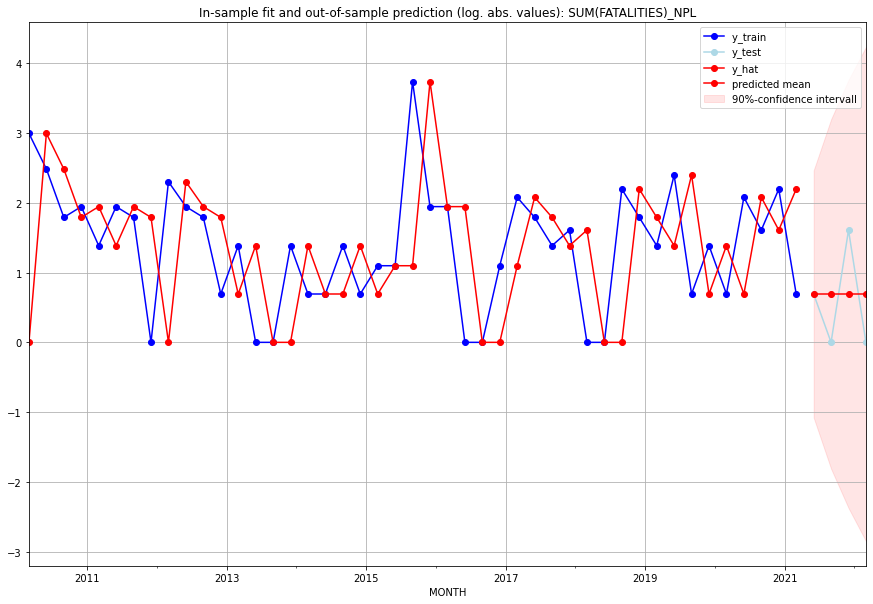

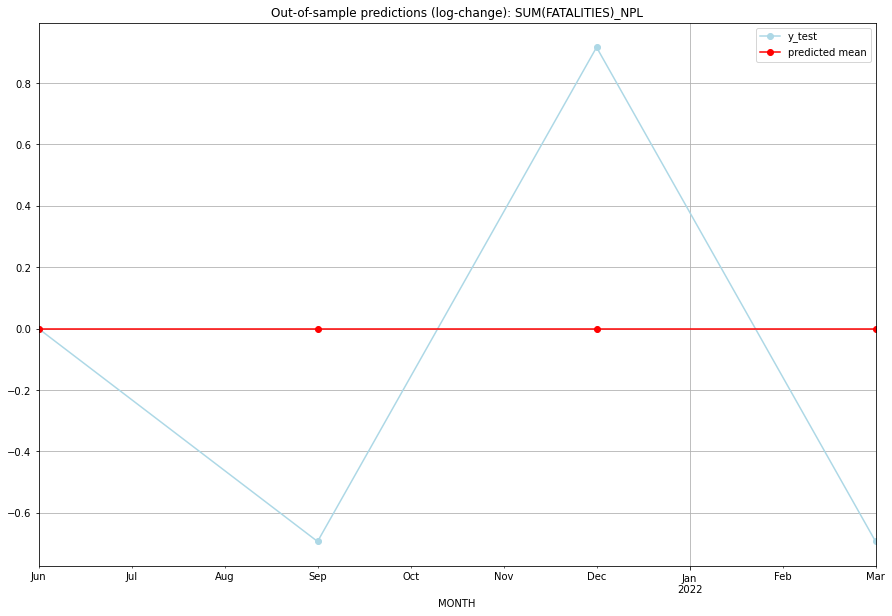

TADDA: 0.5756462732485118
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       1.0         1.0  3.330669e-16        0.000000   NPL   
1 2021-07-01       1.0         0.0  3.330669e-16       -0.693147   NPL   
2 2021-10-01       1.0         4.0  3.330669e-16        0.916291   NPL   
3 2022-01-01       1.0         0.0  3.330669e-16       -0.693147   NPL   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## NZL (159/234) #########
0
Neighbor countries: []
Getting Data for NZL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 60)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient d

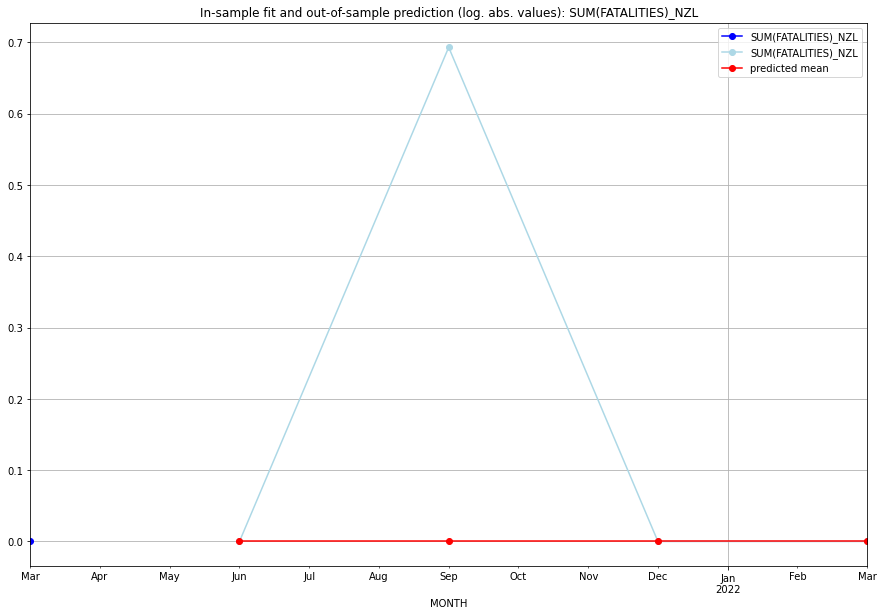

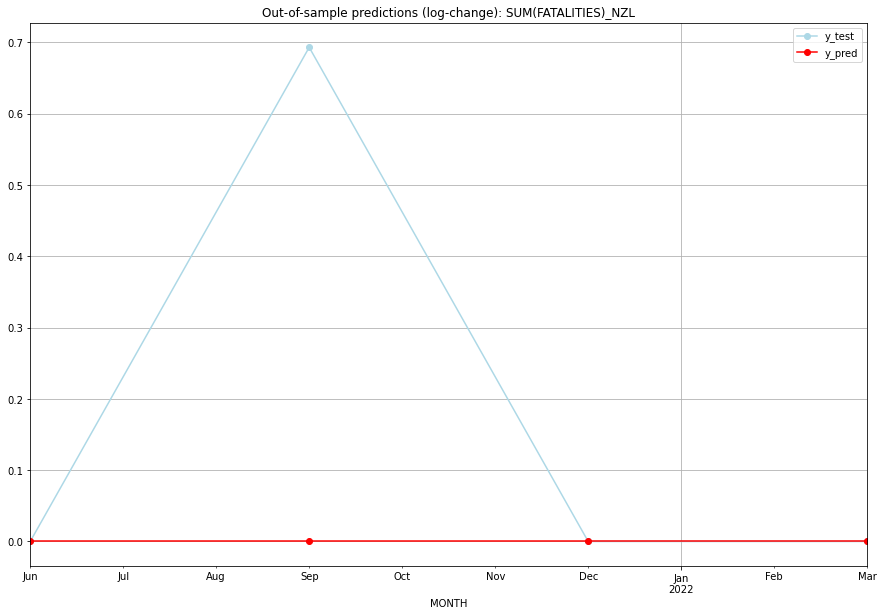

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   NZL   
1 2021-07-01       0.0    0.693147           0.0        0.693147   NZL   
2 2021-10-01       0.0    0.000000           0.0        0.000000   NZL   
3 2022-01-01       0.0    0.000000           0.0        0.000000   NZL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## OMN (160/234) #########
0
Neighbor countries: ['ARE', 'SAU', 'YEM']
Getting Data for OMN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 81)
y: (25, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_OMN   No. Obser

<Figure size 432x288 with 0 Axes>

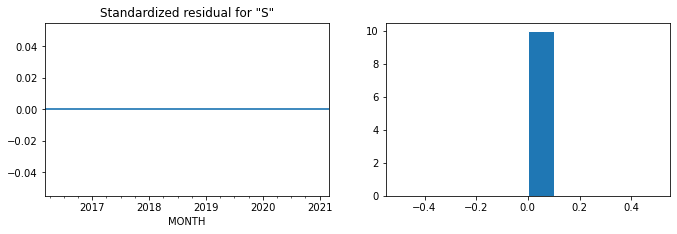

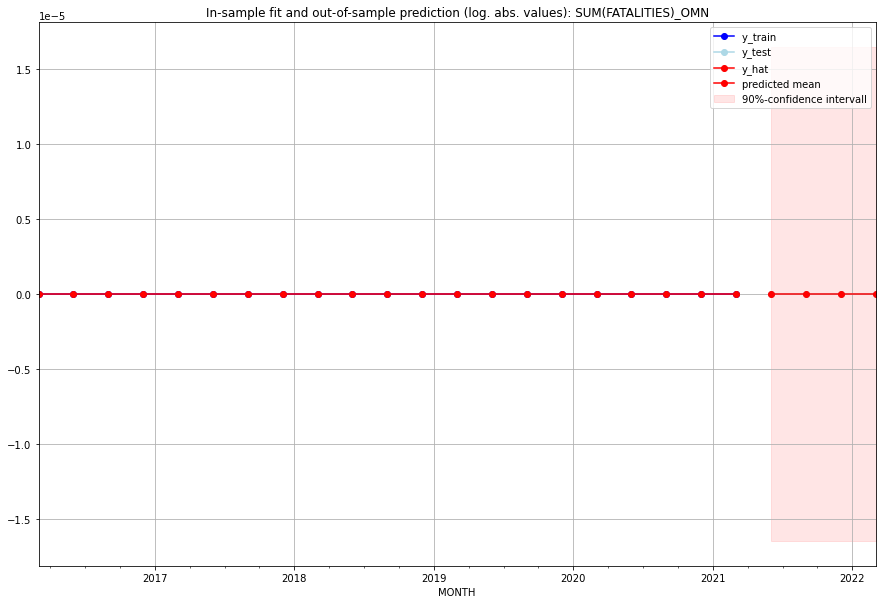

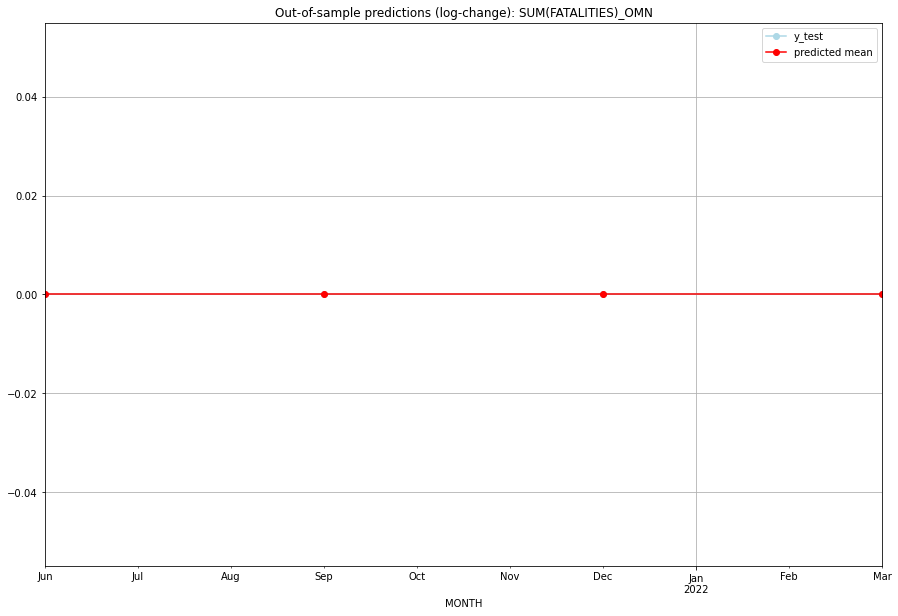

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   OMN   
1 2021-07-01       0.0         0.0           0.0             0.0   OMN   
2 2021-10-01       0.0         0.0           0.0             0.0   OMN   
3 2022-01-01       0.0         0.0           0.0             0.0   OMN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:07
######## PAK (161/234) #########
0
Neighbor countries: ['IND', 'AFG', 'IRN', 'CHN']
Getting Data for PAK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 96)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.2470282726590533, 'fold_results': [0.2861823212959278, 0.32468481586825626, 0.3056530904143877, 0.18277635558857952, 0.1358447801281153]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PAK   No. Observations:                   45
Model:                SARIMAX(1, 0, 0)   Log Likelihood                 -24.469
Date:                 Wed, 19 Oct 2022   AIC                             52.938
Time:                         10:56:18   BIC                             56.551
Sample:                     01-31-2010   HQIC                            54.285
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

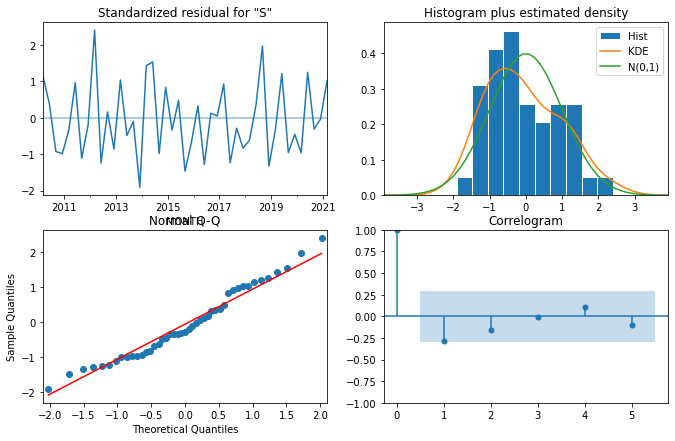

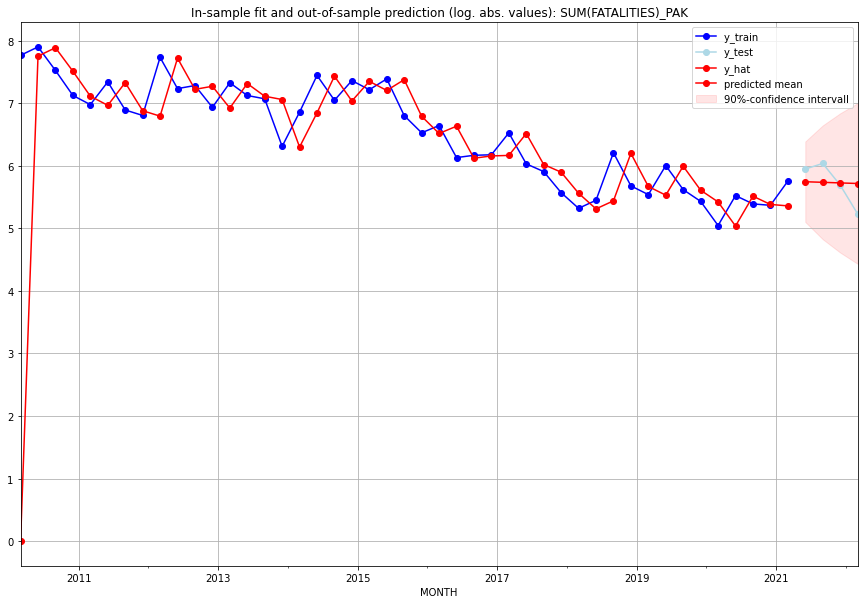

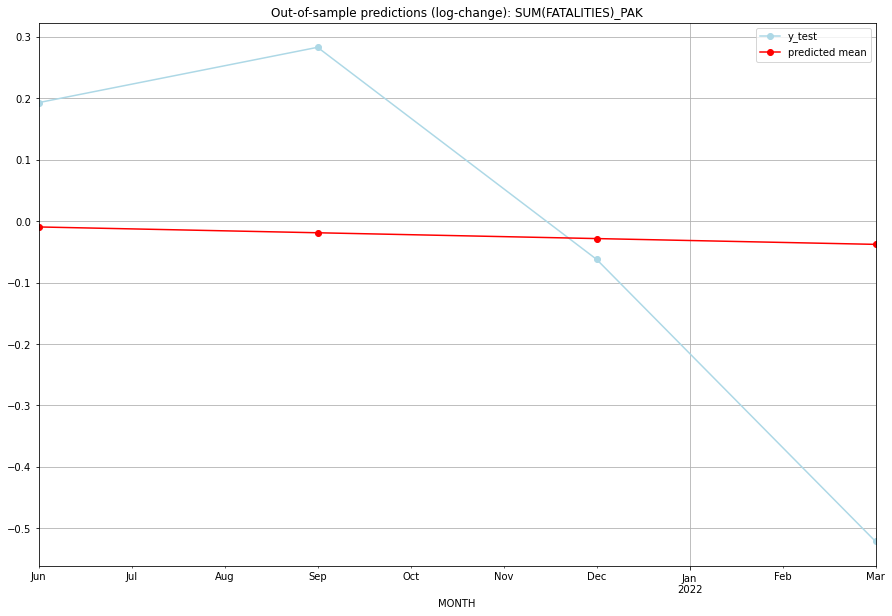

TADDA: 0.26251451904638956
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  311.026274       381.0     -0.009485        0.192848   PAK   
1 2021-07-01  308.085454       417.0     -0.018955        0.282909   PAK   
2 2021-10-01  305.177133       295.0     -0.028409       -0.062213   PAK   
3 2022-01-01  302.300905       186.0     -0.037847       -0.521464   PAK   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## PAN (162/234) #########
0
Neighbor countries: ['CRI', 'COL']
Getting Data for PAN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 79)
y: (17, 1)
------------------------------------------------
Training started.
Start GRID

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.3238257584657317, 'fold_results': [0.34657359027997264, 0.30107792665149075]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PAN   No. Observations:                   13
Model:                SARIMAX(3, 1, 1)   Log Likelihood                  -1.214
Date:                 Wed, 19 Oct 2022   AIC                             18.427
Time:                         10:56:28   BIC                             22.306
Sample:                     01-31-2018   HQIC                            16.991
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1         -9.669e-06      

<Figure size 432x288 with 0 Axes>

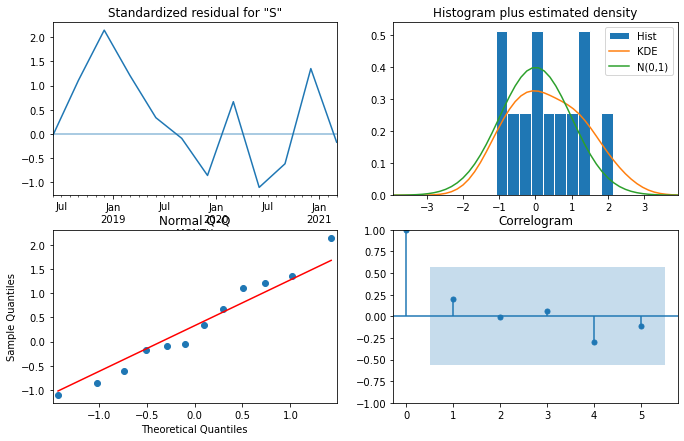

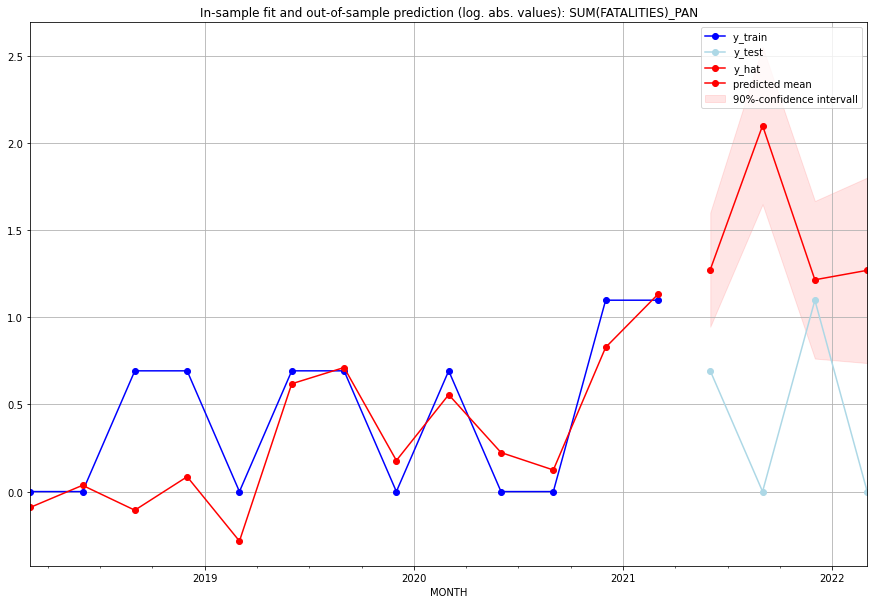

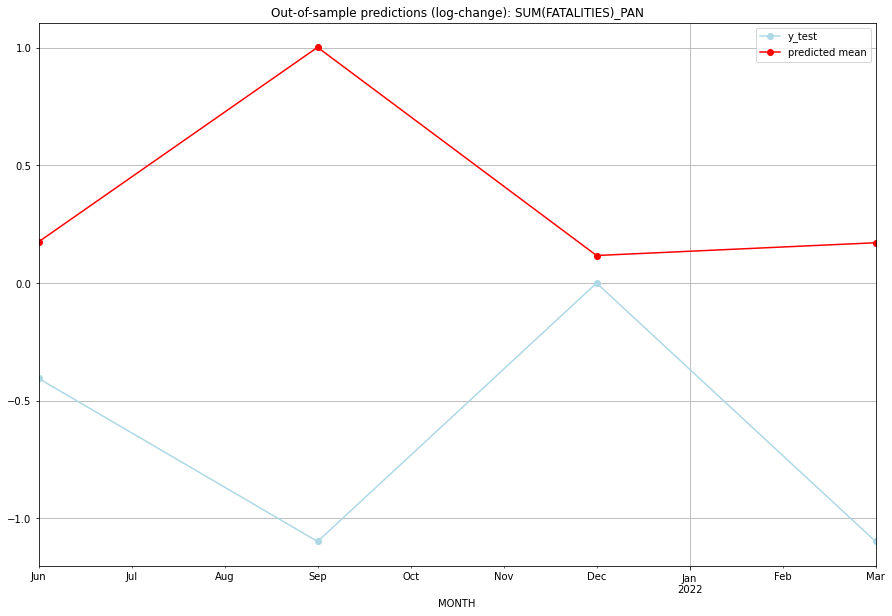

TADDA: 1.354579624278085
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2.574989         1.0      0.175350       -0.405465   PAN   
1 2021-07-01  7.174176         0.0      1.002368       -1.098612   PAN   
2 2021-10-01  2.373134         2.0      0.117230        0.000000   PAN   
3 2022-01-01  2.561189         0.0      0.171482       -1.098612   PAN   

                                          PARAMETERS  
0  {'params': [3, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## PER (163/234) #########
0
Neighbor countries: ['BRA', 'COL', 'ECU', 'BOL', 'CHL']
Getting Data for PER
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 105)
y: (17, 1)
------------------------------------------------
Training started.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.40856163436883836, 'fold_results': [0.2823091236387254, 0.5348141450989513]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PER   No. Observations:                   13
Model:                SARIMAX(2, 0, 0)   Log Likelihood                 -15.013
Date:                 Wed, 19 Oct 2022   AIC                             40.025
Time:                         10:56:50   BIC                             42.850
Sample:                     01-31-2018   HQIC                            39.444
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0184      0

<Figure size 432x288 with 0 Axes>

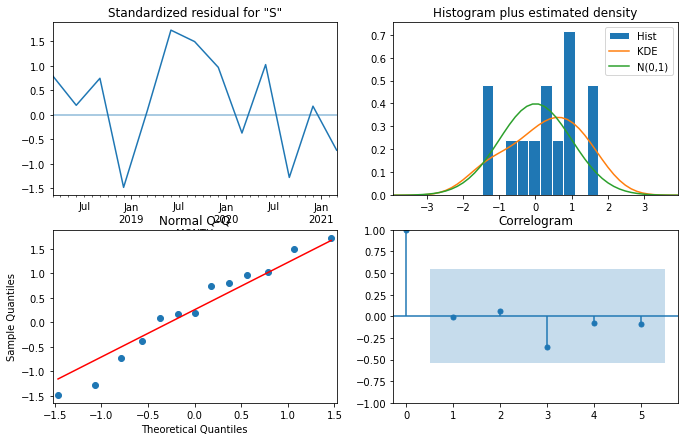

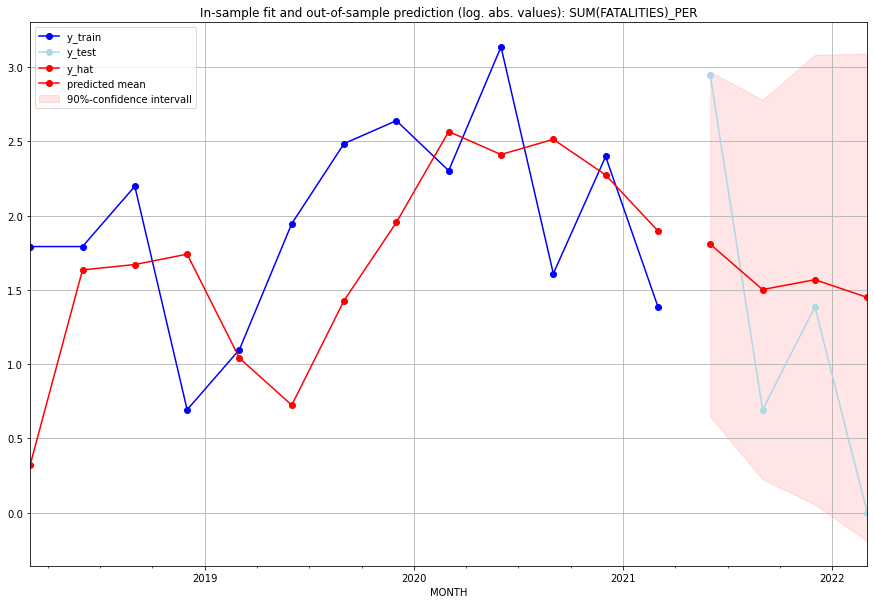

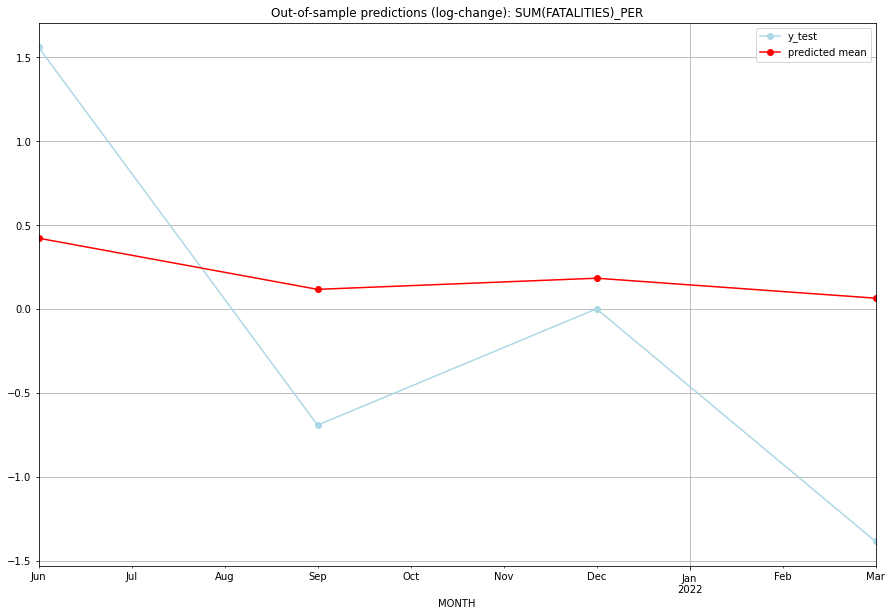

TADDA: 0.9394429825507178
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  5.093459        18.0      0.420922        1.558145   PER   
1 2021-07-01  3.491827         1.0      0.115965       -0.693147   PER   
2 2021-10-01  3.799980         3.0      0.182317        0.000000   PER   
3 2022-01-01  3.261939         0.0      0.063430       -1.386294   PER   

                                          PARAMETERS  
0  {'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## PHL (164/234) #########
0
Neighbor countries: []
Getting Data for PHL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 64)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.19895821170953193, 'fold_results': [0.38443633702911906, 0.15641085552761713, 0.1685553596076632, 0.08643029467372831]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PHL   No. Observations:                   21
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -16.747
Date:                 Wed, 19 Oct 2022   AIC                             37.493
Time:                         10:57:02   BIC                             39.485
Sample:                     01-31-2016   HQIC                            37.882
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

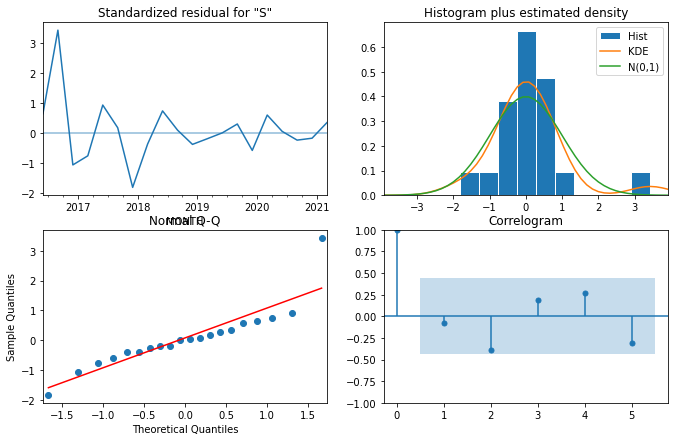

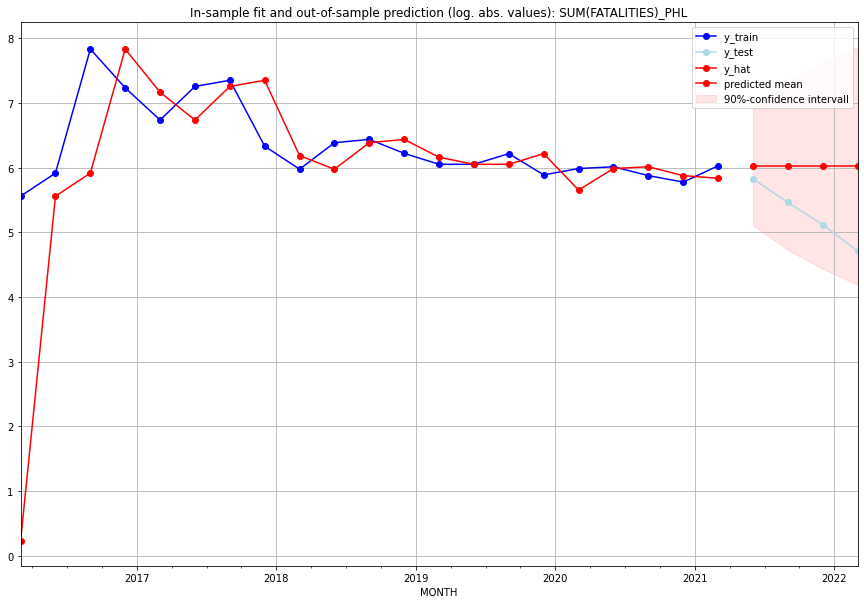

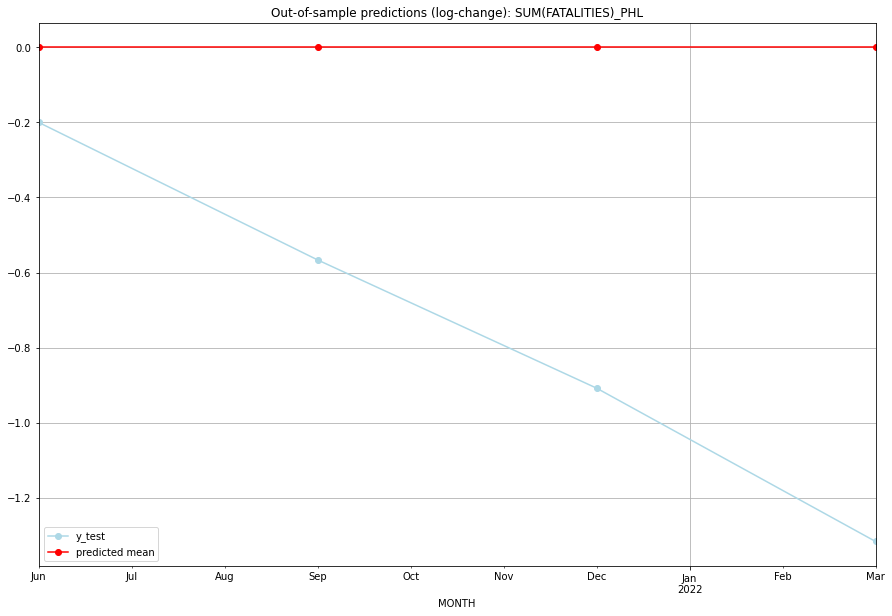

TADDA: 0.7475885650118896
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     413.0       338.0           0.0       -0.199866   PHL   
1 2021-07-01     413.0       234.0           0.0       -0.566280   PHL   
2 2021-10-01     413.0       166.0           0.0       -0.907872   PHL   
3 2022-01-01     413.0       110.0           0.0       -1.316336   PHL   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## PNG (165/234) #########
0
Neighbor countries: ['IDN', 'AUS']
Getting Data for PNG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 74)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. In

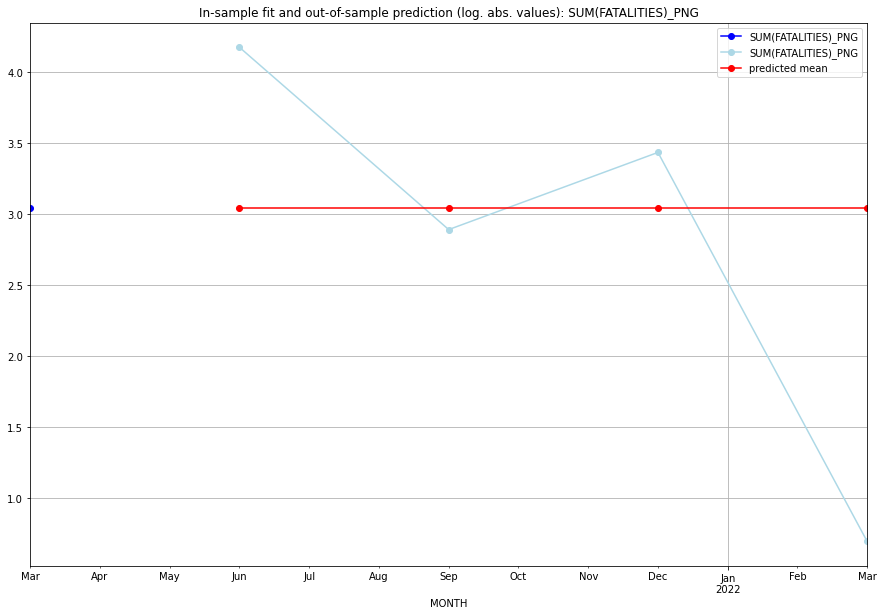

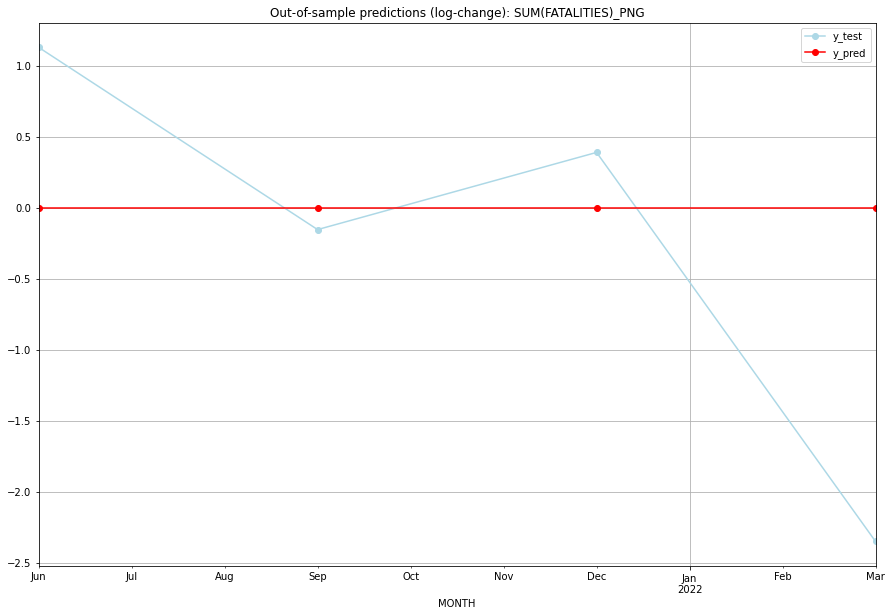

TADDA: 1.0062138839811683
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  3.044522    4.174387           0.0        1.129865   PNG   
1 2021-07-01  3.044522    2.890372           0.0       -0.154151   PNG   
2 2021-10-01  3.044522    3.433987           0.0        0.389465   PNG   
3 2022-01-01  3.044522    0.693147           0.0       -2.351375   PNG   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:05
######## POL (166/234) #########
0
Neighbor countries: ['BLR', 'LTU', 'CZE', 'SVK', 'RUS', 'DEU', 'UKR']
Getting Data for POL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 120)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


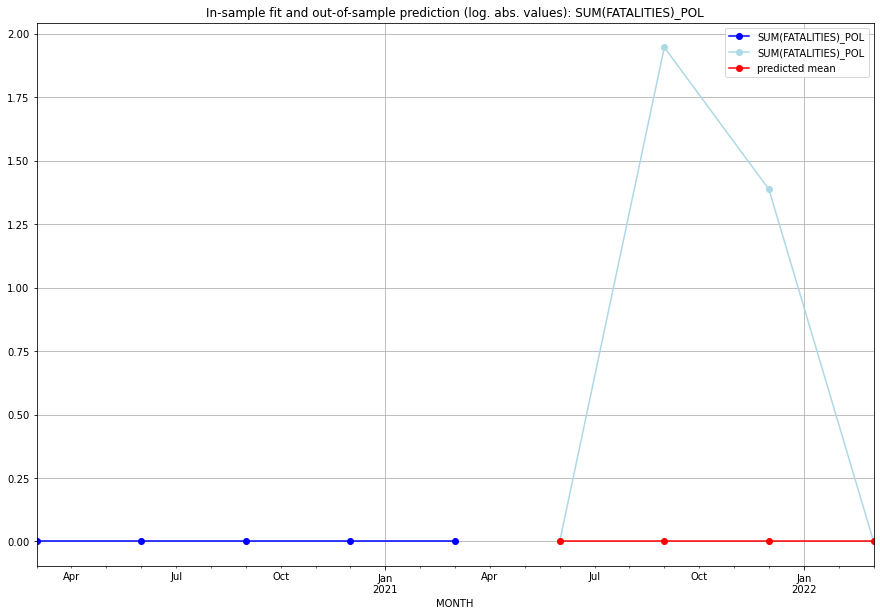

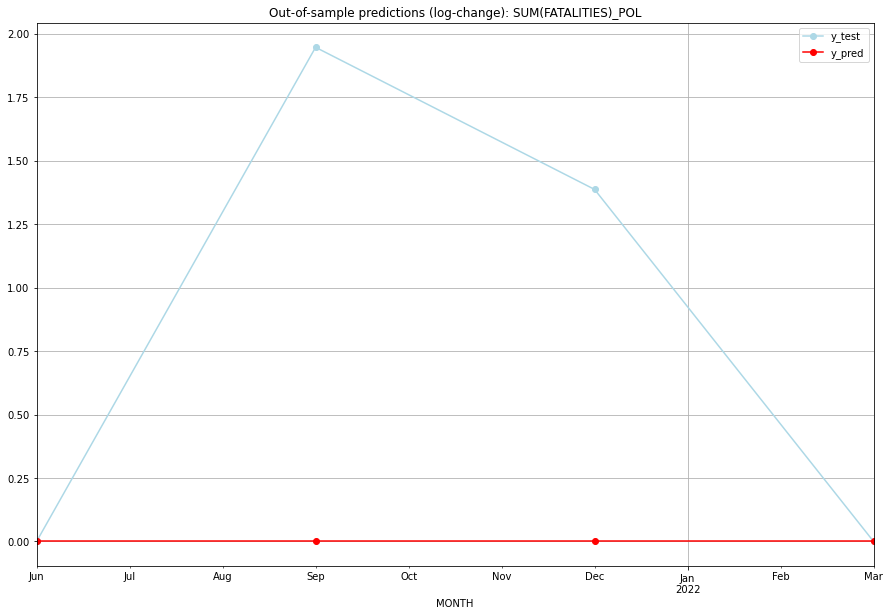

TADDA: 0.8330511275438008
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   POL   
1 2021-07-01       0.0    1.945910           0.0        1.945910   POL   
2 2021-10-01       0.0    1.386294           0.0        1.386294   POL   
3 2022-01-01       0.0    0.000000           0.0        0.000000   POL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## PRI (167/234) #########
0
Neighbor countries: []
Getting Data for PRI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 41)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.24362870553587718, 'fold_results': [0.3143955637328293, 0.17286184733892507]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRI   No. Observations:                   13
Model:                SARIMAX(0, 1, 0)   Log Likelihood                  -5.769
Date:                 Wed, 19 Oct 2022   AIC                             17.537
Time:                         10:57:25   BIC                             18.992
Sample:                     01-31-2018   HQIC                            16.998
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0910      

<Figure size 432x288 with 0 Axes>

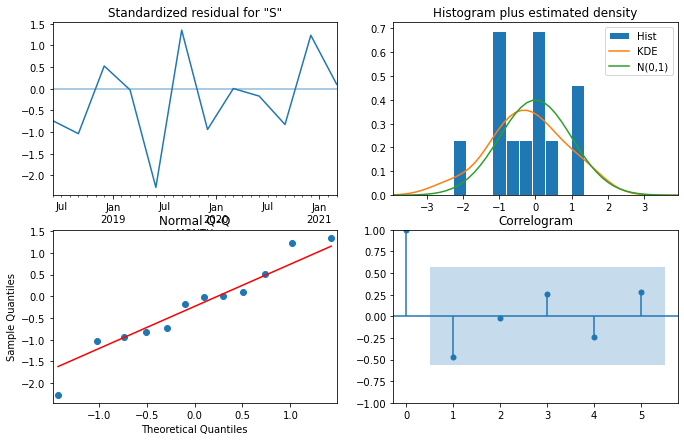

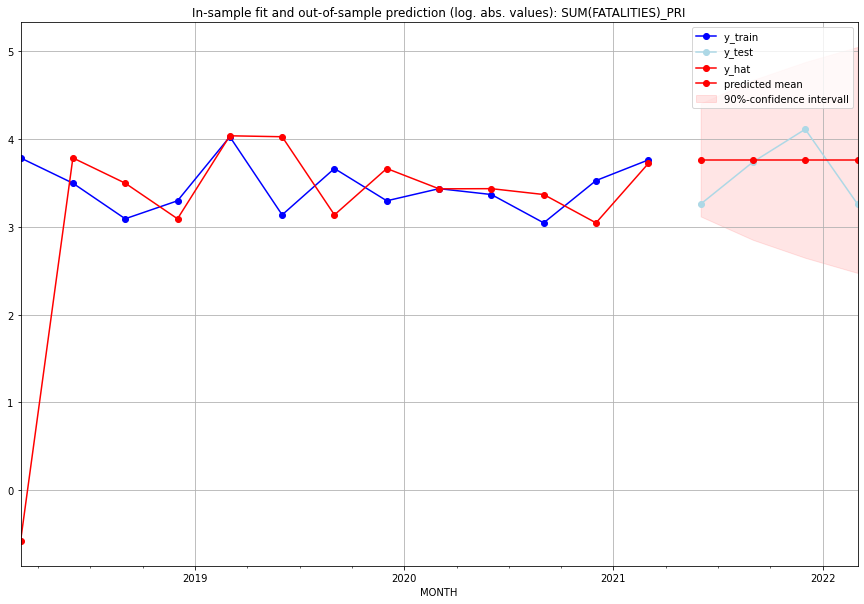

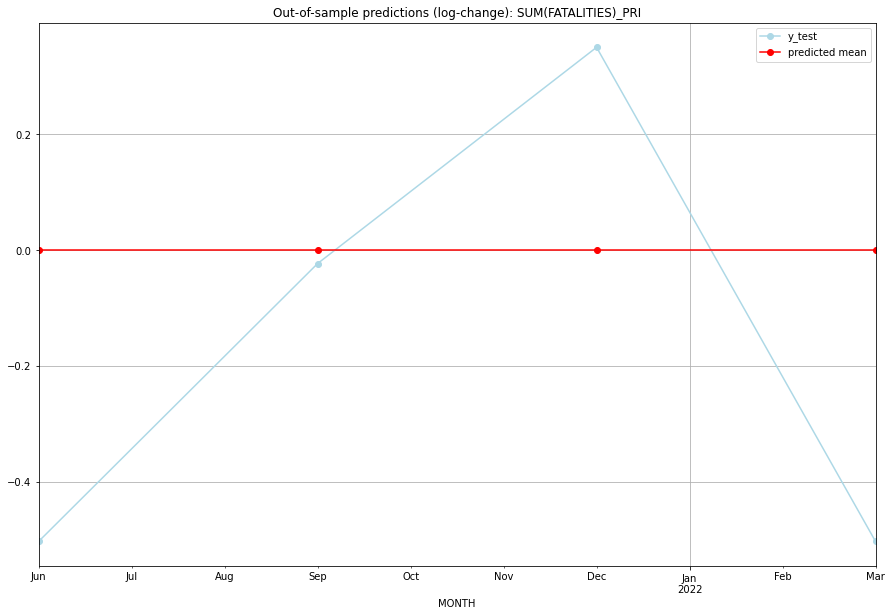

TADDA: 0.3448528503085255
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      42.0        25.0           0.0       -0.503104   PRI   
1 2021-07-01      42.0        41.0           0.0       -0.023530   PRI   
2 2021-10-01      42.0        60.0           0.0        0.349674   PRI   
3 2022-01-01      42.0        25.0           0.0       -0.503104   PRI   

                                          PARAMETERS  
0  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## PRK (168/234) #########
0
Neighbor countries: ['CHN', 'RUS', 'KOR']
Getting Data for PRK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 48)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEAR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6376632364316817, 'fold_results': [0.8502993454155389, 0.42502712744782456]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRK   No. Observations:                   13
Model:                SARIMAX(2, 0, 0)   Log Likelihood                 -16.306
Date:                 Wed, 19 Oct 2022   AIC                             40.612
Time:                         10:57:39   BIC                             42.872
Sample:                     01-31-2018   HQIC                            40.148
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.2122      0

<Figure size 432x288 with 0 Axes>

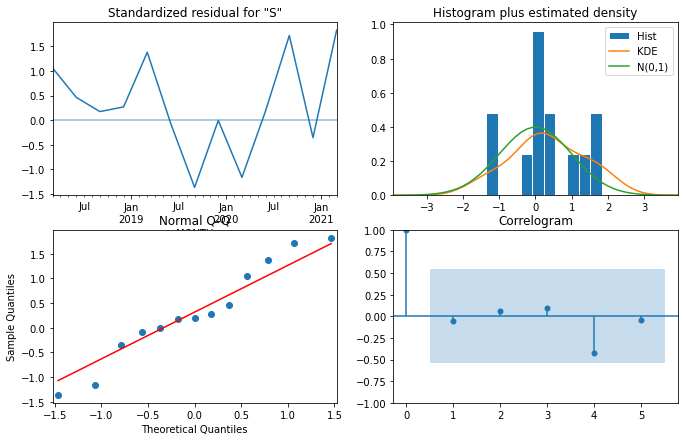

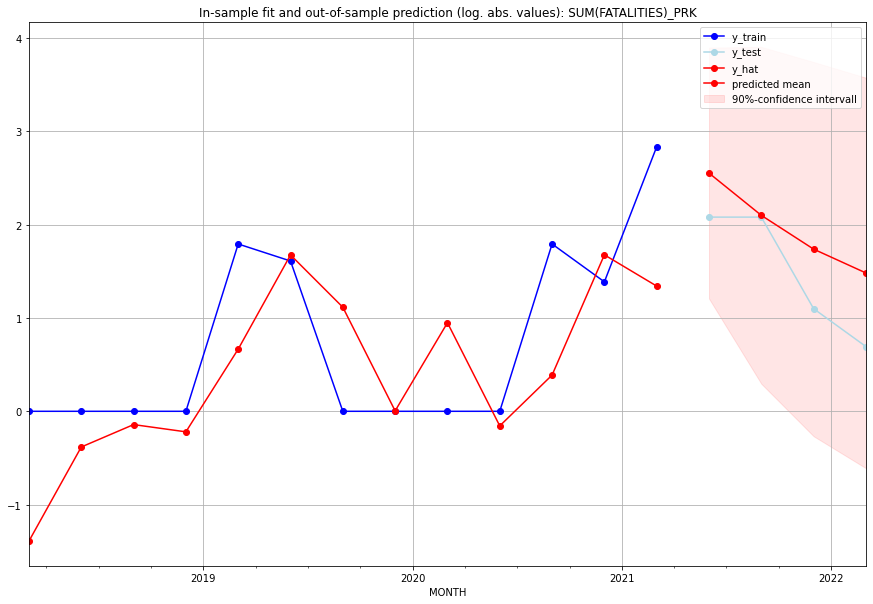

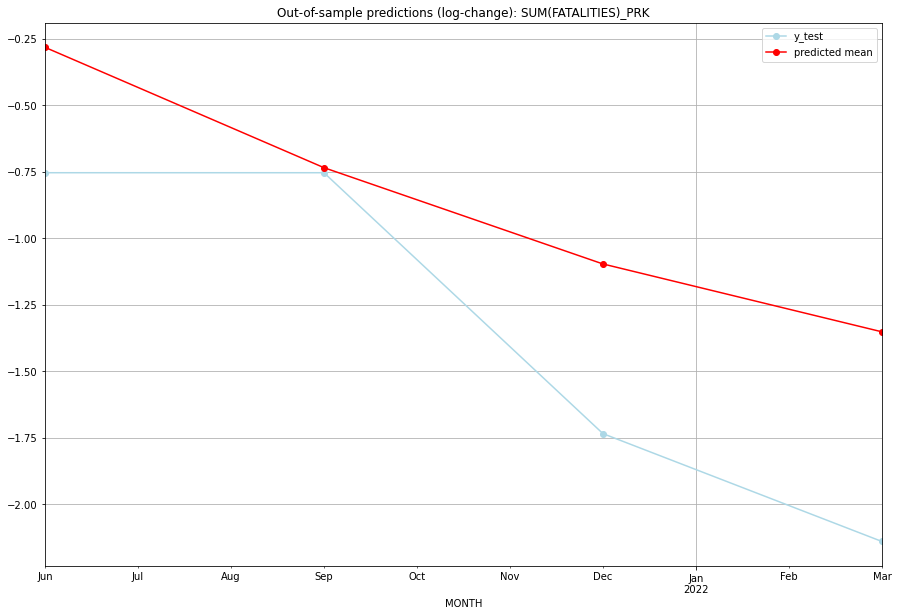

TADDA: 0.47910324386411707
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  11.818344         7.0     -0.282336       -0.753772   PRK   
1 2021-07-01   7.153390         7.0     -0.734780       -0.753772   PRK   
2 2021-10-01   4.677059         2.0     -1.096780       -1.734601   PRK   
3 2022-01-01   3.398709         1.0     -1.351902       -2.140066   PRK   

                                          PARAMETERS  
0  {'params': [1, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## PRT (169/234) #########
0
Neighbor countries: ['ESP']
Getting Data for PRT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 73)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Ins

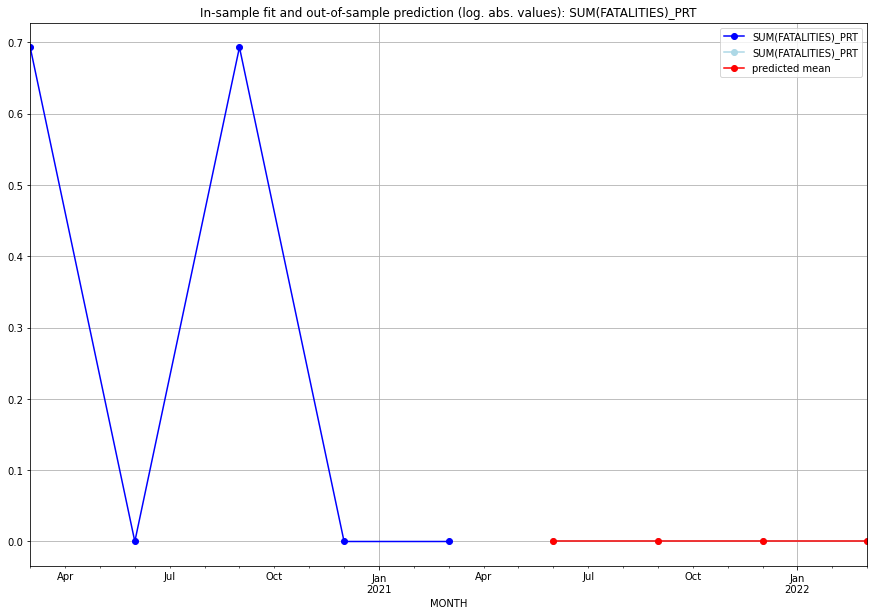

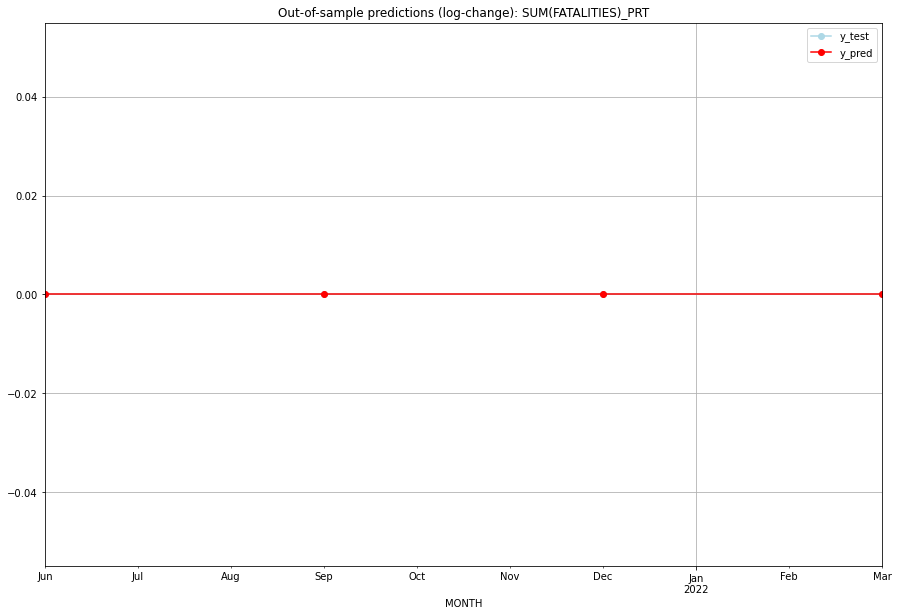

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   PRT   
1 2021-07-01       0.0         0.0           0.0             0.0   PRT   
2 2021-10-01       0.0         0.0           0.0             0.0   PRT   
3 2022-01-01       0.0         0.0           0.0             0.0   PRT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## PRY (170/234) #########
0
Neighbor countries: ['BRA', 'ARG', 'BOL']
Getting Data for PRY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 88)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.47385483282011687, 'fold_results': [0.6746278543605151, 0.2730818112797187]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRY   No. Observations:                   13
Model:                SARIMAX(0, 1, 2)   Log Likelihood                  -9.956
Date:                 Wed, 19 Oct 2022   AIC                             29.913
Time:                         10:57:58   BIC                             32.337
Sample:                     01-31-2018   HQIC                            29.015
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0660      0

<Figure size 432x288 with 0 Axes>

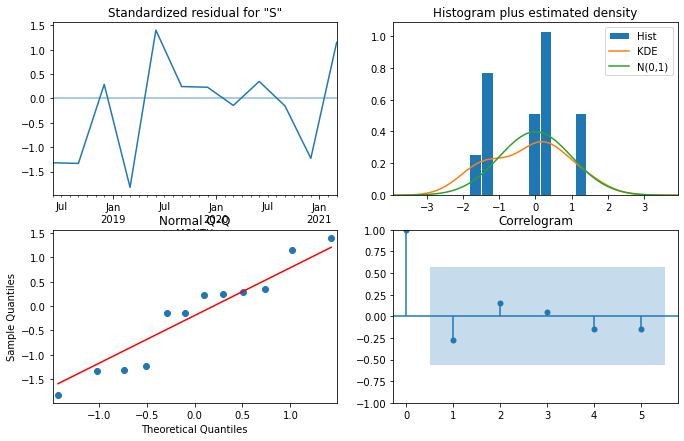

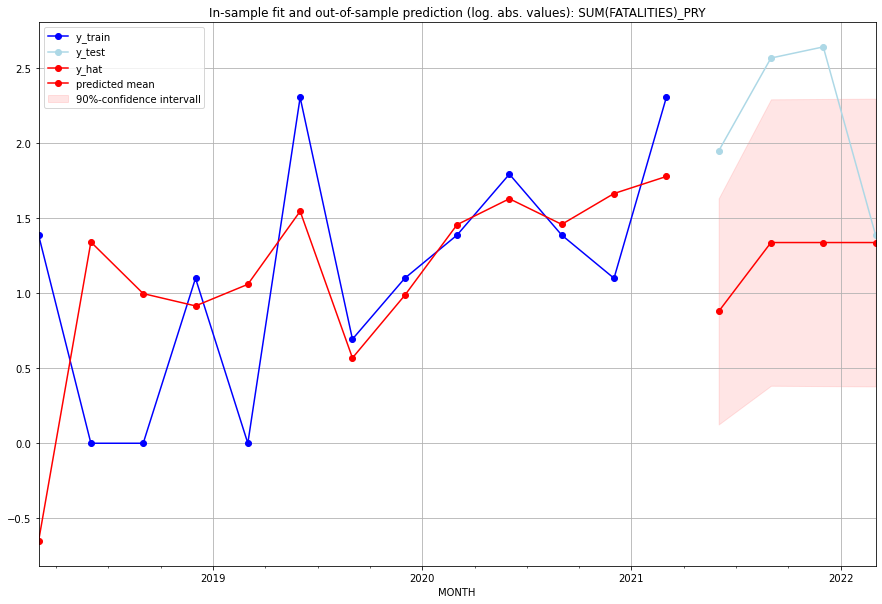

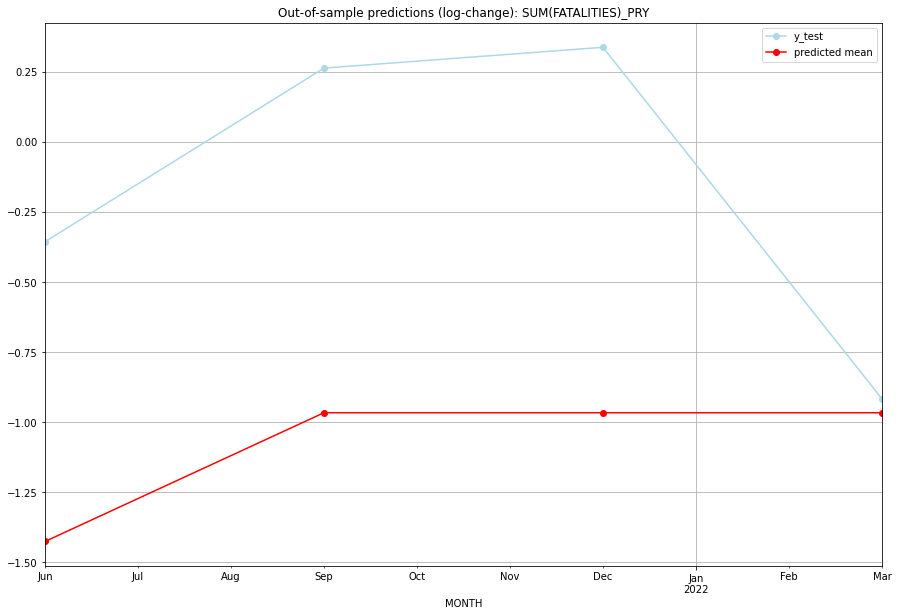

TADDA: 1.3953906374390188
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.404803         6.0     -1.425117       -0.356675   PRY   
1 2021-07-01  2.805587        12.0     -0.966115        0.262364   PRY   
2 2021-10-01  2.805587        13.0     -0.966115        0.336472   PRY   
3 2022-01-01  2.805587         3.0     -0.966115       -0.916291   PRY   

                                          PARAMETERS  
0  {'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## PSE (171/234) #########
0
Neighbor countries: ['EGY', 'ISR', 'JOR']
Getting Data for PSE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 68)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEAR

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5293802345859232, 'fold_results': [0.1003974366251249, nan, 0.4317196771121796, 1.056023590020465]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PSE   No. Observations:                   21
Model:                SARIMAX(1, 0, 2)   Log Likelihood                 -13.115
Date:                 Wed, 19 Oct 2022   AIC                             40.230
Time:                         10:58:20   BIC                             47.542
Sample:                     01-31-2016   HQIC                            41.817
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1   

<Figure size 432x288 with 0 Axes>

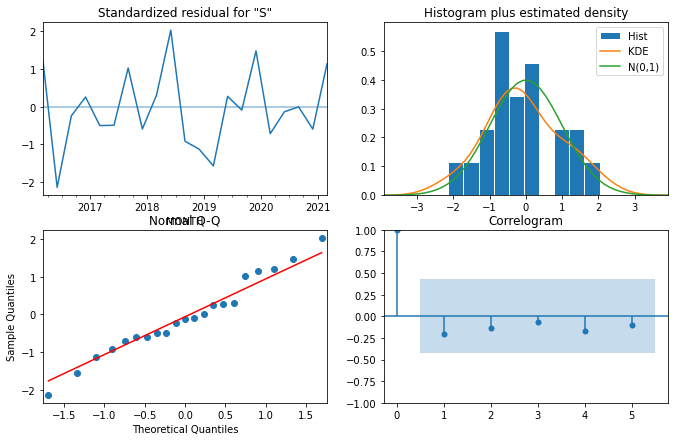

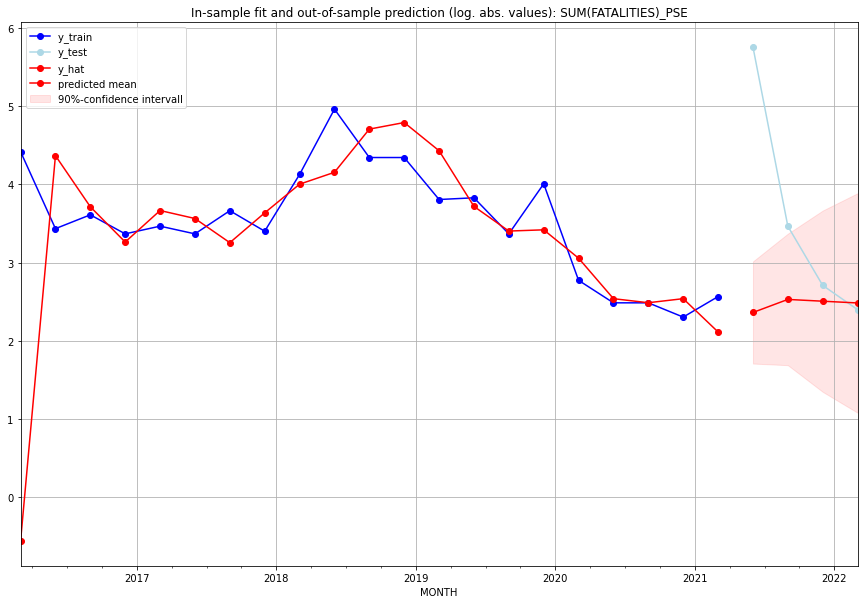

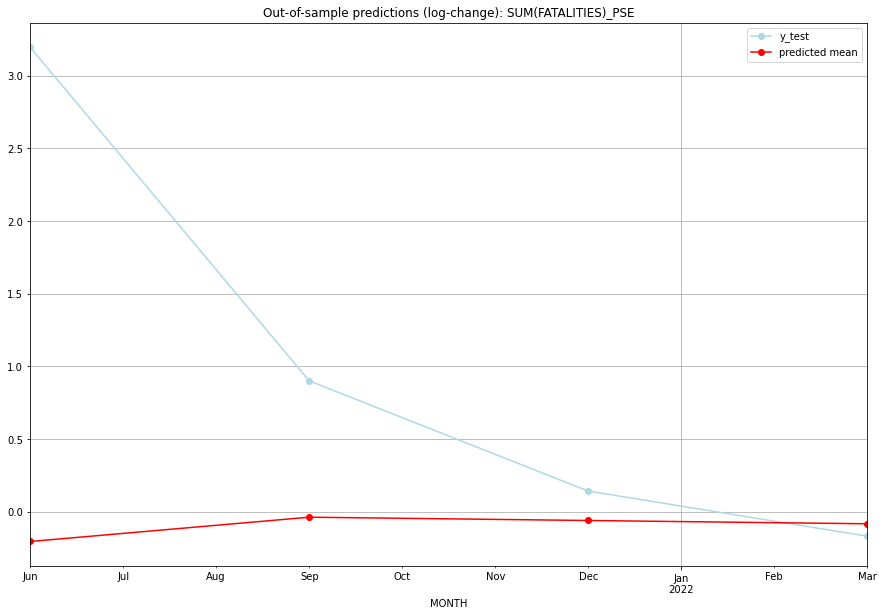

TADDA: 1.2303934222830661
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   9.606075       316.0     -0.203522        3.193952   PSE   
1 2021-07-01  11.534167        31.0     -0.036491        0.900787   PSE   
2 2021-10-01  11.253096        14.0     -0.059171        0.143101   PSE   
3 2022-01-01  10.980265        10.0     -0.081689       -0.167054   PSE   

                                          PARAMETERS  
0  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## PYF (172/234) #########
0
Neighbor countries: []
Getting Data for PYF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficie

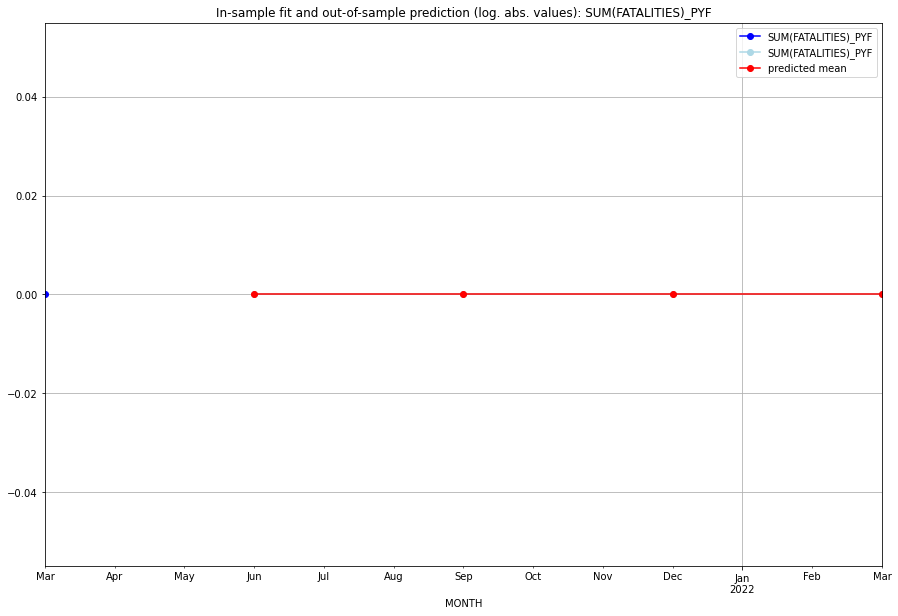

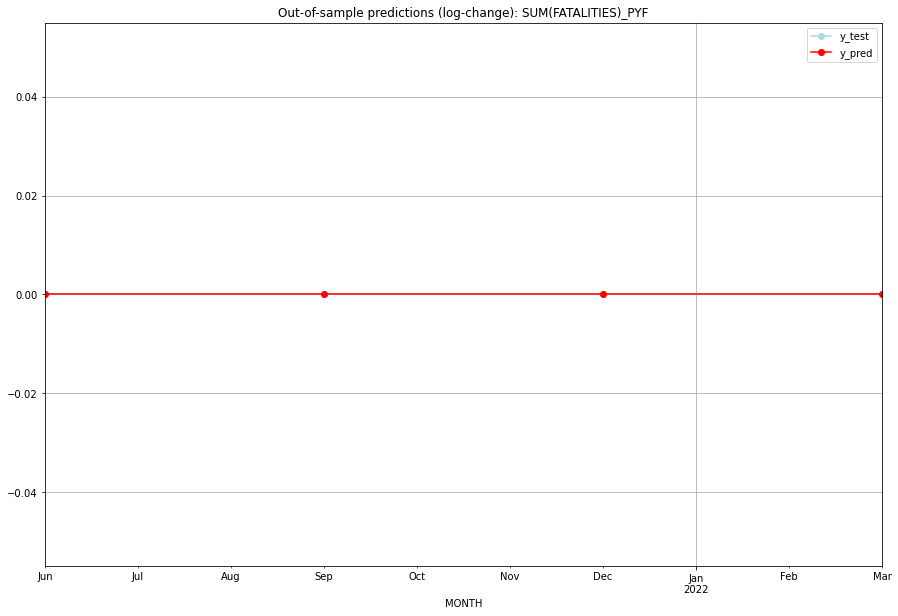

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   PYF   
1 2021-07-01       0.0         0.0           0.0             0.0   PYF   
2 2021-10-01       0.0         0.0           0.0             0.0   PYF   
3 2022-01-01       0.0         0.0           0.0             0.0   PYF   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## QAT (173/234) #########
0
Neighbor countries: ['SAU']
Getting Data for QAT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (21, 60)
y: (21, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_QAT   No. Observations:                   17


<Figure size 432x288 with 0 Axes>

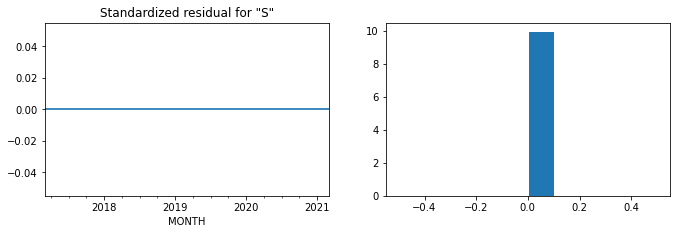

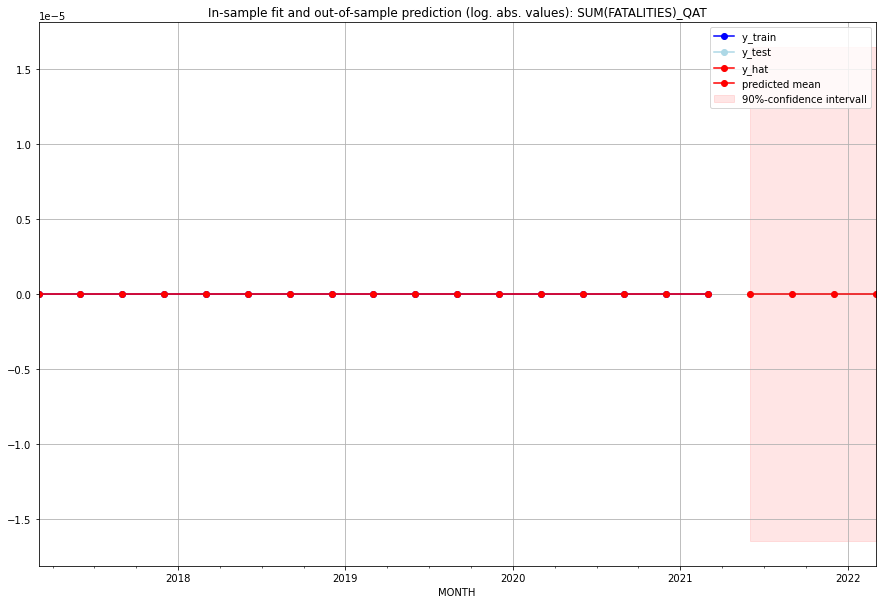

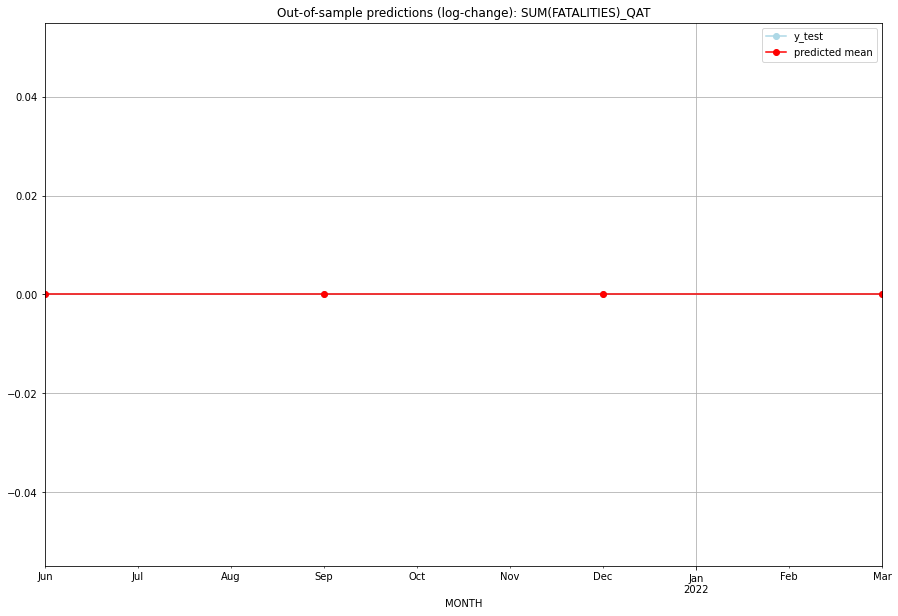

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   QAT   
1 2021-07-01       0.0         0.0           0.0             0.0   QAT   
2 2021-10-01       0.0         0.0           0.0             0.0   QAT   
3 2022-01-01       0.0         0.0           0.0             0.0   QAT   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:03
######## REU (174/234) #########
0
Neighbor countries: []
Getting Data for REU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_REU   No. Observations:                   96
Model:   

<Figure size 432x288 with 0 Axes>

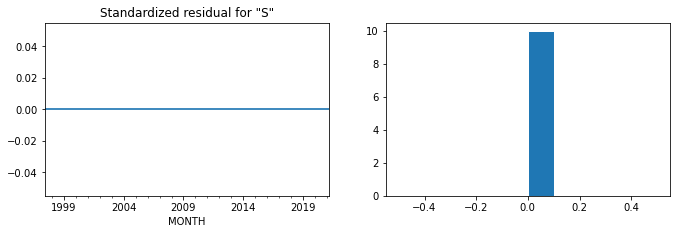

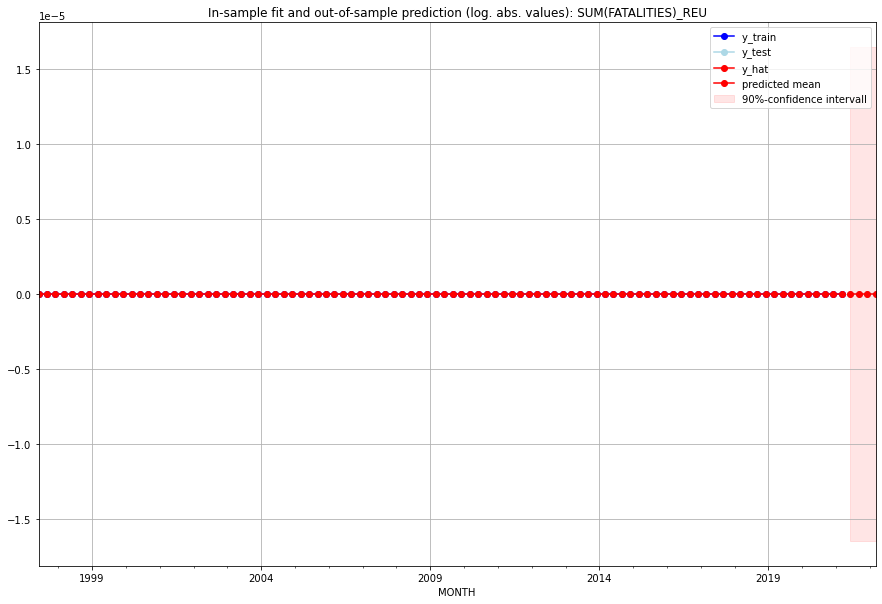

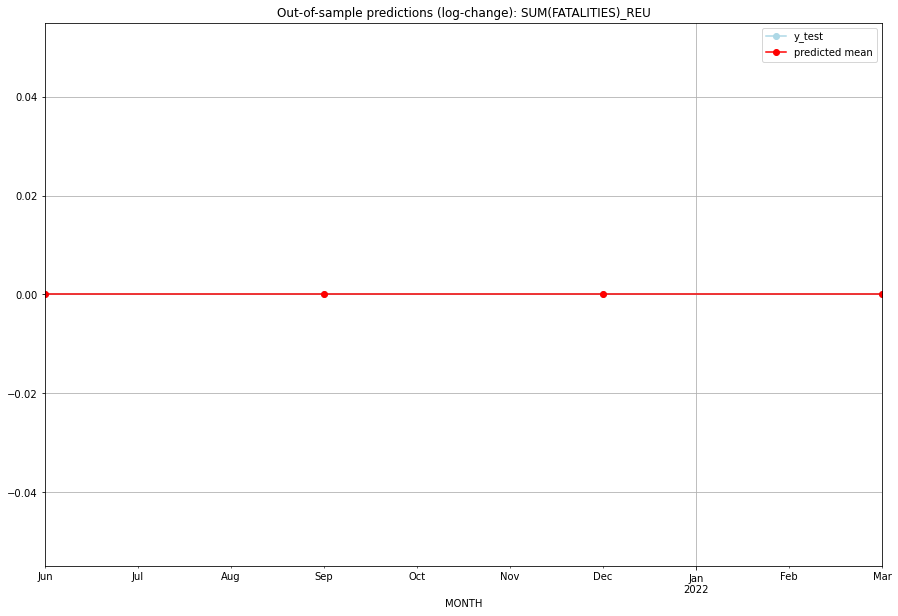

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   REU   
1 2021-07-01       0.0         0.0           0.0             0.0   REU   
2 2021-10-01       0.0         0.0           0.0             0.0   REU   
3 2022-01-01       0.0         0.0           0.0             0.0   REU   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:04
######## ROU (175/234) #########
0
Neighbor countries: ['BGR', 'SRB', 'MDA', 'UKR', 'HUN']
Getting Data for ROU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 104)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.17328679513998632, 'fold_results': [0.17328679513998632, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ROU   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                  -6.225
Date:                 Wed, 19 Oct 2022   AIC                             18.449
Time:                         10:58:39   BIC                             20.144
Sample:                     01-31-2018   HQIC                            18.101
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1      -1.029e-05   1.32e+04  -7.77e-1

<Figure size 432x288 with 0 Axes>

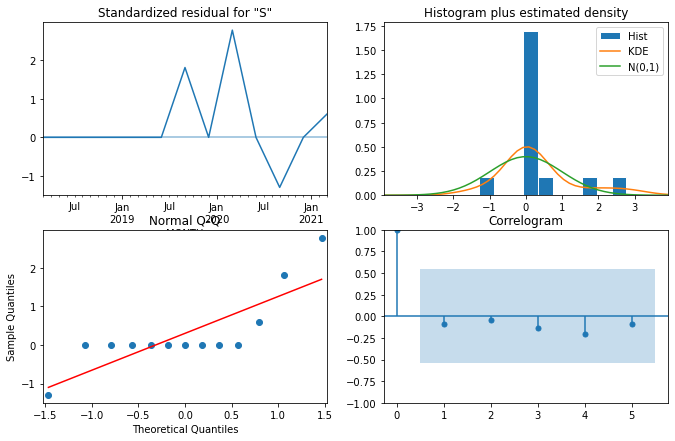

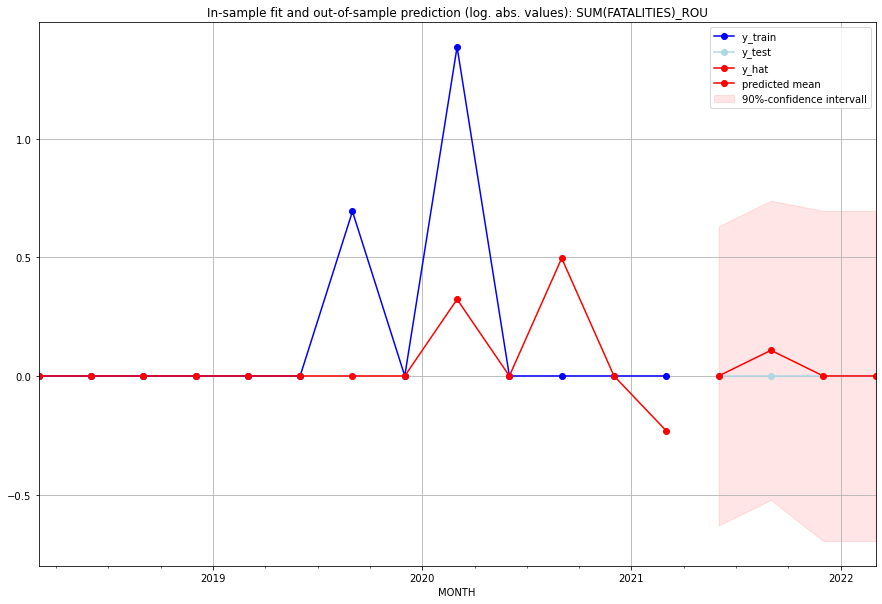

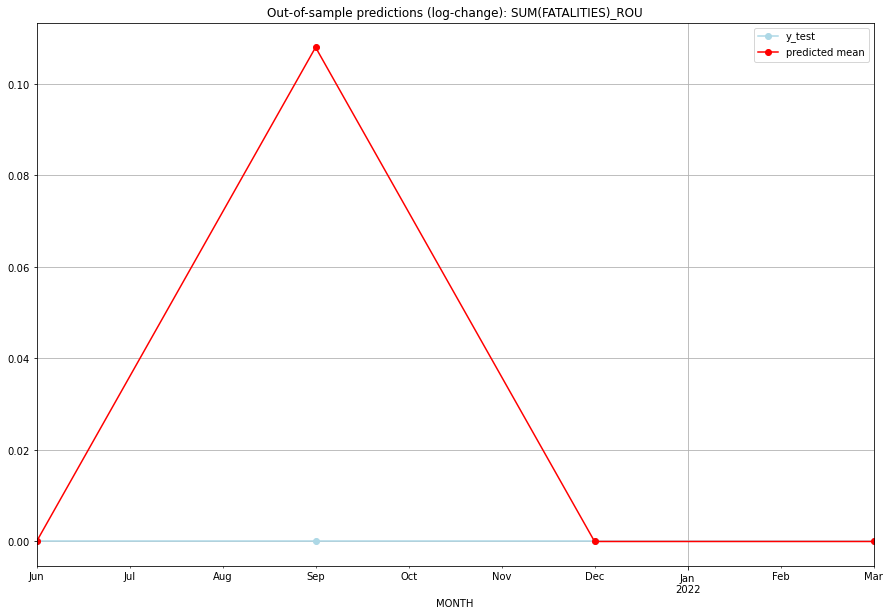

TADDA: 0.02700273021257072
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   0.00000         0.0      0.000000             0.0   ROU   
1 2021-07-01   0.11406         0.0      0.108011             0.0   ROU   
2 2021-10-01   0.00000         0.0      0.000000             0.0   ROU   
3 2022-01-01   0.00000         0.0      0.000000             0.0   ROU   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## RUS (176/234) #########
0
Neighbor countries: ['GEO', 'KAZ', 'AZE', 'CHN', 'MNG', 'LTU', 'POL', 'FIN', 'UKR', 'EST', 'NOR', 'PRK', 'BLR', 'LVA']
Getting Data for RUS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 175)
y: (17, 1)
--

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.2098724878848402, 'fold_results': [0.2098724878848402, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_RUS   No. Observations:                   13
Model:                SARIMAX(1, 0, 2)   Log Likelihood                  -7.430
Date:                 Wed, 19 Oct 2022   AIC                             24.860
Time:                         10:58:59   BIC                             27.685
Sample:                     01-31-2018   HQIC                            24.280
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0265      0.055      0.479 

<Figure size 432x288 with 0 Axes>

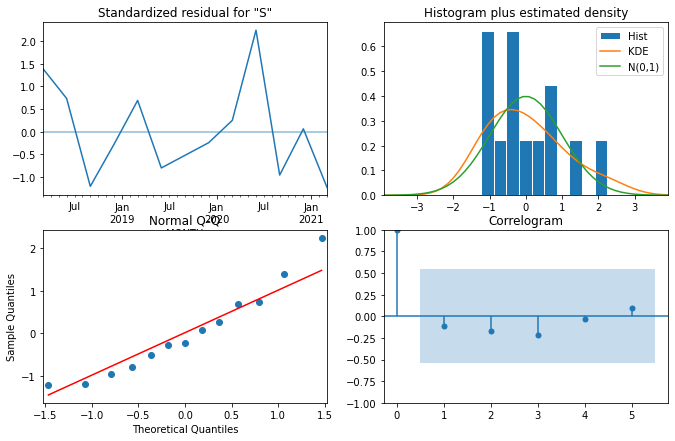

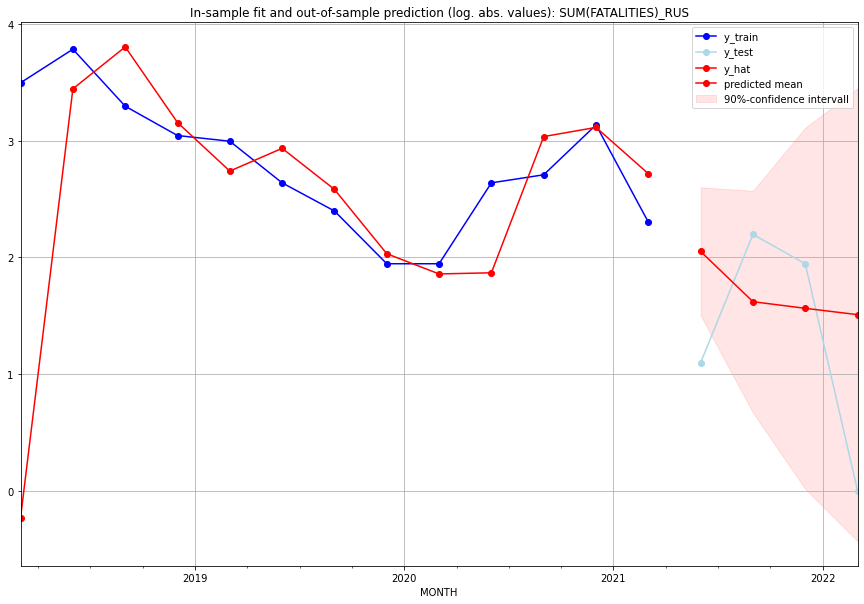

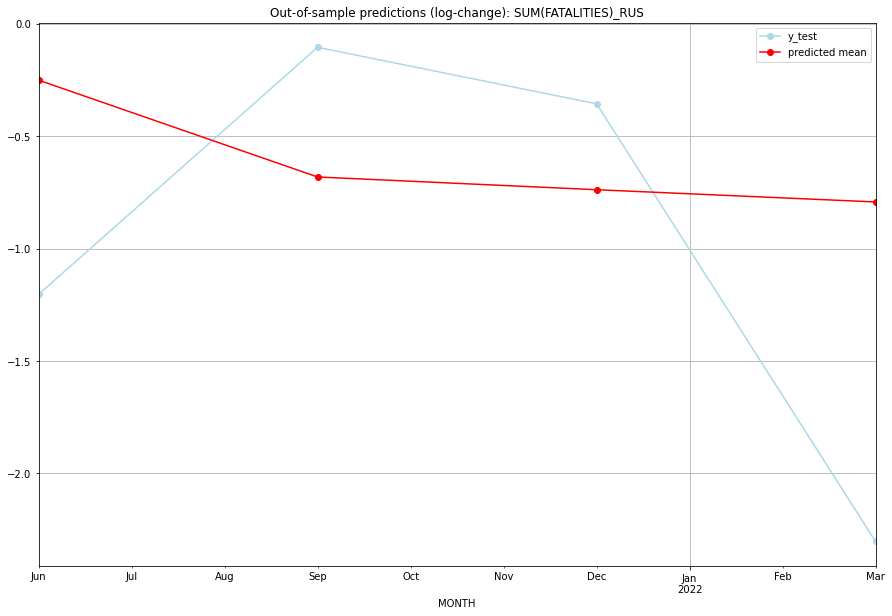

TADDA: 0.8551662883175781
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  6.777470         2.0     -0.251354       -1.203973   RUS   
1 2021-07-01  4.056762         8.0     -0.681859       -0.105361   RUS   
2 2021-10-01  3.778001         6.0     -0.738563       -0.356675   RUS   
3 2022-01-01  3.525194         0.0     -0.792925       -2.302585   RUS   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:29
######## RWA (177/234) #########
0
Neighbor countries: ['COD', 'UGA', 'BDI', 'TZA']
Getting Data for RWA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 93)
y: (100, 1)
------------------------------------------------
Training started.
Start

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 1.044257174542705, 'fold_results': [0.8457121668213854, 1.0332996518995747, 1.1232001363878776, 1.7624143875390779, 0.45665953006560933]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_RWA   No. Observations:                   96
Model:                SARIMAX(0, 1, 1)   Log Likelihood                -171.575
Date:                 Wed, 19 Oct 2022   AIC                            349.150
Time:                         10:59:31   BIC                            356.811
Sample:                     04-30-1997   HQIC                           352.245
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

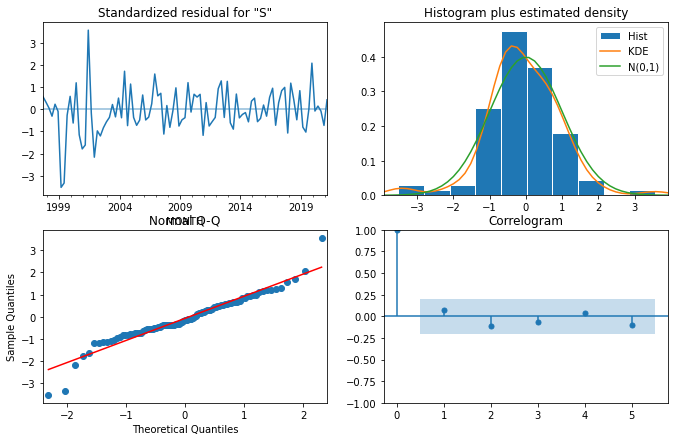

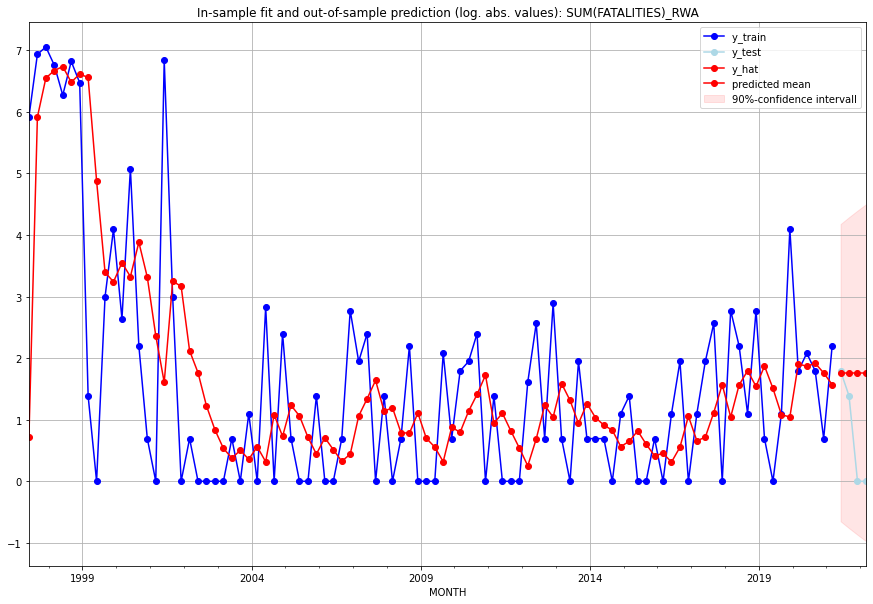

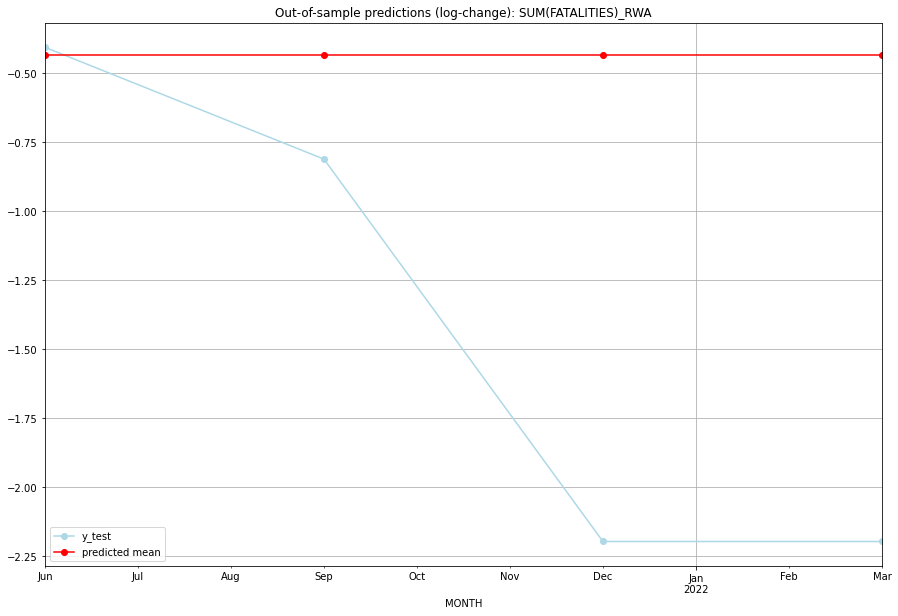

TADDA: 0.98331841777789
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  4.835175         5.0      -0.43332       -0.405465   RWA   
1 2021-07-01  4.835175         3.0      -0.43332       -0.810930   RWA   
2 2021-10-01  4.835175         0.0      -0.43332       -2.197225   RWA   
3 2022-01-01  4.835175         0.0      -0.43332       -2.197225   RWA   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:23
######## SAU (178/234) #########
0
Neighbor countries: ['YEM', 'IRQ', 'JOR', 'ARE', 'BHR', 'KWT', 'OMN', 'QAT']
Getting Data for SAU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (29, 119)
y: (29, 1)
-----------------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6550567944083907, 'fold_results': [0.9466398258183949, 0.4556367732635853, 0.17905906239493619, 0.4979943188029934, 1.1959539917620439]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SAU   No. Observations:                   25
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -40.334
Date:                 Wed, 19 Oct 2022   AIC                             82.668
Time:                         10:59:46   BIC                             83.846
Sample:                     01-31-2015   HQIC                            82.981
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

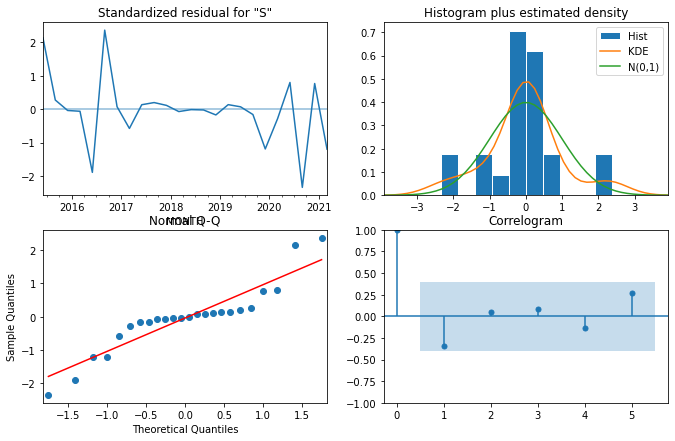

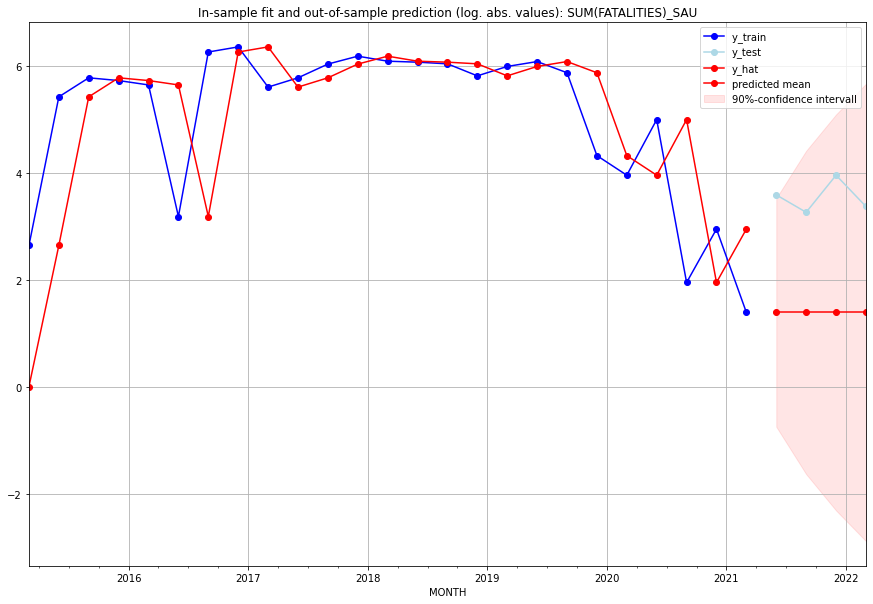

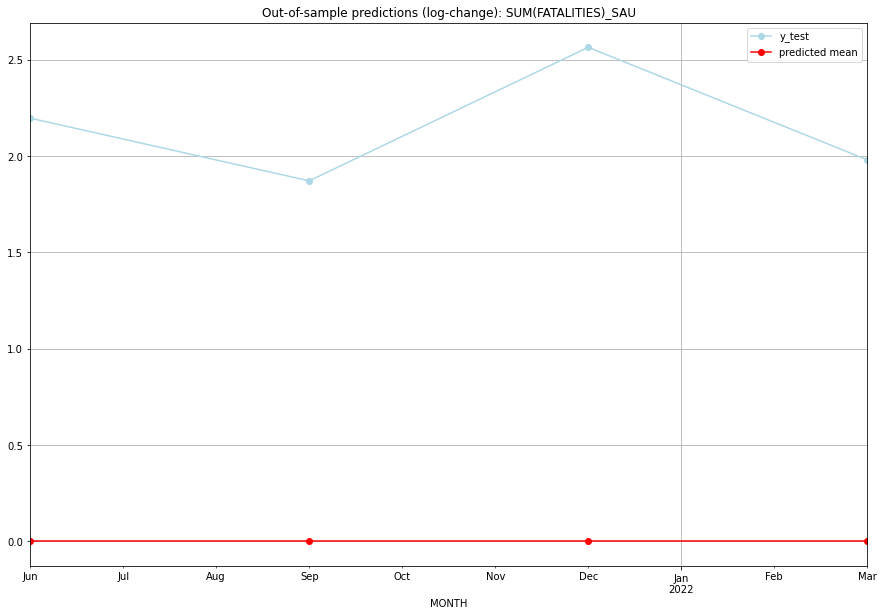

TADDA: 2.1537443951414827
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       3.0        35.0           0.0        2.197225   SAU   
1 2021-07-01       3.0        25.0           0.0        1.871802   SAU   
2 2021-10-01       3.0        51.0           0.0        2.564949   SAU   
3 2022-01-01       3.0        28.0           0.0        1.981001   SAU   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## SDN (179/234) #########
0
Neighbor countries: ['EGY', 'LBY', 'ERI', 'ETH', 'SSD', 'CAF', 'XKK', 'TCD', 'XAR']
Getting Data for SDN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 132)
y: (100, 1)
------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.522662007330306, 'fold_results': [0.9021460142907756, 0.625420388225689, 0.28484704269409633, 0.26168418689391326, 0.5392124045470557]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SDN   No. Observations:                   96
Model:                SARIMAX(3, 0, 2)   Log Likelihood                -131.279
Date:                 Wed, 19 Oct 2022   AIC                            280.558
Time:                         11:00:10   BIC                            303.638
Sample:                     04-30-1997   HQIC                           289.887
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

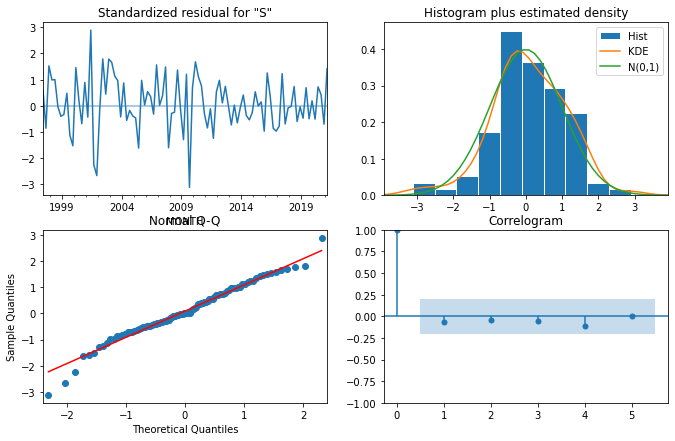

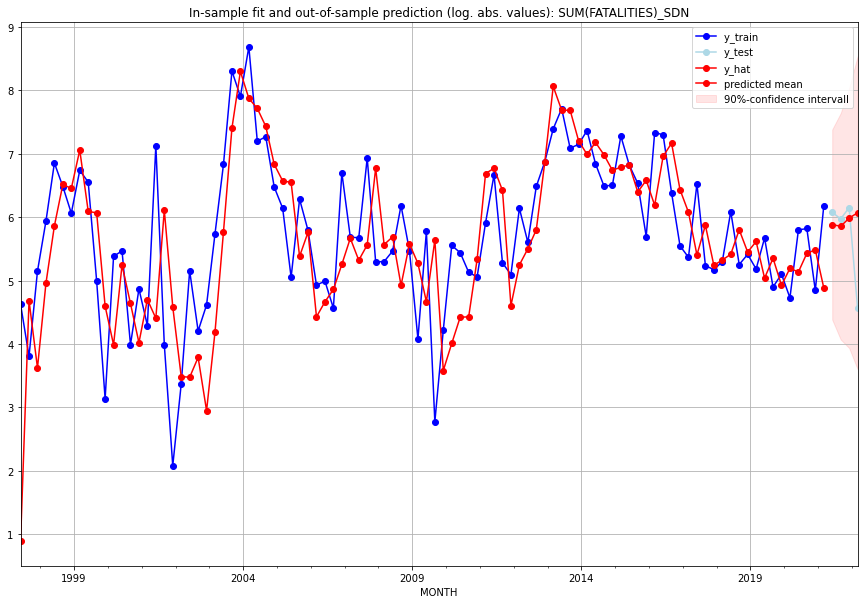

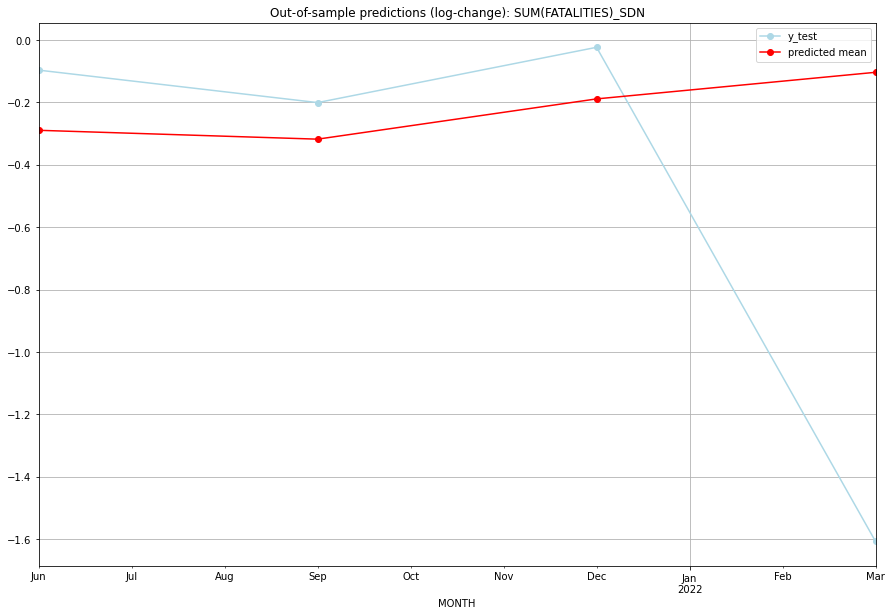

TADDA: 0.49487667988287587
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  357.686760       434.0     -0.289251       -0.096355   SDN   
1 2021-07-01  347.639757       391.0     -0.317661       -0.200439   SDN   
2 2021-10-01  395.667414       467.0     -0.188602       -0.023232   SDN   
3 2022-01-01  430.974073        95.0     -0.103335       -1.607352   SDN   

                                          PARAMETERS  
0  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:24
######## SEN (180/234) #########
0
Neighbor countries: ['MRT', 'GMB', 'GNB', 'GIN', 'MLI']
Getting Data for SEN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 101)
y: (100, 1)
------------------------------------------------
Trai

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.739134104855476, 'fold_results': [0.9819265672909201, 0.7062149400306619, 1.2007559071189542, 0.3956938019832006, 0.41107930785364366]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SEN   No. Observations:                   96
Model:                SARIMAX(3, 0, 3)   Log Likelihood                -158.882
Date:                 Wed, 19 Oct 2022   AIC                            337.763
Time:                         11:00:35   BIC                            363.407
Sample:                     04-30-1997   HQIC                           348.129
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

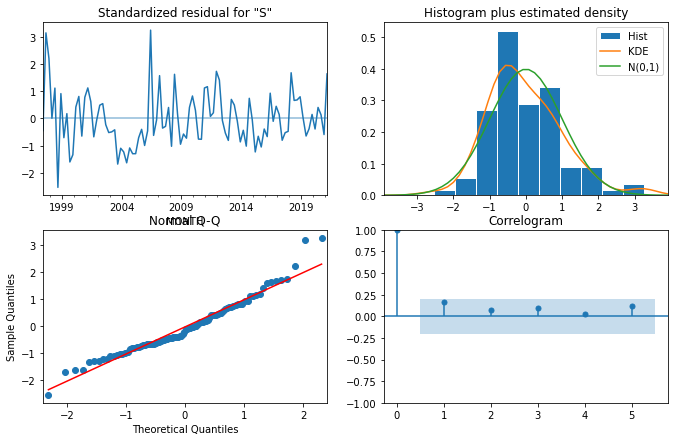

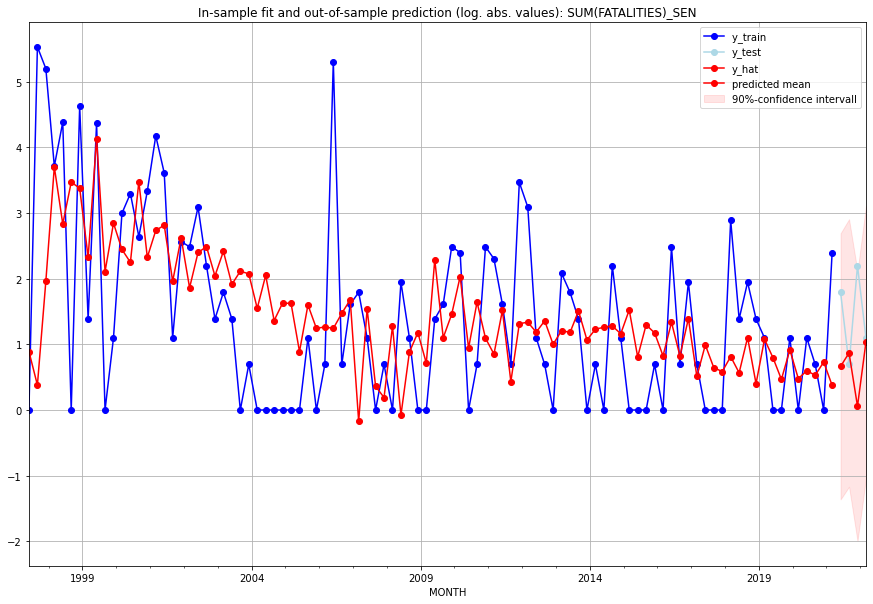

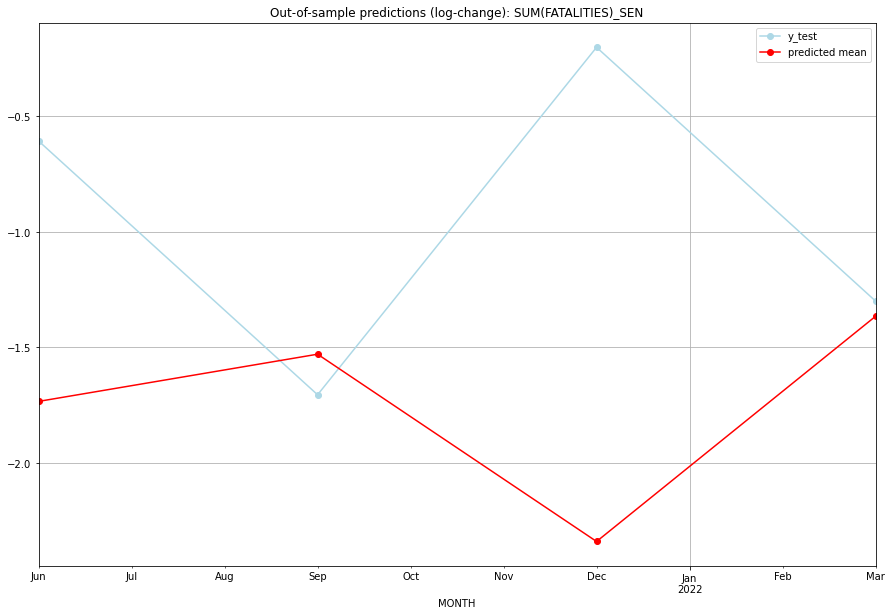

TADDA: 0.8769753207351374
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.943372         5.0     -1.733471       -0.606136   SEN   
1 2021-07-01  1.383881         1.0     -1.529166       -1.704748   SEN   
2 2021-10-01  0.059688         8.0     -2.339921       -0.200671   SEN   
3 2022-01-01  1.809140         2.0     -1.365017       -1.299283   SEN   

                                          PARAMETERS  
0  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## SGP (181/234) #########
0
Neighbor countries: []
Getting Data for SGP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 55)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient d

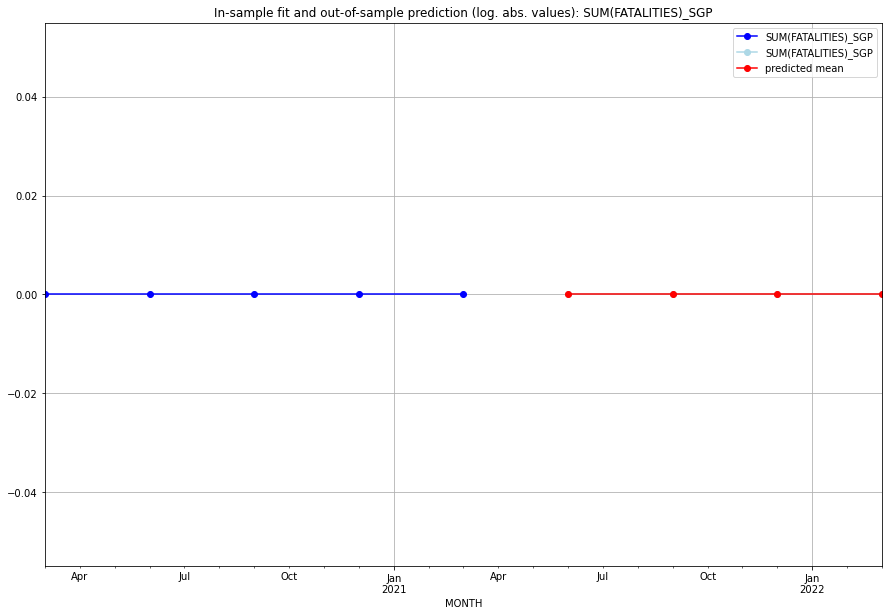

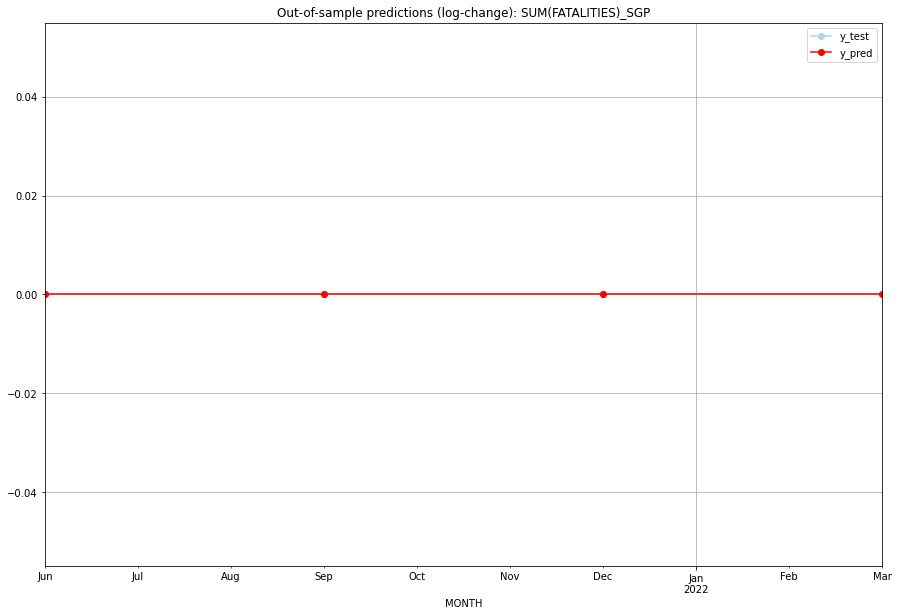

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SGP   
1 2021-07-01       0.0         0.0           0.0             0.0   SGP   
2 2021-10-01       0.0         0.0           0.0             0.0   SGP   
3 2022-01-01       0.0         0.0           0.0             0.0   SGP   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## SHN (182/234) #########
0
Neighbor countries: []
Getting Data for SHN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SHN   No. Observations:                   96
Mode

<Figure size 432x288 with 0 Axes>

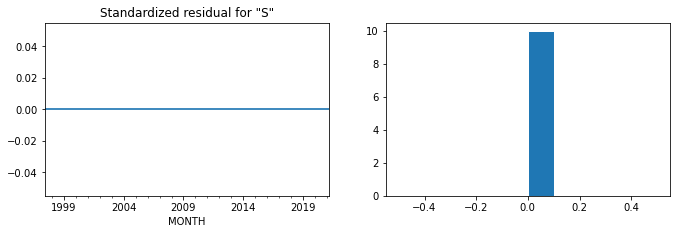

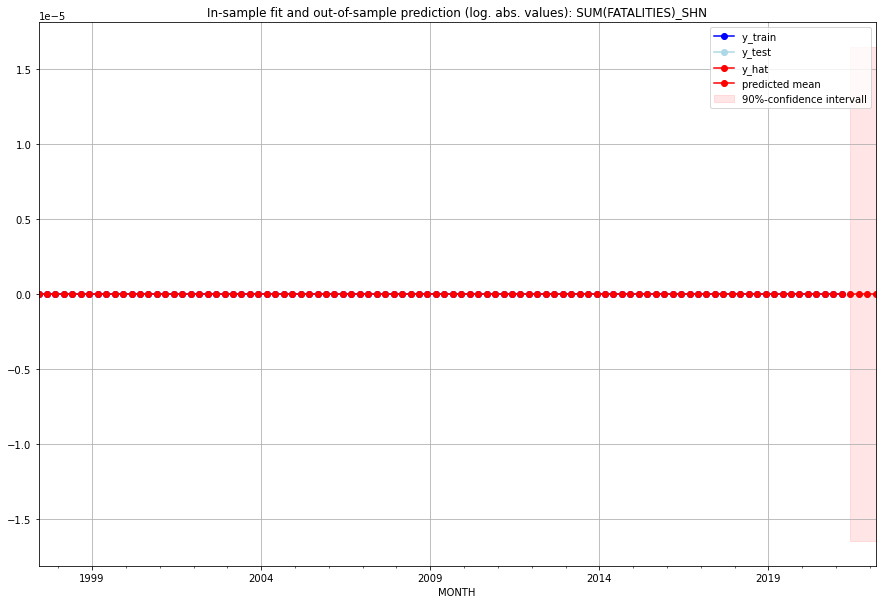

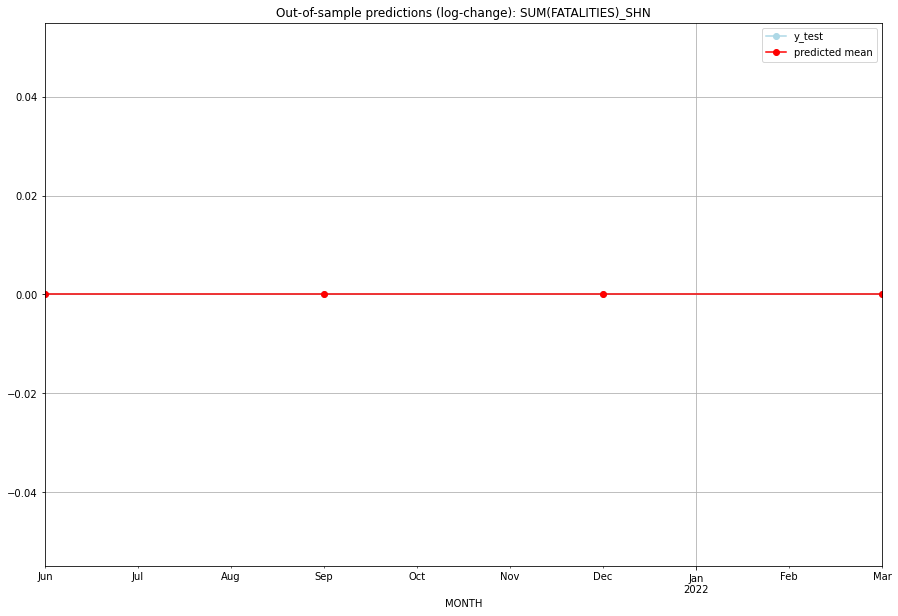

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SHN   
1 2021-07-01       0.0         0.0           0.0             0.0   SHN   
2 2021-10-01       0.0         0.0           0.0             0.0   SHN   
3 2022-01-01       0.0         0.0           0.0             0.0   SHN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## SJM (183/234) #########
0
Neighbor countries: []
Getting Data for SJM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


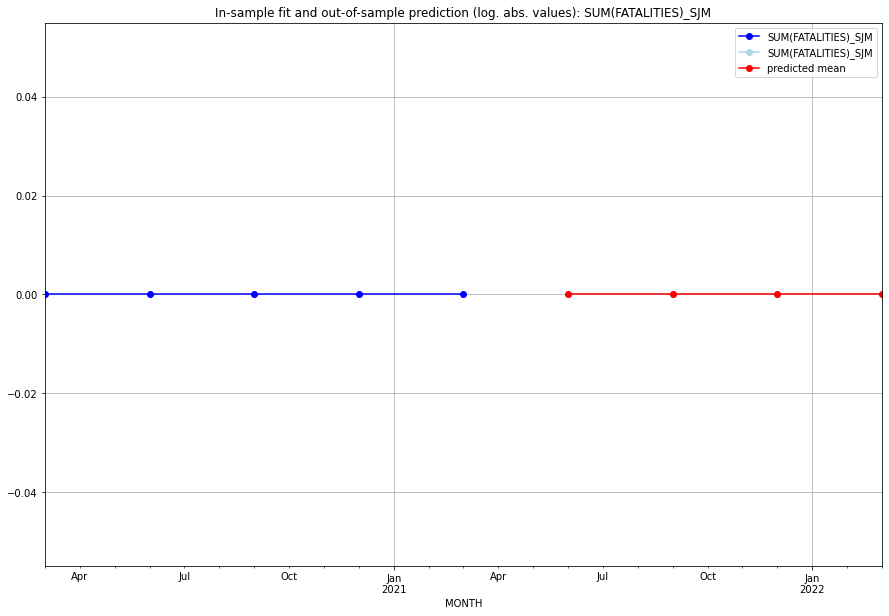

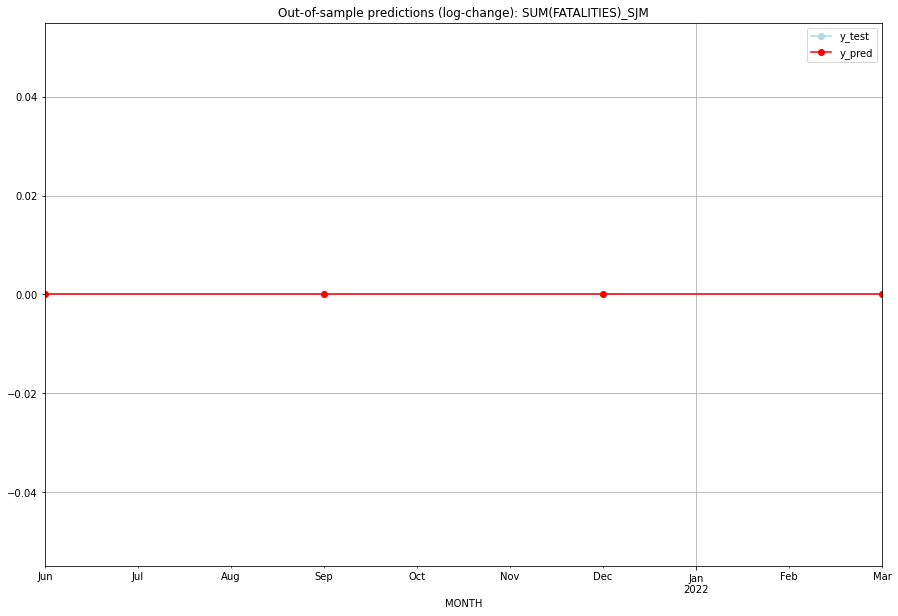

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SJM   
1 2021-07-01       0.0         0.0           0.0             0.0   SJM   
2 2021-10-01       0.0         0.0           0.0             0.0   SJM   
3 2022-01-01       0.0         0.0           0.0             0.0   SJM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:00
######## SLB (184/234) #########
0
Neighbor countries: []
Getting Data for SLB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 57)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


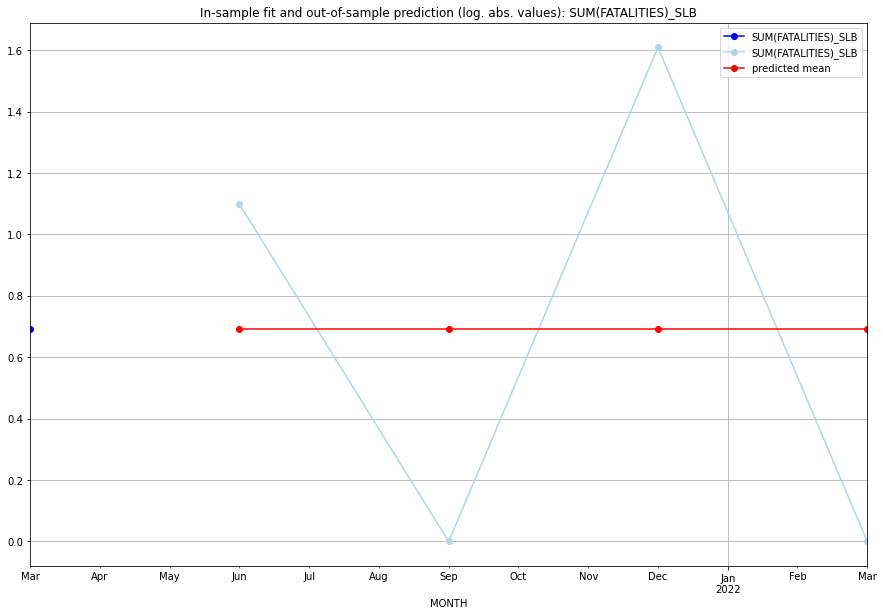

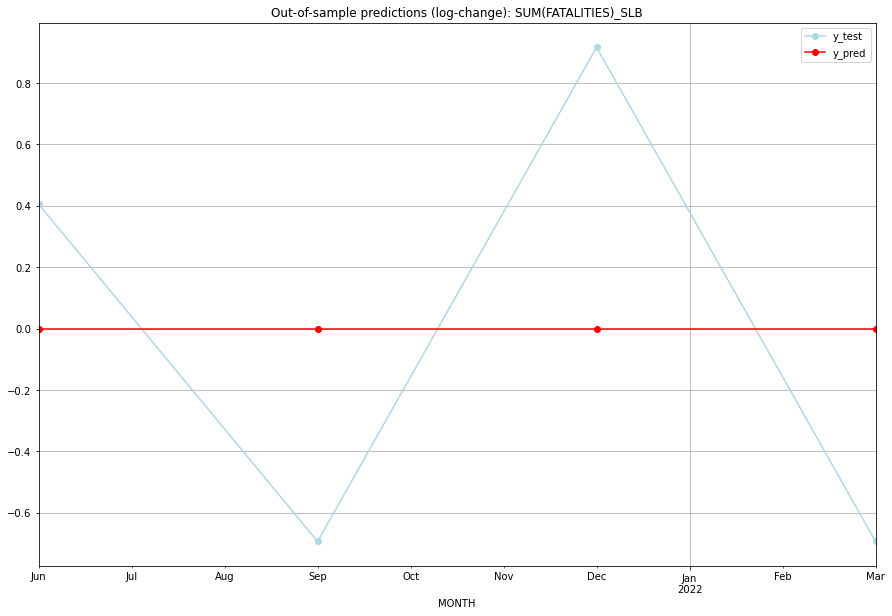

TADDA: 0.6770125502755526
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.693147    1.098612           0.0        0.405465   SLB   
1 2021-07-01  0.693147    0.000000           0.0       -0.693147   SLB   
2 2021-10-01  0.693147    1.609438           0.0        0.916291   SLB   
3 2022-01-01  0.693147    0.000000           0.0       -0.693147   SLB   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## SLE (185/234) #########
0
Neighbor countries: ['GIN', 'LBR']
Getting Data for SLE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 77)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8385010378488336, 'fold_results': [0.6597643324038145, 0.3465735902799727, 0.7489330683884977, 0.6597643324038146, 1.777469865768068]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SLE   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -137.759
Date:                 Wed, 19 Oct 2022   AIC                            277.518
Time:                         11:01:13   BIC                            280.072
Sample:                     04-30-1997   HQIC                           278.550
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

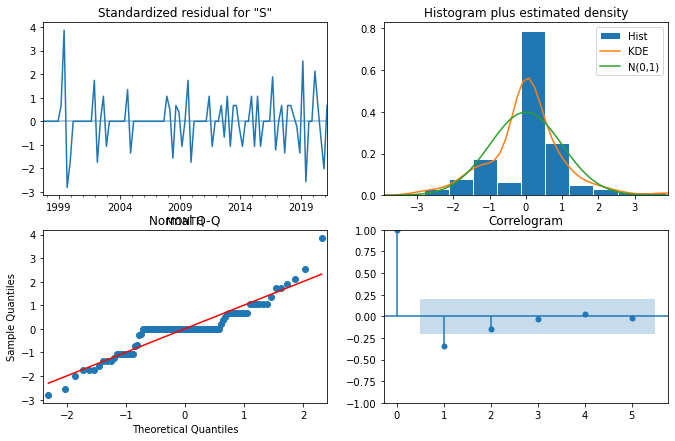

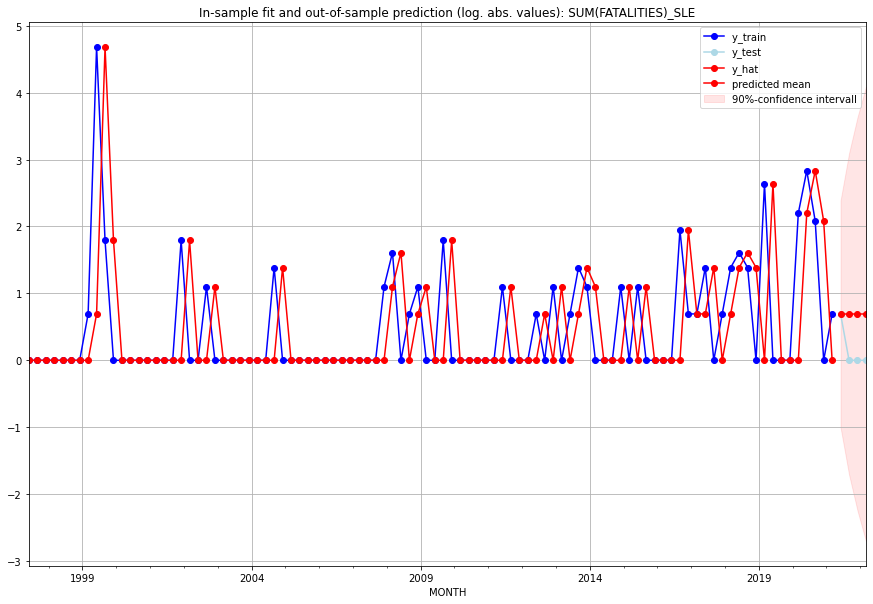

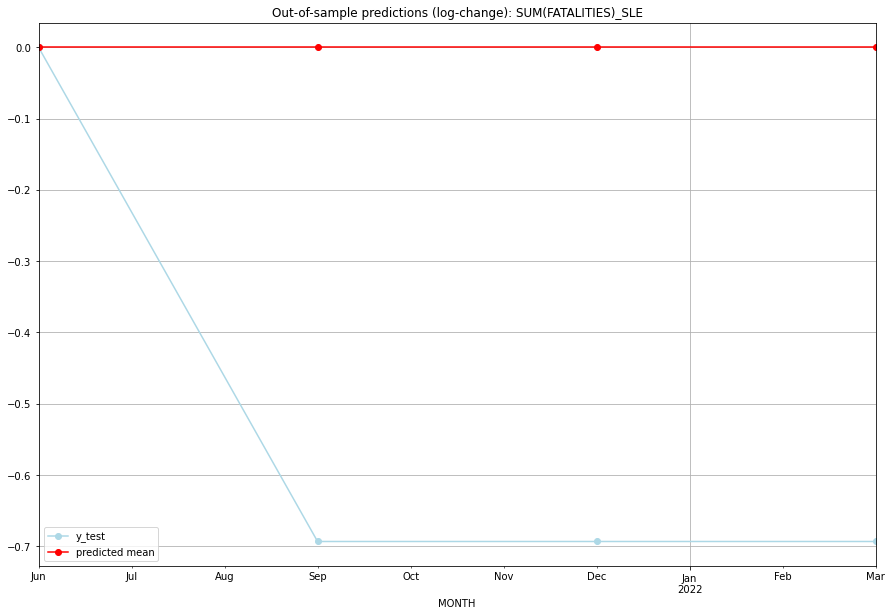

TADDA: 0.5198603854199588
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       1.0         1.0 -1.110223e-16        0.000000   SLE   
1 2021-07-01       1.0         0.0 -1.110223e-16       -0.693147   SLE   
2 2021-10-01       1.0         0.0 -1.110223e-16       -0.693147   SLE   
3 2022-01-01       1.0         0.0 -1.110223e-16       -0.693147   SLE   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:29
######## SLV (186/234) #########
0
Neighbor countries: ['GTM', 'HND']
Getting Data for SLV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 79)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV o

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.08643313235350569, 'fold_results': [0.08643313235350569, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SLV   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                  -3.180
Date:                 Wed, 19 Oct 2022   AIC                             22.361
Time:                         11:01:26   BIC                             26.881
Sample:                     01-31-2018   HQIC                            21.432
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0569      0.093     -0.60

<Figure size 432x288 with 0 Axes>

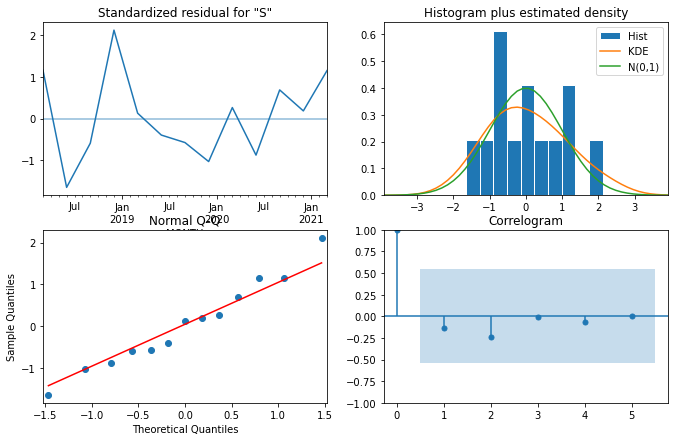

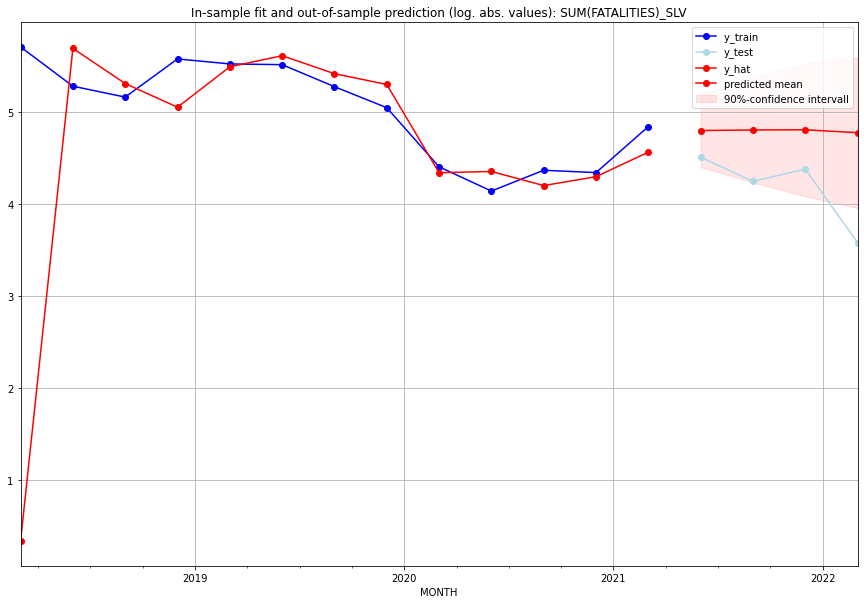

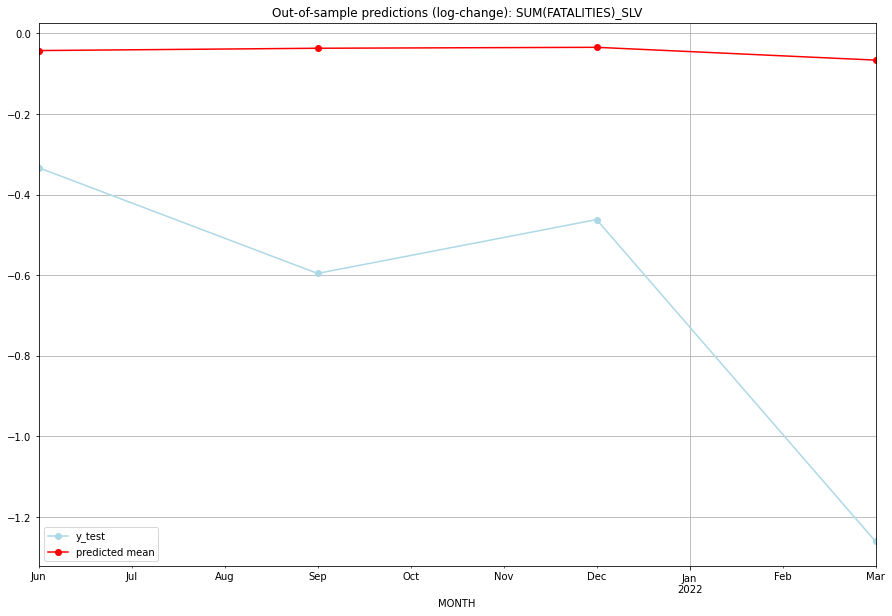

TADDA: 0.6176432565596324
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  120.672094        90.0     -0.042857       -0.333328   SLV   
1 2021-07-01  121.373219        69.0     -0.037112       -0.595692   SLV   
2 2021-10-01  121.659321        79.0     -0.034776       -0.462160   SLV   
3 2022-01-01  117.825660        35.0     -0.066530       -1.260668   SLV   

                                          PARAMETERS  
0  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## SMR (187/234) #########
0
Neighbor countries: ['ITA']
Getting Data for SMR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 40)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed.

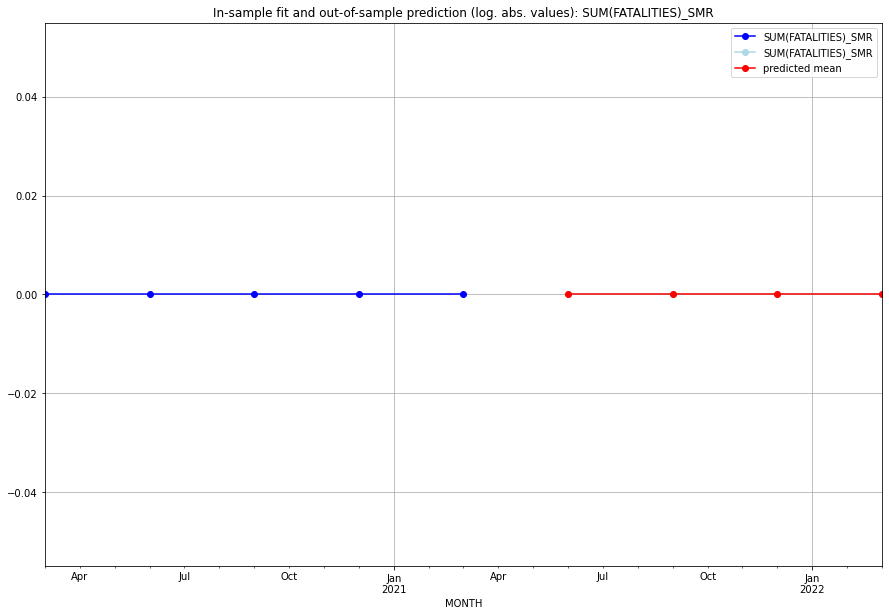

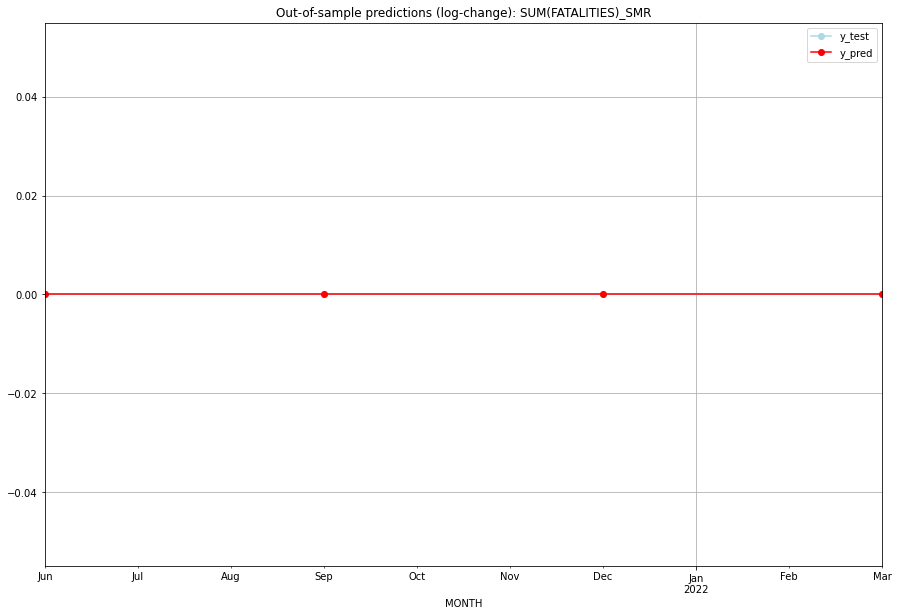

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SMR   
1 2021-07-01       0.0         0.0           0.0             0.0   SMR   
2 2021-10-01       0.0         0.0           0.0             0.0   SMR   
3 2022-01-01       0.0         0.0           0.0             0.0   SMR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## SOM (188/234) #########
0
Neighbor countries: ['KEN', 'ETH', 'DJI']
Getting Data for SOM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 68)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.17315021574460618, 'fold_results': [0.13647974199590274, 0.18746039619591803, 0.16224180745478334, 0.1490397014481999, 0.23052943162822692]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SOM   No. Observations:                   96
Model:                SARIMAX(1, 0, 1)   Log Likelihood                -126.893
Date:                 Wed, 19 Oct 2022   AIC                            265.785
Time:                         11:01:50   BIC                            281.171
Sample:                     04-30-1997   HQIC                           272.005
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------

<Figure size 432x288 with 0 Axes>

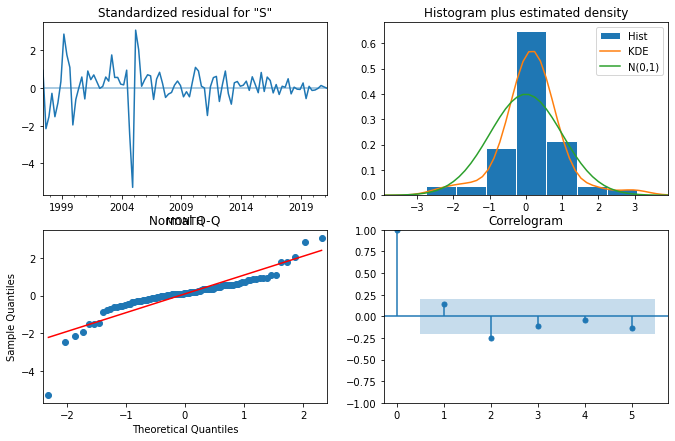

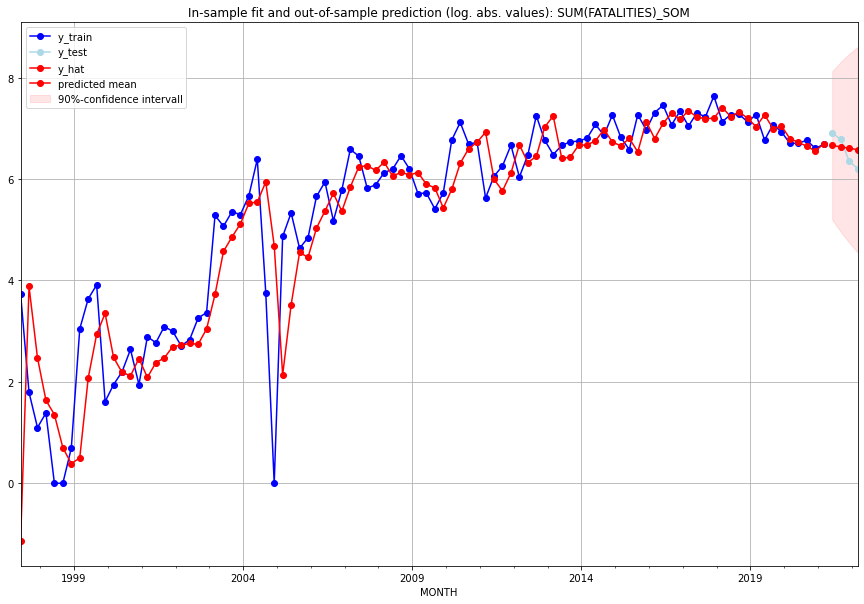

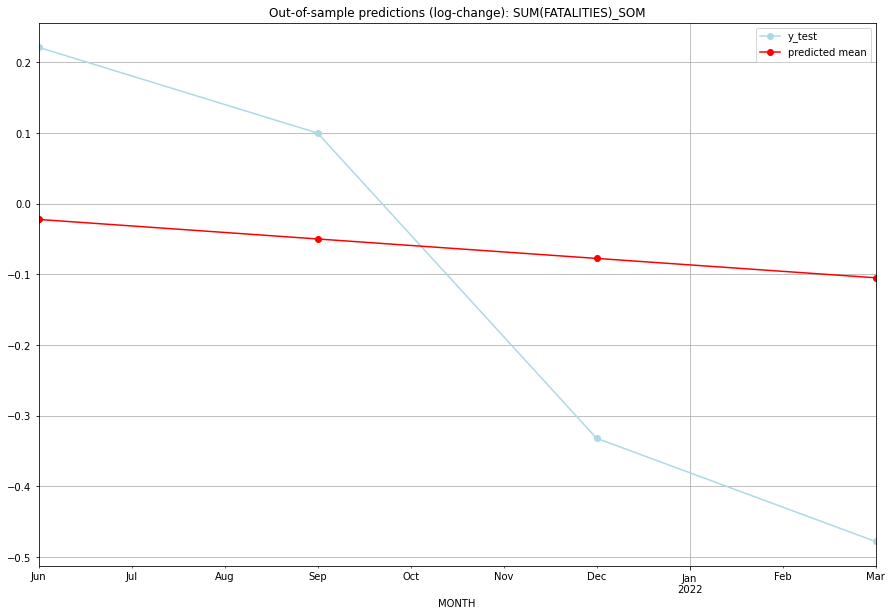

TADDA: 0.27333268846927994
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  781.299031       997.0     -0.022375        0.221142   SOM   
1 2021-07-01  759.969619       883.0     -0.050018        0.099845   SOM   
2 2021-10-01  739.315743       573.0     -0.077535       -0.331982   SOM   
3 2022-01-01  719.313473       495.0     -0.104925       -0.478036   SOM   

                                          PARAMETERS  
0  {'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## SRB (189/234) #########
0
Neighbor countries: ['BGR', 'XKO', 'MKD', 'MNE', 'HUN', 'ROU', 'BIH', 'HRV']
Getting Data for SRB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 127)
y: (17, 1)
----------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08664339756999316, 'fold_results': [0.17328679513998632, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SRB   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                  -9.658
Date:                 Wed, 19 Oct 2022   AIC                             21.316
Time:                         11:02:08   BIC                             21.881
Sample:                     01-31-2018   HQIC                            21.199
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.2587      0.071      3.62

<Figure size 432x288 with 0 Axes>

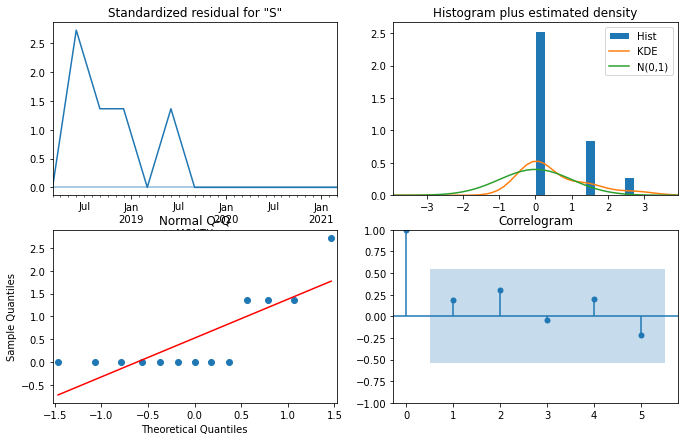

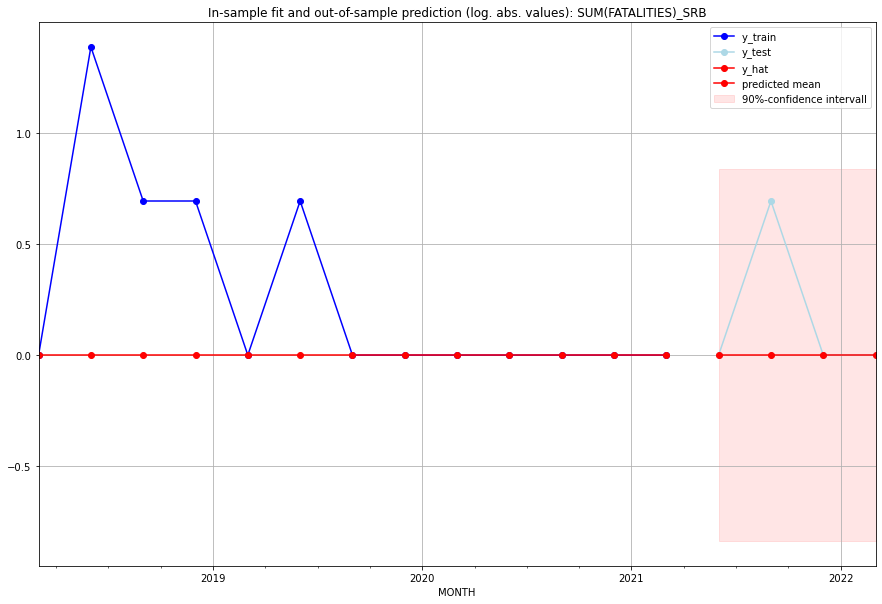

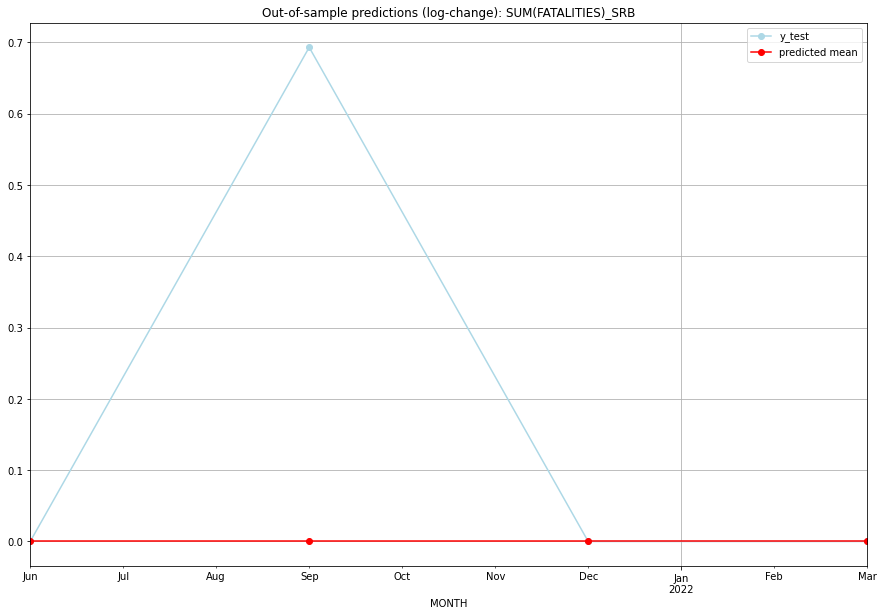

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   SRB   
1 2021-07-01       0.0         1.0           0.0        0.693147   SRB   
2 2021-10-01       0.0         0.0           0.0        0.000000   SRB   
3 2022-01-01       0.0         0.0           0.0        0.000000   SRB   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## SSD (190/234) #########
0
Neighbor countries: ['CAF', 'COD', 'ETH', 'SDN', 'XAR', 'UGA', 'KEN', 'XIT', 'XKK']
Getting Data for SSD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 126)
y: (100, 1)
-----------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5529604595590196, 'fold_results': [0.5848604263794881, 0.3036566489002559, 0.9452610515082205, 0.4416678567920884, 0.48935631421504544]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SSD   No. Observations:                   96
Model:                SARIMAX(2, 0, 1)   Log Likelihood                -136.857
Date:                 Wed, 19 Oct 2022   AIC                            287.713
Time:                         11:02:34   BIC                            305.664
Sample:                     04-30-1997   HQIC                           294.969
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

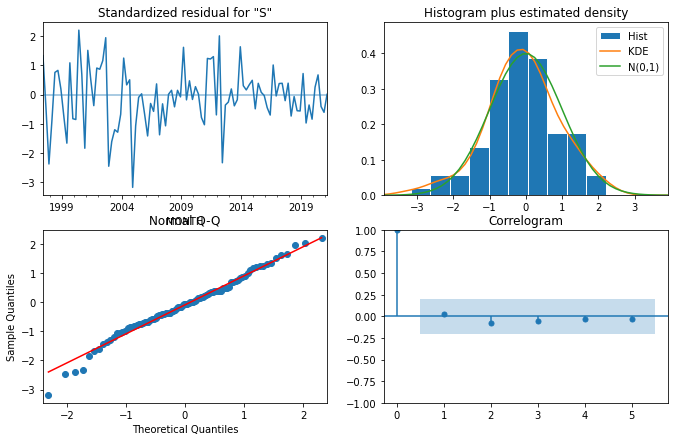

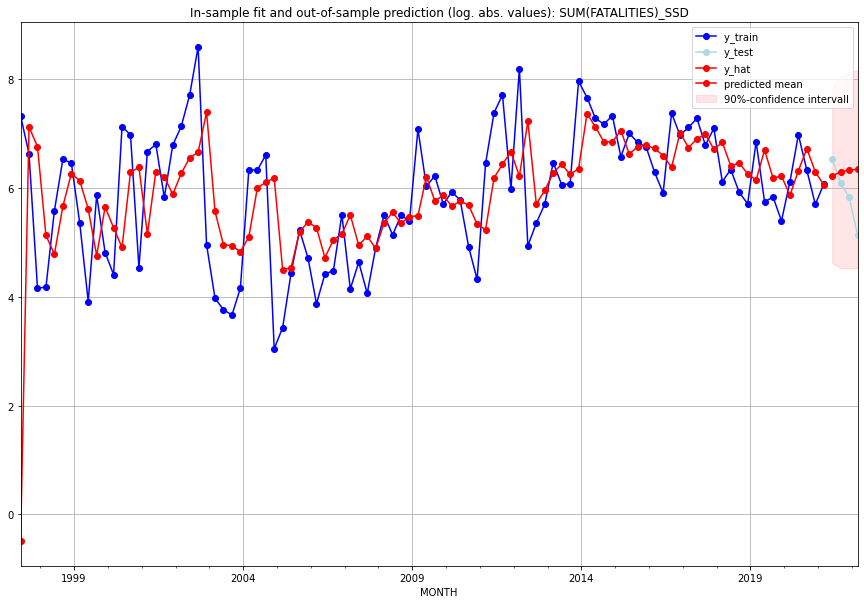

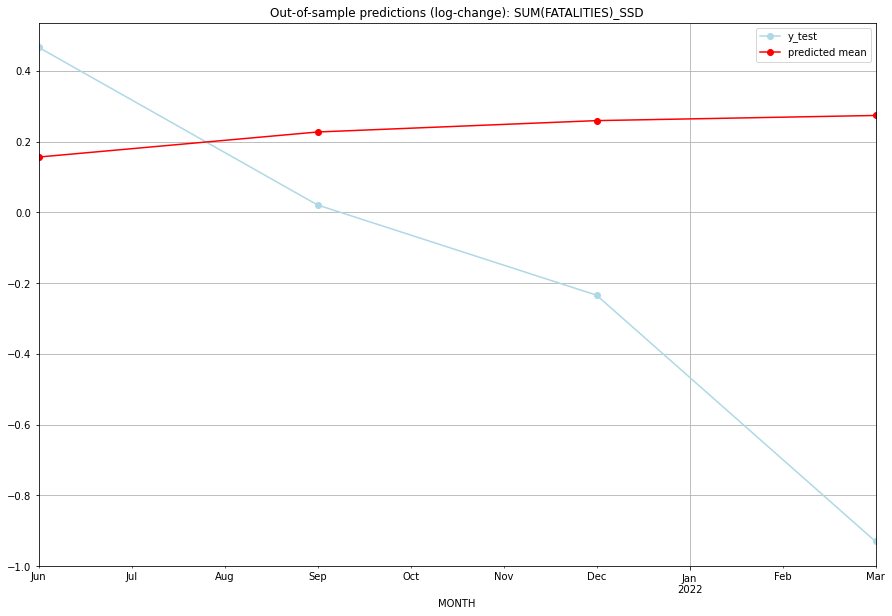

TADDA: 0.6865752214398224
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  502.799026       686.0      0.156069        0.466226   SSD   
1 2021-07-01  539.781432       439.0      0.226907        0.020667   SSD   
2 2021-10-01  557.447319       340.0      0.259052       -0.234226   SSD   
3 2022-01-01  565.648986       169.0      0.273632       -0.930310   SSD   

                                          PARAMETERS  
0  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:27
######## STP (191/234) #########
0
Neighbor countries: []
Getting Data for STP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 52)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV o

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_STP   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 118.056
Date:                 Wed, 19 Oct 2022   AIC                           -234.112
Time:                         11:03:13   BIC                           -231.547
Sample:                     04-30-1997   HQIC                          -233.075
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0050      0.000     47.749      0.000     

<Figure size 432x288 with 0 Axes>

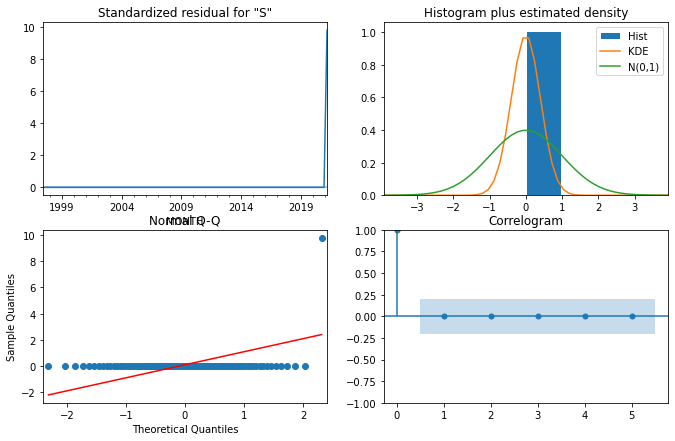

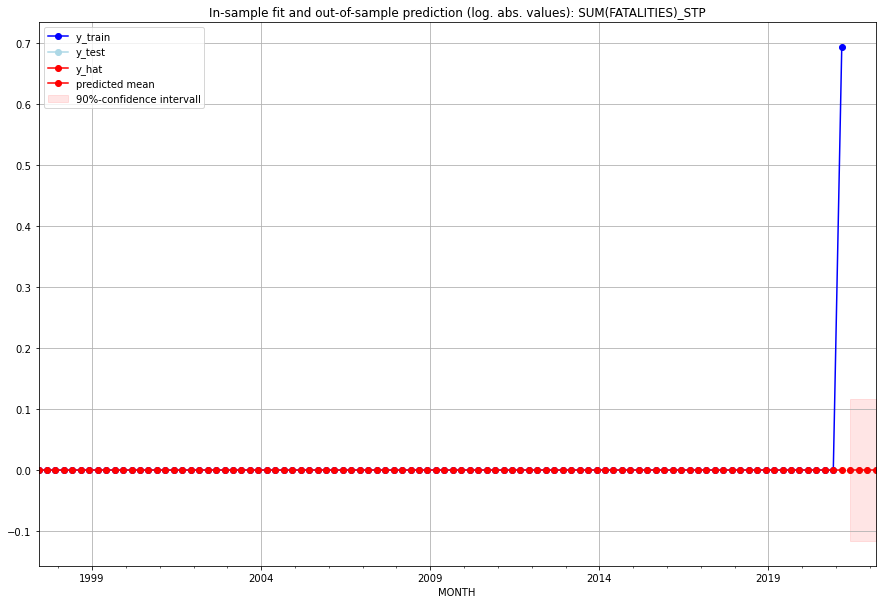

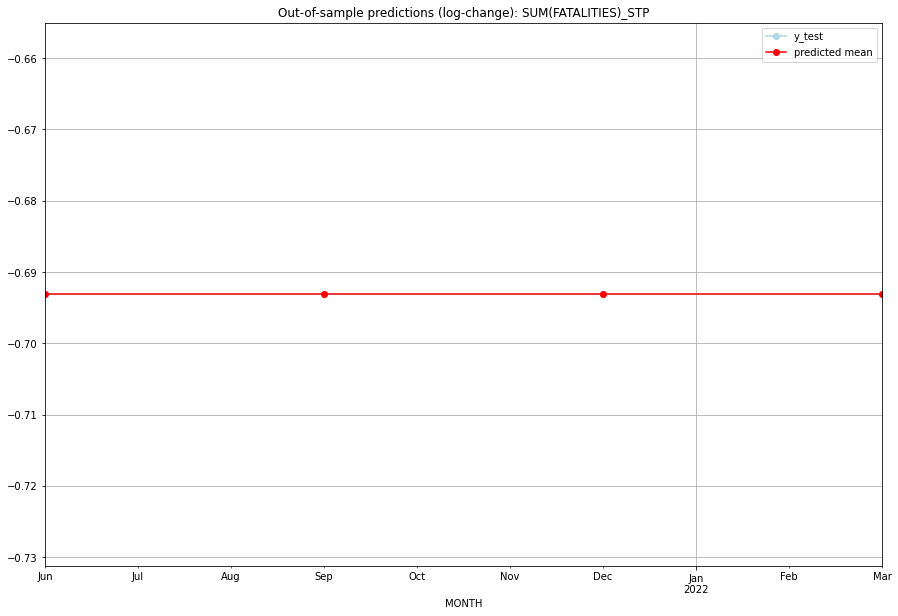

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -0.693147       -0.693147   STP   
1 2021-07-01       0.0         0.0     -0.693147       -0.693147   STP   
2 2021-10-01       0.0         0.0     -0.693147       -0.693147   STP   
3 2022-01-01       0.0         0.0     -0.693147       -0.693147   STP   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:40
######## SUR (192/234) #########
0
Neighbor countries: ['GUF', 'GUY', 'BRA']
Getting Data for SUR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 80)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5198603854199589, 'fold_results': [0.8664339756999315, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SUR   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                 -11.976
Date:                 Wed, 19 Oct 2022   AIC                             25.952
Time:                         11:03:30   BIC                             26.517
Sample:                     01-31-2018   HQIC                            25.836
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3696      0

<Figure size 432x288 with 0 Axes>

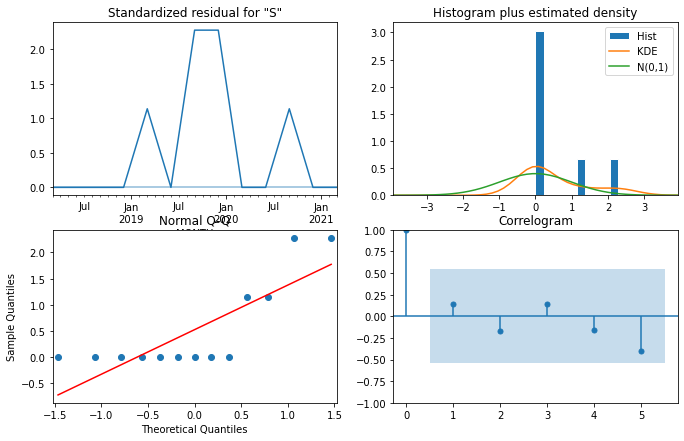

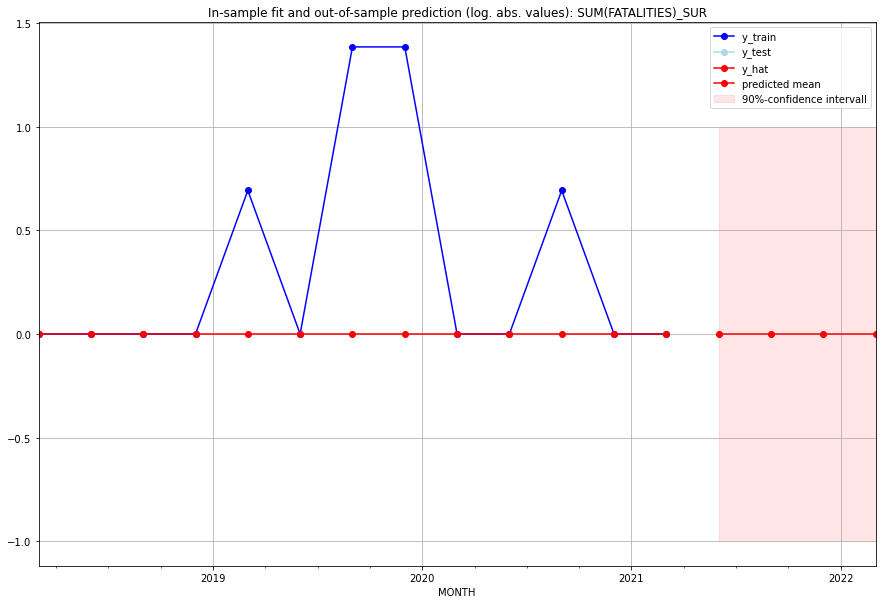

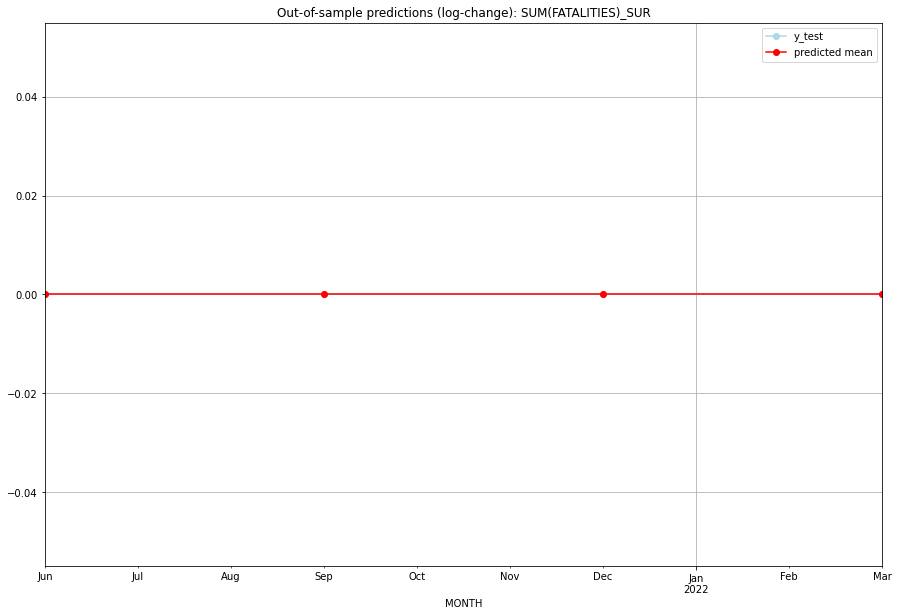

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SUR   
1 2021-07-01       0.0         0.0           0.0             0.0   SUR   
2 2021-10-01       0.0         0.0           0.0             0.0   SUR   
3 2022-01-01       0.0         0.0           0.0             0.0   SUR   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## SVK (193/234) #########
0
Neighbor countries: ['HUN', 'AUT', 'UKR', 'POL', 'CZE']
Getting Data for SVK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 105)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV fai

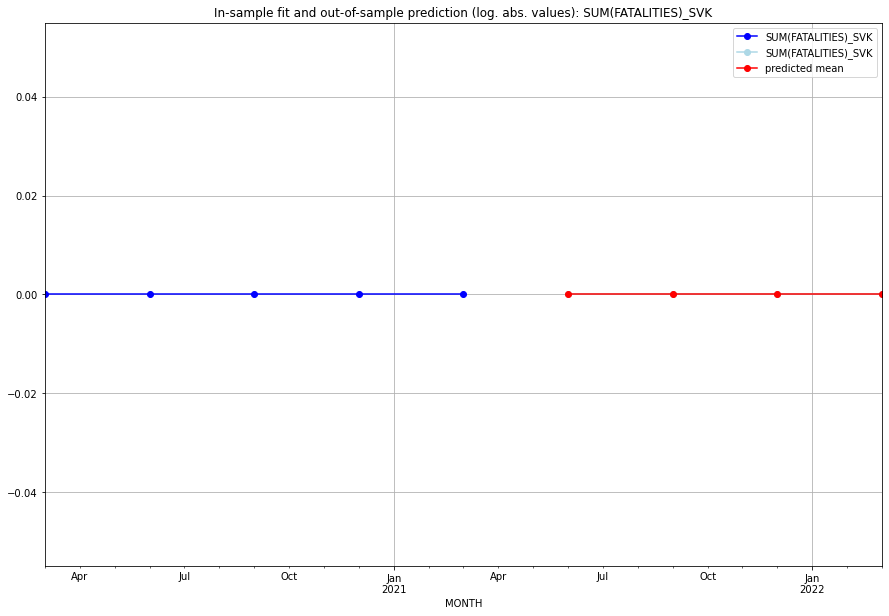

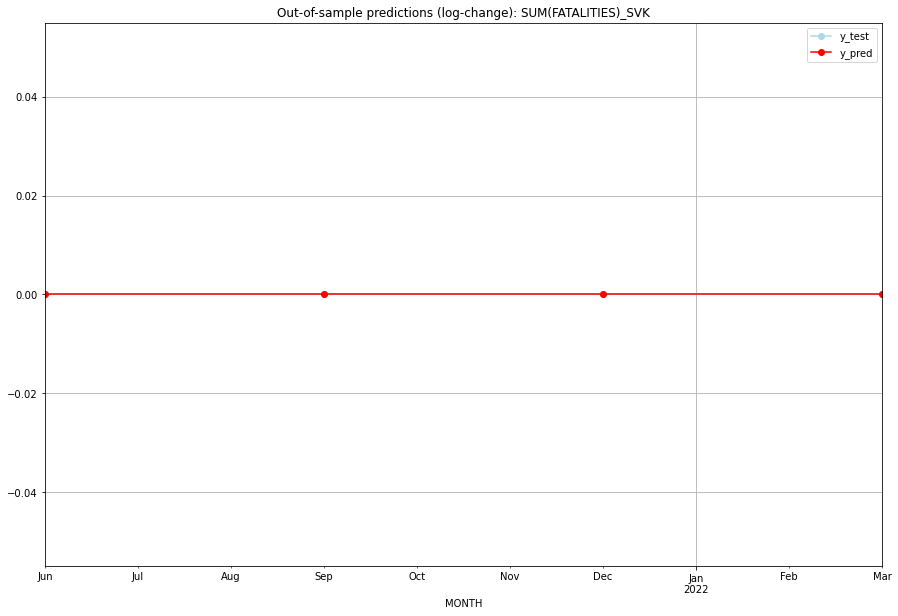

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SVK   
1 2021-07-01       0.0         0.0           0.0             0.0   SVK   
2 2021-10-01       0.0         0.0           0.0             0.0   SVK   
3 2022-01-01       0.0         0.0           0.0             0.0   SVK   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## SVN (194/234) #########
0
Neighbor countries: ['AUT', 'HRV', 'ITA', 'HUN']
Getting Data for SVN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 95)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


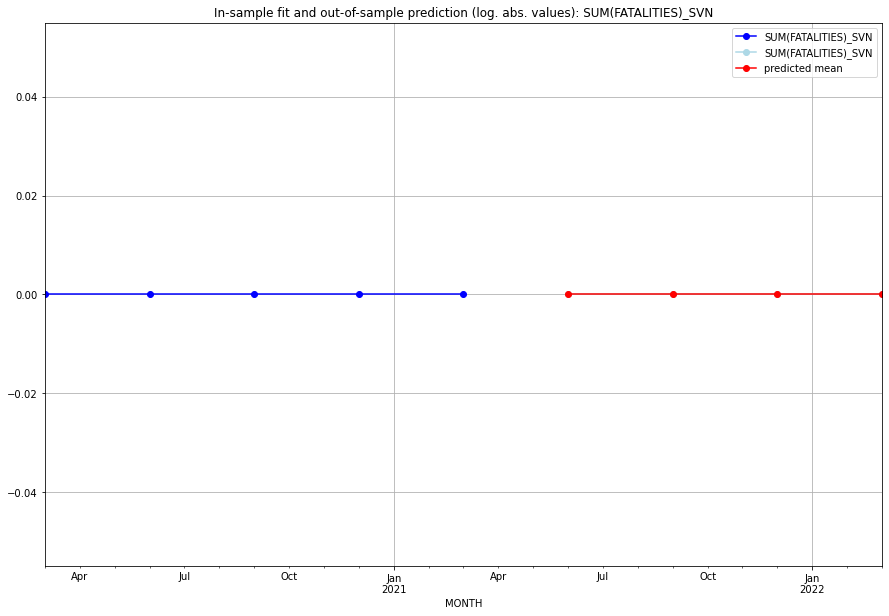

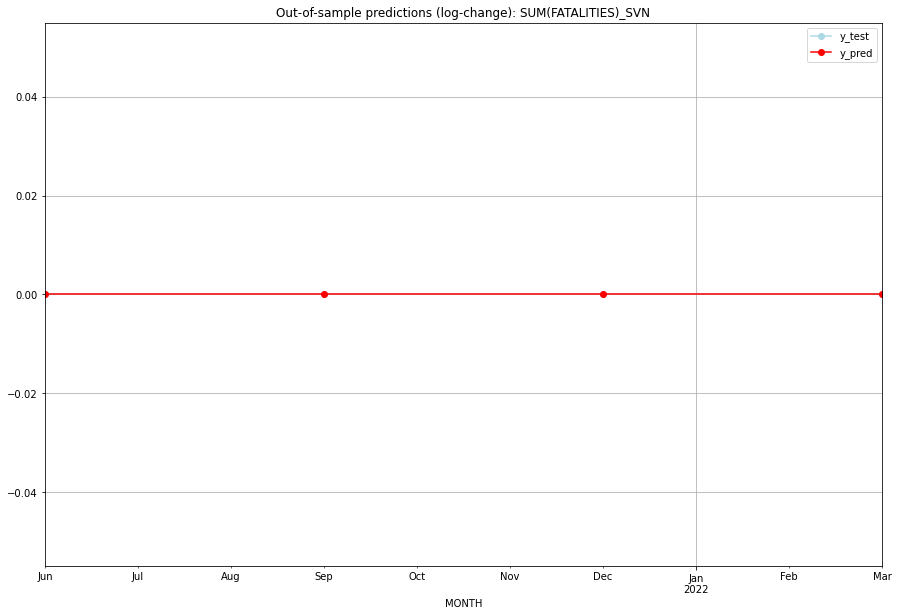

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SVN   
1 2021-07-01       0.0         0.0           0.0             0.0   SVN   
2 2021-10-01       0.0         0.0           0.0             0.0   SVN   
3 2022-01-01       0.0         0.0           0.0             0.0   SVN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## SWE (195/234) #########
0
Neighbor countries: ['FIN', 'NOR']
Getting Data for SWE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 81)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


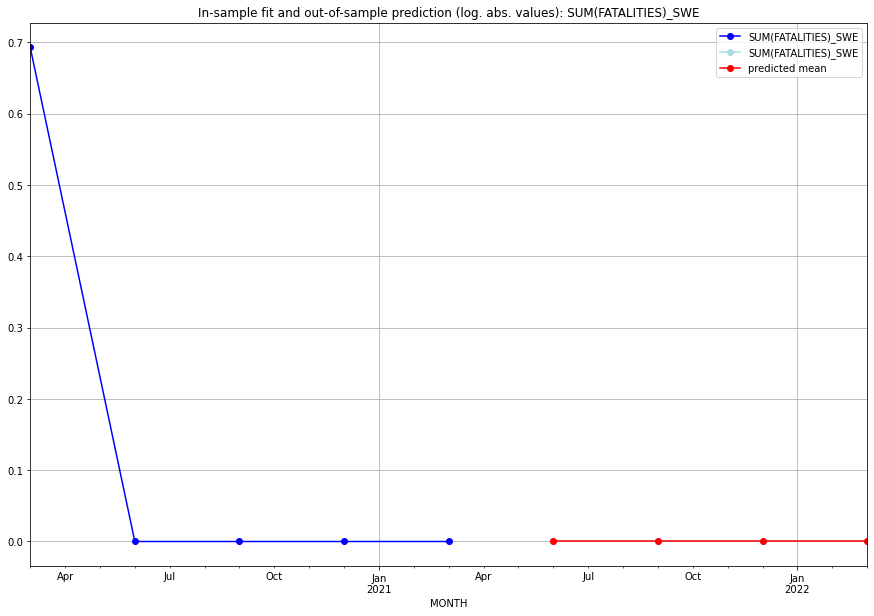

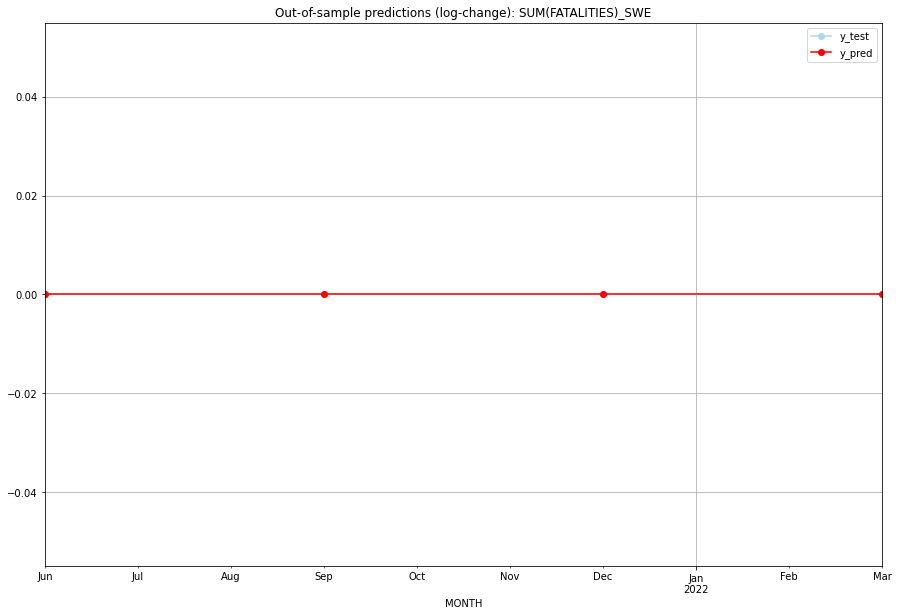

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SWE   
1 2021-07-01       0.0         0.0           0.0             0.0   SWE   
2 2021-10-01       0.0         0.0           0.0             0.0   SWE   
3 2022-01-01       0.0         0.0           0.0             0.0   SWE   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## SWZ (196/234) #########
0
Neighbor countries: ['ZAF', 'MOZ']
Getting Data for SWZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 77)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.19356005054539455, 'fold_results': [0.0, 0.0, 0.0, 0.34657359027997264, 0.6212266624470001]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SWZ   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 -46.888
Date:                 Wed, 19 Oct 2022   AIC                             95.776
Time:                         11:04:00   BIC                             98.340
Sample:                     04-30-1997   HQIC                            96.812
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      

<Figure size 432x288 with 0 Axes>

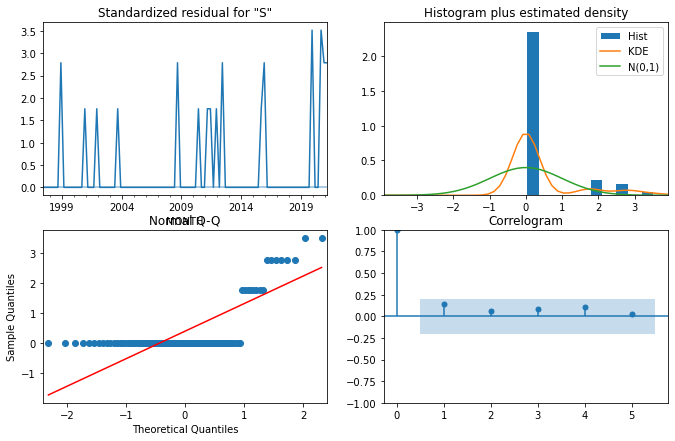

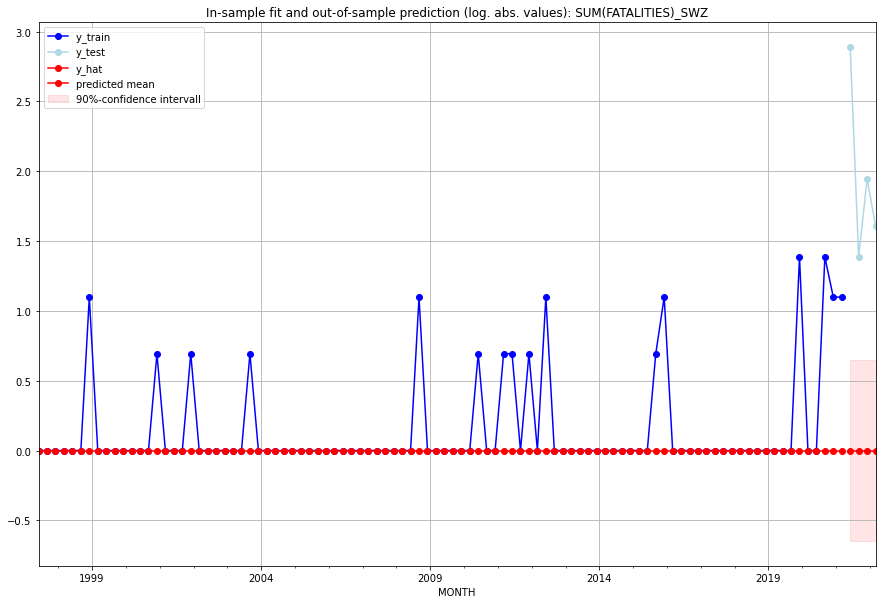

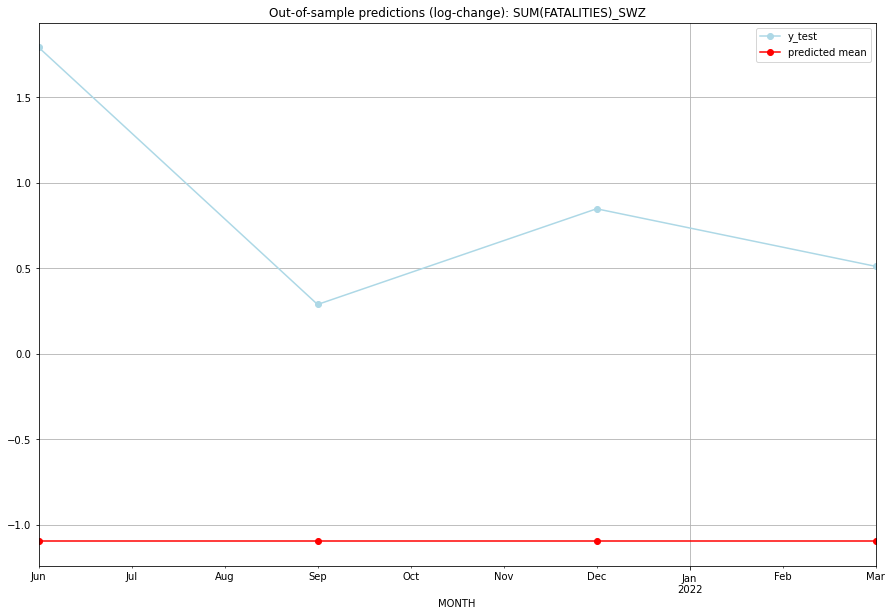

TADDA: 3.056615833794477
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0        17.0     -1.098612        1.791759   SWZ   
1 2021-07-01       0.0         3.0     -1.098612        0.287682   SWZ   
2 2021-10-01       0.0         6.0     -1.098612        0.847298   SWZ   
3 2022-01-01       0.0         4.0     -1.098612        0.510826   SWZ   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## SXM (197/234) #########
0
Neighbor countries: []
Getting Data for SXM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necess

<Figure size 432x288 with 0 Axes>

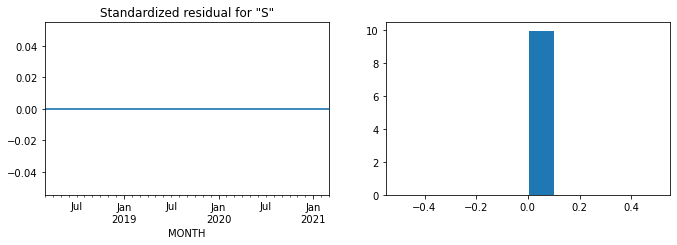

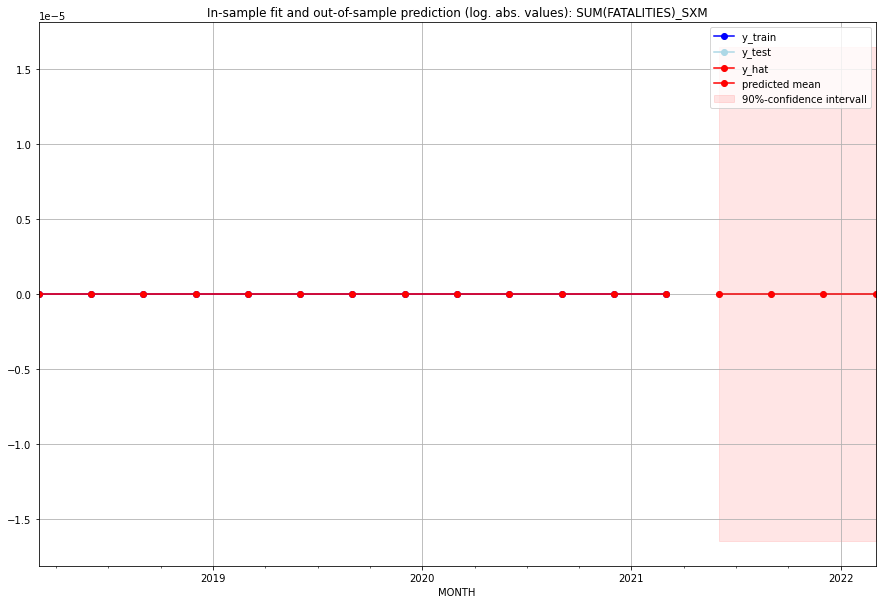

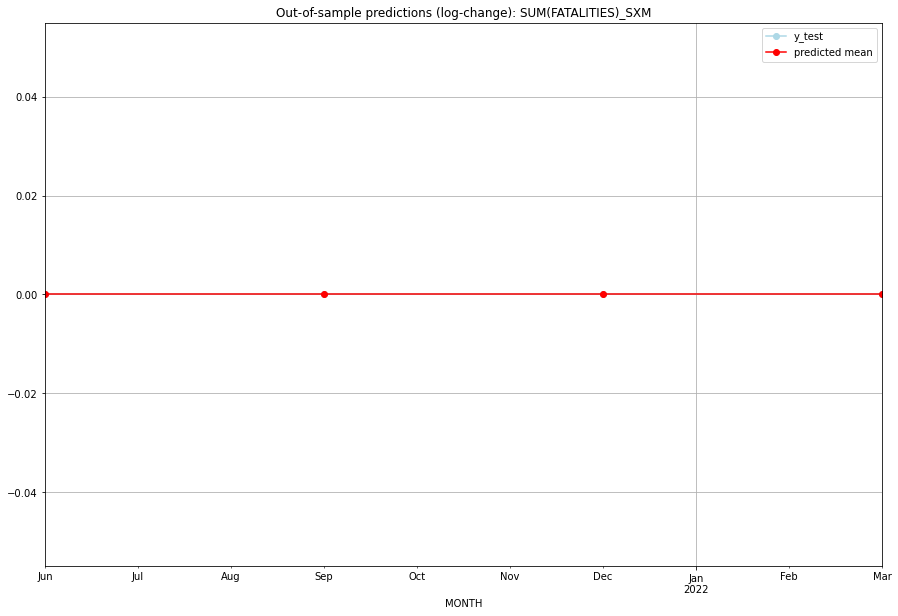

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SXM   
1 2021-07-01       0.0         0.0           0.0             0.0   SXM   
2 2021-10-01       0.0         0.0           0.0             0.0   SXM   
3 2022-01-01       0.0         0.0           0.0             0.0   SXM   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:01
######## SYC (198/234) #########
0
Neighbor countries: []
Getting Data for SYC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 53)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SYC   No. Observations:                   96
Model:  

<Figure size 432x288 with 0 Axes>

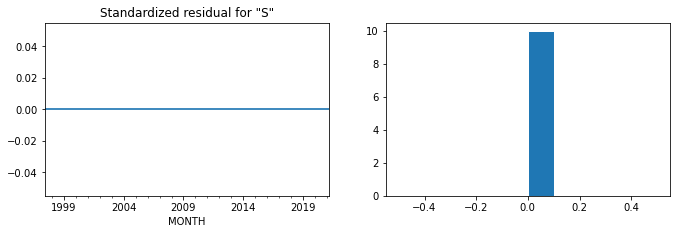

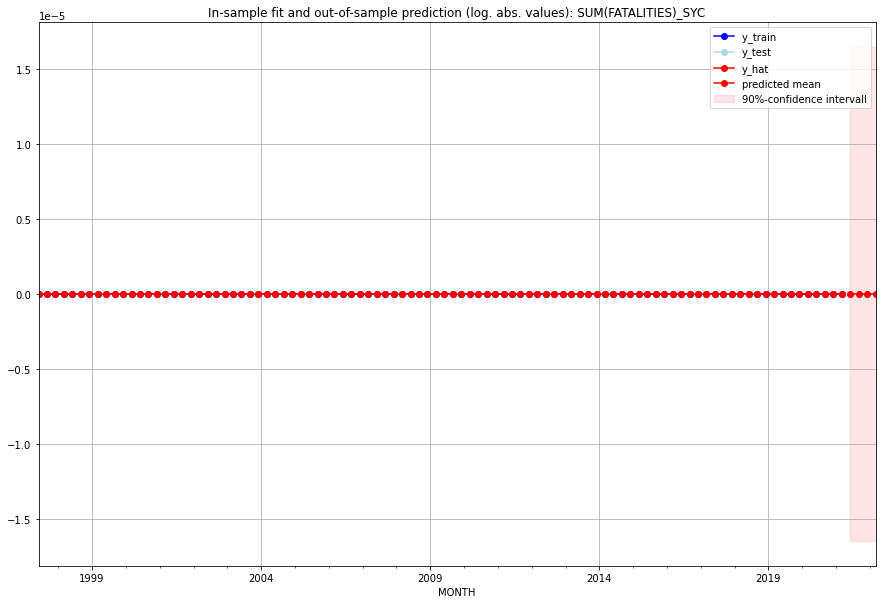

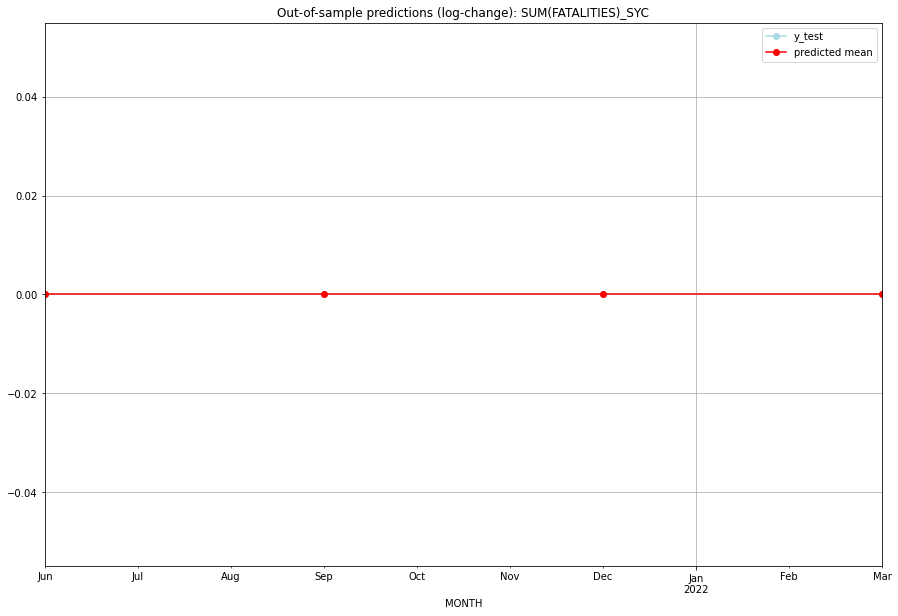

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SYC   
1 2021-07-01       0.0         0.0           0.0             0.0   SYC   
2 2021-10-01       0.0         0.0           0.0             0.0   SYC   
3 2022-01-01       0.0         0.0           0.0             0.0   SYC   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:01
######## SYR (199/234) #########
0
Neighbor countries: ['TUR', 'ISR', 'JOR', 'LBN', 'IRQ']
Getting Data for SYR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (21, 102)
y: (21, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.25823280952063743, 'fold_results': [0.4547217379173043, 0.061743881123970557, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SYR   No. Observations:                   17
Model:                SARIMAX(1, 0, 3)   Log Likelihood                  -6.623
Date:                 Wed, 19 Oct 2022   AIC                             23.245
Time:                         11:04:15   BIC                             27.411
Sample:                     01-31-2017   HQIC                            23.659
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9975

<Figure size 432x288 with 0 Axes>

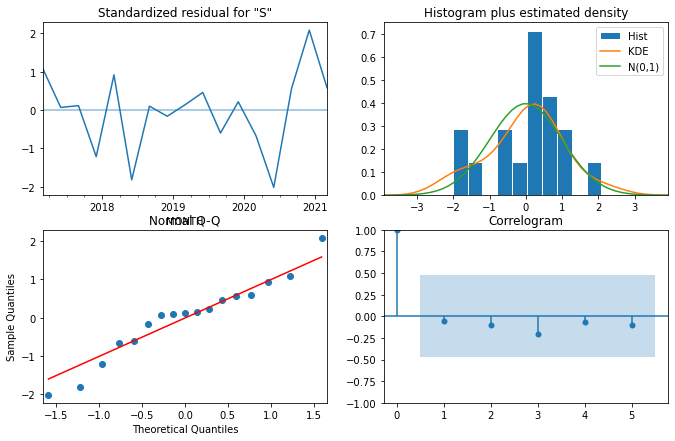

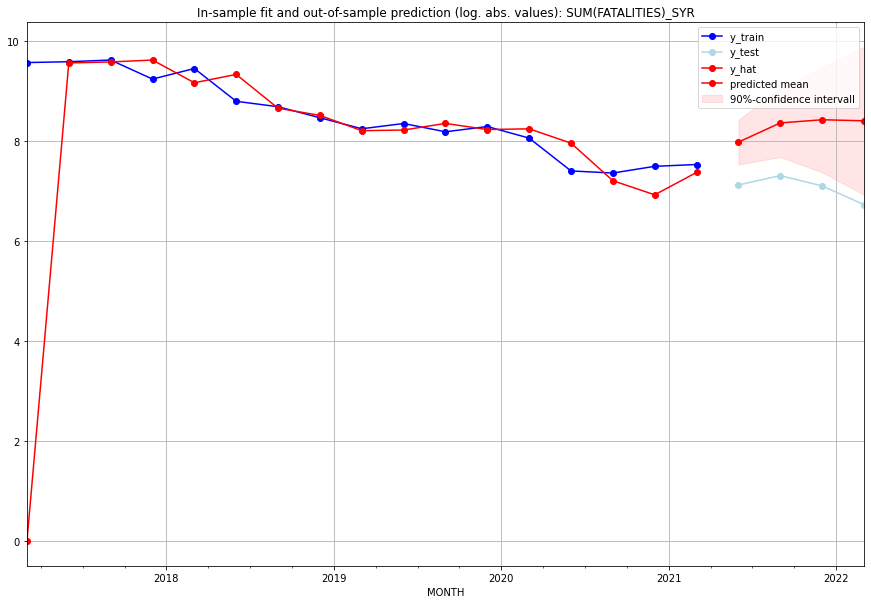

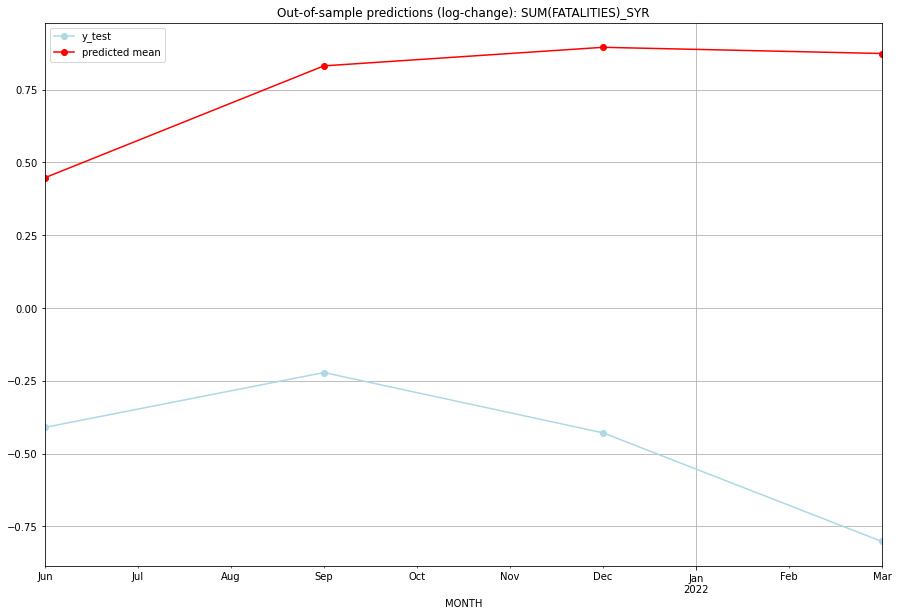

TADDA: 1.989633086726302
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2921.493929      1239.0      0.447569       -0.409757   SYR   
1 2021-07-01  4289.946321      1496.0      0.831639       -0.221405   SYR   
2 2021-10-01  4572.219501      1216.0      0.895349       -0.428480   SYR   
3 2022-01-01  4476.002946       837.0      0.874085       -0.801606   SYR   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## TCA (200/234) #########
0
Neighbor countries: []
Getting Data for TCA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero.

<Figure size 432x288 with 0 Axes>

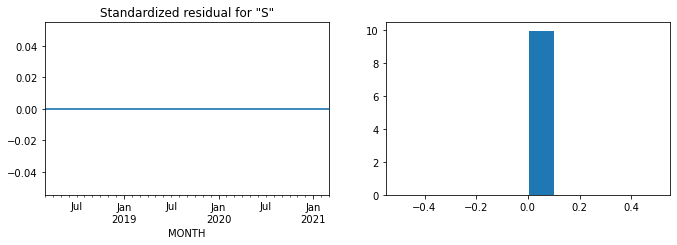

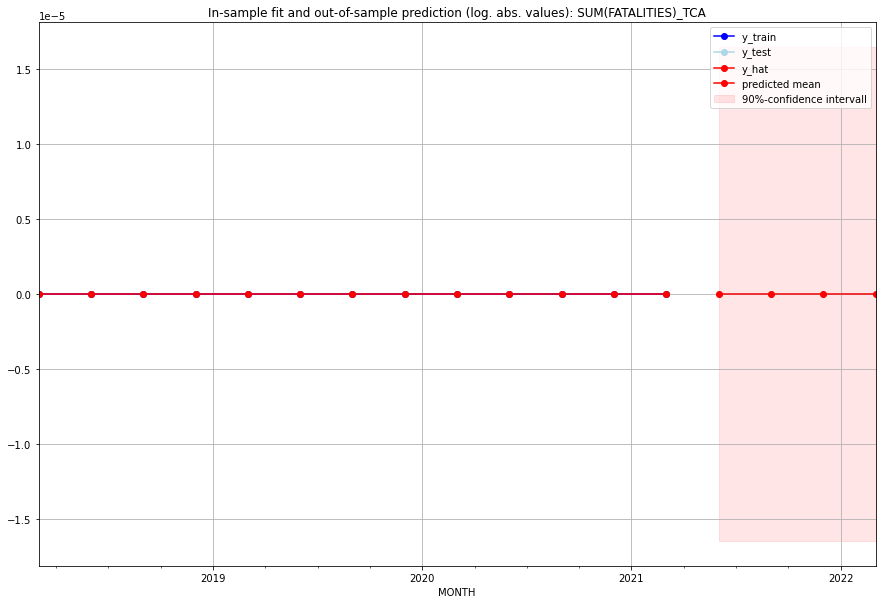

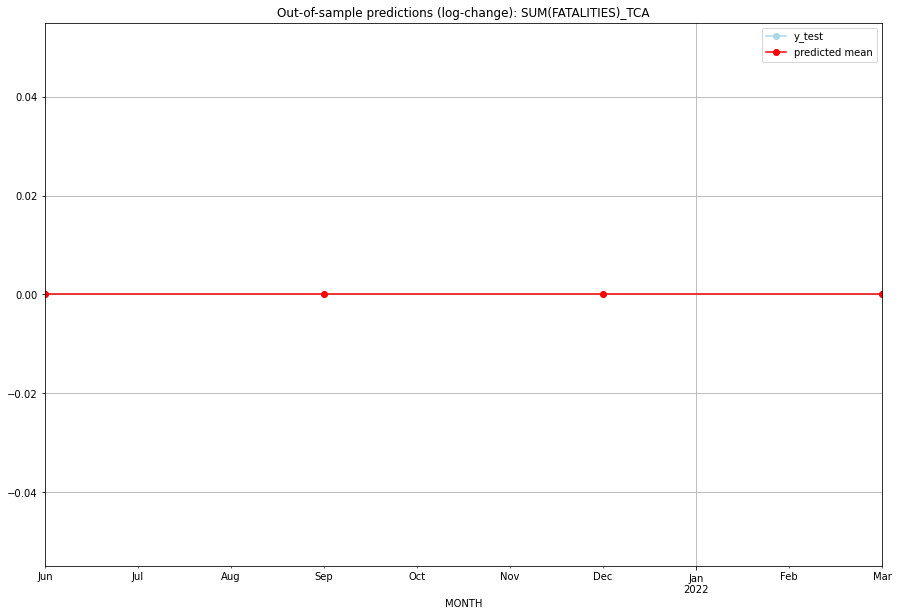

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   TCA   
1 2021-07-01       0.0         0.0           0.0             0.0   TCA   
2 2021-10-01       0.0         0.0           0.0             0.0   TCA   
3 2022-01-01       0.0         0.0           0.0             0.0   TCA   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:03
######## TCD (201/234) #########
0
Neighbor countries: ['CMR', 'NER', 'NGA', 'CAF', 'SDN', 'LBY']
Getting Data for TCD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 107)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 1.0453442605882048, 'fold_results': [1.4209141010698985, 1.0913530873016635, 0.8481628588844722, 1.1767919880291577, 0.6894992676558336]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TCD   No. Observations:                   96
Model:                SARIMAX(0, 1, 2)   Log Likelihood                -192.388
Date:                 Wed, 19 Oct 2022   AIC                            396.776
Time:                         11:04:36   BIC                            412.099
Sample:                     04-30-1997   HQIC                           402.968
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

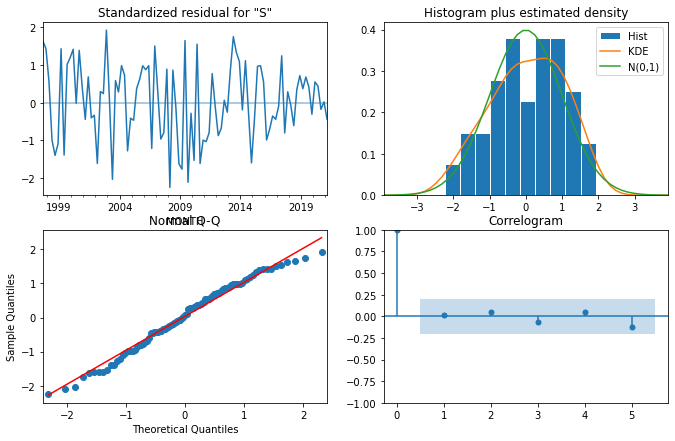

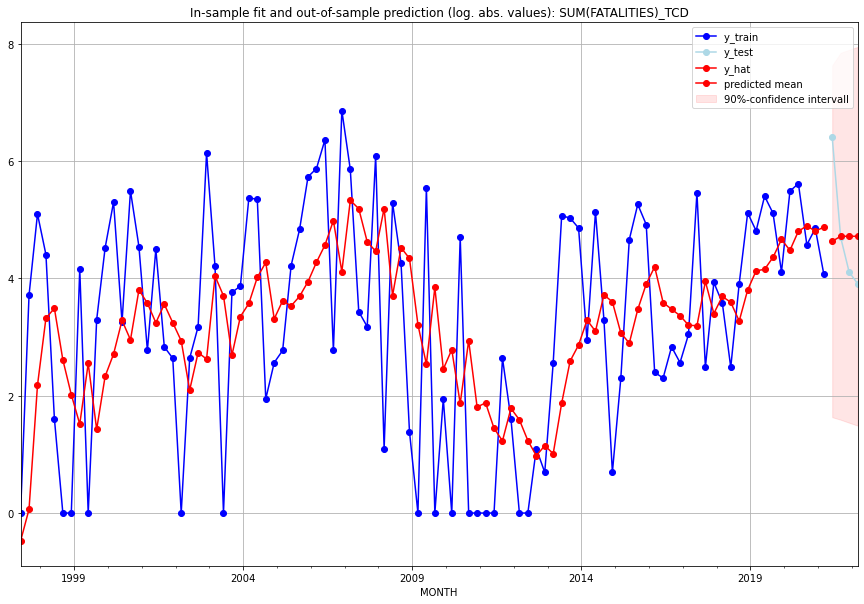

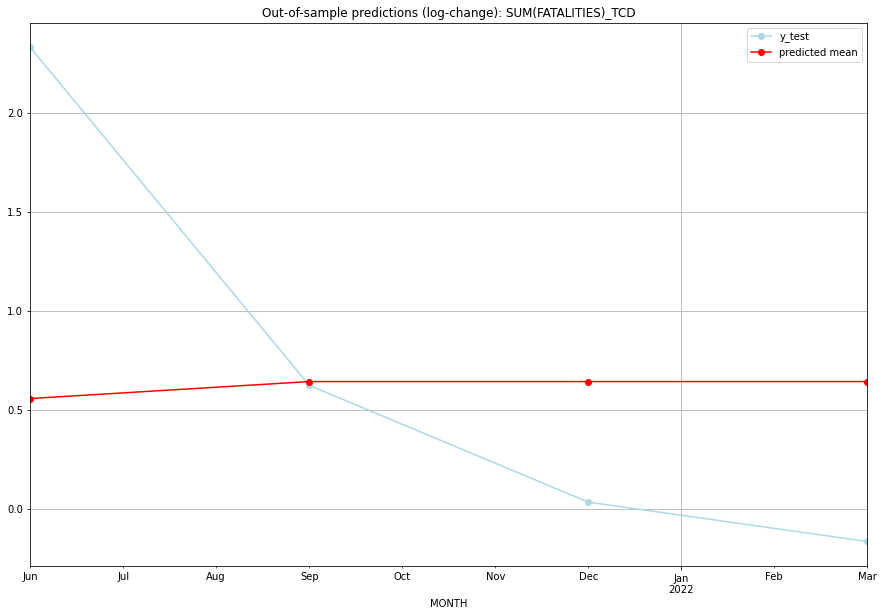

TADDA: 0.962433984147114
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  101.898646       605.0      0.556207        2.329343   TCD   
1 2021-07-01  111.098593       109.0      0.641841        0.622943   TCD   
2 2021-10-01  111.098593        60.0      0.641841        0.033336   TCD   
3 2022-01-01  111.098593        49.0      0.641841       -0.165514   TCD   

                                          PARAMETERS  
0  {'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## TGO (202/234) #########
0
Neighbor countries: ['BEN', 'GHA', 'BFA']
Getting Data for TGO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 85)
y: (100, 1)
------------------------------------------------
Training started.
Sta

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.8648203398629176, 'fold_results': [0.4325545571977326, 1.7379389525789244, 0.6533089031033668, 0.9493975799319906, 0.5509017065025741]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TGO   No. Observations:                   96
Model:                SARIMAX(3, 0, 1)   Log Likelihood                -118.222
Date:                 Wed, 19 Oct 2022   AIC                            248.444
Time:                         11:04:58   BIC                            263.830
Sample:                     04-30-1997   HQIC                           254.663
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

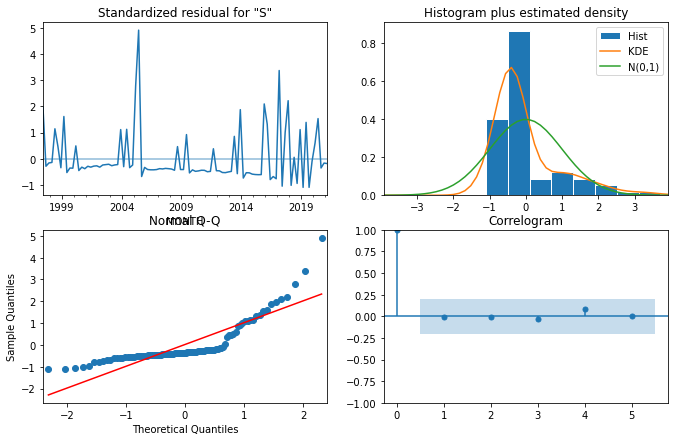

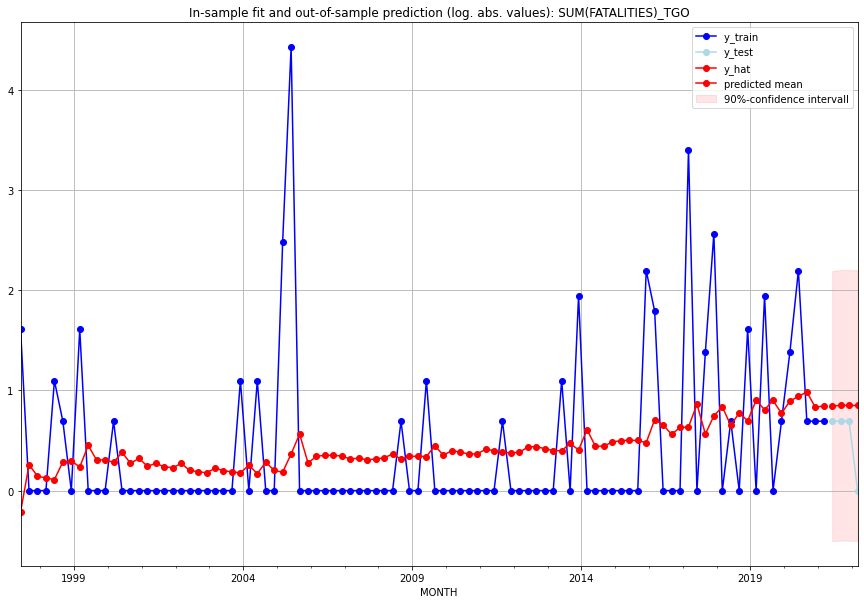

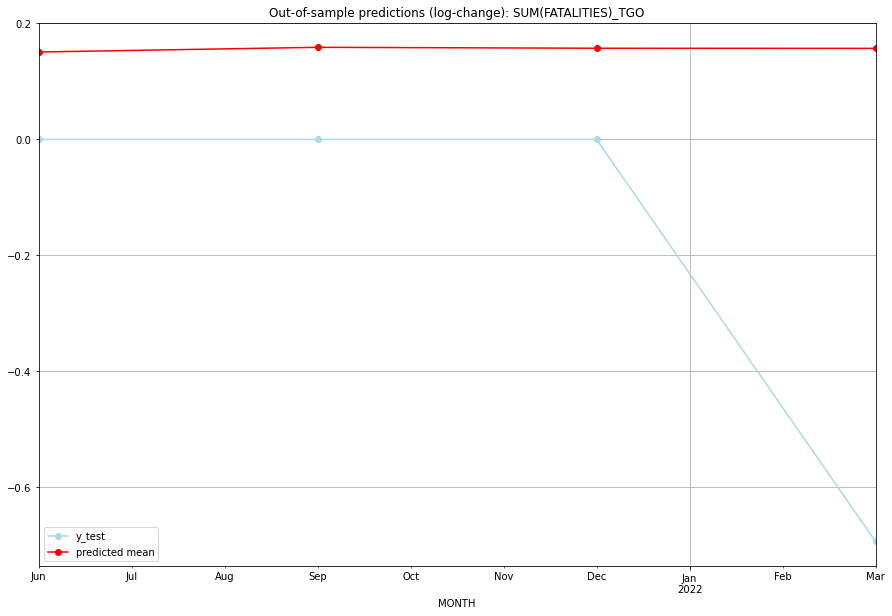

TADDA: 0.3686233484805181
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.325620         1.0      0.150840        0.000000   TGO   
1 2021-07-01  1.344508         1.0      0.158929        0.000000   TGO   
2 2021-10-01  1.340752         1.0      0.157325        0.000000   TGO   
3 2022-01-01  1.340288         0.0      0.157127       -0.693147   TGO   

                                          PARAMETERS  
0  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:25
######## THA (203/234) #########
0
Neighbor countries: ['MMR', 'LAO', 'MYS', 'KHM']
Getting Data for THA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 95)
y: (49, 1)
------------------------------------------------
Training started.
Start G

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.4052113497689085, 'fold_results': [0.05974838038186703, 0.34398463148431946, 0.8385587590580469, 0.14068295952553456, 0.6430820183947744]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_THA   No. Observations:                   45
Model:                SARIMAX(0, 1, 1)   Log Likelihood                 -24.227
Date:                 Wed, 19 Oct 2022   AIC                             58.453
Time:                         11:05:22   BIC                             67.374
Sample:                     01-31-2010   HQIC                            61.762
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

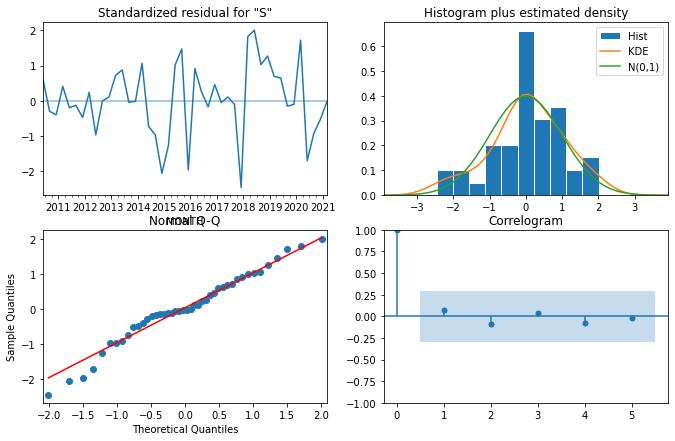

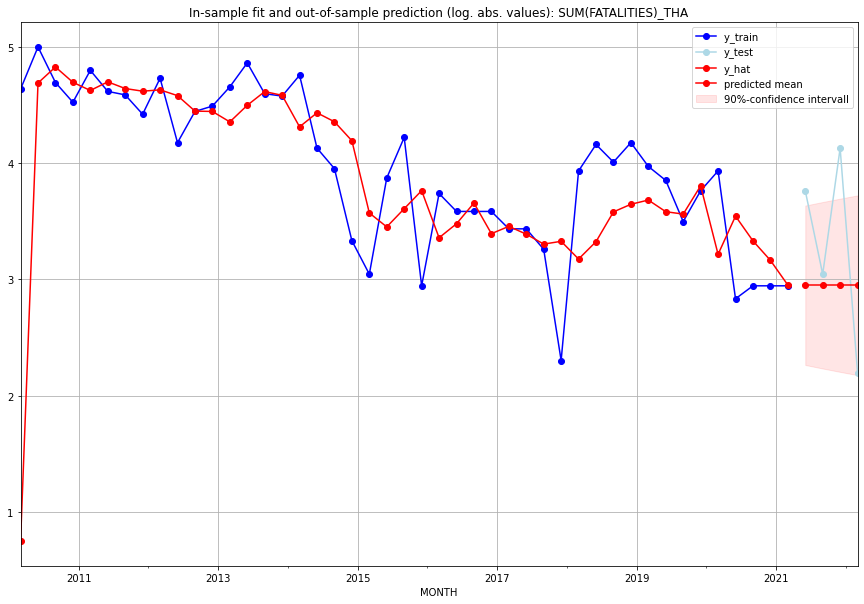

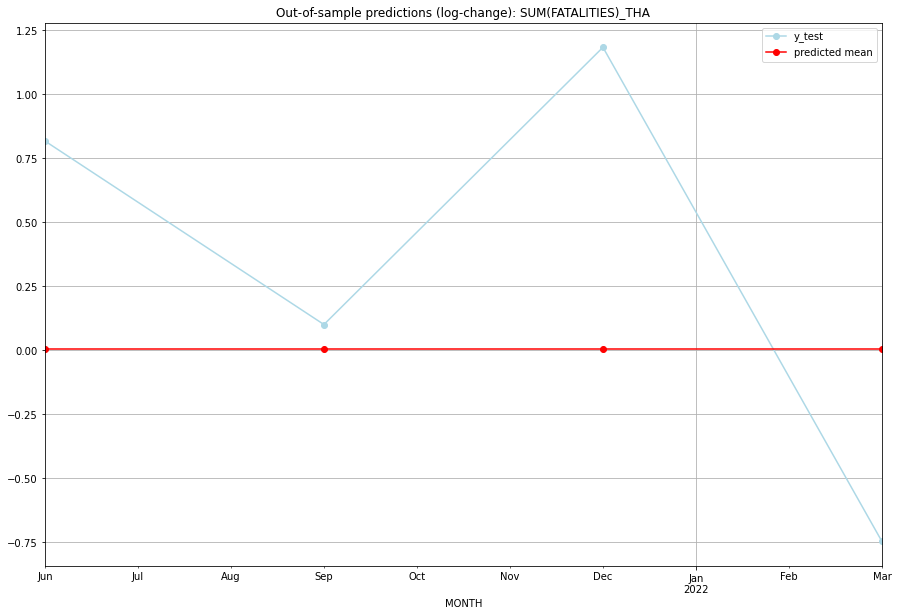

TADDA: 0.7104930162040783
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  18.091082        42.0      0.004782        0.816761   THA   
1 2021-07-01  18.091082        20.0      0.004782        0.100083   THA   
2 2021-10-01  18.091082        61.0      0.004782        1.182695   THA   
3 2022-01-01  18.091082         8.0      0.004782       -0.747214   THA   

                                          PARAMETERS  
0  {'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:23
######## TJK (204/234) #########
0
Neighbor countries: ['AFG', 'CHN', 'KGZ', 'UZB']
Getting Data for TJK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 94)
y: (17, 1)
------------------------------------------------
Training started.
St

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5216723867142015, 'fold_results': [0.5584349865723051, 0.4849097868560979]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TJK   No. Observations:                   13
Model:                SARIMAX(1, 0, 3)   Log Likelihood                 -19.880
Date:                 Wed, 19 Oct 2022   AIC                             53.761
Time:                         11:05:32   BIC                             57.715
Sample:                     01-31-2018   HQIC                            52.948
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.1290      0.

<Figure size 432x288 with 0 Axes>

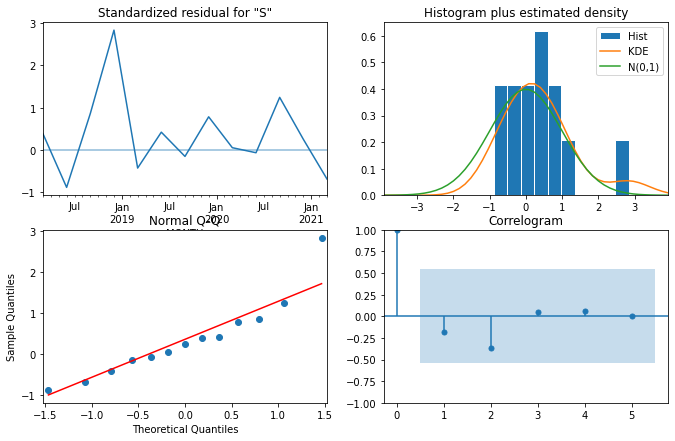

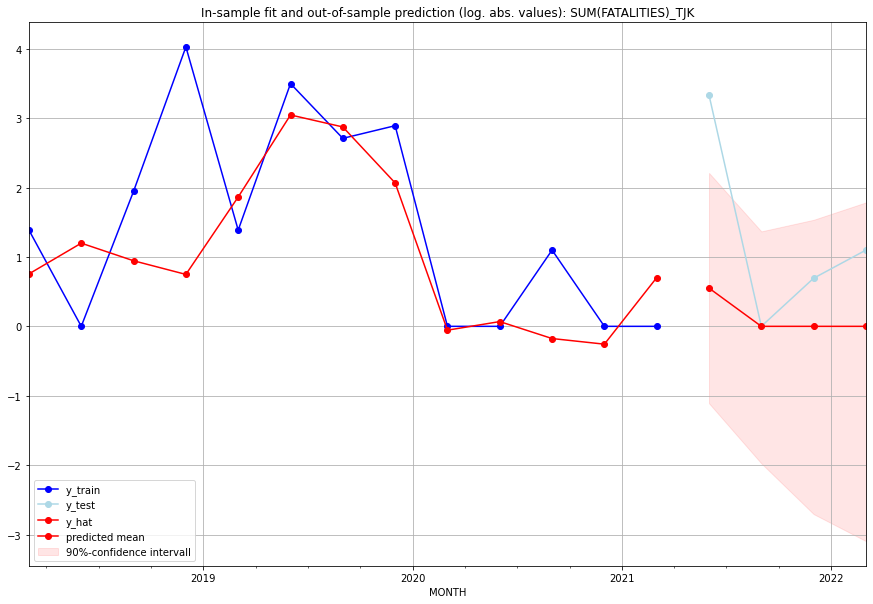

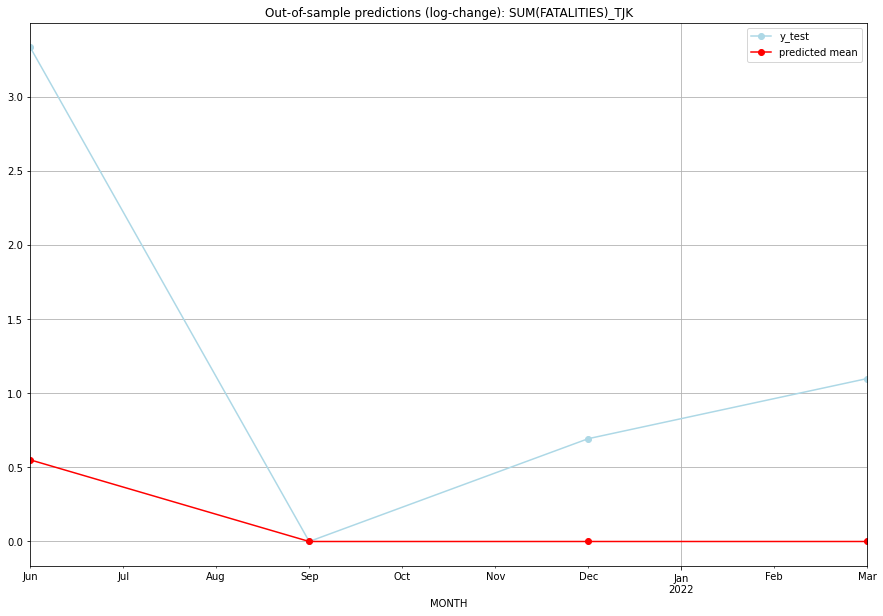

TADDA: 1.1433633636281493
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.734138        27.0      0.550511        3.332205   TJK   
1 2021-07-01  0.000000         0.0      0.000000        0.000000   TJK   
2 2021-10-01  0.000000         1.0      0.000000        0.693147   TJK   
3 2022-01-01  0.000000         2.0      0.000000        1.098612   TJK   

                                          PARAMETERS  
0  {'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## TKM (205/234) #########
0
Neighbor countries: ['AFG', 'IRN', 'KAZ', 'UZB']
Getting Data for TKM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 82)
y: (17, 1)
------------------------------------------------
Training started.
Start G

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.32222102488398213, 'fold_results': [0.4664041365894719, 0.17803791317849235]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TKM   No. Observations:                   13
Model:                SARIMAX(3, 1, 2)   Log Likelihood                 -14.342
Date:                 Wed, 19 Oct 2022   AIC                             44.684
Time:                         11:05:39   BIC                             48.564
Sample:                     01-31-2018   HQIC                            43.248
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0338      

<Figure size 432x288 with 0 Axes>

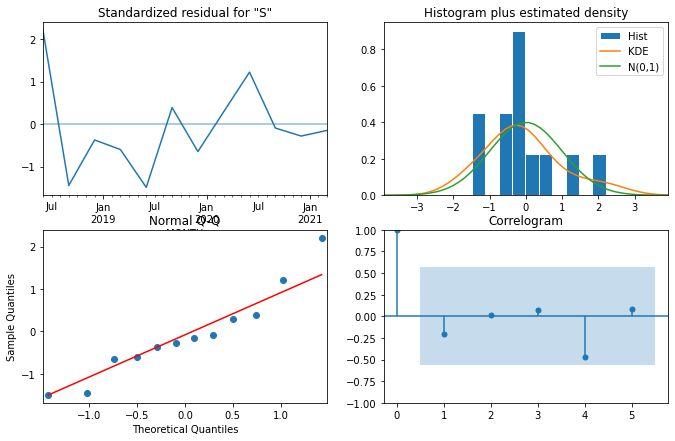

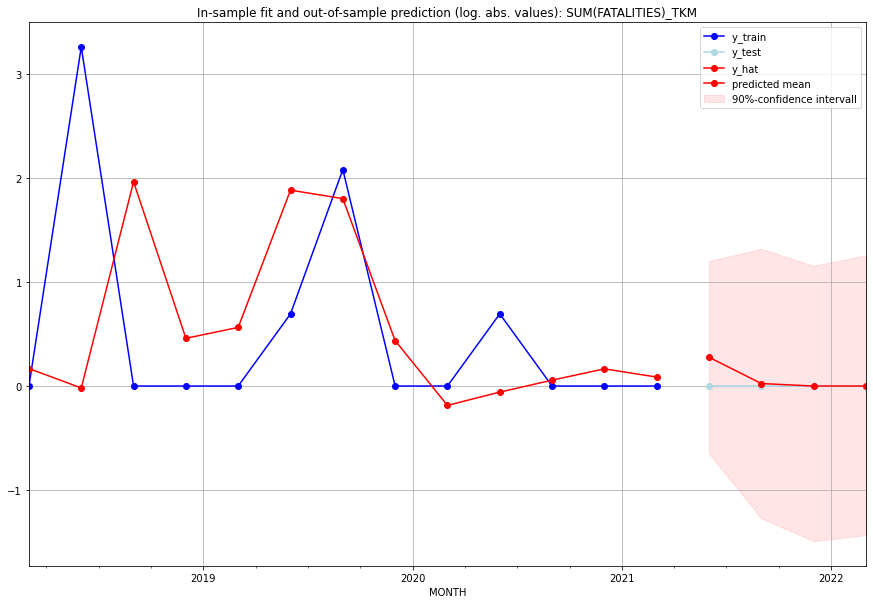

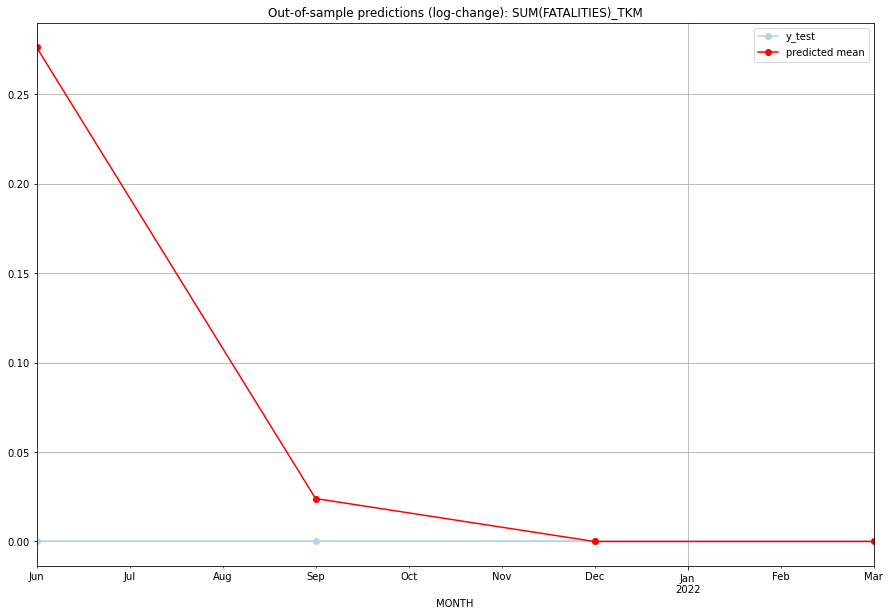

TADDA: 0.07508039453699283
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.318247         0.0      0.276303             0.0   TKM   
1 2021-07-01  0.024309         0.0      0.024019             0.0   TKM   
2 2021-10-01  0.000000         0.0      0.000000             0.0   TKM   
3 2022-01-01  0.000000         0.0      0.000000             0.0   TKM   

                                          PARAMETERS  
0  {'params': [2, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## TLS (206/234) #########
0
Neighbor countries: ['IDN']
Getting Data for TLS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No G

<Figure size 432x288 with 0 Axes>

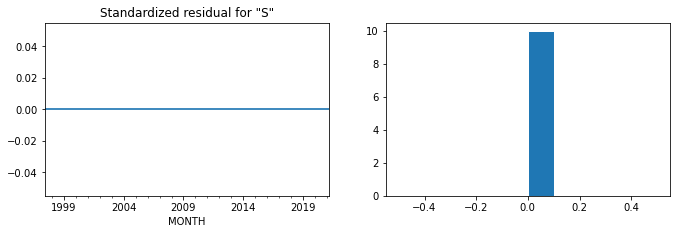

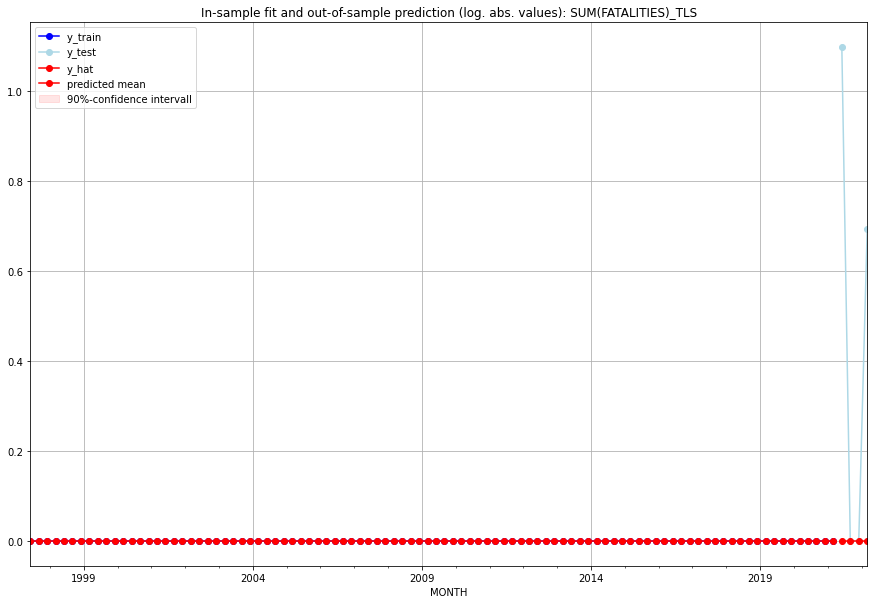

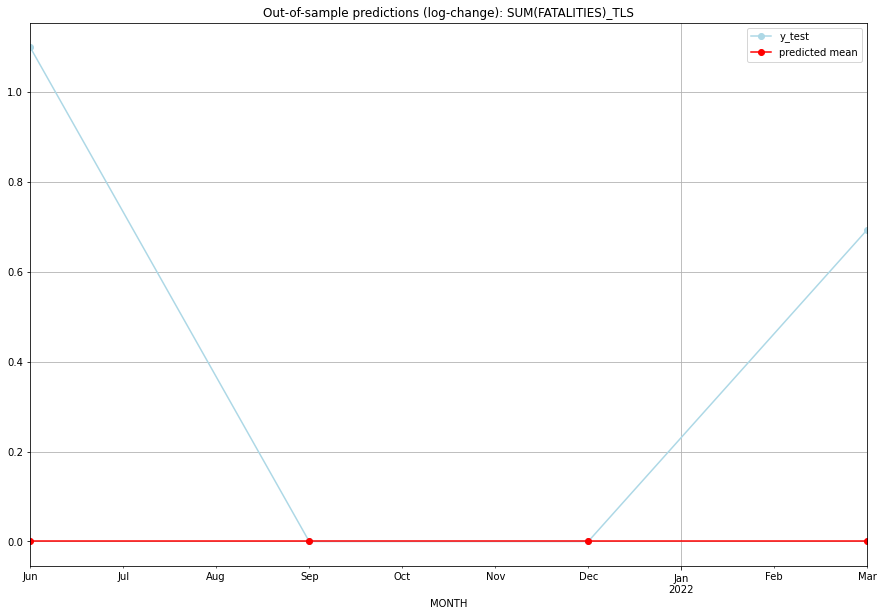

TADDA: 0.44793986730701374
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         2.0           0.0        1.098612   TLS   
1 2021-07-01       0.0         0.0           0.0        0.000000   TLS   
2 2021-10-01       0.0         0.0           0.0        0.000000   TLS   
3 2022-01-01       0.0         1.0           0.0        0.693147   TLS   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:03
######## TON (207/234) #########
0
Neighbor countries: []
Getting Data for TON
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 54)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


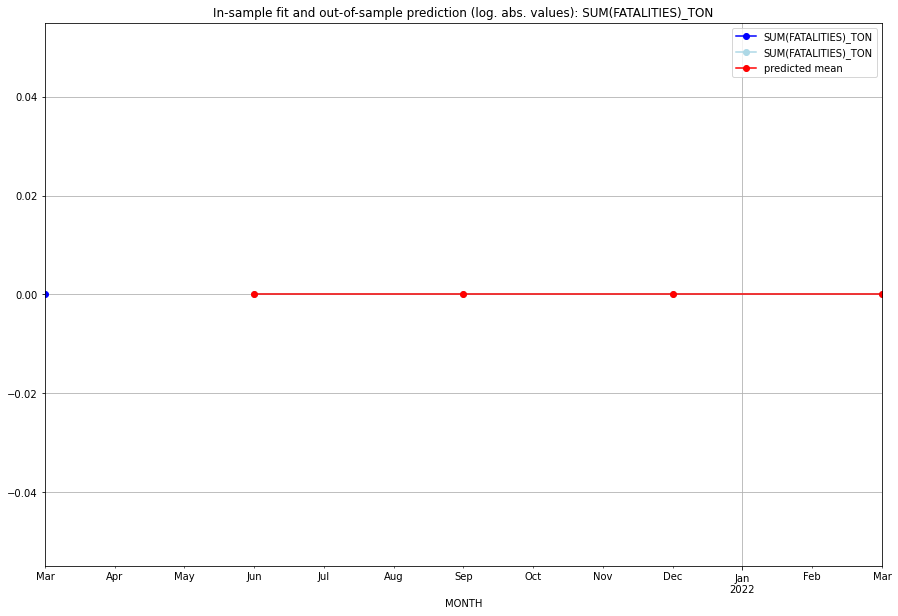

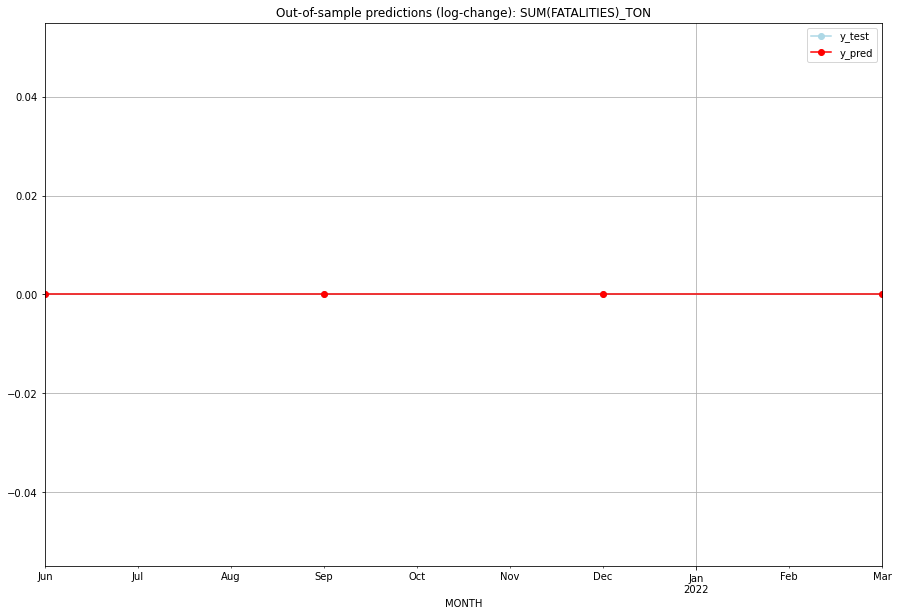

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   TON   
1 2021-07-01       0.0         0.0           0.0             0.0   TON   
2 2021-10-01       0.0         0.0           0.0             0.0   TON   
3 2022-01-01       0.0         0.0           0.0             0.0   TON   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## TTO (208/234) #########
0
Neighbor countries: []
Getting Data for TTO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 51)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4228812328890954, 'fold_results': [0.26903485820401307, 0.5767276075741777]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TTO   No. Observations:                   13
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -11.427
Date:                 Wed, 19 Oct 2022   AIC                             24.853
Time:                         11:05:55   BIC                             25.338
Sample:                     01-31-2018   HQIC                            24.674
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3932      0

<Figure size 432x288 with 0 Axes>

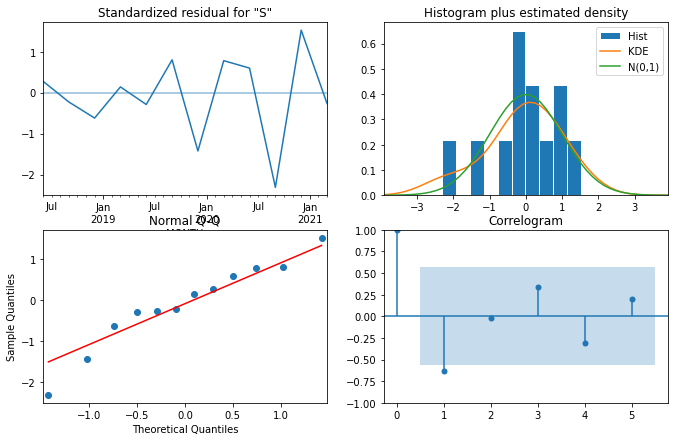

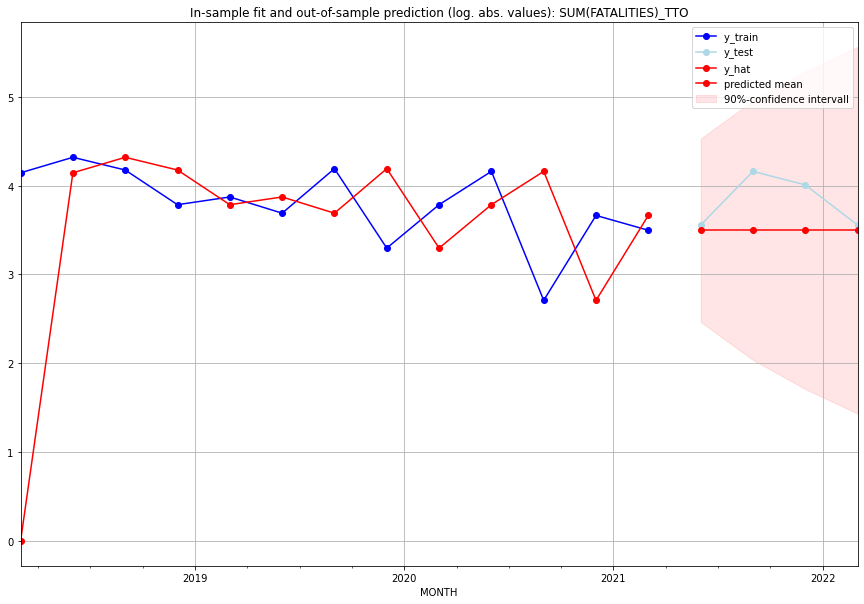

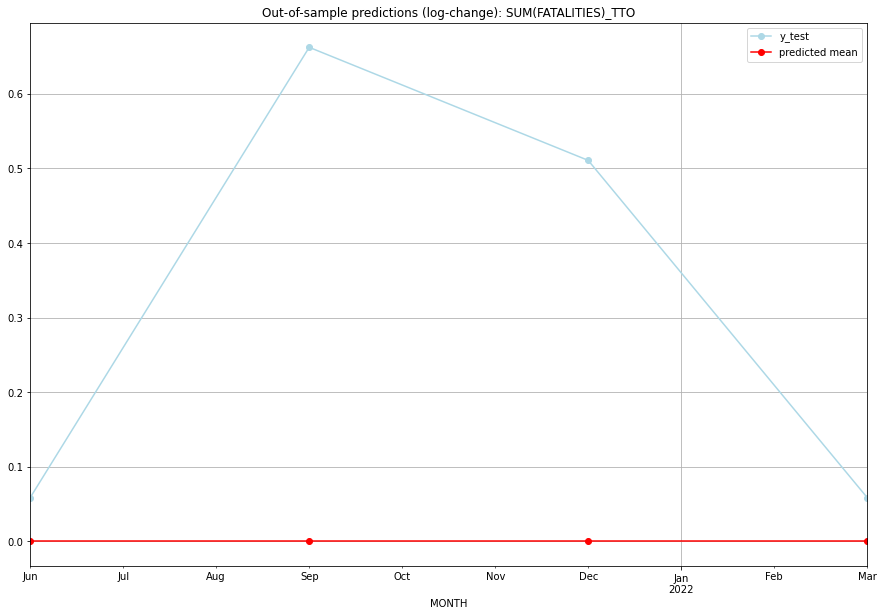

TADDA: 0.32272053642626264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      32.0        34.0           0.0        0.058841   TTO   
1 2021-07-01      32.0        63.0           0.0        0.662376   TTO   
2 2021-10-01      32.0        54.0           0.0        0.510826   TTO   
3 2022-01-01      32.0        34.0           0.0        0.058841   TTO   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:04
######## TUN (209/234) #########
0
Neighbor countries: ['DZA', 'LBY', 'ITA']
Getting Data for TUN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 88)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDS

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4843062860724087, 'fold_results': [0.9952887704274366, 0.25606064747303725, 0.47009816274665295, 0.4208361015734274, 0.2792477481414895]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TUN   No. Observations:                   96
Model:                SARIMAX(2, 1, 0)   Log Likelihood                -116.154
Date:                 Wed, 19 Oct 2022   AIC                            244.308
Time:                         11:06:19   BIC                            259.632
Sample:                     04-30-1997   HQIC                           250.500
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

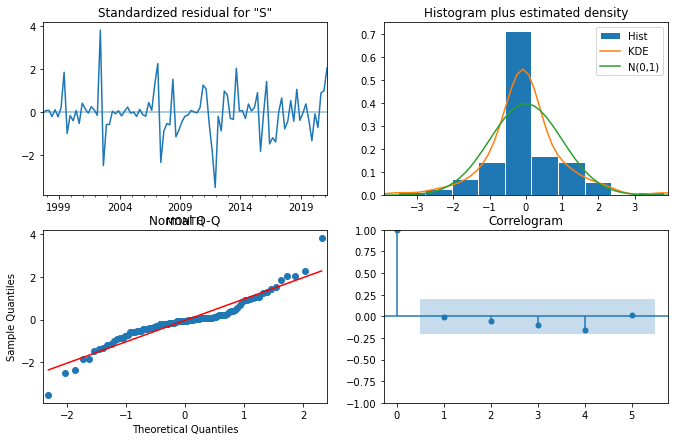

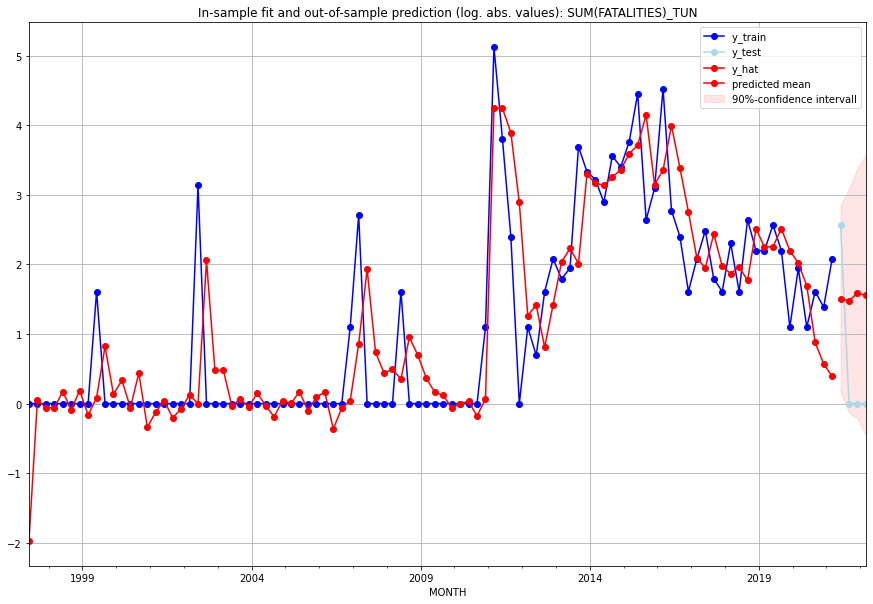

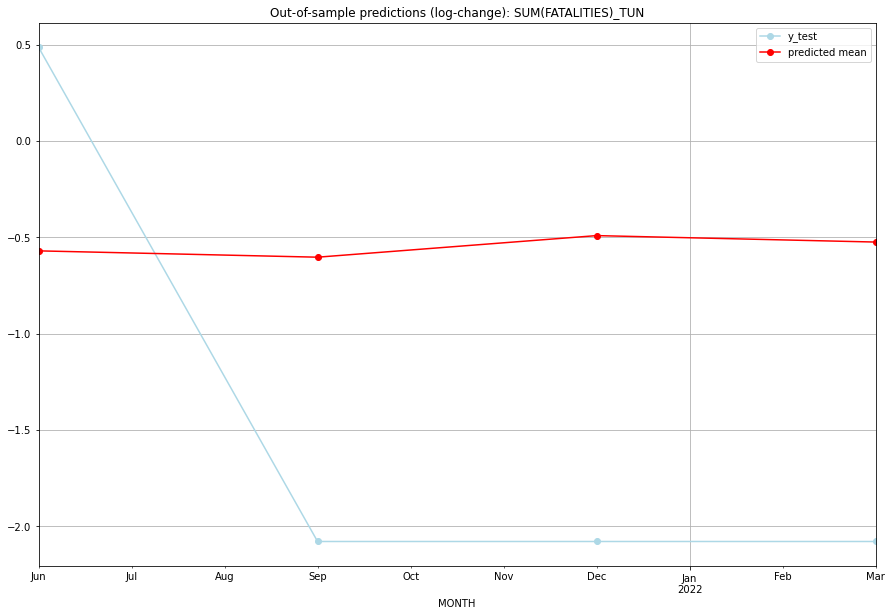

TADDA: 1.561228921677014
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  3.519685        12.0     -0.570999        0.485508   TUN   
1 2021-07-01  3.373729         0.0     -0.603825       -2.079442   TUN   
2 2021-10-01  3.892112         0.0     -0.491817       -2.079442   TUN   
3 2022-01-01  3.731154         0.0     -0.525272       -2.079442   TUN   

                                          PARAMETERS  
0  {'params': [3, (2, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:24
######## TUR (210/234) #########
0
Neighbor countries: ['GEO', 'BGR', 'GRC', 'SYR', 'IRN', 'IRQ', 'ARM', 'AZE']
Getting Data for TUR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 128)
y: (25, 1)
----------------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5046526019518166, 'fold_results': [0.3255154083419409, 0.697372309781296, 0.45083235293250423, 0.5448903367515253]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TUR   No. Observations:                   21
Model:                SARIMAX(3, 1, 0)   Log Likelihood                  -8.650
Date:                 Wed, 19 Oct 2022   AIC                             31.300
Time:                         11:06:33   BIC                             38.270
Sample:                     01-31-2016   HQIC                            32.660
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

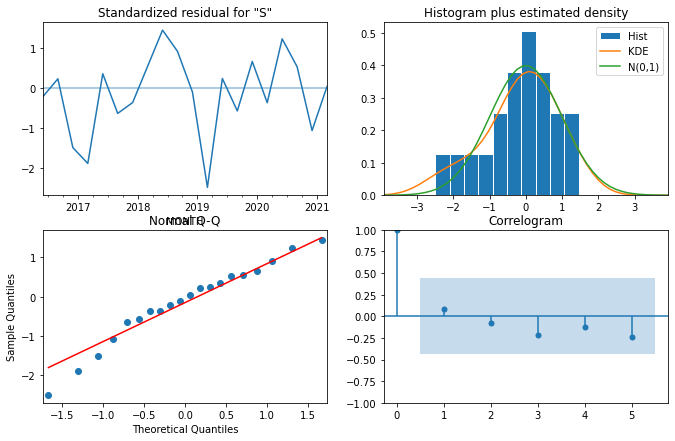

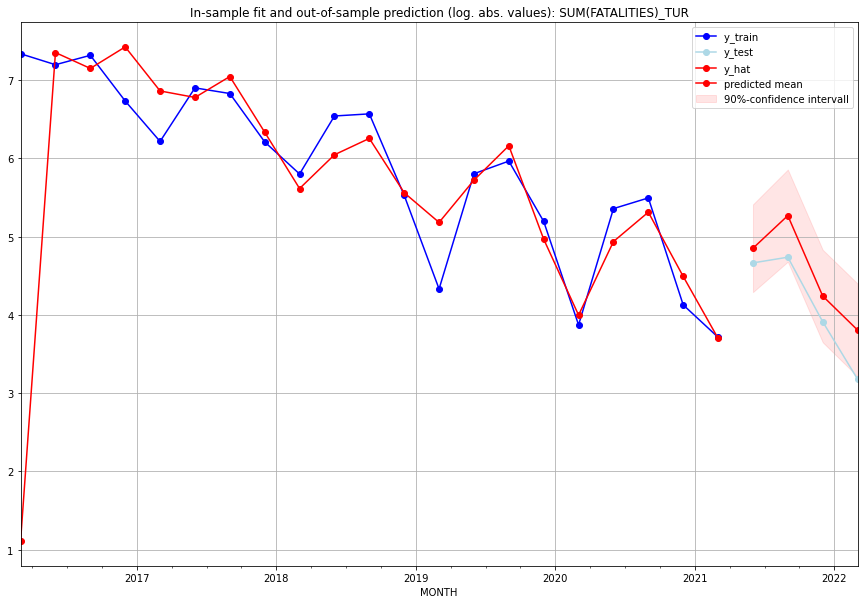

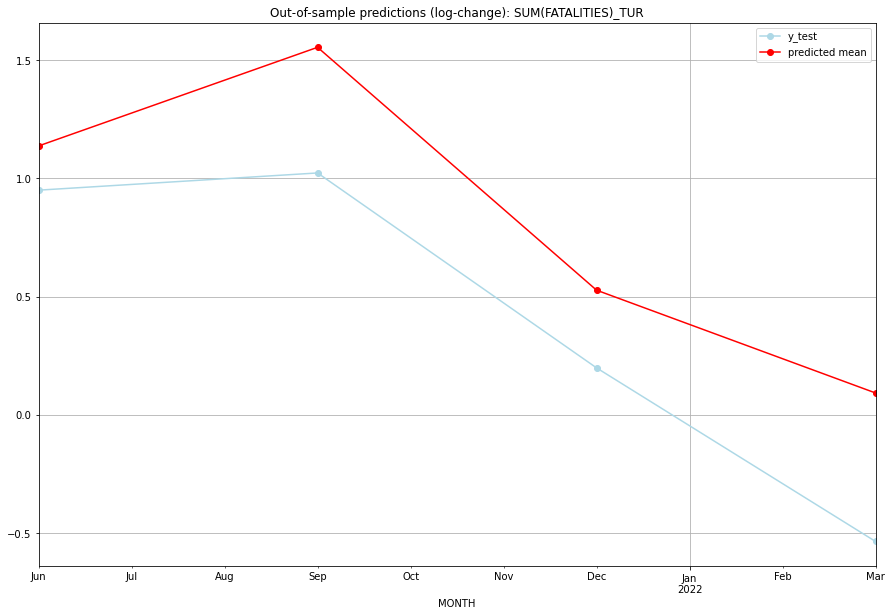

TADDA: 0.4417346262543107
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  126.793825       105.0      1.136846        0.949867   TUR   
1 2021-07-01  192.916241       113.0      1.553854        1.022626   TUR   
2 2021-10-01   68.445901        49.0      0.526976        0.198451   TUR   
3 2022-01-01   43.966429        23.0      0.092344       -0.535518   TUR   

                                          PARAMETERS  
0  {'params': [3, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## TWN (211/234) #########
0
Neighbor countries: []
Getting Data for TWN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 24)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No

<Figure size 432x288 with 0 Axes>

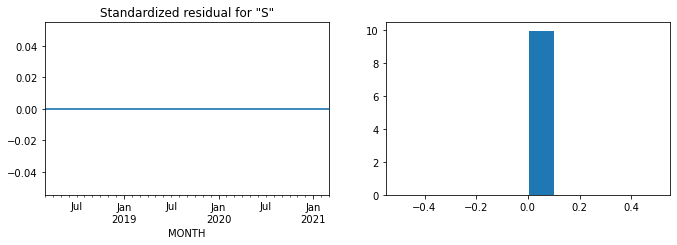

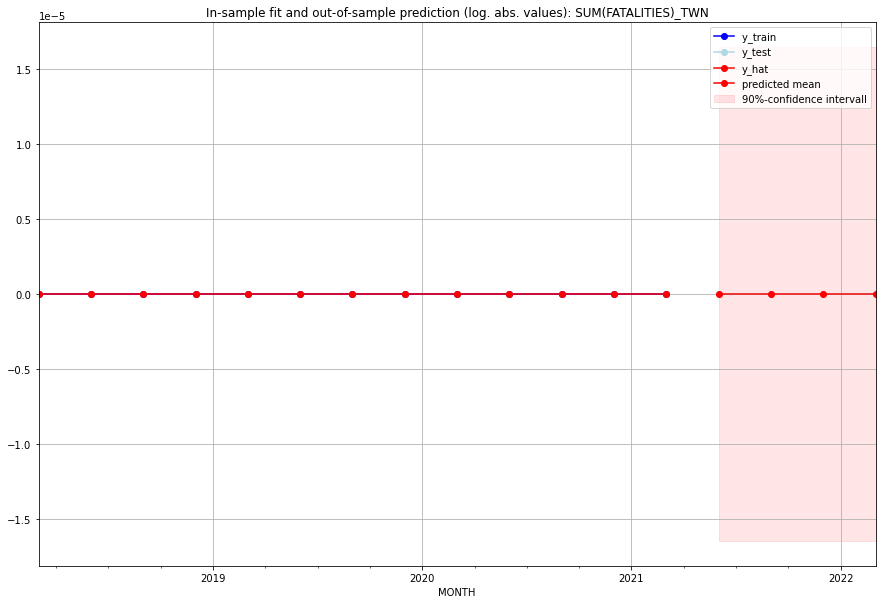

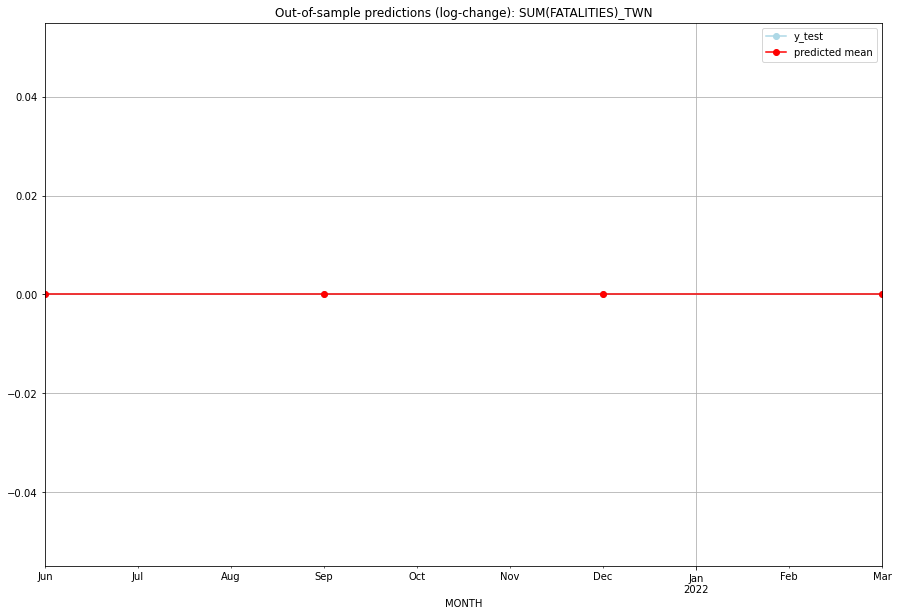

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   TWN   
1 2021-07-01       0.0         0.0           0.0             0.0   TWN   
2 2021-10-01       0.0         0.0           0.0             0.0   TWN   
3 2022-01-01       0.0         0.0           0.0             0.0   TWN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## TZA (212/234) #########
0
Neighbor countries: ['KEN', 'UGA', 'MWI', 'ZMB', 'MOZ', 'COD', 'BDI', 'RWA']
Getting Data for TZA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 124)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.0537668855742883, 'fold_results': [1.1295616399728907, 1.2689306698941785, 0.7271014295932294, 0.706689359546019, 1.4365513288651237]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TZA   No. Observations:                   96
Model:                SARIMAX(1, 1, 3)   Log Likelihood                -159.288
Date:                 Wed, 19 Oct 2022   AIC                            328.576
Time:                         11:06:53   BIC                            341.345
Sample:                     04-30-1997   HQIC                           333.735
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

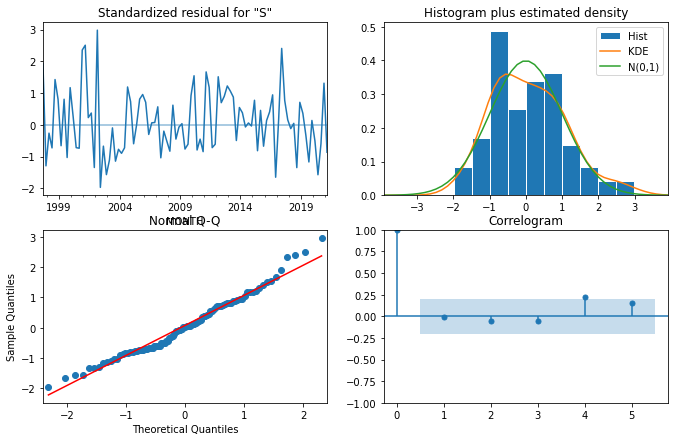

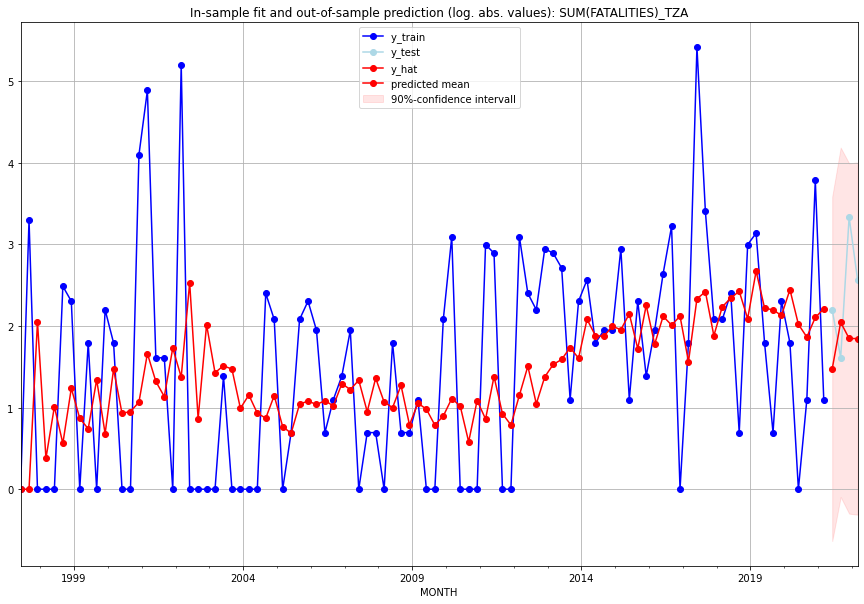

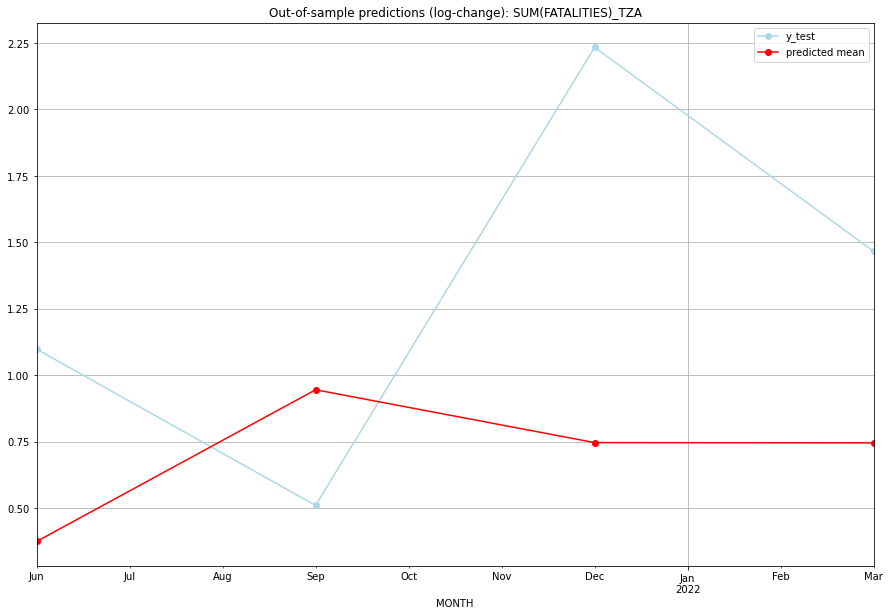

TADDA: 0.8412671095806317
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  3.365976         8.0      0.375229        1.098612   TZA   
1 2021-07-01  6.724725         4.0      0.945814        0.510826   TZA   
2 2021-10-01  5.332993        27.0      0.747161        2.233592   TZA   
3 2022-01-01  5.326098        12.0      0.746071        1.466337   TZA   

                                          PARAMETERS  
0  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## UGA (213/234) #########
0
Neighbor countries: ['RWA', 'COD', 'SSD', 'KEN', 'TZA']
Getting Data for UGA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 102)
y: (100, 1)
------------------------------------------------
Training starte

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.7993908421416653, 'fold_results': [1.4206150808002223, 1.0463544764861, 0.8510465045314064, 0.16735577891551778, 0.5115823699750804]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UGA   No. Observations:                   96
Model:                SARIMAX(1, 1, 1)   Log Likelihood                -133.209
Date:                 Wed, 19 Oct 2022   AIC                            278.419
Time:                         11:07:14   BIC                            293.742
Sample:                     04-30-1997   HQIC                           284.610
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

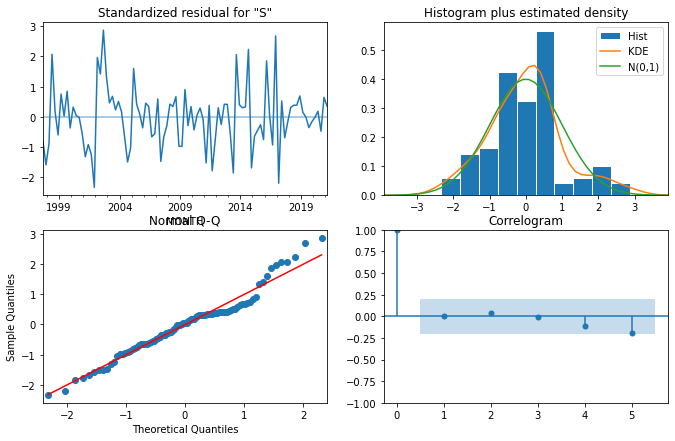

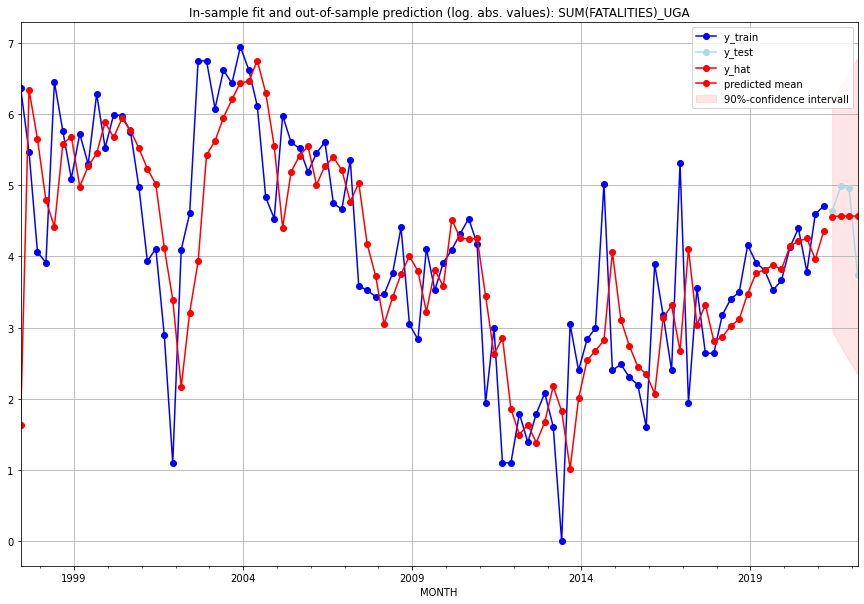

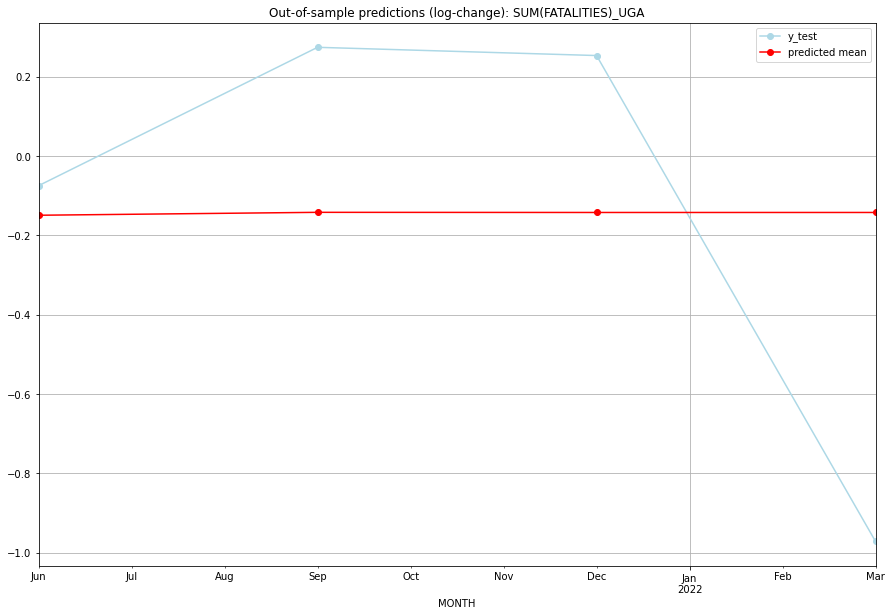

TADDA: 0.5000165283458196
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  94.602781       102.0     -0.149328       -0.074801   UGA   
1 2021-07-01  95.308944       145.0     -0.141969        0.274076   UGA   
2 2021-10-01  95.274020       142.0     -0.142332        0.253314   UGA   
3 2022-01-01  95.275741        41.0     -0.142314       -0.971861   UGA   

                                          PARAMETERS  
0  {'params': [3, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## UKR (214/234) #########
0
Neighbor countries: ['BLR', 'POL', 'RUS', 'MDA', 'ROU', 'HUN', 'SVK']
Getting Data for UKR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 120)
y: (17, 1)
-----------------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.32829473893816175, 'fold_results': [0.4383375764717262, 0.21825190140459727]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UKR   No. Observations:                   13
Model:                SARIMAX(1, 0, 3)   Log Likelihood                  -9.103
Date:                 Wed, 19 Oct 2022   AIC                             30.206
Time:                         11:07:20   BIC                             33.596
Sample:                     01-31-2018   HQIC                            29.509
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0378      

<Figure size 432x288 with 0 Axes>

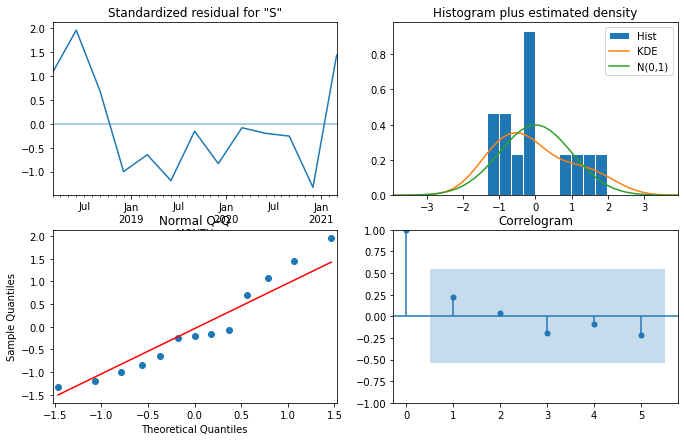

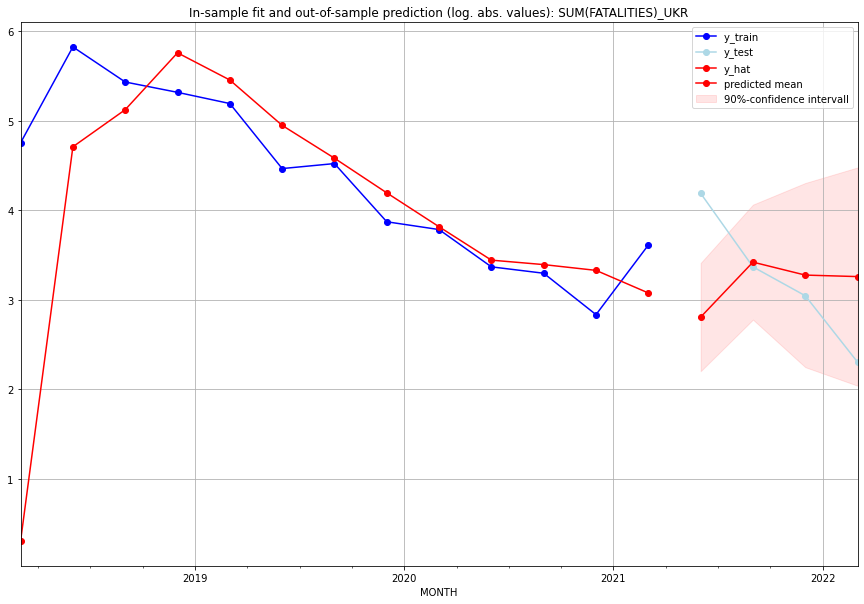

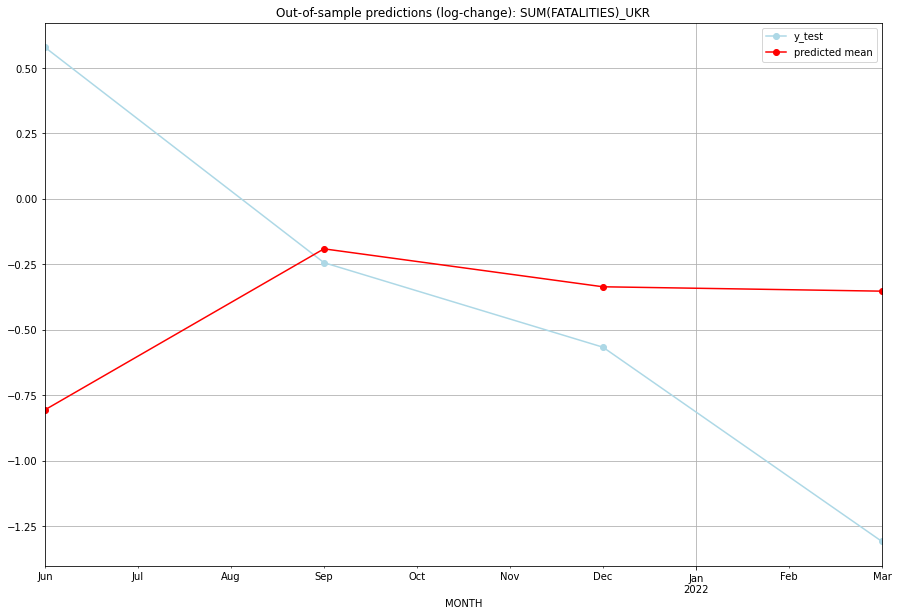

TADDA: 0.8573216663685612
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  15.532654        65.0     -0.805580        0.578737   UKR   
1 2021-07-01  29.572442        28.0     -0.190819       -0.243622   UKR   
2 2021-10-01  25.449029        20.0     -0.335698       -0.566395   UKR   
3 2022-01-01  25.009812         9.0     -0.352444       -1.308333   UKR   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## URY (215/234) #########
0
Neighbor countries: ['ARG', 'BRA']
Getting Data for URY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 79)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.25993019270997847, 'fold_results': [0.5198603854199569, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_URY   No. Observations:                   13
Model:                SARIMAX(3, 1, 1)   Log Likelihood                  -0.165
Date:                 Wed, 19 Oct 2022   AIC                             12.330
Time:                         11:07:32   BIC                             15.239
Sample:                     01-31-2018   HQIC                            11.253
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0198      0.091      0.217

<Figure size 432x288 with 0 Axes>

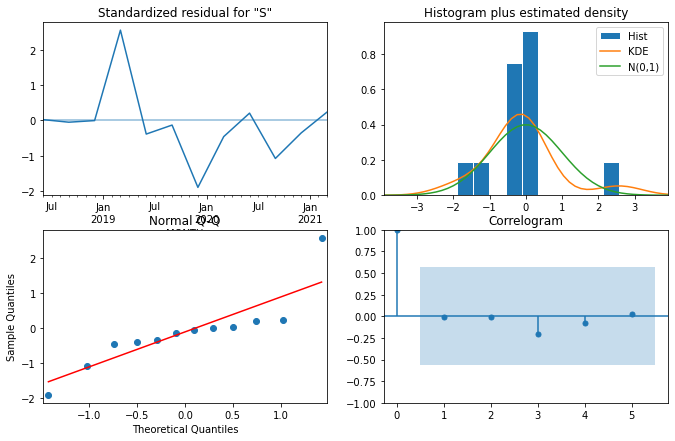

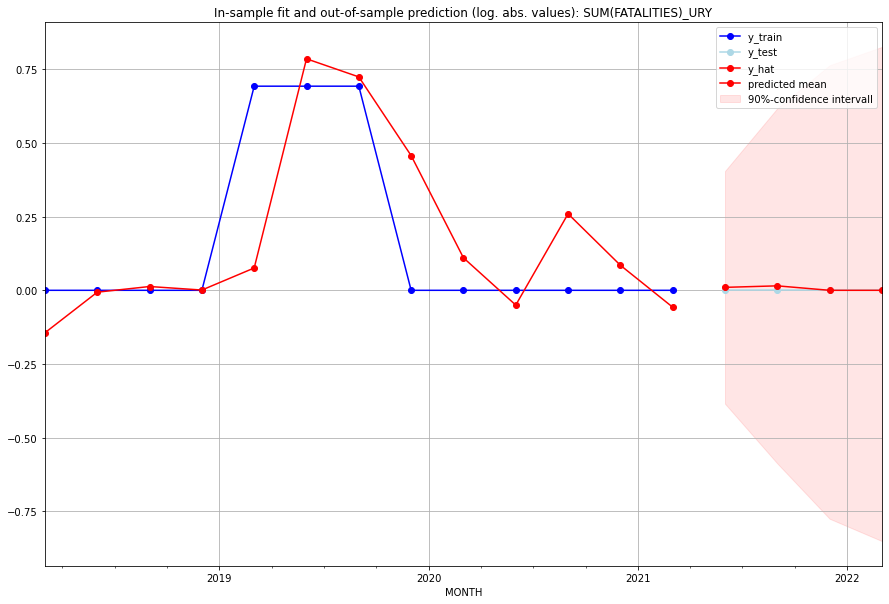

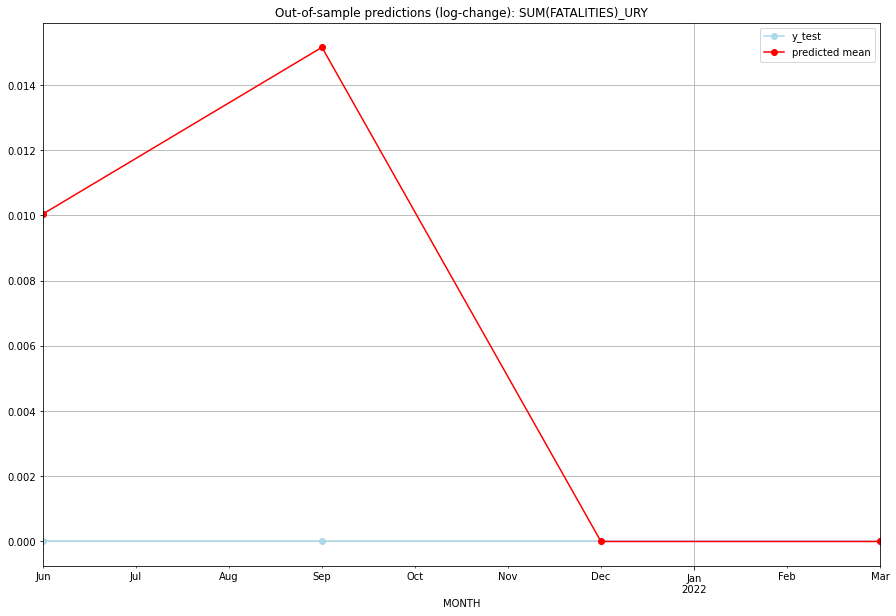

TADDA: 0.006300344348915157
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.010096         0.0      0.010046             0.0   URY   
1 2021-07-01  0.015271         0.0      0.015156             0.0   URY   
2 2021-10-01  0.000000         0.0      0.000000             0.0   URY   
3 2022-01-01  0.000000         0.0      0.000000             0.0   URY   

                                          PARAMETERS  
0  {'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## USA (216/234) #########
0
Neighbor countries: ['CAN', 'MEX']
Getting Data for USA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 79)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. 

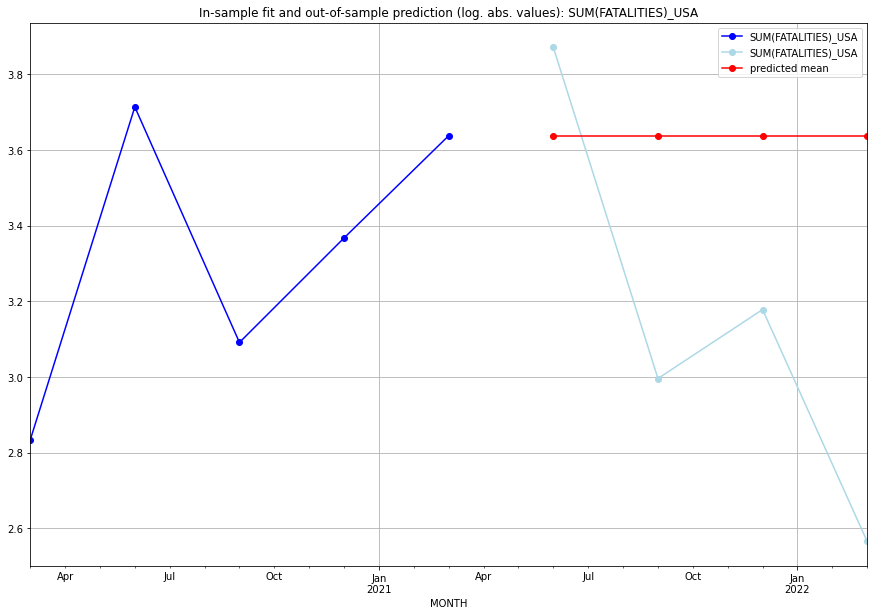

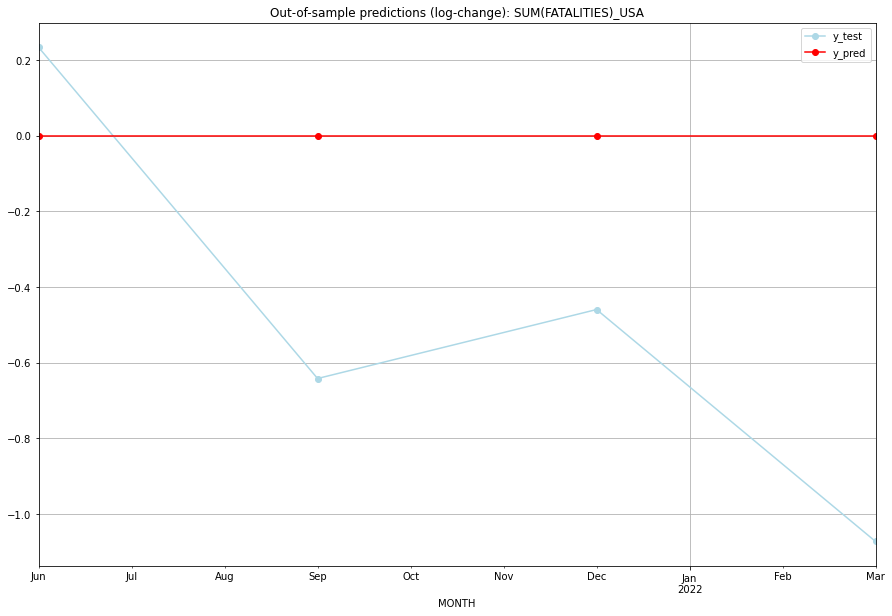

TADDA: 0.6019094672492973
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  3.637586    3.871201           0.0        0.233615   USA   
1 2021-07-01  3.637586    2.995732           0.0       -0.641854   USA   
2 2021-10-01  3.637586    3.178054           0.0       -0.459532   USA   
3 2022-01-01  3.637586    2.564949           0.0       -1.072637   USA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## UZB (217/234) #########
0
Neighbor countries: ['TJK', 'KAZ', 'AFG', 'TKM', 'KGZ']
Getting Data for UZB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 100)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.3580968662163613, 'fold_results': [0.44801215529551286, 0.26818157713720975]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UZB   No. Observations:                   13
Model:                SARIMAX(2, 0, 3)   Log Likelihood                  -6.784
Date:                 Wed, 19 Oct 2022   AIC                             29.568
Time:                         11:07:44   BIC                             34.088
Sample:                     01-31-2018   HQIC                            28.639
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0133      

<Figure size 432x288 with 0 Axes>

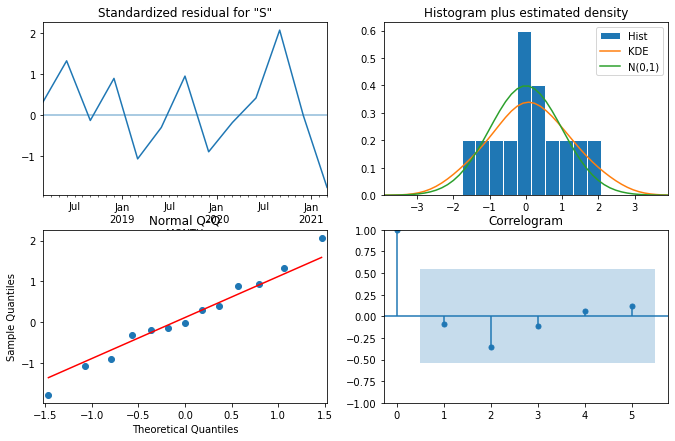

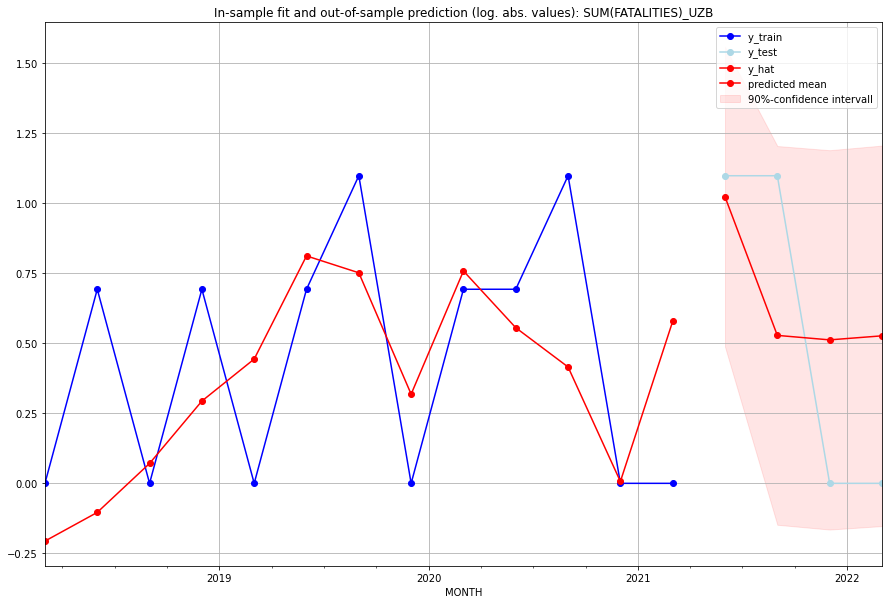

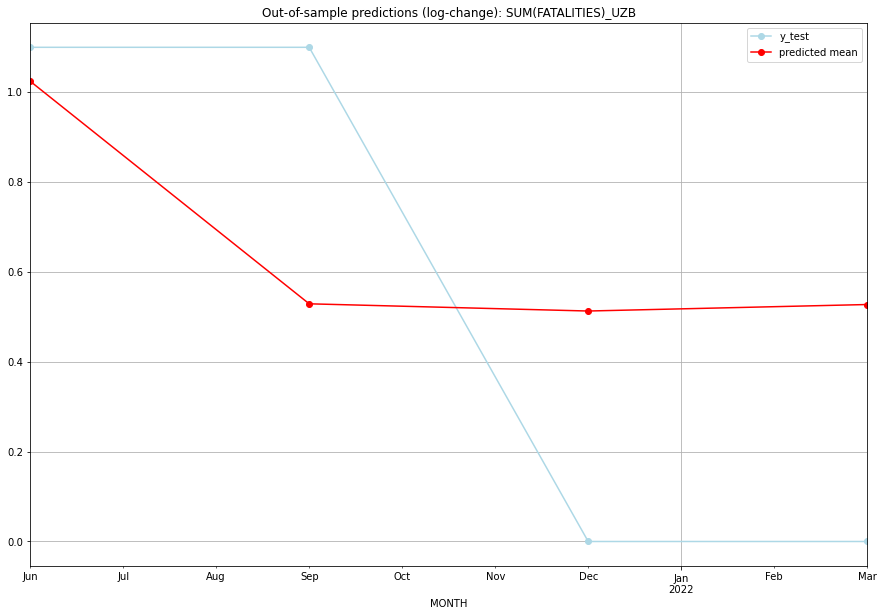

TADDA: 0.42120566825186295
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.782036         2.0      1.023183        1.098612   UZB   
1 2021-07-01  0.696183         2.0      0.528380        1.098612   UZB   
2 2021-10-01  0.669230         0.0      0.512362        0.000000   UZB   
3 2022-01-01  0.693503         0.0      0.526799        0.000000   UZB   

                                          PARAMETERS  
0  {'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## VAT (218/234) #########
0
Neighbor countries: ['ITA']
Getting Data for VAT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 8)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insuffici

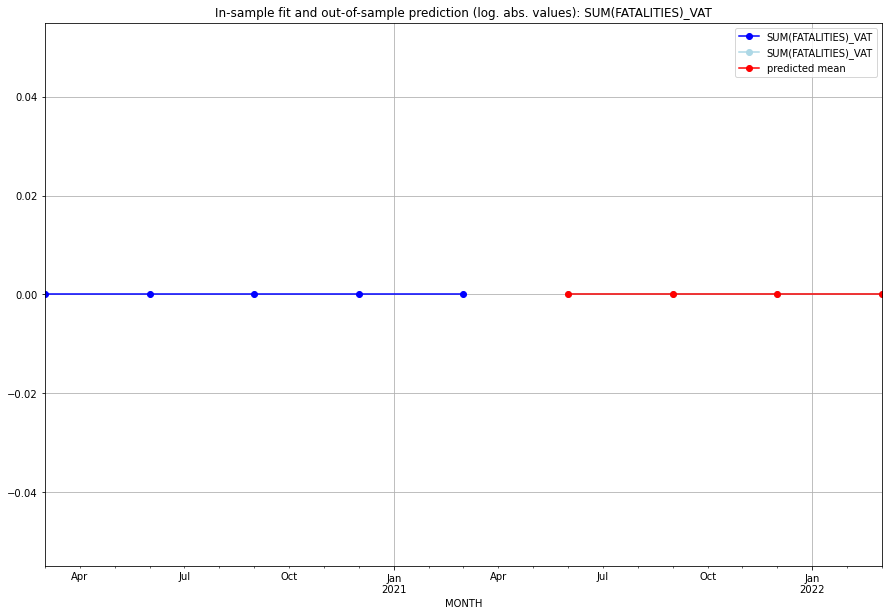

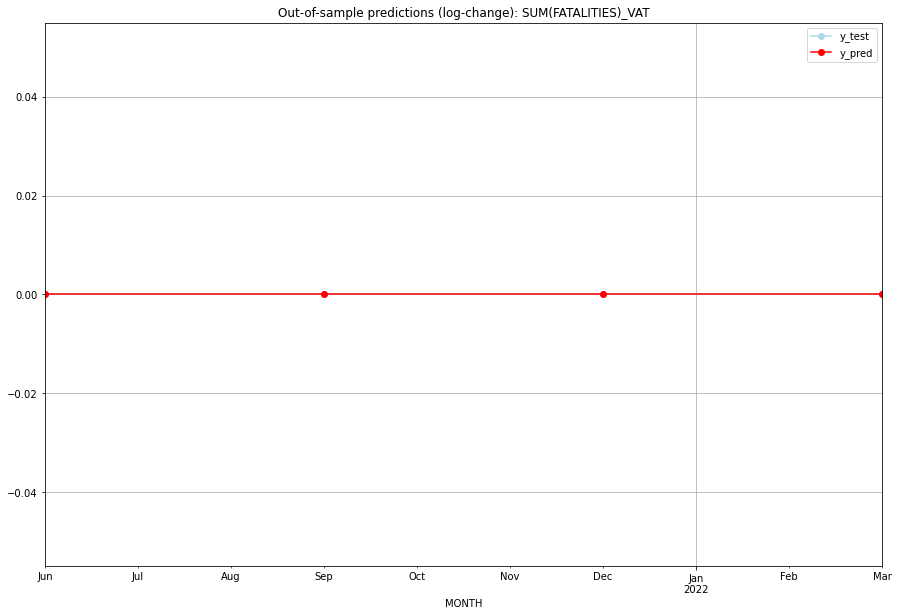

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   VAT   
1 2021-07-01       0.0         0.0           0.0             0.0   VAT   
2 2021-10-01       0.0         0.0           0.0             0.0   VAT   
3 2022-01-01       0.0         0.0           0.0             0.0   VAT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## VCT (219/234) #########
0
Neighbor countries: []
Getting Data for VCT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 49)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


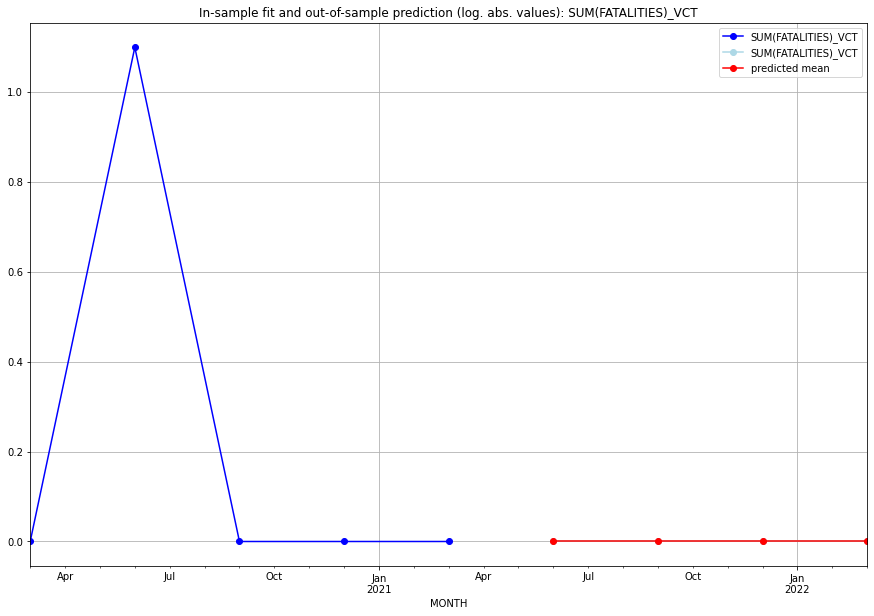

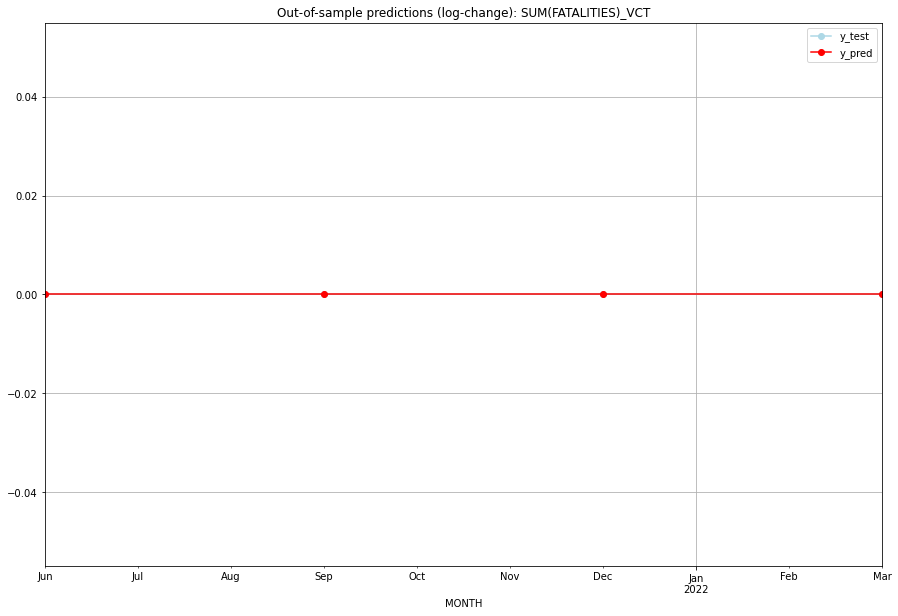

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   VCT   
1 2021-07-01       0.0         0.0           0.0             0.0   VCT   
2 2021-10-01       0.0         0.0           0.0             0.0   VCT   
3 2022-01-01       0.0         0.0           0.0             0.0   VCT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## VEN (220/234) #########
0
Neighbor countries: ['BRA', 'COL', 'GUY']
Getting Data for VEN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 81)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.46462938885936933, 'fold_results': [0.46462938885936933, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_VEN   No. Observations:                   13
Model:                SARIMAX(1, 0, 2)   Log Likelihood                  -9.393
Date:                 Wed, 19 Oct 2022   AIC                             32.787
Time:                         11:07:58   BIC                             36.742
Sample:                     01-31-2018   HQIC                            31.974
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0393      0.212      0.18

<Figure size 432x288 with 0 Axes>

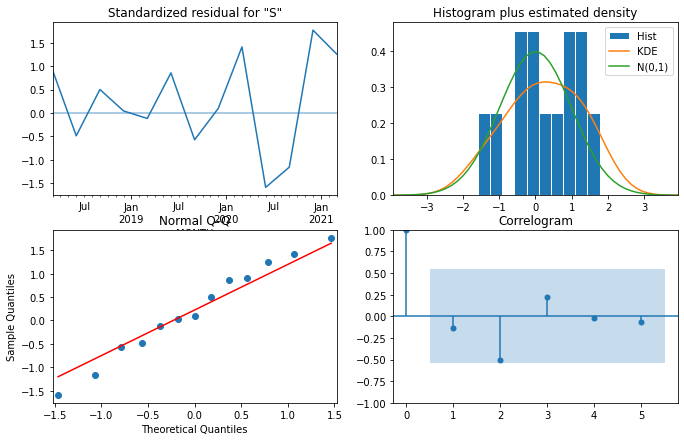

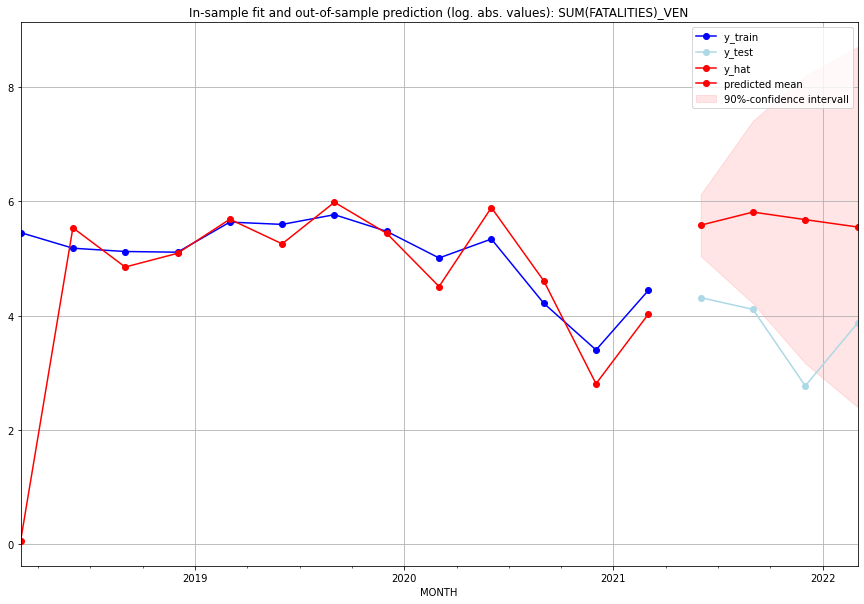

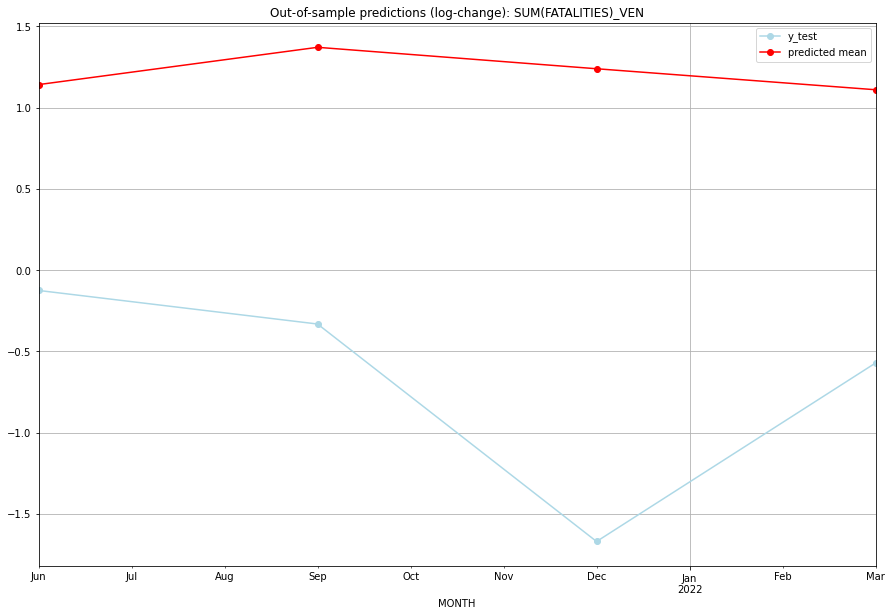

TADDA: 3.1056190257036764
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  265.217062        74.0      1.141661       -0.125163   VEN   
1 2021-07-01  333.888257        60.0      1.371146       -0.331777   VEN   
2 2021-10-01  292.494551        15.0      1.239208       -1.670063   VEN   
3 2022-01-01  256.919735        47.0      1.109997       -0.571450   VEN   

                                          PARAMETERS  
0  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## VIR (221/234) #########
0
Neighbor countries: []
Getting Data for VIR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 23)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insu

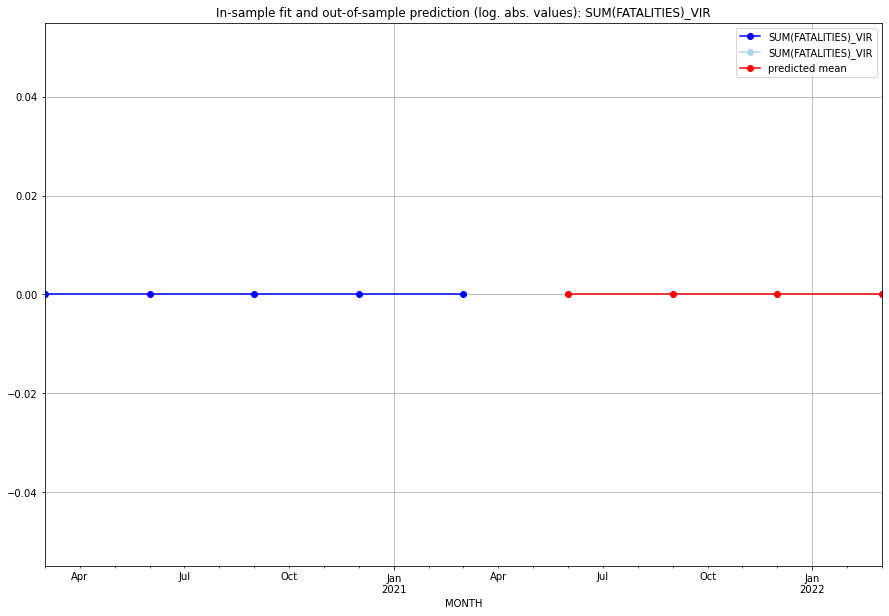

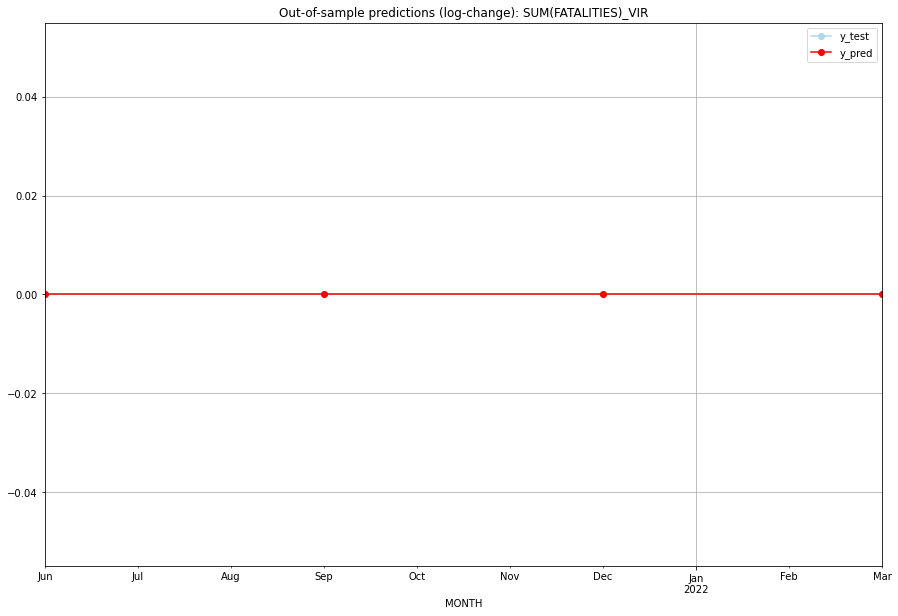

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   VIR   
1 2021-07-01       0.0         0.0           0.0             0.0   VIR   
2 2021-10-01       0.0         0.0           0.0             0.0   VIR   
3 2022-01-01       0.0         0.0           0.0             0.0   VIR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## VNM (222/234) #########
0
Neighbor countries: ['KHM', 'CHN', 'LAO']
Getting Data for VNM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 85)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.4543941608905178, 'fold_results': [0.49149077832309357, 0.455039001223058, 0.4479401034494456, 0.313121603158307, 0.5643793182986847]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_VNM   No. Observations:                   45
Model:                SARIMAX(2, 0, 2)   Log Likelihood                 -57.118
Date:                 Wed, 19 Oct 2022   AIC                            126.236
Time:                         11:08:10   BIC                            137.076
Sample:                     01-31-2010   HQIC                           130.277
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

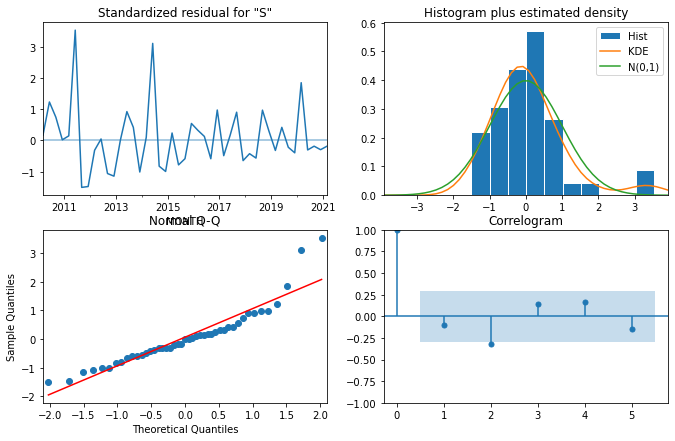

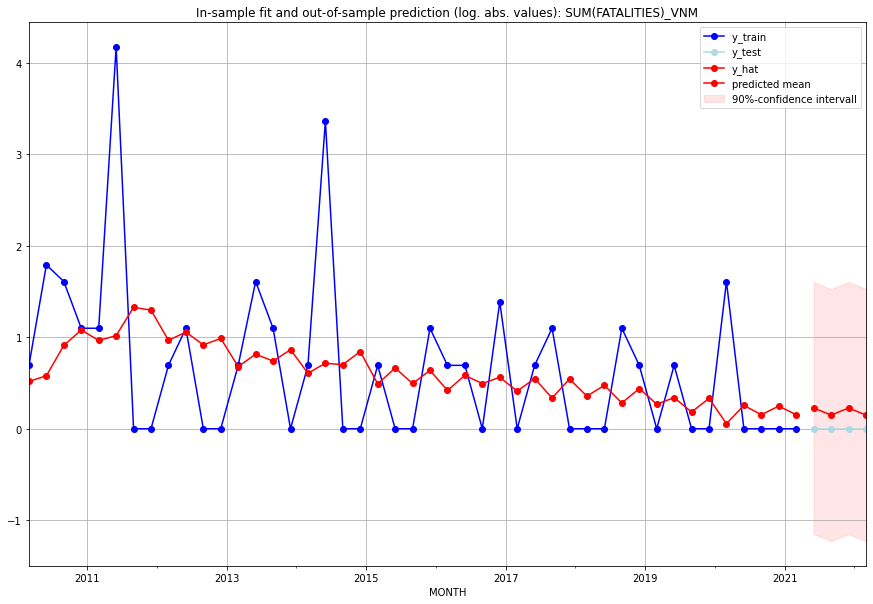

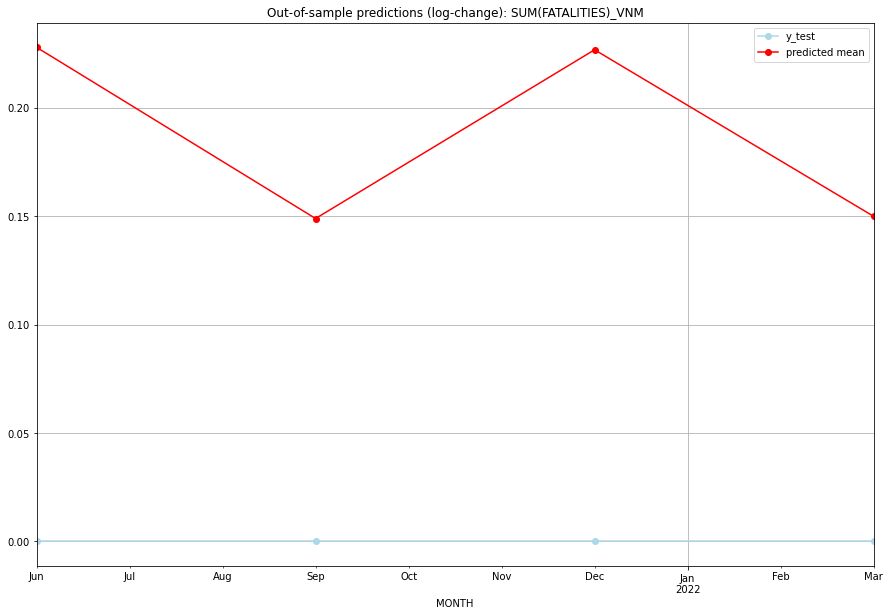

TADDA: 0.1882977909012742
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.255815         0.0      0.227785             0.0   VNM   
1 2021-07-01  0.160521         0.0      0.148869             0.0   VNM   
2 2021-10-01  0.254388         0.0      0.226648             0.0   VNM   
3 2022-01-01  0.161706         0.0      0.149889             0.0   VNM   

                                          PARAMETERS  
0  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## VUT (223/234) #########
0
Neighbor countries: []
Getting Data for VUT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 49)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient d

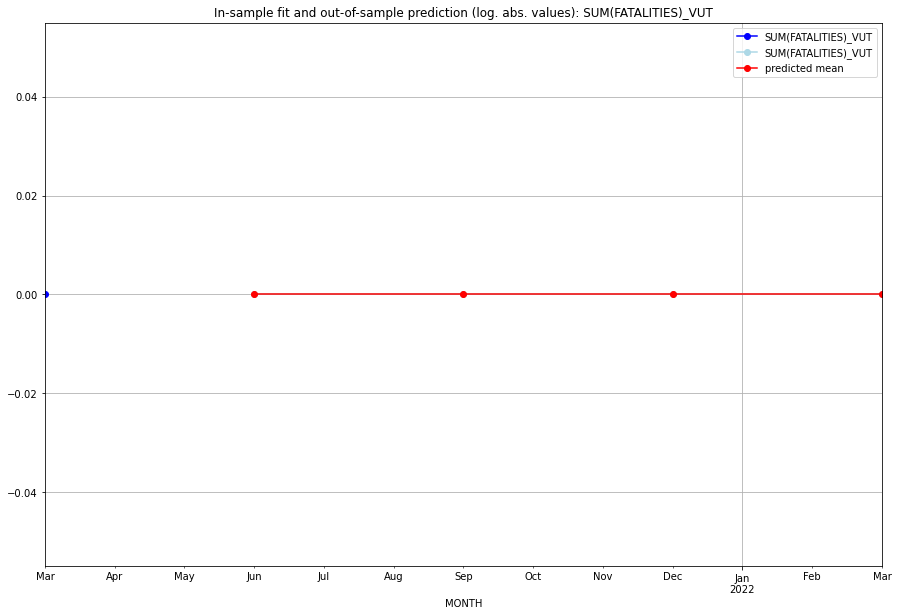

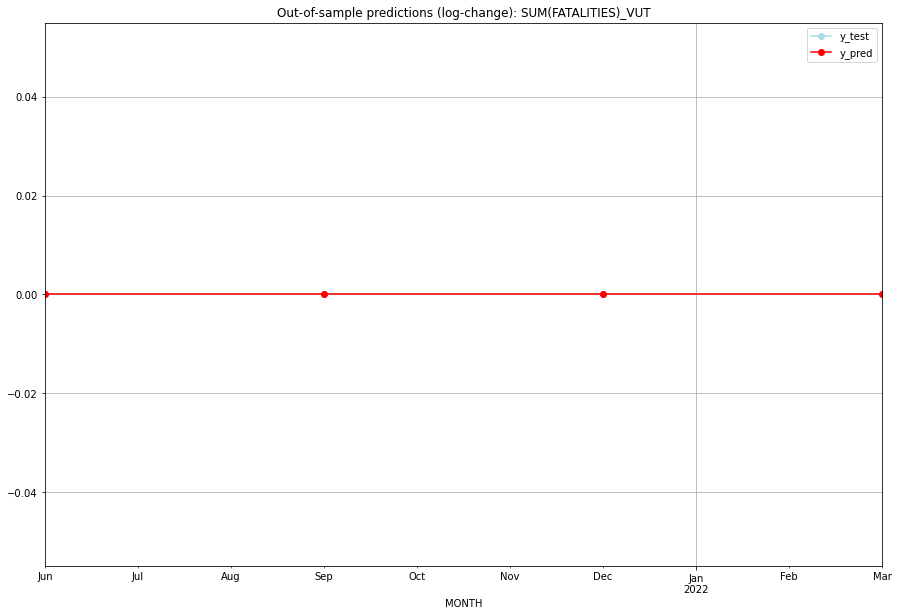

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   VUT   
1 2021-07-01       0.0         0.0           0.0             0.0   VUT   
2 2021-10-01       0.0         0.0           0.0             0.0   VUT   
3 2022-01-01       0.0         0.0           0.0             0.0   VUT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## WLF (224/234) #########
0
Neighbor countries: []
Getting Data for WLF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


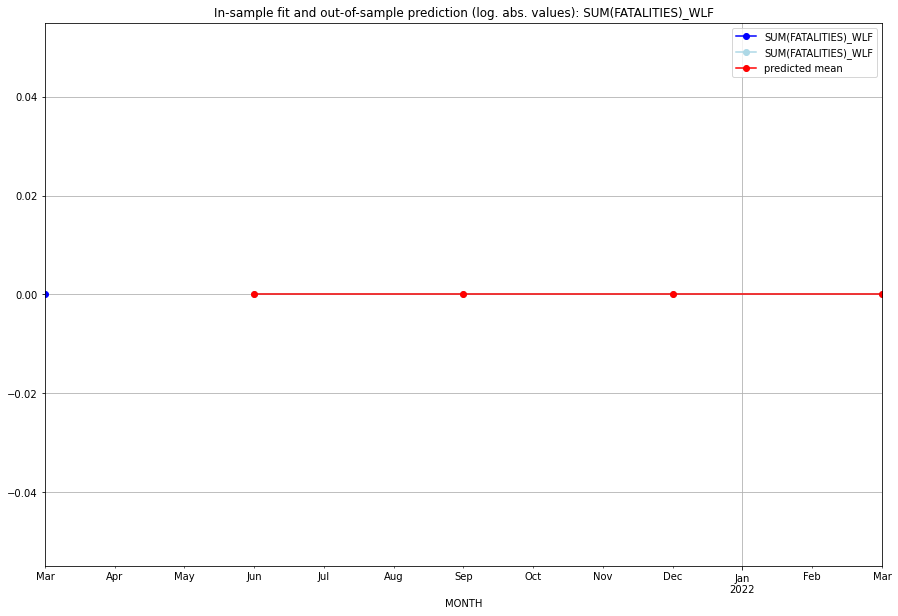

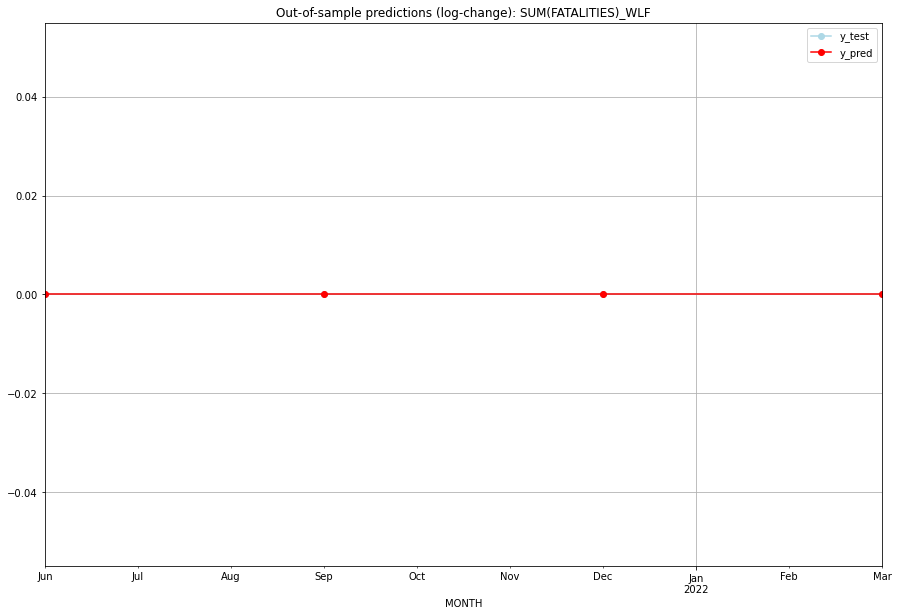

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   WLF   
1 2021-07-01       0.0         0.0           0.0             0.0   WLF   
2 2021-10-01       0.0         0.0           0.0             0.0   WLF   
3 2022-01-01       0.0         0.0           0.0             0.0   WLF   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## WSM (225/234) #########
0
Neighbor countries: []
Getting Data for WSM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 50)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


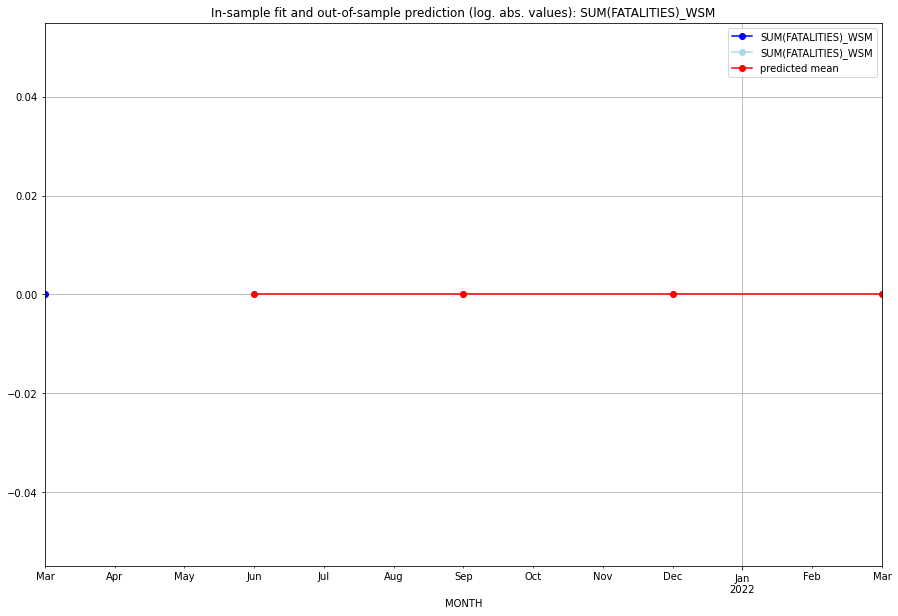

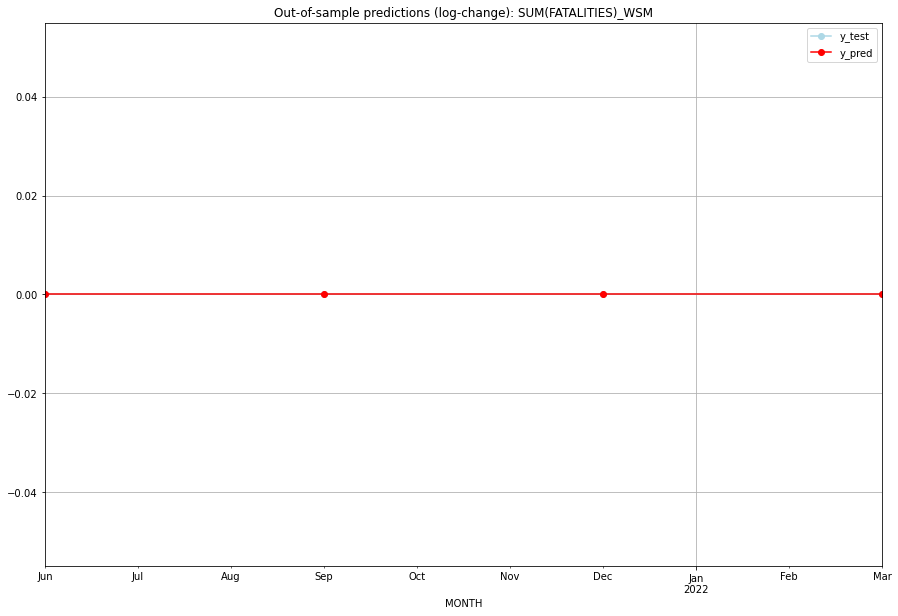

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   WSM   
1 2021-07-01       0.0         0.0           0.0             0.0   WSM   
2 2021-10-01       0.0         0.0           0.0             0.0   WSM   
3 2022-01-01       0.0         0.0           0.0             0.0   WSM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## XAR (226/234) #########
0
Neighbor countries: ['SDN', 'SSD']
Getting Data for XAR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 16)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.9948095758469346, 'fold_results': [1.6298647742419154, 0.5904735860969869, 0.8460839133648826, 0.983216085916066, 0.9244095196148225]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XAR   No. Observations:                   96
Model:                SARIMAX(3, 0, 0)   Log Likelihood                -160.495
Date:                 Wed, 19 Oct 2022   AIC                            330.989
Time:                         11:08:30   BIC                            343.811
Sample:                     04-30-1997   HQIC                           336.172
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

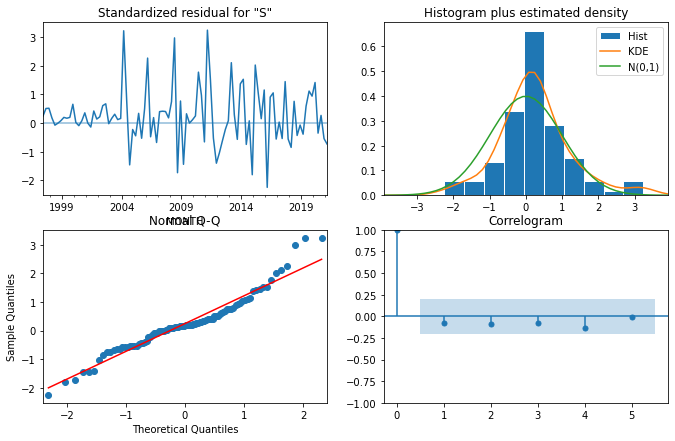

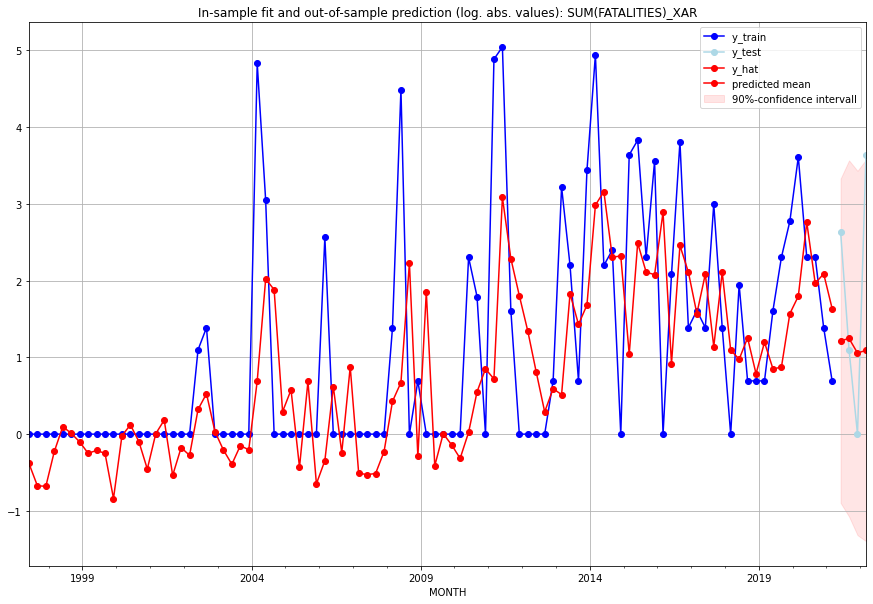

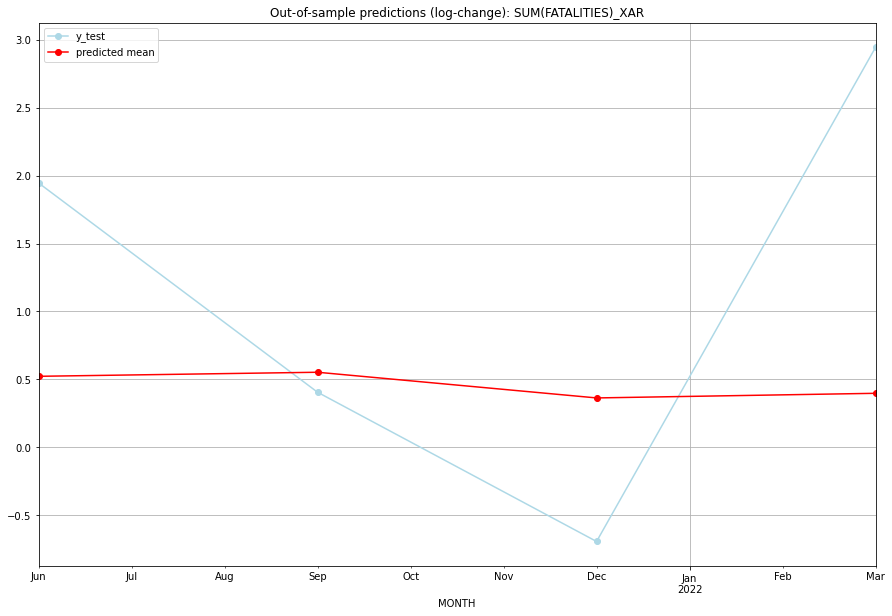

TADDA: 1.3843349322753125
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2.373383        13.0      0.522769        1.945910   XAR   
1 2021-07-01  2.475549         2.0      0.552605        0.405465   XAR   
2 2021-10-01  1.876864         0.0      0.363554       -0.693147   XAR   
3 2022-01-01  1.976602        37.0      0.397635        2.944439   XAR   

                                          PARAMETERS  
0  {'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## XIT (227/234) #########
0
Neighbor countries: ['ETH', 'KEN', 'SSD']
Getting Data for XIT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSE

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XIT   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 -14.931
Date:                 Wed, 19 Oct 2022   AIC                             31.863
Time:                         11:08:37   BIC                             34.427
Sample:                     04-30-1997   HQIC                            32.899
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0799      0.002     37.614      0.000     

<Figure size 432x288 with 0 Axes>

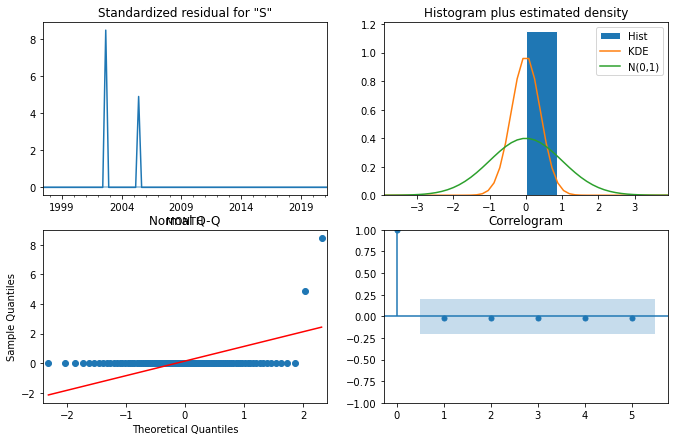

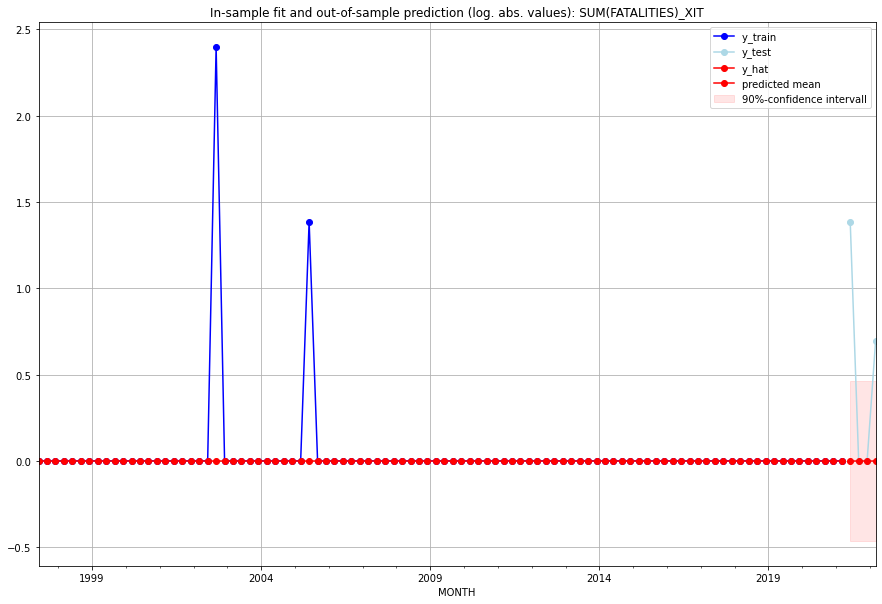

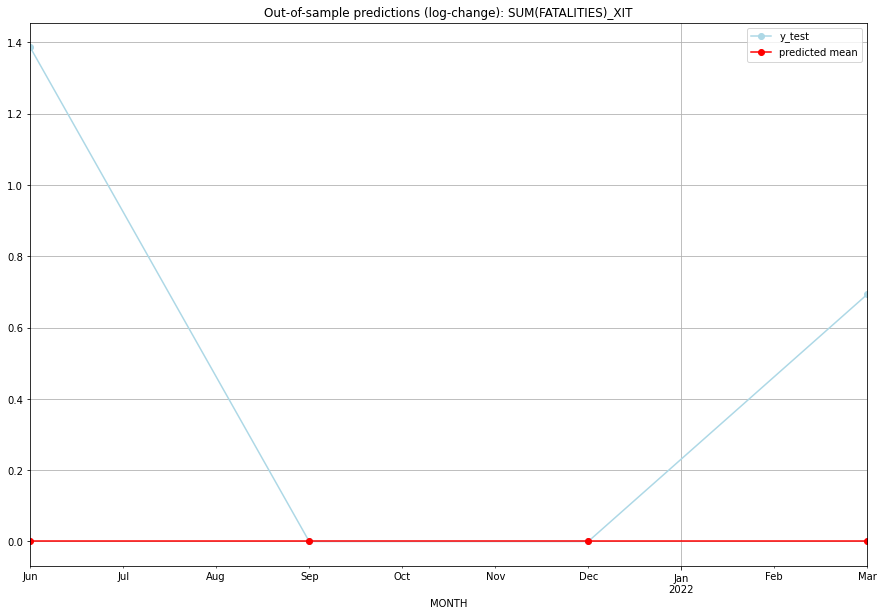

TADDA: 0.5198603854199589
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         3.0           0.0        1.386294   XIT   
1 2021-07-01       0.0         0.0           0.0        0.000000   XIT   
2 2021-10-01       0.0         0.0           0.0        0.000000   XIT   
3 2022-01-01       0.0         1.0           0.0        0.693147   XIT   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## XKK (228/234) #########
0
Neighbor countries: ['CAF', 'SDN', 'SSD']
Getting Data for XKK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 24)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSE

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08958797346140275, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.44793986730701374]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XKK   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 -90.179
Date:                 Wed, 19 Oct 2022   AIC                            182.359
Time:                         11:08:51   BIC                            184.923
Sample:                     04-30-1997   HQIC                           183.395
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3832      

<Figure size 432x288 with 0 Axes>

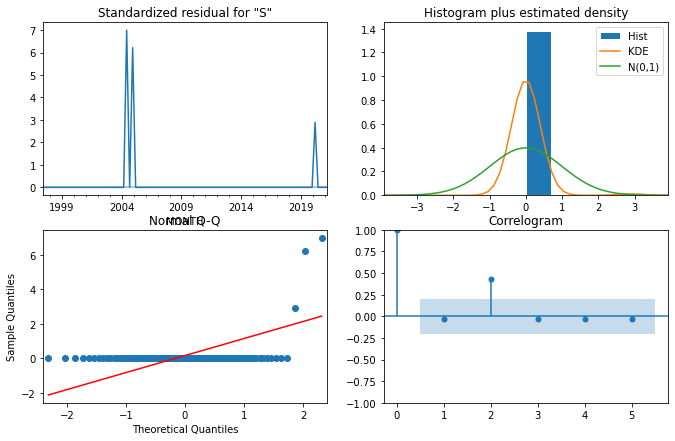

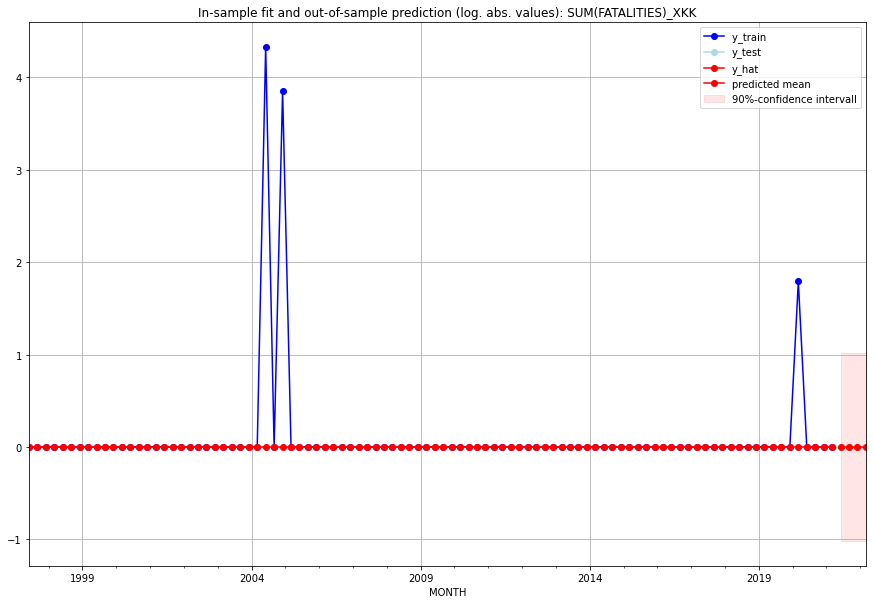

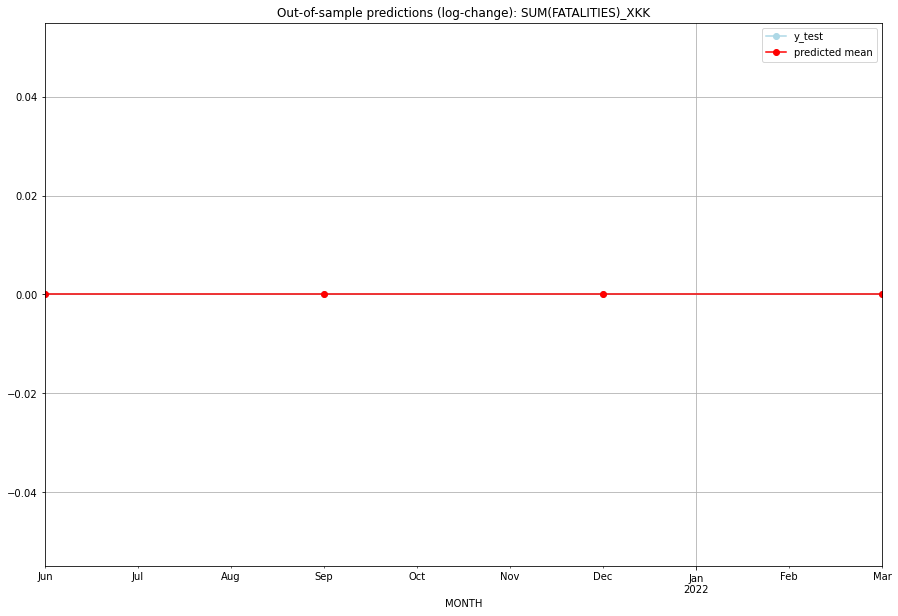

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   XKK   
1 2021-07-01       0.0         0.0           0.0             0.0   XKK   
2 2021-10-01       0.0         0.0           0.0             0.0   XKK   
3 2022-01-01       0.0         0.0           0.0             0.0   XKK   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## XKO (229/234) #########
0
Neighbor countries: ['ALB', 'MNE', 'MKD', 'SRB']
Getting Data for XKO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 32)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XKO   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                  -7.471
Date:                 Wed, 19 Oct 2022   AIC                             16.941
Time:                         11:08:55   BIC                             17.506
Sample:                     01-31-2018   HQIC                            16.825
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1848      0.037      5.048      0.000       0.113       0

<Figure size 432x288 with 0 Axes>

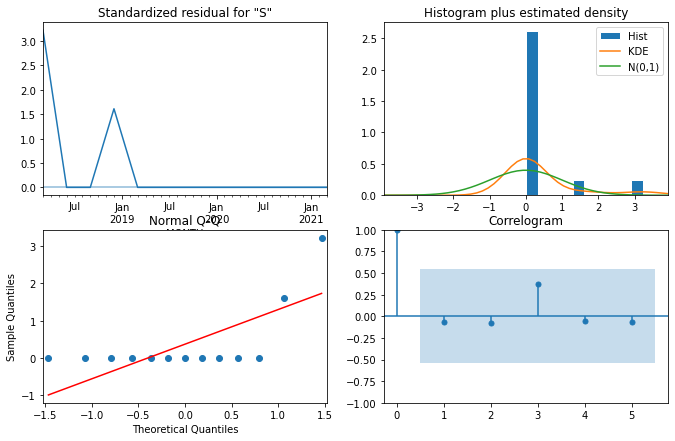

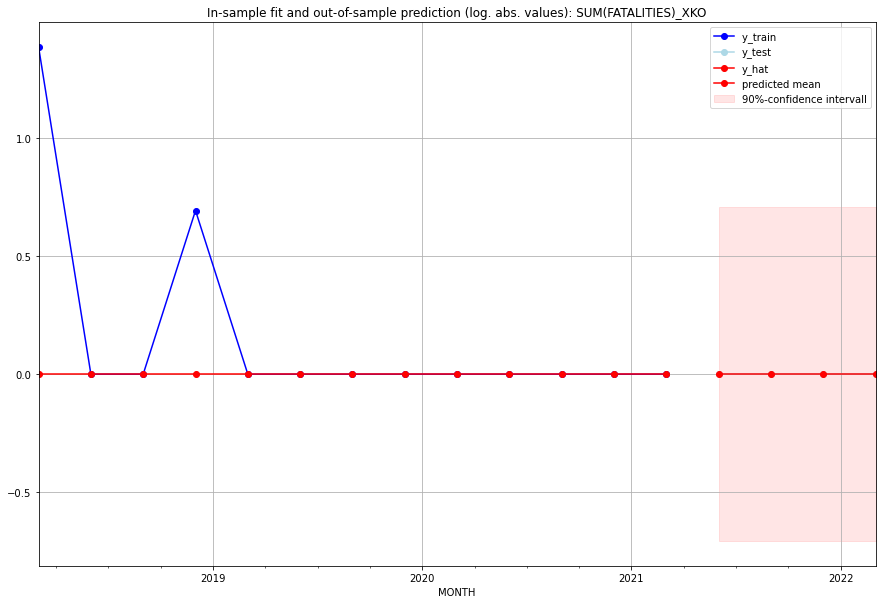

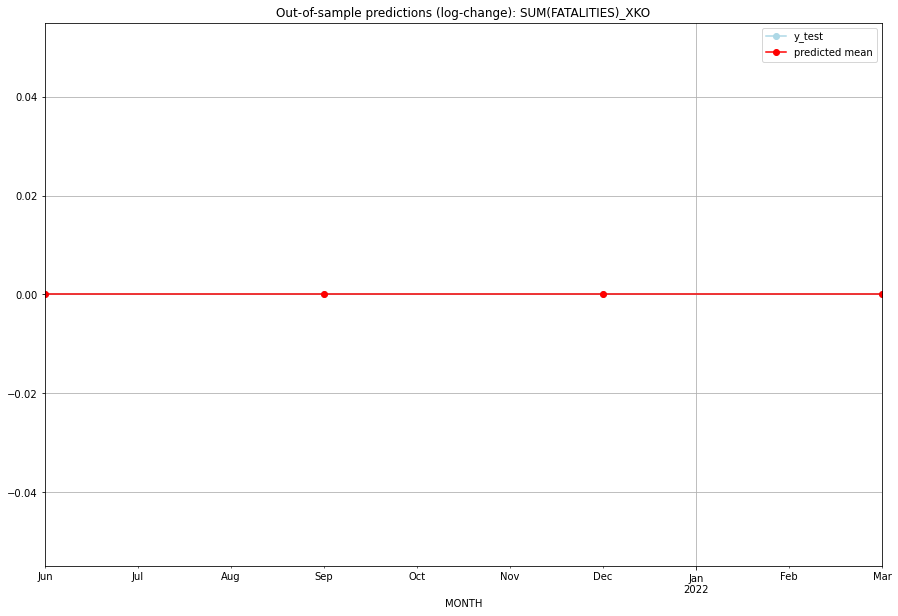

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   XKO   
1 2021-07-01       0.0         0.0           0.0             0.0   XKO   
2 2021-10-01       0.0         0.0           0.0             0.0   XKO   
3 2022-01-01       0.0         0.0           0.0             0.0   XKO   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:06
######## XNC (230/234) #########
0
Neighbor countries: ['CYP']
Getting Data for XNC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 8)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 par

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0866433932750534, 'fold_results': [0.1732867865501068, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XNC   No. Observations:                   13
Model:                SARIMAX(2, 0, 0)   Log Likelihood                   0.109
Date:                 Wed, 19 Oct 2022   AIC                              5.782
Time:                         11:09:03   BIC                              7.477
Sample:                     01-31-2018   HQIC                             5.434
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1       1.927e-06    4.2e+04   4.59e-11 

<Figure size 432x288 with 0 Axes>

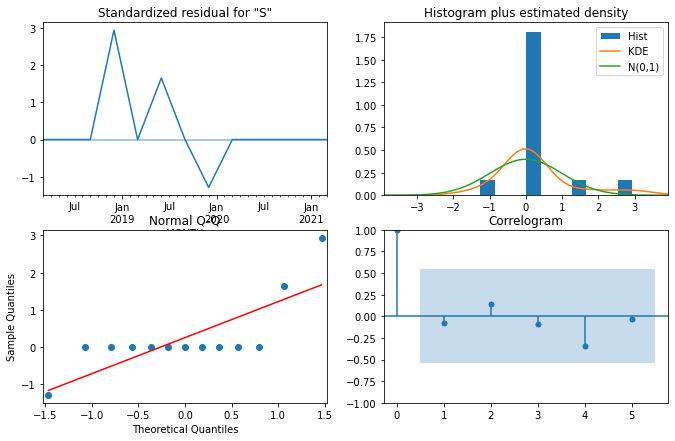

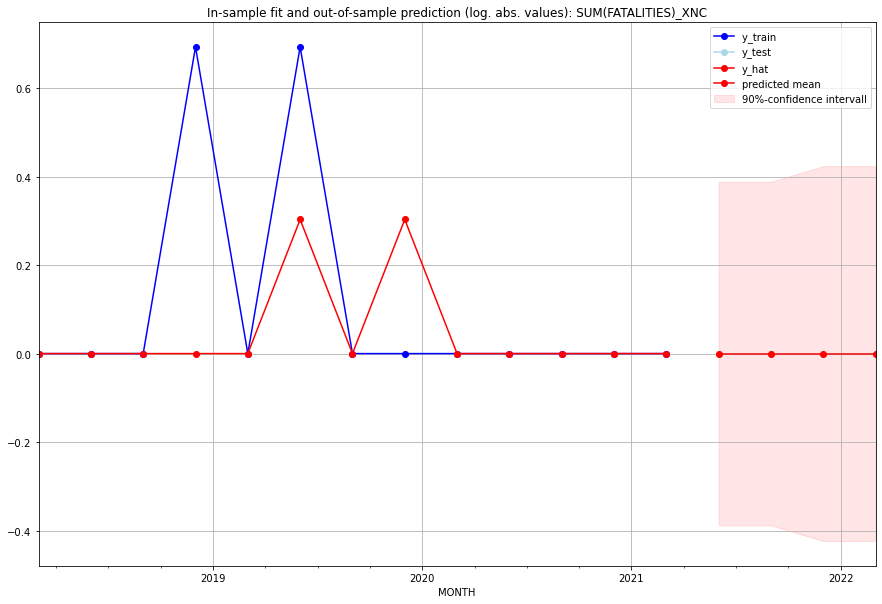

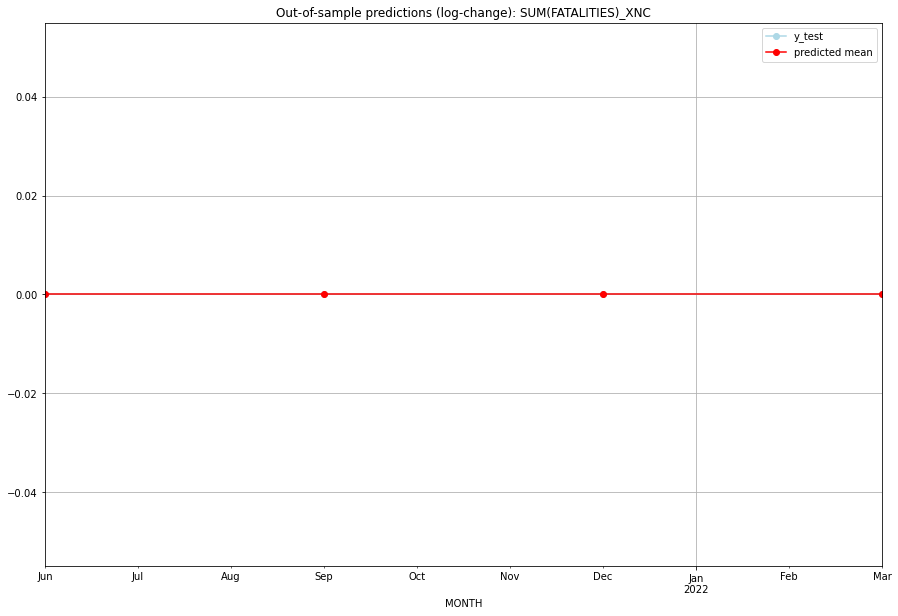

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   XNC   
1 2021-07-01       0.0         0.0           0.0             0.0   XNC   
2 2021-10-01       0.0         0.0           0.0             0.0   XNC   
3 2022-01-01       0.0         0.0           0.0             0.0   XNC   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## YEM (231/234) #########
0
Neighbor countries: ['OMN', 'SAU']
Getting Data for YEM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (29, 76)
y: (29, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.2546233718359491, 'fold_results': [0.2407259871285894, 0.18364514519676556, nan, 0.3837015324090105, 0.21042082260943085]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_YEM   No. Observations:                   25
Model:                SARIMAX(3, 1, 3)   Log Likelihood                  -8.059
Date:                 Wed, 19 Oct 2022   AIC                             34.117
Time:                         11:09:14   BIC                             44.720
Sample:                     01-31-2015   HQIC                            36.930
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

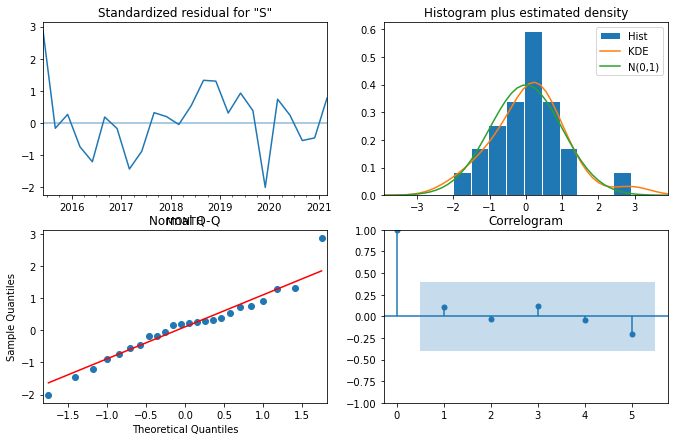

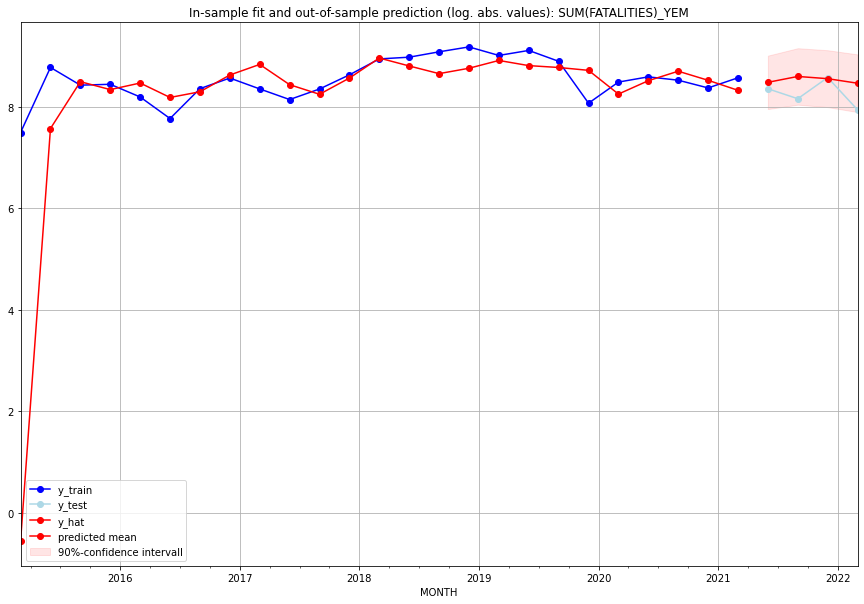

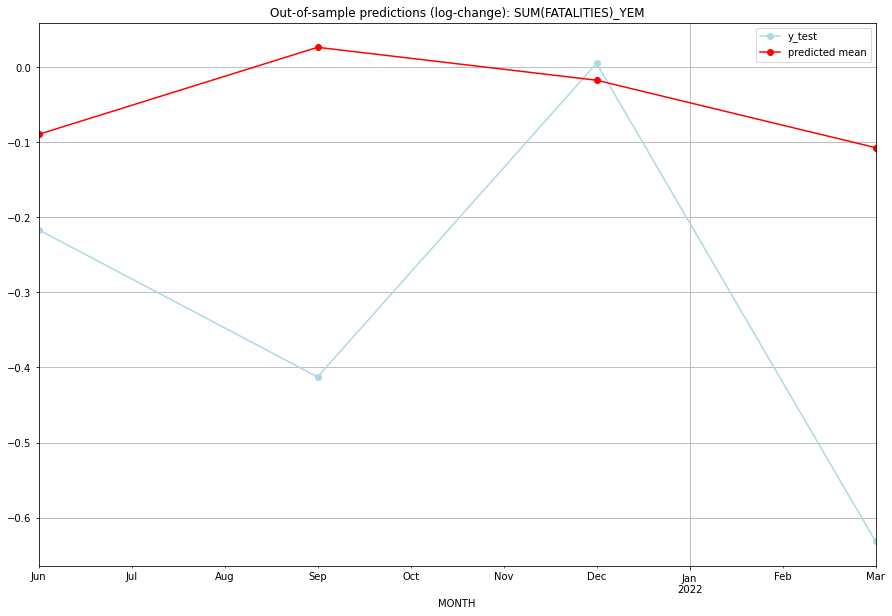

TADDA: 0.2848406541279165
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  4834.828935      4258.0     -0.089577       -0.216595   YEM   
1 2021-07-01  5429.275182      3500.0      0.026361       -0.412581   YEM   
2 2021-10-01  5196.453399      5315.0     -0.017460        0.005092   YEM   
3 2022-01-01  4750.147980      2811.0     -0.107243       -0.631733   YEM   

                                          PARAMETERS  
0  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## ZAF (232/234) #########
0
Neighbor countries: ['LSO', 'MOZ', 'SWZ', 'BWA', 'ZWE', 'NAM']
Getting Data for ZAF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 112)
y: (100, 1)
------------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.3276207286346099, 'fold_results': [0.21781860712749868, 0.4530614318840318, 0.28908879605475635, 0.38944976715688695, 0.2886850409498759]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZAF   No. Observations:                   96
Model:                SARIMAX(3, 1, 3)   Log Likelihood                -101.112
Date:                 Wed, 19 Oct 2022   AIC                            220.224
Time:                         11:09:35   BIC                            243.209
Sample:                     04-30-1997   HQIC                           229.512
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

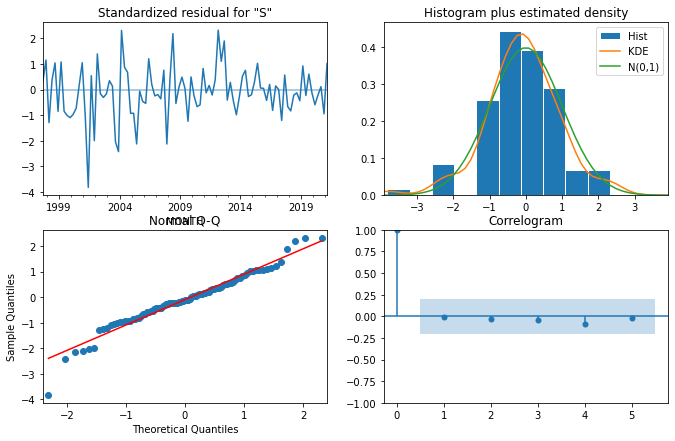

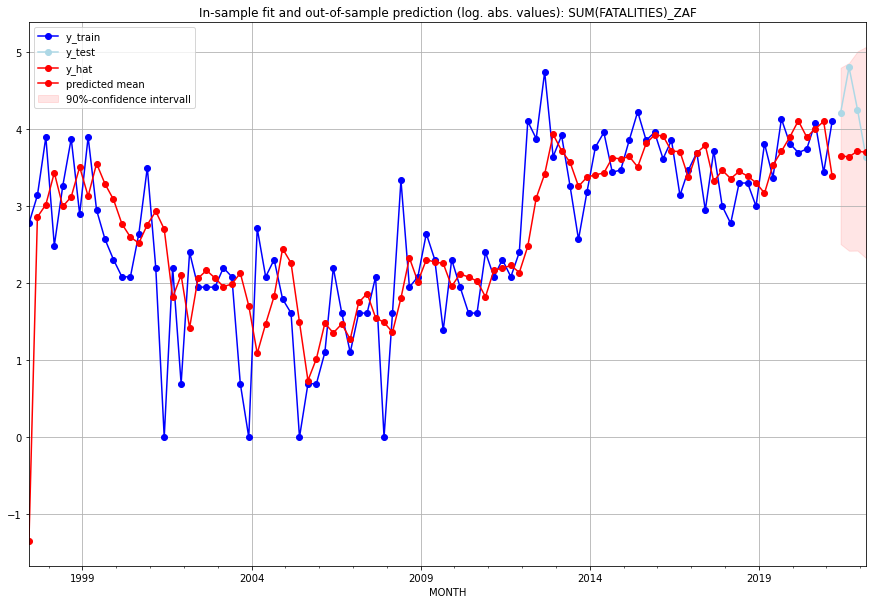

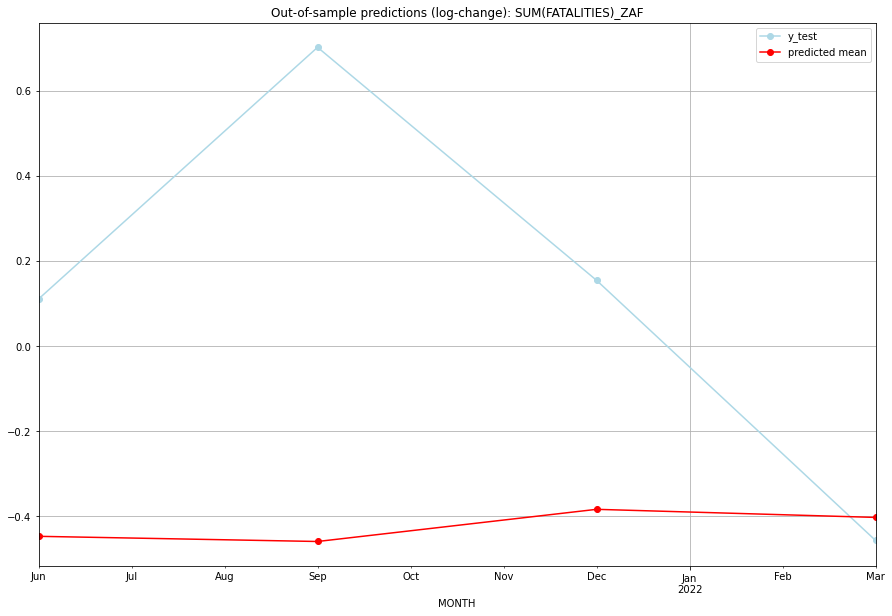

TADDA: 0.8999511106392765
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  37.371129        66.0     -0.447039        0.110348   ZAF   
1 2021-07-01  36.907935       120.0     -0.459184        0.701446   ZAF   
2 2021-10-01  39.882237        69.0     -0.383649        0.154151   ZAF   
3 2022-01-01  39.113039        37.0     -0.402643       -0.456758   ZAF   

                                          PARAMETERS  
0  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## ZMB (233/234) #########
0
Neighbor countries: ['AGO', 'NAM', 'COD', 'MOZ', 'MWI', 'ZWE', 'TZA', 'BWA']
Getting Data for ZMB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 123)
y: (100, 1)
--------------------------------------

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.6979290280246625, 'fold_results': [0.5239219867360081, 0.6161633826265285, 0.7044453637252415, 0.6597800174712616, 0.985334389564273]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZMB   No. Observations:                   96
Model:                SARIMAX(2, 0, 2)   Log Likelihood                -127.409
Date:                 Wed, 19 Oct 2022   AIC                            270.818
Time:                         11:09:51   BIC                            291.332
Sample:                     04-30-1997   HQIC                           279.110
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

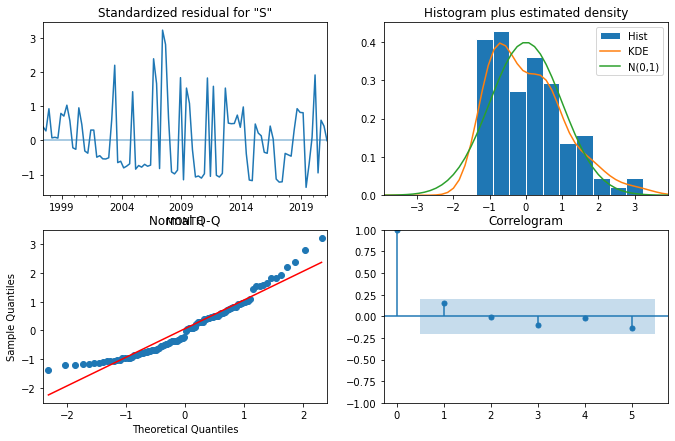

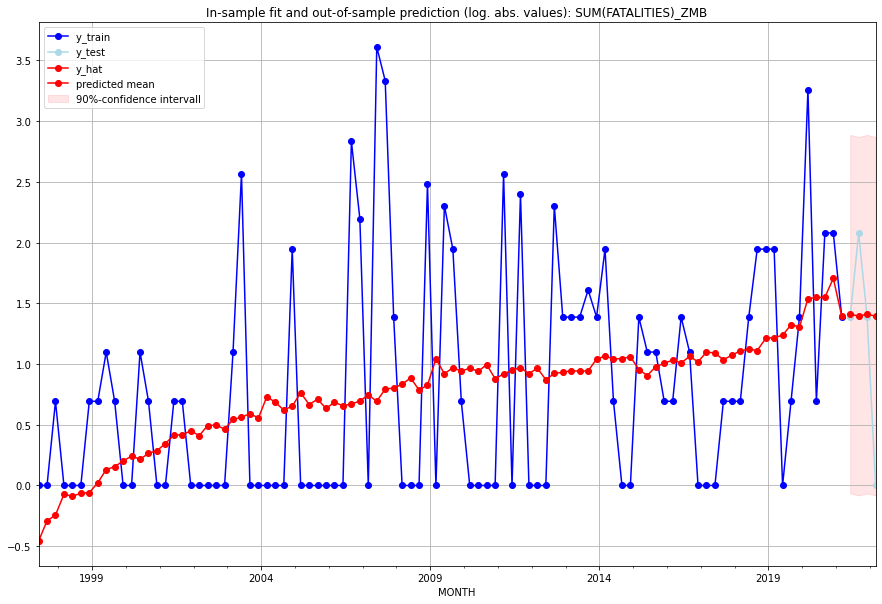

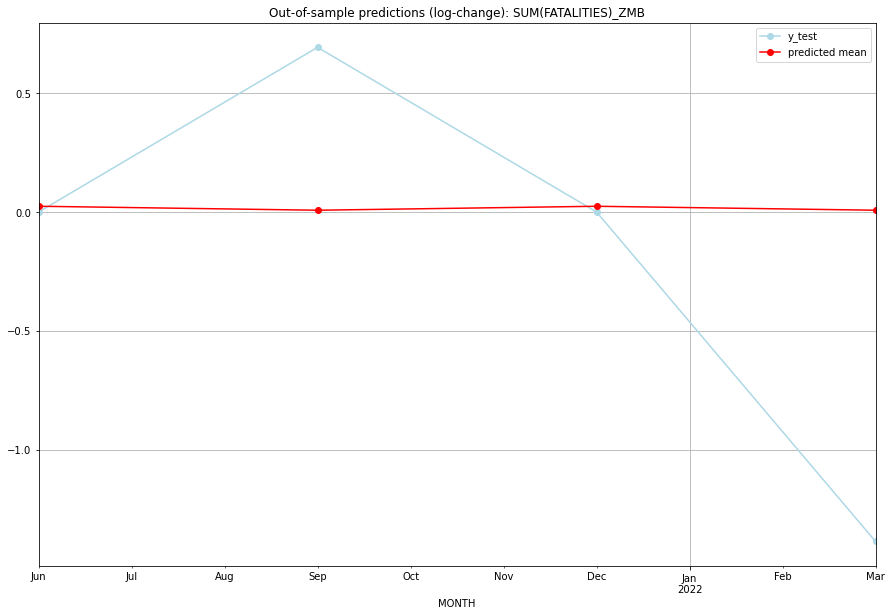

TADDA: 0.5339376340954061
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  3.098635         3.0      0.024360        0.000000   ZMB   
1 2021-07-01  3.030508         7.0      0.007598        0.693147   ZMB   
2 2021-10-01  3.098237         3.0      0.024262        0.000000   ZMB   
3 2022-01-01  3.030687         0.0      0.007643       -1.386294   ZMB   

                                          PARAMETERS  
0  {'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## ZWE (234/234) #########
0
Neighbor countries: ['MOZ', 'ZMB', 'ZAF', 'BWA']
Getting Data for ZWE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 89)
y: (100, 1)
------------------------------------------------
Training started.
Start

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6494415992389904, 'fold_results': [0.820853586501443, 0.5858517718785753, 0.3587711313223305, 0.631432161077064, 0.8502993454155389]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZWE   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -144.010
Date:                 Wed, 19 Oct 2022   AIC                            290.021
Time:                         11:10:04   BIC                            292.575
Sample:                     04-30-1997   HQIC                           291.053
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

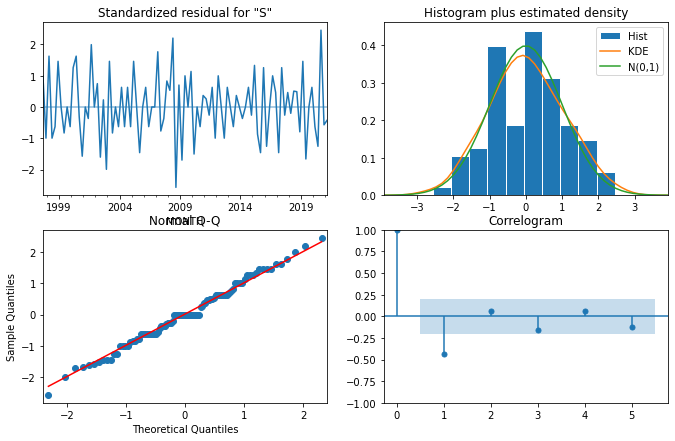

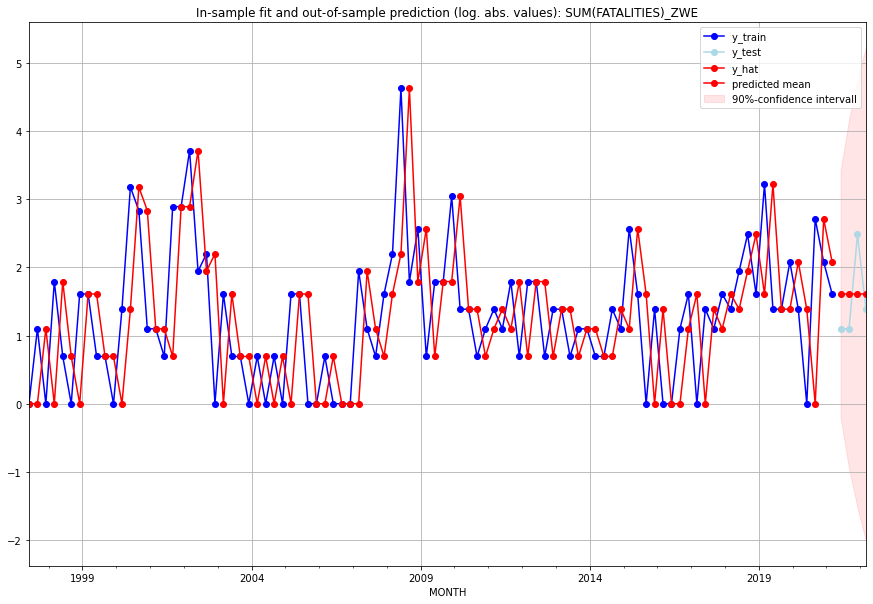

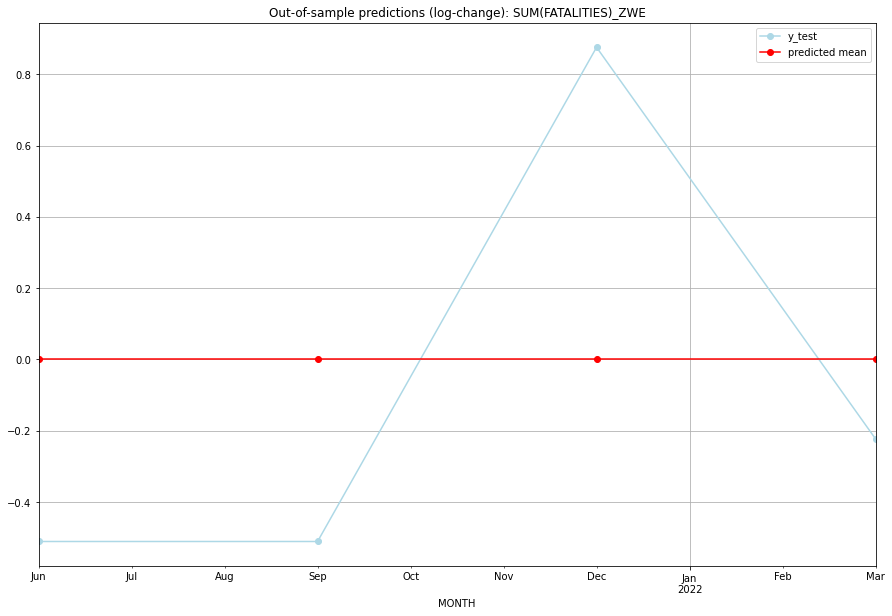

TADDA: 0.5300658840500231
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       4.0         2.0  2.220446e-16       -0.510826   ZWE   
1 2021-07-01       4.0         2.0  2.220446e-16       -0.510826   ZWE   
2 2021-10-01       4.0        11.0  2.220446e-16        0.875469   ZWE   
3 2022-01-01       4.0         3.0  2.220446e-16       -0.223144   ZWE   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13


In [8]:
# warnings.simplefilter(action='ignore')

sarimax_res = pd.DataFrame(columns=["MONTH", "FAT_PRED", "FAT_ACTUAL", "LC(FAT_PRED)", "LC(FAT_ACTUAL)", "GID_0", "PARAMETERS", "TIMESTAMP"])
csv_file = "../data/"+MODEL_NAME+"_PREDICTIONS.csv"

if os.path.exists(csv_file):
    existing_res = pd.read_csv("../data/"+MODEL_NAME+"_PREDICTIONS.csv")
    # print(existing_res)
    print("File already exists.")
    
else:
    sarimax_res.to_csv(csv_file, index=False, mode="a", header=True)
    existing_res = sarimax_res

for i, g in enumerate(gid_list):
# for i, g in enumerate(["XNC"]):
    print("######## "+g+" ("+str(i+1)+"/"+str(len(gid_list))+") #########")
    # print(existing_res[existing_res["GID_0"] == g])
    print(len(existing_res[existing_res["GID_0"] == g]))
    
    
    # skip country if results already exiast
    if len(existing_res[existing_res["GID_0"] == g]) > 0:
        print("Model for this country has already been fitted.")
        continue
    
    # add time series of neighboring  countries as predictor variables

    if NEIGHBORS == True:
        neighbor = gid0_neighbors[gid0_neighbors["GID_0"] == g]["NEIGHBOUR"].tolist()
    else:
        neighbor = []
    print("Neighbor countries: "+ str(neighbor))

    # measure time 
    st = time.time()

    res = sarimax(target_variable = TARGET_VARIABLE,
                  target_country = g,
                  predictor_countries = neighbor,
                  n_lags_X = N_LAGS_X,
                  seasonal_periodicity = SEASONAL_PERIODICITY)

    # append country results to csv with timestamp
    res["TIMESTAMP"] = datetime.datetime.now()
    
    res.to_csv(csv_file, index=False, mode="a", header=False)

    et = time.time()
    elapsed_time = et - st
    print('Execution time:', time.strftime("%M:%S", time.gmtime(elapsed_time)))

    sarimax_res = pd.concat([sarimax_res, res], ignore_index=True)

    # break

In [9]:
# varimax_res.to_csv("../data/"+MODEL_NAME+"_PREDICTIONS.csv", index=False)

In [10]:
sarimax_res

,MONTH,FAT_PRED,FAT_ACTUAL,LC(FAT_PRED),LC(FAT_ACTUAL),GID_0,PARAMETERS,TIMESTAMP
0,2021-04-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:44.818167
1,2021-07-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:44.818167
2,2021-10-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:44.818167
3,2022-01-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:44.818167
4,2021-04-01 00:00:00,8219.5336,18574.0,0.00043,0.815611,AFG,"{'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...",2022-10-19 10:24:13.477972
...,...,...,...,...,...,...,...,...
931,2022-01-01 00:00:00,3.030687,0.0,0.007643,-1.386294,ZMB,"{'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:09:52.451932
932,2021-04-01 00:00:00,4.0,2.0,0.0,-0.510826,ZWE,"{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:10:05.751414
933,2021-07-01 00:00:00,4.0,2.0,0.0,-0.510826,ZWE,"{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:10:05.751414
934,2021-10-01 00:00:00,4.0,11.0,0.0,0.875469,ZWE,"{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:10:05.751414
